In [1]:
import pandas as pd
import os
import requests
from matplotlib import rcParams
from numpy import radians, sin, cos, arccos, arctan2, sqrt, exp

import seaborn as sns
from glob import glob
import time 
import numpy as np
# Visualization
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab

import warnings
warnings.filterwarnings("ignore")

In [2]:
def calculateDistance(lat1, lon1, lat2, lon2):
    lat1 = radians(lat1)
    lat2 = radians(lat2)
    lon1 = radians(lon1)
    lon2 = radians(lon2)

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    R = 6371.0
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * arctan2(sqrt(a), sqrt(1 - a))

    return R * c

r_earth = 6378
def lat_long_range(lat, long, radius):
    dx = dy = 1 + radius
    lat_upper = lat + abs((dy / r_earth) * (180 / np.pi))
    lat_lower = lat - abs((dy / r_earth) * (180 / np.pi))
    long_upper = long + abs((dx / r_earth) * (180 / np.pi) / cos(lat * np.pi/180))
    long_lower = long - abs((dx / r_earth) * (180 / np.pi) / cos(lat * np.pi/180))
    return lat_upper, lat_lower, long_upper, long_lower

In [3]:
data_dir = 'C:/Users/harry/Documents/data/'
report_dir = 'C:/Users/harry/OneDrive - Cushman & Wakefield/realsight/report/'

In [6]:
from connection_func import DB_connect
db_connect = DB_connect()
start_time = time.time()
sql_dir = 'C:/Users/harry/OneDrive - Cushman & Wakefield/Documents/SQL Server Management Studio/'
file = open(os.path.join(sql_dir, 'Import Processed Let Agreed Rental Data.sql'), 'r')
sqlFile = file.read()
file.close()
rightmove_rental_df = db_connect.read_sql(query=sqlFile)
end_time  = time.time()
elapsed_time = (end_time - start_time)/60
print('Execution time:', elapsed_time, 'mins')

Execution time: 2.7106417099634807 mins


In [50]:
rightmove_rental_df.head()['change_date']

0   2022-07-20
1   2022-10-04
2   2022-10-28
3   2022-09-13
4   2022-10-05
Name: change_date, dtype: datetime64[ns]

In [51]:
rightmove_rental_df['prop_type'].value_counts()
rightmove_rental_df['change_date'] = pd.to_datetime(rightmove_rental_df['change_date'])
# rightmove_rental_df.loc[rightmove_rental_df['let_rent_frequency']=='Weekly'] [['']]

rm_flat_rental_df = rightmove_rental_df[(rightmove_rental_df['prop_type']=='Flat / Apartment') & \
                (rightmove_rental_df['change_date']>='2022-05-01')]

In [7]:
# Schools Data
schools_df = pd.read_excel(os.path.join(data_dir, 'edubasealldata20211030.xlsx'))

# Amenity Data
amenity_query = (f"SELECT * FROM [CH].[FSA_Amenity_v2] WHERE (RatingDate>= '2020-01-01')")
amenity_df = db_connect.read_sql(query=amenity_query)
# clean amenity lat longs 
amenity_df.dropna(subset=['Latitude', 'Longitude'], inplace=True)
amenity_df['Latitude'] = amenity_df['Latitude'].astype(float)
amenity_df['Longitude'] = amenity_df['Longitude'].astype(float)

In [52]:
rm_flat_rental_df.shape

(182483, 40)

In [54]:
 rightmove_rental_df[(rightmove_rental_df['prop_type']=='Flat / Apartment') & \
                (rightmove_rental_df['change_date']>='2022-01-01')].shape

(182483, 40)

In [56]:
# HL - CODE - AMENITY
data_df = rm_flat_rental_df
radius = 0.5
# master_sfa_neighbour_df  = pd.DataFrame()

for idx, row in data_df.loc[idx:].iterrows():
    time0 = time.time()
    lat, long, original_add = row['latitude'], row['longitude'], row['listing_id']
    lat_upper, lat_lower, long_upper, long_lower = lat_long_range(lat, long, radius)    
    neighbour_amenity_df = amenity_df[(amenity_df['Latitude']>lat_lower) & (amenity_df['Latitude']<lat_upper) & \
                                     (amenity_df['Longitude']>long_lower) & (amenity_df['Longitude']<long_upper)]
    if not neighbour_amenity_df.empty:
        dist_list_df = calculateDistance(lat, long, neighbour_amenity_df['Latitude'], neighbour_amenity_df['Longitude'])
        neighbour_amenity_df['LSOA11CD'] = original_add 
        neighbour_amenity_df['dist_to_target'] = dist_list_df
        neighbour_amenity_df = neighbour_amenity_df[neighbour_amenity_df['dist_to_target']<radius]
    
        master_sfa_neighbour_df = pd.concat([master_sfa_neighbour_df, neighbour_amenity_df])
        print(idx, original_add, neighbour_amenity_df.shape)
        end_time = time.time()
#         print('SFA Point Analysis time taken {} seconds'.format(end_time - time0))
        

218836 126301592 (4, 19)
218840 126301730 (26, 19)
218841 126301772 (22, 19)
218842 126301808 (2, 19)
218844 126301910 (11, 19)
218845 126301913 (15, 19)
218846 126301925 (23, 19)
218847 126301937 (34, 19)
218848 126301949 (90, 19)
218849 126301961 (55, 19)
218850 126301967 (51, 19)
218851 126301982 (32, 19)
218852 126302060 (1, 19)
218853 126302069 (55, 19)
218854 126302072 (1, 19)
218857 126302114 (55, 19)
218858 126302135 (27, 19)
218860 126302162 (10, 19)
218861 126302171 (14, 19)
218862 126302174 (10, 19)
218865 126302228 (14, 19)
218866 126302237 (11, 19)
218868 126302294 (12, 19)
218869 126302300 (3, 19)
218872 126302330 (4, 19)
218873 126302333 (3, 19)
218874 126302354 (4, 19)
218875 126302414 (52, 19)
218876 126302423 (35, 19)
218878 126302468 (14, 19)
218880 126302516 (52, 19)
218881 126302645 (9, 19)
218882 126302669 (18, 19)
218884 126302687 (56, 19)
218885 126302708 (7, 19)
218886 126302714 (59, 19)
218887 126302717 (12, 19)
218888 126302720 (11, 19)
218891 126302753 (6, 1

219341 126312497 (5, 19)
219344 126312518 (1, 19)
219345 126312542 (25, 19)
219346 126312602 (2, 19)
219350 126312686 (0, 19)
219351 126312701 (1, 19)
219354 126312752 (33, 19)
219355 126312767 (11, 19)
219357 126312788 (40, 19)
219358 126312815 (36, 19)
219359 126312851 (4, 19)
219363 126312977 (46, 19)
219364 126312995 (5, 19)
219365 126313016 (104, 19)
219366 126313031 (13, 19)
219367 126313034 (5, 19)
219368 126313046 (90, 19)
219369 126313049 (21, 19)
219370 126313055 (1, 19)
219371 126313073 (20, 19)
219373 126313103 (38, 19)
219374 126313118 (1, 19)
219375 126313124 (16, 19)
219376 126313127 (20, 19)
219377 126313139 (38, 19)
219380 126313184 (35, 19)
219381 126313187 (6, 19)
219382 126313193 (23, 19)
219383 126313229 (1, 19)
219384 126313241 (31, 19)
219387 126313292 (42, 19)
219390 126313328 (81, 19)
219392 126313343 (89, 19)
219398 126313448 (10, 19)
219399 126313454 (12, 19)
219401 126313466 (131, 19)
219402 126313478 (6, 19)
219404 126313529 (38, 19)
219406 126313556 (0, 19

219866 126324098 (4, 19)
219870 126324155 (0, 19)
219873 126324185 (4, 19)
219875 126324305 (19, 19)
219876 126324320 (20, 19)
219879 126324374 (56, 19)
219881 126324404 (121, 19)
219882 126324422 (12, 19)
219883 126324425 (25, 19)
219884 126324707 (37, 19)
219885 126324716 (49, 19)
219887 126324773 (12, 19)
219889 126324794 (5, 19)
219891 126324863 (30, 19)
219892 126324971 (1, 19)
219893 126325010 (5, 19)
219894 126325037 (2, 19)
219895 126325055 (3, 19)
219896 126325199 (23, 19)
219897 126325262 (7, 19)
219898 126325268 (26, 19)
219899 126325283 (33, 19)
219900 126325367 (21, 19)
219901 126325424 (9, 19)
219902 126325436 (12, 19)
219904 126325610 (12, 19)
219906 126325667 (6, 19)
219908 126326021 (2, 19)
219913 126326177 (53, 19)
219914 126326198 (16, 19)
219915 126326210 (15, 19)
219916 126326258 (2, 19)
219917 126326267 (54, 19)
219918 126326294 (0, 19)
219919 126326300 (3, 19)
219920 126326315 (60, 19)
219921 126326342 (20, 19)
219925 126326396 (7, 19)
219926 126326411 (5, 19)
21

220398 126340943 (8, 19)
220399 126340991 (14, 19)
220402 126341069 (0, 19)
220403 126341108 (0, 19)
220404 126341117 (18, 19)
220405 126341126 (30, 19)
220406 126341165 (4, 19)
220407 126341171 (29, 19)
220409 126341243 (9, 19)
220411 126341303 (39, 19)
220412 126341309 (2, 19)
220414 126341363 (5, 19)
220415 126341366 (17, 19)
220416 126341372 (7, 19)
220418 126341420 (12, 19)
220419 126341432 (9, 19)
220420 126341441 (12, 19)
220421 126341468 (2, 19)
220422 126341519 (17, 19)
220426 126341564 (9, 19)
220428 126341585 (23, 19)
220429 126341594 (10, 19)
220430 126341600 (58, 19)
220431 126341639 (41, 19)
220433 126341666 (14, 19)
220436 126341735 (91, 19)
220438 126341771 (6, 19)
220439 126341810 (0, 19)
220441 126341963 (11, 19)
220442 126341984 (5, 19)
220445 126342092 (1, 19)
220447 126342107 (3, 19)
220448 126342131 (22, 19)
220449 126342140 (51, 19)
220450 126342185 (26, 19)
220452 126342227 (19, 19)
220453 126342257 (9, 19)
220454 126342260 (0, 19)
220455 126342296 (32, 19)
2204

220901 126351998 (31, 19)
220904 126352016 (26, 19)
220910 126352148 (85, 19)
220911 126352169 (52, 19)
220912 126352352 (31, 19)
220913 126352358 (40, 19)
220914 126352391 (4, 19)
220915 126352466 (10, 19)
220916 126352535 (25, 19)
220918 126352556 (19, 19)
220920 126352649 (14, 19)
220922 126352664 (45, 19)
220923 126352697 (11, 19)
220925 126352721 (7, 19)
220926 126352766 (83, 19)
220929 126352817 (116, 19)
220930 126352820 (3, 19)
220931 126352856 (0, 19)
220933 126352868 (1, 19)
220939 126353024 (88, 19)
220940 126353039 (11, 19)
220942 126353072 (7, 19)
220945 126353147 (1, 19)
220946 126353153 (5, 19)
220947 126353189 (94, 19)
220948 126353195 (36, 19)
220949 126353234 (3, 19)
220950 126353255 (2, 19)
220953 126353423 (54, 19)
220955 126353435 (20, 19)
220956 126353438 (28, 19)
220957 126353483 (35, 19)
220958 126353546 (0, 19)
220959 126353555 (9, 19)
220960 126353564 (5, 19)
220965 126353759 (14, 19)
220966 126353771 (90, 19)
220969 126353858 (44, 19)
220974 126353933 (7, 19)

221430 126365186 (33, 19)
221431 126365201 (14, 19)
221432 126365204 (68, 19)
221434 126365225 (3, 19)
221436 126365261 (2, 19)
221437 126365279 (9, 19)
221438 126365327 (2, 19)
221443 126365393 (9, 19)
221444 126365417 (1, 19)
221445 126365420 (10, 19)
221446 126365423 (8, 19)
221447 126365441 (15, 19)
221448 126365447 (34, 19)
221449 126365498 (54, 19)
221450 126365501 (5, 19)
221452 126365522 (14, 19)
221453 126365528 (6, 19)
221454 126365558 (6, 19)
221455 126365573 (16, 19)
221456 126365669 (17, 19)
221458 126365759 (0, 19)
221459 126365786 (9, 19)
221461 126365852 (26, 19)
221466 126365951 (37, 19)
221468 126365969 (10, 19)
221470 126366023 (59, 19)
221471 126366035 (32, 19)
221472 126366044 (68, 19)
221473 126366074 (26, 19)
221474 126366083 (6, 19)
221475 126366119 (1, 19)
221476 126366125 (0, 19)
221477 126366149 (19, 19)
221478 126366152 (6, 19)
221480 126366329 (7, 19)
221481 126366341 (93, 19)
221482 126366347 (15, 19)
221484 126366383 (42, 19)
221485 126366416 (34, 19)
221

221930 126376025 (7, 19)
221931 126376028 (1, 19)
221933 126376034 (6, 19)
221934 126376082 (5, 19)
221935 126376088 (59, 19)
221937 126376175 (7, 19)
221938 126376181 (23, 19)
221940 126376226 (59, 19)
221941 126376235 (1, 19)
221942 126376265 (23, 19)
221944 126376301 (17, 19)
221946 126376322 (16, 19)
221947 126376325 (18, 19)
221950 126376388 (30, 19)
221951 126376397 (12, 19)
221952 126376400 (4, 19)
221953 126376403 (7, 19)
221954 126376406 (26, 19)
221955 126376412 (23, 19)
221956 126376421 (6, 19)
221958 126376598 (67, 19)
221959 126376619 (109, 19)
221962 126376826 (25, 19)
221963 126376865 (31, 19)
221967 126376982 (165, 19)
221975 126377099 (33, 19)
221978 126377171 (37, 19)
221979 126377177 (2, 19)
221980 126377195 (36, 19)
221981 126377210 (0, 19)
221982 126377396 (2, 19)
221983 126377426 (4, 19)
221984 126377432 (0, 19)
221985 126377468 (22, 19)
221987 126377525 (53, 19)
221988 126377531 (2, 19)
221990 126377837 (85, 19)
221991 126377894 (3, 19)
221993 126377912 (74, 19)


222438 126393704 (3, 19)
222439 126393707 (23, 19)
222440 126393722 (1, 19)
222441 126393731 (5, 19)
222442 126393755 (2, 19)
222444 126393806 (4, 19)
222445 126393809 (4, 19)
222446 126393842 (0, 19)
222451 126394208 (61, 19)
222453 126394307 (7, 19)
222454 126394313 (3, 19)
222455 126394319 (42, 19)
222456 126394325 (29, 19)
222457 126394331 (51, 19)
222458 126394361 (3, 19)
222460 126394406 (44, 19)
222461 126394427 (17, 19)
222462 126394430 (58, 19)
222463 126394439 (13, 19)
222464 126394442 (4, 19)
222465 126394490 (28, 19)
222466 126394571 (3, 19)
222467 126394595 (9, 19)
222468 126394601 (2, 19)
222469 126394622 (9, 19)
222470 126394625 (16, 19)
222472 126394640 (7, 19)
222473 126394646 (12, 19)
222474 126394652 (12, 19)
222475 126394661 (32, 19)
222477 126394691 (9, 19)
222478 126394700 (12, 19)
222479 126394703 (7, 19)
222481 126394727 (3, 19)
222482 126394730 (16, 19)
222483 126394739 (34, 19)
222484 126394742 (21, 19)
222487 126394805 (44, 19)
222489 126394826 (3, 19)
222490

222950 126404750 (6, 19)
222951 126404753 (37, 19)
222952 126404801 (6, 19)
222958 126404852 (39, 19)
222960 126404948 (2, 19)
222961 126404951 (54, 19)
222962 126404963 (6, 19)
222965 126405008 (11, 19)
222966 126405071 (20, 19)
222967 126405110 (7, 19)
222969 126405176 (9, 19)
222971 126405224 (18, 19)
222972 126405242 (10, 19)
222974 126405374 (11, 19)
222975 126405413 (145, 19)
222977 126405443 (25, 19)
222978 126405452 (0, 19)
222979 126405458 (12, 19)
222980 126405515 (5, 19)
222981 126405548 (17, 19)
222984 126405593 (47, 19)
222985 126405644 (5, 19)
222986 126405650 (0, 19)
222988 126405773 (4, 19)
222990 126405785 (36, 19)
222991 126405800 (15, 19)
222992 126405824 (11, 19)
222993 126405830 (11, 19)
222995 126405869 (8, 19)
222997 126405968 (13, 19)
222999 126406058 (15, 19)
223000 126406100 (70, 19)
223002 126406109 (17, 19)
223003 126406121 (2, 19)
223005 126406202 (12, 19)
223006 126406241 (7, 19)
223007 126406355 (16, 19)
223009 126406406 (0, 19)
223010 126406463 (6, 19)
2

223463 126417623 (6, 19)
223464 126417635 (98, 19)
223470 126417860 (64, 19)
223471 126417863 (79, 19)
223474 126417905 (23, 19)
223475 126417938 (1, 19)
223476 126417944 (0, 19)
223477 126417968 (14, 19)
223478 126417971 (5, 19)
223479 126417974 (45, 19)
223481 126418025 (12, 19)
223482 126418040 (57, 19)
223483 126418055 (5, 19)
223486 126418091 (12, 19)
223487 126418103 (10, 19)
223488 126418136 (15, 19)
223490 126418163 (7, 19)
223491 126418178 (53, 19)
223492 126418184 (22, 19)
223493 126418199 (9, 19)
223495 126418250 (5, 19)
223496 126418259 (22, 19)
223497 126418274 (23, 19)
223498 126418277 (20, 19)
223501 126418313 (83, 19)
223503 126418361 (40, 19)
223504 126418373 (25, 19)
223505 126418376 (7, 19)
223507 126418382 (21, 19)
223508 126418418 (54, 19)
223511 126418436 (22, 19)
223512 126418439 (2, 19)
223513 126418448 (33, 19)
223516 126418472 (27, 19)
223518 126418526 (0, 19)
223519 126418643 (3, 19)
223520 126418739 (36, 19)
223521 126418859 (33, 19)
223522 126418964 (18, 19

223978 126432275 (8, 19)
223979 126432296 (2, 19)
223980 126432302 (31, 19)
223981 126432329 (9, 19)
223984 126432377 (17, 19)
223986 126432386 (10, 19)
223988 126432434 (55, 19)
223990 126432500 (38, 19)
223991 126432533 (16, 19)
223993 126432599 (91, 19)
223994 126432602 (3, 19)
223996 126432680 (12, 19)
223999 126433022 (4, 19)
224000 126433028 (17, 19)
224001 126433031 (7, 19)
224002 126433037 (4, 19)
224004 126433067 (0, 19)
224006 126433082 (31, 19)
224007 126433088 (38, 19)
224008 126433184 (0, 19)
224009 126433199 (7, 19)
224010 126433331 (6, 19)
224011 126433334 (13, 19)
224012 126433340 (50, 19)
224016 126433448 (7, 19)
224017 126433451 (84, 19)
224018 126433511 (4, 19)
224021 126433538 (127, 19)
224022 126433544 (22, 19)
224023 126433550 (11, 19)
224025 126433565 (74, 19)
224026 126433586 (8, 19)
224027 126433592 (31, 19)
224029 126433613 (4, 19)
224031 126433634 (39, 19)
224032 126433637 (31, 19)
224033 126433643 (6, 19)
224035 126433700 (3, 19)
224036 126433724 (14, 19)
22

224497 126445922 (5, 19)
224499 126445961 (49, 19)
224501 126446006 (19, 19)
224503 126446042 (8, 19)
224504 126446051 (6, 19)
224506 126446132 (19, 19)
224508 126446147 (17, 19)
224509 126446153 (366, 19)
224513 126446291 (6, 19)
224514 126446309 (4, 19)
224515 126446360 (24, 19)
224516 126446453 (24, 19)
224517 126446522 (50, 19)
224520 126446582 (63, 19)
224522 126446627 (34, 19)
224523 126446639 (1, 19)
224524 126446657 (7, 19)
224525 126446675 (20, 19)
224526 126446696 (9, 19)
224528 126446786 (32, 19)
224529 126446813 (16, 19)
224530 126446825 (6, 19)
224533 126446930 (19, 19)
224535 126446972 (2, 19)
224537 126446987 (2, 19)
224538 126446993 (17, 19)
224540 126447035 (3, 19)
224541 126447050 (2, 19)
224542 126447068 (46, 19)
224543 126447155 (57, 19)
224545 126447221 (16, 19)
224546 126447242 (20, 19)
224547 126447260 (4, 19)
224548 126447305 (11, 19)
224550 126447425 (14, 19)
224552 126447449 (15, 19)
224555 126447521 (91, 19)
224557 126447560 (74, 19)
224558 126447563 (17, 19)

225071 126463244 (67, 19)
225074 126463316 (12, 19)
225076 126463403 (54, 19)
225078 126463412 (4, 19)
225080 126463433 (0, 19)
225081 126463451 (75, 19)
225082 126463496 (33, 19)
225083 126463505 (72, 19)
225084 126463508 (67, 19)
225086 126463535 (39, 19)
225089 126463547 (9, 19)
225091 126463571 (30, 19)
225092 126463586 (12, 19)
225093 126463631 (3, 19)
225094 126463637 (11, 19)
225095 126463649 (7, 19)
225096 126463667 (19, 19)
225097 126463673 (2, 19)
225101 126463706 (12, 19)
225102 126463718 (48, 19)
225103 126463760 (6, 19)
225104 126463763 (1, 19)
225106 126463802 (7, 19)
225110 126463865 (28, 19)
225111 126463871 (63, 19)
225112 126463874 (11, 19)
225114 126463940 (45, 19)
225115 126463955 (68, 19)
225117 126464030 (6, 19)
225118 126464057 (38, 19)
225122 126464132 (9, 19)
225125 126464246 (11, 19)
225127 126464471 (6, 19)
225130 126464594 (32, 19)
225131 126464630 (97, 19)
225133 126464660 (25, 19)
225134 126464687 (3, 19)
225135 126464786 (1, 19)
225136 126464795 (5, 19)
2

225627 126480923 (100, 19)
225628 126480926 (79, 19)
225630 126481076 (5, 19)
225635 126481271 (66, 19)
225636 126481274 (50, 19)
225639 126481343 (0, 19)
225640 126481352 (7, 19)
225641 126481391 (33, 19)
225644 126483248 (33, 19)
225645 126483692 (29, 19)
225646 126484730 (7, 19)
225647 126484976 (42, 19)
225648 126484991 (10, 19)
225649 126485027 (10, 19)
225651 126485270 (11, 19)
225653 126485351 (6, 19)
225656 126485405 (23, 19)
225658 126485423 (20, 19)
225659 126485468 (9, 19)
225662 126485513 (35, 19)
225663 126485675 (15, 19)
225664 126485801 (27, 19)
225665 126485807 (8, 19)
225666 126485918 (5, 19)
225668 126486029 (121, 19)
225669 126486053 (2, 19)
225670 126486059 (55, 19)
225671 126486065 (2, 19)
225673 126486134 (3, 19)
225674 126486137 (11, 19)
225675 126486146 (2, 19)
225677 126486227 (62, 19)
225678 126486239 (4, 19)
225681 126487550 (21, 19)
225682 126487598 (42, 19)
225683 126487613 (25, 19)
225684 126487616 (20, 19)
225689 126487709 (9, 19)
225692 126487757 (8, 19)

226174 126518924 (3, 19)
226176 126519041 (4, 19)
226177 126519044 (24, 19)
226178 126519077 (19, 19)
226182 126519221 (5, 19)
226183 126519254 (14, 19)
226185 126519299 (4, 19)
226188 126519446 (16, 19)
226190 126519533 (6, 19)
226192 126519596 (5, 19)
226194 126519650 (3, 19)
226195 126519671 (2, 19)
226196 126519689 (29, 19)
226197 126519695 (89, 19)
226199 126519722 (15, 19)
226202 126519770 (9, 19)
226207 126519860 (79, 19)
226208 126519866 (95, 19)
226210 126519899 (74, 19)
226212 126519971 (29, 19)
226214 126520037 (11, 19)
226215 126520043 (2, 19)
226217 126520106 (6, 19)
226218 126520133 (14, 19)
226219 126520157 (4, 19)
226220 126520193 (9, 19)
226222 126520250 (22, 19)
226223 126520253 (4, 19)
226225 126520259 (19, 19)
226226 126520271 (2, 19)
226229 126520325 (20, 19)
226230 126520415 (19, 19)
226232 126520442 (55, 19)
226236 126520547 (1, 19)
226237 126520553 (0, 19)
226238 126520583 (27, 19)
226239 126520589 (44, 19)
226242 126520619 (0, 19)
226243 126520646 (1, 19)
22624

226699 126529748 (12, 19)
226705 126529778 (9, 19)
226706 126529781 (9, 19)
226707 126529784 (4, 19)
226709 126529826 (13, 19)
226711 126529865 (0, 19)
226712 126529871 (16, 19)
226713 126529898 (93, 19)
226714 126529907 (18, 19)
226715 126529919 (13, 19)
226716 126529931 (21, 19)
226717 126529937 (51, 19)
226718 126529940 (12, 19)
226721 126529979 (23, 19)
226723 126530075 (88, 19)
226724 126530078 (35, 19)
226725 126530081 (25, 19)
226726 126530099 (14, 19)
226729 126530207 (25, 19)
226730 126530246 (85, 19)
226732 126530285 (100, 19)
226733 126530306 (18, 19)
226735 126530315 (5, 19)
226736 126530333 (4, 19)
226738 126530363 (4, 19)
226739 126530369 (25, 19)
226740 126530381 (9, 19)
226741 126530399 (13, 19)
226746 126530579 (37, 19)
226747 126530582 (78, 19)
226749 126530600 (22, 19)
226750 126530603 (13, 19)
226751 126530606 (52, 19)
226752 126530609 (13, 19)
226753 126530615 (13, 19)
226754 126530618 (13, 19)
226756 126530666 (11, 19)
226757 126530684 (27, 19)
226758 126530702 (4

227209 126539489 (91, 19)
227215 126539585 (92, 19)
227217 126539663 (11, 19)
227219 126539684 (7, 19)
227221 126539723 (40, 19)
227222 126539747 (49, 19)
227224 126539825 (32, 19)
227225 126539846 (19, 19)
227227 126539909 (59, 19)
227230 126540065 (12, 19)
227232 126540191 (2, 19)
227237 126540323 (1, 19)
227238 126540347 (13, 19)
227239 126540353 (85, 19)
227249 126540593 (2, 19)
227251 126540632 (138, 19)
227253 126540680 (44, 19)
227256 126540731 (26, 19)
227258 126540743 (15, 19)
227259 126540764 (3, 19)
227260 126540800 (5, 19)
227261 126540803 (49, 19)
227263 126540830 (15, 19)
227264 126540845 (3, 19)
227267 126540887 (2, 19)
227270 126540920 (9, 19)
227271 126540923 (24, 19)
227272 126540974 (20, 19)
227273 126540977 (0, 19)
227274 126540998 (1, 19)
227277 126541052 (48, 19)
227282 126541109 (2, 19)
227285 126541145 (3, 19)
227289 126541262 (0, 19)
227290 126541265 (4, 19)
227293 126541322 (14, 19)
227299 126541391 (14, 19)
227300 126541400 (13, 19)
227301 126541406 (0, 19)
2

227784 126555323 (4, 19)
227786 126555338 (0, 19)
227787 126555365 (27, 19)
227789 126555383 (2, 19)
227792 126555422 (8, 19)
227793 126555443 (7, 19)
227795 126555482 (6, 19)
227796 126555512 (80, 19)
227797 126555527 (18, 19)
227798 126555536 (95, 19)
227800 126555554 (36, 19)
227801 126555557 (2, 19)
227808 126555731 (204, 19)
227810 126555749 (1, 19)
227811 126555755 (3, 19)
227812 126555788 (33, 19)
227813 126555806 (6, 19)
227814 126555824 (95, 19)
227815 126555839 (15, 19)
227816 126555926 (23, 19)
227817 126555929 (0, 19)
227818 126555956 (31, 19)
227819 126555968 (3, 19)
227822 126556016 (26, 19)
227824 126556046 (16, 19)
227825 126556052 (24, 19)
227826 126556088 (11, 19)
227827 126556109 (1, 19)
227828 126556124 (48, 19)
227829 126556148 (26, 19)
227831 126556184 (96, 19)
227833 126556283 (71, 19)
227834 126556295 (25, 19)
227835 126556340 (0, 19)
227836 126556352 (26, 19)
227837 126556385 (7, 19)
227838 126556397 (63, 19)
227839 126556409 (16, 19)
227840 126556412 (6, 19)
2

228290 126565904 (9, 19)
228293 126565934 (0, 19)
228294 126565946 (5, 19)
228296 126565970 (26, 19)
228298 126566009 (53, 19)
228299 126566024 (47, 19)
228300 126566057 (60, 19)
228303 126566135 (22, 19)
228305 126566150 (10, 19)
228306 126566153 (7, 19)
228307 126566162 (8, 19)
228308 126566171 (3, 19)
228310 126566177 (2, 19)
228312 126566219 (51, 19)
228313 126566222 (1, 19)
228314 126566228 (0, 19)
228315 126566234 (5, 19)
228316 126566243 (87, 19)
228317 126566255 (41, 19)
228318 126566264 (13, 19)
228320 126566300 (18, 19)
228321 126566363 (13, 19)
228322 126566375 (8, 19)
228323 126566429 (6, 19)
228325 126566495 (25, 19)
228326 126566501 (38, 19)
228327 126566522 (14, 19)
228328 126566561 (2, 19)
228329 126566597 (0, 19)
228330 126566600 (22, 19)
228331 126566615 (8, 19)
228333 126566642 (48, 19)
228334 126566666 (9, 19)
228335 126566726 (10, 19)
228338 126566798 (4, 19)
228339 126566801 (13, 19)
228343 126566822 (54, 19)
228346 126566894 (2, 19)
228349 126566921 (42, 19)
2283

228823 126580034 (40, 19)
228824 126580052 (1, 19)
228826 126580073 (30, 19)
228828 126580088 (64, 19)
228829 126580091 (5, 19)
228830 126580094 (4, 19)
228837 126580247 (41, 19)
228838 126580265 (60, 19)
228839 126580286 (15, 19)
228840 126580319 (87, 19)
228841 126580388 (2, 19)
228842 126580391 (15, 19)
228844 126580466 (7, 19)
228845 126580502 (7, 19)
228847 126580511 (18, 19)
228849 126580538 (17, 19)
228850 126580541 (21, 19)
228851 126580556 (32, 19)
228852 126580601 (87, 19)
228854 126580625 (13, 19)
228856 126580637 (24, 19)
228857 126580655 (1, 19)
228858 126580658 (5, 19)
228860 126580679 (5, 19)
228862 126580730 (33, 19)
228863 126580733 (0, 19)
228864 126580745 (0, 19)
228865 126580760 (2, 19)
228866 126580802 (18, 19)
228869 126580856 (15, 19)
228870 126580859 (9, 19)
228872 126580871 (17, 19)
228873 126580889 (4, 19)
228875 126580913 (62, 19)
228877 126581015 (10, 19)
228878 126581018 (51, 19)
228881 126581057 (3, 19)
228882 126581075 (1, 19)
228885 126581159 (0, 19)
228

229367 126590822 (3, 19)
229368 126590825 (20, 19)
229370 126590897 (14, 19)
229371 126590951 (1, 19)
229372 126591002 (2, 19)
229373 126591014 (28, 19)
229374 126591020 (29, 19)
229375 126591026 (12, 19)
229376 126591041 (17, 19)
229377 126591053 (3, 19)
229378 126591095 (22, 19)
229379 126591101 (18, 19)
229381 126591122 (5, 19)
229386 126591188 (0, 19)
229392 126591425 (95, 19)
229393 126591452 (17, 19)
229395 126591476 (2, 19)
229396 126591482 (1, 19)
229399 126591581 (3, 19)
229400 126591596 (7, 19)
229402 126591647 (65, 19)
229403 126591698 (80, 19)
229404 126591827 (1, 19)
229407 126591947 (8, 19)
229408 126591968 (55, 19)
229411 126592007 (54, 19)
229412 126592022 (87, 19)
229414 126592052 (13, 19)
229415 126592058 (2, 19)
229422 126592238 (2, 19)
229423 126592283 (0, 19)
229429 126592367 (17, 19)
229431 126592415 (4, 19)
229432 126592430 (11, 19)
229434 126592454 (13, 19)
229436 126592475 (10, 19)
229437 126592478 (15, 19)
229438 126592502 (11, 19)
229440 126592544 (35, 19)
22

229894 126601097 (32, 19)
229895 126601100 (14, 19)
229896 126601124 (11, 19)
229897 126601145 (21, 19)
229899 126601232 (26, 19)
229901 126601241 (4, 19)
229903 126601310 (19, 19)
229904 126601313 (0, 19)
229905 126601337 (105, 19)
229906 126601340 (36, 19)
229908 126601376 (10, 19)
229910 126601436 (16, 19)
229911 126601469 (16, 19)
229912 126601481 (33, 19)
229913 126601502 (3, 19)
229914 126601586 (27, 19)
229915 126601589 (4, 19)
229918 126601643 (7, 19)
229921 126601682 (37, 19)
229922 126601940 (7, 19)
229923 126601967 (6, 19)
229924 126601973 (1, 19)
229925 126601985 (18, 19)
229926 126601991 (0, 19)
229930 126602087 (51, 19)
229931 126602090 (11, 19)
229934 126602141 (19, 19)
229935 126602186 (1, 19)
229936 126602231 (2, 19)
229937 126602246 (1, 19)
229939 126602267 (6, 19)
229940 126602297 (53, 19)
229941 126602300 (64, 19)
229942 126602303 (3, 19)
229944 126602309 (2, 19)
229945 126602312 (27, 19)
229946 126602315 (9, 19)
229947 126602327 (17, 19)
229948 126602345 (1, 19)
22

230415 126611393 (16, 19)
230416 126611399 (6, 19)
230419 126611417 (9, 19)
230420 126611429 (116, 19)
230423 126611471 (16, 19)
230424 126611492 (19, 19)
230428 126611561 (1, 19)
230429 126611582 (14, 19)
230430 126611603 (26, 19)
230431 126611612 (7, 19)
230432 126611621 (24, 19)
230433 126611636 (12, 19)
230435 126611663 (42, 19)
230436 126611669 (38, 19)
230437 126611687 (20, 19)
230438 126611696 (37, 19)
230440 126611714 (9, 19)
230441 126611741 (23, 19)
230442 126611756 (2, 19)
230444 126611786 (29, 19)
230445 126611789 (11, 19)
230446 126611792 (15, 19)
230448 126611810 (11, 19)
230449 126611819 (11, 19)
230450 126611825 (22, 19)
230451 126611843 (112, 19)
230452 126611852 (22, 19)
230456 126611879 (53, 19)
230457 126611885 (29, 19)
230458 126611909 (3, 19)
230461 126611954 (8, 19)
230462 126611975 (6, 19)
230463 126612008 (1, 19)
230464 126612017 (34, 19)
230465 126612026 (38, 19)
230466 126612044 (26, 19)
230467 126612065 (15, 19)
230468 126612071 (0, 19)
230469 126612077 (30,

230951 126628223 (1, 19)
230952 126628226 (77, 19)
230953 126628232 (98, 19)
230954 126628262 (29, 19)
230955 126628268 (131, 19)
230956 126628301 (69, 19)
230957 126628307 (33, 19)
230958 126628322 (10, 19)
230959 126628331 (48, 19)
230961 126628463 (29, 19)
230963 126628607 (3, 19)
230965 126628664 (44, 19)
230967 126628727 (15, 19)
230969 126628793 (8, 19)
230970 126628976 (34, 19)
230973 126629060 (75, 19)
230974 126629084 (14, 19)
230975 126629090 (51, 19)
230977 126629126 (4, 19)
230978 126629168 (27, 19)
230979 126629279 (0, 19)
230981 126629309 (2, 19)
230984 126629330 (1, 19)
230985 126629351 (21, 19)
230989 126629378 (24, 19)
230990 126629381 (13, 19)
230991 126629432 (13, 19)
230992 126629471 (9, 19)
230994 126629600 (19, 19)
230995 126629636 (4, 19)
230996 126629771 (25, 19)
230997 126629777 (9, 19)
230999 126629864 (8, 19)
231000 126629921 (23, 19)
231001 126629954 (42, 19)
231002 126629966 (23, 19)
231003 126630002 (71, 19)
231008 126630086 (21, 19)
231009 126630089 (5, 1

231499 126640334 (0, 19)
231500 126640442 (8, 19)
231502 126640484 (1, 19)
231503 126640496 (3, 19)
231504 126640499 (0, 19)
231506 126640523 (12, 19)
231507 126640562 (31, 19)
231508 126640565 (18, 19)
231509 126640571 (7, 19)
231511 126640583 (2, 19)
231512 126640691 (4, 19)
231513 126640694 (54, 19)
231514 126640703 (63, 19)
231519 126640841 (56, 19)
231520 126640844 (48, 19)
231521 126640847 (53, 19)
231525 126640868 (17, 19)
231528 126640931 (20, 19)
231529 126640949 (4, 19)
231530 126640952 (0, 19)
231532 126640979 (3, 19)
231534 126641012 (8, 19)
231535 126641036 (36, 19)
231536 126641063 (5, 19)
231537 126641072 (8, 19)
231538 126641123 (6, 19)
231540 126641261 (66, 19)
231542 126641318 (0, 19)
231543 126641327 (8, 19)
231544 126641372 (23, 19)
231545 126641375 (51, 19)
231548 126641396 (20, 19)
231551 126641435 (13, 19)
231552 126641441 (12, 19)
231554 126641456 (86, 19)
231555 126641459 (4, 19)
231556 126641465 (6, 19)
231557 126641501 (5, 19)
231558 126641531 (0, 19)
231559 

231997 126650813 (7, 19)
231998 126650816 (10, 19)
232001 126650837 (46, 19)
232002 126650855 (3, 19)
232003 126650861 (18, 19)
232005 126650954 (64, 19)
232006 126651014 (87, 19)
232008 126651029 (25, 19)
232009 126651038 (27, 19)
232014 126651185 (18, 19)
232017 126651305 (6, 19)
232019 126651338 (13, 19)
232021 126651470 (16, 19)
232022 126651488 (16, 19)
232023 126651542 (40, 19)
232024 126651545 (0, 19)
232025 126651578 (1, 19)
232026 126651590 (45, 19)
232028 126651674 (27, 19)
232030 126651710 (18, 19)
232039 126651947 (3, 19)
232040 126651956 (42, 19)
232041 126651965 (19, 19)
232045 126652076 (26, 19)
232046 126652094 (9, 19)
232047 126652136 (8, 19)
232048 126652283 (19, 19)
232049 126652289 (3, 19)
232050 126652325 (60, 19)
232051 126652349 (33, 19)
232052 126652355 (15, 19)
232055 126652382 (1, 19)
232056 126652388 (11, 19)
232058 126652400 (8, 19)
232059 126652403 (3, 19)
232060 126652547 (3, 19)
232063 126652685 (31, 19)
232064 126652691 (2, 19)
232066 126652739 (10, 19)


232549 126672704 (20, 19)
232550 126672728 (22, 19)
232552 126672785 (0, 19)
232553 126672788 (24, 19)
232554 126672803 (1, 19)
232556 126672947 (7, 19)
232557 126672965 (100, 19)
232558 126673208 (1, 19)
232559 126673322 (7, 19)
232560 126673364 (24, 19)
232561 126673505 (16, 19)
232562 126673568 (23, 19)
232563 126673820 (56, 19)
232564 126674066 (6, 19)
232565 126674072 (2, 19)
232566 126674216 (3, 19)
232568 126674438 (4, 19)
232570 126674663 (35, 19)
232572 126674771 (10, 19)
232575 126674810 (44, 19)
232577 126674858 (5, 19)
232579 126674924 (2, 19)
232580 126674927 (4, 19)
232581 126674930 (5, 19)
232583 126674978 (42, 19)
232584 126674984 (0, 19)
232587 126675119 (83, 19)
232589 126675233 (41, 19)
232592 126675503 (29, 19)
232596 126675704 (22, 19)
232597 126675773 (4, 19)
232601 126675848 (6, 19)
232603 126675875 (41, 19)
232605 126675884 (45, 19)
232606 126675932 (40, 19)
232607 126675974 (49, 19)
232609 126675995 (20, 19)
232611 126676001 (26, 19)
232613 126676043 (0, 19)
23

233093 126694280 (14, 19)
233094 126694334 (74, 19)
233096 126694625 (23, 19)
233097 126694712 (16, 19)
233100 126694763 (30, 19)
233101 126694772 (66, 19)
233102 126694787 (38, 19)
233104 126697100 (8, 19)
233108 126697244 (13, 19)
233109 126697256 (1, 19)
233114 126697427 (226, 19)
233115 126697463 (34, 19)
233116 126697469 (3, 19)
233118 126697481 (16, 19)
233123 126697544 (5, 19)
233124 126697565 (7, 19)
233126 126697679 (69, 19)
233127 126697703 (25, 19)
233129 126697721 (5, 19)
233131 126697829 (16, 19)
233132 126697862 (89, 19)
233133 126697889 (2, 19)
233135 126697976 (20, 19)
233136 126697991 (2, 19)
233140 126698039 (1, 19)
233141 126698057 (39, 19)
233142 126698060 (3, 19)
233144 126698093 (10, 19)
233145 126698105 (3, 19)
233146 126698129 (12, 19)
233147 126698144 (43, 19)
233148 126698285 (25, 19)
233149 126698294 (2, 19)
233150 126698303 (4, 19)
233152 126698360 (0, 19)
233153 126698366 (11, 19)
233154 126698384 (0, 19)
233155 126698387 (53, 19)
233159 126698468 (13, 19)


233597 126710984 (4, 19)
233598 126710990 (0, 19)
233599 126711038 (14, 19)
233601 126711107 (103, 19)
233602 126711110 (15, 19)
233603 126711122 (3, 19)
233604 126711131 (13, 19)
233605 126711134 (5, 19)
233606 126711158 (50, 19)
233607 126711167 (6, 19)
233608 126711176 (10, 19)
233609 126711179 (24, 19)
233610 126711230 (32, 19)
233613 126711401 (1, 19)
233615 126711485 (9, 19)
233616 126711494 (12, 19)
233617 126711512 (5, 19)
233618 126711515 (37, 19)
233619 126711554 (46, 19)
233622 126711602 (40, 19)
233625 126711692 (22, 19)
233626 126711746 (2, 19)
233629 126711776 (2, 19)
233632 126711818 (4, 19)
233633 126711824 (29, 19)
233634 126711866 (44, 19)
233635 126711872 (7, 19)
233636 126711884 (7, 19)
233637 126711908 (2, 19)
233640 126711968 (0, 19)
233643 126712040 (21, 19)
233644 126712097 (85, 19)
233645 126712127 (10, 19)
233646 126712166 (56, 19)
233647 126712181 (2, 19)
233653 126712271 (20, 19)
233655 126712292 (0, 19)
233657 126712316 (3, 19)
233659 126712382 (8, 19)
2336

234125 126722201 (22, 19)
234126 126722207 (72, 19)
234128 126722291 (31, 19)
234129 126722300 (5, 19)
234130 126722303 (1, 19)
234134 126722339 (18, 19)
234138 126722441 (1, 19)
234141 126722468 (5, 19)
234142 126722471 (25, 19)
234144 126722510 (24, 19)
234145 126722615 (27, 19)
234146 126722633 (4, 19)
234148 126722672 (9, 19)
234150 126722714 (5, 19)
234151 126722717 (28, 19)
234153 126722744 (22, 19)
234154 126722765 (87, 19)
234155 126722825 (2, 19)
234156 126722903 (20, 19)
234157 126722963 (114, 19)
234158 126722978 (15, 19)
234159 126722984 (63, 19)
234161 126723059 (13, 19)
234162 126723065 (9, 19)
234163 126723113 (79, 19)
234166 126723152 (7, 19)
234167 126723206 (10, 19)
234168 126723257 (4, 19)
234169 126723266 (5, 19)
234171 126723302 (45, 19)
234175 126723374 (4, 19)
234176 126723383 (4, 19)
234177 126723425 (0, 19)
234179 126723443 (130, 19)
234180 126723455 (5, 19)
234181 126723470 (31, 19)
234182 126723500 (76, 19)
234183 126723503 (25, 19)
234184 126723569 (5, 19)
2

234628 126732422 (42, 19)
234629 126732425 (16, 19)
234630 126732452 (59, 19)
234632 126732479 (10, 19)
234635 126732572 (30, 19)
234636 126732584 (9, 19)
234637 126732596 (9, 19)
234638 126732611 (1, 19)
234639 126732647 (19, 19)
234641 126732680 (39, 19)
234642 126732707 (18, 19)
234643 126732716 (5, 19)
234644 126732737 (13, 19)
234647 126732776 (92, 19)
234648 126732785 (4, 19)
234649 126732788 (21, 19)
234650 126732818 (34, 19)
234651 126732824 (0, 19)
234652 126732845 (69, 19)
234653 126732851 (3, 19)
234654 126732896 (11, 19)
234655 126732905 (9, 19)
234656 126732914 (7, 19)
234657 126732917 (11, 19)
234659 126732932 (22, 19)
234666 126733070 (12, 19)
234667 126733076 (3, 19)
234668 126733139 (23, 19)
234669 126733142 (19, 19)
234671 126733241 (1, 19)
234672 126733247 (16, 19)
234673 126733259 (26, 19)
234674 126733271 (1, 19)
234675 126733280 (9, 19)
234676 126733286 (2, 19)
234677 126733310 (27, 19)
234678 126733313 (13, 19)
234680 126733346 (14, 19)
234681 126733355 (10, 19)


235130 126745421 (6, 19)
235131 126745436 (2, 19)
235132 126745490 (2, 19)
235133 126745526 (4, 19)
235135 126745679 (97, 19)
235136 126745691 (5, 19)
235141 126746060 (189, 19)
235142 126746363 (9, 19)
235143 126746438 (13, 19)
235144 126746441 (47, 19)
235145 126746444 (6, 19)
235146 126746837 (4, 19)
235147 126746852 (15, 19)
235148 126746888 (20, 19)
235150 126747221 (40, 19)
235151 126747395 (8, 19)
235152 126747512 (71, 19)
235154 126747581 (25, 19)
235156 126747590 (18, 19)
235159 126747677 (12, 19)
235161 126747686 (4, 19)
235163 126747851 (9, 19)
235164 126747887 (3, 19)
235165 126747890 (20, 19)
235167 126747938 (7, 19)
235168 126748010 (53, 19)
235169 126748013 (3, 19)
235170 126748058 (6, 19)
235171 126748067 (58, 19)
235172 126748073 (9, 19)
235173 126748097 (18, 19)
235174 126748121 (12, 19)
235175 126748133 (90, 19)
235176 126748163 (17, 19)
235177 126748199 (1, 19)
235180 126748253 (0, 19)
235181 126748310 (13, 19)
235184 126748466 (28, 19)
235185 126748475 (26, 19)
235

235648 126758690 (1, 19)
235649 126758693 (29, 19)
235650 126758705 (5, 19)
235652 126758729 (58, 19)
235653 126758738 (17, 19)
235654 126758762 (6, 19)
235655 126758858 (15, 19)
235657 126758891 (32, 19)
235658 126758897 (18, 19)
235660 126758906 (11, 19)
235663 126758996 (55, 19)
235667 126759092 (57, 19)
235668 126759095 (17, 19)
235670 126759104 (6, 19)
235671 126759116 (37, 19)
235672 126759131 (21, 19)
235676 126759170 (2, 19)
235678 126759194 (13, 19)
235679 126759200 (2, 19)
235681 126759227 (6, 19)
235682 126759233 (16, 19)
235687 126759311 (58, 19)
235690 126759335 (15, 19)
235692 126759371 (3, 19)
235693 126759380 (1, 19)
235694 126759392 (19, 19)
235695 126759404 (32, 19)
235697 126759452 (15, 19)
235700 126759467 (14, 19)
235701 126759473 (2, 19)
235702 126759476 (15, 19)
235704 126759524 (15, 19)
235706 126759539 (5, 19)
235708 126759581 (3, 19)
235709 126759596 (31, 19)
235710 126759620 (1, 19)
235711 126759641 (8, 19)
235712 126759659 (26, 19)
235716 126759761 (13, 19)


236153 126768833 (12, 19)
236154 126768857 (155, 19)
236156 126768893 (17, 19)
236159 126768941 (1, 19)
236160 126768962 (2, 19)
236161 126769004 (7, 19)
236162 126769037 (2, 19)
236163 126769040 (3, 19)
236164 126769043 (50, 19)
236166 126769073 (87, 19)
236167 126769079 (4, 19)
236168 126769115 (8, 19)
236170 126769130 (10, 19)
236171 126769133 (9, 19)
236174 126769154 (39, 19)
236178 126769238 (185, 19)
236180 126769262 (5, 19)
236181 126769274 (10, 19)
236182 126769301 (5, 19)
236183 126769319 (2, 19)
236184 126769349 (0, 19)
236186 126769370 (94, 19)
236188 126769421 (26, 19)
236189 126769424 (25, 19)
236191 126769475 (16, 19)
236192 126769511 (2, 19)
236193 126769535 (39, 19)
236194 126769559 (31, 19)
236197 126769655 (20, 19)
236199 126769679 (15, 19)
236200 126769682 (4, 19)
236202 126769697 (43, 19)
236204 126769745 (60, 19)
236205 126769787 (59, 19)
236208 126769850 (7, 19)
236209 126769856 (91, 19)
236210 126769874 (50, 19)
236212 126769901 (4, 19)
236213 126769904 (39, 19)


236668 126778886 (20, 19)
236669 126778892 (28, 19)
236670 126778910 (12, 19)
236672 126778973 (8, 19)
236673 126779024 (17, 19)
236675 126779039 (7, 19)
236676 126779042 (7, 19)
236677 126779048 (7, 19)
236678 126779051 (7, 19)
236679 126779066 (71, 19)
236682 126779075 (15, 19)
236684 126779189 (1, 19)
236685 126779204 (0, 19)
236686 126779264 (16, 19)
236687 126779327 (3, 19)
236692 126779549 (60, 19)
236694 126779609 (9, 19)
236696 126779693 (12, 19)
236698 126779729 (11, 19)
236699 126779900 (2, 19)
236700 126779906 (31, 19)
236703 126780284 (24, 19)
236705 126780485 (2, 19)
236709 126780560 (5, 19)
236710 126780578 (52, 19)
236711 126780644 (35, 19)
236712 126780659 (4, 19)
236713 126780734 (6, 19)
236714 126780752 (3, 19)
236717 126780827 (5, 19)
236719 126780839 (64, 19)
236720 126780887 (40, 19)
236722 126781019 (11, 19)
236724 126781307 (11, 19)
236725 126781343 (1, 19)
236726 126781478 (35, 19)
236727 126781505 (72, 19)
236728 126781529 (46, 19)
236729 126781538 (16, 19)
236

237206 126799910 (7, 19)
237208 126799985 (8, 19)
237210 126800018 (0, 19)
237211 126800081 (33, 19)
237213 126800132 (12, 19)
237214 126800171 (50, 19)
237215 126800189 (2, 19)
237217 126800213 (22, 19)
237221 126800273 (180, 19)
237222 126800276 (16, 19)
237223 126800402 (29, 19)
237224 126800426 (39, 19)
237227 126800570 (15, 19)
237228 126800588 (3, 19)
237229 126800627 (10, 19)
237230 126800636 (19, 19)
237231 126800645 (68, 19)
237232 126800657 (1, 19)
237233 126800678 (14, 19)
237235 126800744 (1, 19)
237236 126800750 (26, 19)
237237 126800771 (47, 19)
237239 126800828 (64, 19)
237240 126800846 (17, 19)
237241 126800855 (10, 19)
237242 126800894 (23, 19)
237243 126800903 (12, 19)
237246 126800951 (4, 19)
237247 126800969 (33, 19)
237248 126800972 (22, 19)
237249 126800990 (23, 19)
237252 126801050 (12, 19)
237253 126801158 (6, 19)
237254 126801239 (0, 19)
237255 126801242 (17, 19)
237259 126801326 (10, 19)
237260 126801401 (2, 19)
237262 126801422 (65, 19)
237263 126801449 (52, 

237728 126810536 (20, 19)
237729 126810542 (6, 19)
237730 126810545 (6, 19)
237732 126810608 (19, 19)
237733 126810632 (9, 19)
237734 126810683 (12, 19)
237740 126810851 (179, 19)
237742 126810872 (179, 19)
237744 126810899 (13, 19)
237745 126810908 (2, 19)
237749 126811031 (3, 19)
237751 126811088 (4, 19)
237752 126811154 (25, 19)
237753 126811172 (4, 19)
237754 126811184 (8, 19)
237757 126811265 (5, 19)
237759 126811319 (37, 19)
237761 126811328 (16, 19)
237763 126811367 (35, 19)
237764 126811409 (0, 19)
237765 126811415 (21, 19)
237766 126811436 (10, 19)
237767 126811460 (2, 19)
237768 126811472 (13, 19)
237770 126811487 (36, 19)
237771 126811496 (10, 19)
237772 126811502 (8, 19)
237774 126811550 (34, 19)
237775 126811559 (20, 19)
237776 126811562 (31, 19)
237779 126811685 (4, 19)
237780 126811694 (35, 19)
237781 126811709 (5, 19)
237782 126811712 (35, 19)
237783 126811721 (14, 19)
237784 126811724 (16, 19)
237785 126811742 (16, 19)
237786 126811781 (2, 19)
237787 126811784 (23, 19)

238259 126821573 (10, 19)
238261 126821606 (7, 19)
238262 126821612 (2, 19)
238264 126821654 (76, 19)
238266 126821732 (19, 19)
238267 126821762 (39, 19)
238268 126821771 (12, 19)
238269 126821786 (40, 19)
238270 126821801 (13, 19)
238271 126821822 (86, 19)
238272 126821837 (20, 19)
238273 126821885 (47, 19)
238275 126821909 (31, 19)
238276 126821930 (4, 19)
238277 126821984 (12, 19)
238278 126822038 (18, 19)
238279 126822080 (4, 19)
238281 126822128 (0, 19)
238282 126822134 (6, 19)
238283 126822137 (4, 19)
238284 126822140 (23, 19)
238286 126822242 (39, 19)
238287 126822254 (104, 19)
238288 126822296 (2, 19)
238290 126822461 (13, 19)
238292 126822485 (0, 19)
238295 126822587 (4, 19)
238298 126822617 (15, 19)
238299 126822635 (34, 19)
238303 126822716 (22, 19)
238304 126822785 (4, 19)
238305 126822821 (3, 19)
238306 126822827 (4, 19)
238307 126822836 (0, 19)
238308 126822863 (5, 19)
238312 126822929 (13, 19)
238313 126822935 (6, 19)
238314 126822965 (1, 19)
238316 126822977 (4, 19)
238

238785 126832361 (13, 19)
238786 126832397 (6, 19)
238789 126832484 (3, 19)
238791 126832505 (21, 19)
238792 126832550 (19, 19)
238793 126832586 (47, 19)
238794 126832592 (23, 19)
238795 126832601 (3, 19)
238797 126832631 (47, 19)
238798 126832646 (34, 19)
238800 126832655 (3, 19)
238801 126832661 (1, 19)
238805 126832763 (5, 19)
238806 126832769 (44, 19)
238808 126832805 (8, 19)
238809 126832820 (0, 19)
238810 126832829 (13, 19)
238811 126832832 (3, 19)
238812 126832880 (12, 19)
238815 126832904 (6, 19)
238816 126832910 (75, 19)
238818 126832940 (12, 19)
238820 126833012 (35, 19)
238822 126833045 (16, 19)
238823 126833051 (37, 19)
238824 126833057 (39, 19)
238825 126833078 (8, 19)
238827 126833129 (2, 19)
238828 126833183 (4, 19)
238829 126833189 (16, 19)
238830 126833216 (28, 19)
238831 126833243 (35, 19)
238832 126833300 (27, 19)
238834 126833321 (44, 19)
238835 126833375 (1, 19)
238836 126833429 (94, 19)
238837 126833432 (40, 19)
238838 126833438 (4, 19)
238840 126833501 (10, 19)
2

239297 126853010 (0, 19)
239299 126853055 (7, 19)
239302 126853088 (25, 19)
239304 126853142 (18, 19)
239305 126853157 (0, 19)
239306 126853178 (36, 19)
239307 126853205 (25, 19)
239309 126853226 (31, 19)
239311 126853250 (22, 19)
239312 126853286 (4, 19)
239313 126853289 (25, 19)
239314 126853343 (0, 19)
239315 126853403 (44, 19)
239318 126853421 (15, 19)
239319 126853436 (6, 19)
239320 126853439 (35, 19)
239321 126853448 (2, 19)
239325 126853508 (2, 19)
239326 126853511 (100, 19)
239327 126853610 (10, 19)
239328 126853637 (2, 19)
239331 126853661 (2, 19)
239332 126853676 (5, 19)
239334 126853721 (108, 19)
239335 126853736 (9, 19)
239336 126853766 (2, 19)
239337 126853772 (33, 19)
239339 126853811 (27, 19)
239341 126853889 (28, 19)
239342 126853892 (52, 19)
239343 126853925 (21, 19)
239344 126853982 (33, 19)
239345 126854045 (21, 19)
239346 126854117 (19, 19)
239347 126854129 (5, 19)
239349 126854153 (3, 19)
239351 126854180 (8, 19)
239352 126854201 (4, 19)
239353 126854228 (14, 19)
2

239797 126864386 (22, 19)
239798 126864434 (1, 19)
239800 126864458 (54, 19)
239801 126864473 (69, 19)
239802 126864476 (13, 19)
239804 126864500 (69, 19)
239806 126864512 (7, 19)
239807 126864524 (46, 19)
239808 126864527 (56, 19)
239811 126864578 (74, 19)
239812 126864605 (5, 19)
239813 126864614 (110, 19)
239814 126864617 (6, 19)
239815 126864632 (6, 19)
239817 126864659 (22, 19)
239818 126864674 (5, 19)
239820 126864716 (4, 19)
239821 126864755 (22, 19)
239822 126864788 (40, 19)
239823 126864794 (2, 19)
239827 126864875 (11, 19)
239828 126864878 (53, 19)
239830 126864899 (13, 19)
239831 126864923 (49, 19)
239832 126864950 (62, 19)
239834 126864986 (34, 19)
239835 126864998 (85, 19)
239836 126865118 (4, 19)
239837 126865136 (27, 19)
239838 126865166 (3, 19)
239839 126865172 (4, 19)
239840 126865220 (12, 19)
239841 126865226 (8, 19)
239843 126865301 (38, 19)
239844 126865307 (18, 19)
239845 126865310 (22, 19)
239847 126865376 (1, 19)
239848 126865379 (1, 19)
239849 126865388 (16, 19)

240336 126877724 (27, 19)
240338 126877907 (21, 19)
240344 126877997 (11, 19)
240345 126878000 (14, 19)
240347 126878021 (20, 19)
240348 126878027 (9, 19)
240349 126878033 (4, 19)
240350 126878048 (33, 19)
240352 126878072 (8, 19)
240353 126878081 (6, 19)
240356 126878150 (7, 19)
240357 126878204 (6, 19)
240361 126878303 (11, 19)
240363 126878315 (11, 19)
240364 126878318 (11, 19)
240366 126878384 (30, 19)
240368 126878399 (53, 19)
240369 126878420 (7, 19)
240370 126878423 (7, 19)
240373 126878462 (24, 19)
240374 126878468 (34, 19)
240375 126878507 (25, 19)
240376 126878585 (15, 19)
240379 126878648 (26, 19)
240380 126878654 (34, 19)
240382 126878699 (58, 19)
240383 126878720 (65, 19)
240384 126878723 (8, 19)
240386 126878750 (2, 19)
240387 126878759 (3, 19)
240388 126878804 (1, 19)
240390 126878885 (1, 19)
240392 126878918 (3, 19)
240393 126878984 (90, 19)
240394 126879008 (26, 19)
240399 126879050 (30, 19)
240400 126879053 (13, 19)
240402 126879065 (11, 19)
240404 126879077 (26, 19)


240854 126892448 (4, 19)
240857 126892502 (4, 19)
240858 126892529 (0, 19)
240859 126892556 (3, 19)
240860 126892559 (4, 19)
240861 126892574 (8, 19)
240862 126892589 (37, 19)
240867 126892658 (36, 19)
240868 126892679 (33, 19)
240869 126892691 (5, 19)
240871 126892769 (2, 19)
240872 126892775 (6, 19)
240873 126892835 (12, 19)
240876 126892889 (7, 19)
240878 126892940 (1, 19)
240880 126893006 (5, 19)
240885 126893117 (12, 19)
240886 126893123 (4, 19)
240887 126893165 (17, 19)
240888 126893189 (5, 19)
240889 126893207 (0, 19)
240890 126893210 (24, 19)
240891 126893213 (37, 19)
240892 126893225 (2, 19)
240893 126893267 (10, 19)
240895 126893294 (26, 19)
240899 126893360 (21, 19)
240902 126893498 (11, 19)
240903 126893519 (80, 19)
240904 126893534 (3, 19)
240907 126893570 (16, 19)
240908 126893576 (14, 19)
240909 126893600 (13, 19)
240911 126893627 (55, 19)
240912 126893645 (17, 19)
240914 126893663 (19, 19)
240917 126893708 (3, 19)
240921 126893768 (0, 19)
240922 126893774 (27, 19)
24092

241385 126907523 (3, 19)
241388 126907541 (15, 19)
241389 126907550 (5, 19)
241390 126907565 (17, 19)
241391 126907613 (72, 19)
241393 126907676 (31, 19)
241395 126907706 (6, 19)
241396 126907712 (0, 19)
241397 126907778 (5, 19)
241398 126907790 (2, 19)
241399 126907796 (55, 19)
241400 126907799 (42, 19)
241401 126907832 (10, 19)
241402 126907859 (17, 19)
241403 126907868 (41, 19)
241404 126907871 (64, 19)
241405 126907874 (12, 19)
241406 126907979 (24, 19)
241407 126907997 (99, 19)
241408 126908033 (0, 19)
241409 126908036 (20, 19)
241412 126908087 (4, 19)
241413 126908129 (84, 19)
241414 126908147 (318, 19)
241417 126908216 (10, 19)
241418 126908228 (17, 19)
241419 126908246 (26, 19)
241420 126908249 (17, 19)
241421 126908279 (109, 19)
241422 126908303 (19, 19)
241424 126908336 (0, 19)
241425 126908351 (23, 19)
241426 126908381 (7, 19)
241428 126908402 (114, 19)
241430 126908435 (14, 19)
241431 126908444 (31, 19)
241433 126908477 (17, 19)
241434 126908486 (58, 19)
241435 126908507 (4

241926 126924530 (88, 19)
241927 126924551 (51, 19)
241930 126924653 (19, 19)
241931 126924656 (16, 19)
241932 126924695 (48, 19)
241934 126924707 (64, 19)
241937 126924833 (4, 19)
241939 126924947 (10, 19)
241943 126925184 (6, 19)
241947 126925274 (1, 19)
241948 126925277 (141, 19)
241950 126925403 (0, 19)
241951 126925472 (18, 19)
241952 126925484 (6, 19)
241953 126925493 (10, 19)
241956 126925598 (19, 19)
241957 126925601 (0, 19)
241959 126925619 (8, 19)
241961 126925673 (3, 19)
241962 126925742 (10, 19)
241963 126925745 (61, 19)
241964 126925766 (19, 19)
241965 126925769 (41, 19)
241966 126925787 (24, 19)
241968 126925808 (1, 19)
241969 126925814 (3, 19)
241971 126925859 (106, 19)
241972 126925880 (0, 19)
241975 126925940 (39, 19)
241976 126926009 (1, 19)
241977 126926054 (36, 19)
241978 126926057 (122, 19)
241979 126926063 (0, 19)
241981 126926111 (22, 19)
241982 126926117 (13, 19)
241984 126926222 (3, 19)
241985 126926225 (0, 19)
241987 126926252 (15, 19)
241988 126926261 (28, 19

242470 126942365 (5, 19)
242471 126942554 (1, 19)
242472 126942563 (1, 19)
242473 126942569 (7, 19)
242474 126942623 (2, 19)
242476 126942779 (7, 19)
242477 126942833 (56, 19)
242478 126942848 (22, 19)
242480 126943196 (0, 19)
242482 126943397 (7, 19)
242484 126943610 (42, 19)
242486 126943733 (45, 19)
242488 126943826 (129, 19)
242489 126943829 (22, 19)
242493 126944030 (22, 19)
242495 126944093 (10, 19)
242496 126944132 (5, 19)
242497 126944144 (51, 19)
242500 126944207 (0, 19)
242505 126944375 (8, 19)
242507 126944414 (18, 19)
242509 126944444 (33, 19)
242511 126944456 (6, 19)
242512 126944468 (10, 19)
242515 126944564 (35, 19)
242516 126944597 (3, 19)
242517 126944651 (5, 19)
242518 126944678 (1, 19)
242520 126944738 (8, 19)
242521 126944747 (54, 19)
242523 126944792 (16, 19)
242524 126944798 (1, 19)
242525 126944870 (18, 19)
242526 126944882 (55, 19)
242527 126944894 (59, 19)
242529 126944918 (0, 19)
242530 126944927 (1, 19)
242532 126945005 (11, 19)
242534 126945113 (15, 19)
2425

243046 126963911 (15, 19)
243049 126963992 (23, 19)
243050 126964001 (52, 19)
243051 126964046 (38, 19)
243052 126964070 (2, 19)
243053 126964088 (48, 19)
243054 126964091 (15, 19)
243055 126964094 (41, 19)
243056 126964160 (2, 19)
243057 126964163 (14, 19)
243059 126964196 (29, 19)
243060 126964202 (0, 19)
243063 126964325 (99, 19)
243064 126964337 (1, 19)
243065 126964358 (79, 19)
243067 126964418 (3, 19)
243068 126964451 (88, 19)
243069 126964463 (19, 19)
243070 126964478 (12, 19)
243075 126964643 (3, 19)
243077 126964697 (9, 19)
243079 126964742 (29, 19)
243080 126964775 (10, 19)
243084 126964913 (18, 19)
243085 126964931 (14, 19)
243086 126964934 (29, 19)
243089 126964964 (2, 19)
243092 126965009 (20, 19)
243094 126965072 (3, 19)
243095 126965108 (4, 19)
243096 126965111 (3, 19)
243097 126965144 (13, 19)
243098 126965153 (27, 19)
243102 126965306 (29, 19)
243104 126965348 (87, 19)
243106 126965384 (34, 19)
243107 126965489 (90, 19)
243108 126965567 (0, 19)
243110 126965603 (18, 19

243581 126975935 (3, 19)
243582 126975956 (41, 19)
243584 126976001 (54, 19)
243585 126976028 (15, 19)
243586 126976088 (26, 19)
243587 126976100 (5, 19)
243588 126976130 (182, 19)
243590 126976166 (20, 19)
243592 126976226 (7, 19)
243595 126976295 (110, 19)
243596 126976313 (3, 19)
243598 126976370 (37, 19)
243599 126976382 (27, 19)
243600 126976454 (59, 19)
243604 126976700 (66, 19)
243605 126976703 (32, 19)
243606 126976835 (40, 19)
243608 126976907 (0, 19)
243609 126976916 (45, 19)
243610 126976925 (3, 19)
243611 126976928 (4, 19)
243612 126976931 (1, 19)
243614 126976994 (4, 19)
243615 126977015 (4, 19)
243617 126977069 (7, 19)
243618 126977072 (16, 19)
243620 126977096 (14, 19)
243621 126977126 (3, 19)
243622 126977141 (1, 19)
243623 126977159 (4, 19)
243625 126977201 (1, 19)
243626 126977252 (9, 19)
243628 126977306 (14, 19)
243629 126977327 (7, 19)
243630 126977423 (5, 19)
243631 126977426 (50, 19)
243632 126977465 (52, 19)
243634 126977615 (19, 19)
243635 126977618 (17, 19)
24

244102 126986699 (17, 19)
244103 126986795 (4, 19)
244104 126986828 (0, 19)
244105 126986852 (20, 19)
244106 126986855 (9, 19)
244107 126986861 (9, 19)
244108 126986867 (5, 19)
244111 126986900 (123, 19)
244112 126986945 (2, 19)
244115 126986975 (26, 19)
244117 126986999 (8, 19)
244120 126987041 (9, 19)
244121 126987044 (9, 19)
244122 126987047 (14, 19)
244123 126987056 (73, 19)
244124 126987062 (14, 19)
244125 126987092 (15, 19)
244126 126987134 (2, 19)
244127 126987140 (6, 19)
244128 126987173 (3, 19)
244130 126987197 (13, 19)
244131 126987200 (3, 19)
244133 126987218 (3, 19)
244136 126987275 (11, 19)
244139 126987392 (20, 19)
244140 126987395 (6, 19)
244141 126987416 (6, 19)
244142 126987425 (3, 19)
244143 126987428 (4, 19)
244144 126987431 (8, 19)
244147 126987482 (39, 19)
244148 126987488 (26, 19)
244149 126987494 (25, 19)
244152 126987599 (2, 19)
244154 126987623 (9, 19)
244155 126987626 (108, 19)
244157 126987641 (32, 19)
244158 126987650 (0, 19)
244159 126987662 (1, 19)
244160 

244637 126995693 (1, 19)
244638 126995708 (3, 19)
244639 126995741 (21, 19)
244640 126995747 (1, 19)
244641 126995771 (17, 19)
244642 126995795 (0, 19)
244643 126995819 (35, 19)
244644 126995828 (21, 19)
244645 126995834 (15, 19)
244646 126995843 (109, 19)
244647 126996005 (10, 19)
244649 126996020 (1, 19)
244650 126996044 (4, 19)
244653 126996080 (72, 19)
244654 126996083 (5, 19)
244656 126996128 (0, 19)
244657 126996143 (4, 19)
244659 126996185 (39, 19)
244662 126996251 (10, 19)
244665 126996266 (94, 19)
244667 126996275 (1, 19)
244668 126996278 (94, 19)
244669 126996281 (0, 19)
244670 126996284 (81, 19)
244671 126996290 (18, 19)
244672 126996299 (68, 19)
244673 126996305 (4, 19)
244674 126996389 (9, 19)
244675 126996446 (9, 19)
244676 126996461 (8, 19)
244677 126996482 (9, 19)
244679 126996533 (96, 19)
244680 126996701 (12, 19)
244681 126996731 (2, 19)
244686 126996836 (15, 19)
244687 126996929 (12, 19)
244688 126996956 (7, 19)
244689 126996968 (26, 19)
244690 126996992 (0, 19)
2446

245167 127009334 (13, 19)
245168 127009379 (32, 19)
245169 127009382 (115, 19)
245170 127009391 (37, 19)
245171 127009403 (4, 19)
245172 127009412 (0, 19)
245173 127009427 (27, 19)
245174 127009442 (32, 19)
245175 127009469 (54, 19)
245177 127009490 (2, 19)
245178 127009493 (39, 19)
245179 127009505 (24, 19)
245180 127009514 (1, 19)
245181 127009532 (20, 19)
245182 127009535 (20, 19)
245183 127009541 (7, 19)
245184 127009547 (215, 19)
245186 127009664 (10, 19)
245187 127009667 (19, 19)
245192 127009742 (32, 19)
245193 127009763 (16, 19)
245194 127009769 (53, 19)
245195 127009775 (9, 19)
245196 127009802 (45, 19)
245197 127009817 (44, 19)
245198 127009826 (25, 19)
245200 127009886 (36, 19)
245204 127009925 (47, 19)
245205 127009931 (38, 19)
245206 127009934 (9, 19)
245207 127009946 (4, 19)
245208 127009949 (17, 19)
245210 127009955 (0, 19)
245211 127009997 (29, 19)
245213 127010045 (10, 19)
245214 127010057 (36, 19)
245216 127010069 (8, 19)
245217 127010114 (52, 19)
245218 127010123 (6,

245701 127021223 (2, 19)
245702 127021244 (27, 19)
245704 127021364 (30, 19)
245705 127021367 (25, 19)
245708 127021517 (100, 19)
245709 127021595 (61, 19)
245710 127021688 (21, 19)
245711 127021715 (9, 19)
245712 127021718 (57, 19)
245713 127021721 (5, 19)
245714 127021733 (30, 19)
245717 127021865 (9, 19)
245719 127021913 (21, 19)
245721 127021985 (15, 19)
245722 127022039 (29, 19)
245723 127022084 (5, 19)
245724 127022105 (2, 19)
245725 127022129 (29, 19)
245726 127022141 (1, 19)
245727 127022165 (1, 19)
245729 127022183 (10, 19)
245731 127022192 (9, 19)
245734 127022270 (9, 19)
245735 127022273 (16, 19)
245737 127022294 (16, 19)
245738 127022297 (47, 19)
245740 127022318 (5, 19)
245741 127022330 (38, 19)
245742 127022381 (84, 19)
245743 127022402 (0, 19)
245745 127022423 (30, 19)
245747 127022438 (16, 19)
245748 127022447 (66, 19)
245751 127022492 (14, 19)
245752 127022495 (17, 19)
245753 127022525 (4, 19)
245754 127022531 (23, 19)
245756 127022552 (31, 19)
245758 127022639 (16, 19

246200 127031828 (25, 19)
246201 127031882 (62, 19)
246203 127031903 (5, 19)
246205 127031924 (17, 19)
246206 127031936 (10, 19)
246207 127031942 (76, 19)
246211 127032029 (59, 19)
246212 127032044 (14, 19)
246213 127032074 (5, 19)
246215 127032107 (15, 19)
246216 127032113 (1, 19)
246219 127032185 (75, 19)
246220 127032203 (95, 19)
246222 127032284 (40, 19)
246225 127032359 (19, 19)
246228 127032404 (13, 19)
246229 127032506 (33, 19)
246230 127032509 (36, 19)
246232 127032518 (15, 19)
246233 127032533 (12, 19)
246234 127032548 (3, 19)
246236 127032605 (2, 19)
246237 127032617 (7, 19)
246238 127032683 (14, 19)
246245 127032815 (11, 19)
246246 127032821 (36, 19)
246249 127032857 (39, 19)
246251 127032947 (48, 19)
246256 127033031 (3, 19)
246257 127033049 (17, 19)
246258 127033091 (25, 19)
246260 127033106 (18, 19)
246263 127033160 (6, 19)
246265 127033169 (20, 19)
246269 127033214 (1, 19)
246270 127033226 (9, 19)
246271 127033268 (0, 19)
246272 127033325 (84, 19)
246273 127033331 (15, 1

246730 127046597 (51, 19)
246731 127046600 (51, 19)
246732 127046633 (24, 19)
246733 127046684 (8, 19)
246734 127046729 (6, 19)
246735 127046747 (46, 19)
246737 127046852 (43, 19)
246738 127046882 (19, 19)
246739 127046915 (10, 19)
246741 127046972 (15, 19)
246745 127047053 (12, 19)
246746 127047059 (37, 19)
246748 127047143 (39, 19)
246749 127047185 (24, 19)
246750 127047245 (43, 19)
246752 127047344 (6, 19)
246753 127047362 (3, 19)
246754 127047428 (11, 19)
246756 127047512 (35, 19)
246757 127047518 (145, 19)
246758 127047530 (30, 19)
246760 127047590 (24, 19)
246762 127047668 (3, 19)
246764 127047680 (32, 19)
246765 127047773 (63, 19)
246766 127047785 (0, 19)
246768 127047830 (2, 19)
246769 127047863 (0, 19)
246770 127047869 (11, 19)
246774 127047953 (13, 19)
246776 127047989 (41, 19)
246777 127048031 (3, 19)
246778 127048085 (6, 19)
246779 127048097 (16, 19)
246780 127048115 (16, 19)
246781 127048217 (15, 19)
246783 127048244 (13, 19)
246786 127048397 (55, 19)
246787 127048457 (41,

247236 127060958 (48, 19)
247239 127060979 (52, 19)
247240 127061000 (27, 19)
247241 127061042 (11, 19)
247242 127061066 (44, 19)
247243 127061069 (25, 19)
247244 127061072 (19, 19)
247245 127061075 (14, 19)
247249 127061213 (39, 19)
247251 127061300 (78, 19)
247252 127061324 (16, 19)
247253 127061330 (5, 19)
247254 127061363 (15, 19)
247256 127061396 (33, 19)
247258 127061495 (0, 19)
247259 127061519 (44, 19)
247261 127061588 (0, 19)
247262 127061594 (3, 19)
247265 127061633 (53, 19)
247266 127061660 (1, 19)
247267 127061678 (54, 19)
247268 127061735 (31, 19)
247270 127061759 (10, 19)
247272 127061786 (36, 19)
247280 127061978 (1, 19)
247281 127061999 (1, 19)
247283 127062056 (3, 19)
247285 127062098 (27, 19)
247290 127062161 (11, 19)
247291 127062179 (37, 19)
247293 127062218 (25, 19)
247295 127062320 (60, 19)
247296 127062353 (8, 19)
247297 127062371 (14, 19)
247298 127062377 (20, 19)
247300 127062422 (56, 19)
247303 127062509 (2, 19)
247304 127062512 (41, 19)
247305 127062521 (39, 

247767 127073231 (19, 19)
247770 127073324 (1, 19)
247772 127073366 (134, 19)
247773 127073396 (35, 19)
247775 127073417 (74, 19)
247776 127073426 (18, 19)
247777 127073429 (11, 19)
247778 127073465 (49, 19)
247781 127073486 (24, 19)
247782 127073513 (7, 19)
247786 127073570 (12, 19)
247787 127073588 (26, 19)
247788 127073618 (5, 19)
247789 127073648 (8, 19)
247790 127073663 (8, 19)
247791 127073672 (78, 19)
247795 127073789 (39, 19)
247796 127073810 (7, 19)
247797 127073825 (30, 19)
247798 127073861 (10, 19)
247800 127074026 (6, 19)
247802 127074080 (3, 19)
247804 127074089 (43, 19)
247807 127074143 (172, 19)
247809 127074191 (16, 19)
247811 127074218 (18, 19)
247812 127074245 (8, 19)
247813 127074287 (21, 19)
247814 127074308 (99, 19)
247815 127074338 (15, 19)
247816 127074344 (38, 19)
247817 127074356 (37, 19)
247820 127074407 (9, 19)
247821 127074410 (34, 19)
247822 127074437 (0, 19)
247825 127074473 (6, 19)
247826 127074488 (3, 19)
247827 127074497 (7, 19)
247830 127074620 (18, 19

248291 127084250 (0, 19)
248292 127084259 (5, 19)
248293 127084274 (200, 19)
248294 127084349 (13, 19)
248297 127084472 (30, 19)
248298 127084508 (2, 19)
248299 127084568 (39, 19)
248300 127084625 (19, 19)
248301 127084634 (8, 19)
248304 127084772 (0, 19)
248306 127084790 (6, 19)
248311 127084898 (3, 19)
248312 127084916 (3, 19)
248313 127084919 (16, 19)
248314 127084934 (8, 19)
248315 127084955 (3, 19)
248316 127084976 (0, 19)
248318 127084982 (2, 19)
248319 127084985 (64, 19)
248320 127084988 (19, 19)
248321 127084991 (34, 19)
248322 127084994 (21, 19)
248323 127084997 (42, 19)
248324 127085000 (29, 19)
248325 127085006 (10, 19)
248326 127085009 (7, 19)
248327 127085012 (22, 19)
248329 127085027 (10, 19)
248330 127085057 (45, 19)
248331 127085060 (45, 19)
248332 127085063 (45, 19)
248333 127085066 (45, 19)
248334 127085087 (10, 19)
248335 127085126 (6, 19)
248336 127085255 (1, 19)
248340 127085285 (18, 19)
248341 127085312 (7, 19)
248344 127085342 (20, 19)
248345 127085420 (0, 19)
24

248791 127099241 (14, 19)
248792 127099256 (41, 19)
248794 127099292 (31, 19)
248795 127099328 (9, 19)
248798 127099349 (11, 19)
248799 127099361 (12, 19)
248800 127099364 (2, 19)
248805 127099430 (13, 19)
248806 127099472 (70, 19)
248809 127099514 (2, 19)
248810 127099529 (28, 19)
248811 127099538 (13, 19)
248813 127099598 (170, 19)
248814 127099601 (5, 19)
248815 127099604 (2, 19)
248817 127099637 (9, 19)
248820 127099715 (0, 19)
248821 127099727 (2, 19)
248822 127099745 (44, 19)
248823 127099763 (29, 19)
248825 127099784 (0, 19)
248826 127099802 (8, 19)
248827 127099856 (1, 19)
248828 127099871 (29, 19)
248830 127099883 (1, 19)
248831 127099892 (2, 19)
248834 127099964 (12, 19)
248836 127100027 (59, 19)
248837 127100039 (3, 19)
248838 127100063 (28, 19)
248840 127100084 (12, 19)
248841 127100090 (58, 19)
248842 127100093 (4, 19)
248843 127100108 (70, 19)
248844 127100129 (16, 19)
248845 127100144 (13, 19)
248846 127100177 (14, 19)
248847 127100189 (48, 19)
248848 127100192 (1, 19)
2

249319 127112432 (19, 19)
249321 127112627 (3, 19)
249322 127112648 (15, 19)
249323 127112723 (21, 19)
249326 127112834 (14, 19)
249327 127112840 (46, 19)
249328 127112858 (9, 19)
249329 127112870 (7, 19)
249335 127113077 (7, 19)
249336 127113188 (28, 19)
249339 127113254 (1, 19)
249341 127113476 (4, 19)
249342 127113509 (4, 19)
249343 127113533 (3, 19)
249344 127113593 (16, 19)
249345 127113605 (7, 19)
249347 127113617 (12, 19)
249348 127113662 (9, 19)
249349 127113686 (4, 19)
249351 127113695 (21, 19)
249352 127113716 (0, 19)
249353 127113734 (29, 19)
249356 127113782 (47, 19)
249357 127113833 (62, 19)
249358 127113839 (54, 19)
249360 127113878 (87, 19)
249362 127113887 (62, 19)
249365 127113941 (57, 19)
249366 127113956 (18, 19)
249369 127114034 (8, 19)
249370 127114055 (2, 19)
249372 127114121 (7, 19)
249374 127114133 (45, 19)
249375 127114178 (51, 19)
249377 127114211 (111, 19)
249380 127114496 (6, 19)
249382 127114526 (3, 19)
249383 127114529 (25, 19)
249386 127114565 (35, 19)
24

249852 127124321 (0, 19)
249854 127124423 (9, 19)
249855 127124459 (15, 19)
249856 127124465 (6, 19)
249858 127124483 (12, 19)
249859 127124486 (8, 19)
249861 127124546 (28, 19)
249862 127124549 (61, 19)
249864 127124564 (0, 19)
249865 127124573 (36, 19)
249868 127124711 (4, 19)
249871 127124771 (19, 19)
249873 127124828 (32, 19)
249874 127124840 (37, 19)
249875 127124852 (5, 19)
249876 127124861 (7, 19)
249877 127124870 (0, 19)
249878 127124888 (27, 19)
249880 127124906 (0, 19)
249881 127124918 (15, 19)
249882 127124924 (3, 19)
249884 127125047 (11, 19)
249885 127125080 (7, 19)
249886 127125110 (5, 19)
249887 127125122 (52, 19)
249888 127125128 (50, 19)
249889 127125191 (24, 19)
249890 127125227 (43, 19)
249891 127125287 (41, 19)
249893 127125305 (15, 19)
249894 127125359 (0, 19)
249895 127125374 (15, 19)
249897 127125419 (80, 19)
249898 127125488 (28, 19)
249899 127125512 (1, 19)
249901 127125542 (3, 19)
249902 127125545 (20, 19)
249905 127125572 (15, 19)
249906 127125578 (3, 19)
249

250386 127141127 (48, 19)
250388 127141196 (112, 19)
250390 127141232 (10, 19)
250392 127141247 (11, 19)
250393 127141277 (20, 19)
250397 127141370 (19, 19)
250398 127141373 (17, 19)
250399 127141388 (11, 19)
250400 127141394 (8, 19)
250401 127141397 (11, 19)
250403 127141442 (11, 19)
250405 127141481 (27, 19)
250406 127141496 (7, 19)
250410 127141535 (64, 19)
250415 127141811 (27, 19)
250416 127141814 (47, 19)
250417 127141832 (6, 19)
250418 127141850 (19, 19)
250419 127141889 (8, 19)
250421 127141976 (66, 19)
250423 127141988 (8, 19)
250424 127142006 (2, 19)
250427 127142069 (21, 19)
250428 127142096 (3, 19)
250429 127142099 (6, 19)
250430 127142123 (2, 19)
250431 127142132 (2, 19)
250433 127142144 (30, 19)
250434 127142219 (6, 19)
250435 127142240 (34, 19)
250436 127142273 (20, 19)
250437 127142282 (31, 19)
250439 127142309 (11, 19)
250441 127142384 (4, 19)
250443 127142408 (11, 19)
250445 127142417 (33, 19)
250447 127142489 (18, 19)
250450 127142579 (11, 19)
250455 127142726 (19, 1

250909 127154372 (11, 19)
250912 127154444 (26, 19)
250914 127154477 (8, 19)
250917 127154606 (37, 19)
250919 127154672 (1, 19)
250920 127154684 (35, 19)
250922 127154723 (42, 19)
250923 127154738 (2, 19)
250924 127154744 (21, 19)
250925 127154789 (4, 19)
250927 127154807 (4, 19)
250931 127154969 (1, 19)
250932 127154975 (48, 19)
250934 127154990 (4, 19)
250935 127154999 (9, 19)
250939 127155128 (19, 19)
250940 127155146 (0, 19)
250943 127155176 (83, 19)
250944 127155224 (21, 19)
250947 127155344 (38, 19)
250948 127155353 (3, 19)
250949 127155356 (38, 19)
250950 127155380 (11, 19)
250952 127155392 (7, 19)
250953 127155425 (3, 19)
250954 127155431 (45, 19)
250955 127155446 (2, 19)
250959 127155557 (25, 19)
250960 127155563 (0, 19)
250961 127155611 (11, 19)
250962 127155638 (3, 19)
250963 127155644 (5, 19)
250965 127155713 (4, 19)
250967 127155749 (40, 19)
250968 127155788 (32, 19)
250970 127155821 (4, 19)
250973 127155863 (0, 19)
250974 127155965 (26, 19)
250976 127155971 (6, 19)
250979

251467 127167383 (2, 19)
251468 127167389 (19, 19)
251469 127167413 (89, 19)
251472 127167578 (4, 19)
251473 127167686 (0, 19)
251474 127167695 (37, 19)
251476 127167713 (289, 19)
251477 127167716 (72, 19)
251478 127167731 (85, 19)
251481 127167884 (9, 19)
251483 127167905 (88, 19)
251485 127167941 (112, 19)
251488 127168049 (38, 19)
251489 127168139 (4, 19)
251490 127168163 (9, 19)
251491 127168172 (18, 19)
251492 127168214 (11, 19)
251495 127168262 (12, 19)
251496 127168268 (73, 19)
251497 127168298 (84, 19)
251498 127168301 (20, 19)
251499 127168322 (2, 19)
251500 127168328 (12, 19)
251503 127168424 (16, 19)
251506 127168460 (21, 19)
251507 127168466 (91, 19)
251508 127168469 (49, 19)
251509 127168496 (14, 19)
251510 127168529 (2, 19)
251512 127168673 (25, 19)
251513 127168751 (13, 19)
251514 127168826 (19, 19)
251515 127168829 (6, 19)
251516 127168850 (6, 19)
251517 127168964 (1, 19)
251518 127169006 (4, 19)
251519 127169012 (12, 19)
251521 127169069 (41, 19)
251522 127169081 (33, 

251984 127185149 (27, 19)
251985 127185215 (4, 19)
251987 127185269 (12, 19)
251988 127185284 (40, 19)
251990 127185314 (14, 19)
251992 127185326 (4, 19)
251994 127185341 (6, 19)
251997 127185365 (2, 19)
251999 127185386 (40, 19)
252000 127185392 (29, 19)
252001 127185395 (59, 19)
252002 127185404 (46, 19)
252003 127185413 (46, 19)
252005 127185425 (46, 19)
252006 127185440 (19, 19)
252007 127185443 (46, 19)
252009 127185461 (46, 19)
252010 127185470 (65, 19)
252012 127185710 (22, 19)
252013 127185740 (40, 19)
252014 127185752 (3, 19)
252016 127185767 (26, 19)
252017 127185776 (14, 19)
252019 127185800 (10, 19)
252021 127185821 (9, 19)
252022 127185866 (0, 19)
252026 127185908 (7, 19)
252027 127185911 (34, 19)
252029 127185944 (20, 19)
252030 127185950 (35, 19)
252031 127185959 (56, 19)
252032 127185962 (102, 19)
252033 127185965 (53, 19)
252034 127185968 (13, 19)
252035 127185971 (28, 19)
252036 127185974 (14, 19)
252037 127185977 (29, 19)
252041 127186019 (3, 19)
252042 127186034 (10

252506 127211291 (8, 19)
252507 127211294 (57, 19)
252509 127211324 (33, 19)
252510 127211348 (0, 19)
252512 127211411 (17, 19)
252513 127211414 (20, 19)
252514 127211417 (25, 19)
252515 127211429 (11, 19)
252516 127211432 (28, 19)
252517 127211465 (9, 19)
252518 127211519 (11, 19)
252519 127211546 (24, 19)
252520 127211552 (10, 19)
252521 127211555 (69, 19)
252524 127211585 (44, 19)
252526 127211648 (16, 19)
252527 127211651 (21, 19)
252528 127211660 (12, 19)
252530 127211666 (20, 19)
252531 127211669 (15, 19)
252533 127211681 (9, 19)
252535 127211696 (22, 19)
252536 127211699 (13, 19)
252538 127211708 (10, 19)
252539 127211711 (13, 19)
252540 127211717 (15, 19)
252541 127211720 (6, 19)
252542 127211723 (13, 19)
252543 127211726 (24, 19)
252544 127211729 (21, 19)
252545 127211735 (8, 19)
252546 127211738 (17, 19)
252548 127211747 (49, 19)
252549 127211753 (49, 19)
252550 127211759 (3, 19)
252551 127211762 (16, 19)
252553 127211768 (16, 19)
252555 127211792 (16, 19)
252556 127211795 (2

252918 127214666 (9, 19)
252920 127214678 (11, 19)
252922 127214714 (10, 19)
252924 127214753 (3, 19)
252925 127214756 (68, 19)
252926 127214762 (10, 19)
252927 127214765 (12, 19)
252929 127214792 (4, 19)
252930 127214825 (10, 19)
252931 127214834 (22, 19)
252932 127214837 (7, 19)
252933 127214843 (51, 19)
252937 127214888 (59, 19)
252940 127214960 (10, 19)
252941 127214966 (38, 19)
252942 127214969 (18, 19)
252943 127214996 (1, 19)
252945 127215026 (10, 19)
252946 127215062 (4, 19)
252947 127215065 (31, 19)
252949 127215113 (8, 19)
252950 127215140 (1, 19)
252951 127215164 (1, 19)
252953 127215176 (10, 19)
252958 127215239 (26, 19)
252959 127215245 (87, 19)
252960 127215269 (96, 19)
252961 127215287 (0, 19)
252963 127215299 (39, 19)
252964 127215308 (19, 19)
252965 127215311 (7, 19)
252966 127215410 (25, 19)
252968 127215485 (10, 19)
252970 127215512 (17, 19)
252971 127215551 (12, 19)
252972 127215566 (11, 19)
252973 127215620 (9, 19)
252974 127215653 (84, 19)
252976 127215719 (3, 19)

253445 127224776 (13, 19)
253446 127224785 (29, 19)
253447 127224806 (10, 19)
253448 127224818 (2, 19)
253449 127224911 (66, 19)
253450 127224926 (5, 19)
253451 127224938 (3, 19)
253452 127224944 (15, 19)
253457 127225142 (9, 19)
253461 127225271 (2, 19)
253462 127225283 (13, 19)
253463 127225289 (17, 19)
253464 127225298 (4, 19)
253465 127225304 (21, 19)
253466 127225340 (76, 19)
253470 127225400 (11, 19)
253472 127225424 (62, 19)
253473 127225430 (7, 19)
253475 127225469 (7, 19)
253476 127225526 (72, 19)
253477 127225562 (27, 19)
253478 127225571 (1, 19)
253481 127225688 (57, 19)
253482 127225691 (51, 19)
253483 127225760 (2, 19)
253485 127225787 (50, 19)
253486 127225790 (1, 19)
253487 127225793 (21, 19)
253489 127225886 (12, 19)
253490 127225928 (39, 19)
253491 127225964 (3, 19)
253494 127226021 (71, 19)
253497 127226084 (30, 19)
253499 127226135 (6, 19)
253501 127226171 (6, 19)
253503 127226195 (5, 19)
253505 127226222 (0, 19)
253506 127226234 (5, 19)
253507 127226237 (10, 19)
253

253999 127237016 (5, 19)
254000 127237028 (11, 19)
254001 127237040 (14, 19)
254003 127237079 (33, 19)
254004 127237115 (0, 19)
254006 127237142 (76, 19)
254007 127237163 (7, 19)
254009 127237232 (4, 19)
254010 127237238 (60, 19)
254015 127237346 (1, 19)
254016 127237373 (30, 19)
254017 127237379 (56, 19)
254018 127237397 (84, 19)
254019 127237409 (80, 19)
254020 127237433 (7, 19)
254021 127237484 (5, 19)
254022 127237496 (1, 19)
254023 127237511 (0, 19)
254024 127237547 (25, 19)
254025 127237550 (89, 19)
254027 127237829 (70, 19)
254031 127237904 (9, 19)
254034 127237922 (6, 19)
254036 127237961 (45, 19)
254039 127238075 (14, 19)
254040 127238147 (13, 19)
254041 127238156 (7, 19)
254044 127238183 (7, 19)
254045 127238186 (28, 19)
254046 127238195 (39, 19)
254047 127238213 (2, 19)
254049 127238246 (13, 19)
254051 127238267 (76, 19)
254053 127238300 (10, 19)
254054 127238312 (10, 19)
254055 127238339 (7, 19)
254057 127238348 (84, 19)
254059 127238411 (11, 19)
254062 127238477 (3, 19)
25

254539 127253921 (1, 19)
254540 127253936 (30, 19)
254542 127254008 (32, 19)
254544 127254017 (95, 19)
254545 127254029 (6, 19)
254546 127254047 (18, 19)
254547 127254050 (28, 19)
254548 127254056 (0, 19)
254551 127254116 (2, 19)
254552 127254119 (8, 19)
254553 127254143 (4, 19)
254555 127254215 (1, 19)
254557 127254233 (8, 19)
254558 127254242 (50, 19)
254559 127254254 (9, 19)
254561 127254317 (7, 19)
254562 127254326 (3, 19)
254563 127254335 (32, 19)
254565 127254464 (27, 19)
254566 127254506 (14, 19)
254567 127254518 (0, 19)
254570 127254656 (12, 19)
254572 127254683 (4, 19)
254577 127254731 (22, 19)
254580 127254776 (108, 19)
254582 127254836 (25, 19)
254583 127254842 (29, 19)
254585 127254872 (8, 19)
254586 127254884 (11, 19)
254587 127254905 (26, 19)
254588 127254908 (4, 19)
254589 127254926 (9, 19)
254590 127254932 (21, 19)
254591 127254935 (26, 19)
254593 127254989 (23, 19)
254594 127255073 (6, 19)
254597 127255109 (10, 19)
254598 127255127 (29, 19)
254600 127255199 (5, 19)
254

255074 127265066 (15, 19)
255077 127265111 (3, 19)
255079 127265135 (24, 19)
255082 127265165 (0, 19)
255084 127265189 (30, 19)
255086 127265216 (34, 19)
255088 127265252 (0, 19)
255090 127265291 (11, 19)
255092 127265309 (10, 19)
255093 127265312 (0, 19)
255094 127265363 (9, 19)
255095 127265366 (14, 19)
255096 127265369 (12, 19)
255098 127265387 (30, 19)
255099 127265390 (1, 19)
255100 127265423 (39, 19)
255101 127265426 (13, 19)
255102 127265432 (2, 19)
255103 127265438 (44, 19)
255104 127265471 (1, 19)
255105 127265477 (59, 19)
255106 127265480 (71, 19)
255107 127265492 (29, 19)
255108 127265504 (0, 19)
255109 127265525 (2, 19)
255111 127265558 (11, 19)
255113 127265594 (3, 19)
255114 127265600 (24, 19)
255115 127265603 (118, 19)
255116 127265606 (33, 19)
255117 127265615 (0, 19)
255118 127265648 (8, 19)
255119 127265672 (3, 19)
255120 127265678 (6, 19)
255122 127265708 (3, 19)
255126 127265840 (44, 19)
255127 127265870 (36, 19)
255130 127265939 (4, 19)
255131 127265990 (6, 19)
255

255611 127278146 (3, 19)
255612 127278149 (2, 19)
255615 127278176 (17, 19)
255616 127278182 (109, 19)
255618 127278296 (9, 19)
255619 127278311 (48, 19)
255620 127278374 (111, 19)
255622 127278464 (32, 19)
255623 127278488 (17, 19)
255629 127278680 (17, 19)
255634 127278794 (153, 19)
255636 127278827 (32, 19)
255638 127278860 (9, 19)
255640 127278869 (19, 19)
255641 127278893 (20, 19)
255642 127278971 (119, 19)
255643 127279016 (4, 19)
255644 127279022 (62, 19)
255645 127279034 (0, 19)
255650 127279145 (2, 19)
255652 127279205 (12, 19)
255654 127279232 (13, 19)
255655 127279256 (11, 19)
255656 127279283 (19, 19)
255657 127279286 (124, 19)
255658 127279298 (14, 19)
255660 127279319 (16, 19)
255661 127279328 (47, 19)
255663 127279355 (5, 19)
255665 127279394 (24, 19)
255669 127279487 (0, 19)
255670 127279517 (40, 19)
255671 127279523 (3, 19)
255672 127279556 (68, 19)
255674 127279619 (93, 19)
255675 127279628 (24, 19)
255677 127279679 (4, 19)
255678 127279682 (3, 19)
255682 127279715 (1

256176 127289543 (51, 19)
256178 127289651 (30, 19)
256181 127289939 (10, 19)
256182 127289963 (88, 19)
256184 127290026 (18, 19)
256186 127290050 (29, 19)
256188 127290092 (278, 19)
256189 127290110 (2, 19)
256191 127290158 (0, 19)
256194 127290170 (0, 19)
256195 127290185 (1, 19)
256196 127290194 (3, 19)
256197 127290200 (3, 19)
256198 127290209 (3, 19)
256203 127290392 (38, 19)
256205 127290464 (28, 19)
256214 127290836 (9, 19)
256215 127290842 (0, 19)
256218 127290863 (17, 19)
256220 127290953 (9, 19)
256226 127291100 (10, 19)
256230 127291211 (22, 19)
256233 127291343 (38, 19)
256234 127291427 (0, 19)
256236 127291466 (17, 19)
256241 127292066 (43, 19)
256243 127292129 (52, 19)
256245 127292147 (87, 19)
256249 127292297 (1, 19)
256250 127292300 (10, 19)
256251 127292303 (2, 19)
256253 127292342 (31, 19)
256254 127292357 (2, 19)
256257 127292537 (38, 19)
256258 127292540 (5, 19)
256259 127292543 (9, 19)
256260 127292642 (28, 19)
256263 127292672 (6, 19)
256264 127292675 (1, 19)
256

256717 127308422 (0, 19)
256718 127308437 (1, 19)
256721 127308536 (12, 19)
256722 127308551 (28, 19)
256724 127308566 (59, 19)
256726 127308602 (21, 19)
256727 127308629 (9, 19)
256728 127308632 (8, 19)
256729 127308650 (98, 19)
256730 127308653 (26, 19)
256731 127308815 (40, 19)
256732 127308836 (0, 19)
256733 127308854 (26, 19)
256734 127308878 (3, 19)
256740 127309037 (52, 19)
256744 127309073 (1, 19)
256745 127309085 (1, 19)
256746 127309091 (17, 19)
256747 127309094 (12, 19)
256749 127309124 (0, 19)
256750 127309130 (0, 19)
256751 127309142 (62, 19)
256752 127309154 (2, 19)
256753 127309166 (0, 19)
256754 127309172 (10, 19)
256755 127309181 (8, 19)
256758 127309253 (87, 19)
256761 127309313 (12, 19)
256762 127309352 (12, 19)
256763 127309358 (4, 19)
256766 127309463 (45, 19)
256767 127309475 (111, 19)
256768 127309496 (2, 19)
256771 127309532 (13, 19)
256773 127309601 (36, 19)
256777 127309724 (19, 19)
256783 127309883 (22, 19)
256787 127309988 (10, 19)
256788 127309997 (2, 19)
2

257278 127320935 (57, 19)
257280 127320983 (58, 19)
257281 127321013 (34, 19)
257282 127321016 (14, 19)
257285 127321184 (26, 19)
257286 127321190 (31, 19)
257288 127321229 (2, 19)
257289 127321262 (7, 19)
257291 127321301 (5, 19)
257292 127321352 (5, 19)
257293 127321397 (6, 19)
257295 127321451 (27, 19)
257296 127321475 (19, 19)
257298 127321541 (69, 19)
257299 127321580 (9, 19)
257300 127321628 (25, 19)
257301 127321637 (0, 19)
257302 127321688 (12, 19)
257303 127321748 (21, 19)
257304 127321814 (14, 19)
257305 127321829 (85, 19)
257306 127321835 (4, 19)
257307 127321838 (11, 19)
257309 127321856 (19, 19)
257310 127321919 (10, 19)
257311 127321928 (2, 19)
257312 127322003 (105, 19)
257314 127322024 (71, 19)
257315 127322078 (6, 19)
257317 127322087 (36, 19)
257318 127322093 (2, 19)
257321 127322165 (17, 19)
257324 127322258 (178, 19)
257325 127322261 (11, 19)
257326 127322267 (17, 19)
257327 127322297 (2, 19)
257330 127322318 (11, 19)
257332 127322351 (17, 19)
257334 127322378 (9, 1

257787 127332887 (25, 19)
257788 127332998 (13, 19)
257790 127333091 (9, 19)
257791 127333136 (4, 19)
257792 127333142 (9, 19)
257793 127333181 (196, 19)
257794 127333184 (27, 19)
257795 127333190 (97, 19)
257796 127333196 (20, 19)
257799 127333244 (45, 19)
257803 127333292 (8, 19)
257804 127333310 (2, 19)
257805 127333322 (13, 19)
257806 127333334 (20, 19)
257807 127333337 (6, 19)
257811 127333514 (6, 19)
257812 127333523 (2, 19)
257813 127333694 (6, 19)
257814 127333763 (42, 19)
257816 127333790 (11, 19)
257818 127333976 (1, 19)
257819 127333997 (8, 19)
257823 127334114 (3, 19)
257824 127334117 (18, 19)
257825 127334120 (8, 19)
257826 127334123 (18, 19)
257827 127334126 (25, 19)
257828 127334177 (8, 19)
257829 127334180 (148, 19)
257830 127334186 (120, 19)
257831 127334201 (26, 19)
257833 127334216 (18, 19)
257834 127334264 (18, 19)
257837 127334411 (9, 19)
257838 127334483 (2, 19)
257839 127334501 (9, 19)
257840 127334510 (23, 19)
257844 127334753 (20, 19)
257845 127334762 (81, 19)


258309 127347719 (27, 19)
258311 127347767 (75, 19)
258312 127347932 (10, 19)
258313 127347938 (58, 19)
258314 127347950 (48, 19)
258316 127348010 (11, 19)
258317 127348013 (6, 19)
258318 127348055 (2, 19)
258319 127348085 (26, 19)
258320 127348148 (9, 19)
258324 127348292 (8, 19)
258325 127348304 (27, 19)
258326 127348313 (2, 19)
258327 127348316 (7, 19)
258328 127348328 (33, 19)
258331 127348376 (2, 19)
258332 127348394 (31, 19)
258334 127348400 (46, 19)
258335 127348406 (2, 19)
258336 127348409 (6, 19)
258337 127348415 (0, 19)
258338 127348418 (6, 19)
258339 127348427 (32, 19)
258341 127348469 (2, 19)
258342 127348472 (0, 19)
258347 127348568 (5, 19)
258348 127348589 (32, 19)
258349 127348616 (30, 19)
258351 127348646 (58, 19)
258352 127348649 (56, 19)
258353 127348658 (32, 19)
258354 127348664 (39, 19)
258355 127348673 (2, 19)
258357 127348706 (1, 19)
258358 127348742 (8, 19)
258359 127348757 (5, 19)
258360 127348763 (18, 19)
258361 127348787 (9, 19)
258362 127348817 (23, 19)
25836

258810 127359971 (0, 19)
258812 127359983 (12, 19)
258814 127360019 (6, 19)
258816 127360076 (14, 19)
258817 127360109 (1, 19)
258819 127360199 (19, 19)
258820 127360205 (3, 19)
258822 127360259 (89, 19)
258826 127360355 (9, 19)
258827 127360403 (36, 19)
258828 127360406 (226, 19)
258829 127360415 (12, 19)
258830 127360427 (4, 19)
258831 127360430 (80, 19)
258832 127360445 (9, 19)
258833 127360451 (2, 19)
258835 127360541 (36, 19)
258837 127360574 (23, 19)
258840 127360691 (78, 19)
258841 127360727 (35, 19)
258843 127360766 (111, 19)
258845 127360778 (50, 19)
258846 127360787 (20, 19)
258847 127360793 (6, 19)
258848 127360811 (57, 19)
258849 127360817 (70, 19)
258850 127360832 (6, 19)
258853 127360883 (15, 19)
258854 127360907 (18, 19)
258857 127361024 (2, 19)
258858 127361126 (17, 19)
258864 127361327 (18, 19)
258865 127361408 (6, 19)
258866 127361414 (7, 19)
258867 127361441 (28, 19)
258869 127361669 (7, 19)
258872 127361711 (18, 19)
258873 127361723 (12, 19)
258875 127361858 (4, 19)

259352 127373966 (1, 19)
259354 127374008 (7, 19)
259356 127374119 (9, 19)
259358 127374173 (60, 19)
259359 127374212 (11, 19)
259360 127374224 (7, 19)
259362 127374293 (77, 19)
259365 127374413 (1, 19)
259370 127374548 (0, 19)
259371 127374614 (40, 19)
259373 127374626 (0, 19)
259377 127374668 (4, 19)
259378 127374671 (11, 19)
259379 127374686 (60, 19)
259380 127374731 (4, 19)
259381 127374755 (8, 19)
259382 127374764 (23, 19)
259383 127374794 (41, 19)
259384 127374797 (60, 19)
259386 127374860 (6, 19)
259387 127374914 (12, 19)
259388 127374929 (5, 19)
259390 127374977 (5, 19)
259391 127374980 (14, 19)
259394 127375031 (5, 19)
259395 127375067 (54, 19)
259398 127375106 (5, 19)
259399 127375175 (28, 19)
259402 127375277 (6, 19)
259404 127375373 (1, 19)
259410 127375517 (18, 19)
259411 127375520 (86, 19)
259412 127375574 (9, 19)
259413 127375580 (23, 19)
259416 127375940 (7, 19)
259417 127375973 (5, 19)
259422 127376222 (71, 19)
259424 127376357 (62, 19)
259425 127376393 (1, 19)
259427 

259942 127397414 (24, 19)
259943 127397456 (7, 19)
259948 127397816 (7, 19)
259950 127397870 (4, 19)
259952 127398923 (1, 19)
259953 127398977 (4, 19)
259954 127399142 (12, 19)
259956 127399172 (18, 19)
259957 127399211 (27, 19)
259958 127399241 (50, 19)
259960 127399259 (3, 19)
259962 127399307 (6, 19)
259963 127399337 (1, 19)
259965 127399373 (22, 19)
259966 127399388 (32, 19)
259968 127399406 (6, 19)
259969 127399418 (31, 19)
259970 127399424 (16, 19)
259971 127399427 (33, 19)
259972 127399433 (107, 19)
259973 127399475 (9, 19)
259974 127399631 (2, 19)
259975 127399643 (42, 19)
259977 127399676 (3, 19)
259978 127399715 (28, 19)
259979 127399844 (2, 19)
259984 127400174 (3, 19)
259985 127400177 (29, 19)
259991 127400627 (0, 19)
259995 127400708 (18, 19)
259996 127400837 (45, 19)
259997 127400846 (13, 19)
259999 127403294 (9, 19)
260000 127403309 (6, 19)
260001 127403333 (21, 19)
260002 127403405 (13, 19)
260004 127403438 (3, 19)
260005 127403510 (79, 19)
260006 127403522 (124, 19)
26

260455 127413836 (7, 19)
260456 127413851 (3, 19)
260457 127413872 (1, 19)
260459 127413887 (10, 19)
260460 127413896 (144, 19)
260464 127413956 (14, 19)
260467 127414028 (8, 19)
260470 127414091 (20, 19)
260472 127414115 (9, 19)
260473 127414121 (1, 19)
260479 127414271 (1, 19)
260481 127414286 (19, 19)
260482 127414298 (3, 19)
260484 127414313 (73, 19)
260485 127414319 (13, 19)
260489 127414373 (11, 19)
260490 127414397 (5, 19)
260491 127414409 (7, 19)
260492 127414427 (9, 19)
260495 127414451 (34, 19)
260497 127414475 (8, 19)
260498 127414478 (56, 19)
260501 127414499 (9, 19)
260502 127414502 (58, 19)
260503 127414508 (4, 19)
260507 127414553 (4, 19)
260508 127414568 (43, 19)
260510 127414589 (3, 19)
260511 127414592 (52, 19)
260512 127414634 (3, 19)
260513 127414646 (1, 19)
260514 127414652 (32, 19)
260515 127414694 (5, 19)
260517 127414721 (1, 19)
260521 127414796 (8, 19)
260526 127415156 (7, 19)
260527 127415228 (28, 19)
260529 127415237 (31, 19)
260532 127415261 (50, 19)
260533 

260979 127425311 (3, 19)
260980 127425317 (2, 19)
260981 127425347 (0, 19)
260983 127425377 (15, 19)
260986 127425458 (40, 19)
260987 127425467 (0, 19)
260988 127425479 (42, 19)
260991 127425500 (8, 19)
260993 127425521 (2, 19)
260994 127425530 (9, 19)
260996 127425596 (24, 19)
260997 127425602 (6, 19)
260999 127425653 (3, 19)
261000 127425656 (7, 19)
261001 127425659 (20, 19)
261002 127425665 (5, 19)
261003 127425671 (4, 19)
261004 127425686 (4, 19)
261007 127425776 (10, 19)
261008 127425782 (46, 19)
261009 127425827 (31, 19)
261011 127425860 (6, 19)
261012 127425878 (0, 19)
261013 127425890 (10, 19)
261015 127425923 (58, 19)
261017 127425941 (40, 19)
261019 127425986 (9, 19)
261021 127426004 (1, 19)
261022 127426010 (73, 19)
261023 127426019 (1, 19)
261024 127426040 (9, 19)
261025 127426073 (4, 19)
261026 127426076 (41, 19)
261031 127426202 (8, 19)
261032 127426241 (26, 19)
261033 127426274 (10, 19)
261034 127426289 (5, 19)
261036 127426340 (41, 19)
261037 127426352 (2, 19)
261038 12

261522 127435118 (8, 19)
261523 127435121 (10, 19)
261524 127435145 (2, 19)
261525 127435151 (7, 19)
261527 127435211 (10, 19)
261528 127435226 (19, 19)
261529 127435244 (23, 19)
261531 127435274 (0, 19)
261532 127435286 (11, 19)
261533 127435292 (11, 19)
261534 127435307 (6, 19)
261535 127435322 (11, 19)
261536 127435331 (1, 19)
261538 127435352 (19, 19)
261539 127435358 (0, 19)
261542 127435463 (12, 19)
261543 127435472 (15, 19)
261544 127435499 (0, 19)
261545 127435514 (5, 19)
261547 127435532 (7, 19)
261549 127435562 (5, 19)
261551 127435586 (0, 19)
261552 127435622 (1, 19)
261553 127435628 (87, 19)
261555 127435658 (110, 19)
261557 127435679 (2, 19)
261558 127435685 (1, 19)
261559 127435688 (39, 19)
261562 127435703 (46, 19)
261563 127435709 (8, 19)
261565 127435724 (3, 19)
261568 127435763 (58, 19)
261571 127435811 (8, 19)
261573 127435823 (7, 19)
261575 127435868 (44, 19)
261576 127435883 (5, 19)
261579 127435961 (17, 19)
261580 127435979 (20, 19)
261581 127436000 (89, 19)
26158

261995 127447919 (74, 19)
262004 127448120 (13, 19)
262005 127448138 (15, 19)
262007 127448180 (5, 19)
262008 127448186 (0, 19)
262011 127448369 (1, 19)
262013 127448417 (10, 19)
262014 127448519 (60, 19)
262016 127448534 (45, 19)
262017 127448588 (14, 19)
262018 127448657 (77, 19)
262019 127448675 (12, 19)
262021 127448729 (4, 19)
262023 127448798 (31, 19)
262025 127448813 (6, 19)
262027 127448885 (3, 19)
262029 127448897 (20, 19)
262030 127448900 (18, 19)
262034 127448957 (3, 19)
262035 127448987 (166, 19)
262036 127448993 (3, 19)
262037 127449005 (13, 19)
262038 127449017 (11, 19)
262041 127449050 (4, 19)
262044 127449068 (3, 19)
262045 127449083 (24, 19)
262046 127449086 (47, 19)
262047 127449107 (8, 19)
262048 127449119 (10, 19)
262053 127449242 (2, 19)
262055 127449257 (5, 19)
262057 127449275 (14, 19)
262058 127449311 (39, 19)
262060 127449338 (7, 19)
262061 127449371 (8, 19)
262063 127449407 (60, 19)
262064 127449425 (33, 19)
262066 127449557 (39, 19)
262067 127449560 (94, 19)


262522 127459532 (3, 19)
262524 127459562 (4, 19)
262525 127459580 (21, 19)
262527 127459652 (22, 19)
262528 127459664 (39, 19)
262529 127459682 (1, 19)
262530 127459730 (17, 19)
262531 127459745 (19, 19)
262533 127459805 (11, 19)
262534 127459916 (1, 19)
262535 127459943 (0, 19)
262537 127459973 (31, 19)
262541 127460060 (6, 19)
262542 127460087 (18, 19)
262544 127460180 (21, 19)
262546 127460198 (18, 19)
262547 127460210 (6, 19)
262548 127460225 (36, 19)
262549 127460231 (35, 19)
262551 127460237 (4, 19)
262552 127460243 (7, 19)
262553 127460276 (1, 19)
262554 127460291 (14, 19)
262557 127460327 (12, 19)
262559 127460396 (18, 19)
262561 127460411 (15, 19)
262562 127460438 (36, 19)
262563 127460465 (0, 19)
262564 127460513 (10, 19)
262567 127460582 (2, 19)
262568 127460588 (18, 19)
262571 127460618 (6, 19)
262573 127460651 (0, 19)
262575 127460666 (22, 19)
262576 127460699 (3, 19)
262577 127460783 (28, 19)
262578 127460795 (18, 19)
262579 127460813 (26, 19)
262580 127460828 (9, 19)
26

263044 127470320 (134, 19)
263045 127470356 (68, 19)
263046 127470362 (12, 19)
263047 127470383 (6, 19)
263049 127470425 (24, 19)
263050 127470428 (16, 19)
263051 127470455 (3, 19)
263052 127470464 (18, 19)
263055 127470491 (49, 19)
263056 127470497 (10, 19)
263059 127470506 (17, 19)
263060 127470515 (23, 19)
263061 127470542 (4, 19)
263064 127470566 (43, 19)
263065 127470572 (1, 19)
263066 127470587 (3, 19)
263067 127470602 (50, 19)
263068 127470614 (72, 19)
263069 127470623 (26, 19)
263070 127470659 (7, 19)
263071 127470668 (72, 19)
263072 127470674 (37, 19)
263076 127470809 (17, 19)
263080 127470950 (16, 19)
263081 127470959 (9, 19)
263087 127471175 (27, 19)
263088 127471196 (3, 19)
263090 127471220 (15, 19)
263091 127471247 (21, 19)
263092 127471304 (22, 19)
263095 127471394 (0, 19)
263096 127471472 (8, 19)
263100 127471634 (1, 19)
263101 127471658 (106, 19)
263102 127471688 (0, 19)
263104 127471715 (8, 19)
263105 127471718 (2, 19)
263106 127471730 (7, 19)
263107 127471781 (11, 19)

263562 127489241 (78, 19)
263564 127489268 (3, 19)
263565 127489271 (28, 19)
263566 127489286 (29, 19)
263567 127489298 (51, 19)
263570 127489421 (44, 19)
263571 127489430 (11, 19)
263574 127489478 (10, 19)
263576 127489496 (11, 19)
263577 127489550 (6, 19)
263579 127489628 (26, 19)
263581 127489670 (15, 19)
263582 127489721 (10, 19)
263583 127489766 (9, 19)
263584 127489769 (0, 19)
263591 127490141 (2, 19)
263592 127490180 (17, 19)
263593 127490423 (8, 19)
263594 127490501 (51, 19)
263595 127490516 (9, 19)
263596 127490537 (16, 19)
263597 127490543 (11, 19)
263598 127490567 (52, 19)
263601 127490618 (60, 19)
263602 127490621 (84, 19)
263604 127490711 (6, 19)
263605 127490714 (8, 19)
263606 127490732 (18, 19)
263607 127490744 (0, 19)
263609 127490771 (12, 19)
263610 127490789 (66, 19)
263612 127490855 (8, 19)
263613 127490873 (10, 19)
263614 127490906 (152, 19)
263615 127491005 (69, 19)
263616 127491017 (59, 19)
263617 127491038 (28, 19)
263619 127491146 (7, 19)
263620 127491179 (19, 1

264109 127502837 (17, 19)
264111 127502879 (1, 19)
264112 127502885 (0, 19)
264115 127502975 (11, 19)
264116 127502984 (0, 19)
264118 127502996 (44, 19)
264120 127503044 (12, 19)
264121 127503071 (42, 19)
264123 127503134 (23, 19)
264125 127503161 (31, 19)
264126 127503170 (15, 19)
264132 127503296 (8, 19)
264134 127503395 (58, 19)
264135 127503398 (10, 19)
264136 127503404 (106, 19)
264139 127503497 (3, 19)
264144 127503548 (12, 19)
264145 127503557 (5, 19)
264146 127503566 (41, 19)
264147 127503587 (29, 19)
264148 127503596 (13, 19)
264149 127503602 (4, 19)
264150 127503611 (6, 19)
264151 127503614 (23, 19)
264152 127503641 (6, 19)
264153 127503677 (24, 19)
264154 127503686 (43, 19)
264156 127503719 (33, 19)
264157 127503731 (44, 19)
264158 127503740 (0, 19)
264161 127503791 (15, 19)
264162 127503797 (14, 19)
264163 127503836 (11, 19)
264164 127503845 (42, 19)
264165 127503863 (2, 19)
264168 127503887 (137, 19)
264169 127503902 (45, 19)
264172 127503959 (16, 19)
264176 127504031 (23,

264661 127518092 (7, 19)
264662 127518116 (30, 19)
264663 127518149 (5, 19)
264664 127518194 (6, 19)
264666 127518227 (7, 19)
264667 127518233 (6, 19)
264670 127518305 (50, 19)
264674 127518386 (2, 19)
264675 127518404 (2, 19)
264680 127518584 (42, 19)
264685 127518701 (59, 19)
264686 127518707 (1, 19)
264687 127518716 (12, 19)
264688 127518722 (19, 19)
264689 127518734 (12, 19)
264691 127518758 (30, 19)
264693 127518797 (1, 19)
264695 127518887 (2, 19)
264698 127518923 (24, 19)
264699 127518926 (2, 19)
264705 127519007 (11, 19)
264706 127519034 (20, 19)
264707 127519043 (36, 19)
264708 127519076 (8, 19)
264713 127519214 (5, 19)
264714 127519223 (17, 19)
264717 127519259 (26, 19)
264719 127519316 (98, 19)
264722 127519361 (2, 19)
264724 127519445 (20, 19)
264726 127519484 (1, 19)
264727 127519490 (6, 19)
264730 127519610 (10, 19)
264733 127519640 (2, 19)
264735 127519697 (8, 19)
264736 127519730 (4, 19)
264737 127519736 (41, 19)
264738 127519739 (22, 19)
264739 127519745 (32, 19)
26474

265179 127533593 (0, 19)
265180 127533638 (25, 19)
265181 127533644 (61, 19)
265185 127533737 (138, 19)
265187 127533785 (3, 19)
265190 127533896 (2, 19)
265193 127534004 (9, 19)
265194 127534025 (23, 19)
265195 127534031 (19, 19)
265196 127534043 (40, 19)
265198 127534076 (8, 19)
265200 127534106 (12, 19)
265201 127534133 (14, 19)
265202 127534145 (2, 19)
265204 127534178 (27, 19)
265206 127534202 (28, 19)
265207 127534220 (4, 19)
265210 127534256 (22, 19)
265211 127534292 (34, 19)
265213 127534328 (4, 19)
265214 127534532 (7, 19)
265215 127534577 (4, 19)
265216 127534613 (1, 19)
265217 127534655 (4, 19)
265218 127534664 (31, 19)
265219 127534667 (17, 19)
265222 127534721 (9, 19)
265223 127534799 (13, 19)
265224 127534805 (23, 19)
265226 127534835 (13, 19)
265228 127534853 (73, 19)
265229 127534862 (1, 19)
265230 127534880 (10, 19)
265231 127534883 (0, 19)
265232 127534886 (29, 19)
265235 127534976 (2, 19)
265237 127535000 (12, 19)
265240 127535123 (14, 19)
265241 127535159 (1, 19)
26

265681 127545710 (21, 19)
265682 127545725 (9, 19)
265684 127545767 (11, 19)
265686 127545839 (105, 19)
265690 127545941 (28, 19)
265691 127545950 (51, 19)
265692 127545956 (63, 19)
265693 127545983 (8, 19)
265694 127545998 (9, 19)
265696 127546082 (25, 19)
265697 127546097 (2, 19)
265698 127546112 (20, 19)
265699 127546124 (19, 19)
265700 127546136 (32, 19)
265701 127546169 (1, 19)
265702 127546229 (3, 19)
265703 127546241 (38, 19)
265705 127546265 (0, 19)
265706 127546268 (14, 19)
265707 127546271 (58, 19)
265708 127546283 (11, 19)
265710 127546391 (8, 19)
265711 127546433 (14, 19)
265712 127546439 (3, 19)
265713 127546457 (9, 19)
265715 127546496 (11, 19)
265716 127546517 (32, 19)
265717 127546538 (15, 19)
265718 127546571 (19, 19)
265719 127546577 (10, 19)
265720 127546622 (26, 19)
265722 127546670 (3, 19)
265725 127546721 (28, 19)
265727 127546736 (53, 19)
265728 127546757 (28, 19)
265731 127546775 (6, 19)
265733 127546913 (59, 19)
265734 127546934 (4, 19)
265736 127546988 (8, 19)

266227 127559264 (38, 19)
266228 127559285 (19, 19)
266229 127559306 (3, 19)
266230 127559309 (4, 19)
266234 127559420 (10, 19)
266235 127559462 (44, 19)
266237 127559558 (6, 19)
266238 127559594 (8, 19)
266240 127559702 (4, 19)
266242 127559756 (119, 19)
266244 127559825 (16, 19)
266245 127559855 (15, 19)
266246 127559861 (3, 19)
266248 127559903 (5, 19)
266249 127559912 (18, 19)
266250 127559954 (29, 19)
266252 127559984 (4, 19)
266254 127560038 (7, 19)
266255 127560086 (5, 19)
266257 127560146 (1, 19)
266258 127560224 (3, 19)
266259 127560248 (112, 19)
266260 127560254 (6, 19)
266261 127560308 (18, 19)
266265 127560404 (7, 19)
266269 127560530 (12, 19)
266270 127560557 (6, 19)
266271 127560572 (7, 19)
266274 127560599 (0, 19)
266275 127560605 (10, 19)
266276 127560656 (34, 19)
266277 127560704 (21, 19)
266279 127560746 (29, 19)
266282 127560803 (27, 19)
266285 127560878 (7, 19)
266286 127560893 (34, 19)
266287 127560953 (25, 19)
266289 127560959 (5, 19)
266293 127561010 (8, 19)
2662

266788 127577438 (28, 19)
266789 127577456 (15, 19)
266791 127577564 (12, 19)
266792 127577570 (2, 19)
266796 127577672 (1, 19)
266797 127577678 (13, 19)
266798 127577684 (6, 19)
266799 127577702 (2, 19)
266800 127577732 (4, 19)
266801 127577750 (35, 19)
266802 127577774 (9, 19)
266804 127577963 (35, 19)
266805 127577969 (2, 19)
266806 127577993 (6, 19)
266807 127578035 (20, 19)
266809 127578071 (15, 19)
266811 127578182 (28, 19)
266812 127578197 (20, 19)
266813 127578200 (2, 19)
266815 127578302 (107, 19)
266817 127578434 (12, 19)
266818 127578446 (44, 19)
266819 127578524 (2, 19)
266820 127578545 (6, 19)
266825 127578737 (48, 19)
266826 127578749 (32, 19)
266828 127578779 (50, 19)
266831 127579016 (24, 19)
266832 127579034 (6, 19)
266833 127579043 (5, 19)
266836 127579160 (8, 19)
266839 127579175 (74, 19)
266841 127579229 (14, 19)
266844 127579310 (57, 19)
266846 127579334 (2, 19)
266847 127579337 (58, 19)
266848 127579343 (0, 19)
266849 127579376 (16, 19)
266850 127579397 (34, 19)
2

267334 127592723 (2, 19)
267336 127592783 (9, 19)
267337 127592807 (9, 19)
267338 127592825 (7, 19)
267339 127592843 (61, 19)
267340 127592864 (28, 19)
267343 127592912 (6, 19)
267344 127592930 (7, 19)
267345 127592933 (5, 19)
267346 127592960 (31, 19)
267348 127593044 (35, 19)
267349 127593080 (8, 19)
267350 127593095 (34, 19)
267351 127593101 (133, 19)
267352 127593107 (1, 19)
267353 127593113 (3, 19)
267354 127593116 (88, 19)
267355 127593140 (6, 19)
267356 127593164 (6, 19)
267358 127593197 (87, 19)
267359 127593209 (38, 19)
267361 127593281 (5, 19)
267362 127593335 (93, 19)
267363 127593350 (10, 19)
267367 127593446 (4, 19)
267372 127593515 (21, 19)
267374 127593575 (1, 19)
267375 127593602 (97, 19)
267376 127593608 (19, 19)
267377 127593614 (0, 19)
267380 127593656 (1, 19)
267381 127593680 (49, 19)
267385 127593812 (15, 19)
267387 127593932 (27, 19)
267391 127593974 (5, 19)
267392 127593995 (3, 19)
267393 127594001 (0, 19)
267394 127594010 (9, 19)
267395 127594019 (1, 19)
267396 

267897 127606505 (37, 19)
267898 127606520 (4, 19)
267900 127606553 (6, 19)
267901 127606571 (3, 19)
267902 127606592 (1, 19)
267904 127606616 (24, 19)
267906 127606625 (7, 19)
267907 127606655 (2, 19)
267908 127606661 (3, 19)
267909 127606880 (178, 19)
267910 127606907 (62, 19)
267911 127606922 (10, 19)
267912 127606994 (1, 19)
267913 127607009 (6, 19)
267914 127607012 (41, 19)
267915 127607060 (22, 19)
267917 127607072 (10, 19)
267918 127607126 (9, 19)
267921 127607279 (11, 19)
267924 127607312 (3, 19)
267925 127607327 (22, 19)
267926 127607351 (133, 19)
267929 127607462 (7, 19)
267930 127607474 (11, 19)
267931 127607540 (6, 19)
267934 127607585 (54, 19)
267935 127607654 (15, 19)
267936 127607687 (7, 19)
267937 127607693 (2, 19)
267940 127607987 (37, 19)
267941 127608056 (18, 19)
267943 127608089 (2, 19)
267944 127608116 (10, 19)
267945 127608161 (16, 19)
267948 127608272 (4, 19)
267949 127608275 (25, 19)
267950 127608290 (6, 19)
267951 127608320 (8, 19)
267952 127608335 (7, 19)
2679

268473 127626560 (38, 19)
268476 127626617 (25, 19)
268477 127626641 (31, 19)
268478 127626644 (29, 19)
268480 127626656 (4, 19)
268481 127626662 (50, 19)
268483 127626677 (49, 19)
268484 127626683 (22, 19)
268485 127626686 (0, 19)
268489 127626809 (8, 19)
268493 127626863 (7, 19)
268494 127626887 (12, 19)
268495 127626938 (22, 19)
268496 127626941 (10, 19)
268498 127627043 (26, 19)
268499 127627073 (38, 19)
268501 127627151 (8, 19)
268502 127627160 (8, 19)
268504 127627226 (39, 19)
268506 127627298 (4, 19)
268511 127627346 (30, 19)
268513 127627373 (0, 19)
268515 127627394 (3, 19)
268517 127627421 (1, 19)
268519 127627466 (47, 19)
268520 127627490 (0, 19)
268525 127627526 (6, 19)
268526 127627532 (1, 19)
268530 127627547 (1, 19)
268532 127627601 (5, 19)
268533 127627604 (12, 19)
268535 127627625 (112, 19)
268536 127627682 (3, 19)
268537 127627691 (4, 19)
268538 127627718 (8, 19)
268542 127627769 (14, 19)
268544 127627826 (10, 19)
268546 127627871 (22, 19)
268548 127627886 (8, 19)
2685

269006 127646255 (11, 19)
269007 127646291 (24, 19)
269009 127646366 (56, 19)
269011 127646402 (76, 19)
269013 127646426 (3, 19)
269015 127646444 (8, 19)
269016 127646465 (28, 19)
269017 127646519 (4, 19)
269018 127646588 (3, 19)
269020 127646639 (22, 19)
269022 127646657 (45, 19)
269023 127646660 (49, 19)
269025 127646687 (64, 19)
269026 127646705 (40, 19)
269027 127646759 (71, 19)
269030 127646786 (4, 19)
269032 127646813 (3, 19)
269033 127646825 (38, 19)
269034 127646834 (0, 19)
269035 127646870 (8, 19)
269037 127646915 (13, 19)
269038 127646939 (3, 19)
269041 127646990 (16, 19)
269044 127647065 (11, 19)
269047 127647116 (60, 19)
269048 127647137 (9, 19)
269049 127647143 (3, 19)
269050 127647146 (6, 19)
269055 127647269 (15, 19)
269056 127647275 (34, 19)
269057 127647278 (3, 19)
269059 127647287 (5, 19)
269060 127647290 (48, 19)
269061 127647293 (121, 19)
269062 127647302 (25, 19)
269064 127647329 (64, 19)
269065 127647344 (19, 19)
269066 127647359 (19, 19)
269069 127647437 (9, 19)


269539 127658081 (8, 19)
269542 127658114 (8, 19)
269544 127658132 (34, 19)
269548 127658228 (4, 19)
269549 127658255 (6, 19)
269550 127658258 (48, 19)
269553 127658306 (4, 19)
269555 127658354 (3, 19)
269556 127658375 (6, 19)
269560 127658417 (2, 19)
269561 127658426 (37, 19)
269563 127658435 (147, 19)
269564 127658444 (1, 19)
269565 127658450 (30, 19)
269566 127658453 (1, 19)
269569 127658495 (1, 19)
269571 127658588 (36, 19)
269573 127658609 (24, 19)
269574 127658624 (84, 19)
269576 127658678 (26, 19)
269577 127658738 (9, 19)
269578 127658768 (86, 19)
269580 127658789 (22, 19)
269581 127658792 (24, 19)
269583 127658807 (4, 19)
269584 127658825 (14, 19)
269585 127658840 (1, 19)
269586 127658900 (4, 19)
269587 127658912 (8, 19)
269590 127658978 (29, 19)
269591 127658987 (9, 19)
269592 127658996 (6, 19)
269593 127659020 (23, 19)
269595 127659038 (49, 19)
269597 127659047 (3, 19)
269599 127659062 (4, 19)
269600 127659089 (1, 19)
269602 127659176 (1, 19)
269603 127659227 (9, 19)
269605 1

270067 127668515 (10, 19)
270072 127668626 (2, 19)
270073 127668629 (24, 19)
270074 127668650 (5, 19)
270076 127668668 (44, 19)
270077 127668680 (57, 19)
270078 127668728 (29, 19)
270083 127668857 (17, 19)
270084 127668875 (3, 19)
270085 127668917 (8, 19)
270087 127668929 (18, 19)
270088 127668944 (6, 19)
270090 127668962 (17, 19)
270091 127668989 (24, 19)
270094 127669070 (7, 19)
270096 127669136 (6, 19)
270097 127669139 (10, 19)
270098 127669163 (29, 19)
270099 127669241 (4, 19)
270100 127669262 (26, 19)
270101 127669289 (3, 19)
270103 127669355 (33, 19)
270105 127669433 (9, 19)
270110 127669559 (2, 19)
270112 127669592 (22, 19)
270113 127669595 (2, 19)
270114 127669607 (3, 19)
270115 127669622 (7, 19)
270116 127669625 (8, 19)
270117 127669655 (21, 19)
270120 127669724 (8, 19)
270122 127669754 (58, 19)
270125 127669823 (34, 19)
270126 127669850 (2, 19)
270127 127669859 (8, 19)
270128 127669895 (1, 19)
270129 127669922 (4, 19)
270133 127669964 (18, 19)
270135 127670027 (3, 19)
270136 

270607 127684346 (26, 19)
270609 127684418 (1, 19)
270611 127684571 (15, 19)
270615 127684697 (14, 19)
270619 127684793 (10, 19)
270620 127684799 (0, 19)
270621 127684805 (22, 19)
270624 127684889 (2, 19)
270626 127684919 (12, 19)
270627 127684967 (32, 19)
270629 127684994 (26, 19)
270636 127685123 (1, 19)
270637 127685162 (10, 19)
270638 127685171 (28, 19)
270641 127685222 (90, 19)
270642 127685273 (7, 19)
270643 127685300 (26, 19)
270644 127685306 (11, 19)
270647 127685360 (1, 19)
270648 127685378 (2, 19)
270649 127685393 (10, 19)
270650 127685405 (4, 19)
270651 127685408 (22, 19)
270652 127685414 (75, 19)
270653 127685456 (0, 19)
270658 127685681 (2, 19)
270660 127685726 (6, 19)
270662 127685735 (9, 19)
270666 127685804 (1, 19)
270667 127685879 (3, 19)
270671 127685957 (4, 19)
270672 127685963 (0, 19)
270674 127685987 (6, 19)
270675 127685993 (3, 19)
270676 127686005 (2, 19)
270677 127686008 (2, 19)
270678 127686023 (8, 19)
270679 127686038 (20, 19)
270680 127686050 (10, 19)
270682 

271096 127697327 (77, 19)
271097 127697333 (64, 19)
271101 127697369 (32, 19)
271102 127697420 (69, 19)
271103 127697435 (8, 19)
271105 127697543 (2, 19)
271106 127697552 (1, 19)
271108 127697609 (3, 19)
271109 127697615 (18, 19)
271110 127697648 (3, 19)
271112 127697672 (23, 19)
271113 127697711 (19, 19)
271115 127697732 (50, 19)
271116 127697756 (14, 19)
271118 127697789 (8, 19)
271119 127697792 (18, 19)
271120 127697795 (2, 19)
271121 127697810 (27, 19)
271123 127697819 (8, 19)
271124 127697825 (2, 19)
271126 127697846 (83, 19)
271128 127697885 (2, 19)
271129 127697903 (33, 19)
271130 127697924 (20, 19)
271133 127697966 (2, 19)
271135 127698008 (1, 19)
271137 127698161 (4, 19)
271139 127698203 (1, 19)
271146 127698398 (11, 19)
271147 127698473 (4, 19)
271148 127698482 (7, 19)
271151 127698539 (28, 19)
271153 127698548 (27, 19)
271155 127698566 (6, 19)
271156 127698593 (90, 19)
271157 127698629 (28, 19)
271158 127698641 (11, 19)
271159 127698665 (10, 19)
271160 127698677 (13, 19)
271

271618 127709108 (0, 19)
271619 127709120 (3, 19)
271621 127709171 (10, 19)
271623 127709219 (24, 19)
271624 127709282 (14, 19)
271625 127709330 (18, 19)
271626 127709378 (14, 19)
271627 127709411 (4, 19)
271630 127709453 (15, 19)
271631 127709480 (5, 19)
271633 127709672 (13, 19)
271634 127709675 (61, 19)
271637 127709708 (2, 19)
271639 127709765 (38, 19)
271640 127709864 (4, 19)
271642 127709891 (5, 19)
271645 127709939 (14, 19)
271646 127709954 (6, 19)
271647 127709960 (2, 19)
271648 127710014 (15, 19)
271650 127710053 (3, 19)
271652 127710071 (12, 19)
271653 127710086 (7, 19)
271655 127710113 (2, 19)
271656 127710161 (29, 19)
271657 127710170 (2, 19)
271663 127710251 (1, 19)
271665 127710302 (2, 19)
271666 127710335 (24, 19)
271668 127710368 (9, 19)
271669 127710407 (13, 19)
271670 127710416 (16, 19)
271671 127710422 (1, 19)
271673 127710560 (12, 19)
271675 127710575 (26, 19)
271676 127710584 (2, 19)
271677 127710626 (56, 19)
271680 127710665 (85, 19)
271681 127710683 (10, 19)
2716

272184 127722359 (21, 19)
272185 127722362 (47, 19)
272186 127722374 (3, 19)
272188 127722410 (1, 19)
272191 127722449 (44, 19)
272192 127722455 (28, 19)
272193 127722464 (1, 19)
272194 127722476 (1, 19)
272195 127722488 (15, 19)
272197 127722509 (23, 19)
272201 127722560 (6, 19)
272202 127722566 (22, 19)
272203 127722575 (25, 19)
272206 127722659 (12, 19)
272209 127722710 (9, 19)
272211 127722731 (47, 19)
272216 127722794 (11, 19)
272218 127722851 (15, 19)
272220 127722953 (5, 19)
272221 127722977 (80, 19)
272224 127723016 (0, 19)
272225 127723022 (45, 19)
272226 127723031 (15, 19)
272227 127723049 (19, 19)
272228 127723064 (47, 19)
272229 127723079 (15, 19)
272233 127723121 (1, 19)
272235 127723136 (25, 19)
272236 127723145 (13, 19)
272237 127723148 (93, 19)
272238 127723157 (4, 19)
272239 127723184 (83, 19)
272242 127723211 (33, 19)
272244 127723265 (116, 19)
272245 127723289 (13, 19)
272246 127723313 (37, 19)
272247 127723322 (44, 19)
272248 127723337 (9, 19)
272249 127723376 (9, 1

272714 127738190 (13, 19)
272716 127738280 (95, 19)
272718 127738307 (81, 19)
272719 127738313 (27, 19)
272722 127738370 (23, 19)
272723 127738409 (7, 19)
272724 127738412 (6, 19)
272725 127738436 (10, 19)
272726 127738442 (105, 19)
272727 127738451 (26, 19)
272729 127738481 (21, 19)
272730 127738499 (10, 19)
272733 127738574 (5, 19)
272734 127738583 (8, 19)
272735 127738622 (20, 19)
272736 127738640 (19, 19)
272738 127738670 (63, 19)
272739 127738691 (9, 19)
272740 127738733 (2, 19)
272741 127738754 (10, 19)
272744 127738829 (17, 19)
272746 127738865 (93, 19)
272748 127738904 (4, 19)
272749 127738925 (8, 19)
272750 127738940 (0, 19)
272751 127738946 (0, 19)
272752 127738970 (6, 19)
272753 127738985 (2, 19)
272754 127738991 (7, 19)
272758 127739042 (3, 19)
272761 127739069 (44, 19)
272763 127739108 (5, 19)
272765 127739138 (8, 19)
272766 127739141 (0, 19)
272767 127739165 (57, 19)
272768 127739168 (5, 19)
272769 127739234 (101, 19)
272770 127739243 (2, 19)
272771 127739294 (3, 19)
2727

273234 127750658 (29, 19)
273236 127750706 (22, 19)
273237 127750715 (12, 19)
273239 127750742 (0, 19)
273243 127750790 (12, 19)
273244 127750829 (21, 19)
273246 127750883 (23, 19)
273247 127750907 (17, 19)
273248 127750925 (1, 19)
273249 127750937 (36, 19)
273250 127750943 (17, 19)
273251 127750991 (28, 19)
273252 127751000 (6, 19)
273253 127751036 (38, 19)
273254 127751042 (28, 19)
273255 127751048 (8, 19)
273259 127751195 (13, 19)
273260 127751228 (14, 19)
273262 127751255 (27, 19)
273263 127751258 (5, 19)
273266 127751369 (3, 19)
273267 127751378 (2, 19)
273270 127751615 (7, 19)
273271 127751651 (43, 19)
273273 127751684 (35, 19)
273275 127751747 (19, 19)
273276 127751750 (11, 19)
273278 127751819 (34, 19)
273280 127751843 (279, 19)
273281 127751861 (4, 19)
273284 127751939 (71, 19)
273285 127751951 (23, 19)
273286 127751990 (38, 19)
273287 127751999 (11, 19)
273289 127752014 (1, 19)
273294 127752191 (23, 19)
273298 127752266 (76, 19)
273299 127752272 (38, 19)
273300 127752281 (13,

273785 127762958 (1, 19)
273787 127763066 (11, 19)
273788 127763072 (2, 19)
273789 127763099 (4, 19)
273790 127763138 (45, 19)
273792 127763171 (11, 19)
273794 127763261 (0, 19)
273797 127763345 (55, 19)
273799 127763381 (37, 19)
273800 127763390 (8, 19)
273801 127763393 (43, 19)
273803 127763435 (2, 19)
273804 127763444 (29, 19)
273806 127763456 (2, 19)
273807 127763495 (3, 19)
273808 127763522 (36, 19)
273809 127763549 (139, 19)
273810 127763561 (27, 19)
273811 127763564 (61, 19)
273812 127763573 (17, 19)
273813 127763624 (5, 19)
273814 127763720 (9, 19)
273815 127763723 (20, 19)
273816 127763744 (54, 19)
273819 127763780 (4, 19)
273820 127763798 (11, 19)
273822 127763870 (5, 19)
273824 127763909 (8, 19)
273826 127763987 (9, 19)
273829 127764053 (54, 19)
273830 127764056 (17, 19)
273831 127764062 (3, 19)
273834 127764119 (88, 19)
273835 127764143 (50, 19)
273836 127764164 (13, 19)
273837 127764167 (14, 19)
273838 127764197 (2, 19)
273840 127764206 (4, 19)
273842 127764224 (27, 19)
27

274281 127782059 (6, 19)
274282 127782146 (46, 19)
274283 127782263 (4, 19)
274288 127782299 (13, 19)
274289 127782458 (0, 19)
274290 127782554 (3, 19)
274294 127782956 (3, 19)
274295 127783181 (1, 19)
274298 127783547 (26, 19)
274299 127783640 (16, 19)
274300 127783865 (2, 19)
274303 127784258 (38, 19)
274304 127784303 (19, 19)
274305 127784360 (4, 19)
274306 127784495 (48, 19)
274307 127784558 (4, 19)
274308 127784570 (13, 19)
274309 127784615 (61, 19)
274310 127784666 (27, 19)
274311 127784717 (28, 19)
274312 127784729 (49, 19)
274313 127784753 (8, 19)
274315 127784828 (2, 19)
274316 127784870 (20, 19)
274319 127785248 (62, 19)
274320 127785278 (26, 19)
274322 127785332 (1, 19)
274323 127785371 (55, 19)
274325 127785404 (59, 19)
274326 127785416 (13, 19)
274328 127785506 (4, 19)
274330 127785575 (20, 19)
274331 127785608 (4, 19)
274332 127785626 (59, 19)
274333 127785638 (63, 19)
274334 127785671 (21, 19)
274335 127785740 (52, 19)
274336 127785773 (5, 19)
274337 127785779 (18, 19)
2

274837 127797731 (36, 19)
274838 127797788 (32, 19)
274839 127797824 (2, 19)
274840 127797839 (71, 19)
274842 127797866 (7, 19)
274846 127798052 (3, 19)
274847 127798076 (20, 19)
274848 127798133 (0, 19)
274851 127798391 (25, 19)
274852 127798394 (5, 19)
274853 127798415 (1, 19)
274854 127798442 (7, 19)
274855 127798448 (11, 19)
274856 127798484 (37, 19)
274857 127798487 (24, 19)
274860 127798541 (3, 19)
274861 127798589 (10, 19)
274862 127798625 (4, 19)
274864 127798643 (11, 19)
274865 127798757 (31, 19)
274866 127798889 (8, 19)
274868 127798970 (11, 19)
274870 127799021 (71, 19)
274871 127799054 (10, 19)
274873 127799231 (23, 19)
274874 127799261 (73, 19)
274875 127799357 (35, 19)
274876 127799366 (2, 19)
274877 127799390 (70, 19)
274878 127799402 (47, 19)
274879 127799474 (25, 19)
274880 127799501 (30, 19)
274881 127799525 (38, 19)
274882 127799534 (15, 19)
274883 127799537 (1, 19)
274885 127799609 (40, 19)
274886 127799615 (9, 19)
274887 127799624 (16, 19)
274889 127799780 (15, 19)

275389 127811186 (25, 19)
275392 127811234 (21, 19)
275394 127811249 (47, 19)
275396 127811348 (17, 19)
275397 127811357 (4, 19)
275398 127811420 (14, 19)
275400 127811432 (6, 19)
275401 127811444 (44, 19)
275402 127811465 (8, 19)
275403 127811468 (0, 19)
275408 127811528 (9, 19)
275409 127811567 (86, 19)
275410 127811585 (102, 19)
275411 127811588 (2, 19)
275412 127811615 (1, 19)
275415 127811657 (20, 19)
275417 127811687 (1, 19)
275418 127811711 (4, 19)
275420 127811732 (17, 19)
275421 127811771 (69, 19)
275422 127811783 (1, 19)
275423 127811795 (51, 19)
275424 127811801 (3, 19)
275426 127811810 (12, 19)
275428 127811945 (13, 19)
275431 127812011 (3, 19)
275432 127812023 (18, 19)
275433 127812068 (1, 19)
275434 127812188 (6, 19)
275435 127812212 (16, 19)
275437 127812251 (29, 19)
275438 127812266 (4, 19)
275440 127812296 (6, 19)
275444 127812392 (29, 19)
275445 127812398 (84, 19)
275448 127812470 (35, 19)
275450 127812527 (9, 19)
275451 127812548 (39, 19)
275452 127812614 (59, 19)
27

275909 127834013 (18, 19)
275910 127834121 (113, 19)
275912 127834178 (49, 19)
275913 127834241 (12, 19)
275916 127834382 (55, 19)
275920 127834430 (12, 19)
275921 127834436 (72, 19)
275922 127834448 (3, 19)
275923 127834481 (28, 19)
275925 127834568 (93, 19)
275926 127834583 (1, 19)
275927 127834607 (9, 19)
275930 127834646 (85, 19)
275932 127834799 (16, 19)
275933 127834808 (10, 19)
275935 127834835 (3, 19)
275936 127834838 (10, 19)
275943 127835093 (5, 19)
275944 127835099 (27, 19)
275945 127835120 (4, 19)
275946 127835144 (15, 19)
275947 127835195 (6, 19)
275948 127835234 (1, 19)
275949 127835258 (8, 19)
275950 127835297 (3, 19)
275952 127835318 (3, 19)
275954 127835342 (5, 19)
275955 127835351 (9, 19)
275956 127835378 (25, 19)
275957 127835498 (90, 19)
275958 127835504 (90, 19)
275959 127835507 (90, 19)
275960 127835522 (45, 19)
275962 127835579 (13, 19)
275965 127835651 (22, 19)
275966 127835681 (31, 19)
275969 127835783 (11, 19)
275970 127835798 (40, 19)
275971 127835861 (38, 19

276452 127849190 (83, 19)
276453 127849196 (51, 19)
276454 127849202 (11, 19)
276455 127849220 (92, 19)
276456 127849223 (23, 19)
276457 127849232 (45, 19)
276458 127849292 (0, 19)
276459 127849304 (22, 19)
276460 127849307 (80, 19)
276461 127849319 (1, 19)
276462 127849373 (3, 19)
276464 127849448 (4, 19)
276466 127849478 (15, 19)
276470 127849661 (22, 19)
276471 127849709 (42, 19)
276472 127849712 (2, 19)
276473 127849805 (8, 19)
276477 127849976 (9, 19)
276479 127849997 (17, 19)
276481 127850051 (77, 19)
276482 127850057 (44, 19)
276483 127850111 (1, 19)
276485 127850228 (2, 19)
276486 127850321 (6, 19)
276493 127850666 (29, 19)
276494 127850690 (10, 19)
276495 127850762 (7, 19)
276496 127850774 (1, 19)
276497 127850777 (21, 19)
276498 127850795 (5, 19)
276500 127850894 (55, 19)
276504 127850942 (9, 19)
276509 127851032 (18, 19)
276512 127851107 (21, 19)
276514 127851167 (54, 19)
276515 127851254 (8, 19)
276516 127851263 (4, 19)
276517 127851278 (60, 19)
276518 127851290 (3, 19)
276

277011 127864670 (7, 19)
277013 127864886 (8, 19)
277014 127864931 (7, 19)
277015 127864949 (18, 19)
277016 127865069 (65, 19)
277017 127865072 (33, 19)
277018 127865075 (19, 19)
277019 127865084 (11, 19)
277020 127865099 (5, 19)
277021 127865159 (86, 19)
277023 127865183 (21, 19)
277024 127865237 (12, 19)
277025 127865249 (59, 19)
277026 127865309 (8, 19)
277027 127865354 (120, 19)
277028 127865378 (30, 19)
277030 127865423 (23, 19)
277031 127865450 (25, 19)
277032 127865456 (10, 19)
277033 127865483 (10, 19)
277034 127865630 (8, 19)
277036 127865642 (12, 19)
277038 127865723 (53, 19)
277039 127865762 (49, 19)
277042 127865924 (5, 19)
277045 127866122 (20, 19)
277046 127866179 (10, 19)
277050 127866641 (3, 19)
277051 127867190 (3, 19)
277054 127867511 (1, 19)
277055 127867514 (2, 19)
277056 127867553 (7, 19)
277059 127867766 (45, 19)
277060 127867781 (26, 19)
277062 127867931 (2, 19)
277063 127868171 (47, 19)
277064 127868174 (16, 19)
277067 127868570 (42, 19)
277068 127868594 (34, 19

277572 127893398 (45, 19)
277573 127893404 (2, 19)
277574 127893410 (19, 19)
277575 127893434 (4, 19)
277576 127893464 (114, 19)
277577 127893503 (0, 19)
277578 127893506 (104, 19)
277579 127893560 (111, 19)
277580 127893566 (11, 19)
277582 127893677 (18, 19)
277584 127893905 (9, 19)
277588 127894025 (21, 19)
277589 127894034 (7, 19)
277590 127894043 (4, 19)
277591 127894055 (11, 19)
277592 127894109 (4, 19)
277593 127894157 (28, 19)
277594 127894175 (38, 19)
277596 127894202 (53, 19)
277597 127894214 (8, 19)
277599 127894316 (5, 19)
277600 127894328 (59, 19)
277601 127894361 (15, 19)
277603 127894412 (19, 19)
277604 127894430 (7, 19)
277607 127894595 (25, 19)
277608 127894664 (20, 19)
277609 127894676 (1, 19)
277610 127894700 (3, 19)
277613 127894778 (63, 19)
277614 127894805 (7, 19)
277615 127894808 (128, 19)
277616 127894937 (1, 19)
277618 127894982 (6, 19)
277620 127895090 (5, 19)
277622 127895141 (18, 19)
277623 127895162 (29, 19)
277624 127895171 (35, 19)
277626 127895198 (0, 19)

278073 127906382 (33, 19)
278074 127906427 (12, 19)
278077 127906529 (22, 19)
278080 127906583 (8, 19)
278081 127906613 (121, 19)
278083 127906688 (86, 19)
278086 127906739 (2, 19)
278087 127906754 (1, 19)
278088 127906778 (19, 19)
278089 127906781 (35, 19)
278090 127906811 (11, 19)
278091 127906847 (7, 19)
278092 127906877 (21, 19)
278093 127906880 (10, 19)
278094 127906883 (63, 19)
278095 127906889 (10, 19)
278096 127906910 (0, 19)
278097 127906922 (16, 19)
278098 127906928 (3, 19)
278099 127906970 (37, 19)
278101 127907033 (3, 19)
278102 127907051 (1, 19)
278104 127907084 (15, 19)
278105 127907123 (18, 19)
278106 127907159 (7, 19)
278107 127907171 (20, 19)
278108 127907183 (10, 19)
278109 127907219 (10, 19)
278112 127907267 (8, 19)
278113 127907336 (7, 19)
278114 127907378 (4, 19)
278115 127907387 (102, 19)
278117 127907414 (72, 19)
278118 127907441 (7, 19)
278119 127907453 (114, 19)
278120 127907477 (4, 19)
278122 127907504 (24, 19)
278123 127907522 (40, 19)
278124 127907528 (11, 1

278576 127918610 (15, 19)
278577 127918676 (2, 19)
278578 127918703 (2, 19)
278579 127918712 (2, 19)
278580 127918715 (1, 19)
278581 127918745 (56, 19)
278582 127918772 (4, 19)
278583 127918793 (55, 19)
278587 127918871 (1, 19)
278588 127918901 (17, 19)
278589 127918922 (21, 19)
278591 127918967 (89, 19)
278592 127918988 (62, 19)
278595 127919060 (1, 19)
278596 127919063 (6, 19)
278598 127919084 (26, 19)
278599 127919099 (5, 19)
278601 127919153 (89, 19)
278603 127919213 (36, 19)
278604 127919237 (17, 19)
278608 127919264 (48, 19)
278609 127919297 (10, 19)
278610 127919300 (3, 19)
278611 127919372 (38, 19)
278612 127919375 (19, 19)
278613 127919378 (25, 19)
278614 127919396 (6, 19)
278616 127919561 (27, 19)
278618 127919690 (12, 19)
278619 127919708 (8, 19)
278621 127919759 (28, 19)
278624 127919879 (2, 19)
278626 127919948 (3, 19)
278627 127919957 (23, 19)
278628 127920017 (16, 19)
278630 127920050 (31, 19)
278631 127920089 (8, 19)
278633 127920110 (8, 19)
278634 127920113 (2, 19)
278

279087 127930013 (10, 19)
279088 127930022 (46, 19)
279092 127930049 (4, 19)
279095 127930085 (151, 19)
279097 127930112 (3, 19)
279100 127930196 (9, 19)
279103 127930412 (2, 19)
279104 127930436 (19, 19)
279105 127930439 (24, 19)
279107 127930460 (16, 19)
279108 127930502 (5, 19)
279110 127930787 (22, 19)
279113 127930919 (31, 19)
279114 127930952 (11, 19)
279115 127931168 (29, 19)
279117 127931834 (41, 19)
279118 127931930 (4, 19)
279119 127932050 (89, 19)
279120 127932053 (5, 19)
279121 127932164 (1, 19)
279122 127932191 (6, 19)
279123 127932215 (8, 19)
279125 127932227 (3, 19)
279128 127932683 (7, 19)
279129 127932752 (12, 19)
279131 127932758 (6, 19)
279134 127933550 (12, 19)
279137 127934576 (3, 19)
279138 127934597 (7, 19)
279139 127934603 (58, 19)
279140 127934735 (5, 19)
279141 127934771 (2, 19)
279142 127934903 (3, 19)
279144 127934951 (2, 19)
279145 127934954 (1, 19)
279147 127935080 (21, 19)
279150 127935230 (2, 19)
279151 127935248 (6, 19)
279152 127935257 (4, 19)
279153 1

279579 127948331 (6, 19)
279582 127948418 (2, 19)
279586 127948508 (129, 19)
279587 127948511 (257, 19)
279589 127948556 (4, 19)
279590 127948631 (1, 19)
279591 127948640 (92, 19)
279592 127948670 (165, 19)
279593 127948679 (2, 19)
279594 127948739 (10, 19)
279596 127948781 (4, 19)
279597 127948859 (165, 19)
279598 127948889 (12, 19)
279599 127948973 (50, 19)
279600 127948982 (33, 19)
279601 127949027 (7, 19)
279602 127949030 (44, 19)
279603 127949054 (39, 19)
279604 127949153 (14, 19)
279610 127949303 (11, 19)
279611 127949318 (11, 19)
279612 127949330 (7, 19)
279615 127949405 (4, 19)
279616 127949477 (1, 19)
279618 127949501 (7, 19)
279619 127949513 (13, 19)
279620 127949549 (71, 19)
279621 127949558 (26, 19)
279622 127949609 (14, 19)
279623 127949618 (6, 19)
279624 127949621 (9, 19)
279625 127949630 (63, 19)
279626 127949663 (24, 19)
279633 127949879 (8, 19)
279634 127949897 (5, 19)
279636 127949945 (37, 19)
279638 127949966 (41, 19)
279639 127949975 (1, 19)
279640 127949993 (43, 19

280105 127964315 (30, 19)
280106 127964318 (11, 19)
280107 127964321 (5, 19)
280108 127964327 (4, 19)
280109 127964333 (12, 19)
280110 127964339 (12, 19)
280111 127964342 (18, 19)
280112 127964345 (10, 19)
280113 127964351 (10, 19)
280114 127964363 (10, 19)
280115 127964366 (10, 19)
280116 127964381 (10, 19)
280117 127964384 (10, 19)
280118 127964387 (10, 19)
280119 127964390 (10, 19)
280120 127964393 (21, 19)
280121 127964399 (60, 19)
280122 127964402 (16, 19)
280123 127964405 (10, 19)
280124 127964417 (10, 19)
280125 127964423 (15, 19)
280126 127964426 (15, 19)
280127 127964432 (15, 19)
280128 127964444 (83, 19)
280129 127964450 (5, 19)
280131 127964456 (4, 19)
280132 127964465 (31, 19)
280133 127964471 (21, 19)
280134 127964489 (2, 19)
280136 127964504 (8, 19)
280137 127964510 (2, 19)
280138 127964537 (2, 19)
280139 127964540 (11, 19)
280140 127964549 (5, 19)
280141 127964579 (5, 19)
280142 127964582 (6, 19)
280144 127964597 (15, 19)
280145 127964603 (29, 19)
280146 127964609 (31, 1

280551 127973486 (27, 19)
280552 127973504 (61, 19)
280556 127973657 (35, 19)
280557 127973669 (0, 19)
280560 127973735 (7, 19)
280561 127973741 (10, 19)
280562 127973762 (33, 19)
280563 127973780 (2, 19)
280564 127974011 (2, 19)
280565 127974239 (4, 19)
280566 127974347 (25, 19)
280567 127974425 (17, 19)
280569 127974455 (17, 19)
280570 127974467 (2, 19)
280571 127974476 (27, 19)
280572 127974497 (27, 19)
280573 127974500 (17, 19)
280574 127974509 (3, 19)
280575 127974521 (87, 19)
280577 127974536 (50, 19)
280578 127974761 (36, 19)
280579 127974788 (6, 19)
280582 127975034 (7, 19)
280585 127975316 (10, 19)
280586 127975322 (19, 19)
280587 127975340 (23, 19)
280590 127975421 (8, 19)
280591 127975553 (1, 19)
280592 127975556 (13, 19)
280593 127975559 (13, 19)
280595 127975604 (117, 19)
280596 127975718 (15, 19)
280597 127975736 (10, 19)
280599 127975817 (20, 19)
280600 127975826 (9, 19)
280601 127975850 (3, 19)
280602 127975874 (3, 19)
280604 127976150 (2, 19)
280605 127976168 (63, 19)


281053 127991699 (24, 19)
281056 127991762 (49, 19)
281057 127991771 (0, 19)
281059 127991807 (84, 19)
281060 127991828 (13, 19)
281062 127991873 (14, 19)
281064 127992071 (1, 19)
281065 127992098 (1, 19)
281066 127992164 (14, 19)
281067 127992173 (1, 19)
281068 127992251 (0, 19)
281070 127992299 (4, 19)
281072 127992362 (41, 19)
281073 127992374 (0, 19)
281074 127992386 (17, 19)
281075 127992392 (68, 19)
281077 127992428 (1, 19)
281079 127992479 (32, 19)
281082 127992551 (7, 19)
281083 127992587 (6, 19)
281084 127992590 (8, 19)
281085 127992647 (22, 19)
281086 127992785 (1, 19)
281088 127992857 (19, 19)
281089 127992866 (4, 19)
281091 127992920 (28, 19)
281093 127992965 (11, 19)
281095 127993160 (5, 19)
281096 127993163 (5, 19)
281097 127993169 (5, 19)
281098 127993172 (44, 19)
281099 127993214 (16, 19)
281101 127993241 (63, 19)
281102 127993313 (46, 19)
281103 127993337 (37, 19)
281105 127993403 (13, 19)
281107 127993544 (12, 19)
281108 127993562 (17, 19)
281112 127993613 (47, 19)
28

281600 128007380 (6, 19)
281601 128007395 (98, 19)
281602 128007407 (170, 19)
281603 128007422 (8, 19)
281604 128007452 (5, 19)
281606 128007506 (51, 19)
281610 128007566 (62, 19)
281611 128007623 (56, 19)
281614 128007650 (29, 19)
281615 128007656 (14, 19)
281616 128007746 (3, 19)
281617 128007749 (80, 19)
281620 128007797 (17, 19)
281621 128007806 (12, 19)
281623 128007890 (23, 19)
281624 128007947 (1, 19)
281625 128007962 (8, 19)
281626 128008025 (53, 19)
281627 128008049 (43, 19)
281628 128008094 (80, 19)
281630 128008112 (40, 19)
281631 128008136 (75, 19)
281632 128008175 (18, 19)
281633 128008208 (2, 19)
281635 128008274 (2, 19)
281636 128008283 (35, 19)
281637 128008388 (0, 19)
281638 128008421 (1, 19)
281640 128008505 (18, 19)
281641 128008517 (3, 19)
281642 128008526 (13, 19)
281643 128008559 (10, 19)
281644 128008607 (12, 19)
281646 128008634 (30, 19)
281649 128008712 (2, 19)
281650 128008733 (0, 19)
281651 128008739 (38, 19)
281652 128008748 (11, 19)
281656 128008817 (7, 19)

282131 128027315 (8, 19)
282133 128027366 (0, 19)
282134 128027414 (93, 19)
282137 128027486 (66, 19)
282138 128027732 (23, 19)
282140 128027777 (5, 19)
282141 128027804 (11, 19)
282142 128027822 (64, 19)
282143 128027927 (87, 19)
282147 128028149 (0, 19)
282148 128028245 (8, 19)
282149 128028278 (0, 19)
282151 128028338 (0, 19)
282153 128028629 (10, 19)
282155 128028830 (5, 19)
282156 128028932 (48, 19)
282158 128028974 (4, 19)
282159 128029064 (5, 19)
282161 128029388 (9, 19)
282164 128029541 (5, 19)
282166 128029571 (9, 19)
282167 128029580 (51, 19)
282171 128029727 (13, 19)
282172 128029736 (58, 19)
282173 128029742 (3, 19)
282174 128029766 (23, 19)
282175 128029865 (9, 19)
282176 128029931 (12, 19)
282179 128030369 (88, 19)
282180 128030507 (45, 19)
282181 128030555 (7, 19)
282182 128030567 (2, 19)
282186 128030732 (39, 19)
282187 128030768 (9, 19)
282188 128030798 (27, 19)
282189 128030876 (22, 19)
282190 128030891 (42, 19)
282191 128030900 (6, 19)
282193 128030954 (67, 19)
28219

282675 128051591 (19, 19)
282677 128051651 (21, 19)
282678 128051672 (2, 19)
282687 128051816 (24, 19)
282688 128051843 (22, 19)
282690 128051855 (12, 19)
282691 128051861 (15, 19)
282692 128051870 (29, 19)
282694 128052008 (19, 19)
282696 128052050 (11, 19)
282697 128052071 (5, 19)
282698 128052131 (8, 19)
282700 128052269 (7, 19)
282701 128052296 (2, 19)
282704 128052473 (2, 19)
282707 128052527 (5, 19)
282708 128052584 (5, 19)
282709 128052599 (64, 19)
282710 128052605 (11, 19)
282711 128052638 (4, 19)
282712 128052647 (180, 19)
282714 128052713 (180, 19)
282716 128052740 (13, 19)
282718 128052785 (180, 19)
282719 128052800 (2, 19)
282720 128052845 (26, 19)
282722 128052899 (1, 19)
282723 128052902 (9, 19)
282728 128053100 (29, 19)
282731 128053127 (4, 19)
282732 128053160 (0, 19)
282733 128053163 (27, 19)
282734 128053172 (16, 19)
282736 128053343 (15, 19)
282738 128053391 (44, 19)
282739 128053409 (12, 19)
282741 128053439 (31, 19)
282743 128053484 (3, 19)
282744 128053493 (2, 19)

283226 128078891 (2, 19)
283228 128078933 (4, 19)
283229 128078954 (31, 19)
283230 128078963 (4, 19)
283232 128079029 (26, 19)
283234 128079080 (0, 19)
283237 128079203 (19, 19)
283238 128079323 (50, 19)
283239 128079341 (10, 19)
283240 128079347 (6, 19)
283245 128079401 (0, 19)
283249 128079569 (5, 19)
283251 128079587 (6, 19)
283252 128079590 (12, 19)
283253 128079674 (2, 19)
283254 128079689 (7, 19)
283256 128079755 (1, 19)
283259 128079824 (33, 19)
283260 128079863 (13, 19)
283265 128080076 (8, 19)
283268 128080166 (9, 19)
283272 128080283 (28, 19)
283273 128080286 (11, 19)
283276 128080358 (6, 19)
283277 128080361 (21, 19)
283278 128080367 (7, 19)
283285 128080622 (15, 19)
283288 128080634 (0, 19)
283292 128080730 (16, 19)
283293 128080754 (4, 19)
283294 128080796 (1, 19)
283297 128080904 (39, 19)
283299 128080910 (1, 19)
283300 128080934 (6, 19)
283301 128080988 (50, 19)
283302 128080991 (32, 19)
283303 128081057 (32, 19)
283304 128081093 (24, 19)
283305 128081108 (42, 19)
283310

283780 128102435 (71, 19)
283781 128102441 (39, 19)
283782 128102486 (53, 19)
283783 128102537 (1, 19)
283784 128102582 (10, 19)
283785 128102609 (17, 19)
283786 128102630 (11, 19)
283787 128102654 (3, 19)
283792 128102744 (46, 19)
283793 128102828 (22, 19)
283794 128102831 (9, 19)
283795 128102870 (42, 19)
283797 128102927 (0, 19)
283802 128103065 (36, 19)
283804 128103140 (15, 19)
283811 128103419 (16, 19)
283812 128103443 (78, 19)
283813 128103476 (27, 19)
283814 128103569 (1, 19)
283819 128103809 (23, 19)
283824 128104124 (2, 19)
283826 128104190 (21, 19)
283827 128104322 (68, 19)
283830 128104385 (61, 19)
283831 128104397 (9, 19)
283832 128104406 (32, 19)
283833 128104421 (1, 19)
283834 128104442 (6, 19)
283836 128104487 (62, 19)
283837 128104580 (9, 19)
283838 128104586 (9, 19)
283840 128104643 (63, 19)
283841 128104649 (30, 19)
283843 128104661 (9, 19)
283844 128104703 (36, 19)
283845 128104745 (0, 19)
283847 128104799 (37, 19)
283848 128104811 (29, 19)
283849 128104844 (37, 19)

284306 128118290 (28, 19)
284307 128118314 (3, 19)
284308 128118356 (5, 19)
284312 128118431 (7, 19)
284313 128118443 (54, 19)
284314 128118473 (7, 19)
284315 128118485 (6, 19)
284318 128118521 (29, 19)
284320 128118572 (2, 19)
284321 128118590 (45, 19)
284323 128118632 (32, 19)
284324 128118686 (2, 19)
284325 128118737 (4, 19)
284328 128118839 (16, 19)
284329 128118872 (4, 19)
284332 128118965 (12, 19)
284334 128119085 (48, 19)
284335 128119121 (11, 19)
284337 128119304 (0, 19)
284338 128119316 (1, 19)
284339 128119367 (17, 19)
284340 128119388 (4, 19)
284341 128119400 (52, 19)
284343 128119451 (18, 19)
284344 128119457 (3, 19)
284345 128119469 (7, 19)
284348 128119631 (41, 19)
284349 128119667 (61, 19)
284350 128119676 (35, 19)
284352 128119682 (6, 19)
284353 128119700 (6, 19)
284354 128119766 (27, 19)
284355 128119769 (33, 19)
284356 128119775 (59, 19)
284358 128119790 (13, 19)
284359 128119793 (5, 19)
284360 128119823 (6, 19)
284361 128119826 (7, 19)
284362 128119832 (3, 19)
284363

284791 128137937 (4, 19)
284793 128138018 (8, 19)
284794 128138060 (25, 19)
284795 128138108 (4, 19)
284796 128138123 (30, 19)
284797 128138147 (5, 19)
284801 128138252 (0, 19)
284803 128138378 (7, 19)
284806 128138534 (6, 19)
284810 128138750 (23, 19)
284815 128138798 (39, 19)
284817 128138834 (39, 19)
284818 128138858 (48, 19)
284819 128138864 (12, 19)
284820 128138876 (27, 19)
284821 128138909 (2, 19)
284822 128138945 (17, 19)
284824 128138996 (114, 19)
284825 128139014 (44, 19)
284826 128139122 (32, 19)
284828 128139152 (16, 19)
284829 128139167 (6, 19)
284831 128139185 (0, 19)
284832 128139239 (9, 19)
284836 128139383 (21, 19)
284837 128139395 (71, 19)
284838 128139479 (27, 19)
284842 128139587 (1, 19)
284844 128139623 (7, 19)
284845 128139641 (2, 19)
284846 128139662 (6, 19)
284850 128139734 (23, 19)
284851 128139779 (7, 19)
284852 128139872 (8, 19)
284853 128139926 (1, 19)
284856 128140043 (5, 19)
284857 128140109 (16, 19)
284859 128140127 (10, 19)
284860 128140154 (32, 19)
2848

285288 128156264 (10, 19)
285290 128156342 (9, 19)
285291 128156363 (15, 19)
285292 128156423 (4, 19)
285293 128156567 (30, 19)
285294 128156591 (2, 19)
285298 128157032 (38, 19)
285300 128157056 (29, 19)
285301 128157095 (6, 19)
285302 128157119 (29, 19)
285304 128157134 (11, 19)
285305 128157179 (10, 19)
285306 128157293 (3, 19)
285310 128157335 (2, 19)
285312 128157347 (7, 19)
285315 128157449 (6, 19)
285316 128157461 (1, 19)
285317 128157479 (1, 19)
285318 128157491 (9, 19)
285319 128157515 (13, 19)
285321 128157521 (20, 19)
285322 128157569 (76, 19)
285323 128157572 (19, 19)
285325 128157599 (17, 19)
285326 128157623 (3, 19)
285329 128157704 (5, 19)
285330 128157752 (28, 19)
285331 128157779 (29, 19)
285332 128157809 (1, 19)
285333 128157818 (0, 19)
285334 128157821 (9, 19)
285336 128157875 (25, 19)
285337 128157923 (29, 19)
285339 128158034 (18, 19)
285340 128158043 (6, 19)
285341 128158073 (9, 19)
285342 128158130 (43, 19)
285343 128158142 (0, 19)
285344 128158151 (1, 19)
285345

285822 128172314 (9, 19)
285825 128172353 (2, 19)
285828 128172443 (13, 19)
285829 128172503 (11, 19)
285830 128172557 (41, 19)
285831 128172563 (137, 19)
285832 128172584 (36, 19)
285833 128172635 (77, 19)
285834 128172653 (18, 19)
285837 128172818 (0, 19)
285838 128172953 (32, 19)
285840 128172992 (0, 19)
285843 128173538 (19, 19)
285845 128173646 (35, 19)
285846 128173691 (11, 19)
285847 128173694 (4, 19)
285848 128173697 (18, 19)
285849 128173793 (16, 19)
285851 128173844 (19, 19)
285852 128173850 (97, 19)
285855 128173997 (45, 19)
285857 128174108 (40, 19)
285858 128174120 (8, 19)
285859 128174123 (5, 19)
285861 128174267 (14, 19)
285862 128174285 (2, 19)
285863 128174294 (42, 19)
285868 128174414 (2, 19)
285871 128174585 (4, 19)
285873 128174597 (9, 19)
285874 128174642 (139, 19)
285875 128174756 (33, 19)
285876 128174759 (33, 19)
285880 128174906 (10, 19)
285881 128174918 (15, 19)
285882 128174927 (3, 19)
285886 128175185 (62, 19)
285887 128175263 (0, 19)
285888 128175281 (11, 1

286357 128196365 (7, 19)
286358 128196377 (7, 19)
286359 128196488 (37, 19)
286361 128196536 (6, 19)
286363 128196587 (17, 19)
286364 128196644 (2, 19)
286365 128196653 (5, 19)
286366 128196656 (17, 19)
286367 128196740 (40, 19)
286370 128196884 (2, 19)
286371 128196899 (8, 19)
286372 128196968 (56, 19)
286373 128196986 (85, 19)
286374 128197001 (66, 19)
286376 128197094 (18, 19)
286378 128197163 (12, 19)
286381 128197229 (26, 19)
286382 128197277 (1, 19)
286387 128197394 (75, 19)
286388 128197415 (11, 19)
286391 128197538 (10, 19)
286393 128197598 (3, 19)
286394 128197742 (70, 19)
286395 128197793 (19, 19)
286397 128197877 (11, 19)
286399 128197922 (23, 19)
286401 128197946 (18, 19)
286403 128197976 (83, 19)
286404 128197997 (28, 19)
286405 128198030 (27, 19)
286406 128198042 (7, 19)
286410 128198138 (15, 19)
286411 128198147 (19, 19)
286413 128198288 (12, 19)
286414 128198465 (18, 19)
286415 128198474 (35, 19)
286421 128198771 (11, 19)
286422 128198795 (55, 19)
286423 128198816 (41, 

286885 128221580 (0, 19)
286886 128221598 (19, 19)
286887 128221601 (1, 19)
286888 128221760 (1, 19)
286891 128221832 (36, 19)
286895 128222225 (37, 19)
286896 128222279 (85, 19)
286897 128222300 (5, 19)
286898 128222354 (23, 19)
286899 128222408 (0, 19)
286903 128222513 (62, 19)
286907 128222663 (18, 19)
286909 128222798 (72, 19)
286913 128222972 (127, 19)
286914 128223065 (25, 19)
286915 128223068 (9, 19)
286917 128223083 (85, 19)
286918 128223110 (14, 19)
286919 128223185 (54, 19)
286920 128223212 (22, 19)
286923 128223374 (52, 19)
286924 128223380 (16, 19)
286925 128223395 (67, 19)
286926 128223440 (3, 19)
286928 128223512 (45, 19)
286934 128223743 (70, 19)
286939 128224103 (47, 19)
286940 128224145 (30, 19)
286942 128224223 (6, 19)
286943 128224232 (81, 19)
286944 128224277 (10, 19)
286946 128224292 (42, 19)
286947 128224349 (41, 19)
286948 128224364 (5, 19)
286950 128224469 (56, 19)
286951 128224544 (20, 19)
286952 128224556 (0, 19)
286954 128224598 (18, 19)
286955 128224664 (32,

287390 128242208 (31, 19)
287394 128242406 (37, 19)
287395 128242409 (104, 19)
287397 128242424 (9, 19)
287398 128242475 (6, 19)
287399 128242487 (101, 19)
287400 128242514 (29, 19)
287404 128242631 (23, 19)
287405 128242634 (19, 19)
287407 128242664 (25, 19)
287408 128242709 (36, 19)
287409 128242712 (7, 19)
287410 128242721 (0, 19)
287411 128242787 (6, 19)
287412 128242799 (30, 19)
287414 128243003 (95, 19)
287422 128243723 (12, 19)
287423 128243732 (23, 19)
287425 128243759 (1, 19)
287426 128243804 (44, 19)
287427 128243843 (109, 19)
287428 128243939 (0, 19)
287429 128243972 (37, 19)
287430 128244005 (24, 19)
287431 128244008 (15, 19)
287432 128244047 (38, 19)
287433 128244101 (16, 19)
287434 128244110 (5, 19)
287436 128244203 (2, 19)
287437 128244206 (2, 19)
287438 128244266 (1, 19)
287439 128244389 (21, 19)
287441 128244437 (9, 19)
287444 128244662 (41, 19)
287449 128245073 (6, 19)
287450 128245097 (26, 19)
287451 128245109 (12, 19)
287453 128245160 (34, 19)
287457 128245277 (75, 

287896 128269829 (0, 19)
287897 128269862 (10, 19)
287898 128269868 (11, 19)
287901 128270138 (12, 19)
287902 128270192 (27, 19)
287903 128270201 (11, 19)
287904 128270378 (0, 19)
287905 128270399 (5, 19)
287906 128270471 (10, 19)
287909 128270552 (12, 19)
287911 128270609 (9, 19)
287913 128270789 (30, 19)
287914 128270858 (66, 19)
287915 128270864 (1, 19)
287918 128270999 (4, 19)
287920 128271104 (0, 19)
287921 128271152 (17, 19)
287926 128271353 (20, 19)
287930 128271524 (98, 19)
287931 128271650 (2, 19)
287932 128271866 (26, 19)
287933 128271980 (4, 19)
287936 128272211 (31, 19)
287937 128272229 (4, 19)
287938 128272241 (54, 19)
287939 128272289 (5, 19)
287941 128272454 (20, 19)
287943 128272535 (2, 19)
287944 128272583 (35, 19)
287947 128272628 (5, 19)
287948 128272649 (2, 19)
287950 128272670 (0, 19)
287951 128272673 (3, 19)
287955 128272802 (1, 19)
287956 128272820 (7, 19)
287957 128272826 (26, 19)
287958 128272832 (116, 19)
287959 128272859 (9, 19)
287960 128272937 (31, 19)
2879

288430 128297438 (28, 19)
288432 128297543 (3, 19)
288435 128297723 (14, 19)
288436 128297792 (37, 19)
288437 128297795 (102, 19)
288438 128297843 (8, 19)
288439 128297894 (0, 19)
288443 128298392 (6, 19)
288444 128298431 (20, 19)
288445 128298479 (14, 19)
288446 128298482 (9, 19)
288448 128298509 (12, 19)
288450 128298530 (5, 19)
288451 128298593 (3, 19)
288452 128298668 (3, 19)
288453 128298674 (48, 19)
288454 128298860 (4, 19)
288456 128299046 (2, 19)
288457 128299118 (42, 19)
288458 128299202 (32, 19)
288459 128299271 (17, 19)
288461 128299478 (10, 19)
288465 128299829 (119, 19)
288466 128299862 (11, 19)
288467 128299907 (12, 19)
288468 128299922 (14, 19)
288469 128299961 (4, 19)
288470 128299997 (17, 19)
288471 128300060 (14, 19)
288474 128300201 (8, 19)
288476 128300222 (3, 19)
288477 128300288 (44, 19)
288478 128300297 (1, 19)
288482 128300603 (3, 19)
288483 128300867 (20, 19)
288484 128300963 (0, 19)
288485 128300984 (45, 19)
288489 128301296 (7, 19)
288490 128301299 (74, 19)
2

288928 128331287 (70, 19)
288929 128331311 (51, 19)
288930 128331314 (75, 19)
288931 128331317 (65, 19)
288932 128331320 (176, 19)
288933 128331323 (116, 19)
288934 128331332 (141, 19)
288935 128331338 (72, 19)
288936 128331359 (183, 19)
288937 128331365 (95, 19)
288938 128331368 (99, 19)
288939 128331374 (120, 19)
288940 128331377 (249, 19)
288941 128331380 (249, 19)
288942 128331389 (76, 19)
288943 128331392 (74, 19)
288944 128331395 (176, 19)
288945 128331404 (322, 19)
288946 128331407 (66, 19)
288947 128331410 (121, 19)
288948 128331428 (343, 19)
288949 128331467 (10, 19)
288951 128331536 (17, 19)
288953 128331689 (41, 19)
288954 128331710 (31, 19)
288955 128331719 (20, 19)
288956 128331782 (14, 19)
288958 128331851 (0, 19)
288959 128331854 (43, 19)
288960 128331938 (2, 19)
288962 128332001 (22, 19)
288963 128332016 (46, 19)
288966 128332139 (26, 19)
288968 128332289 (10, 19)
288969 128332361 (6, 19)
288971 128332442 (14, 19)
288974 128332952 (14, 19)
288975 128333120 (29, 19)
2889

289404 128355377 (10, 19)
289405 128355407 (21, 19)
289406 128355419 (3, 19)
289407 128355467 (9, 19)
289408 128355479 (1, 19)
289409 128355518 (14, 19)
289410 128355581 (15, 19)
289412 128355668 (17, 19)
289413 128355680 (56, 19)
289414 128355692 (90, 19)
289415 128355707 (1, 19)
289417 128355737 (0, 19)
289419 128355749 (5, 19)
289421 128355791 (8, 19)
289422 128355803 (29, 19)
289426 128355860 (31, 19)
289430 128356028 (7, 19)
289431 128356046 (33, 19)
289432 128356316 (8, 19)
289433 128356571 (16, 19)
289434 128356676 (13, 19)
289435 128356910 (1, 19)
289436 128356949 (8, 19)
289437 128356952 (35, 19)
289438 128357006 (11, 19)
289439 128357054 (10, 19)
289440 128357084 (5, 19)
289442 128357117 (4, 19)
289443 128357123 (2, 19)
289444 128357132 (14, 19)
289446 128357141 (28, 19)
289447 128357156 (10, 19)
289448 128357219 (16, 19)
289449 128357267 (13, 19)
289450 128357276 (47, 19)
289451 128357312 (11, 19)
289452 128357315 (0, 19)
289453 128357465 (13, 19)
289454 128357543 (26, 19)
2

289883 128386367 (58, 19)
289884 128386499 (15, 19)
289885 128386508 (2, 19)
289887 128386688 (1, 19)
289889 128386925 (53, 19)
289890 128386940 (93, 19)
289891 128387081 (2, 19)
289892 128387240 (53, 19)
289894 128387354 (18, 19)
289895 128387393 (18, 19)
289896 128387480 (29, 19)
289898 128387690 (19, 19)
289899 128387711 (6, 19)
289900 128387726 (2, 19)
289901 128387741 (19, 19)
289902 128387747 (8, 19)
289903 128387807 (31, 19)
289904 128387831 (35, 19)
289905 128387867 (5, 19)
289906 128387984 (3, 19)
289907 128387990 (1, 19)
289910 128388026 (58, 19)
289911 128388122 (20, 19)
289912 128388167 (1, 19)
289914 128388335 (22, 19)
289915 128388425 (40, 19)
289918 128388506 (8, 19)
289921 128388587 (12, 19)
289924 128388932 (28, 19)
289925 128388971 (9, 19)
289926 128389013 (28, 19)
289927 128389016 (4, 19)
289928 128389040 (6, 19)
289931 128389406 (48, 19)
289932 128389454 (51, 19)
289933 128389499 (16, 19)
289934 128389571 (3, 19)
289935 128389634 (0, 19)
289936 128389697 (25, 19)
28

290382 128435771 (12, 19)
290383 128436071 (24, 19)
290384 128436158 (34, 19)
290385 128436272 (18, 19)
290386 128436317 (4, 19)
290387 128436512 (7, 19)
290388 128436761 (30, 19)
290389 128436779 (17, 19)
290391 128436926 (17, 19)
290392 128436938 (2, 19)
290393 128436989 (11, 19)
290394 128437022 (26, 19)
290396 128437190 (39, 19)
290397 128437199 (25, 19)
290400 128437517 (2, 19)
290401 128437553 (58, 19)
290403 128437616 (3, 19)
290404 128437736 (5, 19)
290405 128437907 (1, 19)
290406 128437991 (4, 19)
290408 128438210 (13, 19)
290409 128438339 (45, 19)
290410 128438369 (3, 19)
290411 128438471 (55, 19)
290414 128438588 (43, 19)
290415 128438642 (10, 19)
290416 128438843 (1, 19)
290417 128438852 (6, 19)
290418 128438885 (5, 19)
290420 128438912 (14, 19)
290421 128439062 (0, 19)
290422 128439074 (8, 19)
290423 128439092 (5, 19)
290425 128439137 (0, 19)
290428 128439515 (60, 19)
290429 128439572 (2, 19)
290432 128440091 (13, 19)
290433 128440169 (0, 19)
290436 128440853 (38, 19)
2904

290855 128494661 (9, 19)
290856 128494802 (1, 19)
290857 128495303 (8, 19)
290858 128495564 (74, 19)
290859 128495585 (51, 19)
290860 128496164 (5, 19)
290861 128496167 (87, 19)
290863 128497433 (3, 19)
290864 128497610 (22, 19)
290865 128497832 (3, 19)
290866 128498042 (21, 19)
290867 128498072 (2, 19)
290868 128498114 (14, 19)
290869 128498177 (7, 19)
290871 128498351 (0, 19)
290872 128498363 (1, 19)
290874 128498573 (2, 19)
290877 128498861 (14, 19)
290880 128499419 (9, 19)
290882 128499434 (29, 19)
290883 128499491 (8, 19)
290884 128499557 (0, 19)
290889 128500337 (4, 19)
290890 128500427 (2, 19)
290891 128500694 (1, 19)
290892 128501792 (2, 19)
290893 128501810 (5, 19)
290896 128502032 (13, 19)
290897 128502182 (2, 19)
290900 128502974 (2, 19)
290903 128503772 (45, 19)
290905 128504156 (6, 19)
290908 128504966 (14, 19)
290909 128505080 (7, 19)
290910 128505365 (25, 19)
290911 128505449 (40, 19)
290913 128506082 (18, 19)
290914 128506223 (45, 19)
290916 128506637 (5, 19)
290917 128

In [57]:
master_sfa_neighbour_df.rename({'LSOA11CD': 'listing_id'}, axis=1, inplace=True)
for bustype in amenity_df['BusinessType'].unique():
    temp_df = master_sfa_neighbour_df.groupby(by=['listing_id', 'BusinessType']).count()['FHRSID'].reset_index()
    data_df = data_df.merge(temp_df[temp_df['BusinessType']==bustype], on='listing_id', how='left')
    data_df.drop('BusinessType', axis=1, inplace=True)
    data_df.rename({'FHRSID': bustype+'Within500m'}, axis=1, inplace=True)

In [58]:
# HL - CODE - SCHOOLS
radius = 1
master_schools_neighbours_df = pd.DataFrame()

for idx, row in data_df.iterrows():
    time0 = time.time()
    lat, long, original_add = row['latitude'], row['longitude'], row['listing_id']
    lat_upper, lat_lower, long_upper, long_lower = lat_long_range(lat, long, radius)    
    neighbour_amenity_df = schools_df[(schools_df['Latitude\xa0']>lat_lower) & (schools_df['Latitude\xa0']<lat_upper) & \
                                     (schools_df['Longitude\xa0']>long_lower) & (schools_df['Longitude\xa0']<long_upper)]
    if not neighbour_amenity_df.empty:
        dist_list_df = calculateDistance(lat, long, neighbour_amenity_df['Latitude\xa0'], neighbour_amenity_df['Longitude\xa0'])
        neighbour_amenity_df['LSOA11CD'] = original_add 
        neighbour_amenity_df['dist_to_target'] = dist_list_df
        neighbour_amenity_df = neighbour_amenity_df[neighbour_amenity_df['dist_to_target']<radius]    
        master_schools_neighbours_df = pd.concat([master_schools_neighbours_df, neighbour_amenity_df])
        print(idx, original_add, neighbour_amenity_df.shape)
        end_time = time.time()
        print('SFA Point Analysis time taken {} seconds'.format(end_time - time0))


0 1840851 (7, 143)
SFA Point Analysis time taken 0.030417442321777344 seconds
1 3295210 (1, 143)
SFA Point Analysis time taken 0.03028702735900879 seconds
2 3427614 (5, 143)
SFA Point Analysis time taken 0.02036881446838379 seconds
3 4405767 (20, 143)
SFA Point Analysis time taken 0.030485153198242188 seconds
4 4421094 (12, 143)
SFA Point Analysis time taken 0.02011561393737793 seconds
5 4529548 (6, 143)
SFA Point Analysis time taken 0.020595788955688477 seconds
6 4540636 (3, 143)
SFA Point Analysis time taken 0.020221471786499023 seconds
7 4585386 (9, 143)
SFA Point Analysis time taken 0.02009892463684082 seconds
8 4733926 (5, 143)
SFA Point Analysis time taken 0.020145654678344727 seconds
9 4768792 (10, 143)
SFA Point Analysis time taken 0.018109560012817383 seconds
10 4809300 (4, 143)
SFA Point Analysis time taken 0.012135028839111328 seconds
11 5103608 (9, 143)
SFA Point Analysis time taken 0.028388500213623047 seconds
12 5429398 (19, 143)
SFA Point Analysis time taken 0.0121974945

109 11530914 (6, 143)
SFA Point Analysis time taken 0.020356178283691406 seconds
110 11530923 (2, 143)
SFA Point Analysis time taken 0.020205020904541016 seconds
111 11559051 (8, 143)
SFA Point Analysis time taken 0.020368099212646484 seconds
112 11588142 (2, 143)
SFA Point Analysis time taken 0.018364906311035156 seconds
113 11590518 (9, 143)
SFA Point Analysis time taken 0.020457983016967773 seconds
114 11632695 (18, 143)
SFA Point Analysis time taken 0.012200355529785156 seconds
115 11838414 (2, 143)
SFA Point Analysis time taken 0.02832961082458496 seconds
117 11869029 (5, 143)
SFA Point Analysis time taken 0.02025294303894043 seconds
118 11888301 (11, 143)
SFA Point Analysis time taken 0.02228069305419922 seconds
119 11893737 (5, 143)
SFA Point Analysis time taken 0.018848419189453125 seconds
120 11905185 (17, 143)
SFA Point Analysis time taken 0.012418270111083984 seconds
121 11905827 (23, 143)
SFA Point Analysis time taken 0.020920753479003906 seconds
122 12375519 (9, 143)
SFA P

231 15210087 (11, 143)
SFA Point Analysis time taken 0.018539905548095703 seconds
232 15595539 (7, 143)
SFA Point Analysis time taken 0.02064347267150879 seconds
233 15598296 (8, 143)
SFA Point Analysis time taken 0.012791872024536133 seconds
234 15612618 (3, 143)
SFA Point Analysis time taken 0.02072763442993164 seconds
235 15836597 (5, 143)
SFA Point Analysis time taken 0.010469913482666016 seconds
236 15922736 (16, 143)
SFA Point Analysis time taken 0.020882129669189453 seconds
237 15966546 (9, 143)
SFA Point Analysis time taken 0.018599987030029297 seconds
238 16032846 (9, 143)
SFA Point Analysis time taken 0.012761592864990234 seconds
239 16058772 (4, 143)
SFA Point Analysis time taken 0.018645763397216797 seconds
240 16091544 (8, 143)
SFA Point Analysis time taken 0.012729167938232422 seconds
242 16136592 (8, 143)
SFA Point Analysis time taken 0.02084183692932129 seconds
243 16243281 (29, 143)
SFA Point Analysis time taken 0.010346651077270508 seconds
244 16305249 (17, 143)
SFA P

350 21488135 (20, 143)
SFA Point Analysis time taken 0.012441873550415039 seconds
351 21488234 (15, 143)
SFA Point Analysis time taken 0.02051401138305664 seconds
352 21490592 (7, 143)
SFA Point Analysis time taken 0.010944366455078125 seconds
353 21509918 (11, 143)
SFA Point Analysis time taken 0.012833833694458008 seconds
354 21510545 (20, 143)
SFA Point Analysis time taken 0.018635034561157227 seconds
355 21510629 (23, 143)
SFA Point Analysis time taken 0.012563228607177734 seconds
356 21579308 (5, 143)
SFA Point Analysis time taken 0.020938873291015625 seconds
357 21606512 (7, 143)
SFA Point Analysis time taken 0.018592119216918945 seconds
358 21607139 (11, 143)
SFA Point Analysis time taken 0.012659311294555664 seconds
359 21645236 (11, 143)
SFA Point Analysis time taken 0.020703792572021484 seconds
360 21722906 (2, 143)
SFA Point Analysis time taken 0.010367155075073242 seconds
361 21730613 (14, 143)
SFA Point Analysis time taken 0.02091693878173828 seconds
362 21789557 (12, 143)

460 24937889 (18, 143)
SFA Point Analysis time taken 0.01844334602355957 seconds
461 24948551 (20, 143)
SFA Point Analysis time taken 0.022799015045166016 seconds
462 25080281 (6, 143)
SFA Point Analysis time taken 0.018656492233276367 seconds
463 25096970 (9, 143)
SFA Point Analysis time taken 0.02085423469543457 seconds
464 25168805 (8, 143)
SFA Point Analysis time taken 0.012623786926269531 seconds
465 25177157 (9, 143)
SFA Point Analysis time taken 0.02087879180908203 seconds
466 25203155 (24, 143)
SFA Point Analysis time taken 0.020966768264770508 seconds
467 25205874 (9, 143)
SFA Point Analysis time taken 0.01874542236328125 seconds
468 25207524 (11, 143)
SFA Point Analysis time taken 0.013087034225463867 seconds
469 25223826 (8, 143)
SFA Point Analysis time taken 0.02089238166809082 seconds
470 25254584 (6, 143)
SFA Point Analysis time taken 0.02094435691833496 seconds
471 25285427 (8, 143)
SFA Point Analysis time taken 0.020891904830932617 seconds
472 25290128 (12, 143)
SFA Poi

582 27660234 (4, 143)
SFA Point Analysis time taken 0.01865410804748535 seconds
583 27669129 (13, 143)
SFA Point Analysis time taken 0.010083436965942383 seconds
584 27675800 (10, 143)
SFA Point Analysis time taken 0.015722274780273438 seconds
585 27679220 (14, 143)
SFA Point Analysis time taken 0.015617609024047852 seconds
586 27689743 (13, 143)
SFA Point Analysis time taken 0.01562666893005371 seconds
587 27764668 (1, 143)
SFA Point Analysis time taken 0.03262138366699219 seconds
588 27809537 (0, 143)
SFA Point Analysis time taken 0.01806640625 seconds
589 27849065 (4, 143)
SFA Point Analysis time taken 0.015472412109375 seconds
590 27875702 (10, 143)
SFA Point Analysis time taken 0.020067691802978516 seconds
591 27880128 (18, 143)
SFA Point Analysis time taken 0.018883466720581055 seconds
592 27893258 (6, 143)
SFA Point Analysis time taken 0.011568307876586914 seconds
593 27903101 (9, 143)
SFA Point Analysis time taken 0.020887374877929688 seconds
594 27904253 (2, 143)
SFA Point Ana

689 30499381 (8, 143)
SFA Point Analysis time taken 0.02125859260559082 seconds
690 30500893 (26, 143)
SFA Point Analysis time taken 0.020449161529541016 seconds
691 30521638 (13, 143)
SFA Point Analysis time taken 0.018555164337158203 seconds
692 30541801 (3, 143)
SFA Point Analysis time taken 0.012683391571044922 seconds
693 30610525 (7, 143)
SFA Point Analysis time taken 0.021129369735717773 seconds
694 30613309 (19, 143)
SFA Point Analysis time taken 0.020984411239624023 seconds
695 30655260 (13, 143)
SFA Point Analysis time taken 0.01900458335876465 seconds
696 30677476 (8, 143)
SFA Point Analysis time taken 0.012688636779785156 seconds
697 30707793 (10, 143)
SFA Point Analysis time taken 0.020914793014526367 seconds
698 30708987 (18, 143)
SFA Point Analysis time taken 0.020891666412353516 seconds
699 30798861 (9, 143)
SFA Point Analysis time taken 0.018646240234375 seconds
700 30858838 (13, 143)
SFA Point Analysis time taken 0.02281475067138672 seconds
701 30923124 (30, 143)
SFA 

794 33298185 (12, 143)
SFA Point Analysis time taken 0.02065896987915039 seconds
795 33327069 (2, 143)
SFA Point Analysis time taken 0.020514488220214844 seconds
796 33582881 (9, 143)
SFA Point Analysis time taken 0.020874977111816406 seconds
797 33596870 (17, 143)
SFA Point Analysis time taken 0.01870250701904297 seconds
798 33599503 (9, 143)
SFA Point Analysis time taken 0.012747526168823242 seconds
799 33630503 (10, 143)
SFA Point Analysis time taken 0.020837068557739258 seconds
800 33631620 (0, 143)
SFA Point Analysis time taken 0.02092885971069336 seconds
801 33652766 (2, 143)
SFA Point Analysis time taken 0.02081894874572754 seconds
802 33658165 (9, 143)
SFA Point Analysis time taken 0.01037454605102539 seconds
803 33676122 (17, 143)
SFA Point Analysis time taken 0.020895004272460938 seconds
804 33679684 (1, 143)
SFA Point Analysis time taken 0.020867586135864258 seconds
805 33679819 (5, 143)
SFA Point Analysis time taken 0.020889759063720703 seconds
806 33821994 (1, 143)
SFA Poi

908 36004945 (9, 143)
SFA Point Analysis time taken 0.02885127067565918 seconds
909 36030106 (8, 143)
SFA Point Analysis time taken 0.010067462921142578 seconds
910 36071153 (26, 143)
SFA Point Analysis time taken 0.015706300735473633 seconds
913 36093823 (4, 143)
SFA Point Analysis time taken 0.015614748001098633 seconds
914 36108430 (5, 143)
SFA Point Analysis time taken 0.015622377395629883 seconds
915 36110683 (17, 143)
SFA Point Analysis time taken 0.015628576278686523 seconds
916 36114263 (7, 143)
SFA Point Analysis time taken 0.034970998764038086 seconds
917 36116312 (3, 143)
SFA Point Analysis time taken 0.01865220069885254 seconds
918 36120279 (7, 143)
SFA Point Analysis time taken 0.012709617614746094 seconds
919 36121733 (11, 143)
SFA Point Analysis time taken 0.02891707420349121 seconds
920 36124717 (6, 143)
SFA Point Analysis time taken 0.020880937576293945 seconds
921 36144628 (5, 143)
SFA Point Analysis time taken 0.02025461196899414 seconds
922 36145999 (18, 143)
SFA Po

1019 37639333 (7, 143)
SFA Point Analysis time taken 0.028701066970825195 seconds
1020 37643907 (15, 143)
SFA Point Analysis time taken 0.022851228713989258 seconds
1021 37649743 (28, 143)
SFA Point Analysis time taken 0.020853757858276367 seconds
1022 37668805 (10, 143)
SFA Point Analysis time taken 0.02090620994567871 seconds
1023 37681720 (15, 143)
SFA Point Analysis time taken 0.020874977111816406 seconds
1024 37694543 (11, 143)
SFA Point Analysis time taken 0.020912647247314453 seconds
1026 37700083 (4, 143)
SFA Point Analysis time taken 0.020824670791625977 seconds
1028 37707633 (6, 143)
SFA Point Analysis time taken 0.02096271514892578 seconds
1029 37743288 (21, 143)
SFA Point Analysis time taken 0.02087259292602539 seconds
1030 37745787 (9, 143)
SFA Point Analysis time taken 0.02904224395751953 seconds
1031 37776898 (10, 143)
SFA Point Analysis time taken 0.022901058197021484 seconds
1032 37779144 (10, 143)
SFA Point Analysis time taken 0.020397186279296875 seconds
1033 3779291

1123 39217768 (3, 143)
SFA Point Analysis time taken 0.02065420150756836 seconds
1124 39218182 (12, 143)
SFA Point Analysis time taken 0.02855992317199707 seconds
1125 39227583 (7, 143)
SFA Point Analysis time taken 0.023154735565185547 seconds
1126 39300019 (5, 143)
SFA Point Analysis time taken 0.02091360092163086 seconds
1127 39319036 (10, 143)
SFA Point Analysis time taken 0.020851850509643555 seconds
1128 39335407 (12, 143)
SFA Point Analysis time taken 0.020899295806884766 seconds
1129 39395398 (1, 143)
SFA Point Analysis time taken 0.020895719528198242 seconds
1130 39405483 (18, 143)
SFA Point Analysis time taken 0.02098679542541504 seconds
1131 39413176 (16, 143)
SFA Point Analysis time taken 0.020887136459350586 seconds
1132 39417958 (5, 143)
SFA Point Analysis time taken 0.020868301391601562 seconds
1133 39442981 (10, 143)
SFA Point Analysis time taken 0.028779268264770508 seconds
1134 39454955 (15, 143)
SFA Point Analysis time taken 0.022698163986206055 seconds
1135 39476809

1237 41086931 (16, 143)
SFA Point Analysis time taken 0.030935049057006836 seconds
1238 41105818 (17, 143)
SFA Point Analysis time taken 0.020676612854003906 seconds
1239 41127259 (4, 143)
SFA Point Analysis time taken 0.020998477935791016 seconds
1240 41150089 (12, 143)
SFA Point Analysis time taken 0.028905868530273438 seconds
1241 41154013 (3, 143)
SFA Point Analysis time taken 0.020987510681152344 seconds
1242 41169220 (19, 143)
SFA Point Analysis time taken 0.02320694923400879 seconds
1243 41173618 (7, 143)
SFA Point Analysis time taken 0.02084946632385254 seconds
1244 41194578 (18, 143)
SFA Point Analysis time taken 0.02086162567138672 seconds
1245 41255546 (10, 143)
SFA Point Analysis time taken 0.020885467529296875 seconds
1246 41273220 (26, 143)
SFA Point Analysis time taken 0.020962953567504883 seconds
1247 41282230 (0, 143)
SFA Point Analysis time taken 0.03073596954345703 seconds
1248 41295458 (5, 143)
SFA Point Analysis time taken 0.02052021026611328 seconds
1249 41295648 

1343 42557790 (31, 143)
SFA Point Analysis time taken 0.02072906494140625 seconds
1344 42596717 (2, 143)
SFA Point Analysis time taken 0.030950307846069336 seconds
1345 42606589 (12, 143)
SFA Point Analysis time taken 0.020874977111816406 seconds
1346 42608329 (15, 143)
SFA Point Analysis time taken 0.020965576171875 seconds
1347 42618989 (7, 143)
SFA Point Analysis time taken 0.0208740234375 seconds
1348 42625336 (10, 143)
SFA Point Analysis time taken 0.03108811378479004 seconds
1349 42638563 (17, 143)
SFA Point Analysis time taken 0.02092719078063965 seconds
1350 42639526 (11, 143)
SFA Point Analysis time taken 0.020828723907470703 seconds
1351 42645091 (15, 143)
SFA Point Analysis time taken 0.021313190460205078 seconds
1352 42653169 (24, 143)
SFA Point Analysis time taken 0.029143810272216797 seconds
1353 42682527 (0, 143)
SFA Point Analysis time taken 0.020840167999267578 seconds
1354 42693406 (16, 143)
SFA Point Analysis time taken 0.025741100311279297 seconds
1355 42693964 (7, 

1449 43935903 (4, 143)
SFA Point Analysis time taken 0.030689716339111328 seconds
1450 43936560 (5, 143)
SFA Point Analysis time taken 0.030161619186401367 seconds
1451 43954594 (5, 143)
SFA Point Analysis time taken 0.038430213928222656 seconds
1452 43955851 (5, 143)
SFA Point Analysis time taken 0.030188798904418945 seconds
1453 43979951 (19, 143)
SFA Point Analysis time taken 0.030704975128173828 seconds
1454 43994301 (7, 143)
SFA Point Analysis time taken 0.03022289276123047 seconds
1455 44018660 (8, 143)
SFA Point Analysis time taken 0.03021693229675293 seconds
1456 44036296 (13, 143)
SFA Point Analysis time taken 0.030225038528442383 seconds
1458 44047181 (16, 143)
SFA Point Analysis time taken 0.030740737915039062 seconds
1459 44066559 (6, 143)
SFA Point Analysis time taken 0.033431291580200195 seconds
1460 44093710 (20, 143)
SFA Point Analysis time taken 0.02911520004272461 seconds
1461 44101689 (35, 143)
SFA Point Analysis time taken 0.03322267532348633 seconds
1462 44103486 (

1564 45531745 (10, 143)
SFA Point Analysis time taken 0.03900790214538574 seconds
1565 45555547 (15, 143)
SFA Point Analysis time taken 0.03319239616394043 seconds
1566 45556313 (3, 143)
SFA Point Analysis time taken 0.03132987022399902 seconds
1567 45566875 (12, 143)
SFA Point Analysis time taken 0.031162500381469727 seconds
1568 45579316 (23, 143)
SFA Point Analysis time taken 0.031345367431640625 seconds
1570 45595383 (10, 143)
SFA Point Analysis time taken 0.03124713897705078 seconds
1572 45598396 (9, 143)
SFA Point Analysis time taken 0.02912425994873047 seconds
1573 45623780 (6, 143)
SFA Point Analysis time taken 0.023030757904052734 seconds
1574 45624267 (11, 143)
SFA Point Analysis time taken 0.03073287010192871 seconds
1575 45641872 (22, 143)
SFA Point Analysis time taken 0.0309598445892334 seconds
1576 45647067 (19, 143)
SFA Point Analysis time taken 0.03155374526977539 seconds
1577 45655897 (26, 143)
SFA Point Analysis time taken 0.02091526985168457 seconds
1578 45656098 (16

1677 47182060 (2, 143)
SFA Point Analysis time taken 0.020666837692260742 seconds
1678 47185074 (20, 143)
SFA Point Analysis time taken 0.02573537826538086 seconds
1679 47197237 (10, 143)
SFA Point Analysis time taken 0.015633344650268555 seconds
1680 47206795 (6, 143)
SFA Point Analysis time taken 0.031249046325683594 seconds
1681 47215335 (17, 143)
SFA Point Analysis time taken 0.03124094009399414 seconds
1682 47215878 (18, 143)
SFA Point Analysis time taken 0.02992868423461914 seconds
1683 47220330 (6, 143)
SFA Point Analysis time taken 0.02089524269104004 seconds
1685 47278438 (11, 143)
SFA Point Analysis time taken 0.031057357788085938 seconds
1686 47306137 (17, 143)
SFA Point Analysis time taken 0.020661115646362305 seconds
1687 47306635 (7, 143)
SFA Point Analysis time taken 0.03102278709411621 seconds
1688 47322518 (8, 143)
SFA Point Analysis time taken 0.02087545394897461 seconds
1689 47325763 (2, 143)
SFA Point Analysis time taken 0.03113245964050293 seconds
1690 47358991 (12

1783 48488205 (12, 143)
SFA Point Analysis time taken 0.020742177963256836 seconds
1784 48559625 (1, 143)
SFA Point Analysis time taken 0.031005859375 seconds
1785 48572155 (22, 143)
SFA Point Analysis time taken 0.020943641662597656 seconds
1786 48582527 (2, 143)
SFA Point Analysis time taken 0.031009197235107422 seconds
1787 48585245 (2, 143)
SFA Point Analysis time taken 0.020908832550048828 seconds
1788 48585311 (11, 143)
SFA Point Analysis time taken 0.029129981994628906 seconds
1790 48613658 (15, 143)
SFA Point Analysis time taken 0.020950794219970703 seconds
1792 48715901 (28, 143)
SFA Point Analysis time taken 0.029049396514892578 seconds
1793 48779568 (38, 143)
SFA Point Analysis time taken 0.023049116134643555 seconds
1794 48784992 (6, 143)
SFA Point Analysis time taken 0.030991792678833008 seconds
1795 48800015 (20, 143)
SFA Point Analysis time taken 0.02099132537841797 seconds
1796 48818426 (1, 143)
SFA Point Analysis time taken 0.02903151512145996 seconds
1797 48833472 (0,

1896 50308126 (11, 143)
SFA Point Analysis time taken 0.020658016204833984 seconds
1897 50327541 (12, 143)
SFA Point Analysis time taken 0.031143903732299805 seconds
1898 50327761 (6, 143)
SFA Point Analysis time taken 0.020877838134765625 seconds
1899 50331634 (33, 143)
SFA Point Analysis time taken 0.031230926513671875 seconds
1900 50335258 (9, 143)
SFA Point Analysis time taken 0.020879030227661133 seconds
1901 50335875 (19, 143)
SFA Point Analysis time taken 0.031453609466552734 seconds
1902 50345241 (38, 143)
SFA Point Analysis time taken 0.03132438659667969 seconds
1903 50363816 (9, 143)
SFA Point Analysis time taken 0.02085566520690918 seconds
1904 50394144 (10, 143)
SFA Point Analysis time taken 0.02877354621887207 seconds
1905 50398583 (16, 143)
SFA Point Analysis time taken 0.03262686729431152 seconds
1906 50409147 (14, 143)
SFA Point Analysis time taken 0.02043747901916504 seconds
1907 50465051 (7, 143)
SFA Point Analysis time taken 0.03058457374572754 seconds
1908 50521719 

2006 52333356 (7, 143)
SFA Point Analysis time taken 0.0287783145904541 seconds
2007 52336155 (14, 143)
SFA Point Analysis time taken 0.022642135620117188 seconds
2008 52346454 (16, 143)
SFA Point Analysis time taken 0.0313115119934082 seconds
2009 52409628 (42, 143)
SFA Point Analysis time taken 0.020862340927124023 seconds
2010 52419707 (1, 143)
SFA Point Analysis time taken 0.0312962532043457 seconds
2012 52499106 (10, 143)
SFA Point Analysis time taken 0.029217958450317383 seconds
2014 52513620 (11, 143)
SFA Point Analysis time taken 0.023113489151000977 seconds
2015 52514754 (11, 143)
SFA Point Analysis time taken 0.031100988388061523 seconds
2016 52560739 (3, 143)
SFA Point Analysis time taken 0.020945310592651367 seconds
2017 52565484 (3, 143)
SFA Point Analysis time taken 0.03115081787109375 seconds
2018 52566774 (6, 143)
SFA Point Analysis time taken 0.031227588653564453 seconds
2019 52585920 (7, 143)
SFA Point Analysis time taken 0.02962470054626465 seconds
2020 52592451 (26,

2124 54095766 (5, 143)
SFA Point Analysis time taken 0.018645763397216797 seconds
2125 54117201 (25, 143)
SFA Point Analysis time taken 0.032802581787109375 seconds
2126 54122049 (42, 143)
SFA Point Analysis time taken 0.031504154205322266 seconds
2127 54134072 (10, 143)
SFA Point Analysis time taken 0.03122878074645996 seconds
2131 54161495 (0, 143)
SFA Point Analysis time taken 0.029089689254760742 seconds
2132 54166496 (8, 143)
SFA Point Analysis time taken 0.021036386489868164 seconds
2134 54170030 (5, 143)
SFA Point Analysis time taken 0.03923749923706055 seconds
2135 54210040 (11, 143)
SFA Point Analysis time taken 0.023142337799072266 seconds
2136 54235134 (20, 143)
SFA Point Analysis time taken 0.031060218811035156 seconds
2137 54236202 (1, 143)
SFA Point Analysis time taken 0.029013872146606445 seconds
2138 54236536 (7, 143)
SFA Point Analysis time taken 0.02332162857055664 seconds
2139 54245082 (25, 143)
SFA Point Analysis time taken 0.031211376190185547 seconds
2140 54270396

2235 55482789 (4, 143)
SFA Point Analysis time taken 0.028661012649536133 seconds
2236 55505421 (29, 143)
SFA Point Analysis time taken 0.02282238006591797 seconds
2237 55512819 (8, 143)
SFA Point Analysis time taken 0.03130197525024414 seconds
2238 55516061 (11, 143)
SFA Point Analysis time taken 0.029119253158569336 seconds
2239 55517136 (17, 143)
SFA Point Analysis time taken 0.02308940887451172 seconds
2240 55517798 (20, 143)
SFA Point Analysis time taken 0.031381845474243164 seconds
2241 55519414 (7, 143)
SFA Point Analysis time taken 0.029085159301757812 seconds
2242 55521425 (8, 143)
SFA Point Analysis time taken 0.023101091384887695 seconds
2243 55522374 (17, 143)
SFA Point Analysis time taken 0.028909921646118164 seconds
2244 55528329 (13, 143)
SFA Point Analysis time taken 0.025734424591064453 seconds
2245 55546229 (9, 143)
SFA Point Analysis time taken 0.02614450454711914 seconds
2246 55548904 (13, 143)
SFA Point Analysis time taken 0.03136038780212402 seconds
2247 55566252 

2343 56675113 (26, 143)
SFA Point Analysis time taken 0.031026363372802734 seconds
2344 56677225 (3, 143)
SFA Point Analysis time taken 0.028792381286621094 seconds
2345 56705145 (7, 143)
SFA Point Analysis time taken 0.021131515502929688 seconds
2346 56711702 (6, 143)
SFA Point Analysis time taken 0.030899763107299805 seconds
2347 56728686 (17, 143)
SFA Point Analysis time taken 0.03132963180541992 seconds
2348 56731172 (4, 143)
SFA Point Analysis time taken 0.03125166893005371 seconds
2349 56738937 (20, 143)
SFA Point Analysis time taken 0.02917766571044922 seconds
2350 56750205 (17, 143)
SFA Point Analysis time taken 0.03347945213317871 seconds
2351 56756855 (12, 143)
SFA Point Analysis time taken 0.031104564666748047 seconds
2352 56767507 (23, 143)
SFA Point Analysis time taken 0.028946876525878906 seconds
2353 56771202 (14, 143)
SFA Point Analysis time taken 0.031334638595581055 seconds
2354 56783208 (13, 143)
SFA Point Analysis time taken 0.022970199584960938 seconds
2356 5679180

2451 58214011 (5, 143)
SFA Point Analysis time taken 0.030900239944458008 seconds
2452 58251045 (9, 143)
SFA Point Analysis time taken 0.031337738037109375 seconds
2453 58254834 (23, 143)
SFA Point Analysis time taken 0.031221866607666016 seconds
2454 58290461 (6, 143)
SFA Point Analysis time taken 0.03139686584472656 seconds
2455 58308938 (12, 143)
SFA Point Analysis time taken 0.03143954277038574 seconds
2456 58309982 (15, 143)
SFA Point Analysis time taken 0.031404733657836914 seconds
2457 58310162 (6, 143)
SFA Point Analysis time taken 0.029044151306152344 seconds
2458 58310402 (14, 143)
SFA Point Analysis time taken 0.031224489212036133 seconds
2459 58314020 (8, 143)
SFA Point Analysis time taken 0.03119492530822754 seconds
2460 58330442 (34, 143)
SFA Point Analysis time taken 0.023124217987060547 seconds
2461 58333463 (12, 143)
SFA Point Analysis time taken 0.031580209732055664 seconds
2462 58337246 (7, 143)
SFA Point Analysis time taken 0.03142237663269043 seconds
2463 58345708 

2558 59460524 (14, 143)
SFA Point Analysis time taken 0.03298449516296387 seconds
2559 59461703 (6, 143)
SFA Point Analysis time taken 0.030972957611083984 seconds
2560 59490596 (16, 143)
SFA Point Analysis time taken 0.031159639358520508 seconds
2561 59507444 (24, 143)
SFA Point Analysis time taken 0.0314030647277832 seconds
2562 59511037 (8, 143)
SFA Point Analysis time taken 0.031185626983642578 seconds
2563 59515867 (15, 143)
SFA Point Analysis time taken 0.031179189682006836 seconds
2564 59517227 (18, 143)
SFA Point Analysis time taken 0.031139373779296875 seconds
2565 59518090 (15, 143)
SFA Point Analysis time taken 0.028984785079956055 seconds
2566 59530782 (12, 143)
SFA Point Analysis time taken 0.03286314010620117 seconds
2567 59536551 (14, 143)
SFA Point Analysis time taken 0.031354427337646484 seconds
2570 59584545 (12, 143)
SFA Point Analysis time taken 0.022865772247314453 seconds
2571 59595941 (15, 143)
SFA Point Analysis time taken 0.03137683868408203 seconds
2572 596550

2665 60463685 (27, 143)
SFA Point Analysis time taken 0.049050331115722656 seconds
2666 60465368 (6, 143)
SFA Point Analysis time taken 0.031116724014282227 seconds
2667 60468477 (14, 143)
SFA Point Analysis time taken 0.031334638595581055 seconds
2668 60469451 (21, 143)
SFA Point Analysis time taken 0.03376507759094238 seconds
2669 60473114 (15, 143)
SFA Point Analysis time taken 0.039264678955078125 seconds
2670 60476646 (4, 143)
SFA Point Analysis time taken 0.035576581954956055 seconds
2671 60478183 (6, 143)
SFA Point Analysis time taken 0.04018878936767578 seconds
2672 60494719 (13, 143)
SFA Point Analysis time taken 0.030872583389282227 seconds
2673 60499453 (20, 143)
SFA Point Analysis time taken 0.041768550872802734 seconds
2674 60503510 (18, 143)
SFA Point Analysis time taken 0.03138899803161621 seconds
2675 60511096 (40, 143)
SFA Point Analysis time taken 0.0314483642578125 seconds
2676 60539786 (13, 143)
SFA Point Analysis time taken 0.03958630561828613 seconds
2677 60551371

2770 61425800 (29, 143)
SFA Point Analysis time taken 0.0337069034576416 seconds
2772 61444983 (4, 143)
SFA Point Analysis time taken 0.031047582626342773 seconds
2773 61455830 (26, 143)
SFA Point Analysis time taken 0.03945112228393555 seconds
2774 61456352 (16, 143)
SFA Point Analysis time taken 0.031362056732177734 seconds
2775 61456394 (24, 143)
SFA Point Analysis time taken 0.03131365776062012 seconds
2776 61470158 (15, 143)
SFA Point Analysis time taken 0.03349637985229492 seconds
2777 61476962 (15, 143)
SFA Point Analysis time taken 0.03131842613220215 seconds
2778 61483517 (4, 143)
SFA Point Analysis time taken 0.030834197998046875 seconds
2779 61498157 (18, 143)
SFA Point Analysis time taken 0.03098893165588379 seconds
2780 61502094 (7, 143)
SFA Point Analysis time taken 0.031133174896240234 seconds
2781 61513201 (32, 143)
SFA Point Analysis time taken 0.03137803077697754 seconds
2782 61517577 (7, 143)
SFA Point Analysis time taken 0.031557559967041016 seconds
2783 61524767 (1

2880 62654705 (17, 143)
SFA Point Analysis time taken 0.039201974868774414 seconds
2881 62662394 (5, 143)
SFA Point Analysis time taken 0.03324604034423828 seconds
2882 62688128 (13, 143)
SFA Point Analysis time taken 0.031186342239379883 seconds
2883 62696672 (9, 143)
SFA Point Analysis time taken 0.031011104583740234 seconds
2884 62705440 (5, 143)
SFA Point Analysis time taken 0.03177332878112793 seconds
2885 62717047 (4, 143)
SFA Point Analysis time taken 0.03946495056152344 seconds
2886 62727653 (3, 143)
SFA Point Analysis time taken 0.03341054916381836 seconds
2887 62730080 (5, 143)
SFA Point Analysis time taken 0.029001474380493164 seconds
2888 62730883 (15, 143)
SFA Point Analysis time taken 0.033330440521240234 seconds
2889 62748404 (4, 143)
SFA Point Analysis time taken 0.0313570499420166 seconds
2890 62765298 (4, 143)
SFA Point Analysis time taken 0.031201839447021484 seconds
2891 62770706 (16, 143)
SFA Point Analysis time taken 0.030829668045043945 seconds
2892 62771256 (8, 

2994 63618419 (6, 143)
SFA Point Analysis time taken 0.030733585357666016 seconds
2995 63620321 (9, 143)
SFA Point Analysis time taken 0.04100203514099121 seconds
2996 63630194 (15, 143)
SFA Point Analysis time taken 0.031183958053588867 seconds
2997 63632885 (2, 143)
SFA Point Analysis time taken 0.03947615623474121 seconds
2998 63643847 (9, 143)
SFA Point Analysis time taken 0.03343343734741211 seconds
2999 63651119 (16, 143)
SFA Point Analysis time taken 0.0396270751953125 seconds
3000 63651215 (23, 143)
SFA Point Analysis time taken 0.033492326736450195 seconds
3001 63658987 (6, 143)
SFA Point Analysis time taken 0.030787944793701172 seconds
3002 63672510 (19, 143)
SFA Point Analysis time taken 0.03927493095397949 seconds
3003 63677185 (9, 143)
SFA Point Analysis time taken 0.03171491622924805 seconds
3005 63715051 (9, 143)
SFA Point Analysis time taken 0.03141903877258301 seconds
3007 63719181 (26, 143)
SFA Point Analysis time taken 0.031183958053588867 seconds
3008 63720186 (29, 

3110 64729596 (10, 143)
SFA Point Analysis time taken 0.04955005645751953 seconds
3111 64731811 (8, 143)
SFA Point Analysis time taken 0.03367137908935547 seconds
3112 64734914 (18, 143)
SFA Point Analysis time taken 0.03438401222229004 seconds
3113 64751198 (16, 143)
SFA Point Analysis time taken 0.03647923469543457 seconds
3114 64763519 (13, 143)
SFA Point Analysis time taken 0.0332643985748291 seconds
3115 64774939 (9, 143)
SFA Point Analysis time taken 0.03135371208190918 seconds
3116 64780526 (9, 143)
SFA Point Analysis time taken 0.03921103477478027 seconds
3117 64791140 (5, 143)
SFA Point Analysis time taken 0.03311347961425781 seconds
3118 64798000 (14, 143)
SFA Point Analysis time taken 0.03128218650817871 seconds
3119 64800579 (12, 143)
SFA Point Analysis time taken 0.03150820732116699 seconds
3120 64834709 (10, 143)
SFA Point Analysis time taken 0.03951835632324219 seconds
3121 64860511 (22, 143)
SFA Point Analysis time taken 0.033838748931884766 seconds
3122 64861604 (9, 14

3217 65509827 (28, 143)
SFA Point Analysis time taken 0.03895449638366699 seconds
3218 65513123 (8, 143)
SFA Point Analysis time taken 0.03360390663146973 seconds
3219 65524070 (21, 143)
SFA Point Analysis time taken 0.03184223175048828 seconds
3220 65525828 (16, 143)
SFA Point Analysis time taken 0.04942440986633301 seconds
3221 65527232 (10, 143)
SFA Point Analysis time taken 0.03255772590637207 seconds
3222 65547516 (29, 143)
SFA Point Analysis time taken 0.030517101287841797 seconds
3223 65555795 (20, 143)
SFA Point Analysis time taken 0.040802717208862305 seconds
3224 65556806 (9, 143)
SFA Point Analysis time taken 0.030846595764160156 seconds
3225 65576602 (17, 143)
SFA Point Analysis time taken 0.04137086868286133 seconds
3226 65582439 (11, 143)
SFA Point Analysis time taken 0.031323909759521484 seconds
3227 65588985 (10, 143)
SFA Point Analysis time taken 0.041676998138427734 seconds
3228 65612925 (16, 143)
SFA Point Analysis time taken 0.031351327896118164 seconds
3229 6562276

3323 66482423 (8, 143)
SFA Point Analysis time taken 0.03956913948059082 seconds
3324 66486426 (9, 143)
SFA Point Analysis time taken 0.04153728485107422 seconds
3325 66494792 (5, 143)
SFA Point Analysis time taken 0.04094076156616211 seconds
3326 66504053 (17, 143)
SFA Point Analysis time taken 0.03266549110412598 seconds
3327 66520484 (21, 143)
SFA Point Analysis time taken 0.038611650466918945 seconds
3328 66531036 (11, 143)
SFA Point Analysis time taken 0.032753944396972656 seconds
3329 66531975 (7, 143)
SFA Point Analysis time taken 0.038752079010009766 seconds
3330 66533496 (21, 143)
SFA Point Analysis time taken 0.03327679634094238 seconds
3332 66566250 (37, 143)
SFA Point Analysis time taken 0.039514780044555664 seconds
3333 66570459 (22, 143)
SFA Point Analysis time taken 0.03348708152770996 seconds
3334 66572207 (12, 143)
SFA Point Analysis time taken 0.031392574310302734 seconds
3335 66574301 (28, 143)
SFA Point Analysis time taken 0.041466712951660156 seconds
3336 66577137 

3429 67139097 (19, 143)
SFA Point Analysis time taken 0.04155898094177246 seconds
3430 67143992 (15, 143)
SFA Point Analysis time taken 0.031003952026367188 seconds
3431 67148658 (5, 143)
SFA Point Analysis time taken 0.041847944259643555 seconds
3432 67154159 (14, 143)
SFA Point Analysis time taken 0.04182767868041992 seconds
3433 67159084 (9, 143)
SFA Point Analysis time taken 0.0396115779876709 seconds
3434 67159823 (9, 143)
SFA Point Analysis time taken 0.0334315299987793 seconds
3435 67164815 (20, 143)
SFA Point Analysis time taken 0.03914284706115723 seconds
3436 67176077 (7, 143)
SFA Point Analysis time taken 0.03326821327209473 seconds
3437 67182958 (33, 143)
SFA Point Analysis time taken 0.039499759674072266 seconds
3438 67206344 (24, 143)
SFA Point Analysis time taken 0.03387737274169922 seconds
3439 67206718 (12, 143)
SFA Point Analysis time taken 0.04083585739135742 seconds
3440 67212430 (5, 143)
SFA Point Analysis time taken 0.04137778282165527 seconds
3441 67217570 (6, 14

3540 67854252 (9, 143)
SFA Point Analysis time taken 0.04142141342163086 seconds
3541 67854764 (4, 143)
SFA Point Analysis time taken 0.041410207748413086 seconds
3542 67859187 (1, 143)
SFA Point Analysis time taken 0.04169321060180664 seconds
3543 67859304 (9, 143)
SFA Point Analysis time taken 0.04175996780395508 seconds
3545 67879876 (18, 143)
SFA Point Analysis time taken 0.03949236869812012 seconds
3546 67888921 (14, 143)
SFA Point Analysis time taken 0.03365206718444824 seconds
3547 67889291 (40, 143)
SFA Point Analysis time taken 0.04153633117675781 seconds
3548 67904549 (23, 143)
SFA Point Analysis time taken 0.03959965705871582 seconds
3549 67910235 (18, 143)
SFA Point Analysis time taken 0.033644676208496094 seconds
3550 67915199 (9, 143)
SFA Point Analysis time taken 0.03950238227844238 seconds
3551 67915871 (11, 143)
SFA Point Analysis time taken 0.033988237380981445 seconds
3552 67917683 (17, 143)
SFA Point Analysis time taken 0.041719675064086914 seconds
3553 67918086 (9,

3650 68676040 (26, 143)
SFA Point Analysis time taken 0.05075812339782715 seconds
3651 68677739 (17, 143)
SFA Point Analysis time taken 0.04107093811035156 seconds
3652 68680976 (11, 143)
SFA Point Analysis time taken 0.05177044868469238 seconds
3653 68716848 (1, 143)
SFA Point Analysis time taken 0.04078388214111328 seconds
3654 68721119 (8, 143)
SFA Point Analysis time taken 0.050498008728027344 seconds
3655 68726230 (6, 143)
SFA Point Analysis time taken 0.04028916358947754 seconds
3656 68738652 (10, 143)
SFA Point Analysis time taken 0.050415754318237305 seconds
3657 68741595 (40, 143)
SFA Point Analysis time taken 0.05102276802062988 seconds
3658 68741793 (32, 143)
SFA Point Analysis time taken 0.041483163833618164 seconds
3659 68742318 (8, 143)
SFA Point Analysis time taken 0.05205488204956055 seconds
3660 68757320 (21, 143)
SFA Point Analysis time taken 0.04120159149169922 seconds
3661 68760520 (5, 143)
SFA Point Analysis time taken 0.0512232780456543 seconds
3662 68766893 (10, 

3759 69614532 (21, 143)
SFA Point Analysis time taken 0.049695491790771484 seconds
3760 69624522 (11, 143)
SFA Point Analysis time taken 0.033055782318115234 seconds
3761 69658142 (12, 143)
SFA Point Analysis time taken 0.0418546199798584 seconds
3762 69658976 (12, 143)
SFA Point Analysis time taken 0.0417788028717041 seconds
3763 69660986 (5, 143)
SFA Point Analysis time taken 0.039429664611816406 seconds
3764 69663948 (15, 143)
SFA Point Analysis time taken 0.033618927001953125 seconds
3766 69669167 (20, 143)
SFA Point Analysis time taken 0.0394597053527832 seconds
3767 69681452 (21, 143)
SFA Point Analysis time taken 0.041895389556884766 seconds
3768 69689090 (4, 143)
SFA Point Analysis time taken 0.04141402244567871 seconds
3769 69700646 (8, 143)
SFA Point Analysis time taken 0.03959774971008301 seconds
3770 69736044 (22, 143)
SFA Point Analysis time taken 0.04139995574951172 seconds
3771 69754012 (15, 143)
SFA Point Analysis time taken 0.04207587242126465 seconds
3772 69756538 (30

3868 70497302 (4, 143)
SFA Point Analysis time taken 0.03915739059448242 seconds
3869 70498169 (1, 143)
SFA Point Analysis time taken 0.039377689361572266 seconds
3870 70498253 (19, 143)
SFA Point Analysis time taken 0.03355693817138672 seconds
3871 70498256 (21, 143)
SFA Point Analysis time taken 0.04176688194274902 seconds
3872 70507349 (19, 143)
SFA Point Analysis time taken 0.03960394859313965 seconds
3873 70520969 (3, 143)
SFA Point Analysis time taken 0.03348517417907715 seconds
3874 70521869 (8, 143)
SFA Point Analysis time taken 0.041227102279663086 seconds
3875 70525298 (10, 143)
SFA Point Analysis time taken 0.04122614860534668 seconds
3876 70526156 (14, 143)
SFA Point Analysis time taken 0.042144775390625 seconds
3877 70530560 (11, 143)
SFA Point Analysis time taken 0.04171395301818848 seconds
3878 70552087 (5, 143)
SFA Point Analysis time taken 0.049921512603759766 seconds
3879 70567600 (18, 143)
SFA Point Analysis time taken 0.033528804779052734 seconds
3880 70573485 (12, 

3970 71181275 (16, 143)
SFA Point Analysis time taken 0.041199445724487305 seconds
3971 71181308 (14, 143)
SFA Point Analysis time taken 0.04153800010681152 seconds
3972 71181389 (16, 143)
SFA Point Analysis time taken 0.0418086051940918 seconds
3973 71181449 (20, 143)
SFA Point Analysis time taken 0.041760921478271484 seconds
3974 71181473 (17, 143)
SFA Point Analysis time taken 0.041825294494628906 seconds
3975 71181641 (9, 143)
SFA Point Analysis time taken 0.04186725616455078 seconds
3976 71181674 (16, 143)
SFA Point Analysis time taken 0.0414736270904541 seconds
3977 71183609 (10, 143)
SFA Point Analysis time taken 0.04140877723693848 seconds
3978 71189170 (10, 143)
SFA Point Analysis time taken 0.04180574417114258 seconds
3979 71193239 (35, 143)
SFA Point Analysis time taken 0.041543006896972656 seconds
3980 71199653 (15, 143)
SFA Point Analysis time taken 0.041626930236816406 seconds
3981 71201018 (4, 143)
SFA Point Analysis time taken 0.04166221618652344 seconds
3982 71209934 (

4080 71832651 (23, 143)
SFA Point Analysis time taken 0.04145002365112305 seconds
4081 71838888 (13, 143)
SFA Point Analysis time taken 0.0411076545715332 seconds
4082 71843549 (18, 143)
SFA Point Analysis time taken 0.041422367095947266 seconds
4083 71844446 (18, 143)
SFA Point Analysis time taken 0.04218482971191406 seconds
4084 71844528 (10, 143)
SFA Point Analysis time taken 0.041692256927490234 seconds
4087 71854362 (17, 143)
SFA Point Analysis time taken 0.04158759117126465 seconds
4088 71856003 (19, 143)
SFA Point Analysis time taken 0.041361331939697266 seconds
4089 71857039 (35, 143)
SFA Point Analysis time taken 0.03354072570800781 seconds
4090 71860350 (7, 143)
SFA Point Analysis time taken 0.04184889793395996 seconds
4091 71865864 (36, 143)
SFA Point Analysis time taken 0.03348708152770996 seconds
4092 71874420 (7, 143)
SFA Point Analysis time taken 0.04167747497558594 seconds
4093 71877252 (15, 143)
SFA Point Analysis time taken 0.04228496551513672 seconds
4094 71881025 (3

4191 72419879 (6, 143)
SFA Point Analysis time taken 0.04189586639404297 seconds
4192 72434685 (21, 143)
SFA Point Analysis time taken 0.04124712944030762 seconds
4193 72451216 (4, 143)
SFA Point Analysis time taken 0.04192304611206055 seconds
4194 72461760 (4, 143)
SFA Point Analysis time taken 0.04170513153076172 seconds
4195 72469068 (10, 143)
SFA Point Analysis time taken 0.04168105125427246 seconds
4196 72476409 (9, 143)
SFA Point Analysis time taken 0.041803836822509766 seconds
4197 72477659 (6, 143)
SFA Point Analysis time taken 0.04360532760620117 seconds
4198 72482436 (9, 143)
SFA Point Analysis time taken 0.041642189025878906 seconds
4199 72486111 (13, 143)
SFA Point Analysis time taken 0.039916038513183594 seconds
4200 72492105 (2, 143)
SFA Point Analysis time taken 0.04317307472229004 seconds
4201 72496375 (14, 143)
SFA Point Analysis time taken 0.04388236999511719 seconds
4202 72505520 (16, 143)
SFA Point Analysis time taken 0.05179286003112793 seconds
4203 72506068 (4, 14

4298 73000247 (3, 143)
SFA Point Analysis time taken 0.06098484992980957 seconds
4299 73002089 (41, 143)
SFA Point Analysis time taken 0.050954580307006836 seconds
4300 73006215 (13, 143)
SFA Point Analysis time taken 0.05073046684265137 seconds
4301 73023141 (14, 143)
SFA Point Analysis time taken 0.05076026916503906 seconds
4302 73035804 (25, 143)
SFA Point Analysis time taken 0.051400184631347656 seconds
4303 73038069 (23, 143)
SFA Point Analysis time taken 0.05070972442626953 seconds
4304 73044327 (29, 143)
SFA Point Analysis time taken 0.05058574676513672 seconds
4305 73049907 (12, 143)
SFA Point Analysis time taken 0.05040478706359863 seconds
4306 73053912 (11, 143)
SFA Point Analysis time taken 0.05041909217834473 seconds
4307 73070991 (11, 143)
SFA Point Analysis time taken 0.05073285102844238 seconds
4308 73072340 (2, 143)
SFA Point Analysis time taken 0.06066155433654785 seconds
4309 73074497 (9, 143)
SFA Point Analysis time taken 0.05044054985046387 seconds
4310 73074542 (5,

4408 73579676 (13, 143)
SFA Point Analysis time taken 0.041466712951660156 seconds
4409 73582786 (7, 143)
SFA Point Analysis time taken 0.0519564151763916 seconds
4410 73582816 (7, 143)
SFA Point Analysis time taken 0.04166460037231445 seconds
4411 73584706 (13, 143)
SFA Point Analysis time taken 0.04193377494812012 seconds
4412 73587798 (22, 143)
SFA Point Analysis time taken 0.049764394760131836 seconds
4413 73595551 (51, 143)
SFA Point Analysis time taken 0.04424858093261719 seconds
4414 73601985 (2, 143)
SFA Point Analysis time taken 0.04131889343261719 seconds
4415 73604012 (14, 143)
SFA Point Analysis time taken 0.041176795959472656 seconds
4416 73616483 (5, 143)
SFA Point Analysis time taken 0.049952030181884766 seconds
4417 73625112 (6, 143)
SFA Point Analysis time taken 0.04171419143676758 seconds
4418 73629798 (25, 143)
SFA Point Analysis time taken 0.04410195350646973 seconds
4419 73637097 (40, 143)
SFA Point Analysis time taken 0.03967118263244629 seconds
4420 73640080 (7, 

4518 74254578 (11, 143)
SFA Point Analysis time taken 0.04377579689025879 seconds
4519 74279472 (9, 143)
SFA Point Analysis time taken 0.041448116302490234 seconds
4520 74285863 (31, 143)
SFA Point Analysis time taken 0.041715383529663086 seconds
4521 74296638 (14, 143)
SFA Point Analysis time taken 0.04990386962890625 seconds
4522 74296653 (11, 143)
SFA Point Analysis time taken 0.04401898384094238 seconds
4523 74298050 (10, 143)
SFA Point Analysis time taken 0.0537571907043457 seconds
4524 74299016 (21, 143)
SFA Point Analysis time taken 0.041539669036865234 seconds
4526 74312259 (8, 143)
SFA Point Analysis time taken 0.04415106773376465 seconds
4527 74313372 (26, 143)
SFA Point Analysis time taken 0.04178953170776367 seconds
4528 74313726 (31, 143)
SFA Point Analysis time taken 0.04174327850341797 seconds
4529 74339060 (18, 143)
SFA Point Analysis time taken 0.04349517822265625 seconds
4530 74342114 (12, 143)
SFA Point Analysis time taken 0.04146432876586914 seconds
4531 74347352 (1

4624 74886910 (10, 143)
SFA Point Analysis time taken 0.04125571250915527 seconds
4625 74906249 (9, 143)
SFA Point Analysis time taken 0.0522918701171875 seconds
4626 74906906 (10, 143)
SFA Point Analysis time taken 0.041613101959228516 seconds
4627 74907827 (6, 143)
SFA Point Analysis time taken 0.04193830490112305 seconds
4628 74911172 (25, 143)
SFA Point Analysis time taken 0.05219602584838867 seconds
4629 74917854 (13, 143)
SFA Point Analysis time taken 0.04157423973083496 seconds
4630 74918693 (44, 143)
SFA Point Analysis time taken 0.0497128963470459 seconds
4631 74922312 (9, 143)
SFA Point Analysis time taken 0.0438990592956543 seconds
4632 74931555 (34, 143)
SFA Point Analysis time taken 0.04189014434814453 seconds
4633 74937938 (16, 143)
SFA Point Analysis time taken 0.04214000701904297 seconds
4634 74938730 (12, 143)
SFA Point Analysis time taken 0.051769256591796875 seconds
4635 74940726 (20, 143)
SFA Point Analysis time taken 0.04129362106323242 seconds
4636 74946845 (6, 14

4731 75646131 (16, 143)
SFA Point Analysis time taken 0.05154609680175781 seconds
4732 75650118 (37, 143)
SFA Point Analysis time taken 0.04961562156677246 seconds
4733 75650616 (21, 143)
SFA Point Analysis time taken 0.04394650459289551 seconds
4734 75667059 (11, 143)
SFA Point Analysis time taken 0.04211926460266113 seconds
4735 75667122 (10, 143)
SFA Point Analysis time taken 0.05206465721130371 seconds
4736 75680334 (18, 143)
SFA Point Analysis time taken 0.05000042915344238 seconds
4737 75683087 (5, 143)
SFA Point Analysis time taken 0.04382681846618652 seconds
4738 75684110 (11, 143)
SFA Point Analysis time taken 0.05197596549987793 seconds
4739 75700709 (15, 143)
SFA Point Analysis time taken 0.04161334037780762 seconds
4740 75721919 (8, 143)
SFA Point Analysis time taken 0.052176713943481445 seconds
4741 75746573 (16, 143)
SFA Point Analysis time taken 0.040075063705444336 seconds
4742 75751397 (10, 143)
SFA Point Analysis time taken 0.04090595245361328 seconds
4743 75752178 (1

4842 76400450 (14, 143)
SFA Point Analysis time taken 0.05191636085510254 seconds
4843 76400465 (5, 143)
SFA Point Analysis time taken 0.04153633117675781 seconds
4844 76403664 (9, 143)
SFA Point Analysis time taken 0.05222773551940918 seconds
4845 76406228 (3, 143)
SFA Point Analysis time taken 0.0420835018157959 seconds
4846 76406657 (7, 143)
SFA Point Analysis time taken 0.052083730697631836 seconds
4847 76409012 (26, 143)
SFA Point Analysis time taken 0.04954838752746582 seconds
4848 76429169 (8, 143)
SFA Point Analysis time taken 0.04392099380493164 seconds
4849 76432952 (7, 143)
SFA Point Analysis time taken 0.0499575138092041 seconds
4850 76444500 (8, 143)
SFA Point Analysis time taken 0.04390382766723633 seconds
4851 76447647 (6, 143)
SFA Point Analysis time taken 0.0520777702331543 seconds
4852 76476362 (5, 143)
SFA Point Analysis time taken 0.03945755958557129 seconds
4853 76476404 (39, 143)
SFA Point Analysis time taken 0.05412173271179199 seconds
4854 76489994 (1, 143)
SFA 

4953 77263424 (10, 143)
SFA Point Analysis time taken 0.04957246780395508 seconds
4954 77269053 (31, 143)
SFA Point Analysis time taken 0.0543360710144043 seconds
4955 77269953 (3, 143)
SFA Point Analysis time taken 0.049887895584106445 seconds
4956 77287656 (17, 143)
SFA Point Analysis time taken 0.04380512237548828 seconds
4957 77308632 (8, 143)
SFA Point Analysis time taken 0.05260872840881348 seconds
4958 77308728 (15, 143)
SFA Point Analysis time taken 0.04137992858886719 seconds
4959 77309351 (17, 143)
SFA Point Analysis time taken 0.05182790756225586 seconds
4960 77313171 (11, 143)
SFA Point Analysis time taken 0.049826622009277344 seconds
4961 77334131 (6, 143)
SFA Point Analysis time taken 0.04398941993713379 seconds
4963 77349766 (14, 143)
SFA Point Analysis time taken 0.041820526123046875 seconds
4964 77367200 (8, 143)
SFA Point Analysis time taken 0.043745994567871094 seconds
4965 77369984 (11, 143)
SFA Point Analysis time taken 0.04998016357421875 seconds
4967 77370600 (16

5064 77853163 (3, 143)
SFA Point Analysis time taken 0.04353213310241699 seconds
5065 77855275 (6, 143)
SFA Point Analysis time taken 0.05197453498840332 seconds
5066 77860155 (17, 143)
SFA Point Analysis time taken 0.04182171821594238 seconds
5067 77862313 (10, 143)
SFA Point Analysis time taken 0.05223202705383301 seconds
5068 77864555 (8, 143)
SFA Point Analysis time taken 0.052309513092041016 seconds
5069 77894681 (3, 143)
SFA Point Analysis time taken 0.05188465118408203 seconds
5070 77900516 (6, 143)
SFA Point Analysis time taken 0.0521390438079834 seconds
5071 77921141 (7, 143)
SFA Point Analysis time taken 0.04176950454711914 seconds
5072 77931183 (6, 143)
SFA Point Analysis time taken 0.05206751823425293 seconds
5073 77947687 (14, 143)
SFA Point Analysis time taken 0.04877638816833496 seconds
5074 77949915 (3, 143)
SFA Point Analysis time taken 0.05147290229797363 seconds
5075 77951877 (2, 143)
SFA Point Analysis time taken 0.043383121490478516 seconds
5076 77958278 (16, 143)


5169 78472967 (28, 143)
SFA Point Analysis time taken 0.06176352500915527 seconds
5170 78482258 (6, 143)
SFA Point Analysis time taken 0.06045413017272949 seconds
5171 78482856 (23, 143)
SFA Point Analysis time taken 0.06041145324707031 seconds
5172 78482859 (32, 143)
SFA Point Analysis time taken 0.060450077056884766 seconds
5173 78486434 (6, 143)
SFA Point Analysis time taken 0.061556339263916016 seconds
5174 78488667 (5, 143)
SFA Point Analysis time taken 0.06136178970336914 seconds
5175 78491214 (9, 143)
SFA Point Analysis time taken 0.06243085861206055 seconds
5176 78507185 (23, 143)
SFA Point Analysis time taken 0.06033444404602051 seconds
5177 78517589 (0, 143)
SFA Point Analysis time taken 0.051654815673828125 seconds
5178 78517872 (36, 143)
SFA Point Analysis time taken 0.05376100540161133 seconds
5179 78518132 (6, 143)
SFA Point Analysis time taken 0.06300544738769531 seconds
5180 78518196 (32, 143)
SFA Point Analysis time taken 0.05258536338806152 seconds
5181 78549669 (23, 

5272 79142646 (35, 143)
SFA Point Analysis time taken 0.0520777702331543 seconds
5273 79142651 (3, 143)
SFA Point Analysis time taken 0.05181717872619629 seconds
5274 79143789 (13, 143)
SFA Point Analysis time taken 0.05230879783630371 seconds
5275 79143798 (13, 143)
SFA Point Analysis time taken 0.044062137603759766 seconds
5276 79143843 (29, 143)
SFA Point Analysis time taken 0.05202960968017578 seconds
5277 79147002 (30, 143)
SFA Point Analysis time taken 0.05236077308654785 seconds
5278 79167963 (14, 143)
SFA Point Analysis time taken 0.05142712593078613 seconds
5279 79168214 (8, 143)
SFA Point Analysis time taken 0.05246615409851074 seconds
5280 79170627 (20, 143)
SFA Point Analysis time taken 0.05003213882446289 seconds
5281 79178589 (16, 143)
SFA Point Analysis time taken 0.04395937919616699 seconds
5282 79188290 (14, 143)
SFA Point Analysis time taken 0.06244778633117676 seconds
5283 79210968 (15, 143)
SFA Point Analysis time taken 0.052160024642944336 seconds
5284 79211280 (6,

5376 79656046 (6, 143)
SFA Point Analysis time taken 0.05217790603637695 seconds
5377 79657191 (17, 143)
SFA Point Analysis time taken 0.05190753936767578 seconds
5378 79659532 (2, 143)
SFA Point Analysis time taken 0.0496366024017334 seconds
5379 79662604 (26, 143)
SFA Point Analysis time taken 0.05210280418395996 seconds
5380 79662745 (21, 143)
SFA Point Analysis time taken 0.052021026611328125 seconds
5381 79664479 (13, 143)
SFA Point Analysis time taken 0.05385947227478027 seconds
5382 79666964 (25, 143)
SFA Point Analysis time taken 0.051804542541503906 seconds
5383 79667042 (25, 143)
SFA Point Analysis time taken 0.051313161849975586 seconds
5384 79667075 (25, 143)
SFA Point Analysis time taken 0.0510563850402832 seconds
5385 79670711 (10, 143)
SFA Point Analysis time taken 0.051502227783203125 seconds
5386 79679720 (23, 143)
SFA Point Analysis time taken 0.05387258529663086 seconds
5387 79681588 (18, 143)
SFA Point Analysis time taken 0.05186820030212402 seconds
5388 79682580 (9

5482 80026652 (35, 143)
SFA Point Analysis time taken 0.05332636833190918 seconds
5484 80031764 (7, 143)
SFA Point Analysis time taken 0.06256532669067383 seconds
5485 80043140 (12, 143)
SFA Point Analysis time taken 0.050801992416381836 seconds
5486 80061055 (12, 143)
SFA Point Analysis time taken 0.06095314025878906 seconds
5487 80071190 (18, 143)
SFA Point Analysis time taken 0.061483144760131836 seconds
5488 80077289 (9, 143)
SFA Point Analysis time taken 0.06124091148376465 seconds
5489 80088983 (36, 143)
SFA Point Analysis time taken 0.061426401138305664 seconds
5490 80095028 (0, 143)
SFA Point Analysis time taken 0.06242680549621582 seconds
5491 80112015 (7, 143)
SFA Point Analysis time taken 0.062372684478759766 seconds
5492 80115940 (37, 143)
SFA Point Analysis time taken 0.06211209297180176 seconds
5493 80116724 (13, 143)
SFA Point Analysis time taken 0.06136655807495117 seconds
5494 80118858 (7, 143)
SFA Point Analysis time taken 0.05092430114746094 seconds
5495 80119368 (6,

5589 80474620 (5, 143)
SFA Point Analysis time taken 0.07114315032958984 seconds
5590 80483289 (15, 143)
SFA Point Analysis time taken 0.062499284744262695 seconds
5591 80484104 (25, 143)
SFA Point Analysis time taken 0.060321807861328125 seconds
5592 80486601 (33, 143)
SFA Point Analysis time taken 0.05437922477722168 seconds
5593 80487085 (16, 143)
SFA Point Analysis time taken 0.051910400390625 seconds
5594 80487126 (15, 143)
SFA Point Analysis time taken 0.05996394157409668 seconds
5595 80488725 (35, 143)
SFA Point Analysis time taken 0.05442094802856445 seconds
5596 80498598 (11, 143)
SFA Point Analysis time taken 0.05199265480041504 seconds
5597 80498844 (7, 143)
SFA Point Analysis time taken 0.05388331413269043 seconds
5599 80501355 (6, 143)
SFA Point Analysis time taken 0.051947832107543945 seconds
5600 80501406 (16, 143)
SFA Point Analysis time taken 0.05192303657531738 seconds
5601 80502393 (7, 143)
SFA Point Analysis time taken 0.05218791961669922 seconds
5602 80506094 (14, 

5702 81452471 (24, 143)
SFA Point Analysis time taken 0.0511322021484375 seconds
5703 81492325 (14, 143)
SFA Point Analysis time taken 0.059682369232177734 seconds
5705 81520147 (25, 143)
SFA Point Analysis time taken 0.05304837226867676 seconds
5706 81523735 (6, 143)
SFA Point Analysis time taken 0.05895829200744629 seconds
5707 81524043 (16, 143)
SFA Point Analysis time taken 0.05123400688171387 seconds
5708 81524475 (4, 143)
SFA Point Analysis time taken 0.062201738357543945 seconds
5709 81525924 (1, 143)
SFA Point Analysis time taken 0.05112910270690918 seconds
5710 81527058 (12, 143)
SFA Point Analysis time taken 0.06148028373718262 seconds
5711 81528099 (6, 143)
SFA Point Analysis time taken 0.05096745491027832 seconds
5712 81529496 (7, 143)
SFA Point Analysis time taken 0.051926612854003906 seconds
5713 81531069 (5, 143)
SFA Point Analysis time taken 0.060025691986083984 seconds
5714 81532571 (4, 143)
SFA Point Analysis time taken 0.05226469039916992 seconds
5715 81533375 (7, 14

5810 81965097 (14, 143)
SFA Point Analysis time taken 0.04955744743347168 seconds
5811 81969366 (8, 143)
SFA Point Analysis time taken 0.06412720680236816 seconds
5813 81973496 (14, 143)
SFA Point Analysis time taken 0.06258225440979004 seconds
5814 81977907 (15, 143)
SFA Point Analysis time taken 0.05209541320800781 seconds
5815 81978804 (9, 143)
SFA Point Analysis time taken 0.059571027755737305 seconds
5816 81979068 (8, 143)
SFA Point Analysis time taken 0.05411171913146973 seconds
5817 81979287 (14, 143)
SFA Point Analysis time taken 0.05234384536743164 seconds
5818 81988481 (15, 143)
SFA Point Analysis time taken 0.05214262008666992 seconds
5819 81994124 (3, 143)
SFA Point Analysis time taken 0.06261062622070312 seconds
5820 82010738 (29, 143)
SFA Point Analysis time taken 0.05158877372741699 seconds
5821 82026413 (13, 143)
SFA Point Analysis time taken 0.05191159248352051 seconds
5822 82031936 (25, 143)
SFA Point Analysis time taken 0.052877187728881836 seconds
5823 82035317 (21,

5918 82665018 (16, 143)
SFA Point Analysis time taken 0.06026005744934082 seconds
5919 82668210 (14, 143)
SFA Point Analysis time taken 0.06180715560913086 seconds
5920 82669170 (9, 143)
SFA Point Analysis time taken 0.06254720687866211 seconds
5921 82669176 (9, 143)
SFA Point Analysis time taken 0.05451607704162598 seconds
5922 82669179 (9, 143)
SFA Point Analysis time taken 0.05998563766479492 seconds
5923 82669182 (12, 143)
SFA Point Analysis time taken 0.05481219291687012 seconds
5924 82669188 (9, 143)
SFA Point Analysis time taken 0.052377939224243164 seconds
5925 82669212 (9, 143)
SFA Point Analysis time taken 0.06278872489929199 seconds
5926 82669322 (3, 143)
SFA Point Analysis time taken 0.06263065338134766 seconds
5927 82669983 (9, 143)
SFA Point Analysis time taken 0.0519864559173584 seconds
5928 82670004 (23, 143)
SFA Point Analysis time taken 0.06241273880004883 seconds
5929 82676771 (11, 143)
SFA Point Analysis time taken 0.05149388313293457 seconds
5930 82682180 (5, 143)


6025 83079527 (8, 143)
SFA Point Analysis time taken 0.060137033462524414 seconds
6026 83094236 (8, 143)
SFA Point Analysis time taken 0.05180239677429199 seconds
6028 83103890 (14, 143)
SFA Point Analysis time taken 0.06057405471801758 seconds
6029 83105087 (26, 143)
SFA Point Analysis time taken 0.05334019660949707 seconds
6030 83105837 (16, 143)
SFA Point Analysis time taken 0.061130523681640625 seconds
6031 83107493 (7, 143)
SFA Point Analysis time taken 0.060732126235961914 seconds
6032 83107607 (11, 143)
SFA Point Analysis time taken 0.0585477352142334 seconds
6033 83110670 (16, 143)
SFA Point Analysis time taken 0.06088614463806152 seconds
6034 83124350 (5, 143)
SFA Point Analysis time taken 0.061396121978759766 seconds
6035 83159678 (6, 143)
SFA Point Analysis time taken 0.0647430419921875 seconds
6036 83165614 (9, 143)
SFA Point Analysis time taken 0.05212998390197754 seconds
6037 83174938 (2, 143)
SFA Point Analysis time taken 0.06127810478210449 seconds
6038 83179250 (20, 14

6136 83636809 (22, 143)
SFA Point Analysis time taken 0.05451393127441406 seconds
6137 83637879 (5, 143)
SFA Point Analysis time taken 0.05405163764953613 seconds
6138 83646179 (9, 143)
SFA Point Analysis time taken 0.060198307037353516 seconds
6139 83655563 (6, 143)
SFA Point Analysis time taken 0.05413818359375 seconds
6140 83663014 (7, 143)
SFA Point Analysis time taken 0.049859046936035156 seconds
6142 83671223 (5, 143)
SFA Point Analysis time taken 0.054351091384887695 seconds
6143 83673848 (9, 143)
SFA Point Analysis time taken 0.051653385162353516 seconds
6144 83677283 (11, 143)
SFA Point Analysis time taken 0.06164884567260742 seconds
6145 83686633 (11, 143)
SFA Point Analysis time taken 0.06007838249206543 seconds
6146 83697479 (12, 143)
SFA Point Analysis time taken 0.060112714767456055 seconds
6147 83703401 (8, 143)
SFA Point Analysis time taken 0.05426645278930664 seconds
6148 83724602 (12, 143)
SFA Point Analysis time taken 0.051541805267333984 seconds
6149 83728205 (7, 14

6242 84031971 (28, 143)
SFA Point Analysis time taken 0.0700387954711914 seconds
6243 84032004 (26, 143)
SFA Point Analysis time taken 0.05413222312927246 seconds
6244 84032190 (11, 143)
SFA Point Analysis time taken 0.060398101806640625 seconds
6245 84032280 (5, 143)
SFA Point Analysis time taken 0.054368019104003906 seconds
6246 84032559 (11, 143)
SFA Point Analysis time taken 0.06009078025817871 seconds
6248 84033006 (7, 143)
SFA Point Analysis time taken 0.05397391319274902 seconds
6250 84034752 (25, 143)
SFA Point Analysis time taken 0.06067204475402832 seconds
6251 84034977 (38, 143)
SFA Point Analysis time taken 0.05434131622314453 seconds
6252 84035334 (25, 143)
SFA Point Analysis time taken 0.06240963935852051 seconds
6253 84035757 (11, 143)
SFA Point Analysis time taken 0.059902191162109375 seconds
6254 84036333 (8, 143)
SFA Point Analysis time taken 0.05445742607116699 seconds
6255 84036585 (21, 143)
SFA Point Analysis time taken 0.060183048248291016 seconds
6256 84036666 (1

6351 84462289 (35, 143)
SFA Point Analysis time taken 0.09092497825622559 seconds
6352 84462349 (33, 143)
SFA Point Analysis time taken 0.09090280532836914 seconds
6353 84472679 (7, 143)
SFA Point Analysis time taken 0.08130812644958496 seconds
6354 84483062 (35, 143)
SFA Point Analysis time taken 0.0816495418548584 seconds
6355 84490412 (6, 143)
SFA Point Analysis time taken 0.08191227912902832 seconds
6356 84493031 (11, 143)
SFA Point Analysis time taken 0.07866978645324707 seconds
6357 84531920 (15, 143)
SFA Point Analysis time taken 0.09093308448791504 seconds
6358 84534760 (13, 143)
SFA Point Analysis time taken 0.09425926208496094 seconds
6359 84535334 (15, 143)
SFA Point Analysis time taken 0.08180785179138184 seconds
6360 84563449 (11, 143)
SFA Point Analysis time taken 0.08193254470825195 seconds
6361 84578924 (3, 143)
SFA Point Analysis time taken 0.07105851173400879 seconds
6362 84586292 (14, 143)
SFA Point Analysis time taken 0.08064436912536621 seconds
6363 84592852 (7, 14

6455 84708969 (49, 143)
SFA Point Analysis time taken 0.07951045036315918 seconds
6456 84708987 (7, 143)
SFA Point Analysis time taken 0.0713338851928711 seconds
6457 84709047 (12, 143)
SFA Point Analysis time taken 0.06342458724975586 seconds
6458 84709095 (4, 143)
SFA Point Analysis time taken 0.07142353057861328 seconds
6459 84709098 (4, 143)
SFA Point Analysis time taken 0.07132959365844727 seconds
6460 84709113 (12, 143)
SFA Point Analysis time taken 0.07139778137207031 seconds
6461 84709119 (6, 143)
SFA Point Analysis time taken 0.07138562202453613 seconds
6462 84709140 (4, 143)
SFA Point Analysis time taken 0.07149767875671387 seconds
6463 84709239 (7, 143)
SFA Point Analysis time taken 0.07175040245056152 seconds
6464 84709266 (7, 143)
SFA Point Analysis time taken 0.07119131088256836 seconds
6465 84709298 (8, 143)
SFA Point Analysis time taken 0.07145977020263672 seconds
6466 84709320 (18, 143)
SFA Point Analysis time taken 0.07943129539489746 seconds
6467 84709329 (28, 143)
S

6560 84719901 (21, 143)
SFA Point Analysis time taken 0.07340335845947266 seconds
6561 84719925 (15, 143)
SFA Point Analysis time taken 0.07185578346252441 seconds
6562 84719928 (38, 143)
SFA Point Analysis time taken 0.07136416435241699 seconds
6563 84719934 (4, 143)
SFA Point Analysis time taken 0.07140994071960449 seconds
6564 84719946 (14, 143)
SFA Point Analysis time taken 0.07123398780822754 seconds
6565 84719955 (13, 143)
SFA Point Analysis time taken 0.07157111167907715 seconds
6566 84719973 (32, 143)
SFA Point Analysis time taken 0.07990717887878418 seconds
6567 84720054 (8, 143)
SFA Point Analysis time taken 0.07133150100708008 seconds
6568 84720069 (14, 143)
SFA Point Analysis time taken 0.07331418991088867 seconds
6569 84720168 (7, 143)
SFA Point Analysis time taken 0.0712583065032959 seconds
6570 84720189 (11, 143)
SFA Point Analysis time taken 0.08125782012939453 seconds
6571 84720261 (12, 143)
SFA Point Analysis time taken 0.07987475395202637 seconds
6572 84720297 (20, 1

6664 84727131 (6, 143)
SFA Point Analysis time taken 0.06209158897399902 seconds
6665 84727863 (7, 143)
SFA Point Analysis time taken 0.06227731704711914 seconds
6666 84728346 (1, 143)
SFA Point Analysis time taken 0.06435990333557129 seconds
6667 84729066 (6, 143)
SFA Point Analysis time taken 0.0604248046875 seconds
6668 84729081 (6, 143)
SFA Point Analysis time taken 0.06452369689941406 seconds
6669 84729105 (26, 143)
SFA Point Analysis time taken 0.06211256980895996 seconds
6670 84729114 (8, 143)
SFA Point Analysis time taken 0.06900382041931152 seconds
6671 84729126 (16, 143)
SFA Point Analysis time taken 0.06408977508544922 seconds
6672 84729384 (3, 143)
SFA Point Analysis time taken 0.06242632865905762 seconds
6673 84729672 (4, 143)
SFA Point Analysis time taken 0.07028079032897949 seconds
6675 84729720 (3, 143)
SFA Point Analysis time taken 0.06262946128845215 seconds
6676 84729747 (0, 143)
SFA Point Analysis time taken 0.06055283546447754 seconds
6677 84729858 (2, 143)
SFA Poi

6824 84743541 (0, 143)
SFA Point Analysis time taken 0.06235098838806152 seconds
6829 84743571 (0, 143)
SFA Point Analysis time taken 0.06268191337585449 seconds
6838 84743649 (17, 143)
SFA Point Analysis time taken 0.062401533126831055 seconds
6839 84743667 (9, 143)
SFA Point Analysis time taken 0.07082629203796387 seconds
6840 84744219 (5, 143)
SFA Point Analysis time taken 0.06435728073120117 seconds
6841 84744975 (9, 143)
SFA Point Analysis time taken 0.06218600273132324 seconds
6842 84744984 (33, 143)
SFA Point Analysis time taken 0.06306958198547363 seconds
6843 84745014 (7, 143)
SFA Point Analysis time taken 0.0629127025604248 seconds
6844 84745113 (8, 143)
SFA Point Analysis time taken 0.062378644943237305 seconds
6845 84745431 (24, 143)
SFA Point Analysis time taken 0.06022524833679199 seconds
6846 84745437 (9, 143)
SFA Point Analysis time taken 0.054482460021972656 seconds
6847 84745737 (21, 143)
SFA Point Analysis time taken 0.06259870529174805 seconds
6848 84746319 (8, 143)

6946 84773646 (4, 143)
SFA Point Analysis time taken 0.07283210754394531 seconds
6947 84773667 (4, 143)
SFA Point Analysis time taken 0.06019330024719238 seconds
6948 84773697 (42, 143)
SFA Point Analysis time taken 0.06159543991088867 seconds
6949 84773718 (13, 143)
SFA Point Analysis time taken 0.06310367584228516 seconds
6950 84773766 (3, 143)
SFA Point Analysis time taken 0.07151389122009277 seconds
6951 84774219 (9, 143)
SFA Point Analysis time taken 0.0624232292175293 seconds
6952 84774525 (9, 143)
SFA Point Analysis time taken 0.06252384185791016 seconds
6953 84774669 (29, 143)
SFA Point Analysis time taken 0.06286263465881348 seconds
6954 84775416 (8, 143)
SFA Point Analysis time taken 0.06244373321533203 seconds
6955 84775419 (9, 143)
SFA Point Analysis time taken 0.07030296325683594 seconds
6956 84775569 (9, 143)
SFA Point Analysis time taken 0.05445075035095215 seconds
6957 84775866 (4, 143)
SFA Point Analysis time taken 0.06255245208740234 seconds
6958 84776013 (15, 143)
SF

7052 84792987 (2, 143)
SFA Point Analysis time taken 0.061975717544555664 seconds
7053 84793116 (1, 143)
SFA Point Analysis time taken 0.0704038143157959 seconds
7054 84793287 (4, 143)
SFA Point Analysis time taken 0.0626215934753418 seconds
7055 84793713 (5, 143)
SFA Point Analysis time taken 0.05437755584716797 seconds
7057 84793866 (14, 143)
SFA Point Analysis time taken 0.05443453788757324 seconds
7058 84794187 (13, 143)
SFA Point Analysis time taken 0.07068967819213867 seconds
7059 84794466 (16, 143)
SFA Point Analysis time taken 0.05453133583068848 seconds
7060 84794472 (4, 143)
SFA Point Analysis time taken 0.06274700164794922 seconds
7061 84794490 (6, 143)
SFA Point Analysis time taken 0.06258177757263184 seconds
7062 84794775 (13, 143)
SFA Point Analysis time taken 0.07196593284606934 seconds
7063 84794946 (5, 143)
SFA Point Analysis time taken 0.06111335754394531 seconds
7064 84794952 (7, 143)
SFA Point Analysis time taken 0.08255648612976074 seconds
7065 84794967 (28, 143)
S

7159 84810216 (9, 143)
SFA Point Analysis time taken 0.06248021125793457 seconds
7161 84810369 (10, 143)
SFA Point Analysis time taken 0.0570225715637207 seconds
7162 84810387 (6, 143)
SFA Point Analysis time taken 0.06625866889953613 seconds
7163 84810966 (4, 143)
SFA Point Analysis time taken 0.06236720085144043 seconds
7164 84812016 (3, 143)
SFA Point Analysis time taken 0.06240510940551758 seconds
7165 84812019 (8, 143)
SFA Point Analysis time taken 0.062258005142211914 seconds
7166 84812025 (30, 143)
SFA Point Analysis time taken 0.062490224838256836 seconds
7167 84812028 (0, 143)
SFA Point Analysis time taken 0.06252717971801758 seconds
7168 84812034 (9, 143)
SFA Point Analysis time taken 0.06267762184143066 seconds
7169 84812175 (4, 143)
SFA Point Analysis time taken 0.062178611755371094 seconds
7171 84812196 (22, 143)
SFA Point Analysis time taken 0.06257247924804688 seconds
7172 84812199 (16, 143)
SFA Point Analysis time taken 0.06256747245788574 seconds
7173 84812466 (10, 143

7272 84833772 (1, 143)
SFA Point Analysis time taken 0.062294960021972656 seconds
7273 84833949 (3, 143)
SFA Point Analysis time taken 0.062409162521362305 seconds
7274 84834522 (15, 143)
SFA Point Analysis time taken 0.07190084457397461 seconds
7275 84834534 (5, 143)
SFA Point Analysis time taken 0.06499648094177246 seconds
7276 84834567 (3, 143)
SFA Point Analysis time taken 0.07052135467529297 seconds
7277 84834582 (11, 143)
SFA Point Analysis time taken 0.06491541862487793 seconds
7278 84834585 (16, 143)
SFA Point Analysis time taken 0.06250214576721191 seconds
7279 84834609 (20, 143)
SFA Point Analysis time taken 0.06255865097045898 seconds
7280 84834612 (26, 143)
SFA Point Analysis time taken 0.07161760330200195 seconds
7281 84834615 (5, 143)
SFA Point Analysis time taken 0.06262350082397461 seconds
7282 84834663 (18, 143)
SFA Point Analysis time taken 0.08379936218261719 seconds
7283 84834672 (38, 143)
SFA Point Analysis time taken 0.06292462348937988 seconds
7284 84835146 (8, 1

7379 84855813 (12, 143)
SFA Point Analysis time taken 0.07286763191223145 seconds
7380 84857178 (9, 143)
SFA Point Analysis time taken 0.0649251937866211 seconds
7381 84857313 (5, 143)
SFA Point Analysis time taken 0.0629119873046875 seconds
7383 84857766 (2, 143)
SFA Point Analysis time taken 0.06274700164794922 seconds
7384 84857769 (14, 143)
SFA Point Analysis time taken 0.06310439109802246 seconds
7385 84858063 (9, 143)
SFA Point Analysis time taken 0.07064437866210938 seconds
7386 84858969 (6, 143)
SFA Point Analysis time taken 0.08073258399963379 seconds
7388 84859140 (14, 143)
SFA Point Analysis time taken 0.08107328414916992 seconds
7389 84859569 (5, 143)
SFA Point Analysis time taken 0.08950376510620117 seconds
7390 84859713 (5, 143)
SFA Point Analysis time taken 0.07356834411621094 seconds
7391 84860331 (1, 143)
SFA Point Analysis time taken 0.0805971622467041 seconds
7392 84860526 (27, 143)
SFA Point Analysis time taken 0.09120750427246094 seconds
7393 84860553 (8, 143)
SFA 

7484 84875961 (26, 143)
SFA Point Analysis time taken 0.08170127868652344 seconds
7485 84876093 (2, 143)
SFA Point Analysis time taken 0.08118677139282227 seconds
7486 84876513 (9, 143)
SFA Point Analysis time taken 0.09177327156066895 seconds
7487 84878223 (23, 143)
SFA Point Analysis time taken 0.08214187622070312 seconds
7488 84878250 (23, 143)
SFA Point Analysis time taken 0.07289886474609375 seconds
7489 84878262 (13, 143)
SFA Point Analysis time taken 0.07251954078674316 seconds
7490 84878304 (27, 143)
SFA Point Analysis time taken 0.07171750068664551 seconds
7491 84878343 (13, 143)
SFA Point Analysis time taken 0.08130407333374023 seconds
7492 84878367 (9, 143)
SFA Point Analysis time taken 0.06482315063476562 seconds
7493 84878388 (9, 143)
SFA Point Analysis time taken 0.06225299835205078 seconds
7494 84878475 (3, 143)
SFA Point Analysis time taken 0.07027077674865723 seconds
7495 84878481 (24, 143)
SFA Point Analysis time taken 0.06390547752380371 seconds
7496 84878763 (9, 143

7591 84913302 (14, 143)
SFA Point Analysis time taken 0.08334088325500488 seconds
7592 84913305 (16, 143)
SFA Point Analysis time taken 0.06272196769714355 seconds
7593 84913320 (8, 143)
SFA Point Analysis time taken 0.07098126411437988 seconds
7594 84913563 (11, 143)
SFA Point Analysis time taken 0.06461715698242188 seconds
7595 84914169 (4, 143)
SFA Point Analysis time taken 0.06134176254272461 seconds
7596 84914982 (20, 143)
SFA Point Analysis time taken 0.07130694389343262 seconds
7598 84919211 (11, 143)
SFA Point Analysis time taken 0.07117962837219238 seconds
7599 84920953 (24, 143)
SFA Point Analysis time taken 0.06168818473815918 seconds
7600 84922263 (7, 143)
SFA Point Analysis time taken 0.07301640510559082 seconds
7601 84922713 (11, 143)
SFA Point Analysis time taken 0.06251001358032227 seconds
7602 84924813 (15, 143)
SFA Point Analysis time taken 0.07069659233093262 seconds
7603 84924816 (19, 143)
SFA Point Analysis time taken 0.06488871574401855 seconds
7604 84925263 (8, 1

7700 84973416 (20, 143)
SFA Point Analysis time taken 0.07212162017822266 seconds
7701 84974763 (16, 143)
SFA Point Analysis time taken 0.06908106803894043 seconds
7702 84975363 (19, 143)
SFA Point Analysis time taken 0.06320714950561523 seconds
7703 84979605 (11, 143)
SFA Point Analysis time taken 0.0707559585571289 seconds
7704 84980619 (4, 143)
SFA Point Analysis time taken 0.06453108787536621 seconds
7705 84980916 (10, 143)
SFA Point Analysis time taken 0.0626833438873291 seconds
7706 84982713 (6, 143)
SFA Point Analysis time taken 0.07335805892944336 seconds
7707 84983022 (0, 143)
SFA Point Analysis time taken 0.06219935417175293 seconds
7708 84984213 (15, 143)
SFA Point Analysis time taken 0.07261228561401367 seconds
7709 84987690 (6, 143)
SFA Point Analysis time taken 0.0706937313079834 seconds
7710 84988863 (9, 143)
SFA Point Analysis time taken 0.06466507911682129 seconds
7711 84989319 (5, 143)
SFA Point Analysis time taken 0.07045316696166992 seconds
7713 84992763 (14, 143)
S

7805 85053660 (13, 143)
SFA Point Analysis time taken 0.07264375686645508 seconds
7806 85053855 (9, 143)
SFA Point Analysis time taken 0.06242108345031738 seconds
7808 85053912 (9, 143)
SFA Point Analysis time taken 0.07334780693054199 seconds
7810 85054053 (17, 143)
SFA Point Analysis time taken 0.07081031799316406 seconds
7811 85054068 (7, 143)
SFA Point Analysis time taken 0.06442117691040039 seconds
7812 85054176 (11, 143)
SFA Point Analysis time taken 0.07282662391662598 seconds
7813 85054242 (14, 143)
SFA Point Analysis time taken 0.06256437301635742 seconds
7814 85054272 (14, 143)
SFA Point Analysis time taken 0.07143235206604004 seconds
7815 85054311 (14, 143)
SFA Point Analysis time taken 0.07234477996826172 seconds
7816 85054326 (21, 143)
SFA Point Analysis time taken 0.06466960906982422 seconds
7817 85054347 (27, 143)
SFA Point Analysis time taken 0.07081913948059082 seconds
7818 85054356 (27, 143)
SFA Point Analysis time taken 0.06499743461608887 seconds
7819 85054365 (10, 

7916 85058211 (11, 143)
SFA Point Analysis time taken 0.08036589622497559 seconds
7917 85058229 (3, 143)
SFA Point Analysis time taken 0.065093994140625 seconds
7918 85058235 (0, 143)
SFA Point Analysis time taken 0.07052326202392578 seconds
7920 85058367 (14, 143)
SFA Point Analysis time taken 0.06281852722167969 seconds
7921 85058397 (20, 143)
SFA Point Analysis time taken 0.07277059555053711 seconds
7922 85058421 (12, 143)
SFA Point Analysis time taken 0.07299995422363281 seconds
7923 85058496 (55, 143)
SFA Point Analysis time taken 0.069549560546875 seconds
7924 85058574 (4, 143)
SFA Point Analysis time taken 0.06327319145202637 seconds
7925 85058619 (8, 143)
SFA Point Analysis time taken 0.07265567779541016 seconds
7926 85058631 (11, 143)
SFA Point Analysis time taken 0.07273030281066895 seconds
7927 85058676 (34, 143)
SFA Point Analysis time taken 0.07076811790466309 seconds
7928 85058709 (1, 143)
SFA Point Analysis time taken 0.06474566459655762 seconds
7929 85058742 (37, 143)
S

8033 85071966 (1, 143)
SFA Point Analysis time taken 0.07275247573852539 seconds
8035 85072299 (12, 143)
SFA Point Analysis time taken 0.06264662742614746 seconds
8036 85072419 (1, 143)
SFA Point Analysis time taken 0.07328152656555176 seconds
8037 85072890 (3, 143)
SFA Point Analysis time taken 0.07099437713623047 seconds
8038 85072893 (13, 143)
SFA Point Analysis time taken 0.07486224174499512 seconds
8039 85072896 (9, 143)
SFA Point Analysis time taken 0.07284998893737793 seconds
8040 85073913 (25, 143)
SFA Point Analysis time taken 0.07070088386535645 seconds
8042 85074681 (4, 143)
SFA Point Analysis time taken 0.06532526016235352 seconds
8043 85074963 (1, 143)
SFA Point Analysis time taken 0.07267332077026367 seconds
8044 85075413 (19, 143)
SFA Point Analysis time taken 0.07068681716918945 seconds
8045 85075713 (11, 143)
SFA Point Analysis time taken 0.06435680389404297 seconds
8046 85076226 (26, 143)
SFA Point Analysis time taken 0.07299447059631348 seconds
8047 85076502 (3, 143)

8141 85088322 (7, 143)
SFA Point Analysis time taken 0.07045722007751465 seconds
8142 85088349 (22, 143)
SFA Point Analysis time taken 0.06472492218017578 seconds
8143 85088463 (17, 143)
SFA Point Analysis time taken 0.07274746894836426 seconds
8144 85088664 (52, 143)
SFA Point Analysis time taken 0.08129143714904785 seconds
8145 85088727 (7, 143)
SFA Point Analysis time taken 0.06416010856628418 seconds
8146 85088751 (13, 143)
SFA Point Analysis time taken 0.07277274131774902 seconds
8147 85088790 (25, 143)
SFA Point Analysis time taken 0.07297587394714355 seconds
8148 85088922 (12, 143)
SFA Point Analysis time taken 0.07309174537658691 seconds
8149 85089231 (4, 143)
SFA Point Analysis time taken 0.07063031196594238 seconds
8150 85089237 (9, 143)
SFA Point Analysis time taken 0.06485104560852051 seconds
8151 85089243 (20, 143)
SFA Point Analysis time taken 0.07303977012634277 seconds
8152 85089699 (1, 143)
SFA Point Analysis time taken 0.07070255279541016 seconds
8153 85089711 (1, 143

8254 85101237 (7, 143)
SFA Point Analysis time taken 0.08296632766723633 seconds
8255 85101513 (13, 143)
SFA Point Analysis time taken 0.07311558723449707 seconds
8256 85101516 (4, 143)
SFA Point Analysis time taken 0.07057380676269531 seconds
8257 85102122 (14, 143)
SFA Point Analysis time taken 0.06483983993530273 seconds
8258 85102866 (29, 143)
SFA Point Analysis time taken 0.07231998443603516 seconds
8259 85103169 (9, 143)
SFA Point Analysis time taken 0.07300710678100586 seconds
8260 85103172 (12, 143)
SFA Point Analysis time taken 0.07294893264770508 seconds
8261 85103496 (12, 143)
SFA Point Analysis time taken 0.07075834274291992 seconds
8262 85103621 (7, 143)
SFA Point Analysis time taken 0.08275985717773438 seconds
8263 85104032 (9, 143)
SFA Point Analysis time taken 0.06485772132873535 seconds
8264 85104216 (28, 143)
SFA Point Analysis time taken 0.07284784317016602 seconds
8265 85104219 (10, 143)
SFA Point Analysis time taken 0.0727388858795166 seconds
8266 85104258 (8, 143)

8356 85107783 (20, 143)
SFA Point Analysis time taken 0.1016392707824707 seconds
8357 85107795 (6, 143)
SFA Point Analysis time taken 0.08407378196716309 seconds
8358 85107858 (8, 143)
SFA Point Analysis time taken 0.0918266773223877 seconds
8359 85107957 (8, 143)
SFA Point Analysis time taken 0.09284734725952148 seconds
8360 85107975 (5, 143)
SFA Point Analysis time taken 0.08996987342834473 seconds
8361 85107990 (27, 143)
SFA Point Analysis time taken 0.08318901062011719 seconds
8362 85108017 (7, 143)
SFA Point Analysis time taken 0.093048095703125 seconds
8363 85108089 (19, 143)
SFA Point Analysis time taken 0.09323835372924805 seconds
8364 85108149 (13, 143)
SFA Point Analysis time taken 0.08344149589538574 seconds
8365 85108155 (38, 143)
SFA Point Analysis time taken 0.08326840400695801 seconds
8366 85108197 (19, 143)
SFA Point Analysis time taken 0.0833427906036377 seconds
8367 85108200 (11, 143)
SFA Point Analysis time taken 0.0820777416229248 seconds
8368 85108233 (25, 143)
SFA

8466 85112025 (8, 143)
SFA Point Analysis time taken 0.07264924049377441 seconds
8467 85112055 (2, 143)
SFA Point Analysis time taken 0.07294321060180664 seconds
8468 85112076 (8, 143)
SFA Point Analysis time taken 0.0729670524597168 seconds
8469 85112181 (6, 143)
SFA Point Analysis time taken 0.0735161304473877 seconds
8470 85112202 (11, 143)
SFA Point Analysis time taken 0.08372116088867188 seconds
8471 85112205 (11, 143)
SFA Point Analysis time taken 0.0728602409362793 seconds
8472 85112241 (3, 143)
SFA Point Analysis time taken 0.07296514511108398 seconds
8473 85112361 (9, 143)
SFA Point Analysis time taken 0.07292461395263672 seconds
8474 85112421 (2, 143)
SFA Point Analysis time taken 0.07279181480407715 seconds
8476 85112472 (6, 143)
SFA Point Analysis time taken 0.07302427291870117 seconds
8477 85112475 (13, 143)
SFA Point Analysis time taken 0.07317399978637695 seconds
8479 85112532 (16, 143)
SFA Point Analysis time taken 0.07301926612854004 seconds
8480 85112568 (10, 143)
SFA

8586 85122279 (8, 143)
SFA Point Analysis time taken 0.07464241981506348 seconds
8587 85122309 (16, 143)
SFA Point Analysis time taken 0.07312750816345215 seconds
8588 85122471 (15, 143)
SFA Point Analysis time taken 0.07283687591552734 seconds
8589 85122498 (15, 143)
SFA Point Analysis time taken 0.07285380363464355 seconds
8590 85122582 (16, 143)
SFA Point Analysis time taken 0.08298802375793457 seconds
8591 85122618 (3, 143)
SFA Point Analysis time taken 0.07253694534301758 seconds
8593 85122669 (14, 143)
SFA Point Analysis time taken 0.07264328002929688 seconds
8594 85122813 (1, 143)
SFA Point Analysis time taken 0.07136893272399902 seconds
8595 85122969 (25, 143)
SFA Point Analysis time taken 0.08318471908569336 seconds
8596 85123716 (16, 143)
SFA Point Analysis time taken 0.0733330249786377 seconds
8597 85123863 (7, 143)
SFA Point Analysis time taken 0.07285308837890625 seconds
8598 85124013 (25, 143)
SFA Point Analysis time taken 0.07305645942687988 seconds
8599 85124143 (11, 14

8696 85132050 (19, 143)
SFA Point Analysis time taken 0.07279014587402344 seconds
8697 85132149 (11, 143)
SFA Point Analysis time taken 0.07308769226074219 seconds
8698 85132170 (9, 143)
SFA Point Analysis time taken 0.08097696304321289 seconds
8699 85132200 (13, 143)
SFA Point Analysis time taken 0.07521796226501465 seconds
8700 85132212 (4, 143)
SFA Point Analysis time taken 0.0730280876159668 seconds
8701 85132215 (5, 143)
SFA Point Analysis time taken 0.08175182342529297 seconds
8702 85132224 (20, 143)
SFA Point Analysis time taken 0.07227325439453125 seconds
8703 85132245 (8, 143)
SFA Point Analysis time taken 0.08370685577392578 seconds
8704 85132263 (5, 143)
SFA Point Analysis time taken 0.07291555404663086 seconds
8705 85132281 (10, 143)
SFA Point Analysis time taken 0.07337069511413574 seconds
8706 85132305 (7, 143)
SFA Point Analysis time taken 0.07322359085083008 seconds
8707 85132377 (25, 143)
SFA Point Analysis time taken 0.07503724098205566 seconds
8708 85132392 (5, 143)


8800 85135098 (10, 143)
SFA Point Analysis time taken 0.08116531372070312 seconds
8801 85135143 (2, 143)
SFA Point Analysis time taken 0.08262991905212402 seconds
8802 85135182 (4, 143)
SFA Point Analysis time taken 0.08346104621887207 seconds
8803 85135218 (12, 143)
SFA Point Analysis time taken 0.0813143253326416 seconds
8804 85135281 (38, 143)
SFA Point Analysis time taken 0.07541990280151367 seconds
8805 85135407 (20, 143)
SFA Point Analysis time taken 0.07291078567504883 seconds
8806 85135419 (8, 143)
SFA Point Analysis time taken 0.08288073539733887 seconds
8807 85135521 (13, 143)
SFA Point Analysis time taken 0.08117008209228516 seconds
8808 85135533 (9, 143)
SFA Point Analysis time taken 0.07491326332092285 seconds
8810 85135560 (29, 143)
SFA Point Analysis time taken 0.0799713134765625 seconds
8811 85135575 (22, 143)
SFA Point Analysis time taken 0.07317566871643066 seconds
8812 85135578 (9, 143)
SFA Point Analysis time taken 0.08134913444519043 seconds
8813 85135614 (17, 143)

8912 85142058 (28, 143)
SFA Point Analysis time taken 0.08271265029907227 seconds
8913 85142313 (7, 143)
SFA Point Analysis time taken 0.07305288314819336 seconds
8914 85142478 (6, 143)
SFA Point Analysis time taken 0.07279157638549805 seconds
8915 85142481 (10, 143)
SFA Point Analysis time taken 0.08241057395935059 seconds
8916 85142517 (6, 143)
SFA Point Analysis time taken 0.0818166732788086 seconds
8917 85142520 (6, 143)
SFA Point Analysis time taken 0.09017753601074219 seconds
8918 85142526 (7, 143)
SFA Point Analysis time taken 0.08427977561950684 seconds
8919 85142586 (7, 143)
SFA Point Analysis time taken 0.08206629753112793 seconds
8920 85142619 (12, 143)
SFA Point Analysis time taken 0.09175944328308105 seconds
8921 85142787 (8, 143)
SFA Point Analysis time taken 0.08162999153137207 seconds
8922 85142790 (4, 143)
SFA Point Analysis time taken 0.08162069320678711 seconds
8923 85142802 (22, 143)
SFA Point Analysis time taken 0.09035491943359375 seconds
8924 85142808 (1, 143)
SF

9016 85150320 (12, 143)
SFA Point Analysis time taken 0.10206103324890137 seconds
9017 85150323 (17, 143)
SFA Point Analysis time taken 0.10173559188842773 seconds
9018 85150713 (4, 143)
SFA Point Analysis time taken 0.08366823196411133 seconds
9019 85150719 (7, 143)
SFA Point Analysis time taken 0.09386181831359863 seconds
9020 85150737 (10, 143)
SFA Point Analysis time taken 0.09101033210754395 seconds
9021 85150758 (3, 143)
SFA Point Analysis time taken 0.08563709259033203 seconds
9023 85152513 (16, 143)
SFA Point Analysis time taken 0.09395480155944824 seconds
9024 85152663 (6, 143)
SFA Point Analysis time taken 0.08409452438354492 seconds
9025 85152819 (22, 143)
SFA Point Analysis time taken 0.08334612846374512 seconds
9026 85152825 (22, 143)
SFA Point Analysis time taken 0.08316731452941895 seconds
9027 85152831 (8, 143)
SFA Point Analysis time taken 0.08342957496643066 seconds
9028 85153305 (21, 143)
SFA Point Analysis time taken 0.08290719985961914 seconds
9029 85153314 (7, 143

9129 85161741 (4, 143)
SFA Point Analysis time taken 0.08305501937866211 seconds
9131 85162008 (16, 143)
SFA Point Analysis time taken 0.0807790756225586 seconds
9132 85162029 (9, 143)
SFA Point Analysis time taken 0.0845956802368164 seconds
9133 85162038 (17, 143)
SFA Point Analysis time taken 0.07951807975769043 seconds
9134 85162095 (2, 143)
SFA Point Analysis time taken 0.07321286201477051 seconds
9135 85162170 (18, 143)
SFA Point Analysis time taken 0.0816504955291748 seconds
9136 85162452 (1, 143)
SFA Point Analysis time taken 0.07959675788879395 seconds
9137 85162485 (1, 143)
SFA Point Analysis time taken 0.0836181640625 seconds
9138 85162581 (5, 143)
SFA Point Analysis time taken 0.08608174324035645 seconds
9139 85162599 (23, 143)
SFA Point Analysis time taken 0.08331966400146484 seconds
9140 85162632 (8, 143)
SFA Point Analysis time taken 0.08353614807128906 seconds
9141 85162638 (10, 143)
SFA Point Analysis time taken 0.07305908203125 seconds
9142 85162653 (10, 143)
SFA Point

9235 85174863 (2, 143)
SFA Point Analysis time taken 0.1022801399230957 seconds
9236 85175325 (11, 143)
SFA Point Analysis time taken 0.09472370147705078 seconds
9237 85175328 (1, 143)
SFA Point Analysis time taken 0.0910329818725586 seconds
9238 85175763 (15, 143)
SFA Point Analysis time taken 0.08418941497802734 seconds
9239 85176066 (5, 143)
SFA Point Analysis time taken 0.09876132011413574 seconds
9240 85176282 (18, 143)
SFA Point Analysis time taken 0.09367084503173828 seconds
9241 85176294 (17, 143)
SFA Point Analysis time taken 0.10077166557312012 seconds
9242 85176303 (7, 143)
SFA Point Analysis time taken 0.10883259773254395 seconds
9243 85176387 (4, 143)
SFA Point Analysis time taken 0.11321663856506348 seconds
9244 85176822 (12, 143)
SFA Point Analysis time taken 0.1049797534942627 seconds
9245 85177269 (15, 143)
SFA Point Analysis time taken 0.10230398178100586 seconds
9246 85177284 (3, 143)
SFA Point Analysis time taken 0.0933675765991211 seconds
9247 85177290 (16, 143)
SF

9340 85201032 (1, 143)
SFA Point Analysis time taken 0.08002495765686035 seconds
9341 85201035 (5, 143)
SFA Point Analysis time taken 0.0841834545135498 seconds
9342 85201122 (9, 143)
SFA Point Analysis time taken 0.08150601387023926 seconds
9343 85201149 (25, 143)
SFA Point Analysis time taken 0.08235907554626465 seconds
9344 85201563 (4, 143)
SFA Point Analysis time taken 0.08070755004882812 seconds
9345 85201887 (13, 143)
SFA Point Analysis time taken 0.07483386993408203 seconds
9346 85201896 (14, 143)
SFA Point Analysis time taken 0.08319497108459473 seconds
9347 85202028 (30, 143)
SFA Point Analysis time taken 0.08329105377197266 seconds
9348 85202031 (12, 143)
SFA Point Analysis time taken 0.08187556266784668 seconds
9349 85202034 (11, 143)
SFA Point Analysis time taken 0.08157610893249512 seconds
9350 85202079 (33, 143)
SFA Point Analysis time taken 0.07979512214660645 seconds
9351 85202082 (14, 143)
SFA Point Analysis time taken 0.07428121566772461 seconds
9352 85202211 (9, 143

9444 85213338 (5, 143)
SFA Point Analysis time taken 0.07560610771179199 seconds
9445 85213887 (1, 143)
SFA Point Analysis time taken 0.08318161964416504 seconds
9446 85214082 (6, 143)
SFA Point Analysis time taken 0.07311129570007324 seconds
9447 85214103 (14, 143)
SFA Point Analysis time taken 0.08341431617736816 seconds
9448 85214337 (24, 143)
SFA Point Analysis time taken 0.08290457725524902 seconds
9449 85214409 (15, 143)
SFA Point Analysis time taken 0.08173465728759766 seconds
9450 85214421 (34, 143)
SFA Point Analysis time taken 0.07552003860473633 seconds
9451 85214472 (1, 143)
SFA Point Analysis time taken 0.08318758010864258 seconds
9452 85214487 (19, 143)
SFA Point Analysis time taken 0.07309412956237793 seconds
9453 85214490 (24, 143)
SFA Point Analysis time taken 0.08360910415649414 seconds
9454 85214496 (8, 143)
SFA Point Analysis time taken 0.08284735679626465 seconds
9455 85214640 (8, 143)
SFA Point Analysis time taken 0.08359503746032715 seconds
9456 85214646 (7, 143)

9553 85259487 (2, 143)
SFA Point Analysis time taken 0.12106657028198242 seconds
9554 85259922 (14, 143)
SFA Point Analysis time taken 0.09502553939819336 seconds
9555 85260666 (12, 143)
SFA Point Analysis time taken 0.1136171817779541 seconds
9556 85260813 (9, 143)
SFA Point Analysis time taken 0.10218596458435059 seconds
9557 85260966 (4, 143)
SFA Point Analysis time taken 0.09210968017578125 seconds
9559 85261278 (10, 143)
SFA Point Analysis time taken 0.09164810180664062 seconds
9560 85262463 (16, 143)
SFA Point Analysis time taken 0.09181761741638184 seconds
9561 85262466 (7, 143)
SFA Point Analysis time taken 0.09982132911682129 seconds
9562 85262637 (1, 143)
SFA Point Analysis time taken 0.08369827270507812 seconds
9563 85262778 (15, 143)
SFA Point Analysis time taken 0.09405779838562012 seconds
9564 85262781 (5, 143)
SFA Point Analysis time taken 0.09171295166015625 seconds
9565 85262817 (15, 143)
SFA Point Analysis time taken 0.1093137264251709 seconds
9566 85262820 (10, 143)


9664 85299144 (2, 143)
SFA Point Analysis time taken 0.08358526229858398 seconds
9665 85299204 (16, 143)
SFA Point Analysis time taken 0.08308076858520508 seconds
9666 85299210 (5, 143)
SFA Point Analysis time taken 0.08348488807678223 seconds
9667 85299231 (6, 143)
SFA Point Analysis time taken 0.08304595947265625 seconds
9668 85299240 (9, 143)
SFA Point Analysis time taken 0.08356332778930664 seconds
9669 85299288 (9, 143)
SFA Point Analysis time taken 0.08303999900817871 seconds
9670 85299297 (2, 143)
SFA Point Analysis time taken 0.07308673858642578 seconds
9671 85299339 (18, 143)
SFA Point Analysis time taken 0.08295512199401855 seconds
9672 85299390 (4, 143)
SFA Point Analysis time taken 0.08124947547912598 seconds
9673 85299444 (22, 143)
SFA Point Analysis time taken 0.08445215225219727 seconds
9674 85299540 (17, 143)
SFA Point Analysis time taken 0.0812828540802002 seconds
9675 85299750 (12, 143)
SFA Point Analysis time taken 0.09163379669189453 seconds
9676 85299756 (24, 143)


9769 85303551 (9, 143)
SFA Point Analysis time taken 0.09115362167358398 seconds
9770 85303587 (12, 143)
SFA Point Analysis time taken 0.0750739574432373 seconds
9771 85303662 (6, 143)
SFA Point Analysis time taken 0.09149813652038574 seconds
9772 85303671 (17, 143)
SFA Point Analysis time taken 0.09542131423950195 seconds
9773 85303677 (11, 143)
SFA Point Analysis time taken 0.08350372314453125 seconds
9774 85303740 (2, 143)
SFA Point Analysis time taken 0.08366060256958008 seconds
9775 85303791 (4, 143)
SFA Point Analysis time taken 0.0835421085357666 seconds
9776 85303797 (16, 143)
SFA Point Analysis time taken 0.09104228019714355 seconds
9777 85303827 (33, 143)
SFA Point Analysis time taken 0.08466672897338867 seconds
9778 85303884 (24, 143)
SFA Point Analysis time taken 0.08293008804321289 seconds
9779 85303893 (7, 143)
SFA Point Analysis time taken 0.08324909210205078 seconds
9780 85303911 (5, 143)
SFA Point Analysis time taken 0.08351016044616699 seconds
9781 85303971 (3, 143)
S

9876 85306947 (37, 143)
SFA Point Analysis time taken 0.08304595947265625 seconds
9878 85307001 (2, 143)
SFA Point Analysis time taken 0.08287787437438965 seconds
9880 85307043 (6, 143)
SFA Point Analysis time taken 0.08359050750732422 seconds
9881 85307049 (16, 143)
SFA Point Analysis time taken 0.09437251091003418 seconds
9883 85307109 (5, 143)
SFA Point Analysis time taken 0.08327245712280273 seconds
9884 85307112 (18, 143)
SFA Point Analysis time taken 0.0921485424041748 seconds
9885 85307127 (7, 143)
SFA Point Analysis time taken 0.09252762794494629 seconds
9886 85307205 (4, 143)
SFA Point Analysis time taken 0.0832052230834961 seconds
9887 85307235 (12, 143)
SFA Point Analysis time taken 0.08361172676086426 seconds
9888 85307253 (7, 143)
SFA Point Analysis time taken 0.09183788299560547 seconds
9889 85307286 (12, 143)
SFA Point Analysis time taken 0.08305835723876953 seconds
9890 85307322 (14, 143)
SFA Point Analysis time taken 0.08355140686035156 seconds
9891 85307334 (5, 143)
S

9984 85309872 (36, 143)
SFA Point Analysis time taken 0.09170031547546387 seconds
9985 85309884 (13, 143)
SFA Point Analysis time taken 0.08295512199401855 seconds
9986 85309908 (20, 143)
SFA Point Analysis time taken 0.08344554901123047 seconds
9987 85309923 (5, 143)
SFA Point Analysis time taken 0.09369635581970215 seconds
9988 85310028 (7, 143)
SFA Point Analysis time taken 0.08285689353942871 seconds
9989 85310037 (15, 143)
SFA Point Analysis time taken 0.08334231376647949 seconds
9990 85310115 (3, 143)
SFA Point Analysis time taken 0.07528066635131836 seconds
9991 85310133 (24, 143)
SFA Point Analysis time taken 0.09347653388977051 seconds
9992 85310163 (8, 143)
SFA Point Analysis time taken 0.09370827674865723 seconds
9993 85310199 (22, 143)
SFA Point Analysis time taken 0.0911400318145752 seconds
9994 85310220 (11, 143)
SFA Point Analysis time taken 0.08304214477539062 seconds
9995 85310259 (3, 143)
SFA Point Analysis time taken 0.08360075950622559 seconds
9996 85310367 (13, 143

10084 85313898 (27, 143)
SFA Point Analysis time taken 0.09270238876342773 seconds
10085 85313919 (14, 143)
SFA Point Analysis time taken 0.08561468124389648 seconds
10086 85313922 (30, 143)
SFA Point Analysis time taken 0.08356714248657227 seconds
10087 85313940 (13, 143)
SFA Point Analysis time taken 0.09173583984375 seconds
10088 85313952 (18, 143)
SFA Point Analysis time taken 0.08514952659606934 seconds
10089 85314066 (2, 143)
SFA Point Analysis time taken 0.08293938636779785 seconds
10090 85314132 (12, 143)
SFA Point Analysis time taken 0.08330130577087402 seconds
10091 85314207 (31, 143)
SFA Point Analysis time taken 0.09529995918273926 seconds
10092 85314270 (6, 143)
SFA Point Analysis time taken 0.09397363662719727 seconds
10093 85314333 (4, 143)
SFA Point Analysis time taken 0.1037132740020752 seconds
10094 85314339 (5, 143)
SFA Point Analysis time taken 0.08369708061218262 seconds
10095 85314387 (2, 143)
SFA Point Analysis time taken 0.09406375885009766 seconds
10096 8531445

10190 85317747 (2, 143)
SFA Point Analysis time taken 0.08330893516540527 seconds
10191 85317759 (9, 143)
SFA Point Analysis time taken 0.08326601982116699 seconds
10192 85317783 (19, 143)
SFA Point Analysis time taken 0.0835270881652832 seconds
10193 85317786 (15, 143)
SFA Point Analysis time taken 0.09156584739685059 seconds
10194 85317936 (31, 143)
SFA Point Analysis time taken 0.08585929870605469 seconds
10195 85317975 (15, 143)
SFA Point Analysis time taken 0.08277511596679688 seconds
10197 85318005 (15, 143)
SFA Point Analysis time taken 0.09971952438354492 seconds
10198 85318023 (11, 143)
SFA Point Analysis time taken 0.08510065078735352 seconds
10199 85318026 (17, 143)
SFA Point Analysis time taken 0.09357857704162598 seconds
10200 85318110 (3, 143)
SFA Point Analysis time taken 0.08319544792175293 seconds
10201 85318113 (7, 143)
SFA Point Analysis time taken 0.0933997631072998 seconds
10202 85318122 (17, 143)
SFA Point Analysis time taken 0.08351278305053711 seconds
10203 8531

10295 85320618 (22, 143)
SFA Point Analysis time taken 0.09374141693115234 seconds
10296 85320621 (12, 143)
SFA Point Analysis time taken 0.08311939239501953 seconds
10297 85320636 (0, 143)
SFA Point Analysis time taken 0.09184479713439941 seconds
10298 85320663 (9, 143)
SFA Point Analysis time taken 0.1066431999206543 seconds
10299 85320705 (19, 143)
SFA Point Analysis time taken 0.09434390068054199 seconds
10300 85320711 (19, 143)
SFA Point Analysis time taken 0.08356189727783203 seconds
10301 85320735 (3, 143)
SFA Point Analysis time taken 0.10410380363464355 seconds
10302 85320777 (11, 143)
SFA Point Analysis time taken 0.08332157135009766 seconds
10303 85320780 (18, 143)
SFA Point Analysis time taken 0.09181737899780273 seconds
10304 85320786 (32, 143)
SFA Point Analysis time taken 0.08606195449829102 seconds
10305 85320792 (4, 143)
SFA Point Analysis time taken 0.08324146270751953 seconds
10306 85320798 (12, 143)
SFA Point Analysis time taken 0.09192872047424316 seconds
10307 853

10404 85324563 (13, 143)
SFA Point Analysis time taken 0.09296274185180664 seconds
10405 85324617 (19, 143)
SFA Point Analysis time taken 0.09365439414978027 seconds
10406 85324641 (13, 143)
SFA Point Analysis time taken 0.09396529197692871 seconds
10407 85324646 (8, 143)
SFA Point Analysis time taken 0.0912477970123291 seconds
10408 85324695 (15, 143)
SFA Point Analysis time taken 0.08609580993652344 seconds
10409 85324698 (7, 143)
SFA Point Analysis time taken 0.09379315376281738 seconds
10410 85324701 (7, 143)
SFA Point Analysis time taken 0.08304977416992188 seconds
10411 85324854 (5, 143)
SFA Point Analysis time taken 0.09244680404663086 seconds
10412 85324917 (15, 143)
SFA Point Analysis time taken 0.09210038185119629 seconds
10413 85324956 (8, 143)
SFA Point Analysis time taken 0.08524823188781738 seconds
10414 85325001 (13, 143)
SFA Point Analysis time taken 0.09122824668884277 seconds
10415 85325007 (13, 143)
SFA Point Analysis time taken 0.08513379096984863 seconds
10416 8532

10508 85329540 (1, 143)
SFA Point Analysis time taken 0.08333921432495117 seconds
10509 85329549 (9, 143)
SFA Point Analysis time taken 0.08583688735961914 seconds
10510 85329612 (12, 143)
SFA Point Analysis time taken 0.08329200744628906 seconds
10511 85329645 (21, 143)
SFA Point Analysis time taken 0.1039583683013916 seconds
10512 85329708 (29, 143)
SFA Point Analysis time taken 0.0834498405456543 seconds
10513 85329741 (3, 143)
SFA Point Analysis time taken 0.11291670799255371 seconds
10514 85329744 (8, 143)
SFA Point Analysis time taken 0.09402132034301758 seconds
10515 85329762 (5, 143)
SFA Point Analysis time taken 0.09373092651367188 seconds
10516 85329765 (24, 143)
SFA Point Analysis time taken 0.08401823043823242 seconds
10517 85329798 (12, 143)
SFA Point Analysis time taken 0.0940542221069336 seconds
10518 85329807 (21, 143)
SFA Point Analysis time taken 0.09138894081115723 seconds
10519 85329828 (2, 143)
SFA Point Analysis time taken 0.08376288414001465 seconds
10520 8532983

10611 85332672 (14, 143)
SFA Point Analysis time taken 0.10400056838989258 seconds
10613 85332702 (10, 143)
SFA Point Analysis time taken 0.10215592384338379 seconds
10614 85332756 (11, 143)
SFA Point Analysis time taken 0.0939934253692627 seconds
10615 85332768 (12, 143)
SFA Point Analysis time taken 0.09189510345458984 seconds
10616 85332774 (12, 143)
SFA Point Analysis time taken 0.09358882904052734 seconds
10617 85332798 (17, 143)
SFA Point Analysis time taken 0.09278011322021484 seconds
10618 85332837 (19, 143)
SFA Point Analysis time taken 0.09134244918823242 seconds
10619 85332873 (6, 143)
SFA Point Analysis time taken 0.08516621589660645 seconds
10620 85332885 (8, 143)
SFA Point Analysis time taken 0.09358072280883789 seconds
10621 85332897 (5, 143)
SFA Point Analysis time taken 0.10168600082397461 seconds
10622 85332957 (10, 143)
SFA Point Analysis time taken 0.0855867862701416 seconds
10623 85332969 (25, 143)
SFA Point Analysis time taken 0.09220075607299805 seconds
10624 853

10722 85335759 (2, 143)
SFA Point Analysis time taken 0.0912923812866211 seconds
10723 85335864 (6, 143)
SFA Point Analysis time taken 0.08572649955749512 seconds
10724 85335894 (7, 143)
SFA Point Analysis time taken 0.09357833862304688 seconds
10725 85335996 (1, 143)
SFA Point Analysis time taken 0.09378647804260254 seconds
10726 85335999 (10, 143)
SFA Point Analysis time taken 0.09338593482971191 seconds
10727 85336020 (2, 143)
SFA Point Analysis time taken 0.09201478958129883 seconds
10728 85336041 (19, 143)
SFA Point Analysis time taken 0.09545373916625977 seconds
10729 85336068 (6, 143)
SFA Point Analysis time taken 0.0934145450592041 seconds
10730 85336110 (8, 143)
SFA Point Analysis time taken 0.09401559829711914 seconds
10731 85336119 (10, 143)
SFA Point Analysis time taken 0.0939490795135498 seconds
10732 85336155 (1, 143)
SFA Point Analysis time taken 0.09362077713012695 seconds
10733 85336164 (8, 143)
SFA Point Analysis time taken 0.09282207489013672 seconds
10734 85336173 (

10829 85338894 (6, 143)
SFA Point Analysis time taken 0.10407376289367676 seconds
10830 85338900 (11, 143)
SFA Point Analysis time taken 0.09424114227294922 seconds
10831 85338921 (15, 143)
SFA Point Analysis time taken 0.0940253734588623 seconds
10832 85338924 (14, 143)
SFA Point Analysis time taken 0.10369205474853516 seconds
10833 85338927 (9, 143)
SFA Point Analysis time taken 0.09375214576721191 seconds
10834 85338969 (13, 143)
SFA Point Analysis time taken 0.1029055118560791 seconds
10835 85339002 (29, 143)
SFA Point Analysis time taken 0.10253334045410156 seconds
10836 85339008 (14, 143)
SFA Point Analysis time taken 0.10176706314086914 seconds
10837 85339011 (6, 143)
SFA Point Analysis time taken 0.09157919883728027 seconds
10838 85339017 (6, 143)
SFA Point Analysis time taken 0.09150052070617676 seconds
10839 85339020 (48, 143)
SFA Point Analysis time taken 0.1005558967590332 seconds
10840 85339029 (17, 143)
SFA Point Analysis time taken 0.09393906593322754 seconds
10841 85339

10934 85341480 (6, 143)
SFA Point Analysis time taken 0.08342385292053223 seconds
10935 85341483 (11, 143)
SFA Point Analysis time taken 0.08574652671813965 seconds
10936 85341486 (11, 143)
SFA Point Analysis time taken 0.09385275840759277 seconds
10937 85341504 (2, 143)
SFA Point Analysis time taken 0.0934762954711914 seconds
10938 85341513 (32, 143)
SFA Point Analysis time taken 0.09386324882507324 seconds
10939 85341576 (4, 143)
SFA Point Analysis time taken 0.0918266773223877 seconds
10940 85341612 (14, 143)
SFA Point Analysis time taken 0.08574056625366211 seconds
10941 85341651 (20, 143)
SFA Point Analysis time taken 0.09378552436828613 seconds
10942 85341696 (2, 143)
SFA Point Analysis time taken 0.09377741813659668 seconds
10943 85341708 (7, 143)
SFA Point Analysis time taken 0.0831153392791748 seconds
10944 85341753 (30, 143)
SFA Point Analysis time taken 0.0813133716583252 seconds
10945 85341786 (7, 143)
SFA Point Analysis time taken 0.11234045028686523 seconds
10946 85341822

11040 85345695 (3, 143)
SFA Point Analysis time taken 0.09260940551757812 seconds
11041 85345731 (3, 143)
SFA Point Analysis time taken 0.09385299682617188 seconds
11042 85345776 (20, 143)
SFA Point Analysis time taken 0.09103989601135254 seconds
11043 85345809 (4, 143)
SFA Point Analysis time taken 0.0936746597290039 seconds
11044 85345821 (13, 143)
SFA Point Analysis time taken 0.08553695678710938 seconds
11045 85346142 (24, 143)
SFA Point Analysis time taken 0.10413241386413574 seconds
11046 85346334 (3, 143)
SFA Point Analysis time taken 0.09398984909057617 seconds
11047 85346337 (12, 143)
SFA Point Analysis time taken 0.09393191337585449 seconds
11048 85346409 (33, 143)
SFA Point Analysis time taken 0.09382867813110352 seconds
11049 85346415 (6, 143)
SFA Point Analysis time taken 0.1038503646850586 seconds
11050 85346436 (3, 143)
SFA Point Analysis time taken 0.09157323837280273 seconds
11051 85346541 (8, 143)
SFA Point Analysis time taken 0.10434389114379883 seconds
11052 8534658

11148 85350261 (5, 143)
SFA Point Analysis time taken 0.09363007545471191 seconds
11149 85350279 (4, 143)
SFA Point Analysis time taken 0.09371376037597656 seconds
11150 85350300 (7, 143)
SFA Point Analysis time taken 0.09383606910705566 seconds
11151 85350318 (14, 143)
SFA Point Analysis time taken 0.09333348274230957 seconds
11152 85350351 (4, 143)
SFA Point Analysis time taken 0.09329915046691895 seconds
11153 85350405 (25, 143)
SFA Point Analysis time taken 0.0940399169921875 seconds
11154 85350438 (13, 143)
SFA Point Analysis time taken 0.09386014938354492 seconds
11155 85350471 (16, 143)
SFA Point Analysis time taken 0.09351992607116699 seconds
11156 85350504 (12, 143)
SFA Point Analysis time taken 0.09399652481079102 seconds
11157 85350543 (6, 143)
SFA Point Analysis time taken 0.09246969223022461 seconds
11158 85350555 (12, 143)
SFA Point Analysis time taken 0.09186553955078125 seconds
11159 85350582 (17, 143)
SFA Point Analysis time taken 0.0961606502532959 seconds
11160 85350

11253 85353786 (10, 143)
SFA Point Analysis time taken 0.09227108955383301 seconds
11254 85353795 (11, 143)
SFA Point Analysis time taken 0.09261035919189453 seconds
11255 85353810 (32, 143)
SFA Point Analysis time taken 0.09396600723266602 seconds
11256 85353816 (27, 143)
SFA Point Analysis time taken 0.10428595542907715 seconds
11257 85353819 (24, 143)
SFA Point Analysis time taken 0.0944068431854248 seconds
11258 85353849 (9, 143)
SFA Point Analysis time taken 0.10271739959716797 seconds
11259 85353867 (10, 143)
SFA Point Analysis time taken 0.10265612602233887 seconds
11260 85353966 (9, 143)
SFA Point Analysis time taken 0.09402799606323242 seconds
11261 85354002 (4, 143)
SFA Point Analysis time taken 0.0939483642578125 seconds
11262 85354008 (8, 143)
SFA Point Analysis time taken 0.09204244613647461 seconds
11263 85354032 (7, 143)
SFA Point Analysis time taken 0.09363532066345215 seconds
11264 85354038 (20, 143)
SFA Point Analysis time taken 0.0943143367767334 seconds
11265 853540

11358 85357272 (15, 143)
SFA Point Analysis time taken 0.10392093658447266 seconds
11360 85357296 (16, 143)
SFA Point Analysis time taken 0.0938425064086914 seconds
11361 85357380 (29, 143)
SFA Point Analysis time taken 0.09313559532165527 seconds
11362 85357422 (14, 143)
SFA Point Analysis time taken 0.09560751914978027 seconds
11363 85357425 (23, 143)
SFA Point Analysis time taken 0.09392929077148438 seconds
11364 85357440 (24, 143)
SFA Point Analysis time taken 0.10054492950439453 seconds
11365 85357464 (15, 143)
SFA Point Analysis time taken 0.1040031909942627 seconds
11366 85357467 (11, 143)
SFA Point Analysis time taken 0.09354829788208008 seconds
11368 85357524 (8, 143)
SFA Point Analysis time taken 0.09180951118469238 seconds
11369 85357566 (10, 143)
SFA Point Analysis time taken 0.09564471244812012 seconds
11370 85357578 (1, 143)
SFA Point Analysis time taken 0.09383249282836914 seconds
11371 85357584 (16, 143)
SFA Point Analysis time taken 0.09991455078125 seconds
11373 85357

11464 85361229 (21, 143)
SFA Point Analysis time taken 0.1220095157623291 seconds
11465 85361235 (12, 143)
SFA Point Analysis time taken 0.11366629600524902 seconds
11466 85361355 (16, 143)
SFA Point Analysis time taken 0.12304973602294922 seconds
11467 85361361 (14, 143)
SFA Point Analysis time taken 0.14268064498901367 seconds
11468 85361388 (3, 143)
SFA Point Analysis time taken 0.12532496452331543 seconds
11469 85361415 (6, 143)
SFA Point Analysis time taken 0.10495924949645996 seconds
11470 85361433 (4, 143)
SFA Point Analysis time taken 0.1122589111328125 seconds
11471 85361448 (9, 143)
SFA Point Analysis time taken 0.11069941520690918 seconds
11472 85361460 (35, 143)
SFA Point Analysis time taken 0.1314854621887207 seconds
11473 85361670 (9, 143)
SFA Point Analysis time taken 0.13900518417358398 seconds
11474 85361703 (5, 143)
SFA Point Analysis time taken 0.12553048133850098 seconds
11475 85361796 (8, 143)
SFA Point Analysis time taken 0.12029099464416504 seconds
11476 85361811

11573 85366596 (24, 143)
SFA Point Analysis time taken 0.09383678436279297 seconds
11574 85366620 (27, 143)
SFA Point Analysis time taken 0.0962822437286377 seconds
11575 85366641 (40, 143)
SFA Point Analysis time taken 0.1002652645111084 seconds
11576 85366656 (14, 143)
SFA Point Analysis time taken 0.09520840644836426 seconds
11577 85366662 (27, 143)
SFA Point Analysis time taken 0.10542702674865723 seconds
11578 85366674 (24, 143)
SFA Point Analysis time taken 0.09756088256835938 seconds
11579 85366695 (15, 143)
SFA Point Analysis time taken 0.09625458717346191 seconds
11580 85366719 (10, 143)
SFA Point Analysis time taken 0.09076976776123047 seconds
11581 85366731 (8, 143)
SFA Point Analysis time taken 0.0939035415649414 seconds
11582 85366755 (23, 143)
SFA Point Analysis time taken 0.11271929740905762 seconds
11583 85366797 (14, 143)
SFA Point Analysis time taken 0.09385824203491211 seconds
11584 85366821 (16, 143)
SFA Point Analysis time taken 0.0956580638885498 seconds
11585 853

11677 85369707 (22, 143)
SFA Point Analysis time taken 0.10157513618469238 seconds
11678 85369722 (18, 143)
SFA Point Analysis time taken 0.09560966491699219 seconds
11679 85369767 (30, 143)
SFA Point Analysis time taken 0.10230731964111328 seconds
11680 85369812 (10, 143)
SFA Point Analysis time taken 0.09511375427246094 seconds
11681 85369836 (8, 143)
SFA Point Analysis time taken 0.09369325637817383 seconds
11682 85369875 (2, 143)
SFA Point Analysis time taken 0.09485721588134766 seconds
11683 85369968 (7, 143)
SFA Point Analysis time taken 0.09150528907775879 seconds
11684 85370064 (1, 143)
SFA Point Analysis time taken 0.1021721363067627 seconds
11685 85370079 (18, 143)
SFA Point Analysis time taken 0.09418439865112305 seconds
11687 85370229 (23, 143)
SFA Point Analysis time taken 0.10152244567871094 seconds
11688 85370388 (10, 143)
SFA Point Analysis time taken 0.09572482109069824 seconds
11689 85370451 (6, 143)
SFA Point Analysis time taken 0.09384775161743164 seconds
11690 8537

11784 85374255 (13, 143)
SFA Point Analysis time taken 0.09435343742370605 seconds
11785 85374258 (12, 143)
SFA Point Analysis time taken 0.0936286449432373 seconds
11786 85374270 (0, 143)
SFA Point Analysis time taken 0.1042935848236084 seconds
11787 85374282 (24, 143)
SFA Point Analysis time taken 0.103759765625 seconds
11788 85374285 (14, 143)
SFA Point Analysis time taken 0.10380339622497559 seconds
11789 85374327 (18, 143)
SFA Point Analysis time taken 0.09834837913513184 seconds
11790 85374351 (11, 143)
SFA Point Analysis time taken 0.08973097801208496 seconds
11791 85374378 (18, 143)
SFA Point Analysis time taken 0.10188102722167969 seconds
11792 85374396 (10, 143)
SFA Point Analysis time taken 0.09645247459411621 seconds
11793 85374417 (4, 143)
SFA Point Analysis time taken 0.09378767013549805 seconds
11794 85374480 (20, 143)
SFA Point Analysis time taken 0.10187029838562012 seconds
11795 85374483 (2, 143)
SFA Point Analysis time taken 0.09414887428283691 seconds
11796 85374510

11891 85378122 (2, 143)
SFA Point Analysis time taken 0.10196661949157715 seconds
11892 85378167 (10, 143)
SFA Point Analysis time taken 0.0962986946105957 seconds
11893 85378191 (20, 143)
SFA Point Analysis time taken 0.10156726837158203 seconds
11894 85378227 (19, 143)
SFA Point Analysis time taken 0.09614276885986328 seconds
11895 85378239 (12, 143)
SFA Point Analysis time taken 0.09449267387390137 seconds
11896 85378257 (10, 143)
SFA Point Analysis time taken 0.10394787788391113 seconds
11897 85378296 (7, 143)
SFA Point Analysis time taken 0.09371733665466309 seconds
11898 85378479 (12, 143)
SFA Point Analysis time taken 0.1026451587677002 seconds
11899 85378554 (14, 143)
SFA Point Analysis time taken 0.09260678291320801 seconds
11900 85378596 (4, 143)
SFA Point Analysis time taken 0.10233139991760254 seconds
11901 85378686 (21, 143)
SFA Point Analysis time taken 0.0937340259552002 seconds
11902 85378791 (0, 143)
SFA Point Analysis time taken 0.09387898445129395 seconds
11903 85378

12002 85382664 (1, 143)
SFA Point Analysis time taken 0.10374665260314941 seconds
12003 85382703 (5, 143)
SFA Point Analysis time taken 0.09391283988952637 seconds
12004 85382709 (9, 143)
SFA Point Analysis time taken 0.1020958423614502 seconds
12005 85382766 (17, 143)
SFA Point Analysis time taken 0.09601402282714844 seconds
12006 85382844 (10, 143)
SFA Point Analysis time taken 0.10331892967224121 seconds
12007 85382895 (37, 143)
SFA Point Analysis time taken 0.09374022483825684 seconds
12008 85382922 (25, 143)
SFA Point Analysis time taken 0.10174822807312012 seconds
12009 85382940 (6, 143)
SFA Point Analysis time taken 0.09590554237365723 seconds
12010 85382961 (8, 143)
SFA Point Analysis time taken 0.09426188468933105 seconds
12011 85383024 (28, 143)
SFA Point Analysis time taken 0.11028289794921875 seconds
12012 85383339 (8, 143)
SFA Point Analysis time taken 0.09588217735290527 seconds
12013 85383342 (10, 143)
SFA Point Analysis time taken 0.10229063034057617 seconds
12014 85383

12106 85386834 (7, 143)
SFA Point Analysis time taken 0.09350991249084473 seconds
12107 85386879 (47, 143)
SFA Point Analysis time taken 0.10416722297668457 seconds
12108 85386882 (19, 143)
SFA Point Analysis time taken 0.09352898597717285 seconds
12109 85386912 (1, 143)
SFA Point Analysis time taken 0.10203146934509277 seconds
12110 85386927 (7, 143)
SFA Point Analysis time taken 0.10190629959106445 seconds
12112 85386981 (16, 143)
SFA Point Analysis time taken 0.10517692565917969 seconds
12113 85387002 (2, 143)
SFA Point Analysis time taken 0.09363126754760742 seconds
12114 85387017 (6, 143)
SFA Point Analysis time taken 0.1042168140411377 seconds
12115 85387053 (16, 143)
SFA Point Analysis time taken 0.09392571449279785 seconds
12116 85387083 (10, 143)
SFA Point Analysis time taken 0.1035771369934082 seconds
12117 85387089 (2, 143)
SFA Point Analysis time taken 0.1011190414428711 seconds
12118 85387113 (15, 143)
SFA Point Analysis time taken 0.10572481155395508 seconds
12119 8538711

12211 85390167 (32, 143)
SFA Point Analysis time taken 0.11681151390075684 seconds
12212 85390227 (12, 143)
SFA Point Analysis time taken 0.10454154014587402 seconds
12213 85390287 (17, 143)
SFA Point Analysis time taken 0.09362244606018066 seconds
12214 85390314 (14, 143)
SFA Point Analysis time taken 0.10391545295715332 seconds
12215 85390338 (9, 143)
SFA Point Analysis time taken 0.10434317588806152 seconds
12216 85390344 (5, 143)
SFA Point Analysis time taken 0.10452747344970703 seconds
12217 85390350 (12, 143)
SFA Point Analysis time taken 0.10216426849365234 seconds
12218 85390359 (4, 143)
SFA Point Analysis time taken 0.0958704948425293 seconds
12219 85390362 (10, 143)
SFA Point Analysis time taken 0.1001424789428711 seconds
12220 85390365 (5, 143)
SFA Point Analysis time taken 0.10395097732543945 seconds
12221 85390368 (14, 143)
SFA Point Analysis time taken 0.09555816650390625 seconds
12222 85390371 (3, 143)
SFA Point Analysis time taken 0.10513615608215332 seconds
12223 85390

12327 85398246 (13, 143)
SFA Point Analysis time taken 0.1037442684173584 seconds
12328 85398255 (5, 143)
SFA Point Analysis time taken 0.10425305366516113 seconds
12329 85398258 (19, 143)
SFA Point Analysis time taken 0.09361410140991211 seconds
12331 85398429 (17, 143)
SFA Point Analysis time taken 0.10593056678771973 seconds
12332 85398528 (11, 143)
SFA Point Analysis time taken 0.10431146621704102 seconds
12333 85398531 (9, 143)
SFA Point Analysis time taken 0.10424494743347168 seconds
12334 85398546 (1, 143)
SFA Point Analysis time taken 0.10190629959106445 seconds
12335 85398567 (6, 143)
SFA Point Analysis time taken 0.10226917266845703 seconds
12336 85398591 (18, 143)
SFA Point Analysis time taken 0.09603500366210938 seconds
12337 85398636 (11, 143)
SFA Point Analysis time taken 0.10202431678771973 seconds
12338 85398645 (13, 143)
SFA Point Analysis time taken 0.10435676574707031 seconds
12339 85398666 (5, 143)
SFA Point Analysis time taken 0.10400986671447754 seconds
12340 8539

12432 85402386 (11, 143)
SFA Point Analysis time taken 0.10413289070129395 seconds
12433 85402398 (3, 143)
SFA Point Analysis time taken 0.10231232643127441 seconds
12434 85402407 (9, 143)
SFA Point Analysis time taken 0.09578585624694824 seconds
12435 85402602 (17, 143)
SFA Point Analysis time taken 0.10348391532897949 seconds
12436 85402620 (10, 143)
SFA Point Analysis time taken 0.10212182998657227 seconds
12437 85402641 (50, 143)
SFA Point Analysis time taken 0.10616445541381836 seconds
12438 85402665 (18, 143)
SFA Point Analysis time taken 0.10415005683898926 seconds
12439 85402938 (6, 143)
SFA Point Analysis time taken 0.10348749160766602 seconds
12440 85402941 (19, 143)
SFA Point Analysis time taken 0.09389328956604004 seconds
12441 85402974 (19, 143)
SFA Point Analysis time taken 0.10631728172302246 seconds
12442 85403025 (13, 143)
SFA Point Analysis time taken 0.10436677932739258 seconds
12443 85403043 (3, 143)
SFA Point Analysis time taken 0.11061215400695801 seconds
12444 85

12535 85406481 (14, 143)
SFA Point Analysis time taken 0.1141366958618164 seconds
12536 85406508 (14, 143)
SFA Point Analysis time taken 0.10428953170776367 seconds
12537 85406529 (26, 143)
SFA Point Analysis time taken 0.10263848304748535 seconds
12538 85406616 (11, 143)
SFA Point Analysis time taken 0.09593844413757324 seconds
12539 85406640 (10, 143)
SFA Point Analysis time taken 0.10389423370361328 seconds
12540 85406649 (11, 143)
SFA Point Analysis time taken 0.11242413520812988 seconds
12541 85406673 (15, 143)
SFA Point Analysis time taken 0.10593843460083008 seconds
12542 85406742 (11, 143)
SFA Point Analysis time taken 0.10445690155029297 seconds
12543 85406781 (11, 143)
SFA Point Analysis time taken 0.10425925254821777 seconds
12544 85406799 (14, 143)
SFA Point Analysis time taken 0.10402464866638184 seconds
12545 85406847 (6, 143)
SFA Point Analysis time taken 0.10184717178344727 seconds
12546 85406874 (12, 143)
SFA Point Analysis time taken 0.10571026802062988 seconds
12547 

12640 85409940 (5, 143)
SFA Point Analysis time taken 0.10456061363220215 seconds
12641 85409943 (34, 143)
SFA Point Analysis time taken 0.1119532585144043 seconds
12642 85409970 (13, 143)
SFA Point Analysis time taken 0.0960080623626709 seconds
12643 85410003 (6, 143)
SFA Point Analysis time taken 0.10278487205505371 seconds
12644 85410006 (6, 143)
SFA Point Analysis time taken 0.10414862632751465 seconds
12645 85410045 (9, 143)
SFA Point Analysis time taken 0.10402536392211914 seconds
12646 85410069 (12, 143)
SFA Point Analysis time taken 0.11438250541687012 seconds
12647 85410165 (28, 143)
SFA Point Analysis time taken 0.10614824295043945 seconds
12648 85410198 (27, 143)
SFA Point Analysis time taken 0.1043236255645752 seconds
12649 85410252 (12, 143)
SFA Point Analysis time taken 0.10389232635498047 seconds
12650 85410285 (2, 143)
SFA Point Analysis time taken 0.10399079322814941 seconds
12651 85410339 (14, 143)
SFA Point Analysis time taken 0.11430501937866211 seconds
12652 854103

12747 85413666 (3, 143)
SFA Point Analysis time taken 0.10411334037780762 seconds
12748 85413693 (8, 143)
SFA Point Analysis time taken 0.10420727729797363 seconds
12749 85413714 (7, 143)
SFA Point Analysis time taken 0.10239982604980469 seconds
12750 85413717 (9, 143)
SFA Point Analysis time taken 0.10578489303588867 seconds
12751 85413738 (20, 143)
SFA Point Analysis time taken 0.1019752025604248 seconds
12752 85413741 (6, 143)
SFA Point Analysis time taken 0.10474729537963867 seconds
12753 85413798 (17, 143)
SFA Point Analysis time taken 0.11473965644836426 seconds
12754 85413885 (9, 143)
SFA Point Analysis time taken 0.10436367988586426 seconds
12755 85413930 (7, 143)
SFA Point Analysis time taken 0.10079765319824219 seconds
12756 85413945 (11, 143)
SFA Point Analysis time taken 0.10564494132995605 seconds
12758 85414011 (5, 143)
SFA Point Analysis time taken 0.10429573059082031 seconds
12761 85414098 (15, 143)
SFA Point Analysis time taken 0.10423064231872559 seconds
12763 8541411

12856 85418175 (17, 143)
SFA Point Analysis time taken 0.10368585586547852 seconds
12857 85418274 (12, 143)
SFA Point Analysis time taken 0.10396218299865723 seconds
12858 85418283 (2, 143)
SFA Point Analysis time taken 0.11642718315124512 seconds
12859 85418301 (12, 143)
SFA Point Analysis time taken 0.11459755897521973 seconds
12860 85418310 (10, 143)
SFA Point Analysis time taken 0.09602022171020508 seconds
12861 85418316 (8, 143)
SFA Point Analysis time taken 0.10477352142333984 seconds
12862 85418349 (4, 143)
SFA Point Analysis time taken 0.11031007766723633 seconds
12863 85418358 (7, 143)
SFA Point Analysis time taken 0.1038062572479248 seconds
12864 85418469 (12, 143)
SFA Point Analysis time taken 0.11492300033569336 seconds
12865 85418487 (7, 143)
SFA Point Analysis time taken 0.10368084907531738 seconds
12866 85418568 (10, 143)
SFA Point Analysis time taken 0.10448884963989258 seconds
12867 85418658 (22, 143)
SFA Point Analysis time taken 0.10201144218444824 seconds
12868 8541

12968 85421697 (6, 143)
SFA Point Analysis time taken 0.10408949851989746 seconds
12969 85421703 (4, 143)
SFA Point Analysis time taken 0.10326170921325684 seconds
12971 85421733 (6, 143)
SFA Point Analysis time taken 0.11507177352905273 seconds
12972 85421751 (14, 143)
SFA Point Analysis time taken 0.10436248779296875 seconds
12973 85421763 (2, 143)
SFA Point Analysis time taken 0.10419869422912598 seconds
12974 85421769 (4, 143)
SFA Point Analysis time taken 0.10458517074584961 seconds
12975 85421793 (1, 143)
SFA Point Analysis time taken 0.10981392860412598 seconds
12976 85421913 (12, 143)
SFA Point Analysis time taken 0.10401129722595215 seconds
12977 85422018 (5, 143)
SFA Point Analysis time taken 0.10627961158752441 seconds
12978 85422108 (17, 143)
SFA Point Analysis time taken 0.10419344902038574 seconds
12979 85422111 (7, 143)
SFA Point Analysis time taken 0.10226988792419434 seconds
12980 85422120 (16, 143)
SFA Point Analysis time taken 0.11016011238098145 seconds
12981 854221

13072 85425399 (2, 143)
SFA Point Analysis time taken 0.10647821426391602 seconds
13073 85425414 (4, 143)
SFA Point Analysis time taken 0.11223769187927246 seconds
13074 85425417 (9, 143)
SFA Point Analysis time taken 0.11230969429016113 seconds
13075 85425450 (12, 143)
SFA Point Analysis time taken 0.11193704605102539 seconds
13076 85425465 (5, 143)
SFA Point Analysis time taken 0.1089320182800293 seconds
13077 85425480 (28, 143)
SFA Point Analysis time taken 0.1043863296508789 seconds
13078 85425489 (7, 143)
SFA Point Analysis time taken 0.11185956001281738 seconds
13079 85425561 (1, 143)
SFA Point Analysis time taken 0.10406279563903809 seconds
13080 85425576 (7, 143)
SFA Point Analysis time taken 0.1251845359802246 seconds
13081 85425588 (11, 143)
SFA Point Analysis time taken 0.10407662391662598 seconds
13082 85425597 (12, 143)
SFA Point Analysis time taken 0.1127159595489502 seconds
13083 85425621 (12, 143)
SFA Point Analysis time taken 0.1043391227722168 seconds
13084 85425744 (

13176 85430256 (13, 143)
SFA Point Analysis time taken 0.11266803741455078 seconds
13177 85430259 (12, 143)
SFA Point Analysis time taken 0.10618162155151367 seconds
13178 85430271 (17, 143)
SFA Point Analysis time taken 0.11257433891296387 seconds
13179 85430274 (12, 143)
SFA Point Analysis time taken 0.11417341232299805 seconds
13180 85430295 (24, 143)
SFA Point Analysis time taken 0.11473822593688965 seconds
13181 85430322 (20, 143)
SFA Point Analysis time taken 0.11110162734985352 seconds
13182 85430406 (3, 143)
SFA Point Analysis time taken 0.10391616821289062 seconds
13183 85430412 (23, 143)
SFA Point Analysis time taken 0.1137847900390625 seconds
13184 85430424 (17, 143)
SFA Point Analysis time taken 0.11246228218078613 seconds
13185 85430433 (9, 143)
SFA Point Analysis time taken 0.1149599552154541 seconds
13186 85430442 (8, 143)
SFA Point Analysis time taken 0.11231780052185059 seconds
13187 85430508 (23, 143)
SFA Point Analysis time taken 0.10402560234069824 seconds
13188 854

13278 85432734 (2, 143)
SFA Point Analysis time taken 0.11233806610107422 seconds
13279 85432806 (3, 143)
SFA Point Analysis time taken 0.10628175735473633 seconds
13280 85432827 (8, 143)
SFA Point Analysis time taken 0.1035611629486084 seconds
13281 85432836 (7, 143)
SFA Point Analysis time taken 0.11362957954406738 seconds
13282 85432842 (12, 143)
SFA Point Analysis time taken 0.10420489311218262 seconds
13283 85432848 (24, 143)
SFA Point Analysis time taken 0.12282013893127441 seconds
13284 85432872 (13, 143)
SFA Point Analysis time taken 0.10588788986206055 seconds
13285 85432875 (2, 143)
SFA Point Analysis time taken 0.10417056083679199 seconds
13286 85432929 (17, 143)
SFA Point Analysis time taken 0.11425948143005371 seconds
13287 85432935 (4, 143)
SFA Point Analysis time taken 0.10448718070983887 seconds
13288 85432974 (21, 143)
SFA Point Analysis time taken 0.10335731506347656 seconds
13289 85432986 (13, 143)
SFA Point Analysis time taken 0.10789728164672852 seconds
13290 85433

13388 85435455 (19, 143)
SFA Point Analysis time taken 0.10430383682250977 seconds
13389 85435503 (14, 143)
SFA Point Analysis time taken 0.11207771301269531 seconds
13390 85435512 (2, 143)
SFA Point Analysis time taken 0.11049747467041016 seconds
13391 85435515 (3, 143)
SFA Point Analysis time taken 0.1145925521850586 seconds
13392 85435545 (3, 143)
SFA Point Analysis time taken 0.10621309280395508 seconds
13393 85435554 (23, 143)
SFA Point Analysis time taken 0.11471080780029297 seconds
13394 85435566 (9, 143)
SFA Point Analysis time taken 0.11211228370666504 seconds
13395 85435569 (4, 143)
SFA Point Analysis time taken 0.10670161247253418 seconds
13396 85435584 (9, 143)
SFA Point Analysis time taken 0.1124579906463623 seconds
13397 85435587 (3, 143)
SFA Point Analysis time taken 0.11219120025634766 seconds
13398 85435593 (7, 143)
SFA Point Analysis time taken 0.10680961608886719 seconds
13399 85435635 (15, 143)
SFA Point Analysis time taken 0.10448336601257324 seconds
13400 85435647

13494 85438986 (6, 143)
SFA Point Analysis time taken 0.13335752487182617 seconds
13495 85438998 (5, 143)
SFA Point Analysis time taken 0.11978840827941895 seconds
13496 85439046 (12, 143)
SFA Point Analysis time taken 0.12401366233825684 seconds
13497 85439052 (28, 143)
SFA Point Analysis time taken 0.12381911277770996 seconds
13498 85439097 (3, 143)
SFA Point Analysis time taken 0.11475801467895508 seconds
13499 85439142 (0, 143)
SFA Point Analysis time taken 0.11428236961364746 seconds
13500 85439154 (18, 143)
SFA Point Analysis time taken 0.12543439865112305 seconds
13502 85439205 (7, 143)
SFA Point Analysis time taken 0.12272286415100098 seconds
13503 85439226 (5, 143)
SFA Point Analysis time taken 0.12306499481201172 seconds
13504 85439271 (49, 143)
SFA Point Analysis time taken 0.11651468276977539 seconds
13505 85439274 (10, 143)
SFA Point Analysis time taken 0.11492276191711426 seconds
13506 85439280 (12, 143)
SFA Point Analysis time taken 0.1144709587097168 seconds
13507 85439

13597 85441734 (20, 143)
SFA Point Analysis time taken 0.10674285888671875 seconds
13598 85441749 (42, 143)
SFA Point Analysis time taken 0.11429667472839355 seconds
13599 85441773 (38, 143)
SFA Point Analysis time taken 0.1229100227355957 seconds
13600 85441776 (16, 143)
SFA Point Analysis time taken 0.10622763633728027 seconds
13601 85441797 (16, 143)
SFA Point Analysis time taken 0.1125485897064209 seconds
13602 85441806 (11, 143)
SFA Point Analysis time taken 0.11160826683044434 seconds
13603 85441815 (11, 143)
SFA Point Analysis time taken 0.10611629486083984 seconds
13604 85441836 (17, 143)
SFA Point Analysis time taken 0.11370611190795898 seconds
13606 85442019 (13, 143)
SFA Point Analysis time taken 0.1144859790802002 seconds
13607 85442103 (7, 143)
SFA Point Analysis time taken 0.11185026168823242 seconds
13608 85442115 (6, 143)
SFA Point Analysis time taken 0.11754560470581055 seconds
13609 85442136 (5, 143)
SFA Point Analysis time taken 0.11412763595581055 seconds
13610 8544

13701 85444419 (41, 143)
SFA Point Analysis time taken 0.11269116401672363 seconds
13702 85444428 (34, 143)
SFA Point Analysis time taken 0.1123344898223877 seconds
13703 85444434 (2, 143)
SFA Point Analysis time taken 0.11235690116882324 seconds
13704 85444440 (34, 143)
SFA Point Analysis time taken 0.12685441970825195 seconds
13705 85444452 (9, 143)
SFA Point Analysis time taken 0.12251734733581543 seconds
13706 85444458 (25, 143)
SFA Point Analysis time taken 0.10603046417236328 seconds
13707 85444470 (11, 143)
SFA Point Analysis time taken 0.12264680862426758 seconds
13708 85444473 (10, 143)
SFA Point Analysis time taken 0.11697697639465332 seconds
13709 85444482 (27, 143)
SFA Point Analysis time taken 0.1123509407043457 seconds
13710 85444500 (21, 143)
SFA Point Analysis time taken 0.10606217384338379 seconds
13711 85444596 (2, 143)
SFA Point Analysis time taken 0.11329293251037598 seconds
13712 85444599 (10, 143)
SFA Point Analysis time taken 0.11634635925292969 seconds
13713 854

13804 85447044 (4, 143)
SFA Point Analysis time taken 0.11265683174133301 seconds
13805 85447050 (4, 143)
SFA Point Analysis time taken 0.11238861083984375 seconds
13806 85447053 (13, 143)
SFA Point Analysis time taken 0.11762142181396484 seconds
13807 85447167 (22, 143)
SFA Point Analysis time taken 0.10398983955383301 seconds
13808 85447194 (8, 143)
SFA Point Analysis time taken 0.12307405471801758 seconds
13809 85447200 (4, 143)
SFA Point Analysis time taken 0.10599708557128906 seconds
13810 85447209 (13, 143)
SFA Point Analysis time taken 0.12375664710998535 seconds
13813 85447248 (18, 143)
SFA Point Analysis time taken 0.12276029586791992 seconds
13814 85447263 (7, 143)
SFA Point Analysis time taken 0.12343811988830566 seconds
13815 85447278 (18, 143)
SFA Point Analysis time taken 0.12252974510192871 seconds
13816 85447362 (7, 143)
SFA Point Analysis time taken 0.1430985927581787 seconds
13818 85447431 (16, 143)
SFA Point Analysis time taken 0.1167902946472168 seconds
13819 854474

13912 85450086 (2, 143)
SFA Point Analysis time taken 0.11230945587158203 seconds
13913 85450101 (14, 143)
SFA Point Analysis time taken 0.10449814796447754 seconds
13914 85450134 (9, 143)
SFA Point Analysis time taken 0.11468148231506348 seconds
13915 85450140 (16, 143)
SFA Point Analysis time taken 0.11424469947814941 seconds
13916 85450143 (10, 143)
SFA Point Analysis time taken 0.11274456977844238 seconds
13917 85450182 (0, 143)
SFA Point Analysis time taken 0.10685944557189941 seconds
13919 85450227 (10, 143)
SFA Point Analysis time taken 0.11456060409545898 seconds
13920 85450245 (11, 143)
SFA Point Analysis time taken 0.1043088436126709 seconds
13921 85450248 (8, 143)
SFA Point Analysis time taken 0.10663270950317383 seconds
13922 85450299 (34, 143)
SFA Point Analysis time taken 0.114471435546875 seconds
13923 85450311 (13, 143)
SFA Point Analysis time taken 0.11107635498046875 seconds
13924 85450314 (16, 143)
SFA Point Analysis time taken 0.11446428298950195 seconds
13925 85450

14019 85453077 (9, 143)
SFA Point Analysis time taken 0.1272718906402588 seconds
14020 85453119 (8, 143)
SFA Point Analysis time taken 0.12523221969604492 seconds
14022 85453164 (4, 143)
SFA Point Analysis time taken 0.11545944213867188 seconds
14023 85453224 (9, 143)
SFA Point Analysis time taken 0.13908720016479492 seconds
14024 85453230 (8, 143)
SFA Point Analysis time taken 0.13303518295288086 seconds
14025 85453257 (11, 143)
SFA Point Analysis time taken 0.14144420623779297 seconds
14026 85453290 (12, 143)
SFA Point Analysis time taken 0.15170907974243164 seconds
14027 85453296 (17, 143)
SFA Point Analysis time taken 0.15446138381958008 seconds
14028 85453302 (4, 143)
SFA Point Analysis time taken 0.16941118240356445 seconds
14029 85453308 (1, 143)
SFA Point Analysis time taken 0.1555013656616211 seconds
14030 85453362 (6, 143)
SFA Point Analysis time taken 0.1517467498779297 seconds
14031 85453398 (40, 143)
SFA Point Analysis time taken 0.15165114402770996 seconds
14032 85453404 

14124 85456017 (11, 143)
SFA Point Analysis time taken 0.12229394912719727 seconds
14125 85456053 (10, 143)
SFA Point Analysis time taken 0.12422299385070801 seconds
14126 85456071 (14, 143)
SFA Point Analysis time taken 0.13152194023132324 seconds
14127 85456125 (12, 143)
SFA Point Analysis time taken 0.12190604209899902 seconds
14128 85456182 (26, 143)
SFA Point Analysis time taken 0.1321732997894287 seconds
14129 85456206 (10, 143)
SFA Point Analysis time taken 0.1414330005645752 seconds
14130 85456227 (5, 143)
SFA Point Analysis time taken 0.1502370834350586 seconds
14131 85456287 (16, 143)
SFA Point Analysis time taken 0.12492704391479492 seconds
14132 85456308 (9, 143)
SFA Point Analysis time taken 0.12470221519470215 seconds
14133 85456332 (12, 143)
SFA Point Analysis time taken 0.12446260452270508 seconds
14134 85456362 (6, 143)
SFA Point Analysis time taken 0.1146082878112793 seconds
14135 85456416 (22, 143)
SFA Point Analysis time taken 0.11224913597106934 seconds
14136 85456

14231 85459419 (8, 143)
SFA Point Analysis time taken 0.1164093017578125 seconds
14232 85459464 (4, 143)
SFA Point Analysis time taken 0.11505365371704102 seconds
14233 85459485 (13, 143)
SFA Point Analysis time taken 0.11456418037414551 seconds
14235 85459548 (16, 143)
SFA Point Analysis time taken 0.12075090408325195 seconds
14236 85459608 (1, 143)
SFA Point Analysis time taken 0.1168515682220459 seconds
14237 85459653 (7, 143)
SFA Point Analysis time taken 0.11251449584960938 seconds
14238 85459680 (8, 143)
SFA Point Analysis time taken 0.10641956329345703 seconds
14239 85459719 (1, 143)
SFA Point Analysis time taken 0.11455559730529785 seconds
14240 85459743 (8, 143)
SFA Point Analysis time taken 0.11429548263549805 seconds
14241 85459764 (5, 143)
SFA Point Analysis time taken 0.11265087127685547 seconds
14242 85459779 (15, 143)
SFA Point Analysis time taken 0.10639524459838867 seconds
14243 85459785 (17, 143)
SFA Point Analysis time taken 0.11359071731567383 seconds
14244 85459866

14337 85463103 (10, 143)
SFA Point Analysis time taken 0.11390423774719238 seconds
14341 85463145 (16, 143)
SFA Point Analysis time taken 0.10613203048706055 seconds
14342 85463151 (16, 143)
SFA Point Analysis time taken 0.11424040794372559 seconds
14343 85463235 (11, 143)
SFA Point Analysis time taken 0.11666131019592285 seconds
14344 85463265 (20, 143)
SFA Point Analysis time taken 0.11423301696777344 seconds
14345 85463310 (8, 143)
SFA Point Analysis time taken 0.1119227409362793 seconds
14346 85463325 (14, 143)
SFA Point Analysis time taken 0.10699677467346191 seconds
14348 85463364 (16, 143)
SFA Point Analysis time taken 0.10719537734985352 seconds
14349 85463388 (25, 143)
SFA Point Analysis time taken 0.11430978775024414 seconds
14350 85463403 (9, 143)
SFA Point Analysis time taken 0.11449241638183594 seconds
14351 85463415 (8, 143)
SFA Point Analysis time taken 0.1142282485961914 seconds
14352 85463427 (14, 143)
SFA Point Analysis time taken 0.11457204818725586 seconds
14353 854

14443 85465233 (23, 143)
SFA Point Analysis time taken 0.11510229110717773 seconds
14444 85465239 (19, 143)
SFA Point Analysis time taken 0.11421608924865723 seconds
14445 85465248 (11, 143)
SFA Point Analysis time taken 0.1057581901550293 seconds
14447 85465332 (1, 143)
SFA Point Analysis time taken 0.11674761772155762 seconds
14448 85465344 (11, 143)
SFA Point Analysis time taken 0.11521744728088379 seconds
14449 85465374 (2, 143)
SFA Point Analysis time taken 0.11429142951965332 seconds
14450 85465386 (2, 143)
SFA Point Analysis time taken 0.11262631416320801 seconds
14451 85465437 (27, 143)
SFA Point Analysis time taken 0.11434698104858398 seconds
14452 85465440 (3, 143)
SFA Point Analysis time taken 0.11415338516235352 seconds
14453 85465446 (23, 143)
SFA Point Analysis time taken 0.10693502426147461 seconds
14454 85465476 (16, 143)
SFA Point Analysis time taken 0.11365151405334473 seconds
14456 85465602 (11, 143)
SFA Point Analysis time taken 0.11205816268920898 seconds
14457 854

14545 85467648 (8, 143)
SFA Point Analysis time taken 0.1144094467163086 seconds
14546 85467675 (0, 143)
SFA Point Analysis time taken 0.1145024299621582 seconds
14547 85467681 (21, 143)
SFA Point Analysis time taken 0.11454534530639648 seconds
14548 85467684 (20, 143)
SFA Point Analysis time taken 0.11440515518188477 seconds
14549 85467699 (2, 143)
SFA Point Analysis time taken 0.11452841758728027 seconds
14550 85467708 (10, 143)
SFA Point Analysis time taken 0.11417412757873535 seconds
14551 85467786 (12, 143)
SFA Point Analysis time taken 0.11636114120483398 seconds
14552 85467795 (11, 143)
SFA Point Analysis time taken 0.11493706703186035 seconds
14553 85467813 (16, 143)
SFA Point Analysis time taken 0.11478686332702637 seconds
14554 85467831 (16, 143)
SFA Point Analysis time taken 0.11373543739318848 seconds
14555 85467921 (4, 143)
SFA Point Analysis time taken 0.11908459663391113 seconds
14556 85467924 (16, 143)
SFA Point Analysis time taken 0.11452388763427734 seconds
14557 8546

14649 85470795 (9, 143)
SFA Point Analysis time taken 0.13264036178588867 seconds
14650 85470798 (25, 143)
SFA Point Analysis time taken 0.13240861892700195 seconds
14651 85470801 (31, 143)
SFA Point Analysis time taken 0.1241905689239502 seconds
14652 85470813 (4, 143)
SFA Point Analysis time taken 0.12497878074645996 seconds
14653 85470828 (13, 143)
SFA Point Analysis time taken 0.11447381973266602 seconds
14654 85470879 (10, 143)
SFA Point Analysis time taken 0.12256813049316406 seconds
14655 85471017 (28, 143)
SFA Point Analysis time taken 0.11479067802429199 seconds
14656 85471029 (27, 143)
SFA Point Analysis time taken 0.1143491268157959 seconds
14657 85471077 (12, 143)
SFA Point Analysis time taken 0.11493253707885742 seconds
14658 85471080 (38, 143)
SFA Point Analysis time taken 0.11510157585144043 seconds
14659 85471131 (6, 143)
SFA Point Analysis time taken 0.1142737865447998 seconds
14660 85471173 (9, 143)
SFA Point Analysis time taken 0.11454033851623535 seconds
14661 85471

14750 85477647 (12, 143)
SFA Point Analysis time taken 0.11504578590393066 seconds
14752 85477722 (9, 143)
SFA Point Analysis time taken 0.11427760124206543 seconds
14753 85477740 (19, 143)
SFA Point Analysis time taken 0.11478352546691895 seconds
14754 85477821 (50, 143)
SFA Point Analysis time taken 0.11663317680358887 seconds
14755 85477860 (18, 143)
SFA Point Analysis time taken 0.11447334289550781 seconds
14756 85477875 (9, 143)
SFA Point Analysis time taken 0.11406660079956055 seconds
14757 85477932 (5, 143)
SFA Point Analysis time taken 0.11474871635437012 seconds
14758 85477965 (11, 143)
SFA Point Analysis time taken 0.11451530456542969 seconds
14759 85477968 (13, 143)
SFA Point Analysis time taken 0.11431121826171875 seconds
14760 85478016 (43, 143)
SFA Point Analysis time taken 0.12285017967224121 seconds
14761 85478031 (21, 143)
SFA Point Analysis time taken 0.11428284645080566 seconds
14762 85478064 (4, 143)
SFA Point Analysis time taken 0.11638855934143066 seconds
14763 85

14855 85481148 (37, 143)
SFA Point Analysis time taken 0.12060713768005371 seconds
14856 85481160 (17, 143)
SFA Point Analysis time taken 0.12400221824645996 seconds
14857 85481163 (15, 143)
SFA Point Analysis time taken 0.11742782592773438 seconds
14858 85481199 (22, 143)
SFA Point Analysis time taken 0.11493730545043945 seconds
14859 85481217 (10, 143)
SFA Point Analysis time taken 0.11432480812072754 seconds
14860 85481238 (11, 143)
SFA Point Analysis time taken 0.1224057674407959 seconds
14861 85481256 (29, 143)
SFA Point Analysis time taken 0.1173248291015625 seconds
14862 85481337 (9, 143)
SFA Point Analysis time taken 0.11482024192810059 seconds
14863 85481355 (9, 143)
SFA Point Analysis time taken 0.11465597152709961 seconds
14864 85481361 (24, 143)
SFA Point Analysis time taken 0.11477231979370117 seconds
14865 85481415 (13, 143)
SFA Point Analysis time taken 0.12242770195007324 seconds
14866 85481424 (6, 143)
SFA Point Analysis time taken 0.11500382423400879 seconds
14867 854

14959 85484208 (13, 143)
SFA Point Analysis time taken 0.11687755584716797 seconds
14960 85484244 (13, 143)
SFA Point Analysis time taken 0.1221916675567627 seconds
14961 85484253 (13, 143)
SFA Point Analysis time taken 0.11463189125061035 seconds
14962 85484388 (18, 143)
SFA Point Analysis time taken 0.11960768699645996 seconds
14963 85484400 (2, 143)
SFA Point Analysis time taken 0.11685991287231445 seconds
14964 85484403 (4, 143)
SFA Point Analysis time taken 0.11412811279296875 seconds
14965 85484433 (20, 143)
SFA Point Analysis time taken 0.12097311019897461 seconds
14966 85484439 (40, 143)
SFA Point Analysis time taken 0.1145787239074707 seconds
14967 85484442 (13, 143)
SFA Point Analysis time taken 0.1208028793334961 seconds
14968 85484448 (16, 143)
SFA Point Analysis time taken 0.11391234397888184 seconds
14969 85484613 (14, 143)
SFA Point Analysis time taken 0.1222233772277832 seconds
14971 85484664 (6, 143)
SFA Point Analysis time taken 0.12259531021118164 seconds
14972 85484

15065 85487400 (9, 143)
SFA Point Analysis time taken 0.14316868782043457 seconds
15066 85487412 (4, 143)
SFA Point Analysis time taken 0.1325526237487793 seconds
15067 85487436 (26, 143)
SFA Point Analysis time taken 0.1423206329345703 seconds
15068 85487442 (2, 143)
SFA Point Analysis time taken 0.14227676391601562 seconds
15069 85487502 (23, 143)
SFA Point Analysis time taken 0.18009495735168457 seconds
15071 85487601 (16, 143)
SFA Point Analysis time taken 0.16350269317626953 seconds
15072 85487637 (7, 143)
SFA Point Analysis time taken 0.16236162185668945 seconds
15073 85487667 (24, 143)
SFA Point Analysis time taken 0.16214990615844727 seconds
15074 85487697 (3, 143)
SFA Point Analysis time taken 0.15309762954711914 seconds
15075 85487715 (8, 143)
SFA Point Analysis time taken 0.13635802268981934 seconds
15076 85487727 (7, 143)
SFA Point Analysis time taken 0.15297842025756836 seconds
15077 85487730 (7, 143)
SFA Point Analysis time taken 0.14175772666931152 seconds
15078 85487733

15176 85490454 (12, 143)
SFA Point Analysis time taken 0.1612401008605957 seconds
15177 85490472 (7, 143)
SFA Point Analysis time taken 0.15396523475646973 seconds
15178 85490475 (8, 143)
SFA Point Analysis time taken 0.15109753608703613 seconds
15179 85490523 (5, 143)
SFA Point Analysis time taken 0.12716269493103027 seconds
15180 85490526 (13, 143)
SFA Point Analysis time taken 0.14621853828430176 seconds
15181 85490601 (10, 143)
SFA Point Analysis time taken 0.12440681457519531 seconds
15182 85490631 (8, 143)
SFA Point Analysis time taken 0.14140605926513672 seconds
15183 85490655 (7, 143)
SFA Point Analysis time taken 0.14188718795776367 seconds
15185 85490721 (9, 143)
SFA Point Analysis time taken 0.1542515754699707 seconds
15186 85490949 (5, 143)
SFA Point Analysis time taken 0.1437516212463379 seconds
15187 85490967 (9, 143)
SFA Point Analysis time taken 0.1483297348022461 seconds
15188 85490982 (21, 143)
SFA Point Analysis time taken 0.1331315040588379 seconds
15190 85491027 (3

15283 85494243 (19, 143)
SFA Point Analysis time taken 0.12451028823852539 seconds
15284 85494249 (15, 143)
SFA Point Analysis time taken 0.12416362762451172 seconds
15285 85494333 (7, 143)
SFA Point Analysis time taken 0.12479734420776367 seconds
15286 85494351 (14, 143)
SFA Point Analysis time taken 0.1250600814819336 seconds
15287 85494378 (7, 143)
SFA Point Analysis time taken 0.13324666023254395 seconds
15288 85494381 (7, 143)
SFA Point Analysis time taken 0.11652231216430664 seconds
15289 85494405 (23, 143)
SFA Point Analysis time taken 0.1248478889465332 seconds
15291 85494426 (8, 143)
SFA Point Analysis time taken 0.12392950057983398 seconds
15292 85494450 (0, 143)
SFA Point Analysis time taken 0.12539410591125488 seconds
15293 85494486 (34, 143)
SFA Point Analysis time taken 0.12463879585266113 seconds
15294 85494510 (12, 143)
SFA Point Analysis time taken 0.11228370666503906 seconds
15295 85494528 (2, 143)
SFA Point Analysis time taken 0.12578558921813965 seconds
15296 854945

15386 85497264 (7, 143)
SFA Point Analysis time taken 0.12496519088745117 seconds
15387 85497279 (23, 143)
SFA Point Analysis time taken 0.12349057197570801 seconds
15388 85497285 (16, 143)
SFA Point Analysis time taken 0.11697077751159668 seconds
15389 85497303 (13, 143)
SFA Point Analysis time taken 0.12500691413879395 seconds
15390 85497309 (4, 143)
SFA Point Analysis time taken 0.11496973037719727 seconds
15391 85497339 (6, 143)
SFA Point Analysis time taken 0.11625337600708008 seconds
15392 85497351 (6, 143)
SFA Point Analysis time taken 0.12242770195007324 seconds
15393 85497405 (23, 143)
SFA Point Analysis time taken 0.12514352798461914 seconds
15394 85497414 (24, 143)
SFA Point Analysis time taken 0.12405967712402344 seconds
15395 85497528 (11, 143)
SFA Point Analysis time taken 0.12255454063415527 seconds
15396 85497570 (12, 143)
SFA Point Analysis time taken 0.12467718124389648 seconds
15397 85497642 (19, 143)
SFA Point Analysis time taken 0.12764501571655273 seconds
15398 85

15492 85499886 (5, 143)
SFA Point Analysis time taken 0.12545490264892578 seconds
15493 85499910 (20, 143)
SFA Point Analysis time taken 0.13500452041625977 seconds
15494 85499919 (23, 143)
SFA Point Analysis time taken 0.1272280216217041 seconds
15496 85500018 (17, 143)
SFA Point Analysis time taken 0.12303709983825684 seconds
15497 85500021 (15, 143)
SFA Point Analysis time taken 0.1254730224609375 seconds
15498 85500042 (1, 143)
SFA Point Analysis time taken 0.12375855445861816 seconds
15499 85500072 (16, 143)
SFA Point Analysis time taken 0.12303519248962402 seconds
15500 85500108 (33, 143)
SFA Point Analysis time taken 0.1328446865081787 seconds
15501 85500114 (35, 143)
SFA Point Analysis time taken 0.13442134857177734 seconds
15502 85500135 (32, 143)
SFA Point Analysis time taken 0.12294292449951172 seconds
15503 85500189 (7, 143)
SFA Point Analysis time taken 0.12520480155944824 seconds
15504 85500204 (3, 143)
SFA Point Analysis time taken 0.11647605895996094 seconds
15505 85500

15597 85503168 (4, 143)
SFA Point Analysis time taken 0.12423992156982422 seconds
15598 85503189 (17, 143)
SFA Point Analysis time taken 0.13347887992858887 seconds
15599 85503216 (13, 143)
SFA Point Analysis time taken 0.11636233329772949 seconds
15600 85503273 (7, 143)
SFA Point Analysis time taken 0.12460470199584961 seconds
15601 85503315 (25, 143)
SFA Point Analysis time taken 0.12751388549804688 seconds
15602 85503342 (15, 143)
SFA Point Analysis time taken 0.11615419387817383 seconds
15603 85503354 (16, 143)
SFA Point Analysis time taken 0.13544583320617676 seconds
15604 85503357 (10, 143)
SFA Point Analysis time taken 0.13299131393432617 seconds
15606 85503390 (8, 143)
SFA Point Analysis time taken 0.12523698806762695 seconds
15607 85503432 (22, 143)
SFA Point Analysis time taken 0.12455129623413086 seconds
15608 85503435 (2, 143)
SFA Point Analysis time taken 0.11740732192993164 seconds
15609 85503453 (26, 143)
SFA Point Analysis time taken 0.1355295181274414 seconds
15610 855

15700 85506072 (5, 143)
SFA Point Analysis time taken 0.1535508632659912 seconds
15701 85506087 (13, 143)
SFA Point Analysis time taken 0.1693563461303711 seconds
15702 85506108 (16, 143)
SFA Point Analysis time taken 0.16598725318908691 seconds
15703 85506315 (7, 143)
SFA Point Analysis time taken 0.15352487564086914 seconds
15704 85506324 (6, 143)
SFA Point Analysis time taken 0.14943361282348633 seconds
15705 85506348 (9, 143)
SFA Point Analysis time taken 0.14235138893127441 seconds
15706 85506384 (26, 143)
SFA Point Analysis time taken 0.17362236976623535 seconds
15707 85506408 (13, 143)
SFA Point Analysis time taken 0.1456890106201172 seconds
15708 85506462 (5, 143)
SFA Point Analysis time taken 0.14890789985656738 seconds
15709 85506510 (9, 143)
SFA Point Analysis time taken 0.14812207221984863 seconds
15710 85506516 (14, 143)
SFA Point Analysis time taken 0.14590978622436523 seconds
15711 85506525 (16, 143)
SFA Point Analysis time taken 0.15927982330322266 seconds
15712 8550655

15806 85509666 (2, 143)
SFA Point Analysis time taken 0.12308692932128906 seconds
15807 85509675 (13, 143)
SFA Point Analysis time taken 0.14792323112487793 seconds
15808 85509696 (3, 143)
SFA Point Analysis time taken 0.12284088134765625 seconds
15809 85509702 (6, 143)
SFA Point Analysis time taken 0.13568830490112305 seconds
15810 85509714 (13, 143)
SFA Point Analysis time taken 0.12477827072143555 seconds
15811 85509735 (1, 143)
SFA Point Analysis time taken 0.12395024299621582 seconds
15812 85509777 (6, 143)
SFA Point Analysis time taken 0.1228024959564209 seconds
15813 85509792 (4, 143)
SFA Point Analysis time taken 0.12299036979675293 seconds
15814 85509924 (4, 143)
SFA Point Analysis time taken 0.12235617637634277 seconds
15815 85509945 (6, 143)
SFA Point Analysis time taken 0.12217879295349121 seconds
15816 85509951 (23, 143)
SFA Point Analysis time taken 0.13359713554382324 seconds
15817 85510233 (35, 143)
SFA Point Analysis time taken 0.12526965141296387 seconds
15818 8551028

15909 85512354 (6, 143)
SFA Point Analysis time taken 0.11704015731811523 seconds
15910 85512375 (10, 143)
SFA Point Analysis time taken 0.12521028518676758 seconds
15911 85512378 (3, 143)
SFA Point Analysis time taken 0.12441444396972656 seconds
15912 85512483 (5, 143)
SFA Point Analysis time taken 0.12518644332885742 seconds
15913 85512663 (6, 143)
SFA Point Analysis time taken 0.12564349174499512 seconds
15914 85512681 (30, 143)
SFA Point Analysis time taken 0.12509608268737793 seconds
15915 85512696 (25, 143)
SFA Point Analysis time taken 0.12438535690307617 seconds
15916 85512795 (10, 143)
SFA Point Analysis time taken 0.12488627433776855 seconds
15917 85512855 (14, 143)
SFA Point Analysis time taken 0.12425875663757324 seconds
15919 85513140 (13, 143)
SFA Point Analysis time taken 0.12260866165161133 seconds
15920 85513161 (24, 143)
SFA Point Analysis time taken 0.12488675117492676 seconds
15921 85513185 (3, 143)
SFA Point Analysis time taken 0.13537311553955078 seconds
15922 855

16017 85520742 (7, 143)
SFA Point Analysis time taken 0.12524771690368652 seconds
16018 85520784 (10, 143)
SFA Point Analysis time taken 0.12671542167663574 seconds
16019 85520787 (11, 143)
SFA Point Analysis time taken 0.12530875205993652 seconds
16020 85520856 (10, 143)
SFA Point Analysis time taken 0.1327519416809082 seconds
16021 85520877 (10, 143)
SFA Point Analysis time taken 0.1250152587890625 seconds
16022 85520934 (2, 143)
SFA Point Analysis time taken 0.13335204124450684 seconds
16023 85520970 (17, 143)
SFA Point Analysis time taken 0.16413044929504395 seconds
16025 85521066 (2, 143)
SFA Point Analysis time taken 0.16473960876464844 seconds
16026 85521081 (34, 143)
SFA Point Analysis time taken 0.16491103172302246 seconds
16027 85521084 (8, 143)
SFA Point Analysis time taken 0.17569255828857422 seconds
16028 85521093 (17, 143)
SFA Point Analysis time taken 0.15460705757141113 seconds
16029 85521102 (18, 143)
SFA Point Analysis time taken 0.1637871265411377 seconds
16030 85521

16120 85524507 (10, 143)
SFA Point Analysis time taken 0.13374972343444824 seconds
16121 85524534 (5, 143)
SFA Point Analysis time taken 0.1331789493560791 seconds
16122 85524543 (11, 143)
SFA Point Analysis time taken 0.12440371513366699 seconds
16123 85524627 (7, 143)
SFA Point Analysis time taken 0.14298319816589355 seconds
16124 85524669 (1, 143)
SFA Point Analysis time taken 0.15207934379577637 seconds
16125 85524696 (11, 143)
SFA Point Analysis time taken 0.14314532279968262 seconds
16126 85524768 (24, 143)
SFA Point Analysis time taken 0.15193772315979004 seconds
16127 85524810 (8, 143)
SFA Point Analysis time taken 0.16053986549377441 seconds
16128 85524831 (20, 143)
SFA Point Analysis time taken 0.145050048828125 seconds
16129 85524855 (4, 143)
SFA Point Analysis time taken 0.13522648811340332 seconds
16130 85524858 (6, 143)
SFA Point Analysis time taken 0.1332237720489502 seconds
16131 85524861 (13, 143)
SFA Point Analysis time taken 0.13132143020629883 seconds
16132 85524867

16225 85527900 (5, 143)
SFA Point Analysis time taken 0.15306377410888672 seconds
16226 85527906 (12, 143)
SFA Point Analysis time taken 0.16149592399597168 seconds
16227 85527915 (18, 143)
SFA Point Analysis time taken 0.1740553379058838 seconds
16228 85527930 (7, 143)
SFA Point Analysis time taken 0.15323162078857422 seconds
16229 85527939 (15, 143)
SFA Point Analysis time taken 0.17445158958435059 seconds
16230 85527942 (23, 143)
SFA Point Analysis time taken 0.15251994132995605 seconds
16231 85527966 (7, 143)
SFA Point Analysis time taken 0.16945648193359375 seconds
16232 85528002 (3, 143)
SFA Point Analysis time taken 0.15656280517578125 seconds
16233 85528044 (19, 143)
SFA Point Analysis time taken 0.15348577499389648 seconds
16234 85528113 (16, 143)
SFA Point Analysis time taken 0.16132307052612305 seconds
16236 85528182 (29, 143)
SFA Point Analysis time taken 0.16300606727600098 seconds
16237 85528188 (4, 143)
SFA Point Analysis time taken 0.14580225944519043 seconds
16238 8552

16329 85531575 (19, 143)
SFA Point Analysis time taken 0.1262061595916748 seconds
16330 85531587 (7, 143)
SFA Point Analysis time taken 0.12499642372131348 seconds
16331 85531614 (27, 143)
SFA Point Analysis time taken 0.12502646446228027 seconds
16332 85531650 (39, 143)
SFA Point Analysis time taken 0.12480378150939941 seconds
16333 85531656 (12, 143)
SFA Point Analysis time taken 0.1251235008239746 seconds
16334 85531728 (6, 143)
SFA Point Analysis time taken 0.12446713447570801 seconds
16336 85531887 (20, 143)
SFA Point Analysis time taken 0.12287497520446777 seconds
16337 85531902 (28, 143)
SFA Point Analysis time taken 0.12566399574279785 seconds
16338 85531920 (6, 143)
SFA Point Analysis time taken 0.12520241737365723 seconds
16339 85531980 (13, 143)
SFA Point Analysis time taken 0.12708091735839844 seconds
16341 85532046 (9, 143)
SFA Point Analysis time taken 0.12620759010314941 seconds
16342 85532190 (11, 143)
SFA Point Analysis time taken 0.1246635913848877 seconds
16343 85532

16434 85534533 (10, 143)
SFA Point Analysis time taken 0.12501907348632812 seconds
16435 85534560 (3, 143)
SFA Point Analysis time taken 0.12410736083984375 seconds
16436 85534623 (17, 143)
SFA Point Analysis time taken 0.13253188133239746 seconds
16437 85534629 (3, 143)
SFA Point Analysis time taken 0.12706661224365234 seconds
16438 85534632 (13, 143)
SFA Point Analysis time taken 0.12371373176574707 seconds
16439 85534674 (3, 143)
SFA Point Analysis time taken 0.12527155876159668 seconds
16440 85534743 (4, 143)
SFA Point Analysis time taken 0.12467455863952637 seconds
16441 85534746 (24, 143)
SFA Point Analysis time taken 0.12721967697143555 seconds
16442 85534791 (39, 143)
SFA Point Analysis time taken 0.13336968421936035 seconds
16443 85534833 (6, 143)
SFA Point Analysis time taken 0.12673687934875488 seconds
16444 85534848 (17, 143)
SFA Point Analysis time taken 0.1248779296875 seconds
16445 85534857 (10, 143)
SFA Point Analysis time taken 0.12698888778686523 seconds
16446 8553487

16538 85537632 (3, 143)
SFA Point Analysis time taken 0.12645816802978516 seconds
16539 85537650 (20, 143)
SFA Point Analysis time taken 0.1333622932434082 seconds
16540 85537671 (4, 143)
SFA Point Analysis time taken 0.11666560173034668 seconds
16541 85537695 (7, 143)
SFA Point Analysis time taken 0.13437843322753906 seconds
16542 85537698 (26, 143)
SFA Point Analysis time taken 0.12241888046264648 seconds
16543 85537701 (16, 143)
SFA Point Analysis time taken 0.13320446014404297 seconds
16544 85537725 (14, 143)
SFA Point Analysis time taken 0.12275457382202148 seconds
16545 85537740 (8, 143)
SFA Point Analysis time taken 0.13265585899353027 seconds
16546 85537746 (20, 143)
SFA Point Analysis time taken 0.12496447563171387 seconds
16547 85537758 (10, 143)
SFA Point Analysis time taken 0.13379430770874023 seconds
16548 85537770 (5, 143)
SFA Point Analysis time taken 0.12515878677368164 seconds
16549 85537848 (16, 143)
SFA Point Analysis time taken 0.1245875358581543 seconds
16550 85538

16640 85540536 (7, 143)
SFA Point Analysis time taken 0.12439107894897461 seconds
16641 85540539 (17, 143)
SFA Point Analysis time taken 0.1248774528503418 seconds
16643 85540680 (10, 143)
SFA Point Analysis time taken 0.12517476081848145 seconds
16644 85540722 (24, 143)
SFA Point Analysis time taken 0.13336634635925293 seconds
16645 85540779 (24, 143)
SFA Point Analysis time taken 0.12515044212341309 seconds
16646 85540788 (9, 143)
SFA Point Analysis time taken 0.12526679039001465 seconds
16647 85540794 (7, 143)
SFA Point Analysis time taken 0.12537574768066406 seconds
16648 85540815 (18, 143)
SFA Point Analysis time taken 0.12583398818969727 seconds
16649 85540830 (29, 143)
SFA Point Analysis time taken 0.13306355476379395 seconds
16650 85540911 (20, 143)
SFA Point Analysis time taken 0.12652254104614258 seconds
16651 85540998 (7, 143)
SFA Point Analysis time taken 0.1249246597290039 seconds
16652 85541067 (22, 143)
SFA Point Analysis time taken 0.12479734420776367 seconds
16653 8554

16744 85544505 (15, 143)
SFA Point Analysis time taken 0.16382646560668945 seconds
16745 85544577 (35, 143)
SFA Point Analysis time taken 0.17159771919250488 seconds
16746 85544583 (22, 143)
SFA Point Analysis time taken 0.17002487182617188 seconds
16747 85544667 (7, 143)
SFA Point Analysis time taken 0.17386460304260254 seconds
16748 85544724 (29, 143)
SFA Point Analysis time taken 0.16268324851989746 seconds
16749 85544757 (3, 143)
SFA Point Analysis time taken 0.1719658374786377 seconds
16750 85544799 (15, 143)
SFA Point Analysis time taken 0.18280482292175293 seconds
16752 85544889 (14, 143)
SFA Point Analysis time taken 0.1633007526397705 seconds
16753 85544910 (10, 143)
SFA Point Analysis time taken 0.15335321426391602 seconds
16754 85544925 (6, 143)
SFA Point Analysis time taken 0.1793830394744873 seconds
16755 85544940 (18, 143)
SFA Point Analysis time taken 0.1648848056793213 seconds
16756 85544946 (10, 143)
SFA Point Analysis time taken 0.1600644588470459 seconds
16757 855450

16847 85548339 (2, 143)
SFA Point Analysis time taken 0.12460899353027344 seconds
16848 85548381 (7, 143)
SFA Point Analysis time taken 0.13591623306274414 seconds
16849 85548450 (12, 143)
SFA Point Analysis time taken 0.12358665466308594 seconds
16850 85548516 (1, 143)
SFA Point Analysis time taken 0.13397860527038574 seconds
16851 85548522 (14, 143)
SFA Point Analysis time taken 0.1248006820678711 seconds
16852 85548528 (1, 143)
SFA Point Analysis time taken 0.13519763946533203 seconds
16853 85548534 (11, 143)
SFA Point Analysis time taken 0.12487912178039551 seconds
16854 85548540 (22, 143)
SFA Point Analysis time taken 0.13271594047546387 seconds
16855 85548582 (3, 143)
SFA Point Analysis time taken 0.13379335403442383 seconds
16856 85548588 (9, 143)
SFA Point Analysis time taken 0.12528181076049805 seconds
16857 85548600 (5, 143)
SFA Point Analysis time taken 0.13343143463134766 seconds
16858 85548648 (12, 143)
SFA Point Analysis time taken 0.12531328201293945 seconds
16861 855487

16953 85551870 (9, 143)
SFA Point Analysis time taken 0.13305354118347168 seconds
16954 85551873 (10, 143)
SFA Point Analysis time taken 0.13675284385681152 seconds
16955 85551879 (0, 143)
SFA Point Analysis time taken 0.13283181190490723 seconds
16956 85551936 (24, 143)
SFA Point Analysis time taken 0.1270453929901123 seconds
16958 85552056 (12, 143)
SFA Point Analysis time taken 0.12526297569274902 seconds
16959 85552101 (5, 143)
SFA Point Analysis time taken 0.13767743110656738 seconds
16960 85552131 (9, 143)
SFA Point Analysis time taken 0.12294554710388184 seconds
16961 85552191 (17, 143)
SFA Point Analysis time taken 0.13267970085144043 seconds
16962 85552206 (10, 143)
SFA Point Analysis time taken 0.13356852531433105 seconds
16963 85552233 (12, 143)
SFA Point Analysis time taken 0.1330416202545166 seconds
16964 85552248 (4, 143)
SFA Point Analysis time taken 0.12910246849060059 seconds
16965 85552275 (26, 143)
SFA Point Analysis time taken 0.1251213550567627 seconds
16966 855522

17061 85554750 (4, 143)
SFA Point Analysis time taken 0.1320815086364746 seconds
17062 85554756 (19, 143)
SFA Point Analysis time taken 0.14001703262329102 seconds
17063 85554759 (9, 143)
SFA Point Analysis time taken 0.13622093200683594 seconds
17064 85554780 (11, 143)
SFA Point Analysis time taken 0.1470050811767578 seconds
17065 85554801 (8, 143)
SFA Point Analysis time taken 0.14629244804382324 seconds
17066 85554810 (8, 143)
SFA Point Analysis time taken 0.1554272174835205 seconds
17067 85554891 (5, 143)
SFA Point Analysis time taken 0.14653992652893066 seconds
17069 85554948 (17, 143)
SFA Point Analysis time taken 0.14358925819396973 seconds
17070 85555026 (30, 143)
SFA Point Analysis time taken 0.13456988334655762 seconds
17071 85555044 (3, 143)
SFA Point Analysis time taken 0.1344594955444336 seconds
17072 85555068 (3, 143)
SFA Point Analysis time taken 0.1426692008972168 seconds
17073 85555080 (24, 143)
SFA Point Analysis time taken 0.15102434158325195 seconds
17074 85555098 (

17169 85557972 (1, 143)
SFA Point Analysis time taken 0.1251366138458252 seconds
17170 85558155 (16, 143)
SFA Point Analysis time taken 0.13521385192871094 seconds
17171 85558215 (11, 143)
SFA Point Analysis time taken 0.12530016899108887 seconds
17172 85558230 (17, 143)
SFA Point Analysis time taken 0.13401031494140625 seconds
17173 85558269 (1, 143)
SFA Point Analysis time taken 0.1242372989654541 seconds
17174 85558278 (16, 143)
SFA Point Analysis time taken 0.13331127166748047 seconds
17175 85558320 (9, 143)
SFA Point Analysis time taken 0.12408256530761719 seconds
17176 85558350 (15, 143)
SFA Point Analysis time taken 0.1350407600402832 seconds
17178 85558377 (17, 143)
SFA Point Analysis time taken 0.12487506866455078 seconds
17179 85558392 (14, 143)
SFA Point Analysis time taken 0.1378312110900879 seconds
17180 85558476 (10, 143)
SFA Point Analysis time taken 0.12524867057800293 seconds
17181 85558479 (10, 143)
SFA Point Analysis time taken 0.13605523109436035 seconds
17182 85558

17274 85566336 (21, 143)
SFA Point Analysis time taken 0.1669168472290039 seconds
17275 85566345 (9, 143)
SFA Point Analysis time taken 0.15668344497680664 seconds
17276 85566384 (7, 143)
SFA Point Analysis time taken 0.16100144386291504 seconds
17277 85566399 (11, 143)
SFA Point Analysis time taken 0.18399286270141602 seconds
17278 85566438 (3, 143)
SFA Point Analysis time taken 0.17693638801574707 seconds
17279 85566459 (10, 143)
SFA Point Analysis time taken 0.15607547760009766 seconds
17280 85566489 (7, 143)
SFA Point Analysis time taken 0.14390802383422852 seconds
17281 85566525 (18, 143)
SFA Point Analysis time taken 0.1520090103149414 seconds
17282 85566546 (15, 143)
SFA Point Analysis time taken 0.16320109367370605 seconds
17283 85566570 (20, 143)
SFA Point Analysis time taken 0.17233490943908691 seconds
17284 85566612 (16, 143)
SFA Point Analysis time taken 0.17132902145385742 seconds
17285 85566630 (15, 143)
SFA Point Analysis time taken 0.17337441444396973 seconds
17286 8556

17378 85571070 (34, 143)
SFA Point Analysis time taken 0.1353912353515625 seconds
17379 85571091 (18, 143)
SFA Point Analysis time taken 0.12679433822631836 seconds
17380 85571094 (8, 143)
SFA Point Analysis time taken 0.13564538955688477 seconds
17381 85571097 (5, 143)
SFA Point Analysis time taken 0.13130688667297363 seconds
17382 85571112 (6, 143)
SFA Point Analysis time taken 0.13654446601867676 seconds
17383 85571124 (16, 143)
SFA Point Analysis time taken 0.13658523559570312 seconds
17384 85571133 (14, 143)
SFA Point Analysis time taken 0.12499070167541504 seconds
17385 85571157 (23, 143)
SFA Point Analysis time taken 0.14557695388793945 seconds
17386 85571169 (19, 143)
SFA Point Analysis time taken 0.13319659233093262 seconds
17387 85571259 (32, 143)
SFA Point Analysis time taken 0.13707542419433594 seconds
17388 85571262 (5, 143)
SFA Point Analysis time taken 0.1273047924041748 seconds
17389 85571268 (12, 143)
SFA Point Analysis time taken 0.13585996627807617 seconds
17391 8557

17482 85574568 (1, 143)
SFA Point Analysis time taken 0.13208723068237305 seconds
17483 85574601 (26, 143)
SFA Point Analysis time taken 0.13533997535705566 seconds
17484 85574607 (1, 143)
SFA Point Analysis time taken 0.13483572006225586 seconds
17485 85574610 (9, 143)
SFA Point Analysis time taken 0.13394832611083984 seconds
17486 85574631 (7, 143)
SFA Point Analysis time taken 0.12699651718139648 seconds
17487 85574664 (6, 143)
SFA Point Analysis time taken 0.1354234218597412 seconds
17488 85574712 (22, 143)
SFA Point Analysis time taken 0.13532447814941406 seconds
17489 85574745 (2, 143)
SFA Point Analysis time taken 0.13393068313598633 seconds
17490 85574757 (22, 143)
SFA Point Analysis time taken 0.13280797004699707 seconds
17491 85574769 (20, 143)
SFA Point Analysis time taken 0.13262724876403809 seconds
17492 85574823 (9, 143)
SFA Point Analysis time taken 0.1323990821838379 seconds
17493 85574979 (7, 143)
SFA Point Analysis time taken 0.13512110710144043 seconds
17494 85574988

17584 85577349 (8, 143)
SFA Point Analysis time taken 0.13510990142822266 seconds
17585 85577352 (16, 143)
SFA Point Analysis time taken 0.13360977172851562 seconds
17587 85577382 (26, 143)
SFA Point Analysis time taken 0.13083529472351074 seconds
17588 85577394 (14, 143)
SFA Point Analysis time taken 0.13499903678894043 seconds
17589 85577460 (45, 143)
SFA Point Analysis time taken 0.13422274589538574 seconds
17590 85577484 (7, 143)
SFA Point Analysis time taken 0.1273365020751953 seconds
17591 85577514 (25, 143)
SFA Point Analysis time taken 0.13553428649902344 seconds
17592 85577574 (11, 143)
SFA Point Analysis time taken 0.13556718826293945 seconds
17593 85577613 (8, 143)
SFA Point Analysis time taken 0.12508893013000488 seconds
17594 85577628 (5, 143)
SFA Point Analysis time taken 0.13489341735839844 seconds
17595 85577652 (38, 143)
SFA Point Analysis time taken 0.14425230026245117 seconds
17597 85577676 (3, 143)
SFA Point Analysis time taken 0.13516569137573242 seconds
17598 8557

17695 85581201 (11, 143)
SFA Point Analysis time taken 0.13601279258728027 seconds
17696 85581204 (12, 143)
SFA Point Analysis time taken 0.13477015495300293 seconds
17697 85581207 (2, 143)
SFA Point Analysis time taken 0.14147067070007324 seconds
17698 85581228 (16, 143)
SFA Point Analysis time taken 0.13484740257263184 seconds
17699 85581264 (24, 143)
SFA Point Analysis time taken 0.13378310203552246 seconds
17700 85581306 (7, 143)
SFA Point Analysis time taken 0.14328765869140625 seconds
17701 85581324 (12, 143)
SFA Point Analysis time taken 0.133317232131958 seconds
17702 85581339 (6, 143)
SFA Point Analysis time taken 0.12758374214172363 seconds
17703 85581366 (12, 143)
SFA Point Analysis time taken 0.13596296310424805 seconds
17705 85581435 (15, 143)
SFA Point Analysis time taken 0.13533830642700195 seconds
17706 85581474 (8, 143)
SFA Point Analysis time taken 0.13559579849243164 seconds
17707 85581543 (23, 143)
SFA Point Analysis time taken 0.13580703735351562 seconds
17708 8558

17801 85584063 (13, 143)
SFA Point Analysis time taken 0.13506102561950684 seconds
17802 85584144 (8, 143)
SFA Point Analysis time taken 0.13528966903686523 seconds
17803 85584168 (9, 143)
SFA Point Analysis time taken 0.15389299392700195 seconds
17804 85584228 (5, 143)
SFA Point Analysis time taken 0.13552427291870117 seconds
17805 85584234 (30, 143)
SFA Point Analysis time taken 0.12778711318969727 seconds
17806 85584303 (12, 143)
SFA Point Analysis time taken 0.13522601127624512 seconds
17807 85584312 (8, 143)
SFA Point Analysis time taken 0.13530206680297852 seconds
17808 85584357 (9, 143)
SFA Point Analysis time taken 0.13487792015075684 seconds
17809 85584369 (2, 143)
SFA Point Analysis time taken 0.13716506958007812 seconds
17810 85584372 (12, 143)
SFA Point Analysis time taken 0.13402032852172852 seconds
17811 85584387 (34, 143)
SFA Point Analysis time taken 0.1360306739807129 seconds
17812 85584399 (19, 143)
SFA Point Analysis time taken 0.1355912685394287 seconds
17813 855844

17905 85587555 (5, 143)
SFA Point Analysis time taken 0.14386963844299316 seconds
17906 85587576 (4, 143)
SFA Point Analysis time taken 0.13263964653015137 seconds
17907 85587600 (11, 143)
SFA Point Analysis time taken 0.14414286613464355 seconds
17908 85587606 (16, 143)
SFA Point Analysis time taken 0.13544178009033203 seconds
17909 85587621 (14, 143)
SFA Point Analysis time taken 0.13522982597351074 seconds
17910 85587648 (33, 143)
SFA Point Analysis time taken 0.13595294952392578 seconds
17911 85587651 (1, 143)
SFA Point Analysis time taken 0.13533639907836914 seconds
17912 85587666 (19, 143)
SFA Point Analysis time taken 0.14392304420471191 seconds
17913 85587687 (10, 143)
SFA Point Analysis time taken 0.13538479804992676 seconds
17914 85587744 (8, 143)
SFA Point Analysis time taken 0.13565874099731445 seconds
17915 85587753 (21, 143)
SFA Point Analysis time taken 0.1344141960144043 seconds
17916 85587762 (4, 143)
SFA Point Analysis time taken 0.13562679290771484 seconds
17917 8558

18007 85591575 (8, 143)
SFA Point Analysis time taken 0.1352076530456543 seconds
18008 85591638 (6, 143)
SFA Point Analysis time taken 0.14416813850402832 seconds
18009 85591650 (17, 143)
SFA Point Analysis time taken 0.13260722160339355 seconds
18010 85591659 (11, 143)
SFA Point Analysis time taken 0.142714262008667 seconds
18011 85591683 (8, 143)
SFA Point Analysis time taken 0.1354985237121582 seconds
18012 85591698 (13, 143)
SFA Point Analysis time taken 0.143143892288208 seconds
18013 85591743 (9, 143)
SFA Point Analysis time taken 0.1427779197692871 seconds
18014 85591758 (31, 143)
SFA Point Analysis time taken 0.16117525100708008 seconds
18015 85591800 (17, 143)
SFA Point Analysis time taken 0.13737010955810547 seconds
18016 85591803 (6, 143)
SFA Point Analysis time taken 0.14330363273620605 seconds
18017 85591809 (10, 143)
SFA Point Analysis time taken 0.13270306587219238 seconds
18018 85591833 (4, 143)
SFA Point Analysis time taken 0.13217663764953613 seconds
18019 85591875 (1

18113 85594977 (11, 143)
SFA Point Analysis time taken 0.13514375686645508 seconds
18114 85595025 (3, 143)
SFA Point Analysis time taken 0.13745546340942383 seconds
18115 85595046 (2, 143)
SFA Point Analysis time taken 0.14134979248046875 seconds
18116 85595094 (4, 143)
SFA Point Analysis time taken 0.13531923294067383 seconds
18117 85595109 (11, 143)
SFA Point Analysis time taken 0.13235712051391602 seconds
18118 85595157 (5, 143)
SFA Point Analysis time taken 0.14397931098937988 seconds
18119 85595163 (14, 143)
SFA Point Analysis time taken 0.13782095909118652 seconds
18120 85595196 (14, 143)
SFA Point Analysis time taken 0.14043021202087402 seconds
18122 85595277 (7, 143)
SFA Point Analysis time taken 0.13553667068481445 seconds
18123 85595310 (1, 143)
SFA Point Analysis time taken 0.1374959945678711 seconds
18124 85595319 (1, 143)
SFA Point Analysis time taken 0.13340091705322266 seconds
18125 85595325 (6, 143)
SFA Point Analysis time taken 0.14374423027038574 seconds
18126 8559535

18214 85597392 (11, 143)
SFA Point Analysis time taken 0.1355137825012207 seconds
18215 85597395 (11, 143)
SFA Point Analysis time taken 0.13576626777648926 seconds
18216 85597407 (1, 143)
SFA Point Analysis time taken 0.13513827323913574 seconds
18217 85597434 (3, 143)
SFA Point Analysis time taken 0.1346290111541748 seconds
18218 85597446 (7, 143)
SFA Point Analysis time taken 0.1425156593322754 seconds
18219 85597452 (9, 143)
SFA Point Analysis time taken 0.14751482009887695 seconds
18220 85597464 (12, 143)
SFA Point Analysis time taken 0.14402055740356445 seconds
18221 85597470 (14, 143)
SFA Point Analysis time taken 0.13764047622680664 seconds
18222 85597473 (15, 143)
SFA Point Analysis time taken 0.14390850067138672 seconds
18223 85597482 (7, 143)
SFA Point Analysis time taken 0.14319109916687012 seconds
18224 85597494 (6, 143)
SFA Point Analysis time taken 0.13487005233764648 seconds
18225 85597497 (7, 143)
SFA Point Analysis time taken 0.14441704750061035 seconds
18226 85597512

18323 85600077 (1, 143)
SFA Point Analysis time taken 0.14410734176635742 seconds
18324 85600104 (10, 143)
SFA Point Analysis time taken 0.14143061637878418 seconds
18325 85600164 (1, 143)
SFA Point Analysis time taken 0.13519668579101562 seconds
18326 85600227 (17, 143)
SFA Point Analysis time taken 0.13461065292358398 seconds
18327 85600257 (13, 143)
SFA Point Analysis time taken 0.1355452537536621 seconds
18328 85600341 (23, 143)
SFA Point Analysis time taken 0.14428973197937012 seconds
18329 85600353 (17, 143)
SFA Point Analysis time taken 0.14099383354187012 seconds
18331 85600386 (11, 143)
SFA Point Analysis time taken 0.14246082305908203 seconds
18332 85600431 (9, 143)
SFA Point Analysis time taken 0.1380770206451416 seconds
18333 85600458 (16, 143)
SFA Point Analysis time taken 0.13527417182922363 seconds
18334 85600461 (9, 143)
SFA Point Analysis time taken 0.13533687591552734 seconds
18335 85600476 (18, 143)
SFA Point Analysis time taken 0.1474316120147705 seconds
18336 85600

18429 85603635 (26, 143)
SFA Point Analysis time taken 0.13322091102600098 seconds
18430 85603650 (19, 143)
SFA Point Analysis time taken 0.14397287368774414 seconds
18431 85603653 (28, 143)
SFA Point Analysis time taken 0.13624286651611328 seconds
18432 85603662 (28, 143)
SFA Point Analysis time taken 0.14603281021118164 seconds
18433 85603857 (29, 143)
SFA Point Analysis time taken 0.14588117599487305 seconds
18434 85603866 (20, 143)
SFA Point Analysis time taken 0.14416193962097168 seconds
18435 85603899 (27, 143)
SFA Point Analysis time taken 0.14301252365112305 seconds
18436 85603908 (23, 143)
SFA Point Analysis time taken 0.1382596492767334 seconds
18438 85603980 (19, 143)
SFA Point Analysis time taken 0.1451880931854248 seconds
18439 85603989 (27, 143)
SFA Point Analysis time taken 0.14313721656799316 seconds
18440 85604025 (15, 143)
SFA Point Analysis time taken 0.15639472007751465 seconds
18441 85604031 (10, 143)
SFA Point Analysis time taken 0.1436777114868164 seconds
18442 8

18536 85611531 (31, 143)
SFA Point Analysis time taken 0.1453690528869629 seconds
18537 85611561 (17, 143)
SFA Point Analysis time taken 0.13736343383789062 seconds
18538 85611603 (10, 143)
SFA Point Analysis time taken 0.1356208324432373 seconds
18539 85611627 (13, 143)
SFA Point Analysis time taken 0.14600276947021484 seconds
18540 85611696 (4, 143)
SFA Point Analysis time taken 0.13555598258972168 seconds
18541 85611699 (20, 143)
SFA Point Analysis time taken 0.13548064231872559 seconds
18542 85611747 (24, 143)
SFA Point Analysis time taken 0.13565731048583984 seconds
18543 85611751 (18, 143)
SFA Point Analysis time taken 0.14364361763000488 seconds
18544 85611804 (11, 143)
SFA Point Analysis time taken 0.14412212371826172 seconds
18545 85611831 (16, 143)
SFA Point Analysis time taken 0.14293408393859863 seconds
18546 85611841 (12, 143)
SFA Point Analysis time taken 0.13799428939819336 seconds
18547 85611861 (12, 143)
SFA Point Analysis time taken 0.14178252220153809 seconds
18548 8

18640 85614285 (8, 143)
SFA Point Analysis time taken 0.14240646362304688 seconds
18641 85614292 (18, 143)
SFA Point Analysis time taken 0.13791322708129883 seconds
18642 85614306 (10, 143)
SFA Point Analysis time taken 0.14145541191101074 seconds
18643 85614342 (16, 143)
SFA Point Analysis time taken 0.13544321060180664 seconds
18644 85614426 (4, 143)
SFA Point Analysis time taken 0.14359021186828613 seconds
18645 85614450 (7, 143)
SFA Point Analysis time taken 0.13762187957763672 seconds
18646 85614453 (19, 143)
SFA Point Analysis time taken 0.14375519752502441 seconds
18647 85614474 (9, 143)
SFA Point Analysis time taken 0.13816618919372559 seconds
18648 85614495 (6, 143)
SFA Point Analysis time taken 0.14573335647583008 seconds
18649 85614501 (6, 143)
SFA Point Analysis time taken 0.1348130702972412 seconds
18650 85614513 (6, 143)
SFA Point Analysis time taken 0.14626765251159668 seconds
18651 85614519 (10, 143)
SFA Point Analysis time taken 0.1446056365966797 seconds
18652 8561455

18742 85617957 (23, 143)
SFA Point Analysis time taken 0.19280195236206055 seconds
18743 85617981 (4, 143)
SFA Point Analysis time taken 0.1749858856201172 seconds
18744 85618026 (8, 143)
SFA Point Analysis time taken 0.1670243740081787 seconds
18745 85618050 (4, 143)
SFA Point Analysis time taken 0.2036144733428955 seconds
18746 85618161 (11, 143)
SFA Point Analysis time taken 0.17493295669555664 seconds
18747 85618317 (4, 143)
SFA Point Analysis time taken 0.15761899948120117 seconds
18748 85618338 (19, 143)
SFA Point Analysis time taken 0.1713101863861084 seconds
18749 85618341 (21, 143)
SFA Point Analysis time taken 0.17625927925109863 seconds
18750 85618386 (9, 143)
SFA Point Analysis time taken 0.16519761085510254 seconds
18751 85618611 (10, 143)
SFA Point Analysis time taken 0.17291474342346191 seconds
18752 85618620 (4, 143)
SFA Point Analysis time taken 0.16612529754638672 seconds
18753 85618665 (13, 143)
SFA Point Analysis time taken 0.18137168884277344 seconds
18754 85618671

18846 85624911 (1, 143)
SFA Point Analysis time taken 0.14351344108581543 seconds
18847 85624920 (12, 143)
SFA Point Analysis time taken 0.14760088920593262 seconds
18848 85624932 (7, 143)
SFA Point Analysis time taken 0.14574861526489258 seconds
18853 85625229 (21, 143)
SFA Point Analysis time taken 0.14403223991394043 seconds
18854 85625241 (27, 143)
SFA Point Analysis time taken 0.162888765335083 seconds
18855 85625262 (23, 143)
SFA Point Analysis time taken 0.16313409805297852 seconds
18856 85625307 (14, 143)
SFA Point Analysis time taken 0.15857958793640137 seconds
18857 85625358 (2, 143)
SFA Point Analysis time taken 0.17665839195251465 seconds
18858 85625424 (9, 143)
SFA Point Analysis time taken 0.1637125015258789 seconds
18859 85625818 (17, 143)
SFA Point Analysis time taken 0.15282964706420898 seconds
18861 85626897 (31, 143)
SFA Point Analysis time taken 0.14480829238891602 seconds
18862 85626954 (6, 143)
SFA Point Analysis time taken 0.15252327919006348 seconds
18863 856269

18959 85633554 (12, 143)
SFA Point Analysis time taken 0.1432662010192871 seconds
18960 85633587 (19, 143)
SFA Point Analysis time taken 0.15081429481506348 seconds
18961 85633590 (13, 143)
SFA Point Analysis time taken 0.1447441577911377 seconds
18962 85633635 (7, 143)
SFA Point Analysis time taken 0.1457822322845459 seconds
18963 85633656 (7, 143)
SFA Point Analysis time taken 0.13805389404296875 seconds
18964 85633674 (23, 143)
SFA Point Analysis time taken 0.14633393287658691 seconds
18965 85633695 (4, 143)
SFA Point Analysis time taken 0.1354377269744873 seconds
18966 85633710 (21, 143)
SFA Point Analysis time taken 0.14559578895568848 seconds
18967 85633734 (14, 143)
SFA Point Analysis time taken 0.14535069465637207 seconds
18968 85633758 (9, 143)
SFA Point Analysis time taken 0.14389777183532715 seconds
18969 85633761 (27, 143)
SFA Point Analysis time taken 0.13800263404846191 seconds
18970 85633818 (28, 143)
SFA Point Analysis time taken 0.1459202766418457 seconds
18971 8563385

19062 85636191 (6, 143)
SFA Point Analysis time taken 0.13599491119384766 seconds
19063 85636221 (20, 143)
SFA Point Analysis time taken 0.1455247402191162 seconds
19064 85636233 (14, 143)
SFA Point Analysis time taken 0.14563703536987305 seconds
19065 85636245 (3, 143)
SFA Point Analysis time taken 0.1514582633972168 seconds
19066 85636248 (15, 143)
SFA Point Analysis time taken 0.13465428352355957 seconds
19067 85636260 (0, 143)
SFA Point Analysis time taken 0.14548206329345703 seconds
19068 85636278 (2, 143)
SFA Point Analysis time taken 0.14304041862487793 seconds
19069 85636317 (41, 143)
SFA Point Analysis time taken 0.14477849006652832 seconds
19070 85636320 (4, 143)
SFA Point Analysis time taken 0.15509629249572754 seconds
19071 85636341 (7, 143)
SFA Point Analysis time taken 0.14479708671569824 seconds
19072 85636359 (14, 143)
SFA Point Analysis time taken 0.13362979888916016 seconds
19073 85636407 (10, 143)
SFA Point Analysis time taken 0.1458876132965088 seconds
19074 8563643

19170 85640025 (9, 143)
SFA Point Analysis time taken 0.13804888725280762 seconds
19171 85640037 (17, 143)
SFA Point Analysis time taken 0.14560198783874512 seconds
19172 85640049 (17, 143)
SFA Point Analysis time taken 0.14768195152282715 seconds
19173 85640058 (12, 143)
SFA Point Analysis time taken 0.15182065963745117 seconds
19174 85640112 (16, 143)
SFA Point Analysis time taken 0.13533806800842285 seconds
19175 85640121 (8, 143)
SFA Point Analysis time taken 0.15095853805541992 seconds
19176 85640190 (29, 143)
SFA Point Analysis time taken 0.13658475875854492 seconds
19177 85640214 (9, 143)
SFA Point Analysis time taken 0.14599370956420898 seconds
19178 85640247 (10, 143)
SFA Point Analysis time taken 0.14556074142456055 seconds
19179 85640259 (10, 143)
SFA Point Analysis time taken 0.14583873748779297 seconds
19180 85640268 (11, 143)
SFA Point Analysis time taken 0.14391636848449707 seconds
19181 85640316 (23, 143)
SFA Point Analysis time taken 0.1451091766357422 seconds
19182 85

19278 85642974 (8, 143)
SFA Point Analysis time taken 0.13509559631347656 seconds
19279 85643001 (26, 143)
SFA Point Analysis time taken 0.1437830924987793 seconds
19280 85643013 (17, 143)
SFA Point Analysis time taken 0.1439206600189209 seconds
19281 85643127 (9, 143)
SFA Point Analysis time taken 0.1466655731201172 seconds
19282 85643133 (13, 143)
SFA Point Analysis time taken 0.14567828178405762 seconds
19283 85643172 (8, 143)
SFA Point Analysis time taken 0.14636945724487305 seconds
19284 85643193 (10, 143)
SFA Point Analysis time taken 0.13537931442260742 seconds
19285 85643196 (10, 143)
SFA Point Analysis time taken 0.15506362915039062 seconds
19286 85643208 (4, 143)
SFA Point Analysis time taken 0.1453723907470703 seconds
19287 85643214 (44, 143)
SFA Point Analysis time taken 0.14648222923278809 seconds
19288 85643262 (23, 143)
SFA Point Analysis time taken 0.14377236366271973 seconds
19289 85643340 (5, 143)
SFA Point Analysis time taken 0.145707368850708 seconds
19290 85643361 

19379 85645884 (12, 143)
SFA Point Analysis time taken 0.14318394660949707 seconds
19380 85645911 (8, 143)
SFA Point Analysis time taken 0.1554279327392578 seconds
19381 85645929 (11, 143)
SFA Point Analysis time taken 0.14361977577209473 seconds
19382 85645932 (7, 143)
SFA Point Analysis time taken 0.14617037773132324 seconds
19383 85645938 (13, 143)
SFA Point Analysis time taken 0.14559435844421387 seconds
19384 85645950 (16, 143)
SFA Point Analysis time taken 0.13814544677734375 seconds
19385 85646085 (20, 143)
SFA Point Analysis time taken 0.1460433006286621 seconds
19386 85646133 (37, 143)
SFA Point Analysis time taken 0.14596796035766602 seconds
19387 85646136 (7, 143)
SFA Point Analysis time taken 0.14337372779846191 seconds
19388 85646160 (8, 143)
SFA Point Analysis time taken 0.13776135444641113 seconds
19389 85646202 (11, 143)
SFA Point Analysis time taken 0.15301251411437988 seconds
19390 85646208 (14, 143)
SFA Point Analysis time taken 0.14777636528015137 seconds
19391 8564

19481 85648821 (0, 143)
SFA Point Analysis time taken 0.134537935256958 seconds
19482 85648851 (18, 143)
SFA Point Analysis time taken 0.13798952102661133 seconds
19484 85648872 (7, 143)
SFA Point Analysis time taken 0.14826416969299316 seconds
19485 85648896 (9, 143)
SFA Point Analysis time taken 0.1567544937133789 seconds
19486 85648929 (20, 143)
SFA Point Analysis time taken 0.16675996780395508 seconds
19487 85648989 (7, 143)
SFA Point Analysis time taken 0.1463003158569336 seconds
19488 85649046 (28, 143)
SFA Point Analysis time taken 0.1460707187652588 seconds
19489 85649061 (15, 143)
SFA Point Analysis time taken 0.14783501625061035 seconds
19490 85649067 (17, 143)
SFA Point Analysis time taken 0.1451704502105713 seconds
19491 85649148 (9, 143)
SFA Point Analysis time taken 0.1555635929107666 seconds
19492 85649154 (22, 143)
SFA Point Analysis time taken 0.1434471607208252 seconds
19493 85649196 (12, 143)
SFA Point Analysis time taken 0.1457829475402832 seconds
19494 85649214 (8,

19586 85652058 (8, 143)
SFA Point Analysis time taken 0.14610910415649414 seconds
19587 85652064 (2, 143)
SFA Point Analysis time taken 0.14429831504821777 seconds
19588 85652067 (27, 143)
SFA Point Analysis time taken 0.1538398265838623 seconds
19589 85652079 (5, 143)
SFA Point Analysis time taken 0.14333152770996094 seconds
19590 85652094 (3, 143)
SFA Point Analysis time taken 0.1396486759185791 seconds
19591 85652109 (10, 143)
SFA Point Analysis time taken 0.15365052223205566 seconds
19592 85652142 (12, 143)
SFA Point Analysis time taken 0.14366483688354492 seconds
19593 85652247 (2, 143)
SFA Point Analysis time taken 0.14561724662780762 seconds
19594 85652268 (16, 143)
SFA Point Analysis time taken 0.14248442649841309 seconds
19595 85652319 (14, 143)
SFA Point Analysis time taken 0.14567804336547852 seconds
19596 85652325 (14, 143)
SFA Point Analysis time taken 0.14597558975219727 seconds
19597 85652385 (10, 143)
SFA Point Analysis time taken 0.15249037742614746 seconds
19598 85652

19690 85655388 (22, 143)
SFA Point Analysis time taken 0.17612648010253906 seconds
19691 85655424 (28, 143)
SFA Point Analysis time taken 0.18217873573303223 seconds
19692 85655427 (26, 143)
SFA Point Analysis time taken 0.18603253364562988 seconds
19693 85655469 (35, 143)
SFA Point Analysis time taken 0.17543649673461914 seconds
19694 85655484 (6, 143)
SFA Point Analysis time taken 0.15552687644958496 seconds
19695 85655493 (34, 143)
SFA Point Analysis time taken 0.16358304023742676 seconds
19697 85655613 (26, 143)
SFA Point Analysis time taken 0.1557464599609375 seconds
19698 85655631 (12, 143)
SFA Point Analysis time taken 0.1631779670715332 seconds
19699 85655634 (30, 143)
SFA Point Analysis time taken 0.18160223960876465 seconds
19700 85655652 (7, 143)
SFA Point Analysis time taken 0.1757974624633789 seconds
19701 85655658 (6, 143)
SFA Point Analysis time taken 0.16734719276428223 seconds
19702 85655691 (8, 143)
SFA Point Analysis time taken 0.17132806777954102 seconds
19703 85655

19795 85658268 (24, 143)
SFA Point Analysis time taken 0.14566850662231445 seconds
19797 85658280 (26, 143)
SFA Point Analysis time taken 0.15445995330810547 seconds
19798 85658334 (19, 143)
SFA Point Analysis time taken 0.14633464813232422 seconds
19799 85658406 (22, 143)
SFA Point Analysis time taken 0.14883804321289062 seconds
19800 85658418 (14, 143)
SFA Point Analysis time taken 0.14454984664916992 seconds
19801 85658451 (15, 143)
SFA Point Analysis time taken 0.15107154846191406 seconds
19802 85658493 (5, 143)
SFA Point Analysis time taken 0.15722417831420898 seconds
19803 85658604 (2, 143)
SFA Point Analysis time taken 0.14345073699951172 seconds
19804 85658622 (29, 143)
SFA Point Analysis time taken 0.15406465530395508 seconds
19805 85658643 (26, 143)
SFA Point Analysis time taken 0.1558668613433838 seconds
19806 85658691 (8, 143)
SFA Point Analysis time taken 0.1451103687286377 seconds
19807 85658712 (17, 143)
SFA Point Analysis time taken 0.1506500244140625 seconds
19809 8565

19901 85661592 (28, 143)
SFA Point Analysis time taken 0.14809918403625488 seconds
19902 85661595 (10, 143)
SFA Point Analysis time taken 0.1460740566253662 seconds
19903 85661598 (44, 143)
SFA Point Analysis time taken 0.14586257934570312 seconds
19904 85661601 (30, 143)
SFA Point Analysis time taken 0.14822125434875488 seconds
19905 85661670 (3, 143)
SFA Point Analysis time taken 0.14615201950073242 seconds
19906 85661679 (10, 143)
SFA Point Analysis time taken 0.15314698219299316 seconds
19907 85661691 (3, 143)
SFA Point Analysis time taken 0.14470767974853516 seconds
19908 85661706 (12, 143)
SFA Point Analysis time taken 0.15612387657165527 seconds
19909 85661754 (25, 143)
SFA Point Analysis time taken 0.15607905387878418 seconds
19910 85661829 (4, 143)
SFA Point Analysis time taken 0.1564044952392578 seconds
19911 85661856 (8, 143)
SFA Point Analysis time taken 0.15644502639770508 seconds
19912 85661898 (18, 143)
SFA Point Analysis time taken 0.1462085247039795 seconds
19913 85661

20005 85664313 (18, 143)
SFA Point Analysis time taken 0.15539073944091797 seconds
20006 85664334 (12, 143)
SFA Point Analysis time taken 0.15566110610961914 seconds
20007 85664352 (4, 143)
SFA Point Analysis time taken 0.14598917961120605 seconds
20008 85664400 (19, 143)
SFA Point Analysis time taken 0.1545262336730957 seconds
20009 85664424 (24, 143)
SFA Point Analysis time taken 0.14812636375427246 seconds
20010 85664436 (3, 143)
SFA Point Analysis time taken 0.14629626274108887 seconds
20011 85664460 (8, 143)
SFA Point Analysis time taken 0.1457200050354004 seconds
20012 85664469 (13, 143)
SFA Point Analysis time taken 0.15413403511047363 seconds
20013 85664499 (6, 143)
SFA Point Analysis time taken 0.14659786224365234 seconds
20014 85664547 (12, 143)
SFA Point Analysis time taken 0.15343356132507324 seconds
20015 85664580 (14, 143)
SFA Point Analysis time taken 0.14834141731262207 seconds
20016 85664583 (13, 143)
SFA Point Analysis time taken 0.1480579376220703 seconds
20017 85664

20114 85667574 (5, 143)
SFA Point Analysis time taken 0.1533496379852295 seconds
20115 85667637 (28, 143)
SFA Point Analysis time taken 0.1478872299194336 seconds
20116 85667664 (17, 143)
SFA Point Analysis time taken 0.14574146270751953 seconds
20117 85667688 (10, 143)
SFA Point Analysis time taken 0.1560518741607666 seconds
20118 85667772 (33, 143)
SFA Point Analysis time taken 0.14664006233215332 seconds
20119 85667874 (9, 143)
SFA Point Analysis time taken 0.1458597183227539 seconds
20120 85667970 (15, 143)
SFA Point Analysis time taken 0.14586687088012695 seconds
20121 85668000 (3, 143)
SFA Point Analysis time taken 0.15358829498291016 seconds
20122 85668036 (33, 143)
SFA Point Analysis time taken 0.17411017417907715 seconds
20123 85668075 (10, 143)
SFA Point Analysis time taken 0.16556739807128906 seconds
20124 85668183 (21, 143)
SFA Point Analysis time taken 0.1823737621307373 seconds
20125 85668189 (0, 143)
SFA Point Analysis time taken 0.20197153091430664 seconds
20126 8566819

20223 85674243 (6, 143)
SFA Point Analysis time taken 0.20386648178100586 seconds
20224 85674285 (8, 143)
SFA Point Analysis time taken 0.17282962799072266 seconds
20225 85674300 (15, 143)
SFA Point Analysis time taken 0.19610977172851562 seconds
20226 85674330 (7, 143)
SFA Point Analysis time taken 0.166823148727417 seconds
20227 85674369 (4, 143)
SFA Point Analysis time taken 0.16119885444641113 seconds
20228 85674420 (9, 143)
SFA Point Analysis time taken 0.16703081130981445 seconds
20229 85674426 (21, 143)
SFA Point Analysis time taken 0.20309233665466309 seconds
20230 85674438 (14, 143)
SFA Point Analysis time taken 0.16725587844848633 seconds
20231 85674495 (14, 143)
SFA Point Analysis time taken 0.1662592887878418 seconds
20232 85674540 (7, 143)
SFA Point Analysis time taken 0.15607643127441406 seconds
20233 85674549 (4, 143)
SFA Point Analysis time taken 0.15636610984802246 seconds
20234 85674552 (8, 143)
SFA Point Analysis time taken 0.15647673606872559 seconds
20235 85674627 

20327 85679601 (36, 143)
SFA Point Analysis time taken 0.15445947647094727 seconds
20328 85679610 (31, 143)
SFA Point Analysis time taken 0.14594244956970215 seconds
20329 85679676 (27, 143)
SFA Point Analysis time taken 0.1647355556488037 seconds
20330 85679700 (23, 143)
SFA Point Analysis time taken 0.14598917961120605 seconds
20331 85679712 (9, 143)
SFA Point Analysis time taken 0.1535937786102295 seconds
20332 85679718 (0, 143)
SFA Point Analysis time taken 0.14565300941467285 seconds
20333 85679904 (5, 143)
SFA Point Analysis time taken 0.15665292739868164 seconds
20334 85679913 (30, 143)
SFA Point Analysis time taken 0.14757442474365234 seconds
20335 85679967 (26, 143)
SFA Point Analysis time taken 0.15633702278137207 seconds
20336 85679979 (12, 143)
SFA Point Analysis time taken 0.1534900665283203 seconds
20337 85679988 (18, 143)
SFA Point Analysis time taken 0.15350556373596191 seconds
20338 85680102 (5, 143)
SFA Point Analysis time taken 0.15662908554077148 seconds
20339 85680

20430 85684587 (7, 143)
SFA Point Analysis time taken 0.18443512916564941 seconds
20431 85684647 (5, 143)
SFA Point Analysis time taken 0.17533397674560547 seconds
20432 85684653 (12, 143)
SFA Point Analysis time taken 0.18721485137939453 seconds
20433 85684659 (9, 143)
SFA Point Analysis time taken 0.1937861442565918 seconds
20434 85684692 (31, 143)
SFA Point Analysis time taken 0.19331002235412598 seconds
20435 85684734 (22, 143)
SFA Point Analysis time taken 0.1773521900177002 seconds
20436 85684740 (13, 143)
SFA Point Analysis time taken 0.16667628288269043 seconds
20437 85684746 (22, 143)
SFA Point Analysis time taken 0.16707801818847656 seconds
20438 85684767 (3, 143)
SFA Point Analysis time taken 0.1664419174194336 seconds
20439 85684776 (24, 143)
SFA Point Analysis time taken 0.15453815460205078 seconds
20440 85684797 (5, 143)
SFA Point Analysis time taken 0.15494751930236816 seconds
20441 85684818 (11, 143)
SFA Point Analysis time taken 0.15428400039672852 seconds
20442 856848

20533 85687134 (7, 143)
SFA Point Analysis time taken 0.14505910873413086 seconds
20534 85687137 (8, 143)
SFA Point Analysis time taken 0.16490578651428223 seconds
20536 85687209 (22, 143)
SFA Point Analysis time taken 0.16538619995117188 seconds
20538 85687233 (10, 143)
SFA Point Analysis time taken 0.1669306755065918 seconds
20539 85687239 (2, 143)
SFA Point Analysis time taken 0.16366028785705566 seconds
20540 85687302 (13, 143)
SFA Point Analysis time taken 0.1739952564239502 seconds
20541 85687317 (6, 143)
SFA Point Analysis time taken 0.1562795639038086 seconds
20542 85687335 (30, 143)
SFA Point Analysis time taken 0.1561446189880371 seconds
20543 85687383 (26, 143)
SFA Point Analysis time taken 0.1560971736907959 seconds
20544 85687410 (12, 143)
SFA Point Analysis time taken 0.14623260498046875 seconds
20545 85687422 (13, 143)
SFA Point Analysis time taken 0.15577912330627441 seconds
20546 85687440 (3, 143)
SFA Point Analysis time taken 0.14596986770629883 seconds
20547 85687497

20638 85690002 (7, 143)
SFA Point Analysis time taken 0.1563892364501953 seconds
20639 85690020 (18, 143)
SFA Point Analysis time taken 0.14603233337402344 seconds
20640 85690083 (25, 143)
SFA Point Analysis time taken 0.1552882194519043 seconds
20641 85690182 (7, 143)
SFA Point Analysis time taken 0.15576839447021484 seconds
20642 85690230 (13, 143)
SFA Point Analysis time taken 0.1536722183227539 seconds
20643 85690440 (13, 143)
SFA Point Analysis time taken 0.14612650871276855 seconds
20644 85690461 (29, 143)
SFA Point Analysis time taken 0.1563255786895752 seconds
20645 85690551 (11, 143)
SFA Point Analysis time taken 0.14654779434204102 seconds
20647 85690569 (13, 143)
SFA Point Analysis time taken 0.1468520164489746 seconds
20648 85690623 (4, 143)
SFA Point Analysis time taken 0.1484220027923584 seconds
20649 85690665 (6, 143)
SFA Point Analysis time taken 0.15616202354431152 seconds
20650 85690689 (15, 143)
SFA Point Analysis time taken 0.14589929580688477 seconds
20651 85690902

20742 85693944 (0, 143)
SFA Point Analysis time taken 0.1633913516998291 seconds
20743 85693953 (1, 143)
SFA Point Analysis time taken 0.14819049835205078 seconds
20744 85693956 (25, 143)
SFA Point Analysis time taken 0.1581106185913086 seconds
20745 85693986 (0, 143)
SFA Point Analysis time taken 0.14586901664733887 seconds
20746 85694019 (8, 143)
SFA Point Analysis time taken 0.15630602836608887 seconds
20747 85694037 (3, 143)
SFA Point Analysis time taken 0.1554582118988037 seconds
20748 85694052 (30, 143)
SFA Point Analysis time taken 0.14611244201660156 seconds
20749 85694085 (31, 143)
SFA Point Analysis time taken 0.156463623046875 seconds
20750 85694103 (13, 143)
SFA Point Analysis time taken 0.15256595611572266 seconds
20751 85694142 (15, 143)
SFA Point Analysis time taken 0.1533658504486084 seconds
20752 85694154 (20, 143)
SFA Point Analysis time taken 0.15631437301635742 seconds
20753 85694196 (4, 143)
SFA Point Analysis time taken 0.14614486694335938 seconds
20754 85694211 (

20846 85696638 (0, 143)
SFA Point Analysis time taken 0.14853262901306152 seconds
20847 85696761 (30, 143)
SFA Point Analysis time taken 0.15566706657409668 seconds
20848 85696764 (16, 143)
SFA Point Analysis time taken 0.16552329063415527 seconds
20849 85696779 (18, 143)
SFA Point Analysis time taken 0.14801907539367676 seconds
20850 85696821 (3, 143)
SFA Point Analysis time taken 0.1547985076904297 seconds
20851 85696980 (2, 143)
SFA Point Analysis time taken 0.1532595157623291 seconds
20852 85697013 (18, 143)
SFA Point Analysis time taken 0.16660451889038086 seconds
20853 85697016 (12, 143)
SFA Point Analysis time taken 0.1549372673034668 seconds
20854 85697037 (8, 143)
SFA Point Analysis time taken 0.15418004989624023 seconds
20856 85697112 (7, 143)
SFA Point Analysis time taken 0.14580440521240234 seconds
20857 85697124 (35, 143)
SFA Point Analysis time taken 0.15335869789123535 seconds
20858 85697127 (21, 143)
SFA Point Analysis time taken 0.1528797149658203 seconds
20859 8569713

20952 85699965 (3, 143)
SFA Point Analysis time taken 0.14752697944641113 seconds
20953 85699992 (4, 143)
SFA Point Analysis time taken 0.1545412540435791 seconds
20954 85700001 (5, 143)
SFA Point Analysis time taken 0.15692520141601562 seconds
20955 85700004 (14, 143)
SFA Point Analysis time taken 0.15642547607421875 seconds
20956 85700088 (2, 143)
SFA Point Analysis time taken 0.16716361045837402 seconds
20957 85700130 (24, 143)
SFA Point Analysis time taken 0.15236878395080566 seconds
20959 85700157 (9, 143)
SFA Point Analysis time taken 0.16391301155090332 seconds
20960 85700226 (26, 143)
SFA Point Analysis time taken 0.1482694149017334 seconds
20961 85700286 (11, 143)
SFA Point Analysis time taken 0.15341973304748535 seconds
20962 85700367 (8, 143)
SFA Point Analysis time taken 0.15444183349609375 seconds
20963 85700433 (5, 143)
SFA Point Analysis time taken 0.15589165687561035 seconds
20964 85700472 (11, 143)
SFA Point Analysis time taken 0.1566028594970703 seconds
20965 85700547

21058 85703661 (22, 143)
SFA Point Analysis time taken 0.15291714668273926 seconds
21059 85703667 (1, 143)
SFA Point Analysis time taken 0.1533215045928955 seconds
21060 85703673 (7, 143)
SFA Point Analysis time taken 0.1609187126159668 seconds
21061 85703682 (31, 143)
SFA Point Analysis time taken 0.1552269458770752 seconds
21062 85703685 (10, 143)
SFA Point Analysis time taken 0.15369439125061035 seconds
21063 85703706 (14, 143)
SFA Point Analysis time taken 0.16387224197387695 seconds
21064 85703745 (28, 143)
SFA Point Analysis time taken 0.15656256675720215 seconds
21065 85703748 (14, 143)
SFA Point Analysis time taken 0.15325355529785156 seconds
21066 85703769 (12, 143)
SFA Point Analysis time taken 0.15360045433044434 seconds
21067 85703799 (12, 143)
SFA Point Analysis time taken 0.15558552742004395 seconds
21068 85703802 (32, 143)
SFA Point Analysis time taken 0.1645653247833252 seconds
21069 85703805 (15, 143)
SFA Point Analysis time taken 0.15581941604614258 seconds
21070 8570

21160 85706847 (44, 143)
SFA Point Analysis time taken 0.15642833709716797 seconds
21161 85706850 (6, 143)
SFA Point Analysis time taken 0.15590333938598633 seconds
21162 85706853 (13, 143)
SFA Point Analysis time taken 0.15557146072387695 seconds
21164 85707177 (8, 143)
SFA Point Analysis time taken 0.14760231971740723 seconds
21165 85707189 (15, 143)
SFA Point Analysis time taken 0.15596556663513184 seconds
21166 85707231 (17, 143)
SFA Point Analysis time taken 0.156355619430542 seconds
21167 85707240 (13, 143)
SFA Point Analysis time taken 0.1560215950012207 seconds
21168 85707336 (19, 143)
SFA Point Analysis time taken 0.1562047004699707 seconds
21169 85707351 (19, 143)
SFA Point Analysis time taken 0.15624356269836426 seconds
21170 85707354 (8, 143)
SFA Point Analysis time taken 0.15617609024047852 seconds
21171 85707369 (11, 143)
SFA Point Analysis time taken 0.15639019012451172 seconds
21172 85707375 (16, 143)
SFA Point Analysis time taken 0.15432143211364746 seconds
21173 85707

21267 85709985 (1, 143)
SFA Point Analysis time taken 0.17454028129577637 seconds
21269 85710009 (0, 143)
SFA Point Analysis time taken 0.1632378101348877 seconds
21270 85710024 (16, 143)
SFA Point Analysis time taken 0.17544126510620117 seconds
21271 85710060 (16, 143)
SFA Point Analysis time taken 0.15653467178344727 seconds
21272 85710072 (13, 143)
SFA Point Analysis time taken 0.15609407424926758 seconds
21273 85710075 (11, 143)
SFA Point Analysis time taken 0.1541733741760254 seconds
21274 85710093 (16, 143)
SFA Point Analysis time taken 0.1631462574005127 seconds
21275 85710099 (8, 143)
SFA Point Analysis time taken 0.15647339820861816 seconds
21276 85710102 (11, 143)
SFA Point Analysis time taken 0.15325355529785156 seconds
21277 85710108 (11, 143)
SFA Point Analysis time taken 0.1612858772277832 seconds
21278 85710120 (2, 143)
SFA Point Analysis time taken 0.15766310691833496 seconds
21279 85710123 (0, 143)
SFA Point Analysis time taken 0.15693140029907227 seconds
21280 8571015

21370 85714599 (15, 143)
SFA Point Analysis time taken 0.17276382446289062 seconds
21371 85715010 (10, 143)
SFA Point Analysis time taken 0.1917872428894043 seconds
21372 85715021 (6, 143)
SFA Point Analysis time taken 0.17600488662719727 seconds
21373 85715076 (6, 143)
SFA Point Analysis time taken 0.19385957717895508 seconds
21374 85715082 (18, 143)
SFA Point Analysis time taken 0.19073104858398438 seconds
21375 85715118 (10, 143)
SFA Point Analysis time taken 0.18594717979431152 seconds
21376 85715136 (10, 143)
SFA Point Analysis time taken 0.17344450950622559 seconds
21377 85715172 (11, 143)
SFA Point Analysis time taken 0.1939072608947754 seconds
21378 85715190 (14, 143)
SFA Point Analysis time taken 0.18158912658691406 seconds
21379 85715232 (7, 143)
SFA Point Analysis time taken 0.18421030044555664 seconds
21380 85715259 (18, 143)
SFA Point Analysis time taken 0.19378328323364258 seconds
21381 85715268 (4, 143)
SFA Point Analysis time taken 0.1837329864501953 seconds
21382 85715

21490 85721802 (7, 143)
SFA Point Analysis time taken 0.15898799896240234 seconds
21491 85721850 (12, 143)
SFA Point Analysis time taken 0.15619587898254395 seconds
21492 85721901 (16, 143)
SFA Point Analysis time taken 0.16551828384399414 seconds
21493 85721973 (29, 143)
SFA Point Analysis time taken 0.15657973289489746 seconds
21494 85722120 (14, 143)
SFA Point Analysis time taken 0.18714427947998047 seconds
21495 85722174 (3, 143)
SFA Point Analysis time taken 0.15597319602966309 seconds
21496 85722177 (20, 143)
SFA Point Analysis time taken 0.17652344703674316 seconds
21497 85722201 (26, 143)
SFA Point Analysis time taken 0.16388654708862305 seconds
21498 85722468 (16, 143)
SFA Point Analysis time taken 0.16898322105407715 seconds
21499 85722471 (22, 143)
SFA Point Analysis time taken 0.15624356269836426 seconds
21500 85722528 (12, 143)
SFA Point Analysis time taken 0.15636014938354492 seconds
21501 85722534 (17, 143)
SFA Point Analysis time taken 0.15679264068603516 seconds
21502 

21594 85727898 (4, 143)
SFA Point Analysis time taken 0.1667804718017578 seconds
21595 85727982 (4, 143)
SFA Point Analysis time taken 0.15649938583374023 seconds
21596 85727985 (5, 143)
SFA Point Analysis time taken 0.17618036270141602 seconds
21597 85728006 (10, 143)
SFA Point Analysis time taken 0.15436339378356934 seconds
21598 85728075 (12, 143)
SFA Point Analysis time taken 0.18970608711242676 seconds
21599 85728120 (8, 143)
SFA Point Analysis time taken 0.15648365020751953 seconds
21600 85728183 (13, 143)
SFA Point Analysis time taken 0.1567380428314209 seconds
21601 85728261 (18, 143)
SFA Point Analysis time taken 0.15857410430908203 seconds
21602 85728357 (12, 143)
SFA Point Analysis time taken 0.16408944129943848 seconds
21603 85728366 (1, 143)
SFA Point Analysis time taken 0.1562795639038086 seconds
21604 85728393 (13, 143)
SFA Point Analysis time taken 0.1589975357055664 seconds
21605 85728408 (31, 143)
SFA Point Analysis time taken 0.1562812328338623 seconds
21606 85728423

21699 85733877 (15, 143)
SFA Point Analysis time taken 0.16676688194274902 seconds
21700 85733898 (11, 143)
SFA Point Analysis time taken 0.1568284034729004 seconds
21701 85733934 (17, 143)
SFA Point Analysis time taken 0.16353631019592285 seconds
21702 85733946 (27, 143)
SFA Point Analysis time taken 0.15718507766723633 seconds
21703 85733976 (15, 143)
SFA Point Analysis time taken 0.1632397174835205 seconds
21704 85733994 (10, 143)
SFA Point Analysis time taken 0.15538978576660156 seconds
21705 85733997 (31, 143)
SFA Point Analysis time taken 0.15872716903686523 seconds
21706 85734048 (33, 143)
SFA Point Analysis time taken 0.15653014183044434 seconds
21707 85734066 (18, 143)
SFA Point Analysis time taken 0.1775798797607422 seconds
21708 85734069 (16, 143)
SFA Point Analysis time taken 0.1565713882446289 seconds
21709 85734078 (22, 143)
SFA Point Analysis time taken 0.1632249355316162 seconds
21710 85734123 (5, 143)
SFA Point Analysis time taken 0.1641402244567871 seconds
21711 85734

21804 85736781 (3, 143)
SFA Point Analysis time taken 0.16263556480407715 seconds
21805 85736784 (21, 143)
SFA Point Analysis time taken 0.15626931190490723 seconds
21806 85736787 (11, 143)
SFA Point Analysis time taken 0.15885639190673828 seconds
21807 85736802 (27, 143)
SFA Point Analysis time taken 0.16411137580871582 seconds
21808 85736820 (38, 143)
SFA Point Analysis time taken 0.15869808197021484 seconds
21809 85736841 (12, 143)
SFA Point Analysis time taken 0.1563718318939209 seconds
21810 85736850 (3, 143)
SFA Point Analysis time taken 0.17427587509155273 seconds
21811 85736877 (20, 143)
SFA Point Analysis time taken 0.15572476387023926 seconds
21812 85736922 (5, 143)
SFA Point Analysis time taken 0.1666088104248047 seconds
21813 85736925 (20, 143)
SFA Point Analysis time taken 0.16672587394714355 seconds
21814 85736931 (30, 143)
SFA Point Analysis time taken 0.16402649879455566 seconds
21815 85736955 (10, 143)
SFA Point Analysis time taken 0.15699410438537598 seconds
21816 857

21910 85739148 (7, 143)
SFA Point Analysis time taken 0.16649127006530762 seconds
21911 85739202 (11, 143)
SFA Point Analysis time taken 0.15674948692321777 seconds
21912 85739220 (12, 143)
SFA Point Analysis time taken 0.16684341430664062 seconds
21913 85739301 (12, 143)
SFA Point Analysis time taken 0.1558396816253662 seconds
21914 85739325 (11, 143)
SFA Point Analysis time taken 0.19827890396118164 seconds
21915 85739346 (37, 143)
SFA Point Analysis time taken 0.1556072235107422 seconds
21916 85739382 (14, 143)
SFA Point Analysis time taken 0.17891454696655273 seconds
21918 85739475 (6, 143)
SFA Point Analysis time taken 0.15599656105041504 seconds
21919 85739511 (13, 143)
SFA Point Analysis time taken 0.1765439510345459 seconds
21920 85739523 (10, 143)
SFA Point Analysis time taken 0.1641991138458252 seconds
21921 85739529 (11, 143)
SFA Point Analysis time taken 0.15529298782348633 seconds
21923 85739586 (24, 143)
SFA Point Analysis time taken 0.16708755493164062 seconds
21924 8573

22015 85742613 (8, 143)
SFA Point Analysis time taken 0.17204666137695312 seconds
22016 85742631 (7, 143)
SFA Point Analysis time taken 0.15774822235107422 seconds
22017 85742667 (10, 143)
SFA Point Analysis time taken 0.1649632453918457 seconds
22018 85742670 (8, 143)
SFA Point Analysis time taken 0.16483235359191895 seconds
22019 85742679 (10, 143)
SFA Point Analysis time taken 0.16890597343444824 seconds
22020 85742703 (5, 143)
SFA Point Analysis time taken 0.1643528938293457 seconds
22021 85742769 (1, 143)
SFA Point Analysis time taken 0.16705727577209473 seconds
22022 85742778 (19, 143)
SFA Point Analysis time taken 0.16528940200805664 seconds
22023 85742889 (25, 143)
SFA Point Analysis time taken 0.16788601875305176 seconds
22024 85742904 (10, 143)
SFA Point Analysis time taken 0.15611624717712402 seconds
22025 85742964 (11, 143)
SFA Point Analysis time taken 0.1779787540435791 seconds
22026 85742985 (40, 143)
SFA Point Analysis time taken 0.15600824356079102 seconds
22027 857430

22116 85745190 (22, 143)
SFA Point Analysis time taken 0.1669473648071289 seconds
22117 85745214 (9, 143)
SFA Point Analysis time taken 0.1567211151123047 seconds
22118 85745217 (4, 143)
SFA Point Analysis time taken 0.18458008766174316 seconds
22119 85745229 (3, 143)
SFA Point Analysis time taken 0.15900039672851562 seconds
22120 85745232 (7, 143)
SFA Point Analysis time taken 0.16645598411560059 seconds
22121 85745241 (12, 143)
SFA Point Analysis time taken 0.16463875770568848 seconds
22122 85745253 (8, 143)
SFA Point Analysis time taken 0.15925049781799316 seconds
22123 85745316 (16, 143)
SFA Point Analysis time taken 0.16426801681518555 seconds
22124 85745352 (8, 143)
SFA Point Analysis time taken 0.1783614158630371 seconds
22125 85745358 (22, 143)
SFA Point Analysis time taken 0.16435909271240234 seconds
22126 85745373 (12, 143)
SFA Point Analysis time taken 0.16689062118530273 seconds
22127 85745388 (7, 143)
SFA Point Analysis time taken 0.1672368049621582 seconds
22128 85745421 

22219 85747761 (17, 143)
SFA Point Analysis time taken 0.176774263381958 seconds
22220 85747782 (16, 143)
SFA Point Analysis time taken 0.16655254364013672 seconds
22221 85747809 (0, 143)
SFA Point Analysis time taken 0.16795039176940918 seconds
22222 85747812 (5, 143)
SFA Point Analysis time taken 0.15711164474487305 seconds
22223 85747845 (13, 143)
SFA Point Analysis time taken 0.18787693977355957 seconds
22224 85747881 (8, 143)
SFA Point Analysis time taken 0.16507673263549805 seconds
22225 85747974 (9, 143)
SFA Point Analysis time taken 0.1643664836883545 seconds
22226 85747977 (27, 143)
SFA Point Analysis time taken 0.16869068145751953 seconds
22227 85748007 (18, 143)
SFA Point Analysis time taken 0.17460346221923828 seconds
22228 85748019 (2, 143)
SFA Point Analysis time taken 0.15836834907531738 seconds
22229 85748028 (6, 143)
SFA Point Analysis time taken 0.17403388023376465 seconds
22230 85748061 (20, 143)
SFA Point Analysis time taken 0.17143678665161133 seconds
22231 8574806

22323 85750935 (5, 143)
SFA Point Analysis time taken 0.17365145683288574 seconds
22324 85750950 (14, 143)
SFA Point Analysis time taken 0.16456866264343262 seconds
22325 85750974 (20, 143)
SFA Point Analysis time taken 0.16360139846801758 seconds
22326 85751004 (14, 143)
SFA Point Analysis time taken 0.17386603355407715 seconds
22327 85751016 (10, 143)
SFA Point Analysis time taken 0.1693108081817627 seconds
22328 85751046 (9, 143)
SFA Point Analysis time taken 0.16369247436523438 seconds
22329 85751055 (9, 143)
SFA Point Analysis time taken 0.20324254035949707 seconds
22330 85751130 (9, 143)
SFA Point Analysis time taken 0.18741583824157715 seconds
22331 85751148 (13, 143)
SFA Point Analysis time taken 0.19402742385864258 seconds
22332 85751163 (7, 143)
SFA Point Analysis time taken 0.20287418365478516 seconds
22333 85751196 (7, 143)
SFA Point Analysis time taken 0.19275832176208496 seconds
22334 85751274 (2, 143)
SFA Point Analysis time taken 0.18628382682800293 seconds
22335 857512

22429 85755327 (15, 143)
SFA Point Analysis time taken 0.1768054962158203 seconds
22430 85755387 (5, 143)
SFA Point Analysis time taken 0.15886235237121582 seconds
22431 85755420 (10, 143)
SFA Point Analysis time taken 0.18507027626037598 seconds
22432 85755546 (4, 143)
SFA Point Analysis time taken 0.15846753120422363 seconds
22433 85755585 (17, 143)
SFA Point Analysis time taken 0.1667172908782959 seconds
22434 85755618 (10, 143)
SFA Point Analysis time taken 0.1651778221130371 seconds
22435 85755633 (1, 143)
SFA Point Analysis time taken 0.1859118938446045 seconds
22436 85755639 (19, 143)
SFA Point Analysis time taken 0.16654586791992188 seconds
22437 85755666 (14, 143)
SFA Point Analysis time taken 0.18607568740844727 seconds
22438 85755675 (36, 143)
SFA Point Analysis time taken 0.1662604808807373 seconds
22439 85755687 (5, 143)
SFA Point Analysis time taken 0.17687416076660156 seconds
22440 85755729 (5, 143)
SFA Point Analysis time taken 0.16723203659057617 seconds
22441 85755735

22533 85758174 (32, 143)
SFA Point Analysis time taken 0.18765544891357422 seconds
22534 85758189 (18, 143)
SFA Point Analysis time taken 0.15640687942504883 seconds
22535 85758201 (24, 143)
SFA Point Analysis time taken 0.17870616912841797 seconds
22536 85758213 (9, 143)
SFA Point Analysis time taken 0.1636641025543213 seconds
22537 85758255 (7, 143)
SFA Point Analysis time taken 0.17640972137451172 seconds
22538 85758291 (26, 143)
SFA Point Analysis time taken 0.16678380966186523 seconds
22539 85758342 (2, 143)
SFA Point Analysis time taken 0.17542052268981934 seconds
22540 85758345 (17, 143)
SFA Point Analysis time taken 0.15841460227966309 seconds
22541 85758387 (4, 143)
SFA Point Analysis time taken 0.17391467094421387 seconds
22543 85758396 (5, 143)
SFA Point Analysis time taken 0.16667985916137695 seconds
22544 85758417 (10, 143)
SFA Point Analysis time taken 0.16583991050720215 seconds
22545 85758432 (8, 143)
SFA Point Analysis time taken 0.16629695892333984 seconds
22546 85758

22637 85762119 (1, 143)
SFA Point Analysis time taken 0.21465206146240234 seconds
22638 85762182 (2, 143)
SFA Point Analysis time taken 0.20226669311523438 seconds
22639 85762194 (12, 143)
SFA Point Analysis time taken 0.2222137451171875 seconds
22640 85762242 (6, 143)
SFA Point Analysis time taken 0.23446965217590332 seconds
22641 85762290 (9, 143)
SFA Point Analysis time taken 0.21428513526916504 seconds
22642 85762299 (5, 143)
SFA Point Analysis time taken 0.2302863597869873 seconds
22643 85762320 (23, 143)
SFA Point Analysis time taken 0.22373056411743164 seconds
22644 85762332 (7, 143)
SFA Point Analysis time taken 0.2042677402496338 seconds
22645 85762353 (7, 143)
SFA Point Analysis time taken 0.21468544006347656 seconds
22646 85762371 (10, 143)
SFA Point Analysis time taken 0.21231436729431152 seconds
22647 85762380 (16, 143)
SFA Point Analysis time taken 0.20668482780456543 seconds
22648 85762428 (20, 143)
SFA Point Analysis time taken 0.21227312088012695 seconds
22650 85762494

22743 85764948 (3, 143)
SFA Point Analysis time taken 0.17298412322998047 seconds
22744 85764963 (7, 143)
SFA Point Analysis time taken 0.16855835914611816 seconds
22745 85764984 (3, 143)
SFA Point Analysis time taken 0.16848444938659668 seconds
22746 85765038 (6, 143)
SFA Point Analysis time taken 0.16436362266540527 seconds
22747 85765041 (11, 143)
SFA Point Analysis time taken 0.17389416694641113 seconds
22748 85765077 (30, 143)
SFA Point Analysis time taken 0.15851545333862305 seconds
22749 85765092 (42, 143)
SFA Point Analysis time taken 0.17723751068115234 seconds
22750 85765149 (20, 143)
SFA Point Analysis time taken 0.16684889793395996 seconds
22751 85765155 (8, 143)
SFA Point Analysis time taken 0.1767864227294922 seconds
22753 85765206 (16, 143)
SFA Point Analysis time taken 0.16539669036865234 seconds
22754 85765233 (10, 143)
SFA Point Analysis time taken 0.1864941120147705 seconds
22755 85765245 (17, 143)
SFA Point Analysis time taken 0.16769027709960938 seconds
22756 85765

22845 85767696 (30, 143)
SFA Point Analysis time taken 0.16742324829101562 seconds
22846 85767711 (17, 143)
SFA Point Analysis time taken 0.16727828979492188 seconds
22847 85767726 (13, 143)
SFA Point Analysis time taken 0.17729401588439941 seconds
22848 85767774 (15, 143)
SFA Point Analysis time taken 0.15671968460083008 seconds
22849 85767783 (6, 143)
SFA Point Analysis time taken 0.1735367774963379 seconds
22850 85767849 (6, 143)
SFA Point Analysis time taken 0.16584062576293945 seconds
22851 85767927 (8, 143)
SFA Point Analysis time taken 0.17363190650939941 seconds
22852 85767942 (21, 143)
SFA Point Analysis time taken 0.16733527183532715 seconds
22853 85767951 (31, 143)
SFA Point Analysis time taken 0.17734742164611816 seconds
22854 85767966 (17, 143)
SFA Point Analysis time taken 0.15651226043701172 seconds
22855 85767999 (18, 143)
SFA Point Analysis time taken 0.17601418495178223 seconds
22856 85768002 (19, 143)
SFA Point Analysis time taken 0.16817617416381836 seconds
22857 85

22947 85770432 (15, 143)
SFA Point Analysis time taken 0.16605257987976074 seconds
22948 85770444 (14, 143)
SFA Point Analysis time taken 0.16649150848388672 seconds
22949 85770459 (9, 143)
SFA Point Analysis time taken 0.17384624481201172 seconds
22950 85770480 (13, 143)
SFA Point Analysis time taken 0.184706449508667 seconds
22951 85770546 (19, 143)
SFA Point Analysis time taken 0.1732640266418457 seconds
22952 85770582 (6, 143)
SFA Point Analysis time taken 0.16635370254516602 seconds
22953 85770591 (5, 143)
SFA Point Analysis time taken 0.16850709915161133 seconds
22954 85770621 (7, 143)
SFA Point Analysis time taken 0.1662139892578125 seconds
22955 85770636 (42, 143)
SFA Point Analysis time taken 0.1833035945892334 seconds
22956 85770648 (3, 143)
SFA Point Analysis time taken 0.16665124893188477 seconds
22957 85770651 (5, 143)
SFA Point Analysis time taken 0.17593026161193848 seconds
22958 85770657 (3, 143)
SFA Point Analysis time taken 0.16715383529663086 seconds
22959 85770729 (

23052 85778109 (14, 143)
SFA Point Analysis time taken 0.20693063735961914 seconds
23053 85778115 (29, 143)
SFA Point Analysis time taken 0.20624017715454102 seconds
23054 85778121 (5, 143)
SFA Point Analysis time taken 0.188004732131958 seconds
23055 85778130 (13, 143)
SFA Point Analysis time taken 0.18961191177368164 seconds
23056 85778154 (19, 143)
SFA Point Analysis time taken 0.20039081573486328 seconds
23057 85778157 (6, 143)
SFA Point Analysis time taken 0.18571233749389648 seconds
23058 85778211 (12, 143)
SFA Point Analysis time taken 0.1770181655883789 seconds
23059 85778277 (8, 143)
SFA Point Analysis time taken 0.16695952415466309 seconds
23060 85778280 (6, 143)
SFA Point Analysis time taken 0.18779492378234863 seconds
23061 85778334 (6, 143)
SFA Point Analysis time taken 0.16704058647155762 seconds
23062 85778349 (28, 143)
SFA Point Analysis time taken 0.19425463676452637 seconds
23063 85778352 (15, 143)
SFA Point Analysis time taken 0.1586301326751709 seconds
23064 8577839

23157 85780968 (33, 143)
SFA Point Analysis time taken 0.17735075950622559 seconds
23158 85781034 (5, 143)
SFA Point Analysis time taken 0.166398286819458 seconds
23159 85781046 (11, 143)
SFA Point Analysis time taken 0.17708945274353027 seconds
23161 85781085 (8, 143)
SFA Point Analysis time taken 0.16713500022888184 seconds
23162 85781148 (20, 143)
SFA Point Analysis time taken 0.17377376556396484 seconds
23163 85781217 (8, 143)
SFA Point Analysis time taken 0.1741776466369629 seconds
23164 85781226 (8, 143)
SFA Point Analysis time taken 0.1763315200805664 seconds
23165 85781229 (28, 143)
SFA Point Analysis time taken 0.17737960815429688 seconds
23166 85781238 (1, 143)
SFA Point Analysis time taken 0.19632720947265625 seconds
23167 85781262 (11, 143)
SFA Point Analysis time taken 0.16649794578552246 seconds
23168 85781301 (24, 143)
SFA Point Analysis time taken 0.17755579948425293 seconds
23169 85781337 (6, 143)
SFA Point Analysis time taken 0.16658401489257812 seconds
23170 85781358

23259 85784256 (7, 143)
SFA Point Analysis time taken 0.17428040504455566 seconds
23260 85784283 (11, 143)
SFA Point Analysis time taken 0.16690397262573242 seconds
23261 85784286 (4, 143)
SFA Point Analysis time taken 0.1763477325439453 seconds
23262 85784307 (7, 143)
SFA Point Analysis time taken 0.16678094863891602 seconds
23263 85784313 (12, 143)
SFA Point Analysis time taken 0.17674636840820312 seconds
23264 85784388 (13, 143)
SFA Point Analysis time taken 0.17440438270568848 seconds
23265 85784400 (30, 143)
SFA Point Analysis time taken 0.1880357265472412 seconds
23266 85784409 (4, 143)
SFA Point Analysis time taken 0.16655302047729492 seconds
23267 85784421 (14, 143)
SFA Point Analysis time taken 0.1865556240081787 seconds
23268 85784442 (12, 143)
SFA Point Analysis time taken 0.16749811172485352 seconds
23269 85784487 (11, 143)
SFA Point Analysis time taken 0.17560768127441406 seconds
23270 85784508 (7, 143)
SFA Point Analysis time taken 0.16704344749450684 seconds
23271 857845

23362 85787475 (20, 143)
SFA Point Analysis time taken 0.17774319648742676 seconds
23363 85787580 (29, 143)
SFA Point Analysis time taken 0.16713380813598633 seconds
23364 85787682 (19, 143)
SFA Point Analysis time taken 0.17784714698791504 seconds
23365 85787709 (3, 143)
SFA Point Analysis time taken 0.16658449172973633 seconds
23366 85787808 (12, 143)
SFA Point Analysis time taken 0.18812346458435059 seconds
23367 85787820 (12, 143)
SFA Point Analysis time taken 0.17430830001831055 seconds
23368 85787832 (5, 143)
SFA Point Analysis time taken 0.16836214065551758 seconds
23369 85787835 (30, 143)
SFA Point Analysis time taken 0.1663806438446045 seconds
23370 85787883 (18, 143)
SFA Point Analysis time taken 0.17719531059265137 seconds
23371 85787901 (11, 143)
SFA Point Analysis time taken 0.16628336906433105 seconds
23372 85787922 (4, 143)
SFA Point Analysis time taken 0.18463945388793945 seconds
23373 85787949 (4, 143)
SFA Point Analysis time taken 0.17462158203125 seconds
23374 857879

23462 85791438 (16, 143)
SFA Point Analysis time taken 0.19780468940734863 seconds
23463 85791456 (4, 143)
SFA Point Analysis time taken 0.1665635108947754 seconds
23464 85791513 (1, 143)
SFA Point Analysis time taken 0.1773533821105957 seconds
23465 85791552 (15, 143)
SFA Point Analysis time taken 0.17535805702209473 seconds
23466 85791729 (12, 143)
SFA Point Analysis time taken 0.1785871982574463 seconds
23467 85791786 (13, 143)
SFA Point Analysis time taken 0.1667194366455078 seconds
23468 85792023 (10, 143)
SFA Point Analysis time taken 0.17739272117614746 seconds
23469 85792032 (10, 143)
SFA Point Analysis time taken 0.16731953620910645 seconds
23470 85792056 (11, 143)
SFA Point Analysis time taken 0.19264984130859375 seconds
23471 85792068 (9, 143)
SFA Point Analysis time taken 0.19416546821594238 seconds
23472 85792131 (7, 143)
SFA Point Analysis time taken 0.19785404205322266 seconds
23473 85792266 (7, 143)
SFA Point Analysis time taken 0.19523978233337402 seconds
23474 8579228

23567 85795779 (3, 143)
SFA Point Analysis time taken 0.16817188262939453 seconds
23568 85795902 (8, 143)
SFA Point Analysis time taken 0.18131518363952637 seconds
23569 85795911 (21, 143)
SFA Point Analysis time taken 0.16598129272460938 seconds
23570 85795965 (19, 143)
SFA Point Analysis time taken 0.17401528358459473 seconds
23571 85796049 (2, 143)
SFA Point Analysis time taken 0.17586350440979004 seconds
23572 85796100 (9, 143)
SFA Point Analysis time taken 0.17525744438171387 seconds
23573 85796181 (4, 143)
SFA Point Analysis time taken 0.1687922477722168 seconds
23574 85796226 (5, 143)
SFA Point Analysis time taken 0.17889404296875 seconds
23575 85796247 (3, 143)
SFA Point Analysis time taken 0.1766524314880371 seconds
23578 85796472 (5, 143)
SFA Point Analysis time taken 0.17735075950622559 seconds
23579 85796475 (6, 143)
SFA Point Analysis time taken 0.16894030570983887 seconds
23580 85796511 (2, 143)
SFA Point Analysis time taken 0.17916250228881836 seconds
23581 85796643 (10,

23676 85803633 (44, 143)
SFA Point Analysis time taken 0.16704273223876953 seconds
23677 85803660 (15, 143)
SFA Point Analysis time taken 0.17316150665283203 seconds
23678 85803666 (9, 143)
SFA Point Analysis time taken 0.1742539405822754 seconds
23679 85803669 (18, 143)
SFA Point Analysis time taken 0.17466974258422852 seconds
23680 85803687 (21, 143)
SFA Point Analysis time taken 0.17655229568481445 seconds
23683 85803735 (8, 143)
SFA Point Analysis time taken 0.16478562355041504 seconds
23684 85803765 (1, 143)
SFA Point Analysis time taken 0.18719911575317383 seconds
23685 85803804 (14, 143)
SFA Point Analysis time taken 0.1754920482635498 seconds
23686 85803837 (12, 143)
SFA Point Analysis time taken 0.17740654945373535 seconds
23687 85803852 (12, 143)
SFA Point Analysis time taken 0.16578960418701172 seconds
23688 85803864 (19, 143)
SFA Point Analysis time taken 0.18218231201171875 seconds
23689 85803912 (26, 143)
SFA Point Analysis time taken 0.16970109939575195 seconds
23691 858

23780 85806903 (9, 143)
SFA Point Analysis time taken 0.17502832412719727 seconds
23781 85806963 (8, 143)
SFA Point Analysis time taken 0.16919994354248047 seconds
23782 85806996 (8, 143)
SFA Point Analysis time taken 0.18853211402893066 seconds
23783 85807044 (1, 143)
SFA Point Analysis time taken 0.18124628067016602 seconds
23784 85807068 (9, 143)
SFA Point Analysis time taken 0.20923089981079102 seconds
23785 85807074 (20, 143)
SFA Point Analysis time taken 0.20035052299499512 seconds
23787 85807227 (11, 143)
SFA Point Analysis time taken 0.19751691818237305 seconds
23788 85807245 (19, 143)
SFA Point Analysis time taken 0.19576239585876465 seconds
23789 85807308 (20, 143)
SFA Point Analysis time taken 0.21501874923706055 seconds
23790 85807371 (8, 143)
SFA Point Analysis time taken 0.18799161911010742 seconds
23791 85807398 (8, 143)
SFA Point Analysis time taken 0.1961979866027832 seconds
23792 85807401 (18, 143)
SFA Point Analysis time taken 0.19390249252319336 seconds
23793 858074

23884 85810041 (6, 143)
SFA Point Analysis time taken 0.18390727043151855 seconds
23885 85810053 (15, 143)
SFA Point Analysis time taken 0.17879414558410645 seconds
23886 85810065 (16, 143)
SFA Point Analysis time taken 0.17729663848876953 seconds
23887 85810170 (3, 143)
SFA Point Analysis time taken 0.16721105575561523 seconds
23888 85810203 (33, 143)
SFA Point Analysis time taken 0.18466591835021973 seconds
23889 85810371 (8, 143)
SFA Point Analysis time taken 0.17763710021972656 seconds
23890 85810401 (22, 143)
SFA Point Analysis time taken 0.1823136806488037 seconds
23891 85810467 (17, 143)
SFA Point Analysis time taken 0.16867399215698242 seconds
23892 85810503 (11, 143)
SFA Point Analysis time taken 0.17710614204406738 seconds
23893 85810524 (7, 143)
SFA Point Analysis time taken 0.17472028732299805 seconds
23894 85810617 (14, 143)
SFA Point Analysis time taken 0.18494391441345215 seconds
23895 85810620 (33, 143)
SFA Point Analysis time taken 0.16922521591186523 seconds
23896 858

23991 85813608 (6, 143)
SFA Point Analysis time taken 0.17406725883483887 seconds
23992 85813671 (23, 143)
SFA Point Analysis time taken 0.17619800567626953 seconds
23993 85813689 (12, 143)
SFA Point Analysis time taken 0.18840980529785156 seconds
23994 85813713 (1, 143)
SFA Point Analysis time taken 0.16862988471984863 seconds
23995 85813761 (7, 143)
SFA Point Analysis time taken 0.1846632957458496 seconds
23996 85813776 (34, 143)
SFA Point Analysis time taken 0.17737197875976562 seconds
23997 85813794 (15, 143)
SFA Point Analysis time taken 0.1858835220336914 seconds
23998 85813797 (13, 143)
SFA Point Analysis time taken 0.1683945655822754 seconds
23999 85813806 (1, 143)
SFA Point Analysis time taken 0.17786240577697754 seconds
24000 85813836 (17, 143)
SFA Point Analysis time taken 0.16622591018676758 seconds
24001 85813878 (3, 143)
SFA Point Analysis time taken 0.19902300834655762 seconds
24002 85813881 (38, 143)
SFA Point Analysis time taken 0.16627216339111328 seconds
24003 858138

24094 85816674 (7, 143)
SFA Point Analysis time taken 0.1879887580871582 seconds
24095 85816713 (38, 143)
SFA Point Analysis time taken 0.1775522232055664 seconds
24096 85816728 (33, 143)
SFA Point Analysis time taken 0.1773221492767334 seconds
24097 85817067 (19, 143)
SFA Point Analysis time taken 0.17731928825378418 seconds
24098 85817103 (24, 143)
SFA Point Analysis time taken 0.18179821968078613 seconds
24099 85817205 (24, 143)
SFA Point Analysis time taken 0.17029190063476562 seconds
24100 85817223 (12, 143)
SFA Point Analysis time taken 0.1770627498626709 seconds
24101 85817229 (12, 143)
SFA Point Analysis time taken 0.1767435073852539 seconds
24102 85817373 (3, 143)
SFA Point Analysis time taken 0.1838688850402832 seconds
24103 85817385 (2, 143)
SFA Point Analysis time taken 0.17506146430969238 seconds
24104 85817784 (30, 143)
SFA Point Analysis time taken 0.17717885971069336 seconds
24105 85817820 (18, 143)
SFA Point Analysis time taken 0.17044830322265625 seconds
24106 8581783

24197 85820769 (12, 143)
SFA Point Analysis time taken 0.22667670249938965 seconds
24198 85820772 (10, 143)
SFA Point Analysis time taken 0.21390485763549805 seconds
24199 85820838 (8, 143)
SFA Point Analysis time taken 0.20882105827331543 seconds
24200 85820886 (6, 143)
SFA Point Analysis time taken 0.18602514266967773 seconds
24201 85820889 (3, 143)
SFA Point Analysis time taken 0.19869136810302734 seconds
24202 85820892 (2, 143)
SFA Point Analysis time taken 0.17677974700927734 seconds
24203 85820997 (9, 143)
SFA Point Analysis time taken 0.17414426803588867 seconds
24204 85821003 (11, 143)
SFA Point Analysis time taken 0.18115019798278809 seconds
24205 85821006 (5, 143)
SFA Point Analysis time taken 0.19898438453674316 seconds
24206 85821069 (11, 143)
SFA Point Analysis time taken 0.1773700714111328 seconds
24207 85821072 (7, 143)
SFA Point Analysis time taken 0.18552851676940918 seconds
24208 85821099 (8, 143)
SFA Point Analysis time taken 0.1696622371673584 seconds
24209 85821123

24300 85824201 (15, 143)
SFA Point Analysis time taken 0.18696117401123047 seconds
24301 85824228 (11, 143)
SFA Point Analysis time taken 0.17826342582702637 seconds
24302 85824243 (13, 143)
SFA Point Analysis time taken 0.18509888648986816 seconds
24303 85824360 (29, 143)
SFA Point Analysis time taken 0.17723774909973145 seconds
24304 85824390 (8, 143)
SFA Point Analysis time taken 0.18709254264831543 seconds
24305 85824393 (4, 143)
SFA Point Analysis time taken 0.17431163787841797 seconds
24306 85824417 (18, 143)
SFA Point Analysis time taken 0.1877596378326416 seconds
24307 85824432 (2, 143)
SFA Point Analysis time taken 0.16866517066955566 seconds
24308 85824441 (7, 143)
SFA Point Analysis time taken 0.17730212211608887 seconds
24309 85824459 (2, 143)
SFA Point Analysis time taken 0.1787264347076416 seconds
24310 85824465 (10, 143)
SFA Point Analysis time taken 0.18742609024047852 seconds
24311 85824540 (15, 143)
SFA Point Analysis time taken 0.17447233200073242 seconds
24313 85824

24405 85827411 (7, 143)
SFA Point Analysis time taken 0.1874227523803711 seconds
24406 85827444 (6, 143)
SFA Point Analysis time taken 0.17437124252319336 seconds
24407 85827453 (5, 143)
SFA Point Analysis time taken 0.18879985809326172 seconds
24408 85827498 (9, 143)
SFA Point Analysis time taken 0.1686878204345703 seconds
24409 85827540 (14, 143)
SFA Point Analysis time taken 0.1853194236755371 seconds
24410 85827606 (1, 143)
SFA Point Analysis time taken 0.17686891555786133 seconds
24411 85827663 (14, 143)
SFA Point Analysis time taken 0.18687653541564941 seconds
24413 85827696 (28, 143)
SFA Point Analysis time taken 0.1758568286895752 seconds
24414 85827705 (3, 143)
SFA Point Analysis time taken 0.18714451789855957 seconds
24415 85827738 (14, 143)
SFA Point Analysis time taken 0.1771697998046875 seconds
24416 85827762 (10, 143)
SFA Point Analysis time taken 0.18596386909484863 seconds
24417 85827846 (5, 143)
SFA Point Analysis time taken 0.17616510391235352 seconds
24418 85827852 (

24510 85830963 (12, 143)
SFA Point Analysis time taken 0.1867506504058838 seconds
24511 85830969 (9, 143)
SFA Point Analysis time taken 0.183457612991333 seconds
24512 85830978 (26, 143)
SFA Point Analysis time taken 0.18701434135437012 seconds
24513 85830981 (18, 143)
SFA Point Analysis time taken 0.16888713836669922 seconds
24514 85830990 (18, 143)
SFA Point Analysis time taken 0.1837632656097412 seconds
24515 85830996 (12, 143)
SFA Point Analysis time taken 0.17693710327148438 seconds
24516 85831002 (18, 143)
SFA Point Analysis time taken 0.17980003356933594 seconds
24517 85831005 (18, 143)
SFA Point Analysis time taken 0.1838371753692627 seconds
24518 85831014 (18, 143)
SFA Point Analysis time taken 0.1779792308807373 seconds
24519 85831017 (18, 143)
SFA Point Analysis time taken 0.1767261028289795 seconds
24520 85831020 (18, 143)
SFA Point Analysis time taken 0.18428444862365723 seconds
24521 85831098 (5, 143)
SFA Point Analysis time taken 0.1762988567352295 seconds
24522 85831149

24616 85833885 (16, 143)
SFA Point Analysis time taken 0.17431855201721191 seconds
24617 85833891 (16, 143)
SFA Point Analysis time taken 0.18477272987365723 seconds
24619 85833924 (9, 143)
SFA Point Analysis time taken 0.17980265617370605 seconds
24620 85833981 (0, 143)
SFA Point Analysis time taken 0.17884135246276855 seconds
24621 85834014 (10, 143)
SFA Point Analysis time taken 0.18655776977539062 seconds
24622 85834026 (9, 143)
SFA Point Analysis time taken 0.1752467155456543 seconds
24623 85834038 (7, 143)
SFA Point Analysis time taken 0.17421531677246094 seconds
24624 85834047 (17, 143)
SFA Point Analysis time taken 0.1773815155029297 seconds
24625 85834065 (9, 143)
SFA Point Analysis time taken 0.18532752990722656 seconds
24626 85834122 (15, 143)
SFA Point Analysis time taken 0.1690218448638916 seconds
24627 85834146 (11, 143)
SFA Point Analysis time taken 0.18692755699157715 seconds
24628 85834161 (16, 143)
SFA Point Analysis time taken 0.1788616180419922 seconds
24629 8583417

24720 85839471 (10, 143)
SFA Point Analysis time taken 0.19643449783325195 seconds
24721 85839516 (23, 143)
SFA Point Analysis time taken 0.1748676300048828 seconds
24722 85839528 (23, 143)
SFA Point Analysis time taken 0.18985557556152344 seconds
24723 85839576 (13, 143)
SFA Point Analysis time taken 0.18425273895263672 seconds
24724 85839615 (18, 143)
SFA Point Analysis time taken 0.1913599967956543 seconds
24725 85839693 (15, 143)
SFA Point Analysis time taken 0.17705893516540527 seconds
24726 85839882 (8, 143)
SFA Point Analysis time taken 0.19658112525939941 seconds
24727 85839990 (18, 143)
SFA Point Analysis time taken 0.16911792755126953 seconds
24728 85840008 (8, 143)
SFA Point Analysis time taken 0.18851017951965332 seconds
24729 85840116 (8, 143)
SFA Point Analysis time taken 0.18434786796569824 seconds
24730 85840212 (4, 143)
SFA Point Analysis time taken 0.18100810050964355 seconds
24731 85840230 (32, 143)
SFA Point Analysis time taken 0.1692805290222168 seconds
24732 85840

24823 85847778 (15, 143)
SFA Point Analysis time taken 0.20571541786193848 seconds
24824 85847829 (9, 143)
SFA Point Analysis time taken 0.20096898078918457 seconds
24825 85847916 (14, 143)
SFA Point Analysis time taken 0.20902085304260254 seconds
24826 85847919 (2, 143)
SFA Point Analysis time taken 0.1963489055633545 seconds
24827 85848006 (4, 143)
SFA Point Analysis time taken 0.18789982795715332 seconds
24828 85848063 (1, 143)
SFA Point Analysis time taken 0.18531250953674316 seconds
24829 85848111 (9, 143)
SFA Point Analysis time taken 0.18807697296142578 seconds
24830 85848168 (25, 143)
SFA Point Analysis time taken 0.2118372917175293 seconds
24832 85848369 (22, 143)
SFA Point Analysis time taken 0.23610854148864746 seconds
24833 85848411 (5, 143)
SFA Point Analysis time taken 0.24217820167541504 seconds
24834 85848486 (14, 143)
SFA Point Analysis time taken 0.2262718677520752 seconds
24835 85848552 (4, 143)
SFA Point Analysis time taken 0.21486926078796387 seconds
24836 85848582

24927 85853259 (2, 143)
SFA Point Analysis time taken 0.17740821838378906 seconds
24928 85853265 (9, 143)
SFA Point Analysis time taken 0.18283629417419434 seconds
24929 85853346 (4, 143)
SFA Point Analysis time taken 0.1787114143371582 seconds
24930 85853349 (11, 143)
SFA Point Analysis time taken 0.18438410758972168 seconds
24931 85853355 (26, 143)
SFA Point Analysis time taken 0.1786501407623291 seconds
24932 85853370 (16, 143)
SFA Point Analysis time taken 0.18751859664916992 seconds
24933 85853373 (12, 143)
SFA Point Analysis time taken 0.18664002418518066 seconds
24934 85853418 (37, 143)
SFA Point Analysis time taken 0.1775071620941162 seconds
24935 85853547 (15, 143)
SFA Point Analysis time taken 0.18706345558166504 seconds
24936 85853607 (9, 143)
SFA Point Analysis time taken 0.18563556671142578 seconds
24937 85853610 (7, 143)
SFA Point Analysis time taken 0.1999187469482422 seconds
24938 85853613 (7, 143)
SFA Point Analysis time taken 0.17709088325500488 seconds
24939 85853775

25029 85856724 (17, 143)
SFA Point Analysis time taken 0.18742084503173828 seconds
25030 85856787 (18, 143)
SFA Point Analysis time taken 0.17727327346801758 seconds
25031 85856898 (35, 143)
SFA Point Analysis time taken 0.17858147621154785 seconds
25032 85856913 (4, 143)
SFA Point Analysis time taken 0.1847527027130127 seconds
25033 85856928 (7, 143)
SFA Point Analysis time taken 0.18959689140319824 seconds
25035 85856964 (11, 143)
SFA Point Analysis time taken 0.18587470054626465 seconds
25036 85856967 (6, 143)
SFA Point Analysis time taken 0.176893949508667 seconds
25037 85857156 (27, 143)
SFA Point Analysis time taken 0.18520307540893555 seconds
25038 85857165 (29, 143)
SFA Point Analysis time taken 0.18382644653320312 seconds
25039 85857168 (25, 143)
SFA Point Analysis time taken 0.1835947036743164 seconds
25040 85857171 (28, 143)
SFA Point Analysis time taken 0.18419694900512695 seconds
25041 85857177 (16, 143)
SFA Point Analysis time taken 0.18219494819641113 seconds
25042 85857

25136 85863804 (14, 143)
SFA Point Analysis time taken 0.1857311725616455 seconds
25137 85863816 (12, 143)
SFA Point Analysis time taken 0.17518138885498047 seconds
25138 85863846 (12, 143)
SFA Point Analysis time taken 0.1845386028289795 seconds
25139 85863909 (15, 143)
SFA Point Analysis time taken 0.18794775009155273 seconds
25140 85863984 (11, 143)
SFA Point Analysis time taken 0.18709588050842285 seconds
25141 85864008 (0, 143)
SFA Point Analysis time taken 0.1770470142364502 seconds
25142 85864059 (13, 143)
SFA Point Analysis time taken 0.18774032592773438 seconds
25143 85864083 (4, 143)
SFA Point Analysis time taken 0.1771683692932129 seconds
25144 85864113 (11, 143)
SFA Point Analysis time taken 0.18678903579711914 seconds
25145 85864272 (10, 143)
SFA Point Analysis time taken 0.18438291549682617 seconds
25146 85864320 (16, 143)
SFA Point Analysis time taken 0.1796257495880127 seconds
25147 85864341 (24, 143)
SFA Point Analysis time taken 0.17715716361999512 seconds
25148 85864

25240 85870386 (10, 143)
SFA Point Analysis time taken 0.17720317840576172 seconds
25241 85870473 (14, 143)
SFA Point Analysis time taken 0.18577861785888672 seconds
25242 85870500 (6, 143)
SFA Point Analysis time taken 0.17714905738830566 seconds
25243 85870704 (14, 143)
SFA Point Analysis time taken 0.18352866172790527 seconds
25244 85870791 (11, 143)
SFA Point Analysis time taken 0.1879885196685791 seconds
25245 85870872 (19, 143)
SFA Point Analysis time taken 0.17700505256652832 seconds
25246 85870977 (9, 143)
SFA Point Analysis time taken 0.18747711181640625 seconds
25247 85871022 (9, 143)
SFA Point Analysis time taken 0.18487858772277832 seconds
25248 85871088 (14, 143)
SFA Point Analysis time taken 0.18038177490234375 seconds
25249 85871244 (13, 143)
SFA Point Analysis time taken 0.20305967330932617 seconds
25250 85871400 (14, 143)
SFA Point Analysis time taken 0.2053241729736328 seconds
25251 85871481 (14, 143)
SFA Point Analysis time taken 0.2152256965637207 seconds
25252 8587

25346 85876224 (5, 143)
SFA Point Analysis time taken 0.1776278018951416 seconds
25348 85876368 (8, 143)
SFA Point Analysis time taken 0.18775439262390137 seconds
25349 85876440 (8, 143)
SFA Point Analysis time taken 0.1849830150604248 seconds
25350 85876458 (12, 143)
SFA Point Analysis time taken 0.18664956092834473 seconds
25351 85876461 (11, 143)
SFA Point Analysis time taken 0.17729449272155762 seconds
25352 85876500 (33, 143)
SFA Point Analysis time taken 0.19010257720947266 seconds
25354 85876539 (12, 143)
SFA Point Analysis time taken 0.17744946479797363 seconds
25355 85876611 (38, 143)
SFA Point Analysis time taken 0.1893906593322754 seconds
25356 85876671 (14, 143)
SFA Point Analysis time taken 0.18403339385986328 seconds
25357 85876686 (17, 143)
SFA Point Analysis time taken 0.17940092086791992 seconds
25358 85876695 (8, 143)
SFA Point Analysis time taken 0.18701863288879395 seconds
25359 85876701 (16, 143)
SFA Point Analysis time taken 0.1776716709136963 seconds
25360 858767

25452 85881150 (10, 143)
SFA Point Analysis time taken 0.17722439765930176 seconds
25453 85881183 (16, 143)
SFA Point Analysis time taken 0.18739891052246094 seconds
25454 85881234 (9, 143)
SFA Point Analysis time taken 0.18593311309814453 seconds
25455 85881255 (8, 143)
SFA Point Analysis time taken 0.17926502227783203 seconds
25456 85881273 (10, 143)
SFA Point Analysis time taken 0.18442821502685547 seconds
25457 85881297 (11, 143)
SFA Point Analysis time taken 0.18388748168945312 seconds
25458 85881390 (14, 143)
SFA Point Analysis time taken 0.18400812149047852 seconds
25459 85881447 (3, 143)
SFA Point Analysis time taken 0.18628454208374023 seconds
25460 85881645 (7, 143)
SFA Point Analysis time taken 0.18713927268981934 seconds
25461 85881753 (31, 143)
SFA Point Analysis time taken 0.17947602272033691 seconds
25462 85881783 (16, 143)
SFA Point Analysis time taken 0.1878056526184082 seconds
25463 85881840 (8, 143)
SFA Point Analysis time taken 0.18454289436340332 seconds
25464 8588

25557 85886229 (25, 143)
SFA Point Analysis time taken 0.1948845386505127 seconds
25558 85886238 (24, 143)
SFA Point Analysis time taken 0.17873501777648926 seconds
25559 85886250 (25, 143)
SFA Point Analysis time taken 0.1874220371246338 seconds
25560 85886256 (25, 143)
SFA Point Analysis time taken 0.1940596103668213 seconds
25561 85886268 (24, 143)
SFA Point Analysis time taken 0.18516874313354492 seconds
25562 85886280 (27, 143)
SFA Point Analysis time taken 0.17982077598571777 seconds
25563 85886295 (32, 143)
SFA Point Analysis time taken 0.1929798126220703 seconds
25564 85886310 (25, 143)
SFA Point Analysis time taken 0.17583537101745605 seconds
25565 85886313 (13, 143)
SFA Point Analysis time taken 0.18387246131896973 seconds
25566 85886319 (29, 143)
SFA Point Analysis time taken 0.21300077438354492 seconds
25567 85886322 (23, 143)
SFA Point Analysis time taken 0.24258732795715332 seconds
25568 85886331 (24, 143)
SFA Point Analysis time taken 0.22756457328796387 seconds
25569 85

25658 85887009 (24, 143)
SFA Point Analysis time taken 0.17924237251281738 seconds
25659 85887024 (21, 143)
SFA Point Analysis time taken 0.18940520286560059 seconds
25660 85887027 (26, 143)
SFA Point Analysis time taken 0.18800067901611328 seconds
25661 85887048 (33, 143)
SFA Point Analysis time taken 0.18564748764038086 seconds
25662 85887051 (21, 143)
SFA Point Analysis time taken 0.18550777435302734 seconds
25663 85887063 (18, 143)
SFA Point Analysis time taken 0.1867814064025879 seconds
25664 85887072 (23, 143)
SFA Point Analysis time taken 0.18766379356384277 seconds
25665 85887081 (28, 143)
SFA Point Analysis time taken 0.18686199188232422 seconds
25666 85887090 (31, 143)
SFA Point Analysis time taken 0.1855158805847168 seconds
25667 85887102 (24, 143)
SFA Point Analysis time taken 0.18594765663146973 seconds
25668 85887108 (27, 143)
SFA Point Analysis time taken 0.18381166458129883 seconds
25669 85887129 (26, 143)
SFA Point Analysis time taken 0.18715190887451172 seconds
25670 

25759 85888632 (8, 143)
SFA Point Analysis time taken 0.19981813430786133 seconds
25760 85888656 (16, 143)
SFA Point Analysis time taken 0.19357562065124512 seconds
25761 85888668 (20, 143)
SFA Point Analysis time taken 0.1893630027770996 seconds
25762 85888677 (11, 143)
SFA Point Analysis time taken 0.18624019622802734 seconds
25763 85888695 (7, 143)
SFA Point Analysis time taken 0.19391393661499023 seconds
25764 85888698 (12, 143)
SFA Point Analysis time taken 0.21642422676086426 seconds
25765 85888704 (6, 143)
SFA Point Analysis time taken 0.20009255409240723 seconds
25766 85888779 (20, 143)
SFA Point Analysis time taken 0.19796133041381836 seconds
25767 85888845 (9, 143)
SFA Point Analysis time taken 0.19411563873291016 seconds
25768 85889076 (9, 143)
SFA Point Analysis time taken 0.18572044372558594 seconds
25769 85889094 (7, 143)
SFA Point Analysis time taken 0.18788671493530273 seconds
25770 85889145 (8, 143)
SFA Point Analysis time taken 0.1867818832397461 seconds
25771 8588917

25863 85893081 (4, 143)
SFA Point Analysis time taken 0.18649673461914062 seconds
25864 85893138 (9, 143)
SFA Point Analysis time taken 0.1831974983215332 seconds
25865 85893201 (10, 143)
SFA Point Analysis time taken 0.20505356788635254 seconds
25866 85893243 (9, 143)
SFA Point Analysis time taken 0.18658995628356934 seconds
25868 85893396 (5, 143)
SFA Point Analysis time taken 0.1891307830810547 seconds
25869 85893399 (21, 143)
SFA Point Analysis time taken 0.1881875991821289 seconds
25870 85893492 (26, 143)
SFA Point Analysis time taken 0.18719720840454102 seconds
25872 85893585 (7, 143)
SFA Point Analysis time taken 0.18815827369689941 seconds
25873 85893633 (15, 143)
SFA Point Analysis time taken 0.18893194198608398 seconds
25874 85893648 (5, 143)
SFA Point Analysis time taken 0.19409680366516113 seconds
25875 85893720 (27, 143)
SFA Point Analysis time taken 0.18381428718566895 seconds
25876 85893879 (1, 143)
SFA Point Analysis time taken 0.19445395469665527 seconds
25877 85893954

25971 85898790 (8, 143)
SFA Point Analysis time taken 0.2351515293121338 seconds
25972 85898820 (15, 143)
SFA Point Analysis time taken 0.25291013717651367 seconds
25973 85898859 (4, 143)
SFA Point Analysis time taken 0.25243473052978516 seconds
25974 85898892 (19, 143)
SFA Point Analysis time taken 0.26239490509033203 seconds
25975 85898901 (21, 143)
SFA Point Analysis time taken 0.23738694190979004 seconds
25976 85898907 (15, 143)
SFA Point Analysis time taken 0.2302844524383545 seconds
25977 85898988 (1, 143)
SFA Point Analysis time taken 0.24410057067871094 seconds
25978 85898994 (9, 143)
SFA Point Analysis time taken 0.23583745956420898 seconds
25979 85899021 (9, 143)
SFA Point Analysis time taken 0.21567797660827637 seconds
25980 85899036 (3, 143)
SFA Point Analysis time taken 0.2424938678741455 seconds
25981 85899075 (22, 143)
SFA Point Analysis time taken 0.22426438331604004 seconds
25982 85899153 (5, 143)
SFA Point Analysis time taken 0.23540163040161133 seconds
25983 85899171

26072 85902957 (14, 143)
SFA Point Analysis time taken 0.18694639205932617 seconds
26073 85903023 (25, 143)
SFA Point Analysis time taken 0.1952826976776123 seconds
26074 85903074 (15, 143)
SFA Point Analysis time taken 0.17898797988891602 seconds
26075 85903092 (10, 143)
SFA Point Analysis time taken 0.19225621223449707 seconds
26076 85903248 (14, 143)
SFA Point Analysis time taken 0.18843603134155273 seconds
26077 85903269 (31, 143)
SFA Point Analysis time taken 0.19469428062438965 seconds
26079 85903341 (10, 143)
SFA Point Analysis time taken 0.19186758995056152 seconds
26080 85903350 (11, 143)
SFA Point Analysis time taken 0.18771839141845703 seconds
26081 85903362 (26, 143)
SFA Point Analysis time taken 0.18766355514526367 seconds
26082 85903455 (14, 143)
SFA Point Analysis time taken 0.1876053810119629 seconds
26083 85903509 (4, 143)
SFA Point Analysis time taken 0.1969292163848877 seconds
26084 85903587 (17, 143)
SFA Point Analysis time taken 0.18755078315734863 seconds
26085 85

26174 85908423 (15, 143)
SFA Point Analysis time taken 0.19851374626159668 seconds
26175 85908450 (26, 143)
SFA Point Analysis time taken 0.1894991397857666 seconds
26176 85908465 (5, 143)
SFA Point Analysis time taken 0.18846654891967773 seconds
26177 85908492 (17, 143)
SFA Point Analysis time taken 0.18761396408081055 seconds
26178 85908558 (40, 143)
SFA Point Analysis time taken 0.1958775520324707 seconds
26179 85908594 (2, 143)
SFA Point Analysis time taken 0.18956708908081055 seconds
26180 85908597 (8, 143)
SFA Point Analysis time taken 0.19860482215881348 seconds
26181 85908612 (8, 143)
SFA Point Analysis time taken 0.18806099891662598 seconds
26182 85908681 (2, 143)
SFA Point Analysis time taken 0.18600010871887207 seconds
26183 85908849 (6, 143)
SFA Point Analysis time taken 0.18876957893371582 seconds
26184 85908867 (9, 143)
SFA Point Analysis time taken 0.20618247985839844 seconds
26185 85908918 (28, 143)
SFA Point Analysis time taken 0.18732953071594238 seconds
26186 8590896

26277 85989704 (9, 143)
SFA Point Analysis time taken 0.19826889038085938 seconds
26278 85993162 (6, 143)
SFA Point Analysis time taken 0.18776321411132812 seconds
26279 85996285 (15, 143)
SFA Point Analysis time taken 0.20173859596252441 seconds
26280 86007349 (10, 143)
SFA Point Analysis time taken 0.22326946258544922 seconds
26281 86018650 (12, 143)
SFA Point Analysis time taken 0.21479225158691406 seconds
26282 86023768 (20, 143)
SFA Point Analysis time taken 0.2220783233642578 seconds
26283 86026834 (14, 143)
SFA Point Analysis time taken 0.23737192153930664 seconds
26284 86033191 (13, 143)
SFA Point Analysis time taken 0.24978184700012207 seconds
26285 86040652 (33, 143)
SFA Point Analysis time taken 0.31563663482666016 seconds
26286 86041003 (8, 143)
SFA Point Analysis time taken 0.26469874382019043 seconds
26287 86054008 (17, 143)
SFA Point Analysis time taken 0.2523829936981201 seconds
26288 86054251 (5, 143)
SFA Point Analysis time taken 0.27500081062316895 seconds
26289 8605

26378 86607511 (33, 143)
SFA Point Analysis time taken 0.19492459297180176 seconds
26379 86609759 (10, 143)
SFA Point Analysis time taken 0.1848912239074707 seconds
26380 86611394 (2, 143)
SFA Point Analysis time taken 0.19797158241271973 seconds
26381 86631451 (56, 143)
SFA Point Analysis time taken 0.19581151008605957 seconds
26382 86636390 (16, 143)
SFA Point Analysis time taken 0.18671345710754395 seconds
26383 86646136 (8, 143)
SFA Point Analysis time taken 0.1897902488708496 seconds
26384 86657636 (6, 143)
SFA Point Analysis time taken 0.18768596649169922 seconds
26385 86658749 (16, 143)
SFA Point Analysis time taken 0.19742131233215332 seconds
26386 86663348 (30, 143)
SFA Point Analysis time taken 0.19736909866333008 seconds
26388 86687785 (30, 143)
SFA Point Analysis time taken 0.18962883949279785 seconds
26389 86695526 (31, 143)
SFA Point Analysis time taken 0.19777226448059082 seconds
26390 86707421 (12, 143)
SFA Point Analysis time taken 0.1881270408630371 seconds
26391 8671

26482 87278756 (33, 143)
SFA Point Analysis time taken 0.18547916412353516 seconds
26483 87289924 (2, 143)
SFA Point Analysis time taken 0.1977555751800537 seconds
26484 87292873 (23, 143)
SFA Point Analysis time taken 0.18714523315429688 seconds
26485 87322039 (41, 143)
SFA Point Analysis time taken 0.18948602676391602 seconds
26486 87324871 (31, 143)
SFA Point Analysis time taken 0.19436860084533691 seconds
26487 87326323 (5, 143)
SFA Point Analysis time taken 0.19384407997131348 seconds
26488 87334919 (22, 143)
SFA Point Analysis time taken 0.18765997886657715 seconds
26489 87338957 (4, 143)
SFA Point Analysis time taken 0.1880347728729248 seconds
26490 87350831 (18, 143)
SFA Point Analysis time taken 0.19825315475463867 seconds
26491 87366065 (1, 143)
SFA Point Analysis time taken 0.1848738193511963 seconds
26492 87369533 (12, 143)
SFA Point Analysis time taken 0.1974499225616455 seconds
26493 87370673 (10, 143)
SFA Point Analysis time taken 0.1895918846130371 seconds
26494 8737901

26583 87999395 (15, 143)
SFA Point Analysis time taken 0.19607043266296387 seconds
26584 88006472 (16, 143)
SFA Point Analysis time taken 0.19816303253173828 seconds
26585 88006973 (14, 143)
SFA Point Analysis time taken 0.19587373733520508 seconds
26586 88014976 (15, 143)
SFA Point Analysis time taken 0.19449806213378906 seconds
26587 88027310 (11, 143)
SFA Point Analysis time taken 0.2065129280090332 seconds
26588 88067312 (14, 143)
SFA Point Analysis time taken 0.1914229393005371 seconds
26589 88067363 (37, 143)
SFA Point Analysis time taken 0.19770550727844238 seconds
26590 88071250 (13, 143)
SFA Point Analysis time taken 0.18742966651916504 seconds
26591 88077641 (5, 143)
SFA Point Analysis time taken 0.19443702697753906 seconds
26592 88080106 (5, 143)
SFA Point Analysis time taken 0.1857903003692627 seconds
26594 88099148 (12, 143)
SFA Point Analysis time taken 0.21044421195983887 seconds
26595 88100627 (8, 143)
SFA Point Analysis time taken 0.1960301399230957 seconds
26596 88102

26688 88897505 (11, 143)
SFA Point Analysis time taken 0.19567394256591797 seconds
26689 88915897 (20, 143)
SFA Point Analysis time taken 0.1908891201019287 seconds
26690 88922372 (8, 143)
SFA Point Analysis time taken 0.1959364414215088 seconds
26691 88933265 (7, 143)
SFA Point Analysis time taken 0.18975162506103516 seconds
26692 88936640 (37, 143)
SFA Point Analysis time taken 0.19769954681396484 seconds
26693 88940330 (17, 143)
SFA Point Analysis time taken 0.19326066970825195 seconds
26694 88940776 (2, 143)
SFA Point Analysis time taken 0.1954026222229004 seconds
26695 88946999 (8, 143)
SFA Point Analysis time taken 0.19674968719482422 seconds
26696 88951690 (12, 143)
SFA Point Analysis time taken 0.1981947422027588 seconds
26697 88954367 (16, 143)
SFA Point Analysis time taken 0.18759584426879883 seconds
26698 88970642 (9, 143)
SFA Point Analysis time taken 0.19365692138671875 seconds
26699 88973567 (17, 143)
SFA Point Analysis time taken 0.19383621215820312 seconds
26700 8897484

26790 89578727 (6, 143)
SFA Point Analysis time taken 0.18656563758850098 seconds
26791 89582356 (13, 143)
SFA Point Analysis time taken 0.19757676124572754 seconds
26792 89584474 (14, 143)
SFA Point Analysis time taken 0.1981523036956787 seconds
26793 89588056 (11, 143)
SFA Point Analysis time taken 0.19736552238464355 seconds
26794 89588572 (0, 143)
SFA Point Analysis time taken 0.19769549369812012 seconds
26795 89590420 (10, 143)
SFA Point Analysis time taken 0.19041132926940918 seconds
26796 89612210 (13, 143)
SFA Point Analysis time taken 0.19449162483215332 seconds
26797 89612462 (31, 143)
SFA Point Analysis time taken 0.20852112770080566 seconds
26798 89617781 (15, 143)
SFA Point Analysis time taken 0.19574737548828125 seconds
26799 89629396 (18, 143)
SFA Point Analysis time taken 0.18785381317138672 seconds
26800 89631020 (1, 143)
SFA Point Analysis time taken 0.19687151908874512 seconds
26801 89662565 (8, 143)
SFA Point Analysis time taken 0.1883232593536377 seconds
26802 8966

26894 90406805 (3, 143)
SFA Point Analysis time taken 0.2172255516052246 seconds
26895 90416825 (1, 143)
SFA Point Analysis time taken 0.1849212646484375 seconds
26896 90447409 (19, 143)
SFA Point Analysis time taken 0.20298004150390625 seconds
26897 90450439 (5, 143)
SFA Point Analysis time taken 0.1983339786529541 seconds
26898 90456524 (9, 143)
SFA Point Analysis time taken 0.19816040992736816 seconds
26899 90465760 (11, 143)
SFA Point Analysis time taken 0.18813490867614746 seconds
26900 90472468 (21, 143)
SFA Point Analysis time taken 0.19741249084472656 seconds
26901 90479731 (14, 143)
SFA Point Analysis time taken 0.19545221328735352 seconds
26902 90481507 (3, 143)
SFA Point Analysis time taken 0.19365978240966797 seconds
26903 90488380 (8, 143)
SFA Point Analysis time taken 0.19387316703796387 seconds
26904 90497938 (12, 143)
SFA Point Analysis time taken 0.18974876403808594 seconds
26905 90502939 (13, 143)
SFA Point Analysis time taken 0.19919872283935547 seconds
26907 9050676

26996 91195535 (16, 143)
SFA Point Analysis time taken 0.21355724334716797 seconds
26997 91199693 (8, 143)
SFA Point Analysis time taken 0.2418363094329834 seconds
26998 91254983 (17, 143)
SFA Point Analysis time taken 0.2285909652709961 seconds
26999 91301081 (4, 143)
SFA Point Analysis time taken 0.2190418243408203 seconds
27000 91301084 (4, 143)
SFA Point Analysis time taken 0.2075817584991455 seconds
27001 91315067 (4, 143)
SFA Point Analysis time taken 0.20356440544128418 seconds
27002 91386959 (22, 143)
SFA Point Analysis time taken 0.21494245529174805 seconds
27003 91387877 (3, 143)
SFA Point Analysis time taken 0.22673273086547852 seconds
27004 91418126 (6, 143)
SFA Point Analysis time taken 0.20885539054870605 seconds
27005 91425785 (13, 143)
SFA Point Analysis time taken 0.20881247520446777 seconds
27006 91433114 (10, 143)
SFA Point Analysis time taken 0.19788503646850586 seconds
27007 91454834 (17, 143)
SFA Point Analysis time taken 0.2041034698486328 seconds
27008 91460378 

27103 93153284 (29, 143)
SFA Point Analysis time taken 0.21019363403320312 seconds
27104 93171917 (9, 143)
SFA Point Analysis time taken 0.19635534286499023 seconds
27105 93195350 (20, 143)
SFA Point Analysis time taken 0.18970918655395508 seconds
27106 93201533 (17, 143)
SFA Point Analysis time taken 0.19718408584594727 seconds
27107 93233801 (12, 143)
SFA Point Analysis time taken 0.1978604793548584 seconds
27108 93233969 (39, 143)
SFA Point Analysis time taken 0.19929742813110352 seconds
27110 93250211 (18, 143)
SFA Point Analysis time taken 0.19604110717773438 seconds
27111 93259325 (5, 143)
SFA Point Analysis time taken 0.1858384609222412 seconds
27112 93261248 (2, 143)
SFA Point Analysis time taken 0.20412588119506836 seconds
27113 93263813 (4, 143)
SFA Point Analysis time taken 0.195512056350708 seconds
27114 93268814 (12, 143)
SFA Point Analysis time taken 0.19850587844848633 seconds
27115 93283655 (12, 143)
SFA Point Analysis time taken 0.197859525680542 seconds
27116 93290567

27209 94354274 (22, 143)
SFA Point Analysis time taken 0.2063126564025879 seconds
27210 94401626 (8, 143)
SFA Point Analysis time taken 0.1902308464050293 seconds
27211 94401698 (8, 143)
SFA Point Analysis time taken 0.19742560386657715 seconds
27212 94414589 (8, 143)
SFA Point Analysis time taken 0.19840598106384277 seconds
27213 94464068 (12, 143)
SFA Point Analysis time taken 0.19476747512817383 seconds
27214 94466468 (11, 143)
SFA Point Analysis time taken 0.19560766220092773 seconds
27215 94468040 (17, 143)
SFA Point Analysis time taken 0.18945956230163574 seconds
27216 94469783 (24, 143)
SFA Point Analysis time taken 0.19604206085205078 seconds
27217 94470488 (5, 143)
SFA Point Analysis time taken 0.1966409683227539 seconds
27218 94512674 (6, 143)
SFA Point Analysis time taken 0.19426202774047852 seconds
27219 94513199 (12, 143)
SFA Point Analysis time taken 0.20544838905334473 seconds
27220 94513364 (10, 143)
SFA Point Analysis time taken 0.198441743850708 seconds
27221 94514264

27312 95481632 (9, 143)
SFA Point Analysis time taken 0.19670748710632324 seconds
27313 95483786 (10, 143)
SFA Point Analysis time taken 0.1993579864501953 seconds
27314 95487113 (13, 143)
SFA Point Analysis time taken 0.20450663566589355 seconds
27315 95509709 (5, 143)
SFA Point Analysis time taken 0.20152950286865234 seconds
27316 95512694 (24, 143)
SFA Point Analysis time taken 0.2259373664855957 seconds
27317 95517137 (26, 143)
SFA Point Analysis time taken 0.22573280334472656 seconds
27318 95525660 (32, 143)
SFA Point Analysis time taken 0.22619318962097168 seconds
27319 95527559 (5, 143)
SFA Point Analysis time taken 0.22221684455871582 seconds
27320 95544272 (33, 143)
SFA Point Analysis time taken 0.2285919189453125 seconds
27321 95545928 (2, 143)
SFA Point Analysis time taken 0.21513104438781738 seconds
27322 95572685 (20, 143)
SFA Point Analysis time taken 0.2303931713104248 seconds
27323 95596370 (16, 143)
SFA Point Analysis time taken 0.23925399780273438 seconds
27324 956003

27418 96469079 (22, 143)
SFA Point Analysis time taken 0.2048661708831787 seconds
27419 96474035 (17, 143)
SFA Point Analysis time taken 0.19771075248718262 seconds
27420 96475700 (5, 143)
SFA Point Analysis time taken 0.20486855506896973 seconds
27421 96479324 (1, 143)
SFA Point Analysis time taken 0.2081608772277832 seconds
27422 96500747 (4, 143)
SFA Point Analysis time taken 0.20392847061157227 seconds
27423 96508199 (12, 143)
SFA Point Analysis time taken 0.2102494239807129 seconds
27424 96520004 (8, 143)
SFA Point Analysis time taken 0.19789791107177734 seconds
27427 96539842 (13, 143)
SFA Point Analysis time taken 0.19929885864257812 seconds
27428 96539887 (5, 143)
SFA Point Analysis time taken 0.2033388614654541 seconds
27429 96539896 (8, 143)
SFA Point Analysis time taken 0.2005918025970459 seconds
27430 96539935 (3, 143)
SFA Point Analysis time taken 0.19931960105895996 seconds
27431 96540013 (12, 143)
SFA Point Analysis time taken 0.19799137115478516 seconds
27432 96540058 (

27523 96543388 (8, 143)
SFA Point Analysis time taken 0.20624971389770508 seconds
27524 96543400 (13, 143)
SFA Point Analysis time taken 0.18761539459228516 seconds
27525 96543424 (21, 143)
SFA Point Analysis time taken 0.20662999153137207 seconds
27526 96543484 (19, 143)
SFA Point Analysis time taken 0.1994647979736328 seconds
27528 96543532 (9, 143)
SFA Point Analysis time taken 0.19852972030639648 seconds
27529 96543541 (8, 143)
SFA Point Analysis time taken 0.19706487655639648 seconds
27530 96543565 (8, 143)
SFA Point Analysis time taken 0.20774316787719727 seconds
27531 96543691 (14, 143)
SFA Point Analysis time taken 0.19989466667175293 seconds
27532 96543700 (14, 143)
SFA Point Analysis time taken 0.2062520980834961 seconds
27533 96543715 (3, 143)
SFA Point Analysis time taken 0.20315074920654297 seconds
27534 96543733 (10, 143)
SFA Point Analysis time taken 0.19625234603881836 seconds
27535 96543748 (2, 143)
SFA Point Analysis time taken 0.19748473167419434 seconds
27536 965437

27629 96546622 (13, 143)
SFA Point Analysis time taken 0.20649075508117676 seconds
27630 96546649 (11, 143)
SFA Point Analysis time taken 0.19396018981933594 seconds
27631 96546661 (16, 143)
SFA Point Analysis time taken 0.20959925651550293 seconds
27632 96546676 (4, 143)
SFA Point Analysis time taken 0.19704031944274902 seconds
27633 96546685 (17, 143)
SFA Point Analysis time taken 0.200225830078125 seconds
27634 96546691 (12, 143)
SFA Point Analysis time taken 0.19817352294921875 seconds
27635 96546706 (5, 143)
SFA Point Analysis time taken 0.20792293548583984 seconds
27636 96546709 (15, 143)
SFA Point Analysis time taken 0.19980430603027344 seconds
27638 96546784 (22, 143)
SFA Point Analysis time taken 0.20197534561157227 seconds
27639 96546799 (5, 143)
SFA Point Analysis time taken 0.18934178352355957 seconds
27640 96546811 (8, 143)
SFA Point Analysis time taken 0.20673537254333496 seconds
27641 96546829 (9, 143)
SFA Point Analysis time taken 0.1898505687713623 seconds
27642 965468

27732 96549322 (9, 143)
SFA Point Analysis time taken 0.20824122428894043 seconds
27733 96549340 (8, 143)
SFA Point Analysis time taken 0.2071230411529541 seconds
27734 96549355 (5, 143)
SFA Point Analysis time taken 0.19830608367919922 seconds
27736 96549412 (3, 143)
SFA Point Analysis time taken 0.19828200340270996 seconds
27737 96549424 (8, 143)
SFA Point Analysis time taken 0.20726633071899414 seconds
27738 96549430 (7, 143)
SFA Point Analysis time taken 0.1977088451385498 seconds
27739 96549472 (23, 143)
SFA Point Analysis time taken 0.21852898597717285 seconds
27740 96549562 (1, 143)
SFA Point Analysis time taken 0.19781017303466797 seconds
27741 96549574 (17, 143)
SFA Point Analysis time taken 0.20691490173339844 seconds
27742 96549589 (8, 143)
SFA Point Analysis time taken 0.20032453536987305 seconds
27743 96549592 (12, 143)
SFA Point Analysis time taken 0.20410656929016113 seconds
27744 96549604 (19, 143)
SFA Point Analysis time taken 0.1889641284942627 seconds
27745 96549634 

27846 96552115 (16, 143)
SFA Point Analysis time taken 0.20936250686645508 seconds
27847 96552166 (30, 143)
SFA Point Analysis time taken 0.1878821849822998 seconds
27849 96552253 (1, 143)
SFA Point Analysis time taken 0.21065855026245117 seconds
27850 96552286 (0, 143)
SFA Point Analysis time taken 0.20769882202148438 seconds
27851 96552292 (5, 143)
SFA Point Analysis time taken 0.2082219123840332 seconds
27852 96552334 (13, 143)
SFA Point Analysis time taken 0.1971435546875 seconds
27853 96552337 (11, 143)
SFA Point Analysis time taken 0.1960465908050537 seconds
27854 96552346 (14, 143)
SFA Point Analysis time taken 0.20632266998291016 seconds
27855 96552397 (8, 143)
SFA Point Analysis time taken 0.20890569686889648 seconds
27856 96552424 (12, 143)
SFA Point Analysis time taken 0.19568467140197754 seconds
27857 96552538 (22, 143)
SFA Point Analysis time taken 0.19651079177856445 seconds
27858 96552556 (4, 143)
SFA Point Analysis time taken 0.20986366271972656 seconds
27859 96552571 (

27950 96555337 (5, 143)
SFA Point Analysis time taken 0.21650242805480957 seconds
27951 96555352 (12, 143)
SFA Point Analysis time taken 0.20509862899780273 seconds
27952 96555358 (29, 143)
SFA Point Analysis time taken 0.20807385444641113 seconds
27953 96555376 (20, 143)
SFA Point Analysis time taken 0.19959712028503418 seconds
27954 96555388 (9, 143)
SFA Point Analysis time taken 0.20629668235778809 seconds
27955 96555394 (30, 143)
SFA Point Analysis time taken 0.20026111602783203 seconds
27956 96555427 (2, 143)
SFA Point Analysis time taken 0.23180365562438965 seconds
27957 96555445 (21, 143)
SFA Point Analysis time taken 0.22979426383972168 seconds
27958 96555457 (12, 143)
SFA Point Analysis time taken 0.235931396484375 seconds
27959 96555502 (7, 143)
SFA Point Analysis time taken 0.220839262008667 seconds
27961 96555709 (14, 143)
SFA Point Analysis time taken 0.21046876907348633 seconds
27962 96555736 (18, 143)
SFA Point Analysis time taken 0.2148759365081787 seconds
27963 9655574

28054 96558625 (10, 143)
SFA Point Analysis time taken 0.1985795497894287 seconds
28055 96558643 (9, 143)
SFA Point Analysis time taken 0.19924068450927734 seconds
28056 96558646 (11, 143)
SFA Point Analysis time taken 0.2089841365814209 seconds
28057 96558652 (10, 143)
SFA Point Analysis time taken 0.20397710800170898 seconds
28058 96558673 (11, 143)
SFA Point Analysis time taken 0.21048188209533691 seconds
28059 96558736 (15, 143)
SFA Point Analysis time taken 0.19776320457458496 seconds
28060 96558766 (11, 143)
SFA Point Analysis time taken 0.21495866775512695 seconds
28062 96558799 (15, 143)
SFA Point Analysis time taken 0.20905470848083496 seconds
28063 96558802 (29, 143)
SFA Point Analysis time taken 0.20788145065307617 seconds
28064 96558838 (16, 143)
SFA Point Analysis time taken 0.19741249084472656 seconds
28065 96558841 (5, 143)
SFA Point Analysis time taken 0.20866107940673828 seconds
28066 96558847 (7, 143)
SFA Point Analysis time taken 0.21187281608581543 seconds
28067 965

28158 96562204 (17, 143)
SFA Point Analysis time taken 0.20845961570739746 seconds
28159 96562231 (4, 143)
SFA Point Analysis time taken 0.20501708984375 seconds
28160 96562243 (4, 143)
SFA Point Analysis time taken 0.19806385040283203 seconds
28161 96562285 (11, 143)
SFA Point Analysis time taken 0.20697355270385742 seconds
28162 96562300 (4, 143)
SFA Point Analysis time taken 0.20423603057861328 seconds
28163 96562318 (22, 143)
SFA Point Analysis time taken 0.19970488548278809 seconds
28164 96562336 (1, 143)
SFA Point Analysis time taken 0.20602893829345703 seconds
28166 96562387 (9, 143)
SFA Point Analysis time taken 0.2071840763092041 seconds
28167 96562399 (6, 143)
SFA Point Analysis time taken 0.20005440711975098 seconds
28168 96562408 (26, 143)
SFA Point Analysis time taken 0.2064802646636963 seconds
28169 96562420 (4, 143)
SFA Point Analysis time taken 0.1982712745666504 seconds
28170 96562423 (1, 143)
SFA Point Analysis time taken 0.20516705513000488 seconds
28171 96562456 (3,

28261 96565756 (23, 143)
SFA Point Analysis time taken 0.21776700019836426 seconds
28262 96565780 (33, 143)
SFA Point Analysis time taken 0.2074122428894043 seconds
28263 96565789 (7, 143)
SFA Point Analysis time taken 0.2080402374267578 seconds
28264 96565885 (2, 143)
SFA Point Analysis time taken 0.19691061973571777 seconds
28265 96565933 (9, 143)
SFA Point Analysis time taken 0.2115011215209961 seconds
28266 96565966 (24, 143)
SFA Point Analysis time taken 0.20726490020751953 seconds
28267 96565972 (11, 143)
SFA Point Analysis time taken 0.20630288124084473 seconds
28268 96565999 (22, 143)
SFA Point Analysis time taken 0.19857406616210938 seconds
28269 96566032 (24, 143)
SFA Point Analysis time taken 0.2164618968963623 seconds
28270 96566041 (12, 143)
SFA Point Analysis time taken 0.21116971969604492 seconds
28271 96566086 (19, 143)
SFA Point Analysis time taken 0.2145380973815918 seconds
28272 96566095 (4, 143)
SFA Point Analysis time taken 0.2080678939819336 seconds
28274 96566143

28369 96568498 (2, 143)
SFA Point Analysis time taken 0.21855926513671875 seconds
28370 96568510 (9, 143)
SFA Point Analysis time taken 0.20799851417541504 seconds
28371 96568525 (11, 143)
SFA Point Analysis time taken 0.20444345474243164 seconds
28372 96568543 (9, 143)
SFA Point Analysis time taken 0.19784760475158691 seconds
28373 96568549 (16, 143)
SFA Point Analysis time taken 0.21007466316223145 seconds
28374 96568576 (10, 143)
SFA Point Analysis time taken 0.20800042152404785 seconds
28375 96568600 (17, 143)
SFA Point Analysis time taken 0.21015357971191406 seconds
28376 96568612 (5, 143)
SFA Point Analysis time taken 0.19826149940490723 seconds
28377 96568624 (13, 143)
SFA Point Analysis time taken 0.21426033973693848 seconds
28378 96568639 (5, 143)
SFA Point Analysis time taken 0.21745824813842773 seconds
28379 96568645 (8, 143)
SFA Point Analysis time taken 0.20543241500854492 seconds
28380 96568648 (37, 143)
SFA Point Analysis time taken 0.20595788955688477 seconds
28381 9656

28472 96571633 (10, 143)
SFA Point Analysis time taken 0.20532464981079102 seconds
28473 96571639 (5, 143)
SFA Point Analysis time taken 0.208449125289917 seconds
28475 96571684 (17, 143)
SFA Point Analysis time taken 0.21073484420776367 seconds
28476 96571693 (18, 143)
SFA Point Analysis time taken 0.21693015098571777 seconds
28477 96571702 (26, 143)
SFA Point Analysis time taken 0.20031523704528809 seconds
28478 96571705 (39, 143)
SFA Point Analysis time taken 0.20872139930725098 seconds
28479 96571735 (13, 143)
SFA Point Analysis time taken 0.20657730102539062 seconds
28480 96571744 (23, 143)
SFA Point Analysis time taken 0.20892119407653809 seconds
28481 96571798 (15, 143)
SFA Point Analysis time taken 0.20553946495056152 seconds
28482 96571810 (13, 143)
SFA Point Analysis time taken 0.2185039520263672 seconds
28483 96571873 (11, 143)
SFA Point Analysis time taken 0.2177586555480957 seconds
28484 96571882 (1, 143)
SFA Point Analysis time taken 0.19795703887939453 seconds
28485 9657

28578 96574939 (13, 143)
SFA Point Analysis time taken 0.21515750885009766 seconds
28580 96575005 (17, 143)
SFA Point Analysis time taken 0.2083299160003662 seconds
28581 96575065 (10, 143)
SFA Point Analysis time taken 0.2162158489227295 seconds
28582 96575068 (7, 143)
SFA Point Analysis time taken 0.21790003776550293 seconds
28583 96575089 (15, 143)
SFA Point Analysis time taken 0.2183988094329834 seconds
28584 96575098 (10, 143)
SFA Point Analysis time taken 0.20807385444641113 seconds
28585 96575125 (8, 143)
SFA Point Analysis time taken 0.21602654457092285 seconds
28586 96575164 (8, 143)
SFA Point Analysis time taken 0.22907805442810059 seconds
28587 96575209 (20, 143)
SFA Point Analysis time taken 0.22643756866455078 seconds
28588 96575257 (16, 143)
SFA Point Analysis time taken 0.20067477226257324 seconds
28589 96575302 (4, 143)
SFA Point Analysis time taken 0.21471619606018066 seconds
28591 96575449 (11, 143)
SFA Point Analysis time taken 0.20890045166015625 seconds
28592 96575

28683 96578815 (22, 143)
SFA Point Analysis time taken 0.20737552642822266 seconds
28684 96578821 (17, 143)
SFA Point Analysis time taken 0.20639753341674805 seconds
28685 96578833 (23, 143)
SFA Point Analysis time taken 0.20556211471557617 seconds
28686 96578857 (10, 143)
SFA Point Analysis time taken 0.218505859375 seconds
28687 96578860 (5, 143)
SFA Point Analysis time taken 0.1978144645690918 seconds
28688 96578881 (19, 143)
SFA Point Analysis time taken 0.2064354419708252 seconds
28689 96578890 (7, 143)
SFA Point Analysis time taken 0.20731329917907715 seconds
28690 96578917 (9, 143)
SFA Point Analysis time taken 0.20899081230163574 seconds
28691 96578932 (9, 143)
SFA Point Analysis time taken 0.20583510398864746 seconds
28692 96578947 (12, 143)
SFA Point Analysis time taken 0.20037269592285156 seconds
28693 96578956 (14, 143)
SFA Point Analysis time taken 0.20664572715759277 seconds
28694 96578992 (23, 143)
SFA Point Analysis time taken 0.20856094360351562 seconds
28695 96579037 

28791 96582190 (13, 143)
SFA Point Analysis time taken 0.2299354076385498 seconds
28792 96582199 (0, 143)
SFA Point Analysis time taken 0.21698951721191406 seconds
28794 96582235 (1, 143)
SFA Point Analysis time taken 0.22538328170776367 seconds
28796 96582268 (30, 143)
SFA Point Analysis time taken 0.2144479751586914 seconds
28797 96582283 (10, 143)
SFA Point Analysis time taken 0.2036902904510498 seconds
28799 96582328 (36, 143)
SFA Point Analysis time taken 0.21005797386169434 seconds
28800 96582370 (15, 143)
SFA Point Analysis time taken 0.2004990577697754 seconds
28801 96582382 (6, 143)
SFA Point Analysis time taken 0.20059800148010254 seconds
28802 96582424 (0, 143)
SFA Point Analysis time taken 0.20879864692687988 seconds
28803 96582442 (11, 143)
SFA Point Analysis time taken 0.20834064483642578 seconds
28804 96582448 (11, 143)
SFA Point Analysis time taken 0.2191309928894043 seconds
28805 96582487 (11, 143)
SFA Point Analysis time taken 0.20685911178588867 seconds
28806 9658249

28898 96586102 (23, 143)
SFA Point Analysis time taken 0.20870375633239746 seconds
28899 96586105 (34, 143)
SFA Point Analysis time taken 0.19909024238586426 seconds
28900 96586216 (3, 143)
SFA Point Analysis time taken 0.20804190635681152 seconds
28901 96586225 (39, 143)
SFA Point Analysis time taken 0.2008199691772461 seconds
28902 96586330 (13, 143)
SFA Point Analysis time taken 0.2050154209136963 seconds
28903 96586351 (18, 143)
SFA Point Analysis time taken 0.2099294662475586 seconds
28904 96586378 (2, 143)
SFA Point Analysis time taken 0.2083296775817871 seconds
28905 96586426 (8, 143)
SFA Point Analysis time taken 0.20684099197387695 seconds
28906 96586444 (14, 143)
SFA Point Analysis time taken 0.20882606506347656 seconds
28907 96586537 (22, 143)
SFA Point Analysis time taken 0.2001786231994629 seconds
28908 96586654 (17, 143)
SFA Point Analysis time taken 0.21187186241149902 seconds
28909 96586666 (10, 143)
SFA Point Analysis time taken 0.2098066806793213 seconds
28910 9658671

29005 96591151 (9, 143)
SFA Point Analysis time taken 0.20837879180908203 seconds
29006 96591163 (16, 143)
SFA Point Analysis time taken 0.20969486236572266 seconds
29007 96591190 (28, 143)
SFA Point Analysis time taken 0.19734573364257812 seconds
29008 96591193 (10, 143)
SFA Point Analysis time taken 0.2075958251953125 seconds
29009 96591250 (3, 143)
SFA Point Analysis time taken 0.20787835121154785 seconds
29010 96591292 (8, 143)
SFA Point Analysis time taken 0.2084052562713623 seconds
29011 96591325 (7, 143)
SFA Point Analysis time taken 0.20857882499694824 seconds
29012 96591343 (13, 143)
SFA Point Analysis time taken 0.20606637001037598 seconds
29013 96591364 (11, 143)
SFA Point Analysis time taken 0.20810174942016602 seconds
29014 96591379 (25, 143)
SFA Point Analysis time taken 0.2075493335723877 seconds
29015 96591388 (17, 143)
SFA Point Analysis time taken 0.207963228225708 seconds
29016 96591454 (2, 143)
SFA Point Analysis time taken 0.19775652885437012 seconds
29017 96591475

29107 96594967 (12, 143)
SFA Point Analysis time taken 0.2082521915435791 seconds
29108 96594976 (1, 143)
SFA Point Analysis time taken 0.20856308937072754 seconds
29109 96594988 (14, 143)
SFA Point Analysis time taken 0.21843314170837402 seconds
29110 96595030 (29, 143)
SFA Point Analysis time taken 0.20903754234313965 seconds
29111 96595042 (9, 143)
SFA Point Analysis time taken 0.20840215682983398 seconds
29112 96595117 (8, 143)
SFA Point Analysis time taken 0.2083437442779541 seconds
29113 96595135 (13, 143)
SFA Point Analysis time taken 0.20844554901123047 seconds
29114 96595141 (23, 143)
SFA Point Analysis time taken 0.20828509330749512 seconds
29115 96595174 (8, 143)
SFA Point Analysis time taken 0.2040259838104248 seconds
29116 96595228 (17, 143)
SFA Point Analysis time taken 0.22618961334228516 seconds
29117 96595267 (18, 143)
SFA Point Analysis time taken 0.20906662940979004 seconds
29118 96595294 (9, 143)
SFA Point Analysis time taken 0.21017003059387207 seconds
29119 965953

29209 96598390 (5, 143)
SFA Point Analysis time taken 0.20742535591125488 seconds
29210 96598393 (11, 143)
SFA Point Analysis time taken 0.20422768592834473 seconds
29211 96598468 (13, 143)
SFA Point Analysis time taken 0.20836591720581055 seconds
29212 96598477 (12, 143)
SFA Point Analysis time taken 0.20884299278259277 seconds
29213 96598675 (17, 143)
SFA Point Analysis time taken 0.20839643478393555 seconds
29214 96598696 (10, 143)
SFA Point Analysis time taken 0.21632933616638184 seconds
29215 96598708 (19, 143)
SFA Point Analysis time taken 0.20795893669128418 seconds
29216 96598750 (17, 143)
SFA Point Analysis time taken 0.20803499221801758 seconds
29217 96598756 (26, 143)
SFA Point Analysis time taken 0.20845985412597656 seconds
29218 96598780 (15, 143)
SFA Point Analysis time taken 0.2162637710571289 seconds
29219 96598843 (18, 143)
SFA Point Analysis time taken 0.21206283569335938 seconds
29220 96598870 (14, 143)
SFA Point Analysis time taken 0.20876097679138184 seconds
29221 

29319 96602608 (12, 143)
SFA Point Analysis time taken 0.22299408912658691 seconds
29320 96602746 (17, 143)
SFA Point Analysis time taken 0.21060824394226074 seconds
29321 96602764 (15, 143)
SFA Point Analysis time taken 0.2103724479675293 seconds
29322 96602767 (17, 143)
SFA Point Analysis time taken 0.2174685001373291 seconds
29323 96602782 (29, 143)
SFA Point Analysis time taken 0.21068382263183594 seconds
29324 96602902 (16, 143)
SFA Point Analysis time taken 0.20934462547302246 seconds
29325 96602917 (4, 143)
SFA Point Analysis time taken 0.20858192443847656 seconds
29326 96602932 (28, 143)
SFA Point Analysis time taken 0.20827531814575195 seconds
29327 96602938 (12, 143)
SFA Point Analysis time taken 0.21428775787353516 seconds
29328 96602941 (7, 143)
SFA Point Analysis time taken 0.2088627815246582 seconds
29329 96602944 (22, 143)
SFA Point Analysis time taken 0.20790958404541016 seconds
29330 96602947 (13, 143)
SFA Point Analysis time taken 0.21294808387756348 seconds
29331 966

29423 96606502 (19, 143)
SFA Point Analysis time taken 0.21808910369873047 seconds
29424 96606520 (15, 143)
SFA Point Analysis time taken 0.20864534378051758 seconds
29425 96606565 (19, 143)
SFA Point Analysis time taken 0.20818805694580078 seconds
29426 96606598 (9, 143)
SFA Point Analysis time taken 0.21072077751159668 seconds
29427 96606616 (13, 143)
SFA Point Analysis time taken 0.2084057331085205 seconds
29428 96606622 (1, 143)
SFA Point Analysis time taken 0.21577835083007812 seconds
29429 96606640 (11, 143)
SFA Point Analysis time taken 0.2093956470489502 seconds
29430 96606646 (16, 143)
SFA Point Analysis time taken 0.23481202125549316 seconds
29431 96606688 (10, 143)
SFA Point Analysis time taken 0.2083733081817627 seconds
29432 96606724 (7, 143)
SFA Point Analysis time taken 0.21824049949645996 seconds
29433 96606727 (6, 143)
SFA Point Analysis time taken 0.20907878875732422 seconds
29434 96606733 (4, 143)
SFA Point Analysis time taken 0.21912884712219238 seconds
29435 966067

29529 96609664 (0, 143)
SFA Point Analysis time taken 0.21845746040344238 seconds
29530 96609688 (11, 143)
SFA Point Analysis time taken 0.21071672439575195 seconds
29531 96609691 (9, 143)
SFA Point Analysis time taken 0.20858049392700195 seconds
29532 96609781 (8, 143)
SFA Point Analysis time taken 0.2063305377960205 seconds
29533 96609832 (37, 143)
SFA Point Analysis time taken 0.2170722484588623 seconds
29534 96609844 (22, 143)
SFA Point Analysis time taken 0.20860671997070312 seconds
29535 96609865 (2, 143)
SFA Point Analysis time taken 0.21241140365600586 seconds
29536 96609883 (13, 143)
SFA Point Analysis time taken 0.20653867721557617 seconds
29537 96609940 (34, 143)
SFA Point Analysis time taken 0.21632790565490723 seconds
29538 96609964 (7, 143)
SFA Point Analysis time taken 0.2209465503692627 seconds
29539 96610003 (26, 143)
SFA Point Analysis time taken 0.2065598964691162 seconds
29540 96610036 (17, 143)
SFA Point Analysis time taken 0.21857309341430664 seconds
29541 9661005

29631 96613504 (28, 143)
SFA Point Analysis time taken 0.21717190742492676 seconds
29632 96613510 (10, 143)
SFA Point Analysis time taken 0.21921229362487793 seconds
29633 96613513 (22, 143)
SFA Point Analysis time taken 0.21661639213562012 seconds
29634 96613519 (19, 143)
SFA Point Analysis time taken 0.21015453338623047 seconds
29635 96613528 (11, 143)
SFA Point Analysis time taken 0.2082839012145996 seconds
29636 96613531 (5, 143)
SFA Point Analysis time taken 0.21089625358581543 seconds
29638 96613606 (26, 143)
SFA Point Analysis time taken 0.21032357215881348 seconds
29639 96613612 (6, 143)
SFA Point Analysis time taken 0.2087099552154541 seconds
29640 96613618 (26, 143)
SFA Point Analysis time taken 0.20828795433044434 seconds
29641 96613621 (33, 143)
SFA Point Analysis time taken 0.20886516571044922 seconds
29642 96613630 (8, 143)
SFA Point Analysis time taken 0.21654939651489258 seconds
29643 96613660 (3, 143)
SFA Point Analysis time taken 0.21059393882751465 seconds
29644 9661

29736 96616984 (6, 143)
SFA Point Analysis time taken 0.2151803970336914 seconds
29737 96616987 (14, 143)
SFA Point Analysis time taken 0.21756267547607422 seconds
29738 96616999 (11, 143)
SFA Point Analysis time taken 0.21864724159240723 seconds
29739 96617023 (9, 143)
SFA Point Analysis time taken 0.22888541221618652 seconds
29740 96617074 (20, 143)
SFA Point Analysis time taken 0.2208390235900879 seconds
29741 96617119 (3, 143)
SFA Point Analysis time taken 0.2087862491607666 seconds
29742 96617137 (2, 143)
SFA Point Analysis time taken 0.2284104824066162 seconds
29745 96617242 (4, 143)
SFA Point Analysis time taken 0.22636628150939941 seconds
29746 96617302 (8, 143)
SFA Point Analysis time taken 0.23406362533569336 seconds
29747 96617311 (13, 143)
SFA Point Analysis time taken 0.21245646476745605 seconds
29748 96617329 (27, 143)
SFA Point Analysis time taken 0.22489714622497559 seconds
29749 96617354 (12, 143)
SFA Point Analysis time taken 0.22825050354003906 seconds
29750 96617377

29840 96620530 (2, 143)
SFA Point Analysis time taken 0.22881054878234863 seconds
29841 96620542 (21, 143)
SFA Point Analysis time taken 0.2109832763671875 seconds
29842 96620560 (31, 143)
SFA Point Analysis time taken 0.22912144660949707 seconds
29843 96620569 (12, 143)
SFA Point Analysis time taken 0.22090578079223633 seconds
29844 96620572 (16, 143)
SFA Point Analysis time taken 0.21886944770812988 seconds
29845 96620581 (6, 143)
SFA Point Analysis time taken 0.2064528465270996 seconds
29846 96620620 (18, 143)
SFA Point Analysis time taken 0.2148451805114746 seconds
29847 96620629 (20, 143)
SFA Point Analysis time taken 0.20849299430847168 seconds
29848 96620653 (12, 143)
SFA Point Analysis time taken 0.21861529350280762 seconds
29850 96620716 (12, 143)
SFA Point Analysis time taken 0.2164473533630371 seconds
29851 96620737 (23, 143)
SFA Point Analysis time taken 0.2186567783355713 seconds
29852 96620740 (18, 143)
SFA Point Analysis time taken 0.21004223823547363 seconds
29853 96620

29943 96623644 (4, 143)
SFA Point Analysis time taken 0.2097456455230713 seconds
29944 96623689 (15, 143)
SFA Point Analysis time taken 0.2153339385986328 seconds
29945 96623695 (15, 143)
SFA Point Analysis time taken 0.21671772003173828 seconds
29946 96623707 (6, 143)
SFA Point Analysis time taken 0.21834659576416016 seconds
29947 96623716 (13, 143)
SFA Point Analysis time taken 0.21384787559509277 seconds
29948 96623731 (17, 143)
SFA Point Analysis time taken 0.2208700180053711 seconds
29949 96623830 (25, 143)
SFA Point Analysis time taken 0.21602559089660645 seconds
29950 96623854 (16, 143)
SFA Point Analysis time taken 0.21050000190734863 seconds
29951 96623908 (9, 143)
SFA Point Analysis time taken 0.2167651653289795 seconds
29952 96623950 (22, 143)
SFA Point Analysis time taken 0.22882962226867676 seconds
29953 96623995 (13, 143)
SFA Point Analysis time taken 0.22032403945922852 seconds
29954 96624079 (14, 143)
SFA Point Analysis time taken 0.2194833755493164 seconds
29955 966240

30044 96626914 (7, 143)
SFA Point Analysis time taken 0.22794413566589355 seconds
30045 96626962 (15, 143)
SFA Point Analysis time taken 0.21865534782409668 seconds
30046 96626980 (4, 143)
SFA Point Analysis time taken 0.23542165756225586 seconds
30047 96626995 (2, 143)
SFA Point Analysis time taken 0.28374505043029785 seconds
30048 96626998 (22, 143)
SFA Point Analysis time taken 0.25675415992736816 seconds
30049 96627085 (36, 143)
SFA Point Analysis time taken 0.23963332176208496 seconds
30050 96627094 (6, 143)
SFA Point Analysis time taken 0.22707200050354004 seconds
30051 96627136 (10, 143)
SFA Point Analysis time taken 0.2286088466644287 seconds
30052 96627148 (18, 143)
SFA Point Analysis time taken 0.23930573463439941 seconds
30053 96627244 (8, 143)
SFA Point Analysis time taken 0.2212080955505371 seconds
30054 96627271 (14, 143)
SFA Point Analysis time taken 0.21713638305664062 seconds
30055 96627322 (25, 143)
SFA Point Analysis time taken 0.21825528144836426 seconds
30056 96627

30147 96631591 (10, 143)
SFA Point Analysis time taken 0.2185971736907959 seconds
30148 96631669 (5, 143)
SFA Point Analysis time taken 0.21403145790100098 seconds
30149 96631753 (0, 143)
SFA Point Analysis time taken 0.21866559982299805 seconds
30150 96631768 (6, 143)
SFA Point Analysis time taken 0.21644830703735352 seconds
30151 96632095 (4, 143)
SFA Point Analysis time taken 0.2218608856201172 seconds
30152 96632131 (7, 143)
SFA Point Analysis time taken 0.21852350234985352 seconds
30153 96632173 (6, 143)
SFA Point Analysis time taken 0.21858477592468262 seconds
30154 96632233 (5, 143)
SFA Point Analysis time taken 0.21106648445129395 seconds
30155 96632293 (12, 143)
SFA Point Analysis time taken 0.21888947486877441 seconds
30156 96632491 (11, 143)
SFA Point Analysis time taken 0.21029281616210938 seconds
30157 96632551 (11, 143)
SFA Point Analysis time taken 0.21845173835754395 seconds
30158 96632632 (27, 143)
SFA Point Analysis time taken 0.20789480209350586 seconds
30159 9663299

30250 96637051 (3, 143)
SFA Point Analysis time taken 0.23205327987670898 seconds
30251 96637129 (10, 143)
SFA Point Analysis time taken 0.2387542724609375 seconds
30252 96637141 (12, 143)
SFA Point Analysis time taken 0.24511075019836426 seconds
30253 96637153 (9, 143)
SFA Point Analysis time taken 0.239518404006958 seconds
30255 96637294 (9, 143)
SFA Point Analysis time taken 0.23148226737976074 seconds
30256 96637357 (8, 143)
SFA Point Analysis time taken 0.23581695556640625 seconds
30257 96637402 (6, 143)
SFA Point Analysis time taken 0.24730610847473145 seconds
30258 96637426 (7, 143)
SFA Point Analysis time taken 0.23522043228149414 seconds
30259 96637453 (9, 143)
SFA Point Analysis time taken 0.2560882568359375 seconds
30260 96637492 (9, 143)
SFA Point Analysis time taken 0.2356715202331543 seconds
30261 96637495 (11, 143)
SFA Point Analysis time taken 0.23911213874816895 seconds
30262 96637516 (6, 143)
SFA Point Analysis time taken 0.229203462600708 seconds
30263 96637522 (19, 

30354 96640201 (11, 143)
SFA Point Analysis time taken 0.2138688564300537 seconds
30356 96640267 (12, 143)
SFA Point Analysis time taken 0.21864938735961914 seconds
30357 96640339 (12, 143)
SFA Point Analysis time taken 0.2193467617034912 seconds
30358 96640405 (11, 143)
SFA Point Analysis time taken 0.2160203456878662 seconds
30359 96640486 (22, 143)
SFA Point Analysis time taken 0.22093415260314941 seconds
30360 96640498 (11, 143)
SFA Point Analysis time taken 0.2186872959136963 seconds
30361 96640537 (5, 143)
SFA Point Analysis time taken 0.23113179206848145 seconds
30362 96640543 (2, 143)
SFA Point Analysis time taken 0.22868990898132324 seconds
30363 96640600 (18, 143)
SFA Point Analysis time taken 0.22522711753845215 seconds
30364 96640609 (32, 143)
SFA Point Analysis time taken 0.22092866897583008 seconds
30365 96640648 (6, 143)
SFA Point Analysis time taken 0.22668695449829102 seconds
30366 96640726 (9, 143)
SFA Point Analysis time taken 0.21081948280334473 seconds
30367 966407

30462 96644308 (4, 143)
SFA Point Analysis time taken 0.21026396751403809 seconds
30463 96644317 (11, 143)
SFA Point Analysis time taken 0.2187495231628418 seconds
30464 96644350 (22, 143)
SFA Point Analysis time taken 0.2184314727783203 seconds
30465 96644380 (9, 143)
SFA Point Analysis time taken 0.22327923774719238 seconds
30466 96644422 (10, 143)
SFA Point Analysis time taken 0.2146761417388916 seconds
30467 96644596 (11, 143)
SFA Point Analysis time taken 0.216339111328125 seconds
30468 96644603 (9, 143)
SFA Point Analysis time taken 0.22922134399414062 seconds
30469 96644632 (7, 143)
SFA Point Analysis time taken 0.22850275039672852 seconds
30470 96644728 (25, 143)
SFA Point Analysis time taken 0.21856927871704102 seconds
30471 96644779 (3, 143)
SFA Point Analysis time taken 0.22503066062927246 seconds
30472 96644839 (13, 143)
SFA Point Analysis time taken 0.2085886001586914 seconds
30473 96644845 (7, 143)
SFA Point Analysis time taken 0.2248373031616211 seconds
30474 96644905 (8

30564 96647476 (25, 143)
SFA Point Analysis time taken 0.21928715705871582 seconds
30565 96647479 (8, 143)
SFA Point Analysis time taken 0.20566082000732422 seconds
30566 96647509 (10, 143)
SFA Point Analysis time taken 0.2272946834564209 seconds
30568 96647554 (7, 143)
SFA Point Analysis time taken 0.21905303001403809 seconds
30569 96647590 (11, 143)
SFA Point Analysis time taken 0.21788978576660156 seconds
30570 96647605 (10, 143)
SFA Point Analysis time taken 0.2259218692779541 seconds
30571 96647626 (5, 143)
SFA Point Analysis time taken 0.2144019603729248 seconds
30572 96647647 (9, 143)
SFA Point Analysis time taken 0.21441411972045898 seconds
30573 96647698 (12, 143)
SFA Point Analysis time taken 0.2245042324066162 seconds
30574 96647716 (35, 143)
SFA Point Analysis time taken 0.22793078422546387 seconds
30575 96647740 (40, 143)
SFA Point Analysis time taken 0.21815133094787598 seconds
30576 96647758 (10, 143)
SFA Point Analysis time taken 0.22666549682617188 seconds
30577 966477

30670 96649957 (32, 143)
SFA Point Analysis time taken 0.22691869735717773 seconds
30671 96649960 (17, 143)
SFA Point Analysis time taken 0.22820162773132324 seconds
30672 96649969 (13, 143)
SFA Point Analysis time taken 0.21727347373962402 seconds
30673 96649978 (14, 143)
SFA Point Analysis time taken 0.23056483268737793 seconds
30675 96650092 (1, 143)
SFA Point Analysis time taken 0.21640324592590332 seconds
30676 96650119 (7, 143)
SFA Point Analysis time taken 0.21957612037658691 seconds
30678 96650149 (11, 143)
SFA Point Analysis time taken 0.22672605514526367 seconds
30679 96650152 (7, 143)
SFA Point Analysis time taken 0.22092700004577637 seconds
30680 96650164 (13, 143)
SFA Point Analysis time taken 0.21829938888549805 seconds
30681 96650200 (33, 143)
SFA Point Analysis time taken 0.22216534614562988 seconds
30682 96650230 (14, 143)
SFA Point Analysis time taken 0.21902060508728027 seconds
30683 96650290 (18, 143)
SFA Point Analysis time taken 0.22946691513061523 seconds
30684 9

30783 96653071 (19, 143)
SFA Point Analysis time taken 0.21813511848449707 seconds
30784 96653089 (1, 143)
SFA Point Analysis time taken 0.23604321479797363 seconds
30785 96653098 (14, 143)
SFA Point Analysis time taken 0.21952342987060547 seconds
30786 96653167 (26, 143)
SFA Point Analysis time taken 0.21835088729858398 seconds
30787 96653200 (18, 143)
SFA Point Analysis time taken 0.22089314460754395 seconds
30788 96653230 (12, 143)
SFA Point Analysis time taken 0.2273099422454834 seconds
30789 96653263 (25, 143)
SFA Point Analysis time taken 0.21571731567382812 seconds
30790 96653293 (11, 143)
SFA Point Analysis time taken 0.21845173835754395 seconds
30791 96653299 (11, 143)
SFA Point Analysis time taken 0.21892905235290527 seconds
30792 96653308 (7, 143)
SFA Point Analysis time taken 0.22125601768493652 seconds
30793 96653311 (11, 143)
SFA Point Analysis time taken 0.22684717178344727 seconds
30794 96653314 (3, 143)
SFA Point Analysis time taken 0.2181704044342041 seconds
30795 966

30884 96897857 (30, 143)
SFA Point Analysis time taken 0.21842169761657715 seconds
30885 96898004 (6, 143)
SFA Point Analysis time taken 0.22474265098571777 seconds
30886 96905702 (21, 143)
SFA Point Analysis time taken 0.21700716018676758 seconds
30887 96925373 (11, 143)
SFA Point Analysis time taken 0.22789931297302246 seconds
30888 96925385 (21, 143)
SFA Point Analysis time taken 0.2185840606689453 seconds
30889 96955013 (7, 143)
SFA Point Analysis time taken 0.2112410068511963 seconds
30890 96992699 (26, 143)
SFA Point Analysis time taken 0.21856427192687988 seconds
30891 96999527 (17, 143)
SFA Point Analysis time taken 0.21934103965759277 seconds
30892 97012679 (24, 143)
SFA Point Analysis time taken 0.2189939022064209 seconds
30893 97021601 (40, 143)
SFA Point Analysis time taken 0.22772979736328125 seconds
30894 97024427 (6, 143)
SFA Point Analysis time taken 0.2192699909210205 seconds
30895 97026437 (20, 143)
SFA Point Analysis time taken 0.2190091609954834 seconds
30896 970349

30987 97749278 (14, 143)
SFA Point Analysis time taken 0.21895956993103027 seconds
30988 97759136 (17, 143)
SFA Point Analysis time taken 0.21752548217773438 seconds
30989 97763039 (10, 143)
SFA Point Analysis time taken 0.2226247787475586 seconds
30990 97763708 (3, 143)
SFA Point Analysis time taken 0.221588134765625 seconds
30991 97769564 (5, 143)
SFA Point Analysis time taken 0.21769428253173828 seconds
30992 97770116 (8, 143)
SFA Point Analysis time taken 0.2369396686553955 seconds
30993 97805216 (10, 143)
SFA Point Analysis time taken 0.21787428855895996 seconds
30994 97808249 (14, 143)
SFA Point Analysis time taken 0.21943163871765137 seconds
30995 97808282 (14, 143)
SFA Point Analysis time taken 0.21863889694213867 seconds
30996 97814030 (25, 143)
SFA Point Analysis time taken 0.2291250228881836 seconds
30997 97822694 (7, 143)
SFA Point Analysis time taken 0.21982598304748535 seconds
30998 97823777 (3, 143)
SFA Point Analysis time taken 0.21945643424987793 seconds
30999 97831802

31088 98526896 (4, 143)
SFA Point Analysis time taken 0.23933720588684082 seconds
31089 98526932 (33, 143)
SFA Point Analysis time taken 0.23850345611572266 seconds
31090 98527514 (14, 143)
SFA Point Analysis time taken 0.22534728050231934 seconds
31091 98527565 (10, 143)
SFA Point Analysis time taken 0.2257392406463623 seconds
31092 98533994 (3, 143)
SFA Point Analysis time taken 0.22838258743286133 seconds
31093 98534801 (6, 143)
SFA Point Analysis time taken 0.2211313247680664 seconds
31094 98538167 (40, 143)
SFA Point Analysis time taken 0.21610116958618164 seconds
31095 98552066 (11, 143)
SFA Point Analysis time taken 0.22698760032653809 seconds
31096 98554391 (8, 143)
SFA Point Analysis time taken 0.22107791900634766 seconds
31097 98560931 (13, 143)
SFA Point Analysis time taken 0.21888327598571777 seconds
31098 98574443 (22, 143)
SFA Point Analysis time taken 0.22614145278930664 seconds
31099 98588327 (16, 143)
SFA Point Analysis time taken 0.2193889617919922 seconds
31100 98596

31190 99799793 (15, 143)
SFA Point Analysis time taken 0.2263474464416504 seconds
31191 99806780 (5, 143)
SFA Point Analysis time taken 0.21839284896850586 seconds
31192 99812831 (20, 143)
SFA Point Analysis time taken 0.23322582244873047 seconds
31193 99828569 (21, 143)
SFA Point Analysis time taken 0.22876620292663574 seconds
31194 99832976 (11, 143)
SFA Point Analysis time taken 0.21856093406677246 seconds
31195 99833996 (24, 143)
SFA Point Analysis time taken 0.22391963005065918 seconds
31196 99841319 (10, 143)
SFA Point Analysis time taken 0.22470903396606445 seconds
31197 99857183 (13, 143)
SFA Point Analysis time taken 0.2262723445892334 seconds
31198 99861188 (3, 143)
SFA Point Analysis time taken 0.22667980194091797 seconds
31199 99871460 (8, 143)
SFA Point Analysis time taken 0.2207775115966797 seconds
31200 99871466 (9, 143)
SFA Point Analysis time taken 0.21958231925964355 seconds
31201 99871490 (19, 143)
SFA Point Analysis time taken 0.2292943000793457 seconds
31202 998715

31294 100808621 (10, 143)
SFA Point Analysis time taken 0.22409343719482422 seconds
31295 100829006 (3, 143)
SFA Point Analysis time taken 0.22094345092773438 seconds
31296 100846334 (21, 143)
SFA Point Analysis time taken 0.22901105880737305 seconds
31297 100870679 (22, 143)
SFA Point Analysis time taken 0.21935796737670898 seconds
31298 100873403 (10, 143)
SFA Point Analysis time taken 0.22021269798278809 seconds
31299 100873838 (3, 143)
SFA Point Analysis time taken 0.22557711601257324 seconds
31300 100874630 (4, 143)
SFA Point Analysis time taken 0.21778273582458496 seconds
31301 100884428 (17, 143)
SFA Point Analysis time taken 0.2292463779449463 seconds
31302 100884974 (7, 143)
SFA Point Analysis time taken 0.22637939453125 seconds
31303 100885247 (23, 143)
SFA Point Analysis time taken 0.23135995864868164 seconds
31304 100895630 (14, 143)
SFA Point Analysis time taken 0.22618913650512695 seconds
31305 100915229 (19, 143)
SFA Point Analysis time taken 0.22862625122070312 seconds


31397 101903168 (34, 143)
SFA Point Analysis time taken 0.23054862022399902 seconds
31398 101919341 (7, 143)
SFA Point Analysis time taken 0.2256312370300293 seconds
31399 101936180 (21, 143)
SFA Point Analysis time taken 0.22066974639892578 seconds
31400 101950562 (14, 143)
SFA Point Analysis time taken 0.22576355934143066 seconds
31401 101951552 (14, 143)
SFA Point Analysis time taken 0.24631333351135254 seconds
31402 101956427 (22, 143)
SFA Point Analysis time taken 0.261383056640625 seconds
31403 101964536 (13, 143)
SFA Point Analysis time taken 0.26047825813293457 seconds
31404 101967515 (11, 143)
SFA Point Analysis time taken 0.25110769271850586 seconds
31405 101986079 (22, 143)
SFA Point Analysis time taken 0.293107271194458 seconds
31406 102018479 (12, 143)
SFA Point Analysis time taken 0.2860281467437744 seconds
31407 102019715 (36, 143)
SFA Point Analysis time taken 0.2743041515350342 seconds
31408 102019754 (39, 143)
SFA Point Analysis time taken 0.269481897354126 seconds
31

31500 102733592 (28, 143)
SFA Point Analysis time taken 0.22057652473449707 seconds
31501 102777350 (12, 143)
SFA Point Analysis time taken 0.2351372241973877 seconds
31502 102778685 (14, 143)
SFA Point Analysis time taken 0.21947765350341797 seconds
31505 102790640 (30, 143)
SFA Point Analysis time taken 0.22864985466003418 seconds
31506 102798905 (8, 143)
SFA Point Analysis time taken 0.21889567375183105 seconds
31507 102825212 (10, 143)
SFA Point Analysis time taken 0.2271254062652588 seconds
31508 102892625 (16, 143)
SFA Point Analysis time taken 0.21874475479125977 seconds
31509 102895661 (10, 143)
SFA Point Analysis time taken 0.23266363143920898 seconds
31510 102899699 (4, 143)
SFA Point Analysis time taken 0.22859740257263184 seconds
31511 102905924 (9, 143)
SFA Point Analysis time taken 0.2193307876586914 seconds
31512 102911690 (14, 143)
SFA Point Analysis time taken 0.22876286506652832 seconds
31513 102913487 (5, 143)
SFA Point Analysis time taken 0.22564339637756348 seconds

31605 103659821 (9, 143)
SFA Point Analysis time taken 0.2670145034790039 seconds
31606 103674488 (11, 143)
SFA Point Analysis time taken 0.265209436416626 seconds
31607 103676183 (9, 143)
SFA Point Analysis time taken 0.2649047374725342 seconds
31608 103680641 (12, 143)
SFA Point Analysis time taken 0.2835240364074707 seconds
31609 103685645 (2, 143)
SFA Point Analysis time taken 0.2776801586151123 seconds
31610 103686587 (7, 143)
SFA Point Analysis time taken 0.26314806938171387 seconds
31611 103710881 (5, 143)
SFA Point Analysis time taken 0.2753481864929199 seconds
31612 103711262 (15, 143)
SFA Point Analysis time taken 0.26597118377685547 seconds
31613 103754591 (27, 143)
SFA Point Analysis time taken 0.26801013946533203 seconds
31614 103768805 (12, 143)
SFA Point Analysis time taken 0.2747838497161865 seconds
31615 103780289 (9, 143)
SFA Point Analysis time taken 0.27536821365356445 seconds
31616 103783355 (11, 143)
SFA Point Analysis time taken 0.2760021686553955 seconds
31617 1

31711 104594969 (14, 143)
SFA Point Analysis time taken 0.23903942108154297 seconds
31712 104597063 (5, 143)
SFA Point Analysis time taken 0.24749445915222168 seconds
31713 104600663 (1, 143)
SFA Point Analysis time taken 0.23938870429992676 seconds
31714 104605253 (13, 143)
SFA Point Analysis time taken 0.23089838027954102 seconds
31715 104635943 (16, 143)
SFA Point Analysis time taken 0.2192838191986084 seconds
31716 104703107 (12, 143)
SFA Point Analysis time taken 0.2290346622467041 seconds
31717 104703974 (16, 143)
SFA Point Analysis time taken 0.2393510341644287 seconds
31718 104714951 (15, 143)
SFA Point Analysis time taken 0.23468708992004395 seconds
31719 104715809 (15, 143)
SFA Point Analysis time taken 0.2201700210571289 seconds
31720 104715902 (12, 143)
SFA Point Analysis time taken 0.235792875289917 seconds
31721 104722514 (31, 143)
SFA Point Analysis time taken 0.22939133644104004 seconds
31722 104723147 (5, 143)
SFA Point Analysis time taken 0.21891474723815918 seconds
3

31811 105589448 (5, 143)
SFA Point Analysis time taken 0.23577117919921875 seconds
31813 105594020 (4, 143)
SFA Point Analysis time taken 0.22091054916381836 seconds
31814 105599993 (1, 143)
SFA Point Analysis time taken 0.2252039909362793 seconds
31815 105606359 (13, 143)
SFA Point Analysis time taken 0.22066593170166016 seconds
31816 105613127 (4, 143)
SFA Point Analysis time taken 0.2275087833404541 seconds
31817 105613487 (13, 143)
SFA Point Analysis time taken 0.23063230514526367 seconds
31818 105618050 (18, 143)
SFA Point Analysis time taken 0.23576593399047852 seconds
31819 105625184 (14, 143)
SFA Point Analysis time taken 0.22724461555480957 seconds
31820 105640925 (2, 143)
SFA Point Analysis time taken 0.23024606704711914 seconds
31821 105646565 (8, 143)
SFA Point Analysis time taken 0.23952651023864746 seconds
31822 105709976 (10, 143)
SFA Point Analysis time taken 0.24019289016723633 seconds
31823 105712259 (14, 143)
SFA Point Analysis time taken 0.239699125289917 seconds
31

31915 106365242 (18, 143)
SFA Point Analysis time taken 0.24002838134765625 seconds
31916 106365572 (14, 143)
SFA Point Analysis time taken 0.227264404296875 seconds
31917 106378082 (17, 143)
SFA Point Analysis time taken 0.22905421257019043 seconds
31918 106381628 (24, 143)
SFA Point Analysis time taken 0.21930217742919922 seconds
31919 106383740 (17, 143)
SFA Point Analysis time taken 0.24298882484436035 seconds
31920 106387469 (18, 143)
SFA Point Analysis time taken 0.24200105667114258 seconds
31921 106388030 (25, 143)
SFA Point Analysis time taken 0.21936726570129395 seconds
31922 106388903 (13, 143)
SFA Point Analysis time taken 0.22528815269470215 seconds
31923 106396376 (30, 143)
SFA Point Analysis time taken 0.23129916191101074 seconds
31924 106412660 (13, 143)
SFA Point Analysis time taken 0.24725770950317383 seconds
31925 106413239 (1, 143)
SFA Point Analysis time taken 0.2301163673400879 seconds
31926 106416194 (15, 143)
SFA Point Analysis time taken 0.23073530197143555 seco

32018 107023919 (5, 143)
SFA Point Analysis time taken 0.22917413711547852 seconds
32019 107024492 (0, 143)
SFA Point Analysis time taken 0.23634815216064453 seconds
32020 107064503 (12, 143)
SFA Point Analysis time taken 0.23302364349365234 seconds
32021 107075033 (8, 143)
SFA Point Analysis time taken 0.22983217239379883 seconds
32022 107075318 (6, 143)
SFA Point Analysis time taken 0.22867703437805176 seconds
32023 107075513 (13, 143)
SFA Point Analysis time taken 0.241546630859375 seconds
32024 107077883 (8, 143)
SFA Point Analysis time taken 0.24426889419555664 seconds
32025 107079779 (17, 143)
SFA Point Analysis time taken 0.22905707359313965 seconds
32026 107085251 (10, 143)
SFA Point Analysis time taken 0.23845529556274414 seconds
32027 107086976 (31, 143)
SFA Point Analysis time taken 0.2358391284942627 seconds
32028 107099264 (17, 143)
SFA Point Analysis time taken 0.22031211853027344 seconds
32029 107102717 (20, 143)
SFA Point Analysis time taken 0.23354744911193848 seconds


32119 107556065 (12, 143)
SFA Point Analysis time taken 0.24453234672546387 seconds
32120 107570414 (8, 143)
SFA Point Analysis time taken 0.24123263359069824 seconds
32121 107573216 (7, 143)
SFA Point Analysis time taken 0.23104023933410645 seconds
32123 107575175 (13, 143)
SFA Point Analysis time taken 0.2283930778503418 seconds
32124 107583059 (7, 143)
SFA Point Analysis time taken 0.23140573501586914 seconds
32125 107584454 (14, 143)
SFA Point Analysis time taken 0.2388298511505127 seconds
32126 107585483 (15, 143)
SFA Point Analysis time taken 0.2292158603668213 seconds
32127 107589071 (6, 143)
SFA Point Analysis time taken 0.22099900245666504 seconds
32128 107589224 (21, 143)
SFA Point Analysis time taken 0.22929620742797852 seconds
32129 107591234 (44, 143)
SFA Point Analysis time taken 0.22891926765441895 seconds
32130 107604242 (12, 143)
SFA Point Analysis time taken 0.2363600730895996 seconds
32131 107604374 (7, 143)
SFA Point Analysis time taken 0.22037625312805176 seconds
3

32219 108078455 (11, 143)
SFA Point Analysis time taken 0.24162578582763672 seconds
32220 108078650 (10, 143)
SFA Point Analysis time taken 0.23463010787963867 seconds
32221 108083570 (8, 143)
SFA Point Analysis time taken 0.2206723690032959 seconds
32222 108089666 (4, 143)
SFA Point Analysis time taken 0.23695969581604004 seconds
32223 108089753 (8, 143)
SFA Point Analysis time taken 0.22235369682312012 seconds
32224 108090398 (15, 143)
SFA Point Analysis time taken 0.23154163360595703 seconds
32225 108090836 (4, 143)
SFA Point Analysis time taken 0.21970081329345703 seconds
32226 108091337 (7, 143)
SFA Point Analysis time taken 0.22829484939575195 seconds
32227 108092471 (12, 143)
SFA Point Analysis time taken 0.22967219352722168 seconds
32228 108100097 (26, 143)
SFA Point Analysis time taken 0.23775553703308105 seconds
32229 108100130 (13, 143)
SFA Point Analysis time taken 0.2313065528869629 seconds
32230 108101582 (19, 143)
SFA Point Analysis time taken 0.23705816268920898 seconds

32320 108498887 (10, 143)
SFA Point Analysis time taken 0.23060274124145508 seconds
32321 108514103 (8, 143)
SFA Point Analysis time taken 0.22977471351623535 seconds
32322 108527324 (11, 143)
SFA Point Analysis time taken 0.2450110912322998 seconds
32323 108527822 (8, 143)
SFA Point Analysis time taken 0.28308534622192383 seconds
32324 108531341 (9, 143)
SFA Point Analysis time taken 0.2760443687438965 seconds
32325 108536087 (20, 143)
SFA Point Analysis time taken 0.261934757232666 seconds
32326 108536108 (10, 143)
SFA Point Analysis time taken 0.24568486213684082 seconds
32327 108536705 (23, 143)
SFA Point Analysis time taken 0.24042677879333496 seconds
32328 108538910 (24, 143)
SFA Point Analysis time taken 0.23139214515686035 seconds
32329 108540164 (10, 143)
SFA Point Analysis time taken 0.22907114028930664 seconds
32330 108543938 (19, 143)
SFA Point Analysis time taken 0.2390754222869873 seconds
32331 108547061 (14, 143)
SFA Point Analysis time taken 0.2276625633239746 seconds
3

32420 108952805 (12, 143)
SFA Point Analysis time taken 0.2458655834197998 seconds
32421 108965438 (4, 143)
SFA Point Analysis time taken 0.23479700088500977 seconds
32422 108987767 (9, 143)
SFA Point Analysis time taken 0.2364182472229004 seconds
32423 109005092 (3, 143)
SFA Point Analysis time taken 0.2392268180847168 seconds
32424 109005974 (12, 143)
SFA Point Analysis time taken 0.23795604705810547 seconds
32425 109013360 (12, 143)
SFA Point Analysis time taken 0.2464137077331543 seconds
32426 109014017 (25, 143)
SFA Point Analysis time taken 0.2315349578857422 seconds
32427 109014287 (11, 143)
SFA Point Analysis time taken 0.23502540588378906 seconds
32428 109017410 (14, 143)
SFA Point Analysis time taken 0.24370718002319336 seconds
32429 109029209 (19, 143)
SFA Point Analysis time taken 0.22900891304016113 seconds
32430 109031036 (15, 143)
SFA Point Analysis time taken 0.2371842861175537 seconds
32431 109036301 (23, 143)
SFA Point Analysis time taken 0.23802971839904785 seconds
3

32522 109389170 (33, 143)
SFA Point Analysis time taken 0.22983622550964355 seconds
32523 109399322 (4, 143)
SFA Point Analysis time taken 0.22110462188720703 seconds
32524 109399679 (15, 143)
SFA Point Analysis time taken 0.23653507232666016 seconds
32525 109404344 (16, 143)
SFA Point Analysis time taken 0.22769474983215332 seconds
32526 109408577 (13, 143)
SFA Point Analysis time taken 0.23886418342590332 seconds
32527 109410677 (10, 143)
SFA Point Analysis time taken 0.2546098232269287 seconds
32528 109411157 (2, 143)
SFA Point Analysis time taken 0.2641727924346924 seconds
32529 109411895 (22, 143)
SFA Point Analysis time taken 0.2603485584259033 seconds
32530 109415225 (31, 143)
SFA Point Analysis time taken 0.285656213760376 seconds
32531 109418120 (34, 143)
SFA Point Analysis time taken 0.2603874206542969 seconds
32532 109418717 (12, 143)
SFA Point Analysis time taken 0.2619059085845947 seconds
32533 109427873 (5, 143)
SFA Point Analysis time taken 0.2930610179901123 seconds
325

32621 109758338 (12, 143)
SFA Point Analysis time taken 0.23778462409973145 seconds
32622 109759418 (10, 143)
SFA Point Analysis time taken 0.23099589347839355 seconds
32623 109759487 (15, 143)
SFA Point Analysis time taken 0.2369856834411621 seconds
32624 109760606 (15, 143)
SFA Point Analysis time taken 0.2388160228729248 seconds
32625 109761005 (8, 143)
SFA Point Analysis time taken 0.22934699058532715 seconds
32626 109762214 (23, 143)
SFA Point Analysis time taken 0.23946285247802734 seconds
32627 109765463 (37, 143)
SFA Point Analysis time taken 0.22707915306091309 seconds
32628 109775699 (5, 143)
SFA Point Analysis time taken 0.23942804336547852 seconds
32629 109776218 (17, 143)
SFA Point Analysis time taken 0.23462939262390137 seconds
32631 109778513 (8, 143)
SFA Point Analysis time taken 0.2250227928161621 seconds
32632 109782125 (19, 143)
SFA Point Analysis time taken 0.24651408195495605 seconds
32633 109782158 (29, 143)
SFA Point Analysis time taken 0.24944472312927246 second

32722 110065037 (11, 143)
SFA Point Analysis time taken 0.2378554344177246 seconds
32723 110065439 (34, 143)
SFA Point Analysis time taken 0.23586153984069824 seconds
32724 110066672 (11, 143)
SFA Point Analysis time taken 0.23230314254760742 seconds
32725 110069189 (37, 143)
SFA Point Analysis time taken 0.22952866554260254 seconds
32726 110069903 (40, 143)
SFA Point Analysis time taken 0.2379307746887207 seconds
32727 110073728 (5, 143)
SFA Point Analysis time taken 0.2308666706085205 seconds
32728 110075441 (15, 143)
SFA Point Analysis time taken 0.22963428497314453 seconds
32729 110078762 (35, 143)
SFA Point Analysis time taken 0.23973703384399414 seconds
32730 110082197 (12, 143)
SFA Point Analysis time taken 0.23098993301391602 seconds
32731 110087822 (12, 143)
SFA Point Analysis time taken 0.236830472946167 seconds
32732 110093072 (32, 143)
SFA Point Analysis time taken 0.23272061347961426 seconds
32733 110104235 (16, 143)
SFA Point Analysis time taken 0.23723244667053223 second

32826 110426036 (18, 143)
SFA Point Analysis time taken 0.26772212982177734 seconds
32827 110426477 (30, 143)
SFA Point Analysis time taken 0.2603037357330322 seconds
32828 110426558 (21, 143)
SFA Point Analysis time taken 0.24786019325256348 seconds
32829 110428400 (23, 143)
SFA Point Analysis time taken 0.23603034019470215 seconds
32830 110429072 (5, 143)
SFA Point Analysis time taken 0.26413893699645996 seconds
32831 110439740 (16, 143)
SFA Point Analysis time taken 0.2542850971221924 seconds
32832 110440283 (11, 143)
SFA Point Analysis time taken 0.24132227897644043 seconds
32833 110440859 (17, 143)
SFA Point Analysis time taken 0.23997187614440918 seconds
32834 110441921 (11, 143)
SFA Point Analysis time taken 0.23784303665161133 seconds
32835 110442302 (5, 143)
SFA Point Analysis time taken 0.24002981185913086 seconds
32836 110442455 (17, 143)
SFA Point Analysis time taken 0.2349402904510498 seconds
32837 110446577 (8, 143)
SFA Point Analysis time taken 0.23800158500671387 second

32929 110738609 (16, 143)
SFA Point Analysis time taken 0.23795223236083984 seconds
32930 110746487 (35, 143)
SFA Point Analysis time taken 0.22980761528015137 seconds
32931 110756333 (3, 143)
SFA Point Analysis time taken 0.2394413948059082 seconds
32932 110758754 (21, 143)
SFA Point Analysis time taken 0.23737359046936035 seconds
32933 110762264 (29, 143)
SFA Point Analysis time taken 0.23303937911987305 seconds
32934 110763131 (17, 143)
SFA Point Analysis time taken 0.22908473014831543 seconds
32935 110766053 (19, 143)
SFA Point Analysis time taken 0.24818944931030273 seconds
32936 110766224 (9, 143)
SFA Point Analysis time taken 0.23158955574035645 seconds
32937 110774438 (22, 143)
SFA Point Analysis time taken 0.22918915748596191 seconds
32938 110777393 (5, 143)
SFA Point Analysis time taken 0.2316441535949707 seconds
32939 110778677 (8, 143)
SFA Point Analysis time taken 0.22954750061035156 seconds
32940 110778704 (12, 143)
SFA Point Analysis time taken 0.22915363311767578 second

33029 111078899 (7, 143)
SFA Point Analysis time taken 0.23967647552490234 seconds
33030 111079958 (6, 143)
SFA Point Analysis time taken 0.23099327087402344 seconds
33031 111084488 (20, 143)
SFA Point Analysis time taken 0.23994922637939453 seconds
33032 111088958 (10, 143)
SFA Point Analysis time taken 0.23919320106506348 seconds
33033 111092696 (15, 143)
SFA Point Analysis time taken 0.2315061092376709 seconds
33034 111095708 (18, 143)
SFA Point Analysis time taken 0.23880243301391602 seconds
33035 111102938 (11, 143)
SFA Point Analysis time taken 0.23805451393127441 seconds
33036 111103727 (28, 143)
SFA Point Analysis time taken 0.23115944862365723 seconds
33037 111106796 (16, 143)
SFA Point Analysis time taken 0.23929953575134277 seconds
33038 111107066 (17, 143)
SFA Point Analysis time taken 0.24077749252319336 seconds
33039 111107351 (1, 143)
SFA Point Analysis time taken 0.2467021942138672 seconds
33040 111124376 (13, 143)
SFA Point Analysis time taken 0.23099446296691895 secon

33136 111392141 (22, 143)
SFA Point Analysis time taken 0.24198603630065918 seconds
33137 111392456 (18, 143)
SFA Point Analysis time taken 0.23957347869873047 seconds
33138 111392459 (22, 143)
SFA Point Analysis time taken 0.22962450981140137 seconds
33139 111392816 (33, 143)
SFA Point Analysis time taken 0.2353074550628662 seconds
33140 111393368 (31, 143)
SFA Point Analysis time taken 0.2418668270111084 seconds
33141 111408446 (8, 143)
SFA Point Analysis time taken 0.23782849311828613 seconds
33142 111410999 (20, 143)
SFA Point Analysis time taken 0.23021435737609863 seconds
33143 111411977 (40, 143)
SFA Point Analysis time taken 0.24141216278076172 seconds
33144 111412703 (4, 143)
SFA Point Analysis time taken 0.2294461727142334 seconds
33145 111413822 (1, 143)
SFA Point Analysis time taken 0.2501533031463623 seconds
33146 111415697 (7, 143)
SFA Point Analysis time taken 0.229935884475708 seconds
33147 111418571 (11, 143)
SFA Point Analysis time taken 0.23986077308654785 seconds
33

33235 111737759 (21, 143)
SFA Point Analysis time taken 0.23558473587036133 seconds
33236 111742046 (15, 143)
SFA Point Analysis time taken 0.2398068904876709 seconds
33237 111753755 (2, 143)
SFA Point Analysis time taken 0.23956060409545898 seconds
33238 111757130 (13, 143)
SFA Point Analysis time taken 0.23918533325195312 seconds
33239 111763799 (24, 143)
SFA Point Analysis time taken 0.2315657138824463 seconds
33240 111764342 (12, 143)
SFA Point Analysis time taken 0.23682618141174316 seconds
33241 111764396 (11, 143)
SFA Point Analysis time taken 0.23989653587341309 seconds
33242 111765986 (3, 143)
SFA Point Analysis time taken 0.2289600372314453 seconds
33243 111768719 (2, 143)
SFA Point Analysis time taken 0.23965072631835938 seconds
33244 111773816 (11, 143)
SFA Point Analysis time taken 0.23849225044250488 seconds
33245 111775142 (10, 143)
SFA Point Analysis time taken 0.22858667373657227 seconds
33246 111775271 (2, 143)
SFA Point Analysis time taken 0.24133849143981934 seconds

33339 112080359 (5, 143)
SFA Point Analysis time taken 0.24506545066833496 seconds
33340 112080761 (21, 143)
SFA Point Analysis time taken 0.2376880645751953 seconds
33342 112087739 (30, 143)
SFA Point Analysis time taken 0.22994065284729004 seconds
33343 112088831 (8, 143)
SFA Point Analysis time taken 0.23898530006408691 seconds
33344 112092551 (14, 143)
SFA Point Analysis time taken 0.2393810749053955 seconds
33345 112092647 (9, 143)
SFA Point Analysis time taken 0.22924423217773438 seconds
33346 112100183 (8, 143)
SFA Point Analysis time taken 0.23737525939941406 seconds
33347 112111460 (18, 143)
SFA Point Analysis time taken 0.23072457313537598 seconds
33348 112112954 (4, 143)
SFA Point Analysis time taken 0.24144530296325684 seconds
33349 112116452 (10, 143)
SFA Point Analysis time taken 0.23778557777404785 seconds
33350 112118564 (12, 143)
SFA Point Analysis time taken 0.2311716079711914 seconds
33351 112119362 (16, 143)
SFA Point Analysis time taken 0.23983335494995117 seconds


33441 112385267 (28, 143)
SFA Point Analysis time taken 0.23978900909423828 seconds
33442 112390940 (11, 143)
SFA Point Analysis time taken 0.23977398872375488 seconds
33443 112394330 (7, 143)
SFA Point Analysis time taken 0.251833438873291 seconds
33444 112394813 (20, 143)
SFA Point Analysis time taken 0.24274039268493652 seconds
33445 112399571 (8, 143)
SFA Point Analysis time taken 0.23182320594787598 seconds
33446 112401134 (16, 143)
SFA Point Analysis time taken 0.24131202697753906 seconds
33448 112402208 (12, 143)
SFA Point Analysis time taken 0.2372446060180664 seconds
33449 112402850 (4, 143)
SFA Point Analysis time taken 0.2331526279449463 seconds
33450 112418291 (32, 143)
SFA Point Analysis time taken 0.24791264533996582 seconds
33451 112424963 (11, 143)
SFA Point Analysis time taken 0.23931622505187988 seconds
33452 112425320 (13, 143)
SFA Point Analysis time taken 0.23842692375183105 seconds
33453 112425836 (13, 143)
SFA Point Analysis time taken 0.24009466171264648 seconds

33546 112789688 (13, 143)
SFA Point Analysis time taken 0.2436516284942627 seconds
33547 112790831 (8, 143)
SFA Point Analysis time taken 0.23185300827026367 seconds
33548 112793369 (10, 143)
SFA Point Analysis time taken 0.24895906448364258 seconds
33549 112798727 (19, 143)
SFA Point Analysis time taken 0.25649571418762207 seconds
33550 112804697 (7, 143)
SFA Point Analysis time taken 0.24877429008483887 seconds
33551 112804760 (11, 143)
SFA Point Analysis time taken 0.24065899848937988 seconds
33552 112806761 (13, 143)
SFA Point Analysis time taken 0.24018049240112305 seconds
33553 112808462 (24, 143)
SFA Point Analysis time taken 0.23932528495788574 seconds
33554 112808573 (10, 143)
SFA Point Analysis time taken 0.2501487731933594 seconds
33555 112808780 (16, 143)
SFA Point Analysis time taken 0.2401103973388672 seconds
33556 112809152 (10, 143)
SFA Point Analysis time taken 0.24870729446411133 seconds
33557 112810088 (21, 143)
SFA Point Analysis time taken 0.23134970664978027 secon

33646 113128442 (4, 143)
SFA Point Analysis time taken 0.25760555267333984 seconds
33647 113129453 (26, 143)
SFA Point Analysis time taken 0.28568100929260254 seconds
33648 113140571 (24, 143)
SFA Point Analysis time taken 0.2794828414916992 seconds
33649 113142767 (21, 143)
SFA Point Analysis time taken 0.28571581840515137 seconds
33650 113144108 (17, 143)
SFA Point Analysis time taken 0.27323412895202637 seconds
33651 113147357 (20, 143)
SFA Point Analysis time taken 0.3079385757446289 seconds
33652 113148779 (30, 143)
SFA Point Analysis time taken 0.29018330574035645 seconds
33653 113170217 (25, 143)
SFA Point Analysis time taken 0.28391504287719727 seconds
33654 113174618 (6, 143)
SFA Point Analysis time taken 0.2934451103210449 seconds
33655 113175344 (9, 143)
SFA Point Analysis time taken 0.31749463081359863 seconds
33656 113176103 (20, 143)
SFA Point Analysis time taken 0.31331443786621094 seconds
33657 113176907 (17, 143)
SFA Point Analysis time taken 0.3259916305541992 seconds

33747 113455265 (5, 143)
SFA Point Analysis time taken 0.24875187873840332 seconds
33748 113455883 (6, 143)
SFA Point Analysis time taken 0.2316293716430664 seconds
33749 113459633 (17, 143)
SFA Point Analysis time taken 0.24010896682739258 seconds
33750 113460803 (27, 143)
SFA Point Analysis time taken 0.23070478439331055 seconds
33751 113460842 (13, 143)
SFA Point Analysis time taken 0.23890161514282227 seconds
33752 113461004 (19, 143)
SFA Point Analysis time taken 0.2594592571258545 seconds
33753 113462057 (22, 143)
SFA Point Analysis time taken 0.24822497367858887 seconds
33754 113472539 (10, 143)
SFA Point Analysis time taken 0.23130106925964355 seconds
33755 113473616 (28, 143)
SFA Point Analysis time taken 0.24560332298278809 seconds
33756 113475251 (6, 143)
SFA Point Analysis time taken 0.2484726905822754 seconds
33757 113475389 (13, 143)
SFA Point Analysis time taken 0.23824715614318848 seconds
33758 113482628 (1, 143)
SFA Point Analysis time taken 0.2413332462310791 seconds


33846 113752124 (10, 143)
SFA Point Analysis time taken 0.25758934020996094 seconds
33847 113757002 (19, 143)
SFA Point Analysis time taken 0.2378251552581787 seconds
33848 113757878 (12, 143)
SFA Point Analysis time taken 0.24852728843688965 seconds
33849 113759696 (5, 143)
SFA Point Analysis time taken 0.24319148063659668 seconds
33850 113759837 (14, 143)
SFA Point Analysis time taken 0.24867725372314453 seconds
33851 113759852 (15, 143)
SFA Point Analysis time taken 0.24931859970092773 seconds
33852 113760692 (26, 143)
SFA Point Analysis time taken 0.2391974925994873 seconds
33853 113761304 (9, 143)
SFA Point Analysis time taken 0.25829005241394043 seconds
33854 113762153 (5, 143)
SFA Point Analysis time taken 0.24677205085754395 seconds
33855 113765843 (15, 143)
SFA Point Analysis time taken 0.24138402938842773 seconds
33856 113779775 (13, 143)
SFA Point Analysis time taken 0.23822236061096191 seconds
33857 113783063 (10, 143)
SFA Point Analysis time taken 0.24028587341308594 secon

33945 114057500 (10, 143)
SFA Point Analysis time taken 0.2815995216369629 seconds
33946 114058022 (37, 143)
SFA Point Analysis time taken 0.31452155113220215 seconds
33947 114058217 (16, 143)
SFA Point Analysis time taken 0.27310991287231445 seconds
33948 114058682 (9, 143)
SFA Point Analysis time taken 0.24996614456176758 seconds
33949 114058976 (24, 143)
SFA Point Analysis time taken 0.24611234664916992 seconds
33951 114059738 (4, 143)
SFA Point Analysis time taken 0.25130677223205566 seconds
33952 114061433 (17, 143)
SFA Point Analysis time taken 0.25796079635620117 seconds
33953 114062249 (1, 143)
SFA Point Analysis time taken 0.24977898597717285 seconds
33954 114064991 (39, 143)
SFA Point Analysis time taken 0.25664401054382324 seconds
33955 114069026 (4, 143)
SFA Point Analysis time taken 0.2507622241973877 seconds
33956 114069977 (28, 143)
SFA Point Analysis time taken 0.2412102222442627 seconds
33957 114070661 (37, 143)
SFA Point Analysis time taken 0.2396700382232666 seconds


34047 114336887 (1, 143)
SFA Point Analysis time taken 0.2397475242614746 seconds
34048 114338087 (23, 143)
SFA Point Analysis time taken 0.2402021884918213 seconds
34049 114339452 (3, 143)
SFA Point Analysis time taken 0.25711655616760254 seconds
34050 114339944 (28, 143)
SFA Point Analysis time taken 0.2413482666015625 seconds
34051 114342869 (27, 143)
SFA Point Analysis time taken 0.24790573120117188 seconds
34052 114345818 (9, 143)
SFA Point Analysis time taken 0.25058937072753906 seconds
34053 114346145 (9, 143)
SFA Point Analysis time taken 0.24226903915405273 seconds
34054 114352316 (3, 143)
SFA Point Analysis time taken 0.2483508586883545 seconds
34055 114357101 (4, 143)
SFA Point Analysis time taken 0.2494347095489502 seconds
34056 114357464 (11, 143)
SFA Point Analysis time taken 0.25152158737182617 seconds
34057 114357869 (7, 143)
SFA Point Analysis time taken 0.261319637298584 seconds
34058 114357914 (30, 143)
SFA Point Analysis time taken 0.2396848201751709 seconds
34059 1

34148 114593732 (9, 143)
SFA Point Analysis time taken 0.23952889442443848 seconds
34150 114606335 (18, 143)
SFA Point Analysis time taken 0.23962736129760742 seconds
34151 114619076 (8, 143)
SFA Point Analysis time taken 0.2509734630584717 seconds
34152 114627299 (12, 143)
SFA Point Analysis time taken 0.24992084503173828 seconds
34153 114646385 (11, 143)
SFA Point Analysis time taken 0.23927879333496094 seconds
34154 114651314 (8, 143)
SFA Point Analysis time taken 0.23851537704467773 seconds
34155 114654971 (9, 143)
SFA Point Analysis time taken 0.25879621505737305 seconds
34156 114663716 (7, 143)
SFA Point Analysis time taken 0.2525944709777832 seconds
34157 114663755 (8, 143)
SFA Point Analysis time taken 0.2472398281097412 seconds
34158 114665570 (9, 143)
SFA Point Analysis time taken 0.25228381156921387 seconds
34159 114670823 (19, 143)
SFA Point Analysis time taken 0.24562406539916992 seconds
34160 114673169 (14, 143)
SFA Point Analysis time taken 0.24899792671203613 seconds
34

34253 114986540 (34, 143)
SFA Point Analysis time taken 0.23896503448486328 seconds
34254 114986804 (12, 143)
SFA Point Analysis time taken 0.251209020614624 seconds
34255 114987362 (19, 143)
SFA Point Analysis time taken 0.23919320106506348 seconds
34256 114987482 (8, 143)
SFA Point Analysis time taken 0.2521212100982666 seconds
34257 114992726 (5, 143)
SFA Point Analysis time taken 0.2390286922454834 seconds
34258 114994397 (16, 143)
SFA Point Analysis time taken 0.2582237720489502 seconds
34259 114996428 (22, 143)
SFA Point Analysis time taken 0.23307108879089355 seconds
34260 115000361 (6, 143)
SFA Point Analysis time taken 0.24998712539672852 seconds
34261 115001846 (2, 143)
SFA Point Analysis time taken 0.2595679759979248 seconds
34263 115002800 (6, 143)
SFA Point Analysis time taken 0.2527177333831787 seconds
34264 115002803 (24, 143)
SFA Point Analysis time taken 0.2385716438293457 seconds
34265 115004486 (3, 143)
SFA Point Analysis time taken 0.2748434543609619 seconds
34266 1

34355 115322402 (6, 143)
SFA Point Analysis time taken 0.2521700859069824 seconds
34356 115322843 (12, 143)
SFA Point Analysis time taken 0.250471830368042 seconds
34357 115326008 (26, 143)
SFA Point Analysis time taken 0.2510242462158203 seconds
34358 115327307 (4, 143)
SFA Point Analysis time taken 0.2505764961242676 seconds
34359 115328063 (8, 143)
SFA Point Analysis time taken 0.2560110092163086 seconds
34360 115331312 (17, 143)
SFA Point Analysis time taken 0.25092077255249023 seconds
34361 115332218 (30, 143)
SFA Point Analysis time taken 0.2448256015777588 seconds
34362 115333169 (4, 143)
SFA Point Analysis time taken 0.24955105781555176 seconds
34363 115336727 (12, 143)
SFA Point Analysis time taken 0.25025320053100586 seconds
34364 115339886 (15, 143)
SFA Point Analysis time taken 0.23814773559570312 seconds
34365 115345445 (15, 143)
SFA Point Analysis time taken 0.2527477741241455 seconds
34366 115347374 (37, 143)
SFA Point Analysis time taken 0.25017499923706055 seconds
3436

34459 115621106 (35, 143)
SFA Point Analysis time taken 0.3095083236694336 seconds
34460 115637663 (10, 143)
SFA Point Analysis time taken 0.3308145999908447 seconds
34461 115639907 (12, 143)
SFA Point Analysis time taken 0.30228137969970703 seconds
34462 115640066 (46, 143)
SFA Point Analysis time taken 0.26809000968933105 seconds
34463 115645427 (9, 143)
SFA Point Analysis time taken 0.31331872940063477 seconds
34464 115652363 (40, 143)
SFA Point Analysis time taken 0.2893087863922119 seconds
34465 115654157 (24, 143)
SFA Point Analysis time taken 0.2739222049713135 seconds
34466 115654841 (21, 143)
SFA Point Analysis time taken 0.2722172737121582 seconds
34467 115655045 (3, 143)
SFA Point Analysis time taken 0.2760434150695801 seconds
34468 115657646 (14, 143)
SFA Point Analysis time taken 0.25246214866638184 seconds
34469 115658006 (9, 143)
SFA Point Analysis time taken 0.2742016315460205 seconds
34470 115658459 (3, 143)
SFA Point Analysis time taken 0.26047182083129883 seconds
344

34561 115986722 (17, 143)
SFA Point Analysis time taken 0.25176048278808594 seconds
34562 115993526 (6, 143)
SFA Point Analysis time taken 0.25583624839782715 seconds
34563 115996694 (2, 143)
SFA Point Analysis time taken 0.2520473003387451 seconds
34565 116000237 (15, 143)
SFA Point Analysis time taken 0.2539639472961426 seconds
34566 116001710 (12, 143)
SFA Point Analysis time taken 0.24205970764160156 seconds
34567 116006624 (13, 143)
SFA Point Analysis time taken 0.24796462059020996 seconds
34568 116007833 (0, 143)
SFA Point Analysis time taken 0.2512800693511963 seconds
34570 116009564 (1, 143)
SFA Point Analysis time taken 0.2501053810119629 seconds
34571 116013515 (26, 143)
SFA Point Analysis time taken 0.2535529136657715 seconds
34572 116031719 (21, 143)
SFA Point Analysis time taken 0.24652886390686035 seconds
34573 116031812 (10, 143)
SFA Point Analysis time taken 0.23700594902038574 seconds
34574 116031830 (17, 143)
SFA Point Analysis time taken 0.25286293029785156 seconds
3

34663 116390975 (36, 143)
SFA Point Analysis time taken 0.24840140342712402 seconds
34664 116401478 (13, 143)
SFA Point Analysis time taken 0.23998022079467773 seconds
34665 116404721 (5, 143)
SFA Point Analysis time taken 0.2586507797241211 seconds
34666 116405447 (10, 143)
SFA Point Analysis time taken 0.23945927619934082 seconds
34667 116407334 (18, 143)
SFA Point Analysis time taken 0.25840330123901367 seconds
34668 116413172 (12, 143)
SFA Point Analysis time taken 0.2418498992919922 seconds
34669 116413970 (39, 143)
SFA Point Analysis time taken 0.2677004337310791 seconds
34670 116417684 (15, 143)
SFA Point Analysis time taken 0.2396535873413086 seconds
34671 116420687 (7, 143)
SFA Point Analysis time taken 0.2504425048828125 seconds
34672 116428196 (15, 143)
SFA Point Analysis time taken 0.25810742378234863 seconds
34673 116429597 (20, 143)
SFA Point Analysis time taken 0.24395275115966797 seconds
34674 116453015 (11, 143)
SFA Point Analysis time taken 0.2481992244720459 seconds


34763 116814704 (8, 143)
SFA Point Analysis time taken 0.25011634826660156 seconds
34764 116816201 (22, 143)
SFA Point Analysis time taken 0.2602367401123047 seconds
34765 116824715 (12, 143)
SFA Point Analysis time taken 0.24832749366760254 seconds
34766 116824724 (21, 143)
SFA Point Analysis time taken 0.24936652183532715 seconds
34767 116824730 (33, 143)
SFA Point Analysis time taken 0.24328064918518066 seconds
34768 116838449 (6, 143)
SFA Point Analysis time taken 0.25079917907714844 seconds
34769 116840711 (2, 143)
SFA Point Analysis time taken 0.24765753746032715 seconds
34770 116840963 (9, 143)
SFA Point Analysis time taken 0.251209020614624 seconds
34771 116840984 (9, 143)
SFA Point Analysis time taken 0.24999094009399414 seconds
34772 116840990 (9, 143)
SFA Point Analysis time taken 0.25876426696777344 seconds
34773 116841002 (9, 143)
SFA Point Analysis time taken 0.24184679985046387 seconds
34774 116841065 (6, 143)
SFA Point Analysis time taken 0.25046563148498535 seconds
347

34870 117110369 (8, 143)
SFA Point Analysis time taken 0.32488322257995605 seconds
34871 117114482 (9, 143)
SFA Point Analysis time taken 0.32442712783813477 seconds
34872 117133958 (16, 143)
SFA Point Analysis time taken 0.31557130813598633 seconds
34873 117135104 (25, 143)
SFA Point Analysis time taken 0.31427931785583496 seconds
34874 117139073 (16, 143)
SFA Point Analysis time taken 0.34523797035217285 seconds
34875 117142937 (21, 143)
SFA Point Analysis time taken 0.2951467037200928 seconds
34876 117143732 (13, 143)
SFA Point Analysis time taken 0.2920966148376465 seconds
34878 117163418 (6, 143)
SFA Point Analysis time taken 0.27444028854370117 seconds
34879 117163748 (10, 143)
SFA Point Analysis time taken 0.31389904022216797 seconds
34880 117171977 (13, 143)
SFA Point Analysis time taken 0.2952454090118408 seconds
34881 117188759 (47, 143)
SFA Point Analysis time taken 0.31351542472839355 seconds
34882 117189569 (11, 143)
SFA Point Analysis time taken 0.36289167404174805 second

34974 117645095 (9, 143)
SFA Point Analysis time taken 0.28125500679016113 seconds
34975 117648665 (4, 143)
SFA Point Analysis time taken 0.30460500717163086 seconds
34976 117649772 (3, 143)
SFA Point Analysis time taken 0.3237037658691406 seconds
34977 117650600 (8, 143)
SFA Point Analysis time taken 0.30020570755004883 seconds
34978 117650717 (26, 143)
SFA Point Analysis time taken 0.3309645652770996 seconds
34979 117651275 (29, 143)
SFA Point Analysis time taken 0.31757020950317383 seconds
34980 117652961 (32, 143)
SFA Point Analysis time taken 0.29050135612487793 seconds
34981 117656696 (4, 143)
SFA Point Analysis time taken 0.29538774490356445 seconds
34982 117656840 (21, 143)
SFA Point Analysis time taken 0.3296058177947998 seconds
34983 117657260 (8, 143)
SFA Point Analysis time taken 0.28710126876831055 seconds
34984 117659396 (26, 143)
SFA Point Analysis time taken 0.2641749382019043 seconds
34985 117660419 (29, 143)
SFA Point Analysis time taken 0.2966799736022949 seconds
349

35075 117954584 (32, 143)
SFA Point Analysis time taken 0.25568485260009766 seconds
35076 117955109 (15, 143)
SFA Point Analysis time taken 0.2523002624511719 seconds
35077 117961103 (6, 143)
SFA Point Analysis time taken 0.2541780471801758 seconds
35078 117965342 (24, 143)
SFA Point Analysis time taken 0.2418532371520996 seconds
35079 117965726 (7, 143)
SFA Point Analysis time taken 0.2607882022857666 seconds
35080 117981191 (16, 143)
SFA Point Analysis time taken 0.24776768684387207 seconds
35081 117982697 (22, 143)
SFA Point Analysis time taken 0.25452136993408203 seconds
35082 117987302 (32, 143)
SFA Point Analysis time taken 0.2501814365386963 seconds
35083 118003400 (23, 143)
SFA Point Analysis time taken 0.2605113983154297 seconds
35084 118028960 (24, 143)
SFA Point Analysis time taken 0.23986244201660156 seconds
35085 118052480 (37, 143)
SFA Point Analysis time taken 0.2608683109283447 seconds
35086 118053203 (18, 143)
SFA Point Analysis time taken 0.24985313415527344 seconds
3

35178 118424426 (38, 143)
SFA Point Analysis time taken 0.2391834259033203 seconds
35179 118425251 (31, 143)
SFA Point Analysis time taken 0.26112866401672363 seconds
35180 118425287 (5, 143)
SFA Point Analysis time taken 0.24982237815856934 seconds
35181 118425308 (31, 143)
SFA Point Analysis time taken 0.2533543109893799 seconds
35182 118425599 (31, 143)
SFA Point Analysis time taken 0.2525515556335449 seconds
35183 118426325 (5, 143)
SFA Point Analysis time taken 0.24979138374328613 seconds
35184 118426544 (5, 143)
SFA Point Analysis time taken 0.252108097076416 seconds
35185 118431533 (17, 143)
SFA Point Analysis time taken 0.25005364418029785 seconds
35186 118442393 (14, 143)
SFA Point Analysis time taken 0.257641077041626 seconds
35187 118448495 (6, 143)
SFA Point Analysis time taken 0.26117920875549316 seconds
35188 118449206 (38, 143)
SFA Point Analysis time taken 0.2497410774230957 seconds
35189 118451453 (26, 143)
SFA Point Analysis time taken 0.2558562755584717 seconds
35190

35278 118614824 (14, 143)
SFA Point Analysis time taken 0.26085734367370605 seconds
35279 118615220 (9, 143)
SFA Point Analysis time taken 0.2503347396850586 seconds
35280 118617257 (14, 143)
SFA Point Analysis time taken 0.25175023078918457 seconds
35281 118617305 (14, 143)
SFA Point Analysis time taken 0.24975895881652832 seconds
35282 118617380 (22, 143)
SFA Point Analysis time taken 0.2629528045654297 seconds
35283 118621994 (13, 143)
SFA Point Analysis time taken 0.25250864028930664 seconds
35284 118624790 (11, 143)
SFA Point Analysis time taken 0.2502593994140625 seconds
35285 118625123 (19, 143)
SFA Point Analysis time taken 0.25045323371887207 seconds
35286 118629758 (7, 143)
SFA Point Analysis time taken 0.2682979106903076 seconds
35287 118631078 (2, 143)
SFA Point Analysis time taken 0.2499692440032959 seconds
35288 118632119 (1, 143)
SFA Point Analysis time taken 0.24876761436462402 seconds
35289 118634933 (5, 143)
SFA Point Analysis time taken 0.24995708465576172 seconds
35

35380 118856498 (9, 143)
SFA Point Analysis time taken 0.26081085205078125 seconds
35381 118857131 (21, 143)
SFA Point Analysis time taken 0.25084805488586426 seconds
35382 118857311 (13, 143)
SFA Point Analysis time taken 0.24995970726013184 seconds
35383 118860716 (1, 143)
SFA Point Analysis time taken 0.2500274181365967 seconds
35384 118860776 (24, 143)
SFA Point Analysis time taken 0.2610032558441162 seconds
35385 118861358 (25, 143)
SFA Point Analysis time taken 0.25038933753967285 seconds
35386 118864976 (15, 143)
SFA Point Analysis time taken 0.2501180171966553 seconds
35387 118865369 (19, 143)
SFA Point Analysis time taken 0.2625443935394287 seconds
35388 118865702 (10, 143)
SFA Point Analysis time taken 0.2505073547363281 seconds
35389 118866359 (11, 143)
SFA Point Analysis time taken 0.2521212100982666 seconds
35390 118869989 (15, 143)
SFA Point Analysis time taken 0.2504456043243408 seconds
35391 118870379 (10, 143)
SFA Point Analysis time taken 0.26123547554016113 seconds
3

35483 119018387 (26, 143)
SFA Point Analysis time taken 0.25780320167541504 seconds
35484 119018456 (32, 143)
SFA Point Analysis time taken 0.24730896949768066 seconds
35485 119019368 (23, 143)
SFA Point Analysis time taken 0.2620217800140381 seconds
35486 119019953 (23, 143)
SFA Point Analysis time taken 0.25757813453674316 seconds
35487 119020169 (30, 143)
SFA Point Analysis time taken 0.2691059112548828 seconds
35488 119021525 (45, 143)
SFA Point Analysis time taken 0.3039422035217285 seconds
35489 119021969 (7, 143)
SFA Point Analysis time taken 0.3348982334136963 seconds
35490 119022197 (17, 143)
SFA Point Analysis time taken 0.31723690032958984 seconds
35491 119023616 (30, 143)
SFA Point Analysis time taken 0.30794763565063477 seconds
35492 119026328 (9, 143)
SFA Point Analysis time taken 0.31467747688293457 seconds
35493 119026982 (0, 143)
SFA Point Analysis time taken 0.3168370723724365 seconds
35494 119040167 (4, 143)
SFA Point Analysis time taken 0.2886021137237549 seconds
35

35587 119193863 (8, 143)
SFA Point Analysis time taken 0.2508699893951416 seconds
35588 119194622 (12, 143)
SFA Point Analysis time taken 0.26062512397766113 seconds
35589 119197421 (5, 143)
SFA Point Analysis time taken 0.24772930145263672 seconds
35590 119200202 (12, 143)
SFA Point Analysis time taken 0.2525923252105713 seconds
35591 119200799 (6, 143)
SFA Point Analysis time taken 0.2686583995819092 seconds
35592 119201279 (7, 143)
SFA Point Analysis time taken 0.25006985664367676 seconds
35593 119202422 (10, 143)
SFA Point Analysis time taken 0.25234198570251465 seconds
35594 119203328 (4, 143)
SFA Point Analysis time taken 0.26097559928894043 seconds
35595 119203847 (15, 143)
SFA Point Analysis time taken 0.25017690658569336 seconds
35596 119206772 (4, 143)
SFA Point Analysis time taken 0.25805163383483887 seconds
35597 119207783 (1, 143)
SFA Point Analysis time taken 0.25183963775634766 seconds
35598 119209913 (2, 143)
SFA Point Analysis time taken 0.2605597972869873 seconds
3559

35687 119393033 (28, 143)
SFA Point Analysis time taken 0.2602066993713379 seconds
35688 119398991 (29, 143)
SFA Point Analysis time taken 0.2523772716522217 seconds
35691 119400698 (9, 143)
SFA Point Analysis time taken 0.2500429153442383 seconds
35692 119401334 (23, 143)
SFA Point Analysis time taken 0.2582824230194092 seconds
35693 119402180 (9, 143)
SFA Point Analysis time taken 0.25227928161621094 seconds
35694 119402792 (16, 143)
SFA Point Analysis time taken 0.24978876113891602 seconds
35695 119402801 (14, 143)
SFA Point Analysis time taken 0.2624166011810303 seconds
35696 119404073 (21, 143)
SFA Point Analysis time taken 0.2694404125213623 seconds
35697 119406524 (20, 143)
SFA Point Analysis time taken 0.2623786926269531 seconds
35698 119407652 (3, 143)
SFA Point Analysis time taken 0.2605471611022949 seconds
35699 119407937 (29, 143)
SFA Point Analysis time taken 0.2585792541503906 seconds
35700 119407961 (2, 143)
SFA Point Analysis time taken 0.24981141090393066 seconds
35702

35794 119497142 (11, 143)
SFA Point Analysis time taken 0.26321959495544434 seconds
35795 119497931 (2, 143)
SFA Point Analysis time taken 0.25065088272094727 seconds
35796 119497997 (34, 143)
SFA Point Analysis time taken 0.24988961219787598 seconds
35797 119499275 (16, 143)
SFA Point Analysis time taken 0.2545320987701416 seconds
35798 119502611 (3, 143)
SFA Point Analysis time taken 0.27645134925842285 seconds
35799 119503343 (2, 143)
SFA Point Analysis time taken 0.29589200019836426 seconds
35800 119505383 (6, 143)
SFA Point Analysis time taken 0.2901146411895752 seconds
35801 119505389 (6, 143)
SFA Point Analysis time taken 0.2794637680053711 seconds
35802 119505479 (6, 143)
SFA Point Analysis time taken 0.2664947509765625 seconds
35803 119505578 (6, 143)
SFA Point Analysis time taken 0.2939600944519043 seconds
35804 119505584 (6, 143)
SFA Point Analysis time taken 0.30684638023376465 seconds
35805 119505599 (6, 143)
SFA Point Analysis time taken 0.3036477565765381 seconds
35806 1

35895 119635628 (12, 143)
SFA Point Analysis time taken 0.24982619285583496 seconds
35896 119635844 (3, 143)
SFA Point Analysis time taken 0.25765490531921387 seconds
35897 119636108 (24, 143)
SFA Point Analysis time taken 0.25792598724365234 seconds
35898 119636198 (19, 143)
SFA Point Analysis time taken 0.2580411434173584 seconds
35899 119638238 (10, 143)
SFA Point Analysis time taken 0.27853822708129883 seconds
35900 119638484 (32, 143)
SFA Point Analysis time taken 0.2531087398529053 seconds
35901 119639357 (24, 143)
SFA Point Analysis time taken 0.2556633949279785 seconds
35902 119639456 (7, 143)
SFA Point Analysis time taken 0.2501044273376465 seconds
35903 119641028 (9, 143)
SFA Point Analysis time taken 0.26059412956237793 seconds
35904 119641625 (33, 143)
SFA Point Analysis time taken 0.2572057247161865 seconds
35905 119642519 (12, 143)
SFA Point Analysis time taken 0.24703693389892578 seconds
35906 119642861 (26, 143)
SFA Point Analysis time taken 0.2614755630493164 seconds
3

36002 119744891 (11, 143)
SFA Point Analysis time taken 0.24636507034301758 seconds
36003 119745401 (14, 143)
SFA Point Analysis time taken 0.2761998176574707 seconds
36004 119747180 (4, 143)
SFA Point Analysis time taken 0.2525298595428467 seconds
36005 119750744 (6, 143)
SFA Point Analysis time taken 0.26024627685546875 seconds
36006 119751281 (8, 143)
SFA Point Analysis time taken 0.25031518936157227 seconds
36007 119752022 (14, 143)
SFA Point Analysis time taken 0.2624475955963135 seconds
36008 119753024 (36, 143)
SFA Point Analysis time taken 0.260528564453125 seconds
36009 119753042 (4, 143)
SFA Point Analysis time taken 0.2685983180999756 seconds
36010 119753240 (21, 143)
SFA Point Analysis time taken 0.25698232650756836 seconds
36011 119754494 (7, 143)
SFA Point Analysis time taken 0.30582165718078613 seconds
36012 119755088 (24, 143)
SFA Point Analysis time taken 0.31325364112854004 seconds
36013 119755187 (2, 143)
SFA Point Analysis time taken 0.32660722732543945 seconds
3601

36106 119866871 (10, 143)
SFA Point Analysis time taken 0.28945374488830566 seconds
36107 119867063 (10, 143)
SFA Point Analysis time taken 0.27312660217285156 seconds
36108 119869235 (6, 143)
SFA Point Analysis time taken 0.26044797897338867 seconds
36109 119870462 (5, 143)
SFA Point Analysis time taken 0.2568068504333496 seconds
36110 119870474 (3, 143)
SFA Point Analysis time taken 0.25690412521362305 seconds
36111 119871692 (15, 143)
SFA Point Analysis time taken 0.2579159736633301 seconds
36112 119871740 (26, 143)
SFA Point Analysis time taken 0.26017236709594727 seconds
36113 119871797 (4, 143)
SFA Point Analysis time taken 0.24986791610717773 seconds
36114 119872334 (41, 143)
SFA Point Analysis time taken 0.2751138210296631 seconds
36115 119872637 (6, 143)
SFA Point Analysis time taken 0.27112579345703125 seconds
36116 119872913 (2, 143)
SFA Point Analysis time taken 0.2679116725921631 seconds
36117 119873315 (24, 143)
SFA Point Analysis time taken 0.25183582305908203 seconds
36

36209 120004283 (7, 143)
SFA Point Analysis time taken 0.2502474784851074 seconds
36210 120005270 (7, 143)
SFA Point Analysis time taken 0.266268253326416 seconds
36211 120007058 (9, 143)
SFA Point Analysis time taken 0.25504088401794434 seconds
36212 120007382 (8, 143)
SFA Point Analysis time taken 0.26001834869384766 seconds
36213 120007439 (16, 143)
SFA Point Analysis time taken 0.25045180320739746 seconds
36214 120007622 (12, 143)
SFA Point Analysis time taken 0.25971150398254395 seconds
36215 120008291 (5, 143)
SFA Point Analysis time taken 0.2605264186859131 seconds
36216 120008939 (12, 143)
SFA Point Analysis time taken 0.26154589653015137 seconds
36217 120009356 (1, 143)
SFA Point Analysis time taken 0.25833678245544434 seconds
36218 120011165 (10, 143)
SFA Point Analysis time taken 0.25278329849243164 seconds
36219 120012467 (36, 143)
SFA Point Analysis time taken 0.250211238861084 seconds
36220 120012491 (9, 143)
SFA Point Analysis time taken 0.2673020362854004 seconds
36221 

36311 120095930 (22, 143)
SFA Point Analysis time taken 0.2609107494354248 seconds
36312 120095975 (19, 143)
SFA Point Analysis time taken 0.25989365577697754 seconds
36313 120096032 (19, 143)
SFA Point Analysis time taken 0.26050400733947754 seconds
36314 120096281 (17, 143)
SFA Point Analysis time taken 0.2610461711883545 seconds
36315 120096335 (19, 143)
SFA Point Analysis time taken 0.2681553363800049 seconds
36316 120096383 (11, 143)
SFA Point Analysis time taken 0.2520022392272949 seconds
36317 120098921 (15, 143)
SFA Point Analysis time taken 0.26021599769592285 seconds
36318 120099233 (16, 143)
SFA Point Analysis time taken 0.24918055534362793 seconds
36319 120099764 (11, 143)
SFA Point Analysis time taken 0.2679166793823242 seconds
36320 120100127 (4, 143)
SFA Point Analysis time taken 0.25870585441589355 seconds
36321 120100136 (17, 143)
SFA Point Analysis time taken 0.25244879722595215 seconds
36322 120100148 (6, 143)
SFA Point Analysis time taken 0.2534170150756836 seconds


36411 120164960 (6, 143)
SFA Point Analysis time taken 0.24979209899902344 seconds
36412 120164987 (13, 143)
SFA Point Analysis time taken 0.26196932792663574 seconds
36414 120165611 (24, 143)
SFA Point Analysis time taken 0.24963617324829102 seconds
36415 120166643 (25, 143)
SFA Point Analysis time taken 0.27080607414245605 seconds
36416 120168374 (19, 143)
SFA Point Analysis time taken 0.24981284141540527 seconds
36417 120168668 (14, 143)
SFA Point Analysis time taken 0.2693355083465576 seconds
36418 120169670 (16, 143)
SFA Point Analysis time taken 0.2520453929901123 seconds
36419 120170174 (9, 143)
SFA Point Analysis time taken 0.2676272392272949 seconds
36420 120170813 (2, 143)
SFA Point Analysis time taken 0.26090264320373535 seconds
36421 120170834 (4, 143)
SFA Point Analysis time taken 0.2607688903808594 seconds
36422 120171080 (3, 143)
SFA Point Analysis time taken 0.26064372062683105 seconds
36423 120171782 (4, 143)
SFA Point Analysis time taken 0.2609260082244873 seconds
364

36513 120260009 (33, 143)
SFA Point Analysis time taken 0.26085996627807617 seconds
36514 120260339 (20, 143)
SFA Point Analysis time taken 0.26038670539855957 seconds
36515 120260345 (20, 143)
SFA Point Analysis time taken 0.2705540657043457 seconds
36516 120260411 (4, 143)
SFA Point Analysis time taken 0.27143073081970215 seconds
36517 120260981 (26, 143)
SFA Point Analysis time taken 0.2592897415161133 seconds
36518 120261011 (14, 143)
SFA Point Analysis time taken 0.2836477756500244 seconds
36519 120261167 (8, 143)
SFA Point Analysis time taken 0.3434734344482422 seconds
36521 120262628 (4, 143)
SFA Point Analysis time taken 0.3176147937774658 seconds
36522 120262835 (4, 143)
SFA Point Analysis time taken 0.33602476119995117 seconds
36523 120263264 (14, 143)
SFA Point Analysis time taken 0.31888484954833984 seconds
36524 120263981 (4, 143)
SFA Point Analysis time taken 0.3271305561065674 seconds
36525 120264743 (4, 143)
SFA Point Analysis time taken 0.30547428131103516 seconds
3652

36618 120335879 (11, 143)
SFA Point Analysis time taken 0.26302027702331543 seconds
36619 120336677 (23, 143)
SFA Point Analysis time taken 0.2601780891418457 seconds
36620 120337310 (14, 143)
SFA Point Analysis time taken 0.26096487045288086 seconds
36621 120337541 (19, 143)
SFA Point Analysis time taken 0.26741719245910645 seconds
36622 120337592 (5, 143)
SFA Point Analysis time taken 0.2525348663330078 seconds
36623 120337718 (10, 143)
SFA Point Analysis time taken 0.2609274387359619 seconds
36624 120337931 (14, 143)
SFA Point Analysis time taken 0.26036930084228516 seconds
36625 120338054 (13, 143)
SFA Point Analysis time taken 0.2657206058502197 seconds
36626 120338153 (19, 143)
SFA Point Analysis time taken 0.2516617774963379 seconds
36627 120338252 (2, 143)
SFA Point Analysis time taken 0.26967763900756836 seconds
36628 120338813 (5, 143)
SFA Point Analysis time taken 0.24790430068969727 seconds
36629 120339578 (4, 143)
SFA Point Analysis time taken 0.27127695083618164 seconds
3

36720 120390218 (32, 143)
SFA Point Analysis time taken 0.25823545455932617 seconds
36721 120390854 (11, 143)
SFA Point Analysis time taken 0.2809560298919678 seconds
36722 120391166 (10, 143)
SFA Point Analysis time taken 0.26072096824645996 seconds
36723 120392336 (6, 143)
SFA Point Analysis time taken 0.25823283195495605 seconds
36724 120392666 (12, 143)
SFA Point Analysis time taken 0.27055931091308594 seconds
36725 120394229 (0, 143)
SFA Point Analysis time taken 0.25983619689941406 seconds
36726 120394964 (5, 143)
SFA Point Analysis time taken 0.268843412399292 seconds
36727 120396089 (30, 143)
SFA Point Analysis time taken 0.25050902366638184 seconds
36728 120405236 (12, 143)
SFA Point Analysis time taken 0.27091336250305176 seconds
36729 120408023 (18, 143)
SFA Point Analysis time taken 0.28162097930908203 seconds
36730 120409121 (3, 143)
SFA Point Analysis time taken 0.2602677345275879 seconds
36731 120415943 (6, 143)
SFA Point Analysis time taken 0.24983906745910645 seconds
3

36822 120474284 (26, 143)
SFA Point Analysis time taken 0.26013946533203125 seconds
36823 120474353 (6, 143)
SFA Point Analysis time taken 0.25877881050109863 seconds
36824 120474755 (27, 143)
SFA Point Analysis time taken 0.25954151153564453 seconds
36825 120474839 (20, 143)
SFA Point Analysis time taken 0.2593350410461426 seconds
36826 120476090 (17, 143)
SFA Point Analysis time taken 0.26589059829711914 seconds
36827 120476186 (16, 143)
SFA Point Analysis time taken 0.25573110580444336 seconds
36828 120476228 (9, 143)
SFA Point Analysis time taken 0.2596862316131592 seconds
36829 120476321 (16, 143)
SFA Point Analysis time taken 0.2706608772277832 seconds
36831 120477116 (25, 143)
SFA Point Analysis time taken 0.26589488983154297 seconds
36832 120477689 (1, 143)
SFA Point Analysis time taken 0.2610628604888916 seconds
36833 120478556 (18, 143)
SFA Point Analysis time taken 0.2598581314086914 seconds
36834 120478799 (18, 143)
SFA Point Analysis time taken 0.2626814842224121 seconds
3

36923 120517391 (16, 143)
SFA Point Analysis time taken 0.26535630226135254 seconds
36924 120517970 (5, 143)
SFA Point Analysis time taken 0.2675797939300537 seconds
36925 120518351 (0, 143)
SFA Point Analysis time taken 0.26113152503967285 seconds
36926 120518477 (4, 143)
SFA Point Analysis time taken 0.260408878326416 seconds
36927 120518795 (4, 143)
SFA Point Analysis time taken 0.2597007751464844 seconds
36928 120519032 (5, 143)
SFA Point Analysis time taken 0.2590651512145996 seconds
36929 120519230 (14, 143)
SFA Point Analysis time taken 0.26009297370910645 seconds
36930 120519242 (23, 143)
SFA Point Analysis time taken 0.26103878021240234 seconds
36931 120519269 (12, 143)
SFA Point Analysis time taken 0.2681899070739746 seconds
36932 120519443 (10, 143)
SFA Point Analysis time taken 0.26158690452575684 seconds
36933 120520073 (8, 143)
SFA Point Analysis time taken 0.2601766586303711 seconds
36934 120520460 (19, 143)
SFA Point Analysis time taken 0.27114391326904297 seconds
36935

37025 120562379 (22, 143)
SFA Point Analysis time taken 0.3021085262298584 seconds
37026 120562388 (2, 143)
SFA Point Analysis time taken 0.31590938568115234 seconds
37027 120562865 (17, 143)
SFA Point Analysis time taken 0.3255186080932617 seconds
37028 120562898 (9, 143)
SFA Point Analysis time taken 0.316011905670166 seconds
37029 120563078 (23, 143)
SFA Point Analysis time taken 0.3207218647003174 seconds
37030 120563999 (8, 143)
SFA Point Analysis time taken 0.30241894721984863 seconds
37031 120564266 (24, 143)
SFA Point Analysis time taken 0.32183170318603516 seconds
37032 120564296 (13, 143)
SFA Point Analysis time taken 0.2878553867340088 seconds
37033 120564341 (14, 143)
SFA Point Analysis time taken 0.3072092533111572 seconds
37034 120565013 (21, 143)
SFA Point Analysis time taken 0.34508514404296875 seconds
37035 120565040 (6, 143)
SFA Point Analysis time taken 0.33480000495910645 seconds
37036 120565049 (9, 143)
SFA Point Analysis time taken 0.32634496688842773 seconds
3703

37125 120606008 (40, 143)
SFA Point Analysis time taken 0.25945043563842773 seconds
37127 120606077 (6, 143)
SFA Point Analysis time taken 0.25734758377075195 seconds
37128 120606182 (11, 143)
SFA Point Analysis time taken 0.2653653621673584 seconds
37129 120606215 (6, 143)
SFA Point Analysis time taken 0.26373910903930664 seconds
37130 120606254 (12, 143)
SFA Point Analysis time taken 0.2552468776702881 seconds
37131 120606269 (9, 143)
SFA Point Analysis time taken 0.2731611728668213 seconds
37132 120607226 (12, 143)
SFA Point Analysis time taken 0.25750064849853516 seconds
37133 120607232 (12, 143)
SFA Point Analysis time taken 0.2793397903442383 seconds
37134 120607781 (20, 143)
SFA Point Analysis time taken 0.2635347843170166 seconds
37135 120608021 (7, 143)
SFA Point Analysis time taken 0.2610611915588379 seconds
37136 120608156 (14, 143)
SFA Point Analysis time taken 0.25278735160827637 seconds
37137 120608423 (16, 143)
SFA Point Analysis time taken 0.2670300006866455 seconds
371

37226 120639506 (2, 143)
SFA Point Analysis time taken 0.2529582977294922 seconds
37227 120640235 (22, 143)
SFA Point Analysis time taken 0.2607290744781494 seconds
37228 120642284 (11, 143)
SFA Point Analysis time taken 0.2603569030761719 seconds
37229 120642788 (23, 143)
SFA Point Analysis time taken 0.2585177421569824 seconds
37230 120645101 (9, 143)
SFA Point Analysis time taken 0.2621726989746094 seconds
37231 120645218 (12, 143)
SFA Point Analysis time taken 0.26850104331970215 seconds
37232 120650972 (11, 143)
SFA Point Analysis time taken 0.2551121711730957 seconds
37233 120654515 (9, 143)
SFA Point Analysis time taken 0.2692890167236328 seconds
37234 120655130 (9, 143)
SFA Point Analysis time taken 0.26056408882141113 seconds
37235 120655949 (10, 143)
SFA Point Analysis time taken 0.25989198684692383 seconds
37236 120656225 (20, 143)
SFA Point Analysis time taken 0.2686736583709717 seconds
37237 120656285 (7, 143)
SFA Point Analysis time taken 0.2563815116882324 seconds
37238 

37327 120681713 (4, 143)
SFA Point Analysis time taken 0.27094054222106934 seconds
37328 120682148 (5, 143)
SFA Point Analysis time taken 0.2706112861633301 seconds
37329 120682415 (5, 143)
SFA Point Analysis time taken 0.2590453624725342 seconds
37330 120682493 (1, 143)
SFA Point Analysis time taken 0.2701530456542969 seconds
37331 120683072 (1, 143)
SFA Point Analysis time taken 0.26107096672058105 seconds
37332 120683252 (17, 143)
SFA Point Analysis time taken 0.2692744731903076 seconds
37333 120683300 (8, 143)
SFA Point Analysis time taken 0.263134241104126 seconds
37334 120683477 (13, 143)
SFA Point Analysis time taken 0.26087164878845215 seconds
37335 120683579 (20, 143)
SFA Point Analysis time taken 0.2598764896392822 seconds
37336 120683708 (16, 143)
SFA Point Analysis time taken 0.2667884826660156 seconds
37337 120684068 (9, 143)
SFA Point Analysis time taken 0.2616298198699951 seconds
37338 120684134 (9, 143)
SFA Point Analysis time taken 0.26830005645751953 seconds
37339 120

37428 120749018 (32, 143)
SFA Point Analysis time taken 0.26106739044189453 seconds
37429 120749258 (2, 143)
SFA Point Analysis time taken 0.25963258743286133 seconds
37430 120749549 (11, 143)
SFA Point Analysis time taken 0.2703511714935303 seconds
37431 120749567 (4, 143)
SFA Point Analysis time taken 0.2691617012023926 seconds
37432 120749582 (5, 143)
SFA Point Analysis time taken 0.25701427459716797 seconds
37433 120749621 (3, 143)
SFA Point Analysis time taken 0.27127599716186523 seconds
37434 120749666 (15, 143)
SFA Point Analysis time taken 0.2623937129974365 seconds
37435 120749789 (1, 143)
SFA Point Analysis time taken 0.27091264724731445 seconds
37436 120749819 (13, 143)
SFA Point Analysis time taken 0.26111865043640137 seconds
37437 120750089 (3, 143)
SFA Point Analysis time taken 0.257063627243042 seconds
37438 120750536 (9, 143)
SFA Point Analysis time taken 0.2705070972442627 seconds
37439 120750548 (25, 143)
SFA Point Analysis time taken 0.2600533962249756 seconds
37440 

37531 120772490 (13, 143)
SFA Point Analysis time taken 0.32738661766052246 seconds
37532 120772736 (13, 143)
SFA Point Analysis time taken 0.32650065422058105 seconds
37533 120772883 (13, 143)
SFA Point Analysis time taken 0.3419325351715088 seconds
37534 120773027 (18, 143)
SFA Point Analysis time taken 0.3089141845703125 seconds
37535 120773327 (15, 143)
SFA Point Analysis time taken 0.3244593143463135 seconds
37536 120773834 (14, 143)
SFA Point Analysis time taken 0.3186182975769043 seconds
37537 120774089 (8, 143)
SFA Point Analysis time taken 0.28611159324645996 seconds
37538 120774113 (12, 143)
SFA Point Analysis time taken 0.3164517879486084 seconds
37539 120774263 (2, 143)
SFA Point Analysis time taken 0.29170989990234375 seconds
37540 120774269 (3, 143)
SFA Point Analysis time taken 0.26914191246032715 seconds
37541 120774422 (30, 143)
SFA Point Analysis time taken 0.2965660095214844 seconds
37542 120774611 (14, 143)
SFA Point Analysis time taken 0.27983617782592773 seconds
3

37632 120816353 (38, 143)
SFA Point Analysis time taken 0.26772642135620117 seconds
37633 120816944 (11, 143)
SFA Point Analysis time taken 0.2682054042816162 seconds
37634 120817109 (38, 143)
SFA Point Analysis time taken 0.26306867599487305 seconds
37635 120817118 (2, 143)
SFA Point Analysis time taken 0.27778005599975586 seconds
37636 120817493 (12, 143)
SFA Point Analysis time taken 0.2958719730377197 seconds
37637 120817952 (45, 143)
SFA Point Analysis time taken 0.3160593509674072 seconds
37638 120818072 (29, 143)
SFA Point Analysis time taken 0.2884058952331543 seconds
37639 120819026 (4, 143)
SFA Point Analysis time taken 0.2831406593322754 seconds
37640 120819200 (14, 143)
SFA Point Analysis time taken 0.2959573268890381 seconds
37641 120819845 (12, 143)
SFA Point Analysis time taken 0.31319642066955566 seconds
37642 120819860 (12, 143)
SFA Point Analysis time taken 0.3087623119354248 seconds
37643 120820091 (19, 143)
SFA Point Analysis time taken 0.2992973327636719 seconds
37

37733 120851708 (5, 143)
SFA Point Analysis time taken 0.2786266803741455 seconds
37734 120851798 (2, 143)
SFA Point Analysis time taken 0.2669796943664551 seconds
37735 120852074 (32, 143)
SFA Point Analysis time taken 0.279526948928833 seconds
37736 120852368 (4, 143)
SFA Point Analysis time taken 0.28110361099243164 seconds
37737 120852494 (36, 143)
SFA Point Analysis time taken 0.2611570358276367 seconds
37738 120852566 (5, 143)
SFA Point Analysis time taken 0.25994133949279785 seconds
37739 120852917 (14, 143)
SFA Point Analysis time taken 0.2728409767150879 seconds
37740 120853007 (9, 143)
SFA Point Analysis time taken 0.2696855068206787 seconds
37741 120853070 (20, 143)
SFA Point Analysis time taken 0.2621190547943115 seconds
37742 120854180 (7, 143)
SFA Point Analysis time taken 0.2710835933685303 seconds
37743 120854369 (30, 143)
SFA Point Analysis time taken 0.26869940757751465 seconds
37744 120854402 (15, 143)
SFA Point Analysis time taken 0.262164831161499 seconds
37745 120

37833 120884018 (8, 143)
SFA Point Analysis time taken 0.27269816398620605 seconds
37834 120884282 (8, 143)
SFA Point Analysis time taken 0.2688422203063965 seconds
37835 120884285 (9, 143)
SFA Point Analysis time taken 0.2631230354309082 seconds
37836 120886550 (0, 143)
SFA Point Analysis time taken 0.2691316604614258 seconds
37837 120886943 (20, 143)
SFA Point Analysis time taken 0.2656984329223633 seconds
37838 120887240 (28, 143)
SFA Point Analysis time taken 0.2631356716156006 seconds
37839 120889082 (0, 143)
SFA Point Analysis time taken 0.26340699195861816 seconds
37840 120889094 (10, 143)
SFA Point Analysis time taken 0.26357316970825195 seconds
37841 120889271 (7, 143)
SFA Point Analysis time taken 0.26903271675109863 seconds
37842 120891806 (0, 143)
SFA Point Analysis time taken 0.27170515060424805 seconds
37843 120896243 (31, 143)
SFA Point Analysis time taken 0.2659778594970703 seconds
37844 120897155 (9, 143)
SFA Point Analysis time taken 0.264404296875 seconds
37845 12089

37935 120919589 (11, 143)
SFA Point Analysis time taken 0.258342981338501 seconds
37936 120919913 (5, 143)
SFA Point Analysis time taken 0.2698533535003662 seconds
37937 120919973 (5, 143)
SFA Point Analysis time taken 0.26971936225891113 seconds
37938 120920108 (5, 143)
SFA Point Analysis time taken 0.26177167892456055 seconds
37939 120920198 (5, 143)
SFA Point Analysis time taken 0.26843905448913574 seconds
37940 120920354 (1, 143)
SFA Point Analysis time taken 0.2604341506958008 seconds
37941 120920657 (6, 143)
SFA Point Analysis time taken 0.27140116691589355 seconds
37942 120921314 (24, 143)
SFA Point Analysis time taken 0.2615494728088379 seconds
37943 120921431 (11, 143)
SFA Point Analysis time taken 0.2700057029724121 seconds
37944 120921479 (5, 143)
SFA Point Analysis time taken 0.267697811126709 seconds
37945 120921962 (4, 143)
SFA Point Analysis time taken 0.26941847801208496 seconds
37946 120921983 (7, 143)
SFA Point Analysis time taken 0.27732062339782715 seconds
37947 120

38037 120957821 (11, 143)
SFA Point Analysis time taken 0.2715187072753906 seconds
38038 120958031 (13, 143)
SFA Point Analysis time taken 0.2590329647064209 seconds
38039 120958232 (10, 143)
SFA Point Analysis time taken 0.2718183994293213 seconds
38040 120958418 (37, 143)
SFA Point Analysis time taken 0.269960880279541 seconds
38041 120959693 (21, 143)
SFA Point Analysis time taken 0.261044979095459 seconds
38042 120959927 (19, 143)
SFA Point Analysis time taken 0.2787609100341797 seconds
38043 120960251 (8, 143)
SFA Point Analysis time taken 0.27106428146362305 seconds
38044 120960341 (7, 143)
SFA Point Analysis time taken 0.27382588386535645 seconds
38045 120960344 (7, 143)
SFA Point Analysis time taken 0.27113938331604004 seconds
38046 120961016 (11, 143)
SFA Point Analysis time taken 0.25735974311828613 seconds
38047 120961463 (34, 143)
SFA Point Analysis time taken 0.27838706970214844 seconds
38048 120961682 (7, 143)
SFA Point Analysis time taken 0.27066516876220703 seconds
3804

38138 121001000 (5, 143)
SFA Point Analysis time taken 0.28687500953674316 seconds
38139 121001597 (5, 143)
SFA Point Analysis time taken 0.30011892318725586 seconds
38140 121001618 (14, 143)
SFA Point Analysis time taken 0.32251596450805664 seconds
38141 121002926 (13, 143)
SFA Point Analysis time taken 0.3200569152832031 seconds
38142 121003397 (8, 143)
SFA Point Analysis time taken 0.32245302200317383 seconds
38143 121003961 (13, 143)
SFA Point Analysis time taken 0.3168213367462158 seconds
38144 121004090 (12, 143)
SFA Point Analysis time taken 0.3333249092102051 seconds
38145 121004198 (5, 143)
SFA Point Analysis time taken 0.337982177734375 seconds
38146 121004525 (7, 143)
SFA Point Analysis time taken 0.35546445846557617 seconds
38147 121005110 (15, 143)
SFA Point Analysis time taken 0.3165597915649414 seconds
38148 121005347 (18, 143)
SFA Point Analysis time taken 0.31902599334716797 seconds
38149 121005512 (26, 143)
SFA Point Analysis time taken 0.3468167781829834 seconds
3815

38240 121047440 (1, 143)
SFA Point Analysis time taken 0.2769501209259033 seconds
38241 121047470 (1, 143)
SFA Point Analysis time taken 0.271683931350708 seconds
38242 121047563 (5, 143)
SFA Point Analysis time taken 0.2682762145996094 seconds
38243 121047854 (5, 143)
SFA Point Analysis time taken 0.28286123275756836 seconds
38245 121048115 (15, 143)
SFA Point Analysis time taken 0.2695307731628418 seconds
38246 121048187 (4, 143)
SFA Point Analysis time taken 0.272662878036499 seconds
38247 121048334 (14, 143)
SFA Point Analysis time taken 0.2940084934234619 seconds
38249 121048910 (15, 143)
SFA Point Analysis time taken 0.31610918045043945 seconds
38250 121048988 (24, 143)
SFA Point Analysis time taken 0.3151838779449463 seconds
38251 121049027 (37, 143)
SFA Point Analysis time taken 0.3424258232116699 seconds
38252 121049450 (9, 143)
SFA Point Analysis time taken 0.33614301681518555 seconds
38253 121049501 (16, 143)
SFA Point Analysis time taken 0.3265719413757324 seconds
38254 121

38346 121069622 (12, 143)
SFA Point Analysis time taken 0.2641947269439697 seconds
38347 121069910 (4, 143)
SFA Point Analysis time taken 0.27817487716674805 seconds
38348 121070267 (19, 143)
SFA Point Analysis time taken 0.2694511413574219 seconds
38349 121070462 (7, 143)
SFA Point Analysis time taken 0.2719259262084961 seconds
38350 121070486 (14, 143)
SFA Point Analysis time taken 0.26177191734313965 seconds
38351 121070567 (12, 143)
SFA Point Analysis time taken 0.27106451988220215 seconds
38352 121070750 (4, 143)
SFA Point Analysis time taken 0.26808977127075195 seconds
38353 121070900 (11, 143)
SFA Point Analysis time taken 0.2786858081817627 seconds
38354 121070981 (6, 143)
SFA Point Analysis time taken 0.2684364318847656 seconds
38355 121071311 (11, 143)
SFA Point Analysis time taken 0.27132201194763184 seconds
38356 121071422 (9, 143)
SFA Point Analysis time taken 0.2618083953857422 seconds
38357 121071788 (4, 143)
SFA Point Analysis time taken 0.2695739269256592 seconds
38358

38445 121096238 (5, 143)
SFA Point Analysis time taken 0.27208948135375977 seconds
38446 121096358 (13, 143)
SFA Point Analysis time taken 0.27117300033569336 seconds
38447 121096610 (11, 143)
SFA Point Analysis time taken 0.27735090255737305 seconds
38448 121096739 (9, 143)
SFA Point Analysis time taken 0.2713937759399414 seconds
38449 121096799 (20, 143)
SFA Point Analysis time taken 0.26955556869506836 seconds
38450 121096937 (6, 143)
SFA Point Analysis time taken 0.26918625831604004 seconds
38451 121097120 (11, 143)
SFA Point Analysis time taken 0.2643857002258301 seconds
38452 121097258 (10, 143)
SFA Point Analysis time taken 0.2754378318786621 seconds
38453 121097333 (8, 143)
SFA Point Analysis time taken 0.2622051239013672 seconds
38454 121097429 (13, 143)
SFA Point Analysis time taken 0.27070021629333496 seconds
38455 121097714 (7, 143)
SFA Point Analysis time taken 0.27140021324157715 seconds
38456 121097987 (12, 143)
SFA Point Analysis time taken 0.2700810432434082 seconds
38

38547 121115201 (9, 143)
SFA Point Analysis time taken 0.27181124687194824 seconds
38548 121115420 (17, 143)
SFA Point Analysis time taken 0.2644939422607422 seconds
38549 121115438 (11, 143)
SFA Point Analysis time taken 0.2800109386444092 seconds
38550 121115681 (40, 143)
SFA Point Analysis time taken 0.26860976219177246 seconds
38551 121115696 (0, 143)
SFA Point Analysis time taken 0.27211618423461914 seconds
38552 121115780 (13, 143)
SFA Point Analysis time taken 0.2803311347961426 seconds
38553 121115840 (11, 143)
SFA Point Analysis time taken 0.2882363796234131 seconds
38554 121115927 (0, 143)
SFA Point Analysis time taken 0.2826552391052246 seconds
38555 121116170 (7, 143)
SFA Point Analysis time taken 0.2820754051208496 seconds
38556 121116725 (11, 143)
SFA Point Analysis time taken 0.2709338665008545 seconds
38557 121116833 (8, 143)
SFA Point Analysis time taken 0.2739894390106201 seconds
38558 121117394 (19, 143)
SFA Point Analysis time taken 0.27330803871154785 seconds
38559

38647 121143929 (5, 143)
SFA Point Analysis time taken 0.26790857315063477 seconds
38648 121143986 (10, 143)
SFA Point Analysis time taken 0.2712855339050293 seconds
38649 121144109 (7, 143)
SFA Point Analysis time taken 0.2698974609375 seconds
38650 121144451 (3, 143)
SFA Point Analysis time taken 0.2714383602142334 seconds
38651 121144577 (6, 143)
SFA Point Analysis time taken 0.271848201751709 seconds
38652 121144805 (23, 143)
SFA Point Analysis time taken 0.2704651355743408 seconds
38653 121145222 (8, 143)
SFA Point Analysis time taken 0.27128028869628906 seconds
38654 121145225 (3, 143)
SFA Point Analysis time taken 0.2721736431121826 seconds
38655 121145459 (14, 143)
SFA Point Analysis time taken 0.27099013328552246 seconds
38656 121145495 (10, 143)
SFA Point Analysis time taken 0.27049994468688965 seconds
38658 121146584 (7, 143)
SFA Point Analysis time taken 0.269575834274292 seconds
38659 121146659 (7, 143)
SFA Point Analysis time taken 0.27227020263671875 seconds
38660 121146

38748 121160639 (8, 143)
SFA Point Analysis time taken 0.32033467292785645 seconds
38749 121160648 (9, 143)
SFA Point Analysis time taken 0.2989623546600342 seconds
38750 121160780 (9, 143)
SFA Point Analysis time taken 0.28853726387023926 seconds
38751 121160783 (12, 143)
SFA Point Analysis time taken 0.306072473526001 seconds
38752 121161167 (17, 143)
SFA Point Analysis time taken 0.31114983558654785 seconds
38753 121161395 (14, 143)
SFA Point Analysis time taken 0.29831981658935547 seconds
38754 121161623 (31, 143)
SFA Point Analysis time taken 0.2781660556793213 seconds
38755 121161662 (7, 143)
SFA Point Analysis time taken 0.272280216217041 seconds
38756 121161872 (7, 143)
SFA Point Analysis time taken 0.26909351348876953 seconds
38757 121162397 (12, 143)
SFA Point Analysis time taken 0.28211140632629395 seconds
38758 121162463 (5, 143)
SFA Point Analysis time taken 0.2795135974884033 seconds
38759 121162535 (2, 143)
SFA Point Analysis time taken 0.2757444381713867 seconds
38760 1

38850 121187993 (6, 143)
SFA Point Analysis time taken 0.2703819274902344 seconds
38851 121188005 (3, 143)
SFA Point Analysis time taken 0.27829980850219727 seconds
38852 121188917 (11, 143)
SFA Point Analysis time taken 0.27376604080200195 seconds
38853 121189133 (2, 143)
SFA Point Analysis time taken 0.26999711990356445 seconds
38854 121189193 (35, 143)
SFA Point Analysis time taken 0.2751784324645996 seconds
38855 121189298 (18, 143)
SFA Point Analysis time taken 0.27178239822387695 seconds
38856 121189325 (6, 143)
SFA Point Analysis time taken 0.28066587448120117 seconds
38857 121189424 (2, 143)
SFA Point Analysis time taken 0.271411657333374 seconds
38858 121189544 (13, 143)
SFA Point Analysis time taken 0.27266454696655273 seconds
38859 121189568 (12, 143)
SFA Point Analysis time taken 0.2776319980621338 seconds
38860 121189574 (8, 143)
SFA Point Analysis time taken 0.27318263053894043 seconds
38861 121189598 (2, 143)
SFA Point Analysis time taken 0.2808551788330078 seconds
38862

38950 121202072 (28, 143)
SFA Point Analysis time taken 0.27015185356140137 seconds
38951 121202282 (16, 143)
SFA Point Analysis time taken 0.28060364723205566 seconds
38952 121202525 (11, 143)
SFA Point Analysis time taken 0.2707500457763672 seconds
38953 121202576 (47, 143)
SFA Point Analysis time taken 0.2697727680206299 seconds
38954 121202630 (4, 143)
SFA Point Analysis time taken 0.27594637870788574 seconds
38955 121202642 (16, 143)
SFA Point Analysis time taken 0.27077269554138184 seconds
38956 121202819 (2, 143)
SFA Point Analysis time taken 0.27772998809814453 seconds
38957 121203014 (8, 143)
SFA Point Analysis time taken 0.27840352058410645 seconds
38958 121203185 (18, 143)
SFA Point Analysis time taken 0.2964646816253662 seconds
38959 121203263 (4, 143)
SFA Point Analysis time taken 0.3087146282196045 seconds
38960 121203521 (8, 143)
SFA Point Analysis time taken 0.3183329105377197 seconds
38961 121203668 (16, 143)
SFA Point Analysis time taken 0.29948878288269043 seconds
38

39050 121217321 (5, 143)
SFA Point Analysis time taken 0.2783236503601074 seconds
39051 121217348 (9, 143)
SFA Point Analysis time taken 0.2766609191894531 seconds
39052 121217750 (3, 143)
SFA Point Analysis time taken 0.27197813987731934 seconds
39053 121217942 (1, 143)
SFA Point Analysis time taken 0.27007079124450684 seconds
39054 121218017 (27, 143)
SFA Point Analysis time taken 0.29219651222229004 seconds
39055 121218125 (15, 143)
SFA Point Analysis time taken 0.2799208164215088 seconds
39056 121218413 (24, 143)
SFA Point Analysis time taken 0.2693297863006592 seconds
39057 121218518 (5, 143)
SFA Point Analysis time taken 0.2719697952270508 seconds
39058 121218905 (9, 143)
SFA Point Analysis time taken 0.2805192470550537 seconds
39059 121219322 (26, 143)
SFA Point Analysis time taken 0.2884182929992676 seconds
39060 121219433 (8, 143)
SFA Point Analysis time taken 0.2729475498199463 seconds
39061 121220189 (14, 143)
SFA Point Analysis time taken 0.2740287780761719 seconds
39062 12

39151 121248851 (1, 143)
SFA Point Analysis time taken 0.28109288215637207 seconds
39152 121248911 (9, 143)
SFA Point Analysis time taken 0.2705345153808594 seconds
39153 121249082 (20, 143)
SFA Point Analysis time taken 0.27123093605041504 seconds
39154 121249196 (2, 143)
SFA Point Analysis time taken 0.2801048755645752 seconds
39155 121249592 (22, 143)
SFA Point Analysis time taken 0.27194881439208984 seconds
39156 121249622 (8, 143)
SFA Point Analysis time taken 0.27872467041015625 seconds
39157 121249670 (29, 143)
SFA Point Analysis time taken 0.2706570625305176 seconds
39159 121250030 (32, 143)
SFA Point Analysis time taken 0.2722759246826172 seconds
39160 121250054 (9, 143)
SFA Point Analysis time taken 0.27086853981018066 seconds
39161 121250108 (10, 143)
SFA Point Analysis time taken 0.27558422088623047 seconds
39162 121250159 (9, 143)
SFA Point Analysis time taken 0.27048420906066895 seconds
39163 121250297 (12, 143)
SFA Point Analysis time taken 0.28386402130126953 seconds
39

39260 121269536 (23, 143)
SFA Point Analysis time taken 0.2696261405944824 seconds
39261 121269899 (10, 143)
SFA Point Analysis time taken 0.28090620040893555 seconds
39262 121270067 (10, 143)
SFA Point Analysis time taken 0.26917076110839844 seconds
39264 121270259 (39, 143)
SFA Point Analysis time taken 0.277144193649292 seconds
39265 121270514 (23, 143)
SFA Point Analysis time taken 0.2727527618408203 seconds
39266 121270529 (17, 143)
SFA Point Analysis time taken 0.2799723148345947 seconds
39267 121270565 (28, 143)
SFA Point Analysis time taken 0.28038477897644043 seconds
39268 121270847 (13, 143)
SFA Point Analysis time taken 0.27260422706604004 seconds
39269 121271114 (6, 143)
SFA Point Analysis time taken 0.2792649269104004 seconds
39270 121271276 (15, 143)
SFA Point Analysis time taken 0.2831592559814453 seconds
39271 121271306 (7, 143)
SFA Point Analysis time taken 0.27913928031921387 seconds
39272 121271573 (18, 143)
SFA Point Analysis time taken 0.2724137306213379 seconds
39

39365 121322264 (27, 143)
SFA Point Analysis time taken 0.28198981285095215 seconds
39366 121322390 (10, 143)
SFA Point Analysis time taken 0.2704024314880371 seconds
39367 121322522 (16, 143)
SFA Point Analysis time taken 0.27324485778808594 seconds
39368 121322705 (12, 143)
SFA Point Analysis time taken 0.27451086044311523 seconds
39369 121322765 (12, 143)
SFA Point Analysis time taken 0.27094054222106934 seconds
39370 121322810 (11, 143)
SFA Point Analysis time taken 0.2711489200592041 seconds
39371 121322885 (19, 143)
SFA Point Analysis time taken 0.28197503089904785 seconds
39372 121322996 (18, 143)
SFA Point Analysis time taken 0.2713332176208496 seconds
39373 121323017 (24, 143)
SFA Point Analysis time taken 0.28676342964172363 seconds
39374 121323122 (17, 143)
SFA Point Analysis time taken 0.2722439765930176 seconds
39375 121323392 (23, 143)
SFA Point Analysis time taken 0.2812211513519287 seconds
39376 121323644 (13, 143)
SFA Point Analysis time taken 0.2663452625274658 second

39464 121335524 (6, 143)
SFA Point Analysis time taken 0.3113670349121094 seconds
39465 121335587 (5, 143)
SFA Point Analysis time taken 0.34360766410827637 seconds
39466 121335725 (15, 143)
SFA Point Analysis time taken 0.3330683708190918 seconds
39467 121335731 (1, 143)
SFA Point Analysis time taken 0.31725454330444336 seconds
39468 121335770 (1, 143)
SFA Point Analysis time taken 0.33556675910949707 seconds
39469 121335911 (3, 143)
SFA Point Analysis time taken 0.3202660083770752 seconds
39470 121335920 (14, 143)
SFA Point Analysis time taken 0.3143637180328369 seconds
39471 121335944 (4, 143)
SFA Point Analysis time taken 0.31164121627807617 seconds
39472 121336025 (26, 143)
SFA Point Analysis time taken 0.28957438468933105 seconds
39473 121336148 (11, 143)
SFA Point Analysis time taken 0.2863483428955078 seconds
39474 121336202 (10, 143)
SFA Point Analysis time taken 0.3152902126312256 seconds
39475 121336256 (11, 143)
SFA Point Analysis time taken 0.30002617835998535 seconds
3947

39564 121348403 (10, 143)
SFA Point Analysis time taken 0.2795064449310303 seconds
39565 121348487 (15, 143)
SFA Point Analysis time taken 0.28104639053344727 seconds
39566 121348544 (19, 143)
SFA Point Analysis time taken 0.28122901916503906 seconds
39567 121348577 (17, 143)
SFA Point Analysis time taken 0.27208852767944336 seconds
39568 121348607 (16, 143)
SFA Point Analysis time taken 0.2796652317047119 seconds
39569 121348742 (2, 143)
SFA Point Analysis time taken 0.27991819381713867 seconds
39570 121348745 (27, 143)
SFA Point Analysis time taken 0.2708752155303955 seconds
39571 121348760 (15, 143)
SFA Point Analysis time taken 0.27963805198669434 seconds
39572 121348811 (34, 143)
SFA Point Analysis time taken 0.27983689308166504 seconds
39573 121348835 (10, 143)
SFA Point Analysis time taken 0.2798159122467041 seconds
39574 121348862 (19, 143)
SFA Point Analysis time taken 0.2900228500366211 seconds
39575 121348871 (12, 143)
SFA Point Analysis time taken 0.29093170166015625 second

39664 121360958 (4, 143)
SFA Point Analysis time taken 0.2828705310821533 seconds
39665 121363529 (34, 143)
SFA Point Analysis time taken 0.2798621654510498 seconds
39666 121364981 (9, 143)
SFA Point Analysis time taken 0.2718698978424072 seconds
39667 121365116 (9, 143)
SFA Point Analysis time taken 0.2816784381866455 seconds
39668 121365323 (6, 143)
SFA Point Analysis time taken 0.27685546875 seconds
39669 121365641 (12, 143)
SFA Point Analysis time taken 0.2797386646270752 seconds
39671 121365713 (11, 143)
SFA Point Analysis time taken 0.2761063575744629 seconds
39672 121365731 (7, 143)
SFA Point Analysis time taken 0.27995896339416504 seconds
39673 121366277 (8, 143)
SFA Point Analysis time taken 0.2786722183227539 seconds
39674 121366658 (27, 143)
SFA Point Analysis time taken 0.27135133743286133 seconds
39675 121367534 (4, 143)
SFA Point Analysis time taken 0.28728532791137695 seconds
39676 121368521 (6, 143)
SFA Point Analysis time taken 0.273242712020874 seconds
39677 121371563

39764 121384448 (9, 143)
SFA Point Analysis time taken 0.28876781463623047 seconds
39765 121384472 (5, 143)
SFA Point Analysis time taken 0.2734792232513428 seconds
39766 121384643 (10, 143)
SFA Point Analysis time taken 0.280545711517334 seconds
39767 121384670 (4, 143)
SFA Point Analysis time taken 0.29020214080810547 seconds
39768 121384709 (7, 143)
SFA Point Analysis time taken 0.2712278366088867 seconds
39769 121384748 (7, 143)
SFA Point Analysis time taken 0.28650951385498047 seconds
39770 121384886 (24, 143)
SFA Point Analysis time taken 0.2784724235534668 seconds
39771 121384940 (4, 143)
SFA Point Analysis time taken 0.27271294593811035 seconds
39772 121384994 (7, 143)
SFA Point Analysis time taken 0.2801806926727295 seconds
39773 121385690 (12, 143)
SFA Point Analysis time taken 0.2802159786224365 seconds
39774 121385771 (12, 143)
SFA Point Analysis time taken 0.27236342430114746 seconds
39775 121385897 (19, 143)
SFA Point Analysis time taken 0.28174662590026855 seconds
39776 

39864 121398470 (7, 143)
SFA Point Analysis time taken 0.2964670658111572 seconds
39865 121398572 (10, 143)
SFA Point Analysis time taken 0.2912323474884033 seconds
39866 121398722 (15, 143)
SFA Point Analysis time taken 0.28098106384277344 seconds
39867 121398803 (11, 143)
SFA Point Analysis time taken 0.28189826011657715 seconds
39868 121398851 (14, 143)
SFA Point Analysis time taken 0.27613186836242676 seconds
39869 121398857 (1, 143)
SFA Point Analysis time taken 0.28942084312438965 seconds
39870 121398935 (20, 143)
SFA Point Analysis time taken 0.276047945022583 seconds
39871 121399031 (6, 143)
SFA Point Analysis time taken 0.28814697265625 seconds
39872 121399241 (17, 143)
SFA Point Analysis time taken 0.2839314937591553 seconds
39873 121399355 (3, 143)
SFA Point Analysis time taken 0.2904481887817383 seconds
39874 121399373 (5, 143)
SFA Point Analysis time taken 0.27130579948425293 seconds
39875 121399493 (14, 143)
SFA Point Analysis time taken 0.2810969352722168 seconds
39876 1

39964 121412126 (7, 143)
SFA Point Analysis time taken 0.28817009925842285 seconds
39965 121412363 (0, 143)
SFA Point Analysis time taken 0.2767295837402344 seconds
39966 121412426 (10, 143)
SFA Point Analysis time taken 0.28081345558166504 seconds
39967 121412690 (15, 143)
SFA Point Analysis time taken 0.27654433250427246 seconds
39968 121412936 (8, 143)
SFA Point Analysis time taken 0.2777714729309082 seconds
39969 121412969 (11, 143)
SFA Point Analysis time taken 0.2817821502685547 seconds
39970 121413386 (20, 143)
SFA Point Analysis time taken 0.2778902053833008 seconds
39971 121413431 (18, 143)
SFA Point Analysis time taken 0.27585744857788086 seconds
39972 121413506 (18, 143)
SFA Point Analysis time taken 0.28823399543762207 seconds
39974 121413587 (6, 143)
SFA Point Analysis time taken 0.2659289836883545 seconds
39975 121413623 (24, 143)
SFA Point Analysis time taken 0.28790950775146484 seconds
39976 121413761 (9, 143)
SFA Point Analysis time taken 0.28547239303588867 seconds
39

40067 121437857 (14, 143)
SFA Point Analysis time taken 0.26934099197387695 seconds
40068 121437980 (10, 143)
SFA Point Analysis time taken 0.2877323627471924 seconds
40069 121438004 (7, 143)
SFA Point Analysis time taken 0.27605628967285156 seconds
40070 121438235 (9, 143)
SFA Point Analysis time taken 0.2872147560119629 seconds
40071 121438856 (10, 143)
SFA Point Analysis time taken 0.2765672206878662 seconds
40072 121438898 (18, 143)
SFA Point Analysis time taken 0.2875540256500244 seconds
40073 121439018 (11, 143)
SFA Point Analysis time taken 0.2729787826538086 seconds
40074 121439273 (10, 143)
SFA Point Analysis time taken 0.2871072292327881 seconds
40075 121439417 (6, 143)
SFA Point Analysis time taken 0.287691593170166 seconds
40076 121439597 (1, 143)
SFA Point Analysis time taken 0.2822270393371582 seconds
40077 121439633 (8, 143)
SFA Point Analysis time taken 0.27384233474731445 seconds
40078 121439705 (16, 143)
SFA Point Analysis time taken 0.2814302444458008 seconds
40079 1

40167 121452077 (2, 143)
SFA Point Analysis time taken 0.334122896194458 seconds
40168 121452110 (33, 143)
SFA Point Analysis time taken 0.3441324234008789 seconds
40169 121452137 (12, 143)
SFA Point Analysis time taken 0.2981741428375244 seconds
40170 121452392 (6, 143)
SFA Point Analysis time taken 0.30967044830322266 seconds
40171 121452533 (3, 143)
SFA Point Analysis time taken 0.30979371070861816 seconds
40172 121452761 (5, 143)
SFA Point Analysis time taken 0.28635740280151367 seconds
40173 121452794 (13, 143)
SFA Point Analysis time taken 0.28962230682373047 seconds
40174 121452824 (3, 143)
SFA Point Analysis time taken 0.28635311126708984 seconds
40175 121452962 (6, 143)
SFA Point Analysis time taken 0.28120851516723633 seconds
40176 121453028 (25, 143)
SFA Point Analysis time taken 0.2799794673919678 seconds
40177 121453067 (14, 143)
SFA Point Analysis time taken 0.2900216579437256 seconds
40178 121453073 (7, 143)
SFA Point Analysis time taken 0.28389668464660645 seconds
40179

40267 121462421 (11, 143)
SFA Point Analysis time taken 0.34909605979919434 seconds
40268 121462475 (11, 143)
SFA Point Analysis time taken 0.333223819732666 seconds
40269 121462589 (6, 143)
SFA Point Analysis time taken 0.30184388160705566 seconds
40270 121462628 (8, 143)
SFA Point Analysis time taken 0.3013167381286621 seconds
40271 121462673 (3, 143)
SFA Point Analysis time taken 0.2906920909881592 seconds
40272 121462772 (6, 143)
SFA Point Analysis time taken 0.29111409187316895 seconds
40273 121462835 (5, 143)
SFA Point Analysis time taken 0.2919125556945801 seconds
40274 121462907 (3, 143)
SFA Point Analysis time taken 0.2825636863708496 seconds
40276 121465355 (1, 143)
SFA Point Analysis time taken 0.2825307846069336 seconds
40277 121465361 (21, 143)
SFA Point Analysis time taken 0.3204824924468994 seconds
40278 121465397 (9, 143)
SFA Point Analysis time taken 0.2915318012237549 seconds
40279 121465466 (15, 143)
SFA Point Analysis time taken 0.2873215675354004 seconds
40280 1214

40369 121486139 (23, 143)
SFA Point Analysis time taken 0.33913278579711914 seconds
40370 121486367 (6, 143)
SFA Point Analysis time taken 0.3293344974517822 seconds
40371 121486403 (13, 143)
SFA Point Analysis time taken 0.35369372367858887 seconds
40372 121486451 (25, 143)
SFA Point Analysis time taken 0.35923075675964355 seconds
40373 121486466 (23, 143)
SFA Point Analysis time taken 0.34589362144470215 seconds
40374 121486502 (12, 143)
SFA Point Analysis time taken 0.33362770080566406 seconds
40375 121486667 (12, 143)
SFA Point Analysis time taken 0.3418416976928711 seconds
40376 121486679 (22, 143)
SFA Point Analysis time taken 0.33173632621765137 seconds
40377 121486757 (8, 143)
SFA Point Analysis time taken 0.3168318271636963 seconds
40378 121486790 (27, 143)
SFA Point Analysis time taken 0.34302306175231934 seconds
40379 121487027 (5, 143)
SFA Point Analysis time taken 0.3473999500274658 seconds
40380 121487030 (7, 143)
SFA Point Analysis time taken 0.35641956329345703 seconds


40469 121497692 (4, 143)
SFA Point Analysis time taken 0.29267120361328125 seconds
40470 121497869 (17, 143)
SFA Point Analysis time taken 0.2861137390136719 seconds
40471 121498178 (6, 143)
SFA Point Analysis time taken 0.29239416122436523 seconds
40472 121498211 (14, 143)
SFA Point Analysis time taken 0.28119969367980957 seconds
40473 121498241 (9, 143)
SFA Point Analysis time taken 0.2794840335845947 seconds
40474 121498244 (18, 143)
SFA Point Analysis time taken 0.28136277198791504 seconds
40475 121498442 (10, 143)
SFA Point Analysis time taken 0.29169487953186035 seconds
40476 121498475 (26, 143)
SFA Point Analysis time taken 0.28090453147888184 seconds
40477 121498643 (9, 143)
SFA Point Analysis time taken 0.29287147521972656 seconds
40478 121498811 (2, 143)
SFA Point Analysis time taken 0.2862861156463623 seconds
40479 121498865 (1, 143)
SFA Point Analysis time taken 0.2782459259033203 seconds
40480 121498910 (12, 143)
SFA Point Analysis time taken 0.2902238368988037 seconds
404

40570 121509860 (14, 143)
SFA Point Analysis time taken 0.28055572509765625 seconds
40571 121509920 (10, 143)
SFA Point Analysis time taken 0.29108500480651855 seconds
40572 121510118 (21, 143)
SFA Point Analysis time taken 0.2814822196960449 seconds
40573 121510262 (4, 143)
SFA Point Analysis time taken 0.2921266555786133 seconds
40574 121510355 (5, 143)
SFA Point Analysis time taken 0.2862582206726074 seconds
40575 121510376 (3, 143)
SFA Point Analysis time taken 0.2835245132446289 seconds
40576 121510517 (4, 143)
SFA Point Analysis time taken 0.2833724021911621 seconds
40577 121510550 (18, 143)
SFA Point Analysis time taken 0.2823202610015869 seconds
40579 121510700 (18, 143)
SFA Point Analysis time taken 0.28113770484924316 seconds
40580 121511132 (15, 143)
SFA Point Analysis time taken 0.29155421257019043 seconds
40581 121511171 (9, 143)
SFA Point Analysis time taken 0.28162264823913574 seconds
40582 121511207 (1, 143)
SFA Point Analysis time taken 0.29216480255126953 seconds
4058

40672 121531010 (11, 143)
SFA Point Analysis time taken 0.29236745834350586 seconds
40673 121531019 (11, 143)
SFA Point Analysis time taken 0.29732680320739746 seconds
40674 121531268 (17, 143)
SFA Point Analysis time taken 0.2943105697631836 seconds
40675 121531295 (1, 143)
SFA Point Analysis time taken 0.2892794609069824 seconds
40676 121531382 (5, 143)
SFA Point Analysis time taken 0.2905087471008301 seconds
40677 121531448 (5, 143)
SFA Point Analysis time taken 0.29297780990600586 seconds
40678 121531496 (8, 143)
SFA Point Analysis time taken 0.2901144027709961 seconds
40679 121531505 (17, 143)
SFA Point Analysis time taken 0.3000931739807129 seconds
40680 121531508 (20, 143)
SFA Point Analysis time taken 0.31164026260375977 seconds
40681 121531649 (15, 143)
SFA Point Analysis time taken 0.29178357124328613 seconds
40682 121531826 (14, 143)
SFA Point Analysis time taken 0.27371716499328613 seconds
40683 121531868 (10, 143)
SFA Point Analysis time taken 0.30057454109191895 seconds
4

40773 121541855 (7, 143)
SFA Point Analysis time taken 0.29065656661987305 seconds
40774 121542263 (4, 143)
SFA Point Analysis time taken 0.29014158248901367 seconds
40775 121542689 (4, 143)
SFA Point Analysis time taken 0.28870201110839844 seconds
40776 121542707 (30, 143)
SFA Point Analysis time taken 0.28151965141296387 seconds
40777 121543025 (14, 143)
SFA Point Analysis time taken 0.2884972095489502 seconds
40778 121543130 (8, 143)
SFA Point Analysis time taken 0.2799065113067627 seconds
40779 121543190 (6, 143)
SFA Point Analysis time taken 0.2944345474243164 seconds
40780 121543199 (4, 143)
SFA Point Analysis time taken 0.28206348419189453 seconds
40781 121543211 (2, 143)
SFA Point Analysis time taken 0.29066967964172363 seconds
40782 121543250 (11, 143)
SFA Point Analysis time taken 0.2811732292175293 seconds
40783 121543397 (14, 143)
SFA Point Analysis time taken 0.3009817600250244 seconds
40784 121543547 (7, 143)
SFA Point Analysis time taken 0.3020951747894287 seconds
40785 

40876 121554977 (9, 143)
SFA Point Analysis time taken 0.2981383800506592 seconds
40877 121554986 (6, 143)
SFA Point Analysis time taken 0.3043098449707031 seconds
40879 121555091 (10, 143)
SFA Point Analysis time taken 0.29904651641845703 seconds
40880 121555121 (31, 143)
SFA Point Analysis time taken 0.2956249713897705 seconds
40881 121555160 (12, 143)
SFA Point Analysis time taken 0.27889251708984375 seconds
40882 121555295 (15, 143)
SFA Point Analysis time taken 0.29429054260253906 seconds
40883 121555421 (8, 143)
SFA Point Analysis time taken 0.2907586097717285 seconds
40884 121555706 (11, 143)
SFA Point Analysis time taken 0.2904782295227051 seconds
40885 121555994 (12, 143)
SFA Point Analysis time taken 0.29930639266967773 seconds
40886 121556039 (11, 143)
SFA Point Analysis time taken 0.30855369567871094 seconds
40887 121556078 (13, 143)
SFA Point Analysis time taken 0.2990603446960449 seconds
40888 121556231 (21, 143)
SFA Point Analysis time taken 0.3015577793121338 seconds
40

40983 121573481 (3, 143)
SFA Point Analysis time taken 0.29224109649658203 seconds
40984 121573718 (1, 143)
SFA Point Analysis time taken 0.2971475124359131 seconds
40986 121574336 (11, 143)
SFA Point Analysis time taken 0.28124308586120605 seconds
40987 121580738 (11, 143)
SFA Point Analysis time taken 0.29178810119628906 seconds
40988 121581710 (11, 143)
SFA Point Analysis time taken 0.2923154830932617 seconds
40989 121581737 (9, 143)
SFA Point Analysis time taken 0.29885411262512207 seconds
40990 121581875 (6, 143)
SFA Point Analysis time taken 0.2914774417877197 seconds
40991 121581905 (13, 143)
SFA Point Analysis time taken 0.2816627025604248 seconds
40992 121581950 (19, 143)
SFA Point Analysis time taken 0.3002610206604004 seconds
40993 121582094 (9, 143)
SFA Point Analysis time taken 0.2812047004699707 seconds
40994 121582142 (4, 143)
SFA Point Analysis time taken 0.2909717559814453 seconds
40995 121582685 (11, 143)
SFA Point Analysis time taken 0.2916829586029053 seconds
40996 

41083 121607063 (6, 143)
SFA Point Analysis time taken 0.2809479236602783 seconds
41084 121607126 (1, 143)
SFA Point Analysis time taken 0.2960073947906494 seconds
41085 121607462 (32, 143)
SFA Point Analysis time taken 0.29648470878601074 seconds
41086 121608806 (6, 143)
SFA Point Analysis time taken 0.29211854934692383 seconds
41087 121616675 (12, 143)
SFA Point Analysis time taken 0.2838554382324219 seconds
41088 121616708 (7, 143)
SFA Point Analysis time taken 0.30584263801574707 seconds
41089 121617230 (34, 143)
SFA Point Analysis time taken 0.282942533493042 seconds
41090 121617233 (14, 143)
SFA Point Analysis time taken 0.2973158359527588 seconds
41091 121617263 (21, 143)
SFA Point Analysis time taken 0.3022749423980713 seconds
41092 121617347 (17, 143)
SFA Point Analysis time taken 0.2885448932647705 seconds
41093 121617461 (7, 143)
SFA Point Analysis time taken 0.28102540969848633 seconds
41094 121617482 (5, 143)
SFA Point Analysis time taken 0.2967493534088135 seconds
41095 1

41184 121626029 (8, 143)
SFA Point Analysis time taken 0.34618520736694336 seconds
41185 121626089 (3, 143)
SFA Point Analysis time taken 0.35572147369384766 seconds
41186 121626104 (19, 143)
SFA Point Analysis time taken 0.33601808547973633 seconds
41187 121626116 (29, 143)
SFA Point Analysis time taken 0.3087034225463867 seconds
41188 121626179 (10, 143)
SFA Point Analysis time taken 0.3004035949707031 seconds
41189 121626203 (9, 143)
SFA Point Analysis time taken 0.2829768657684326 seconds
41190 121626218 (5, 143)
SFA Point Analysis time taken 0.32254600524902344 seconds
41191 121626353 (23, 143)
SFA Point Analysis time taken 0.31169962882995605 seconds
41192 121626356 (9, 143)
SFA Point Analysis time taken 0.32587337493896484 seconds
41193 121626467 (3, 143)
SFA Point Analysis time taken 0.3012056350708008 seconds
41194 121626473 (3, 143)
SFA Point Analysis time taken 0.2996799945831299 seconds
41195 121626494 (5, 143)
SFA Point Analysis time taken 0.29366278648376465 seconds
41196

41284 121634207 (6, 143)
SFA Point Analysis time taken 0.32816290855407715 seconds
41285 121634222 (27, 143)
SFA Point Analysis time taken 0.3587675094604492 seconds
41286 121634246 (10, 143)
SFA Point Analysis time taken 0.31108593940734863 seconds
41287 121634414 (3, 143)
SFA Point Analysis time taken 0.36919140815734863 seconds
41288 121634771 (12, 143)
SFA Point Analysis time taken 0.3283991813659668 seconds
41289 121634807 (16, 143)
SFA Point Analysis time taken 0.40877485275268555 seconds
41290 121634876 (24, 143)
SFA Point Analysis time taken 0.353893518447876 seconds
41291 121634912 (7, 143)
SFA Point Analysis time taken 0.33873915672302246 seconds
41292 121634957 (25, 143)
SFA Point Analysis time taken 0.37088584899902344 seconds
41293 121634972 (24, 143)
SFA Point Analysis time taken 0.3318471908569336 seconds
41294 121635002 (9, 143)
SFA Point Analysis time taken 0.34343862533569336 seconds
41295 121635143 (4, 143)
SFA Point Analysis time taken 0.3460879325866699 seconds
412

41386 121643936 (9, 143)
SFA Point Analysis time taken 0.29185056686401367 seconds
41387 121643954 (13, 143)
SFA Point Analysis time taken 0.2913641929626465 seconds
41389 121644065 (1, 143)
SFA Point Analysis time taken 0.28965067863464355 seconds
41390 121644101 (20, 143)
SFA Point Analysis time taken 0.28140807151794434 seconds
41391 121644254 (18, 143)
SFA Point Analysis time taken 0.2916100025177002 seconds
41392 121644305 (11, 143)
SFA Point Analysis time taken 0.2942171096801758 seconds
41393 121644326 (8, 143)
SFA Point Analysis time taken 0.3018672466278076 seconds
41394 121644350 (7, 143)
SFA Point Analysis time taken 0.3022735118865967 seconds
41395 121644374 (5, 143)
SFA Point Analysis time taken 0.28974461555480957 seconds
41396 121644458 (17, 143)
SFA Point Analysis time taken 0.29149603843688965 seconds
41397 121644617 (1, 143)
SFA Point Analysis time taken 0.292802095413208 seconds
41398 121644827 (22, 143)
SFA Point Analysis time taken 0.2861745357513428 seconds
41399 

41486 121666811 (15, 143)
SFA Point Analysis time taken 0.29221367835998535 seconds
41487 121666850 (16, 143)
SFA Point Analysis time taken 0.32050442695617676 seconds
41488 121666940 (7, 143)
SFA Point Analysis time taken 0.304030179977417 seconds
41489 121667063 (4, 143)
SFA Point Analysis time taken 0.30023646354675293 seconds
41490 121667222 (1, 143)
SFA Point Analysis time taken 0.29866957664489746 seconds
41491 121667297 (7, 143)
SFA Point Analysis time taken 0.2974667549133301 seconds
41492 121667492 (2, 143)
SFA Point Analysis time taken 0.3001365661621094 seconds
41493 121667660 (11, 143)
SFA Point Analysis time taken 0.3096432685852051 seconds
41494 121667744 (9, 143)
SFA Point Analysis time taken 0.28057193756103516 seconds
41495 121667801 (26, 143)
SFA Point Analysis time taken 0.31089115142822266 seconds
41496 121667918 (22, 143)
SFA Point Analysis time taken 0.3029334545135498 seconds
41497 121667930 (7, 143)
SFA Point Analysis time taken 0.3017232418060303 seconds
41498 

41589 121676237 (4, 143)
SFA Point Analysis time taken 0.2920339107513428 seconds
41590 121676303 (4, 143)
SFA Point Analysis time taken 0.2915611267089844 seconds
41591 121676309 (15, 143)
SFA Point Analysis time taken 0.29160094261169434 seconds
41592 121676450 (6, 143)
SFA Point Analysis time taken 0.30257225036621094 seconds
41593 121676501 (8, 143)
SFA Point Analysis time taken 0.2920987606048584 seconds
41594 121676522 (24, 143)
SFA Point Analysis time taken 0.29193782806396484 seconds
41595 121676540 (12, 143)
SFA Point Analysis time taken 0.29152917861938477 seconds
41596 121676663 (2, 143)
SFA Point Analysis time taken 0.28385257720947266 seconds
41597 121676678 (12, 143)
SFA Point Analysis time taken 0.31180882453918457 seconds
41598 121676780 (12, 143)
SFA Point Analysis time taken 0.30249500274658203 seconds
41599 121676795 (6, 143)
SFA Point Analysis time taken 0.2916874885559082 seconds
41600 121676864 (27, 143)
SFA Point Analysis time taken 0.29633164405822754 seconds
41

41690 121683812 (15, 143)
SFA Point Analysis time taken 0.30211687088012695 seconds
41691 121684025 (8, 143)
SFA Point Analysis time taken 0.2924621105194092 seconds
41692 121684304 (21, 143)
SFA Point Analysis time taken 0.29993700981140137 seconds
41693 121684583 (8, 143)
SFA Point Analysis time taken 0.30417895317077637 seconds
41694 121684646 (8, 143)
SFA Point Analysis time taken 0.30050110816955566 seconds
41695 121684649 (1, 143)
SFA Point Analysis time taken 0.29116249084472656 seconds
41696 121684871 (9, 143)
SFA Point Analysis time taken 0.2815439701080322 seconds
41697 121684916 (2, 143)
SFA Point Analysis time taken 0.29252028465270996 seconds
41698 121684946 (6, 143)
SFA Point Analysis time taken 0.2816507816314697 seconds
41699 121684967 (11, 143)
SFA Point Analysis time taken 0.2980384826660156 seconds
41700 121685141 (12, 143)
SFA Point Analysis time taken 0.3074014186859131 seconds
41701 121685198 (10, 143)
SFA Point Analysis time taken 0.29032349586486816 seconds
4170

41793 121692686 (21, 143)
SFA Point Analysis time taken 0.3021831512451172 seconds
41794 121692761 (27, 143)
SFA Point Analysis time taken 0.2814786434173584 seconds
41795 121692812 (2, 143)
SFA Point Analysis time taken 0.292097806930542 seconds
41796 121692998 (53, 143)
SFA Point Analysis time taken 0.28052639961242676 seconds
41797 121693286 (10, 143)
SFA Point Analysis time taken 0.30213165283203125 seconds
41798 121693568 (13, 143)
SFA Point Analysis time taken 0.302166223526001 seconds
41799 121693622 (15, 143)
SFA Point Analysis time taken 0.30145788192749023 seconds
41800 121693634 (6, 143)
SFA Point Analysis time taken 0.28165721893310547 seconds
41801 121693841 (6, 143)
SFA Point Analysis time taken 0.3050239086151123 seconds
41802 121694003 (10, 143)
SFA Point Analysis time taken 0.30051708221435547 seconds
41803 121694033 (14, 143)
SFA Point Analysis time taken 0.29584741592407227 seconds
41804 121694057 (13, 143)
SFA Point Analysis time taken 0.28148913383483887 seconds
41

41894 121701431 (2, 143)
SFA Point Analysis time taken 0.3387928009033203 seconds
41895 121701542 (9, 143)
SFA Point Analysis time taken 0.3199946880340576 seconds
41896 121701767 (11, 143)
SFA Point Analysis time taken 0.3136467933654785 seconds
41897 121701956 (27, 143)
SFA Point Analysis time taken 0.2890326976776123 seconds
41898 121704188 (20, 143)
SFA Point Analysis time taken 0.30419492721557617 seconds
41899 121704269 (24, 143)
SFA Point Analysis time taken 0.2822558879852295 seconds
41900 121704590 (7, 143)
SFA Point Analysis time taken 0.30115365982055664 seconds
41901 121704605 (13, 143)
SFA Point Analysis time taken 0.3094973564147949 seconds
41902 121704731 (17, 143)
SFA Point Analysis time taken 0.3014822006225586 seconds
41903 121704764 (8, 143)
SFA Point Analysis time taken 0.29163098335266113 seconds
41904 121704767 (9, 143)
SFA Point Analysis time taken 0.32624125480651855 seconds
41905 121704845 (7, 143)
SFA Point Analysis time taken 0.3024866580963135 seconds
41906 

42001 121726691 (14, 143)
SFA Point Analysis time taken 0.28972363471984863 seconds
42002 121726820 (11, 143)
SFA Point Analysis time taken 0.2939305305480957 seconds
42003 121726877 (12, 143)
SFA Point Analysis time taken 0.29232263565063477 seconds
42004 121727099 (7, 143)
SFA Point Analysis time taken 0.30295348167419434 seconds
42005 121727138 (5, 143)
SFA Point Analysis time taken 0.3019897937774658 seconds
42006 121727270 (20, 143)
SFA Point Analysis time taken 0.3000986576080322 seconds
42007 121727354 (44, 143)
SFA Point Analysis time taken 0.29322266578674316 seconds
42008 121727900 (5, 143)
SFA Point Analysis time taken 0.29454517364501953 seconds
42009 121728059 (11, 143)
SFA Point Analysis time taken 0.3011653423309326 seconds
42010 121728230 (3, 143)
SFA Point Analysis time taken 0.30233120918273926 seconds
42011 121728335 (7, 143)
SFA Point Analysis time taken 0.2816200256347656 seconds
42012 121728380 (2, 143)
SFA Point Analysis time taken 0.3025474548339844 seconds
4201

42102 121737728 (18, 143)
SFA Point Analysis time taken 0.3027951717376709 seconds
42103 121737731 (13, 143)
SFA Point Analysis time taken 0.2835514545440674 seconds
42104 121737794 (7, 143)
SFA Point Analysis time taken 0.309312105178833 seconds
42105 121737803 (14, 143)
SFA Point Analysis time taken 0.2899496555328369 seconds
42106 121737836 (2, 143)
SFA Point Analysis time taken 0.2906360626220703 seconds
42107 121737860 (2, 143)
SFA Point Analysis time taken 0.2817203998565674 seconds
42108 121737869 (26, 143)
SFA Point Analysis time taken 0.3023040294647217 seconds
42109 121737902 (6, 143)
SFA Point Analysis time taken 0.28173351287841797 seconds
42110 121737974 (35, 143)
SFA Point Analysis time taken 0.2939426898956299 seconds
42111 121738007 (5, 143)
SFA Point Analysis time taken 0.30982542037963867 seconds
42112 121738226 (4, 143)
SFA Point Analysis time taken 0.29943156242370605 seconds
42113 121738511 (10, 143)
SFA Point Analysis time taken 0.2828962802886963 seconds
42114 12

42205 121746722 (21, 143)
SFA Point Analysis time taken 0.32855796813964844 seconds
42206 121746731 (12, 143)
SFA Point Analysis time taken 0.3201792240142822 seconds
42207 121746857 (9, 143)
SFA Point Analysis time taken 0.30193090438842773 seconds
42208 121746893 (11, 143)
SFA Point Analysis time taken 0.3167102336883545 seconds
42209 121746920 (16, 143)
SFA Point Analysis time taken 0.34476232528686523 seconds
42210 121746926 (27, 143)
SFA Point Analysis time taken 0.3122551441192627 seconds
42211 121746950 (2, 143)
SFA Point Analysis time taken 0.2893855571746826 seconds
42212 121747040 (16, 143)
SFA Point Analysis time taken 0.30314087867736816 seconds
42213 121747073 (7, 143)
SFA Point Analysis time taken 0.29532933235168457 seconds
42214 121747076 (17, 143)
SFA Point Analysis time taken 0.29719018936157227 seconds
42215 121747079 (1, 143)
SFA Point Analysis time taken 0.31945228576660156 seconds
42216 121747103 (17, 143)
SFA Point Analysis time taken 0.2939620018005371 seconds
4

42309 121755332 (21, 143)
SFA Point Analysis time taken 0.2942047119140625 seconds
42310 121755881 (2, 143)
SFA Point Analysis time taken 0.2982938289642334 seconds
42311 121755893 (5, 143)
SFA Point Analysis time taken 0.30197858810424805 seconds
42313 121755986 (5, 143)
SFA Point Analysis time taken 0.31675243377685547 seconds
42314 121756115 (4, 143)
SFA Point Analysis time taken 0.2990384101867676 seconds
42315 121756139 (9, 143)
SFA Point Analysis time taken 0.2810661792755127 seconds
42316 121756181 (6, 143)
SFA Point Analysis time taken 0.30917835235595703 seconds
42317 121756256 (16, 143)
SFA Point Analysis time taken 0.3121178150177002 seconds
42318 121756283 (12, 143)
SFA Point Analysis time taken 0.3126256465911865 seconds
42319 121756442 (8, 143)
SFA Point Analysis time taken 0.2926042079925537 seconds
42320 121756496 (18, 143)
SFA Point Analysis time taken 0.302187442779541 seconds
42321 121758863 (11, 143)
SFA Point Analysis time taken 0.2890479564666748 seconds
42322 121

42411 121778426 (31, 143)
SFA Point Analysis time taken 0.3322629928588867 seconds
42412 121778492 (6, 143)
SFA Point Analysis time taken 0.35468482971191406 seconds
42413 121778498 (22, 143)
SFA Point Analysis time taken 0.3354663848876953 seconds
42414 121778501 (37, 143)
SFA Point Analysis time taken 0.33678483963012695 seconds
42415 121778621 (20, 143)
SFA Point Analysis time taken 0.34783053398132324 seconds
42416 121778627 (2, 143)
SFA Point Analysis time taken 0.32381486892700195 seconds
42417 121778693 (5, 143)
SFA Point Analysis time taken 0.3154737949371338 seconds
42418 121778789 (8, 143)
SFA Point Analysis time taken 0.3961658477783203 seconds
42419 121778900 (0, 143)
SFA Point Analysis time taken 0.3716261386871338 seconds
42420 121779023 (4, 143)
SFA Point Analysis time taken 0.3557465076446533 seconds
42421 121779197 (11, 143)
SFA Point Analysis time taken 0.3387904167175293 seconds
42422 121779263 (1, 143)
SFA Point Analysis time taken 0.3514070510864258 seconds
42423 1

42511 121785695 (14, 143)
SFA Point Analysis time taken 0.31140613555908203 seconds
42512 121785785 (12, 143)
SFA Point Analysis time taken 0.2939872741699219 seconds
42513 121785818 (6, 143)
SFA Point Analysis time taken 0.2926506996154785 seconds
42514 121785857 (13, 143)
SFA Point Analysis time taken 0.2893087863922119 seconds
42515 121786004 (9, 143)
SFA Point Analysis time taken 0.29424095153808594 seconds
42516 121786034 (19, 143)
SFA Point Analysis time taken 0.2908599376678467 seconds
42517 121786151 (24, 143)
SFA Point Analysis time taken 0.3024444580078125 seconds
42518 121786181 (14, 143)
SFA Point Analysis time taken 0.31259846687316895 seconds
42519 121786247 (34, 143)
SFA Point Analysis time taken 0.2922325134277344 seconds
42520 121786271 (0, 143)
SFA Point Analysis time taken 0.28925442695617676 seconds
42521 121786460 (3, 143)
SFA Point Analysis time taken 0.3040163516998291 seconds
42522 121786718 (2, 143)
SFA Point Analysis time taken 0.30155062675476074 seconds
4252

42613 121795532 (5, 143)
SFA Point Analysis time taken 0.2895240783691406 seconds
42614 121795601 (9, 143)
SFA Point Analysis time taken 0.3124549388885498 seconds
42615 121795619 (33, 143)
SFA Point Analysis time taken 0.300260066986084 seconds
42616 121795670 (18, 143)
SFA Point Analysis time taken 0.3027224540710449 seconds
42617 121795874 (0, 143)
SFA Point Analysis time taken 0.2848165035247803 seconds
42618 121796012 (4, 143)
SFA Point Analysis time taken 0.3018620014190674 seconds
42619 121796042 (24, 143)
SFA Point Analysis time taken 0.2907547950744629 seconds
42620 121796288 (3, 143)
SFA Point Analysis time taken 0.313626766204834 seconds
42621 121796321 (12, 143)
SFA Point Analysis time taken 0.3001844882965088 seconds
42622 121796369 (22, 143)
SFA Point Analysis time taken 0.29064464569091797 seconds
42623 121796528 (4, 143)
SFA Point Analysis time taken 0.29178738594055176 seconds
42624 121796648 (22, 143)
SFA Point Analysis time taken 0.3029031753540039 seconds
42625 1217

42712 121803017 (19, 143)
SFA Point Analysis time taken 0.31206274032592773 seconds
42713 121803041 (16, 143)
SFA Point Analysis time taken 0.292675256729126 seconds
42714 121803110 (4, 143)
SFA Point Analysis time taken 0.3106191158294678 seconds
42715 121803314 (11, 143)
SFA Point Analysis time taken 0.30191898345947266 seconds
42716 121803647 (10, 143)
SFA Point Analysis time taken 0.31782960891723633 seconds
42717 121804049 (6, 143)
SFA Point Analysis time taken 0.3019752502441406 seconds
42718 121804091 (8, 143)
SFA Point Analysis time taken 0.3103344440460205 seconds
42719 121804106 (15, 143)
SFA Point Analysis time taken 0.30317115783691406 seconds
42720 121804211 (22, 143)
SFA Point Analysis time taken 0.3015117645263672 seconds
42721 121804220 (15, 143)
SFA Point Analysis time taken 0.2917921543121338 seconds
42722 121804304 (29, 143)
SFA Point Analysis time taken 0.31808948516845703 seconds
42723 121804325 (14, 143)
SFA Point Analysis time taken 0.3208789825439453 seconds
427

42813 121822787 (20, 143)
SFA Point Analysis time taken 0.28435826301574707 seconds
42814 121822892 (16, 143)
SFA Point Analysis time taken 0.3112523555755615 seconds
42815 121822985 (3, 143)
SFA Point Analysis time taken 0.292208194732666 seconds
42816 121823090 (7, 143)
SFA Point Analysis time taken 0.3020288944244385 seconds
42819 121823384 (11, 143)
SFA Point Analysis time taken 0.3096280097961426 seconds
42820 121823510 (2, 143)
SFA Point Analysis time taken 0.3025338649749756 seconds
42821 121823732 (11, 143)
SFA Point Analysis time taken 0.2919933795928955 seconds
42822 121823735 (19, 143)
SFA Point Analysis time taken 0.300809383392334 seconds
42823 121823759 (19, 143)
SFA Point Analysis time taken 0.29166650772094727 seconds
42824 121823774 (7, 143)
SFA Point Analysis time taken 0.2978832721710205 seconds
42825 121823840 (4, 143)
SFA Point Analysis time taken 0.29136109352111816 seconds
42826 121823903 (9, 143)
SFA Point Analysis time taken 0.3111145496368408 seconds
42827 121

42916 121830773 (10, 143)
SFA Point Analysis time taken 0.28993797302246094 seconds
42917 121830848 (23, 143)
SFA Point Analysis time taken 0.28328680992126465 seconds
42918 121830953 (13, 143)
SFA Point Analysis time taken 0.30976343154907227 seconds
42919 121831235 (8, 143)
SFA Point Analysis time taken 0.292311429977417 seconds
42920 121831259 (26, 143)
SFA Point Analysis time taken 0.302016019821167 seconds
42921 121831313 (10, 143)
SFA Point Analysis time taken 0.3096625804901123 seconds
42922 121831610 (17, 143)
SFA Point Analysis time taken 0.3121950626373291 seconds
42923 121831661 (25, 143)
SFA Point Analysis time taken 0.3017241954803467 seconds
42924 121831709 (10, 143)
SFA Point Analysis time taken 0.30908942222595215 seconds
42925 121831820 (12, 143)
SFA Point Analysis time taken 0.3026578426361084 seconds
42926 121831835 (4, 143)
SFA Point Analysis time taken 0.2919938564300537 seconds
42927 121831865 (11, 143)
SFA Point Analysis time taken 0.30010104179382324 seconds
429

43021 121837493 (6, 143)
SFA Point Analysis time taken 0.29171228408813477 seconds
43022 121837541 (2, 143)
SFA Point Analysis time taken 0.3081541061401367 seconds
43023 121837586 (11, 143)
SFA Point Analysis time taken 0.30220580101013184 seconds
43024 121837589 (12, 143)
SFA Point Analysis time taken 0.30246496200561523 seconds
43025 121838072 (11, 143)
SFA Point Analysis time taken 0.2918996810913086 seconds
43026 121838258 (7, 143)
SFA Point Analysis time taken 0.3182711601257324 seconds
43027 121838303 (14, 143)
SFA Point Analysis time taken 0.2921864986419678 seconds
43028 121838378 (6, 143)
SFA Point Analysis time taken 0.31055569648742676 seconds
43029 121838492 (16, 143)
SFA Point Analysis time taken 0.31400346755981445 seconds
43030 121838594 (11, 143)
SFA Point Analysis time taken 0.30829834938049316 seconds
43031 121838732 (15, 143)
SFA Point Analysis time taken 0.29373836517333984 seconds
43032 121838846 (4, 143)
SFA Point Analysis time taken 0.30257153511047363 seconds
4

43125 121846172 (11, 143)
SFA Point Analysis time taken 0.32015466690063477 seconds
43126 121846220 (19, 143)
SFA Point Analysis time taken 0.29195404052734375 seconds
43127 121846259 (16, 143)
SFA Point Analysis time taken 0.3092775344848633 seconds
43128 121846268 (11, 143)
SFA Point Analysis time taken 0.30043625831604004 seconds
43130 121846340 (3, 143)
SFA Point Analysis time taken 0.3031766414642334 seconds
43131 121846373 (6, 143)
SFA Point Analysis time taken 0.29210925102233887 seconds
43132 121846382 (4, 143)
SFA Point Analysis time taken 0.3022329807281494 seconds
43133 121846385 (14, 143)
SFA Point Analysis time taken 0.3013434410095215 seconds
43134 121846397 (16, 143)
SFA Point Analysis time taken 0.30162882804870605 seconds
43135 121846598 (3, 143)
SFA Point Analysis time taken 0.3011815547943115 seconds
43136 121846619 (3, 143)
SFA Point Analysis time taken 0.30707430839538574 seconds
43137 121846625 (4, 143)
SFA Point Analysis time taken 0.2916858196258545 seconds
4313

43229 121852556 (7, 143)
SFA Point Analysis time taken 0.29114699363708496 seconds
43230 121852820 (14, 143)
SFA Point Analysis time taken 0.30278754234313965 seconds
43231 121852838 (6, 143)
SFA Point Analysis time taken 0.2958390712738037 seconds
43232 121852844 (11, 143)
SFA Point Analysis time taken 0.3125336170196533 seconds
43233 121852991 (6, 143)
SFA Point Analysis time taken 0.30002450942993164 seconds
43234 121853276 (1, 143)
SFA Point Analysis time taken 0.3045659065246582 seconds
43235 121853285 (10, 143)
SFA Point Analysis time taken 0.30165934562683105 seconds
43236 121853333 (16, 143)
SFA Point Analysis time taken 0.31221795082092285 seconds
43237 121853399 (2, 143)
SFA Point Analysis time taken 0.3015270233154297 seconds
43238 121853429 (25, 143)
SFA Point Analysis time taken 0.3138453960418701 seconds
43239 121853834 (10, 143)
SFA Point Analysis time taken 0.2886688709259033 seconds
43240 121853942 (3, 143)
SFA Point Analysis time taken 0.3139047622680664 seconds
43241

43336 121873688 (27, 143)
SFA Point Analysis time taken 0.30511021614074707 seconds
43337 121873883 (10, 143)
SFA Point Analysis time taken 0.28975701332092285 seconds
43338 121874366 (12, 143)
SFA Point Analysis time taken 0.31101346015930176 seconds
43339 121874972 (15, 143)
SFA Point Analysis time taken 0.30829763412475586 seconds
43340 121875812 (10, 143)
SFA Point Analysis time taken 0.3085930347442627 seconds
43341 121876019 (37, 143)
SFA Point Analysis time taken 0.3021996021270752 seconds
43342 121876388 (12, 143)
SFA Point Analysis time taken 0.29677820205688477 seconds
43343 121876466 (6, 143)
SFA Point Analysis time taken 0.29227161407470703 seconds
43345 121876520 (2, 143)
SFA Point Analysis time taken 0.3125920295715332 seconds
43346 121876589 (6, 143)
SFA Point Analysis time taken 0.29982614517211914 seconds
43347 121876637 (15, 143)
SFA Point Analysis time taken 0.3043782711029053 seconds
43348 121876718 (20, 143)
SFA Point Analysis time taken 0.2915794849395752 seconds


43437 121884425 (7, 143)
SFA Point Analysis time taken 0.2921445369720459 seconds
43438 121885481 (12, 143)
SFA Point Analysis time taken 0.31280970573425293 seconds
43439 121885553 (6, 143)
SFA Point Analysis time taken 0.31103014945983887 seconds
43440 121885778 (7, 143)
SFA Point Analysis time taken 0.3132927417755127 seconds
43441 121890443 (7, 143)
SFA Point Analysis time taken 0.300081729888916 seconds
43442 121890632 (14, 143)
SFA Point Analysis time taken 0.3108088970184326 seconds
43443 121891259 (29, 143)
SFA Point Analysis time taken 0.29451751708984375 seconds
43444 121892063 (31, 143)
SFA Point Analysis time taken 0.30608463287353516 seconds
43445 121893488 (8, 143)
SFA Point Analysis time taken 0.30056285858154297 seconds
43446 121893521 (12, 143)
SFA Point Analysis time taken 0.30399298667907715 seconds
43447 121893725 (11, 143)
SFA Point Analysis time taken 0.2920680046081543 seconds
43448 121893998 (21, 143)
SFA Point Analysis time taken 0.31023693084716797 seconds
434

43536 121916111 (10, 143)
SFA Point Analysis time taken 0.30882883071899414 seconds
43537 121916150 (27, 143)
SFA Point Analysis time taken 0.3016819953918457 seconds
43538 121916159 (4, 143)
SFA Point Analysis time taken 0.3101205825805664 seconds
43539 121916165 (19, 143)
SFA Point Analysis time taken 0.30245304107666016 seconds
43540 121916204 (11, 143)
SFA Point Analysis time taken 0.30875301361083984 seconds
43541 121916264 (23, 143)
SFA Point Analysis time taken 0.29978418350219727 seconds
43542 121916486 (7, 143)
SFA Point Analysis time taken 0.30207252502441406 seconds
43543 121916549 (19, 143)
SFA Point Analysis time taken 0.3218846321105957 seconds
43544 121916591 (27, 143)
SFA Point Analysis time taken 0.302448034286499 seconds
43545 121916621 (14, 143)
SFA Point Analysis time taken 0.2995932102203369 seconds
43546 121916639 (14, 143)
SFA Point Analysis time taken 0.29954075813293457 seconds
43547 121916645 (4, 143)
SFA Point Analysis time taken 0.31806421279907227 seconds
4

43637 121922672 (29, 143)
SFA Point Analysis time taken 0.3009636402130127 seconds
43638 121922777 (2, 143)
SFA Point Analysis time taken 0.30532097816467285 seconds
43639 121922828 (22, 143)
SFA Point Analysis time taken 0.30248498916625977 seconds
43640 121922861 (21, 143)
SFA Point Analysis time taken 0.2942631244659424 seconds
43641 121922924 (4, 143)
SFA Point Analysis time taken 0.3022336959838867 seconds
43642 121922945 (12, 143)
SFA Point Analysis time taken 0.3120765686035156 seconds
43643 121923212 (16, 143)
SFA Point Analysis time taken 0.30262064933776855 seconds
43644 121923500 (11, 143)
SFA Point Analysis time taken 0.30234265327453613 seconds
43645 121923605 (29, 143)
SFA Point Analysis time taken 0.2975285053253174 seconds
43646 121923758 (14, 143)
SFA Point Analysis time taken 0.29943203926086426 seconds
43647 121923917 (6, 143)
SFA Point Analysis time taken 0.30114197731018066 seconds
43648 121923926 (10, 143)
SFA Point Analysis time taken 0.30979299545288086 seconds


43743 121930826 (22, 143)
SFA Point Analysis time taken 0.4049723148345947 seconds
43744 121930940 (3, 143)
SFA Point Analysis time taken 0.34535956382751465 seconds
43745 121930970 (14, 143)
SFA Point Analysis time taken 0.35222458839416504 seconds
43746 121931009 (8, 143)
SFA Point Analysis time taken 0.33117246627807617 seconds
43747 121931012 (12, 143)
SFA Point Analysis time taken 0.32234883308410645 seconds
43748 121931042 (11, 143)
SFA Point Analysis time taken 0.31460094451904297 seconds
43749 121931045 (16, 143)
SFA Point Analysis time taken 0.311873197555542 seconds
43750 121931060 (8, 143)
SFA Point Analysis time taken 0.31092214584350586 seconds
43751 121931093 (16, 143)
SFA Point Analysis time taken 0.3024618625640869 seconds
43752 121931099 (6, 143)
SFA Point Analysis time taken 0.30290985107421875 seconds
43753 121931117 (2, 143)
SFA Point Analysis time taken 0.3053858280181885 seconds
43754 121931228 (13, 143)
SFA Point Analysis time taken 0.29947471618652344 seconds
43

43846 121938290 (12, 143)
SFA Point Analysis time taken 0.3022794723510742 seconds
43847 121938299 (8, 143)
SFA Point Analysis time taken 0.3024163246154785 seconds
43848 121938395 (12, 143)
SFA Point Analysis time taken 0.3023262023925781 seconds
43849 121938800 (9, 143)
SFA Point Analysis time taken 0.3024883270263672 seconds
43850 121938827 (18, 143)
SFA Point Analysis time taken 0.3128979206085205 seconds
43851 121938986 (15, 143)
SFA Point Analysis time taken 0.30112767219543457 seconds
43852 121939091 (8, 143)
SFA Point Analysis time taken 0.30736351013183594 seconds
43853 121939280 (14, 143)
SFA Point Analysis time taken 0.31513118743896484 seconds
43854 121939289 (9, 143)
SFA Point Analysis time taken 0.30269670486450195 seconds
43855 121939676 (4, 143)
SFA Point Analysis time taken 0.3065180778503418 seconds
43856 121939697 (15, 143)
SFA Point Analysis time taken 0.3022317886352539 seconds
43857 121939832 (15, 143)
SFA Point Analysis time taken 0.3105001449584961 seconds
43858

43946 121946546 (11, 143)
SFA Point Analysis time taken 0.4061119556427002 seconds
43947 121946657 (2, 143)
SFA Point Analysis time taken 0.3845555782318115 seconds
43948 121946690 (5, 143)
SFA Point Analysis time taken 0.4072284698486328 seconds
43949 121946816 (2, 143)
SFA Point Analysis time taken 0.43746089935302734 seconds
43950 121946900 (19, 143)
SFA Point Analysis time taken 0.3776364326477051 seconds
43951 121947101 (15, 143)
SFA Point Analysis time taken 0.3961188793182373 seconds
43952 121947134 (31, 143)
SFA Point Analysis time taken 0.3797266483306885 seconds
43953 121947230 (12, 143)
SFA Point Analysis time taken 0.35720038414001465 seconds
43954 121947242 (4, 143)
SFA Point Analysis time taken 0.3544933795928955 seconds
43955 121947254 (11, 143)
SFA Point Analysis time taken 0.39668965339660645 seconds
43956 121947329 (16, 143)
SFA Point Analysis time taken 0.38225626945495605 seconds
43957 121947356 (12, 143)
SFA Point Analysis time taken 0.32294702529907227 seconds
439

44051 121962947 (1, 143)
SFA Point Analysis time taken 0.31310033798217773 seconds
44052 121962950 (4, 143)
SFA Point Analysis time taken 0.30245304107666016 seconds
44053 121963115 (5, 143)
SFA Point Analysis time taken 0.31053733825683594 seconds
44054 121963118 (12, 143)
SFA Point Analysis time taken 0.3049144744873047 seconds
44056 121963250 (13, 143)
SFA Point Analysis time taken 0.3104894161224365 seconds
44057 121963307 (10, 143)
SFA Point Analysis time taken 0.302213191986084 seconds
44058 121963376 (5, 143)
SFA Point Analysis time taken 0.31984472274780273 seconds
44059 121963406 (5, 143)
SFA Point Analysis time taken 0.2981069087982178 seconds
44060 121963517 (11, 143)
SFA Point Analysis time taken 0.30645084381103516 seconds
44061 121963532 (6, 143)
SFA Point Analysis time taken 0.31125402450561523 seconds
44062 121963607 (6, 143)
SFA Point Analysis time taken 0.30872368812561035 seconds
44063 121963658 (10, 143)
SFA Point Analysis time taken 0.30472755432128906 seconds
4406

44151 121973057 (10, 143)
SFA Point Analysis time taken 0.30637550354003906 seconds
44152 121973087 (12, 143)
SFA Point Analysis time taken 0.3131864070892334 seconds
44153 121973165 (2, 143)
SFA Point Analysis time taken 0.31050920486450195 seconds
44154 121973210 (10, 143)
SFA Point Analysis time taken 0.36290621757507324 seconds
44155 121973213 (13, 143)
SFA Point Analysis time taken 0.3858325481414795 seconds
44156 121973240 (23, 143)
SFA Point Analysis time taken 0.3763461112976074 seconds
44158 121973450 (9, 143)
SFA Point Analysis time taken 0.3703944683074951 seconds
44159 121973501 (11, 143)
SFA Point Analysis time taken 0.3878958225250244 seconds
44160 121973522 (10, 143)
SFA Point Analysis time taken 0.35935425758361816 seconds
44161 121973633 (10, 143)
SFA Point Analysis time taken 0.3744950294494629 seconds
44162 121973690 (13, 143)
SFA Point Analysis time taken 0.3838801383972168 seconds
44163 121973714 (3, 143)
SFA Point Analysis time taken 0.39551758766174316 seconds
44

44252 121978448 (12, 143)
SFA Point Analysis time taken 0.3031792640686035 seconds
44253 121978523 (9, 143)
SFA Point Analysis time taken 0.31133484840393066 seconds
44254 121978559 (16, 143)
SFA Point Analysis time taken 0.3027806282043457 seconds
44255 121978622 (19, 143)
SFA Point Analysis time taken 0.32863378524780273 seconds
44256 121978646 (16, 143)
SFA Point Analysis time taken 0.3074162006378174 seconds
44257 121978679 (17, 143)
SFA Point Analysis time taken 0.30646252632141113 seconds
44258 121978805 (35, 143)
SFA Point Analysis time taken 0.3096287250518799 seconds
44259 121978808 (11, 143)
SFA Point Analysis time taken 0.31223130226135254 seconds
44260 121979045 (8, 143)
SFA Point Analysis time taken 0.3116796016693115 seconds
44261 121979651 (12, 143)
SFA Point Analysis time taken 0.30146169662475586 seconds
44262 121979777 (33, 143)
SFA Point Analysis time taken 0.3124842643737793 seconds
44263 121979807 (27, 143)
SFA Point Analysis time taken 0.30101823806762695 seconds


44355 121987325 (13, 143)
SFA Point Analysis time taken 0.3217306137084961 seconds
44356 121987343 (7, 143)
SFA Point Analysis time taken 0.3115386962890625 seconds
44357 121987352 (13, 143)
SFA Point Analysis time taken 0.31136536598205566 seconds
44358 121987385 (11, 143)
SFA Point Analysis time taken 0.30437302589416504 seconds
44359 121987391 (21, 143)
SFA Point Analysis time taken 0.31273603439331055 seconds
44360 121987484 (6, 143)
SFA Point Analysis time taken 0.31525087356567383 seconds
44361 121987577 (8, 143)
SFA Point Analysis time taken 0.3127260208129883 seconds
44362 121987784 (7, 143)
SFA Point Analysis time taken 0.3047151565551758 seconds
44363 121987838 (39, 143)
SFA Point Analysis time taken 0.31171751022338867 seconds
44364 121987883 (26, 143)
SFA Point Analysis time taken 0.30279088020324707 seconds
44365 121988030 (4, 143)
SFA Point Analysis time taken 0.3049020767211914 seconds
44366 121988042 (12, 143)
SFA Point Analysis time taken 0.31786203384399414 seconds
44

44457 121993472 (2, 143)
SFA Point Analysis time taken 0.3128235340118408 seconds
44458 121993475 (4, 143)
SFA Point Analysis time taken 0.30849528312683105 seconds
44459 121993514 (11, 143)
SFA Point Analysis time taken 0.3128197193145752 seconds
44460 121993517 (11, 143)
SFA Point Analysis time taken 0.30493593215942383 seconds
44461 121993538 (14, 143)
SFA Point Analysis time taken 0.306506872177124 seconds
44462 121993550 (9, 143)
SFA Point Analysis time taken 0.31272435188293457 seconds
44463 121993640 (12, 143)
SFA Point Analysis time taken 0.31302928924560547 seconds
44464 121993778 (5, 143)
SFA Point Analysis time taken 0.3091011047363281 seconds
44465 121993787 (0, 143)
SFA Point Analysis time taken 0.29847216606140137 seconds
44466 121993796 (14, 143)
SFA Point Analysis time taken 0.3100147247314453 seconds
44467 121993838 (5, 143)
SFA Point Analysis time taken 0.3200514316558838 seconds
44469 121994030 (7, 143)
SFA Point Analysis time taken 0.31389832496643066 seconds
44470 

44558 121999409 (18, 143)
SFA Point Analysis time taken 0.30203962326049805 seconds
44559 121999889 (16, 143)
SFA Point Analysis time taken 0.3081028461456299 seconds
44560 121999964 (16, 143)
SFA Point Analysis time taken 0.31325864791870117 seconds
44561 121999997 (9, 143)
SFA Point Analysis time taken 0.31163787841796875 seconds
44562 122000087 (15, 143)
SFA Point Analysis time taken 0.3127460479736328 seconds
44563 122000093 (13, 143)
SFA Point Analysis time taken 0.3127293586730957 seconds
44564 122000117 (15, 143)
SFA Point Analysis time taken 0.3020670413970947 seconds
44565 122000216 (13, 143)
SFA Point Analysis time taken 0.3071577548980713 seconds
44566 122000393 (6, 143)
SFA Point Analysis time taken 0.31188178062438965 seconds
44567 122000408 (26, 143)
SFA Point Analysis time taken 0.31117725372314453 seconds
44568 122000489 (25, 143)
SFA Point Analysis time taken 0.32953858375549316 seconds
44569 122000543 (4, 143)
SFA Point Analysis time taken 0.31440114974975586 seconds


44660 122022206 (1, 143)
SFA Point Analysis time taken 0.3086237907409668 seconds
44661 122022278 (10, 143)
SFA Point Analysis time taken 0.3086690902709961 seconds
44662 122022416 (13, 143)
SFA Point Analysis time taken 0.30547237396240234 seconds
44663 122022425 (3, 143)
SFA Point Analysis time taken 0.3145010471343994 seconds
44664 122022467 (4, 143)
SFA Point Analysis time taken 0.3129558563232422 seconds
44665 122022473 (19, 143)
SFA Point Analysis time taken 0.3108479976654053 seconds
44666 122022488 (23, 143)
SFA Point Analysis time taken 0.31345152854919434 seconds
44667 122022509 (15, 143)
SFA Point Analysis time taken 0.30970120429992676 seconds
44668 122022554 (5, 143)
SFA Point Analysis time taken 0.30943870544433594 seconds
44669 122022560 (17, 143)
SFA Point Analysis time taken 0.3403451442718506 seconds
44670 122022713 (14, 143)
SFA Point Analysis time taken 0.354691743850708 seconds
44671 122022716 (1, 143)
SFA Point Analysis time taken 0.35390138626098633 seconds
44672

44760 122029094 (2, 143)
SFA Point Analysis time taken 0.3128495216369629 seconds
44761 122029121 (24, 143)
SFA Point Analysis time taken 0.30420684814453125 seconds
44762 122029136 (5, 143)
SFA Point Analysis time taken 0.31252408027648926 seconds
44763 122029175 (5, 143)
SFA Point Analysis time taken 0.3091862201690674 seconds
44764 122029226 (5, 143)
SFA Point Analysis time taken 0.3232700824737549 seconds
44765 122029229 (20, 143)
SFA Point Analysis time taken 0.31191563606262207 seconds
44766 122029235 (19, 143)
SFA Point Analysis time taken 0.3021519184112549 seconds
44768 122029391 (2, 143)
SFA Point Analysis time taken 0.3112163543701172 seconds
44769 122029466 (7, 143)
SFA Point Analysis time taken 0.30217528343200684 seconds
44770 122029547 (17, 143)
SFA Point Analysis time taken 0.30760765075683594 seconds
44771 122029556 (19, 143)
SFA Point Analysis time taken 0.3085041046142578 seconds
44772 122029646 (9, 143)
SFA Point Analysis time taken 0.31270384788513184 seconds
44773

44864 122036186 (7, 143)
SFA Point Analysis time taken 0.36804890632629395 seconds
44865 122036192 (32, 143)
SFA Point Analysis time taken 0.3701179027557373 seconds
44866 122036324 (20, 143)
SFA Point Analysis time taken 0.3756887912750244 seconds
44867 122036333 (14, 143)
SFA Point Analysis time taken 0.3753516674041748 seconds
44868 122036522 (15, 143)
SFA Point Analysis time taken 0.36914539337158203 seconds
44869 122036753 (9, 143)
SFA Point Analysis time taken 0.38512253761291504 seconds
44870 122036798 (12, 143)
SFA Point Analysis time taken 0.36893391609191895 seconds
44871 122036804 (17, 143)
SFA Point Analysis time taken 0.37738466262817383 seconds
44872 122036864 (7, 143)
SFA Point Analysis time taken 0.37749171257019043 seconds
44873 122036888 (10, 143)
SFA Point Analysis time taken 0.37464165687561035 seconds
44874 122036891 (9, 143)
SFA Point Analysis time taken 0.3896512985229492 seconds
44875 122036915 (11, 143)
SFA Point Analysis time taken 0.40050816535949707 seconds


44968 122043221 (6, 143)
SFA Point Analysis time taken 0.30405092239379883 seconds
44969 122043248 (0, 143)
SFA Point Analysis time taken 0.31339383125305176 seconds
44970 122043284 (21, 143)
SFA Point Analysis time taken 0.31309056282043457 seconds
44971 122043335 (31, 143)
SFA Point Analysis time taken 0.3105597496032715 seconds
44972 122043344 (9, 143)
SFA Point Analysis time taken 0.3068699836730957 seconds
44973 122043347 (9, 143)
SFA Point Analysis time taken 0.33385348320007324 seconds
44974 122043374 (9, 143)
SFA Point Analysis time taken 0.310657262802124 seconds
44975 122043386 (14, 143)
SFA Point Analysis time taken 0.3106696605682373 seconds
44978 122043461 (2, 143)
SFA Point Analysis time taken 0.31714558601379395 seconds
44979 122043473 (14, 143)
SFA Point Analysis time taken 0.30294179916381836 seconds
44980 122043497 (12, 143)
SFA Point Analysis time taken 0.3129744529724121 seconds
44981 122043518 (26, 143)
SFA Point Analysis time taken 0.31041860580444336 seconds
4498

45070 122050334 (19, 143)
SFA Point Analysis time taken 0.3214149475097656 seconds
45071 122050337 (11, 143)
SFA Point Analysis time taken 0.3132479190826416 seconds
45072 122050388 (11, 143)
SFA Point Analysis time taken 0.32181477546691895 seconds
45073 122050391 (16, 143)
SFA Point Analysis time taken 0.3124568462371826 seconds
45074 122050397 (20, 143)
SFA Point Analysis time taken 0.31252622604370117 seconds
45075 122050427 (16, 143)
SFA Point Analysis time taken 0.312915563583374 seconds
45076 122050451 (11, 143)
SFA Point Analysis time taken 0.31264567375183105 seconds
45077 122050463 (17, 143)
SFA Point Analysis time taken 0.3127105236053467 seconds
45078 122050478 (19, 143)
SFA Point Analysis time taken 0.3066391944885254 seconds
45079 122050487 (13, 143)
SFA Point Analysis time taken 0.3185238838195801 seconds
45080 122050529 (10, 143)
SFA Point Analysis time taken 0.3130486011505127 seconds
45081 122050634 (25, 143)
SFA Point Analysis time taken 0.3111283779144287 seconds
45

45177 122061926 (5, 143)
SFA Point Analysis time taken 0.32090115547180176 seconds
45178 122061950 (11, 143)
SFA Point Analysis time taken 0.3070991039276123 seconds
45179 122061962 (2, 143)
SFA Point Analysis time taken 0.31046319007873535 seconds
45180 122062052 (19, 143)
SFA Point Analysis time taken 0.3050868511199951 seconds
45181 122062169 (16, 143)
SFA Point Analysis time taken 0.311537504196167 seconds
45182 122062202 (14, 143)
SFA Point Analysis time taken 0.3121325969696045 seconds
45183 122062205 (18, 143)
SFA Point Analysis time taken 0.3129744529724121 seconds
45184 122062547 (19, 143)
SFA Point Analysis time taken 0.31319451332092285 seconds
45185 122062559 (14, 143)
SFA Point Analysis time taken 0.32013821601867676 seconds
45186 122062568 (17, 143)
SFA Point Analysis time taken 0.3127737045288086 seconds
45187 122062601 (11, 143)
SFA Point Analysis time taken 0.3125333786010742 seconds
45188 122062766 (11, 143)
SFA Point Analysis time taken 0.3108675479888916 seconds
451

45278 122076962 (7, 143)
SFA Point Analysis time taken 0.31191134452819824 seconds
45279 122077052 (15, 143)
SFA Point Analysis time taken 0.312699556350708 seconds
45280 122077094 (1, 143)
SFA Point Analysis time taken 0.3125627040863037 seconds
45281 122077097 (5, 143)
SFA Point Analysis time taken 0.3128061294555664 seconds
45282 122077103 (15, 143)
SFA Point Analysis time taken 0.3177926540374756 seconds
45283 122077205 (10, 143)
SFA Point Analysis time taken 0.3170349597930908 seconds
45285 122077271 (6, 143)
SFA Point Analysis time taken 0.31171441078186035 seconds
45286 122077322 (16, 143)
SFA Point Analysis time taken 0.3126358985900879 seconds
45287 122077325 (9, 143)
SFA Point Analysis time taken 0.3117382526397705 seconds
45288 122077346 (7, 143)
SFA Point Analysis time taken 0.31300973892211914 seconds
45289 122077355 (11, 143)
SFA Point Analysis time taken 0.31505417823791504 seconds
45290 122077364 (17, 143)
SFA Point Analysis time taken 0.3091390132904053 seconds
45291 1

45378 122086247 (3, 143)
SFA Point Analysis time taken 0.3128383159637451 seconds
45379 122086304 (6, 143)
SFA Point Analysis time taken 0.31438302993774414 seconds
45380 122086463 (41, 143)
SFA Point Analysis time taken 0.3132615089416504 seconds
45381 122086565 (11, 143)
SFA Point Analysis time taken 0.31690192222595215 seconds
45382 122086571 (12, 143)
SFA Point Analysis time taken 0.315399169921875 seconds
45383 122086613 (4, 143)
SFA Point Analysis time taken 0.3128626346588135 seconds
45384 122086679 (20, 143)
SFA Point Analysis time taken 0.31230664253234863 seconds
45385 122086733 (5, 143)
SFA Point Analysis time taken 0.31326723098754883 seconds
45386 122086943 (14, 143)
SFA Point Analysis time taken 0.31322646141052246 seconds
45387 122087114 (7, 143)
SFA Point Analysis time taken 0.3127424716949463 seconds
45388 122087123 (7, 143)
SFA Point Analysis time taken 0.3150002956390381 seconds
45389 122087132 (17, 143)
SFA Point Analysis time taken 0.3108253479003906 seconds
45390 

45479 122092829 (31, 143)
SFA Point Analysis time taken 0.3256049156188965 seconds
45480 122092841 (19, 143)
SFA Point Analysis time taken 0.33037567138671875 seconds
45481 122092874 (17, 143)
SFA Point Analysis time taken 0.3243584632873535 seconds
45482 122092895 (2, 143)
SFA Point Analysis time taken 0.32320737838745117 seconds
45483 122093090 (3, 143)
SFA Point Analysis time taken 0.32152724266052246 seconds
45484 122093105 (14, 143)
SFA Point Analysis time taken 0.32332873344421387 seconds
45485 122093162 (6, 143)
SFA Point Analysis time taken 0.32212233543395996 seconds
45486 122093219 (3, 143)
SFA Point Analysis time taken 0.35737037658691406 seconds
45487 122093423 (30, 143)
SFA Point Analysis time taken 0.3672494888305664 seconds
45488 122093441 (13, 143)
SFA Point Analysis time taken 0.3809852600097656 seconds
45489 122093633 (9, 143)
SFA Point Analysis time taken 0.3801853656768799 seconds
45490 122093666 (20, 143)
SFA Point Analysis time taken 0.38834619522094727 seconds
45

45582 122102153 (11, 143)
SFA Point Analysis time taken 0.3239450454711914 seconds
45583 122102171 (13, 143)
SFA Point Analysis time taken 0.31035804748535156 seconds
45584 122102585 (5, 143)
SFA Point Analysis time taken 0.3154129981994629 seconds
45585 122102639 (6, 143)
SFA Point Analysis time taken 0.3124523162841797 seconds
45586 122102642 (8, 143)
SFA Point Analysis time taken 0.3191070556640625 seconds
45587 122102921 (8, 143)
SFA Point Analysis time taken 0.31431078910827637 seconds
45588 122102972 (16, 143)
SFA Point Analysis time taken 0.3212573528289795 seconds
45589 122103008 (14, 143)
SFA Point Analysis time taken 0.3150162696838379 seconds
45590 122103098 (11, 143)
SFA Point Analysis time taken 0.31778478622436523 seconds
45591 122103110 (2, 143)
SFA Point Analysis time taken 0.31818103790283203 seconds
45592 122103440 (2, 143)
SFA Point Analysis time taken 0.30975866317749023 seconds
45593 122103488 (2, 143)
SFA Point Analysis time taken 0.31748056411743164 seconds
45594

45683 122111450 (14, 143)
SFA Point Analysis time taken 0.3110208511352539 seconds
45684 122111453 (6, 143)
SFA Point Analysis time taken 0.3224828243255615 seconds
45685 122111456 (6, 143)
SFA Point Analysis time taken 0.3120005130767822 seconds
45686 122111501 (22, 143)
SFA Point Analysis time taken 0.31196093559265137 seconds
45687 122111708 (0, 143)
SFA Point Analysis time taken 0.31690287590026855 seconds
45688 122111726 (1, 143)
SFA Point Analysis time taken 0.3111155033111572 seconds
45689 122111795 (4, 143)
SFA Point Analysis time taken 0.32099342346191406 seconds
45690 122111828 (4, 143)
SFA Point Analysis time taken 0.3140079975128174 seconds
45691 122111840 (17, 143)
SFA Point Analysis time taken 0.31267666816711426 seconds
45692 122111954 (29, 143)
SFA Point Analysis time taken 0.32308220863342285 seconds
45693 122111993 (8, 143)
SFA Point Analysis time taken 0.32279467582702637 seconds
45694 122112011 (14, 143)
SFA Point Analysis time taken 0.3122670650482178 seconds
45695

45787 122135342 (8, 143)
SFA Point Analysis time taken 0.33129453659057617 seconds
45788 122135345 (2, 143)
SFA Point Analysis time taken 0.31070518493652344 seconds
45789 122135372 (21, 143)
SFA Point Analysis time taken 0.3150217533111572 seconds
45790 122135441 (7, 143)
SFA Point Analysis time taken 0.31151533126831055 seconds
45792 122135531 (6, 143)
SFA Point Analysis time taken 0.31156444549560547 seconds
45793 122135582 (9, 143)
SFA Point Analysis time taken 0.31946516036987305 seconds
45794 122135597 (8, 143)
SFA Point Analysis time taken 0.31280040740966797 seconds
45795 122135666 (9, 143)
SFA Point Analysis time taken 0.3130147457122803 seconds
45796 122135882 (2, 143)
SFA Point Analysis time taken 0.3133659362792969 seconds
45797 122135894 (30, 143)
SFA Point Analysis time taken 0.3236355781555176 seconds
45798 122135900 (5, 143)
SFA Point Analysis time taken 0.31240344047546387 seconds
45799 122135942 (22, 143)
SFA Point Analysis time taken 0.31824231147766113 seconds
45800

45890 122141879 (11, 143)
SFA Point Analysis time taken 0.3171050548553467 seconds
45891 122141927 (5, 143)
SFA Point Analysis time taken 0.31415867805480957 seconds
45892 122141984 (4, 143)
SFA Point Analysis time taken 0.31536126136779785 seconds
45893 122142116 (3, 143)
SFA Point Analysis time taken 0.31270861625671387 seconds
45894 122142233 (16, 143)
SFA Point Analysis time taken 0.31842494010925293 seconds
45895 122142257 (25, 143)
SFA Point Analysis time taken 0.32255125045776367 seconds
45896 122142341 (7, 143)
SFA Point Analysis time taken 0.32190966606140137 seconds
45897 122142344 (7, 143)
SFA Point Analysis time taken 0.3201174736022949 seconds
45898 122142347 (20, 143)
SFA Point Analysis time taken 0.30919671058654785 seconds
45899 122142386 (16, 143)
SFA Point Analysis time taken 0.3200953006744385 seconds
45900 122142440 (20, 143)
SFA Point Analysis time taken 0.31528544425964355 seconds
45901 122142575 (24, 143)
SFA Point Analysis time taken 0.31269288063049316 seconds


45990 122148761 (24, 143)
SFA Point Analysis time taken 0.31963062286376953 seconds
45991 122148788 (34, 143)
SFA Point Analysis time taken 0.31941676139831543 seconds
45992 122148836 (15, 143)
SFA Point Analysis time taken 0.325331449508667 seconds
45994 122148929 (16, 143)
SFA Point Analysis time taken 0.32784271240234375 seconds
45995 122148959 (15, 143)
SFA Point Analysis time taken 0.3230752944946289 seconds
45997 122149034 (20, 143)
SFA Point Analysis time taken 0.3227701187133789 seconds
45998 122149139 (10, 143)
SFA Point Analysis time taken 0.31354546546936035 seconds
45999 122149142 (9, 143)
SFA Point Analysis time taken 0.3129265308380127 seconds
46000 122149145 (12, 143)
SFA Point Analysis time taken 0.3230745792388916 seconds
46001 122149232 (21, 143)
SFA Point Analysis time taken 0.31234264373779297 seconds
46002 122149256 (12, 143)
SFA Point Analysis time taken 0.31316041946411133 seconds
46003 122149349 (13, 143)
SFA Point Analysis time taken 0.3231992721557617 seconds


46094 122157773 (6, 143)
SFA Point Analysis time taken 0.3203465938568115 seconds
46095 122157845 (13, 143)
SFA Point Analysis time taken 0.31011295318603516 seconds
46096 122157866 (12, 143)
SFA Point Analysis time taken 0.32515978813171387 seconds
46098 122157929 (18, 143)
SFA Point Analysis time taken 0.3249032497406006 seconds
46099 122158064 (7, 143)
SFA Point Analysis time taken 0.32328343391418457 seconds
46100 122158100 (16, 143)
SFA Point Analysis time taken 0.32323551177978516 seconds
46101 122158103 (8, 143)
SFA Point Analysis time taken 0.3129608631134033 seconds
46102 122158157 (10, 143)
SFA Point Analysis time taken 0.31973791122436523 seconds
46103 122158178 (9, 143)
SFA Point Analysis time taken 0.32065343856811523 seconds
46104 122158283 (4, 143)
SFA Point Analysis time taken 0.3213620185852051 seconds
46105 122158298 (7, 143)
SFA Point Analysis time taken 0.3149898052215576 seconds
46106 122158334 (4, 143)
SFA Point Analysis time taken 0.32146239280700684 seconds
4610

46202 122164928 (13, 143)
SFA Point Analysis time taken 0.3133518695831299 seconds
46203 122165039 (12, 143)
SFA Point Analysis time taken 0.3414599895477295 seconds
46204 122165144 (20, 143)
SFA Point Analysis time taken 0.3520073890686035 seconds
46206 122165189 (10, 143)
SFA Point Analysis time taken 0.33912014961242676 seconds
46207 122165219 (21, 143)
SFA Point Analysis time taken 0.32036924362182617 seconds
46208 122165240 (7, 143)
SFA Point Analysis time taken 0.3233637809753418 seconds
46209 122165363 (6, 143)
SFA Point Analysis time taken 0.3380088806152344 seconds
46210 122165465 (8, 143)
SFA Point Analysis time taken 0.3302433490753174 seconds
46211 122165486 (24, 143)
SFA Point Analysis time taken 0.314910888671875 seconds
46212 122165492 (3, 143)
SFA Point Analysis time taken 0.31915950775146484 seconds
46213 122165537 (0, 143)
SFA Point Analysis time taken 0.3341538906097412 seconds
46214 122165555 (5, 143)
SFA Point Analysis time taken 0.33110523223876953 seconds
46215 1

46305 122172548 (5, 143)
SFA Point Analysis time taken 0.3133513927459717 seconds
46306 122173061 (2, 143)
SFA Point Analysis time taken 0.31261777877807617 seconds
46307 122173223 (9, 143)
SFA Point Analysis time taken 0.33035945892333984 seconds
46308 122173364 (9, 143)
SFA Point Analysis time taken 0.31537604331970215 seconds
46309 122173610 (15, 143)
SFA Point Analysis time taken 0.32091283798217773 seconds
46310 122174855 (5, 143)
SFA Point Analysis time taken 0.32123565673828125 seconds
46311 122174879 (6, 143)
SFA Point Analysis time taken 0.3275146484375 seconds
46312 122174882 (9, 143)
SFA Point Analysis time taken 0.31227636337280273 seconds
46313 122176199 (25, 143)
SFA Point Analysis time taken 0.32206273078918457 seconds
46314 122176343 (6, 143)
SFA Point Analysis time taken 0.3231182098388672 seconds
46315 122176346 (6, 143)
SFA Point Analysis time taken 0.32414889335632324 seconds
46316 122176355 (21, 143)
SFA Point Analysis time taken 0.3122875690460205 seconds
46317 12

46405 122191112 (27, 143)
SFA Point Analysis time taken 0.32294154167175293 seconds
46406 122191151 (8, 143)
SFA Point Analysis time taken 0.3121614456176758 seconds
46407 122191175 (5, 143)
SFA Point Analysis time taken 0.3159012794494629 seconds
46408 122191208 (10, 143)
SFA Point Analysis time taken 0.32903265953063965 seconds
46409 122191235 (20, 143)
SFA Point Analysis time taken 0.3194692134857178 seconds
46410 122192438 (3, 143)
SFA Point Analysis time taken 0.32298755645751953 seconds
46411 122192498 (8, 143)
SFA Point Analysis time taken 0.32302427291870117 seconds
46412 122192507 (4, 143)
SFA Point Analysis time taken 0.3336491584777832 seconds
46413 122192591 (9, 143)
SFA Point Analysis time taken 0.3192756175994873 seconds
46414 122192636 (19, 143)
SFA Point Analysis time taken 0.32318615913391113 seconds
46415 122192648 (1, 143)
SFA Point Analysis time taken 0.32271528244018555 seconds
46416 122192675 (8, 143)
SFA Point Analysis time taken 0.31325244903564453 seconds
46417

46504 122198975 (6, 143)
SFA Point Analysis time taken 0.3149375915527344 seconds
46505 122198993 (9, 143)
SFA Point Analysis time taken 0.3210575580596924 seconds
46506 122200235 (0, 143)
SFA Point Analysis time taken 0.31462526321411133 seconds
46507 122201471 (11, 143)
SFA Point Analysis time taken 0.31848931312561035 seconds
46508 122201564 (17, 143)
SFA Point Analysis time taken 0.3182051181793213 seconds
46509 122208941 (11, 143)
SFA Point Analysis time taken 0.33486461639404297 seconds
46510 122209025 (8, 143)
SFA Point Analysis time taken 0.3171377182006836 seconds
46511 122209058 (4, 143)
SFA Point Analysis time taken 0.3300604820251465 seconds
46512 122209262 (4, 143)
SFA Point Analysis time taken 0.3213965892791748 seconds
46513 122209991 (25, 143)
SFA Point Analysis time taken 0.3298492431640625 seconds
46514 122210012 (44, 143)
SFA Point Analysis time taken 0.3156888484954834 seconds
46515 122211614 (28, 143)
SFA Point Analysis time taken 0.32111644744873047 seconds
46516 

46608 122235851 (3, 143)
SFA Point Analysis time taken 0.3193390369415283 seconds
46609 122236208 (13, 143)
SFA Point Analysis time taken 0.3128390312194824 seconds
46610 122236346 (31, 143)
SFA Point Analysis time taken 0.32346534729003906 seconds
46611 122236370 (13, 143)
SFA Point Analysis time taken 0.31854248046875 seconds
46613 122236400 (16, 143)
SFA Point Analysis time taken 0.35756492614746094 seconds
46614 122236529 (12, 143)
SFA Point Analysis time taken 0.41797614097595215 seconds
46615 122236550 (7, 143)
SFA Point Analysis time taken 0.34050917625427246 seconds
46616 122236589 (8, 143)
SFA Point Analysis time taken 0.3337085247039795 seconds
46617 122236613 (25, 143)
SFA Point Analysis time taken 0.33118748664855957 seconds
46618 122236670 (11, 143)
SFA Point Analysis time taken 0.3322761058807373 seconds
46619 122236757 (13, 143)
SFA Point Analysis time taken 0.3249034881591797 seconds
46620 122236775 (28, 143)
SFA Point Analysis time taken 0.3187251091003418 seconds
4662

46710 122241200 (13, 143)
SFA Point Analysis time taken 0.3255941867828369 seconds
46711 122241278 (11, 143)
SFA Point Analysis time taken 0.320751428604126 seconds
46712 122241290 (9, 143)
SFA Point Analysis time taken 0.32416844367980957 seconds
46713 122241317 (9, 143)
SFA Point Analysis time taken 0.3235199451446533 seconds
46714 122241365 (11, 143)
SFA Point Analysis time taken 0.32317376136779785 seconds
46715 122241398 (10, 143)
SFA Point Analysis time taken 0.32114624977111816 seconds
46716 122241425 (24, 143)
SFA Point Analysis time taken 0.31475114822387695 seconds
46717 122241443 (10, 143)
SFA Point Analysis time taken 0.3316190242767334 seconds
46718 122241497 (26, 143)
SFA Point Analysis time taken 0.32401561737060547 seconds
46719 122241614 (9, 143)
SFA Point Analysis time taken 0.32321643829345703 seconds
46720 122241632 (1, 143)
SFA Point Analysis time taken 0.33138060569763184 seconds
46721 122241719 (6, 143)
SFA Point Analysis time taken 0.32320261001586914 seconds
46

46813 122248013 (3, 143)
SFA Point Analysis time taken 0.31548404693603516 seconds
46814 122248019 (17, 143)
SFA Point Analysis time taken 0.33020496368408203 seconds
46815 122248052 (6, 143)
SFA Point Analysis time taken 0.3238241672515869 seconds
46816 122248088 (35, 143)
SFA Point Analysis time taken 0.32061100006103516 seconds
46817 122248217 (4, 143)
SFA Point Analysis time taken 0.3168020248413086 seconds
46818 122248229 (21, 143)
SFA Point Analysis time taken 0.32198286056518555 seconds
46819 122248265 (0, 143)
SFA Point Analysis time taken 0.32819557189941406 seconds
46820 122248355 (2, 143)
SFA Point Analysis time taken 0.3130660057067871 seconds
46821 122248406 (28, 143)
SFA Point Analysis time taken 0.32329559326171875 seconds
46822 122248526 (8, 143)
SFA Point Analysis time taken 0.32099294662475586 seconds
46823 122248565 (2, 143)
SFA Point Analysis time taken 0.3309929370880127 seconds
46824 122248568 (0, 143)
SFA Point Analysis time taken 0.3240954875946045 seconds
46825

46917 122254982 (4, 143)
SFA Point Analysis time taken 0.3227715492248535 seconds
46918 122255003 (11, 143)
SFA Point Analysis time taken 0.3241715431213379 seconds
46919 122255009 (8, 143)
SFA Point Analysis time taken 0.31931328773498535 seconds
46920 122255051 (24, 143)
SFA Point Analysis time taken 0.33358025550842285 seconds
46921 122255117 (36, 143)
SFA Point Analysis time taken 0.32358360290527344 seconds
46922 122255120 (17, 143)
SFA Point Analysis time taken 0.32340526580810547 seconds
46923 122255168 (5, 143)
SFA Point Analysis time taken 0.3212103843688965 seconds
46924 122255267 (36, 143)
SFA Point Analysis time taken 0.3156895637512207 seconds
46925 122255270 (11, 143)
SFA Point Analysis time taken 0.3284745216369629 seconds
46926 122255303 (13, 143)
SFA Point Analysis time taken 0.3209254741668701 seconds
46927 122255309 (7, 143)
SFA Point Analysis time taken 0.32272934913635254 seconds
46928 122255312 (8, 143)
SFA Point Analysis time taken 0.3237740993499756 seconds
4692

47020 122259443 (29, 143)
SFA Point Analysis time taken 0.32319116592407227 seconds
47021 122259455 (9, 143)
SFA Point Analysis time taken 0.3334219455718994 seconds
47022 122259587 (4, 143)
SFA Point Analysis time taken 0.3403055667877197 seconds
47023 122259590 (15, 143)
SFA Point Analysis time taken 0.34868717193603516 seconds
47024 122259638 (17, 143)
SFA Point Analysis time taken 0.3678596019744873 seconds
47025 122259710 (13, 143)
SFA Point Analysis time taken 0.35763025283813477 seconds
47026 122259722 (11, 143)
SFA Point Analysis time taken 0.342832088470459 seconds
47027 122259755 (28, 143)
SFA Point Analysis time taken 0.3146672248840332 seconds
47028 122259767 (11, 143)
SFA Point Analysis time taken 0.3333699703216553 seconds
47029 122259776 (14, 143)
SFA Point Analysis time taken 0.3233661651611328 seconds
47030 122259782 (13, 143)
SFA Point Analysis time taken 0.33215975761413574 seconds
47031 122259812 (15, 143)
SFA Point Analysis time taken 0.33407044410705566 seconds
47

47120 122266310 (12, 143)
SFA Point Analysis time taken 0.3226895332336426 seconds
47121 122266331 (8, 143)
SFA Point Analysis time taken 0.32323718070983887 seconds
47122 122266358 (9, 143)
SFA Point Analysis time taken 0.3233942985534668 seconds
47123 122266367 (7, 143)
SFA Point Analysis time taken 0.3233296871185303 seconds
47124 122266373 (21, 143)
SFA Point Analysis time taken 0.3233506679534912 seconds
47125 122266421 (52, 143)
SFA Point Analysis time taken 0.3225719928741455 seconds
47126 122266514 (43, 143)
SFA Point Analysis time taken 0.31794023513793945 seconds
47127 122266520 (16, 143)
SFA Point Analysis time taken 0.3231995105743408 seconds
47128 122266571 (9, 143)
SFA Point Analysis time taken 0.32213854789733887 seconds
47129 122266628 (28, 143)
SFA Point Analysis time taken 0.3330569267272949 seconds
47130 122266634 (6, 143)
SFA Point Analysis time taken 0.331279993057251 seconds
47131 122266658 (10, 143)
SFA Point Analysis time taken 0.3297762870788574 seconds
47132 1

47221 122285399 (17, 143)
SFA Point Analysis time taken 0.32367467880249023 seconds
47222 122285447 (48, 143)
SFA Point Analysis time taken 0.32324790954589844 seconds
47223 122285495 (14, 143)
SFA Point Analysis time taken 0.32932066917419434 seconds
47224 122285561 (4, 143)
SFA Point Analysis time taken 0.3234903812408447 seconds
47225 122285825 (16, 143)
SFA Point Analysis time taken 0.3212766647338867 seconds
47226 122286008 (10, 143)
SFA Point Analysis time taken 0.3234896659851074 seconds
47227 122286029 (3, 143)
SFA Point Analysis time taken 0.3240988254547119 seconds
47228 122286056 (18, 143)
SFA Point Analysis time taken 0.3302435874938965 seconds
47229 122286137 (10, 143)
SFA Point Analysis time taken 0.32230138778686523 seconds
47230 122286140 (33, 143)
SFA Point Analysis time taken 0.32274937629699707 seconds
47231 122286158 (15, 143)
SFA Point Analysis time taken 0.3228726387023926 seconds
47232 122286299 (28, 143)
SFA Point Analysis time taken 0.3284492492675781 seconds
4

47320 122291438 (19, 143)
SFA Point Analysis time taken 0.3340752124786377 seconds
47321 122291648 (13, 143)
SFA Point Analysis time taken 0.3440587520599365 seconds
47322 122291894 (6, 143)
SFA Point Analysis time taken 0.33331918716430664 seconds
47323 122291897 (8, 143)
SFA Point Analysis time taken 0.3220944404602051 seconds
47324 122291915 (5, 143)
SFA Point Analysis time taken 0.32029175758361816 seconds
47325 122291936 (10, 143)
SFA Point Analysis time taken 0.3209960460662842 seconds
47326 122291945 (11, 143)
SFA Point Analysis time taken 0.32497453689575195 seconds
47327 122291957 (3, 143)
SFA Point Analysis time taken 0.3589820861816406 seconds
47328 122291960 (5, 143)
SFA Point Analysis time taken 0.3847982883453369 seconds
47329 122291981 (5, 143)
SFA Point Analysis time taken 0.3968074321746826 seconds
47330 122291993 (6, 143)
SFA Point Analysis time taken 0.39290881156921387 seconds
47331 122291996 (31, 143)
SFA Point Analysis time taken 0.39676880836486816 seconds
47332 

47422 122297477 (14, 143)
SFA Point Analysis time taken 0.4268808364868164 seconds
47423 122297480 (9, 143)
SFA Point Analysis time taken 0.4068913459777832 seconds
47424 122297573 (17, 143)
SFA Point Analysis time taken 0.4182302951812744 seconds
47425 122297618 (5, 143)
SFA Point Analysis time taken 0.39717602729797363 seconds
47426 122297645 (14, 143)
SFA Point Analysis time taken 0.40623021125793457 seconds
47427 122297714 (26, 143)
SFA Point Analysis time taken 0.3964805603027344 seconds
47428 122297750 (6, 143)
SFA Point Analysis time taken 0.3898766040802002 seconds
47429 122297771 (27, 143)
SFA Point Analysis time taken 0.3975226879119873 seconds
47430 122297783 (4, 143)
SFA Point Analysis time taken 0.4012935161590576 seconds
47431 122297861 (7, 143)
SFA Point Analysis time taken 0.3649110794067383 seconds
47432 122297909 (5, 143)
SFA Point Analysis time taken 0.35341453552246094 seconds
47433 122297984 (12, 143)
SFA Point Analysis time taken 0.4175715446472168 seconds
47434 1

47525 122302937 (11, 143)
SFA Point Analysis time taken 0.42406249046325684 seconds
47526 122302940 (13, 143)
SFA Point Analysis time taken 0.40804028511047363 seconds
47527 122303000 (4, 143)
SFA Point Analysis time taken 0.40555667877197266 seconds
47528 122303036 (16, 143)
SFA Point Analysis time taken 0.4171445369720459 seconds
47529 122303189 (6, 143)
SFA Point Analysis time taken 0.39726948738098145 seconds
47530 122303219 (15, 143)
SFA Point Analysis time taken 0.4155294895172119 seconds
47532 122303432 (18, 143)
SFA Point Analysis time taken 0.40824127197265625 seconds
47533 122303483 (11, 143)
SFA Point Analysis time taken 0.38510560989379883 seconds
47534 122303510 (6, 143)
SFA Point Analysis time taken 0.4495849609375 seconds
47535 122303528 (3, 143)
SFA Point Analysis time taken 0.4176948070526123 seconds
47536 122303585 (12, 143)
SFA Point Analysis time taken 0.41563844680786133 seconds
47537 122303594 (13, 143)
SFA Point Analysis time taken 0.41811513900756836 seconds
475

47627 122309699 (22, 143)
SFA Point Analysis time taken 0.5055327415466309 seconds
47628 122309765 (15, 143)
SFA Point Analysis time taken 0.4562995433807373 seconds
47629 122309777 (10, 143)
SFA Point Analysis time taken 0.4463357925415039 seconds
47630 122309807 (25, 143)
SFA Point Analysis time taken 0.42514967918395996 seconds
47631 122309831 (5, 143)
SFA Point Analysis time taken 0.4280109405517578 seconds
47632 122309858 (15, 143)
SFA Point Analysis time taken 0.4251265525817871 seconds
47633 122309861 (10, 143)
SFA Point Analysis time taken 0.4266190528869629 seconds
47634 122309879 (6, 143)
SFA Point Analysis time taken 0.45676112174987793 seconds
47635 122309924 (6, 143)
SFA Point Analysis time taken 0.42762064933776855 seconds
47636 122309975 (8, 143)
SFA Point Analysis time taken 0.40190744400024414 seconds
47637 122310101 (7, 143)
SFA Point Analysis time taken 0.3979794979095459 seconds
47638 122310158 (5, 143)
SFA Point Analysis time taken 0.40708279609680176 seconds
47639

47727 122314037 (21, 143)
SFA Point Analysis time taken 0.40696191787719727 seconds
47728 122314055 (6, 143)
SFA Point Analysis time taken 0.40702223777770996 seconds
47729 122314082 (23, 143)
SFA Point Analysis time taken 0.4138460159301758 seconds
47730 122314085 (22, 143)
SFA Point Analysis time taken 0.40962910652160645 seconds
47731 122314091 (12, 143)
SFA Point Analysis time taken 0.4064457416534424 seconds
47732 122314166 (2, 143)
SFA Point Analysis time taken 0.41426515579223633 seconds
47733 122314181 (18, 143)
SFA Point Analysis time taken 0.4280729293823242 seconds
47734 122314283 (21, 143)
SFA Point Analysis time taken 0.39476633071899414 seconds
47735 122314334 (22, 143)
SFA Point Analysis time taken 0.4068629741668701 seconds
47736 122314337 (16, 143)
SFA Point Analysis time taken 0.41709089279174805 seconds
47737 122314349 (10, 143)
SFA Point Analysis time taken 0.4253993034362793 seconds
47738 122314373 (26, 143)
SFA Point Analysis time taken 0.4146876335144043 seconds


47835 122321294 (10, 143)
SFA Point Analysis time taken 0.41777896881103516 seconds
47836 122321396 (12, 143)
SFA Point Analysis time taken 0.4045259952545166 seconds
47837 122321426 (3, 143)
SFA Point Analysis time taken 0.4163951873779297 seconds
47838 122321510 (8, 143)
SFA Point Analysis time taken 0.40737104415893555 seconds
47839 122321513 (13, 143)
SFA Point Analysis time taken 0.4062037467956543 seconds
47840 122321519 (19, 143)
SFA Point Analysis time taken 0.4280261993408203 seconds
47841 122321540 (2, 143)
SFA Point Analysis time taken 0.4076836109161377 seconds
47842 122321576 (11, 143)
SFA Point Analysis time taken 0.42671632766723633 seconds
47843 122321603 (18, 143)
SFA Point Analysis time taken 0.4169313907623291 seconds
47844 122321609 (1, 143)
SFA Point Analysis time taken 0.41491007804870605 seconds
47845 122321669 (8, 143)
SFA Point Analysis time taken 0.40490102767944336 seconds
47846 122321705 (6, 143)
SFA Point Analysis time taken 0.40601229667663574 seconds
4784

47938 122333918 (9, 143)
SFA Point Analysis time taken 0.44049525260925293 seconds
47939 122333939 (6, 143)
SFA Point Analysis time taken 0.43911290168762207 seconds
47940 122334422 (14, 143)
SFA Point Analysis time taken 0.40892839431762695 seconds
47941 122334437 (8, 143)
SFA Point Analysis time taken 0.41680383682250977 seconds
47942 122340254 (13, 143)
SFA Point Analysis time taken 0.40761828422546387 seconds
47943 122340278 (13, 143)
SFA Point Analysis time taken 0.4374840259552002 seconds
47944 122341049 (11, 143)
SFA Point Analysis time taken 0.43367552757263184 seconds
47945 122341064 (8, 143)
SFA Point Analysis time taken 0.4079711437225342 seconds
47946 122341271 (15, 143)
SFA Point Analysis time taken 0.4481668472290039 seconds
47947 122341379 (22, 143)
SFA Point Analysis time taken 0.45645880699157715 seconds
47948 122341382 (8, 143)
SFA Point Analysis time taken 0.43686842918395996 seconds
47949 122341544 (3, 143)
SFA Point Analysis time taken 0.46590375900268555 seconds
4

48039 122346935 (22, 143)
SFA Point Analysis time taken 0.4194183349609375 seconds
48040 122347028 (13, 143)
SFA Point Analysis time taken 0.4074850082397461 seconds
48041 122347175 (7, 143)
SFA Point Analysis time taken 0.425152063369751 seconds
48042 122347187 (11, 143)
SFA Point Analysis time taken 0.40770673751831055 seconds
48043 122347196 (29, 143)
SFA Point Analysis time taken 0.40727949142456055 seconds
48044 122347211 (24, 143)
SFA Point Analysis time taken 0.4284858703613281 seconds
48045 122347217 (13, 143)
SFA Point Analysis time taken 0.42570066452026367 seconds
48046 122347244 (16, 143)
SFA Point Analysis time taken 0.4073195457458496 seconds
48047 122347292 (32, 143)
SFA Point Analysis time taken 0.41596436500549316 seconds
48048 122347895 (8, 143)
SFA Point Analysis time taken 0.4177999496459961 seconds
48049 122348042 (8, 143)
SFA Point Analysis time taken 0.4302635192871094 seconds
48050 122348336 (42, 143)
SFA Point Analysis time taken 0.4372272491455078 seconds
4805

48141 122353421 (11, 143)
SFA Point Analysis time taken 0.39565062522888184 seconds
48142 122353448 (6, 143)
SFA Point Analysis time taken 0.4071006774902344 seconds
48143 122353568 (37, 143)
SFA Point Analysis time taken 0.4165678024291992 seconds
48144 122353634 (19, 143)
SFA Point Analysis time taken 0.42389845848083496 seconds
48145 122353676 (16, 143)
SFA Point Analysis time taken 0.42725205421447754 seconds
48146 122354027 (9, 143)
SFA Point Analysis time taken 0.41611576080322266 seconds
48147 122354351 (12, 143)
SFA Point Analysis time taken 0.41583752632141113 seconds
48148 122354426 (19, 143)
SFA Point Analysis time taken 0.394636869430542 seconds
48149 122354474 (24, 143)
SFA Point Analysis time taken 0.40377116203308105 seconds
48150 122354600 (15, 143)
SFA Point Analysis time taken 0.40607714653015137 seconds
48151 122354660 (6, 143)
SFA Point Analysis time taken 0.40261054039001465 seconds
48152 122354732 (11, 143)
SFA Point Analysis time taken 0.4085118770599365 seconds


48243 122358473 (6, 143)
SFA Point Analysis time taken 0.39229416847229004 seconds
48244 122358494 (23, 143)
SFA Point Analysis time taken 0.37482619285583496 seconds
48245 122358509 (11, 143)
SFA Point Analysis time taken 0.3748648166656494 seconds
48246 122358518 (2, 143)
SFA Point Analysis time taken 0.3792409896850586 seconds
48247 122358566 (20, 143)
SFA Point Analysis time taken 0.3907132148742676 seconds
48248 122358578 (5, 143)
SFA Point Analysis time taken 0.3891596794128418 seconds
48249 122358605 (8, 143)
SFA Point Analysis time taken 0.3950676918029785 seconds
48250 122358647 (11, 143)
SFA Point Analysis time taken 0.4014432430267334 seconds
48251 122358650 (13, 143)
SFA Point Analysis time taken 0.38789939880371094 seconds
48252 122358728 (6, 143)
SFA Point Analysis time taken 0.38715577125549316 seconds
48253 122358734 (10, 143)
SFA Point Analysis time taken 0.3797786235809326 seconds
48254 122358812 (8, 143)
SFA Point Analysis time taken 0.3834691047668457 seconds
48255 

48349 122366471 (10, 143)
SFA Point Analysis time taken 0.37248945236206055 seconds
48350 122366489 (15, 143)
SFA Point Analysis time taken 0.38301992416381836 seconds
48353 122366579 (18, 143)
SFA Point Analysis time taken 0.3874475955963135 seconds
48354 122366660 (2, 143)
SFA Point Analysis time taken 0.3834798336029053 seconds
48355 122366663 (7, 143)
SFA Point Analysis time taken 0.38389062881469727 seconds
48356 122366684 (11, 143)
SFA Point Analysis time taken 0.380568265914917 seconds
48357 122366705 (3, 143)
SFA Point Analysis time taken 0.38251304626464844 seconds
48358 122366732 (24, 143)
SFA Point Analysis time taken 0.3837876319885254 seconds
48359 122366753 (26, 143)
SFA Point Analysis time taken 0.39009737968444824 seconds
48360 122366780 (10, 143)
SFA Point Analysis time taken 0.3748440742492676 seconds
48361 122366789 (10, 143)
SFA Point Analysis time taken 0.38465046882629395 seconds
48362 122366807 (10, 143)
SFA Point Analysis time taken 0.3913447856903076 seconds
48

48458 122371556 (3, 143)
SFA Point Analysis time taken 0.4465494155883789 seconds
48459 122371571 (9, 143)
SFA Point Analysis time taken 0.42477869987487793 seconds
48460 122371667 (6, 143)
SFA Point Analysis time taken 0.4613490104675293 seconds
48461 122371694 (10, 143)
SFA Point Analysis time taken 0.4585142135620117 seconds
48463 122371880 (18, 143)
SFA Point Analysis time taken 0.45758771896362305 seconds
48464 122371883 (15, 143)
SFA Point Analysis time taken 0.48350954055786133 seconds
48465 122371889 (5, 143)
SFA Point Analysis time taken 0.47309017181396484 seconds
48466 122371961 (11, 143)
SFA Point Analysis time taken 0.45833468437194824 seconds
48467 122372060 (13, 143)
SFA Point Analysis time taken 0.4171605110168457 seconds
48468 122372078 (11, 143)
SFA Point Analysis time taken 0.44896388053894043 seconds
48469 122372150 (16, 143)
SFA Point Analysis time taken 0.40598225593566895 seconds
48470 122372216 (7, 143)
SFA Point Analysis time taken 0.42466115951538086 seconds
4

48559 122376956 (18, 143)
SFA Point Analysis time taken 0.3896820545196533 seconds
48560 122377010 (14, 143)
SFA Point Analysis time taken 0.4046940803527832 seconds
48561 122377091 (14, 143)
SFA Point Analysis time taken 0.4431121349334717 seconds
48562 122377160 (25, 143)
SFA Point Analysis time taken 0.46770167350769043 seconds
48563 122377358 (21, 143)
SFA Point Analysis time taken 0.4761817455291748 seconds
48564 122377661 (12, 143)
SFA Point Analysis time taken 0.474212646484375 seconds
48565 122377898 (12, 143)
SFA Point Analysis time taken 0.45694899559020996 seconds
48566 122377949 (28, 143)
SFA Point Analysis time taken 0.4961733818054199 seconds
48567 122377955 (13, 143)
SFA Point Analysis time taken 0.48401808738708496 seconds
48568 122378057 (10, 143)
SFA Point Analysis time taken 0.4784817695617676 seconds
48569 122378330 (8, 143)
SFA Point Analysis time taken 0.4484379291534424 seconds
48570 122378462 (20, 143)
SFA Point Analysis time taken 0.42312002182006836 seconds
48

48661 122400731 (11, 143)
SFA Point Analysis time taken 0.4025869369506836 seconds
48662 122400740 (9, 143)
SFA Point Analysis time taken 0.3908426761627197 seconds
48663 122400749 (13, 143)
SFA Point Analysis time taken 0.39336419105529785 seconds
48664 122400899 (42, 143)
SFA Point Analysis time taken 0.40132880210876465 seconds
48665 122400992 (8, 143)
SFA Point Analysis time taken 0.4108884334564209 seconds
48666 122401043 (15, 143)
SFA Point Analysis time taken 0.39952564239501953 seconds
48667 122401151 (13, 143)
SFA Point Analysis time taken 0.39165687561035156 seconds
48668 122401163 (7, 143)
SFA Point Analysis time taken 0.3979976177215576 seconds
48669 122401217 (6, 143)
SFA Point Analysis time taken 0.3992292881011963 seconds
48670 122401298 (11, 143)
SFA Point Analysis time taken 0.44429850578308105 seconds
48671 122401370 (9, 143)
SFA Point Analysis time taken 0.4392862319946289 seconds
48672 122401529 (6, 143)
SFA Point Analysis time taken 0.4574289321899414 seconds
48673

48765 122406422 (12, 143)
SFA Point Analysis time taken 0.3928408622741699 seconds
48766 122406437 (8, 143)
SFA Point Analysis time taken 0.37603068351745605 seconds
48767 122406449 (22, 143)
SFA Point Analysis time taken 0.40309762954711914 seconds
48768 122406494 (11, 143)
SFA Point Analysis time taken 0.3964827060699463 seconds
48769 122406500 (4, 143)
SFA Point Analysis time taken 0.4159550666809082 seconds
48770 122406512 (10, 143)
SFA Point Analysis time taken 0.42872047424316406 seconds
48771 122406566 (29, 143)
SFA Point Analysis time taken 0.4303553104400635 seconds
48772 122406578 (14, 143)
SFA Point Analysis time taken 0.4120748043060303 seconds
48773 122406701 (2, 143)
SFA Point Analysis time taken 0.3827939033508301 seconds
48774 122406758 (13, 143)
SFA Point Analysis time taken 0.3894681930541992 seconds
48775 122406794 (11, 143)
SFA Point Analysis time taken 0.4007716178894043 seconds
48776 122406815 (1, 143)
SFA Point Analysis time taken 0.39389848709106445 seconds
4877

48871 122411036 (10, 143)
SFA Point Analysis time taken 0.39658236503601074 seconds
48872 122411051 (10, 143)
SFA Point Analysis time taken 0.386030912399292 seconds
48873 122411066 (18, 143)
SFA Point Analysis time taken 0.3908402919769287 seconds
48874 122411075 (8, 143)
SFA Point Analysis time taken 0.40612006187438965 seconds
48875 122411087 (6, 143)
SFA Point Analysis time taken 0.3965775966644287 seconds
48876 122411090 (12, 143)
SFA Point Analysis time taken 0.4064791202545166 seconds
48877 122411105 (9, 143)
SFA Point Analysis time taken 0.4067378044128418 seconds
48878 122411114 (13, 143)
SFA Point Analysis time taken 0.41470885276794434 seconds
48879 122411132 (3, 143)
SFA Point Analysis time taken 0.3865036964416504 seconds
48880 122411156 (16, 143)
SFA Point Analysis time taken 0.401108980178833 seconds
48881 122411162 (2, 143)
SFA Point Analysis time taken 0.41123485565185547 seconds
48882 122411213 (5, 143)
SFA Point Analysis time taken 0.3859536647796631 seconds
48883 12

48972 122415782 (9, 143)
SFA Point Analysis time taken 0.4127802848815918 seconds
48973 122415833 (10, 143)
SFA Point Analysis time taken 0.4106729030609131 seconds
48974 122415869 (9, 143)
SFA Point Analysis time taken 0.39427614212036133 seconds
48975 122415953 (27, 143)
SFA Point Analysis time taken 0.4099311828613281 seconds
48976 122415968 (10, 143)
SFA Point Analysis time taken 0.4065248966217041 seconds
48977 122416073 (9, 143)
SFA Point Analysis time taken 0.398557186126709 seconds
48978 122416094 (40, 143)
SFA Point Analysis time taken 0.39175844192504883 seconds
48979 122416115 (15, 143)
SFA Point Analysis time taken 0.4060378074645996 seconds
48980 122416133 (10, 143)
SFA Point Analysis time taken 0.3867495059967041 seconds
48982 122416166 (10, 143)
SFA Point Analysis time taken 0.3804323673248291 seconds
48983 122416205 (17, 143)
SFA Point Analysis time taken 0.3817293643951416 seconds
48984 122416277 (11, 143)
SFA Point Analysis time taken 0.37937259674072266 seconds
48985

49078 122423999 (11, 143)
SFA Point Analysis time taken 0.42678141593933105 seconds
49079 122424155 (21, 143)
SFA Point Analysis time taken 0.38719964027404785 seconds
49080 122424197 (11, 143)
SFA Point Analysis time taken 0.40386033058166504 seconds
49081 122424227 (2, 143)
SFA Point Analysis time taken 0.4030478000640869 seconds
49082 122424266 (11, 143)
SFA Point Analysis time taken 0.38048863410949707 seconds
49083 122424281 (36, 143)
SFA Point Analysis time taken 0.3961000442504883 seconds
49084 122424392 (8, 143)
SFA Point Analysis time taken 0.3923771381378174 seconds
49085 122424413 (33, 143)
SFA Point Analysis time taken 0.38538384437561035 seconds
49086 122424446 (21, 143)
SFA Point Analysis time taken 0.38431549072265625 seconds
49088 122424644 (24, 143)
SFA Point Analysis time taken 0.38478994369506836 seconds
49089 122424932 (3, 143)
SFA Point Analysis time taken 0.3991568088531494 seconds
49090 122424965 (9, 143)
SFA Point Analysis time taken 0.3840219974517822 seconds
4

49186 122435123 (14, 143)
SFA Point Analysis time taken 0.36118316650390625 seconds
49187 122435126 (8, 143)
SFA Point Analysis time taken 0.33792948722839355 seconds
49188 122435192 (15, 143)
SFA Point Analysis time taken 0.3316977024078369 seconds
49189 122435219 (7, 143)
SFA Point Analysis time taken 0.33112430572509766 seconds
49190 122435324 (9, 143)
SFA Point Analysis time taken 0.2972829341888428 seconds
49191 122435342 (1, 143)
SFA Point Analysis time taken 0.29988765716552734 seconds
49192 122435345 (25, 143)
SFA Point Analysis time taken 0.297544002532959 seconds
49193 122435363 (13, 143)
SFA Point Analysis time taken 0.30074024200439453 seconds
49194 122435504 (12, 143)
SFA Point Analysis time taken 0.2998044490814209 seconds
49195 122435642 (28, 143)
SFA Point Analysis time taken 0.29997968673706055 seconds
49196 122435726 (22, 143)
SFA Point Analysis time taken 0.3001248836517334 seconds
49197 122435738 (14, 143)
SFA Point Analysis time taken 0.29750585556030273 seconds
49

49285 122439404 (8, 143)
SFA Point Analysis time taken 0.30060577392578125 seconds
49286 122439491 (4, 143)
SFA Point Analysis time taken 0.29862165451049805 seconds
49287 122439500 (1, 143)
SFA Point Analysis time taken 0.31040000915527344 seconds
49288 122439506 (2, 143)
SFA Point Analysis time taken 0.30077672004699707 seconds
49289 122439518 (13, 143)
SFA Point Analysis time taken 0.30082011222839355 seconds
49290 122439569 (24, 143)
SFA Point Analysis time taken 0.3005332946777344 seconds
49291 122439578 (1, 143)
SFA Point Analysis time taken 0.29863715171813965 seconds
49292 122439614 (6, 143)
SFA Point Analysis time taken 0.30051207542419434 seconds
49293 122439617 (26, 143)
SFA Point Analysis time taken 0.2998533248901367 seconds
49294 122439671 (7, 143)
SFA Point Analysis time taken 0.29859137535095215 seconds
49295 122439695 (5, 143)
SFA Point Analysis time taken 0.29044365882873535 seconds
49296 122439737 (7, 143)
SFA Point Analysis time taken 0.30120420455932617 seconds
492

49390 122466518 (12, 143)
SFA Point Analysis time taken 0.34247732162475586 seconds
49391 122467034 (12, 143)
SFA Point Analysis time taken 0.32576465606689453 seconds
49392 122467379 (5, 143)
SFA Point Analysis time taken 0.3297607898712158 seconds
49393 122467406 (14, 143)
SFA Point Analysis time taken 0.34206199645996094 seconds
49394 122467469 (19, 143)
SFA Point Analysis time taken 0.3334832191467285 seconds
49395 122468279 (5, 143)
SFA Point Analysis time taken 0.3309140205383301 seconds
49396 122468291 (15, 143)
SFA Point Analysis time taken 0.3486514091491699 seconds
49397 122468303 (21, 143)
SFA Point Analysis time taken 0.33306384086608887 seconds
49398 122468327 (9, 143)
SFA Point Analysis time taken 0.3427236080169678 seconds
49400 122468387 (17, 143)
SFA Point Analysis time taken 0.3433041572570801 seconds
49401 122468561 (12, 143)
SFA Point Analysis time taken 0.3326995372772217 seconds
49402 122468639 (10, 143)
SFA Point Analysis time taken 0.33153414726257324 seconds
49

49511 122491295 (50, 143)
SFA Point Analysis time taken 0.3316960334777832 seconds
49512 122491448 (23, 143)
SFA Point Analysis time taken 0.3350956439971924 seconds
49513 122491457 (11, 143)
SFA Point Analysis time taken 0.33360862731933594 seconds
49514 122491505 (14, 143)
SFA Point Analysis time taken 0.34195876121520996 seconds
49515 122491961 (10, 143)
SFA Point Analysis time taken 0.33350467681884766 seconds
49516 122491964 (24, 143)
SFA Point Analysis time taken 0.3392932415008545 seconds
49517 122491973 (5, 143)
SFA Point Analysis time taken 0.33444690704345703 seconds
49518 122492186 (11, 143)
SFA Point Analysis time taken 0.32936620712280273 seconds
49519 122492255 (7, 143)
SFA Point Analysis time taken 0.3325979709625244 seconds
49520 122492270 (15, 143)
SFA Point Analysis time taken 0.3482193946838379 seconds
49521 122492384 (9, 143)
SFA Point Analysis time taken 0.33370327949523926 seconds
49522 122492390 (5, 143)
SFA Point Analysis time taken 0.33443427085876465 seconds
4

49611 122500613 (10, 143)
SFA Point Analysis time taken 0.34047746658325195 seconds
49612 122500625 (3, 143)
SFA Point Analysis time taken 0.3362905979156494 seconds
49613 122500679 (9, 143)
SFA Point Analysis time taken 0.343839168548584 seconds
49614 122500709 (13, 143)
SFA Point Analysis time taken 0.33358073234558105 seconds
49615 122500712 (40, 143)
SFA Point Analysis time taken 0.3342607021331787 seconds
49616 122500733 (17, 143)
SFA Point Analysis time taken 0.3338024616241455 seconds
49617 122500742 (11, 143)
SFA Point Analysis time taken 0.34363460540771484 seconds
49618 122500766 (21, 143)
SFA Point Analysis time taken 0.3328554630279541 seconds
49619 122500829 (7, 143)
SFA Point Analysis time taken 0.33921074867248535 seconds
49620 122500925 (1, 143)
SFA Point Analysis time taken 0.33605289459228516 seconds
49621 122500928 (3, 143)
SFA Point Analysis time taken 0.33400416374206543 seconds
49622 122500946 (5, 143)
SFA Point Analysis time taken 0.3337416648864746 seconds
49623

49718 122546801 (8, 143)
SFA Point Analysis time taken 0.3340189456939697 seconds
49719 122546843 (37, 143)
SFA Point Analysis time taken 0.33602333068847656 seconds
49720 122546876 (8, 143)
SFA Point Analysis time taken 0.34088873863220215 seconds
49721 122546909 (23, 143)
SFA Point Analysis time taken 0.3348865509033203 seconds
49722 122546921 (14, 143)
SFA Point Analysis time taken 0.33775830268859863 seconds
49723 122547002 (23, 143)
SFA Point Analysis time taken 0.3520481586456299 seconds
49726 122547092 (22, 143)
SFA Point Analysis time taken 0.3338921070098877 seconds
49727 122547119 (28, 143)
SFA Point Analysis time taken 0.3443887233734131 seconds
49728 122547149 (11, 143)
SFA Point Analysis time taken 0.3341245651245117 seconds
49729 122547173 (2, 143)
SFA Point Analysis time taken 0.3330061435699463 seconds
49730 122547221 (23, 143)
SFA Point Analysis time taken 0.34882521629333496 seconds
49731 122547227 (22, 143)
SFA Point Analysis time taken 0.3336670398712158 seconds
497

49822 122551067 (9, 143)
SFA Point Analysis time taken 0.33374786376953125 seconds
49823 122551148 (2, 143)
SFA Point Analysis time taken 0.34357643127441406 seconds
49824 122551154 (6, 143)
SFA Point Analysis time taken 0.34343743324279785 seconds
49825 122551193 (10, 143)
SFA Point Analysis time taken 0.33269453048706055 seconds
49826 122551220 (3, 143)
SFA Point Analysis time taken 0.3499143123626709 seconds
49827 122551238 (34, 143)
SFA Point Analysis time taken 0.3322184085845947 seconds
49828 122551241 (5, 143)
SFA Point Analysis time taken 0.3332207202911377 seconds
49829 122551244 (5, 143)
SFA Point Analysis time taken 0.34473705291748047 seconds
49830 122551247 (20, 143)
SFA Point Analysis time taken 0.33409690856933594 seconds
49832 122551298 (1, 143)
SFA Point Analysis time taken 0.33341407775878906 seconds
49833 122551307 (3, 143)
SFA Point Analysis time taken 0.3437507152557373 seconds
49834 122551346 (8, 143)
SFA Point Analysis time taken 0.33371639251708984 seconds
49835

49927 122556935 (10, 143)
SFA Point Analysis time taken 0.34400153160095215 seconds
49928 122557097 (4, 143)
SFA Point Analysis time taken 0.33783483505249023 seconds
49930 122557139 (11, 143)
SFA Point Analysis time taken 0.33243703842163086 seconds
49931 122557199 (13, 143)
SFA Point Analysis time taken 0.3388245105743408 seconds
49932 122557214 (7, 143)
SFA Point Analysis time taken 0.34170079231262207 seconds
49933 122557304 (1, 143)
SFA Point Analysis time taken 0.3363051414489746 seconds
49934 122557313 (11, 143)
SFA Point Analysis time taken 0.33245182037353516 seconds
49935 122557364 (4, 143)
SFA Point Analysis time taken 0.34372997283935547 seconds
49936 122557382 (38, 143)
SFA Point Analysis time taken 0.34075427055358887 seconds
49937 122557418 (6, 143)
SFA Point Analysis time taken 0.3435323238372803 seconds
49938 122557511 (15, 143)
SFA Point Analysis time taken 0.33394694328308105 seconds
49939 122557658 (10, 143)
SFA Point Analysis time taken 0.3438229560852051 seconds
4

50030 122562326 (9, 143)
SFA Point Analysis time taken 0.39252161979675293 seconds
50031 122562365 (1, 143)
SFA Point Analysis time taken 0.40880370140075684 seconds
50032 122562395 (15, 143)
SFA Point Analysis time taken 0.43480348587036133 seconds
50033 122562416 (20, 143)
SFA Point Analysis time taken 0.3866727352142334 seconds
50035 122562488 (11, 143)
SFA Point Analysis time taken 0.3553943634033203 seconds
50036 122562581 (9, 143)
SFA Point Analysis time taken 0.3527510166168213 seconds
50037 122562587 (0, 143)
SFA Point Analysis time taken 0.34472107887268066 seconds
50039 122562788 (28, 143)
SFA Point Analysis time taken 0.3340582847595215 seconds
50040 122562800 (34, 143)
SFA Point Analysis time taken 0.35138654708862305 seconds
50041 122562854 (5, 143)
SFA Point Analysis time taken 0.3438098430633545 seconds
50042 122562860 (1, 143)
SFA Point Analysis time taken 0.34720683097839355 seconds
50043 122562884 (8, 143)
SFA Point Analysis time taken 0.3370625972747803 seconds
50044

50133 122566868 (8, 143)
SFA Point Analysis time taken 0.33589816093444824 seconds
50134 122566922 (18, 143)
SFA Point Analysis time taken 0.340700626373291 seconds
50135 122566937 (11, 143)
SFA Point Analysis time taken 0.34333086013793945 seconds
50136 122566997 (10, 143)
SFA Point Analysis time taken 0.3474843502044678 seconds
50137 122567012 (16, 143)
SFA Point Analysis time taken 0.3420853614807129 seconds
50138 122567105 (12, 143)
SFA Point Analysis time taken 0.33481860160827637 seconds
50139 122567114 (11, 143)
SFA Point Analysis time taken 0.3477513790130615 seconds
50140 122567132 (11, 143)
SFA Point Analysis time taken 0.3441481590270996 seconds
50141 122567186 (7, 143)
SFA Point Analysis time taken 0.33435726165771484 seconds
50143 122567237 (8, 143)
SFA Point Analysis time taken 0.3340005874633789 seconds
50144 122567270 (12, 143)
SFA Point Analysis time taken 0.3597702980041504 seconds
50145 122567291 (12, 143)
SFA Point Analysis time taken 0.40074777603149414 seconds
501

50238 122572676 (5, 143)
SFA Point Analysis time taken 0.34418654441833496 seconds
50239 122572733 (0, 143)
SFA Point Analysis time taken 0.3339369297027588 seconds
50240 122572751 (6, 143)
SFA Point Analysis time taken 0.3423275947570801 seconds
50241 122572757 (6, 143)
SFA Point Analysis time taken 0.33803772926330566 seconds
50242 122572760 (1, 143)
SFA Point Analysis time taken 0.34806013107299805 seconds
50243 122572835 (20, 143)
SFA Point Analysis time taken 0.33217740058898926 seconds
50244 122572880 (8, 143)
SFA Point Analysis time taken 0.3438904285430908 seconds
50246 122572976 (6, 143)
SFA Point Analysis time taken 0.3378627300262451 seconds
50247 122573048 (10, 143)
SFA Point Analysis time taken 0.34178638458251953 seconds
50248 122573057 (11, 143)
SFA Point Analysis time taken 0.3372352123260498 seconds
50249 122573072 (6, 143)
SFA Point Analysis time taken 0.34346437454223633 seconds
50250 122573087 (6, 143)
SFA Point Analysis time taken 0.33184099197387695 seconds
50251 

50341 122580437 (8, 143)
SFA Point Analysis time taken 0.34188389778137207 seconds
50342 122580443 (17, 143)
SFA Point Analysis time taken 0.38089466094970703 seconds
50343 122580446 (7, 143)
SFA Point Analysis time taken 0.40130162239074707 seconds
50346 122580752 (22, 143)
SFA Point Analysis time taken 0.39010119438171387 seconds
50347 122580857 (26, 143)
SFA Point Analysis time taken 0.36942481994628906 seconds
50348 122580935 (3, 143)
SFA Point Analysis time taken 0.37566399574279785 seconds
50349 122581442 (6, 143)
SFA Point Analysis time taken 0.36920762062072754 seconds
50350 122581529 (31, 143)
SFA Point Analysis time taken 0.40050411224365234 seconds
50351 122581535 (22, 143)
SFA Point Analysis time taken 0.38732314109802246 seconds
50352 122581580 (16, 143)
SFA Point Analysis time taken 0.4309244155883789 seconds
50353 122581583 (11, 143)
SFA Point Analysis time taken 0.39239072799682617 seconds
50354 122581784 (9, 143)
SFA Point Analysis time taken 0.4102292060852051 seconds

50449 122592500 (15, 143)
SFA Point Analysis time taken 0.34177231788635254 seconds
50450 122592512 (26, 143)
SFA Point Analysis time taken 0.3359105587005615 seconds
50451 122592518 (20, 143)
SFA Point Analysis time taken 0.345322847366333 seconds
50452 122592596 (5, 143)
SFA Point Analysis time taken 0.3426203727722168 seconds
50453 122592605 (7, 143)
SFA Point Analysis time taken 0.3343477249145508 seconds
50454 122592653 (14, 143)
SFA Point Analysis time taken 0.3508744239807129 seconds
50455 122592656 (8, 143)
SFA Point Analysis time taken 0.33574962615966797 seconds
50456 122592701 (16, 143)
SFA Point Analysis time taken 0.3434028625488281 seconds
50457 122592710 (15, 143)
SFA Point Analysis time taken 0.34227991104125977 seconds
50458 122592719 (7, 143)
SFA Point Analysis time taken 0.3351147174835205 seconds
50459 122592773 (19, 143)
SFA Point Analysis time taken 0.34599781036376953 seconds
50460 122592848 (11, 143)
SFA Point Analysis time taken 0.3337979316711426 seconds
50461

50552 122596811 (5, 143)
SFA Point Analysis time taken 0.4272291660308838 seconds
50553 122596952 (8, 143)
SFA Point Analysis time taken 0.38521480560302734 seconds
50554 122597063 (16, 143)
SFA Point Analysis time taken 0.4262962341308594 seconds
50555 122597069 (11, 143)
SFA Point Analysis time taken 0.4358220100402832 seconds
50556 122597117 (5, 143)
SFA Point Analysis time taken 0.41139912605285645 seconds
50557 122597165 (11, 143)
SFA Point Analysis time taken 0.3960607051849365 seconds
50558 122597174 (14, 143)
SFA Point Analysis time taken 0.3941166400909424 seconds
50559 122597183 (34, 143)
SFA Point Analysis time taken 0.39870595932006836 seconds
50560 122597213 (26, 143)
SFA Point Analysis time taken 0.400423526763916 seconds
50561 122597243 (21, 143)
SFA Point Analysis time taken 0.4079570770263672 seconds
50562 122597261 (16, 143)
SFA Point Analysis time taken 0.3677046298980713 seconds
50563 122597435 (38, 143)
SFA Point Analysis time taken 0.3677635192871094 seconds
50565

50661 122603765 (25, 143)
SFA Point Analysis time taken 0.34400200843811035 seconds
50662 122603768 (12, 143)
SFA Point Analysis time taken 0.34389567375183105 seconds
50663 122603831 (13, 143)
SFA Point Analysis time taken 0.34446144104003906 seconds
50664 122603837 (7, 143)
SFA Point Analysis time taken 0.3411600589752197 seconds
50665 122603840 (16, 143)
SFA Point Analysis time taken 0.3391869068145752 seconds
50666 122603846 (0, 143)
SFA Point Analysis time taken 0.3483407497406006 seconds
50667 122603873 (8, 143)
SFA Point Analysis time taken 0.34474825859069824 seconds
50668 122603876 (3, 143)
SFA Point Analysis time taken 0.3445289134979248 seconds
50669 122603885 (2, 143)
SFA Point Analysis time taken 0.35455822944641113 seconds
50670 122603927 (10, 143)
SFA Point Analysis time taken 0.3335716724395752 seconds
50671 122603930 (25, 143)
SFA Point Analysis time taken 0.3452332019805908 seconds
50672 122603945 (15, 143)
SFA Point Analysis time taken 0.3450322151184082 seconds
5067

50765 122607233 (18, 143)
SFA Point Analysis time taken 0.3469674587249756 seconds
50767 122607239 (9, 143)
SFA Point Analysis time taken 0.3467257022857666 seconds
50768 122607254 (10, 143)
SFA Point Analysis time taken 0.35259222984313965 seconds
50769 122607278 (8, 143)
SFA Point Analysis time taken 0.344118595123291 seconds
50770 122607290 (7, 143)
SFA Point Analysis time taken 0.34356188774108887 seconds
50771 122607332 (21, 143)
SFA Point Analysis time taken 0.3484988212585449 seconds
50772 122607362 (12, 143)
SFA Point Analysis time taken 0.34230685234069824 seconds
50773 122607371 (20, 143)
SFA Point Analysis time taken 0.3448679447174072 seconds
50774 122607440 (9, 143)
SFA Point Analysis time taken 0.3417344093322754 seconds
50775 122607662 (33, 143)
SFA Point Analysis time taken 0.33643293380737305 seconds
50776 122607770 (35, 143)
SFA Point Analysis time taken 0.3417196273803711 seconds
50777 122607773 (6, 143)
SFA Point Analysis time taken 0.34455084800720215 seconds
50778

50873 122611391 (17, 143)
SFA Point Analysis time taken 0.35326623916625977 seconds
50874 122611421 (5, 143)
SFA Point Analysis time taken 0.3470149040222168 seconds
50875 122611439 (7, 143)
SFA Point Analysis time taken 0.36318016052246094 seconds
50876 122611463 (4, 143)
SFA Point Analysis time taken 0.3506431579589844 seconds
50877 122611505 (0, 143)
SFA Point Analysis time taken 0.33884167671203613 seconds
50878 122611529 (11, 143)
SFA Point Analysis time taken 0.3362903594970703 seconds
50879 122611556 (1, 143)
SFA Point Analysis time taken 0.3613755702972412 seconds
50880 122611559 (8, 143)
SFA Point Analysis time taken 0.351978063583374 seconds
50882 122611697 (12, 143)
SFA Point Analysis time taken 0.34731507301330566 seconds
50883 122611742 (18, 143)
SFA Point Analysis time taken 0.34156227111816406 seconds
50884 122611760 (6, 143)
SFA Point Analysis time taken 0.34476375579833984 seconds
50885 122611778 (19, 143)
SFA Point Analysis time taken 0.3446049690246582 seconds
50886 

50977 122616704 (2, 143)
SFA Point Analysis time taken 0.46288013458251953 seconds
50978 122616734 (17, 143)
SFA Point Analysis time taken 0.43256425857543945 seconds
50979 122616752 (26, 143)
SFA Point Analysis time taken 0.4041604995727539 seconds
50980 122616770 (13, 143)
SFA Point Analysis time taken 0.42749524116516113 seconds
50981 122616809 (15, 143)
SFA Point Analysis time taken 0.41356372833251953 seconds
50982 122616881 (2, 143)
SFA Point Analysis time taken 0.4142892360687256 seconds
50983 122616896 (9, 143)
SFA Point Analysis time taken 0.37793564796447754 seconds
50984 122616932 (24, 143)
SFA Point Analysis time taken 0.3925330638885498 seconds
50985 122616953 (11, 143)
SFA Point Analysis time taken 0.43825364112854004 seconds
50986 122616992 (6, 143)
SFA Point Analysis time taken 0.3876667022705078 seconds
50987 122617019 (12, 143)
SFA Point Analysis time taken 0.3956899642944336 seconds
50988 122617136 (38, 143)
SFA Point Analysis time taken 0.44559335708618164 seconds
5

51081 122620040 (19, 143)
SFA Point Analysis time taken 0.35356736183166504 seconds
51082 122620187 (14, 143)
SFA Point Analysis time taken 0.3443639278411865 seconds
51083 122620220 (5, 143)
SFA Point Analysis time taken 0.3420851230621338 seconds
51084 122620280 (8, 143)
SFA Point Analysis time taken 0.34188246726989746 seconds
51085 122620325 (9, 143)
SFA Point Analysis time taken 0.34644436836242676 seconds
51087 122620409 (12, 143)
SFA Point Analysis time taken 0.3414192199707031 seconds
51088 122620541 (6, 143)
SFA Point Analysis time taken 0.3365600109100342 seconds
51089 122620559 (19, 143)
SFA Point Analysis time taken 0.36495518684387207 seconds
51090 122620628 (1, 143)
SFA Point Analysis time taken 0.3485400676727295 seconds
51091 122620775 (2, 143)
SFA Point Analysis time taken 0.36041998863220215 seconds
51092 122620787 (8, 143)
SFA Point Analysis time taken 0.35295867919921875 seconds
51093 122620832 (6, 143)
SFA Point Analysis time taken 0.3351621627807617 seconds
51094 

51184 122624870 (4, 143)
SFA Point Analysis time taken 0.34468817710876465 seconds
51185 122624876 (5, 143)
SFA Point Analysis time taken 0.34493088722229004 seconds
51186 122624897 (12, 143)
SFA Point Analysis time taken 0.3552720546722412 seconds
51187 122624900 (5, 143)
SFA Point Analysis time taken 0.34228038787841797 seconds
51188 122625089 (10, 143)
SFA Point Analysis time taken 0.3438441753387451 seconds
51189 122625101 (11, 143)
SFA Point Analysis time taken 0.3464341163635254 seconds
51190 122625152 (13, 143)
SFA Point Analysis time taken 0.3423776626586914 seconds
51191 122625176 (8, 143)
SFA Point Analysis time taken 0.344616174697876 seconds
51192 122625191 (12, 143)
SFA Point Analysis time taken 0.3367035388946533 seconds
51193 122625218 (6, 143)
SFA Point Analysis time taken 0.350569486618042 seconds
51194 122625344 (5, 143)
SFA Point Analysis time taken 0.34415459632873535 seconds
51195 122625455 (14, 143)
SFA Point Analysis time taken 0.3478047847747803 seconds
51196 12

51288 122632958 (15, 143)
SFA Point Analysis time taken 0.3553812503814697 seconds
51289 122633735 (19, 143)
SFA Point Analysis time taken 0.34610867500305176 seconds
51290 122633981 (21, 143)
SFA Point Analysis time taken 0.34487199783325195 seconds
51291 122633984 (22, 143)
SFA Point Analysis time taken 0.3623344898223877 seconds
51293 122634092 (21, 143)
SFA Point Analysis time taken 0.34491920471191406 seconds
51294 122634095 (16, 143)
SFA Point Analysis time taken 0.34404516220092773 seconds
51295 122634242 (4, 143)
SFA Point Analysis time taken 0.3421638011932373 seconds
51296 122634311 (7, 143)
SFA Point Analysis time taken 0.35046887397766113 seconds
51297 122634479 (5, 143)
SFA Point Analysis time taken 0.3471088409423828 seconds
51298 122634530 (24, 143)
SFA Point Analysis time taken 0.3419151306152344 seconds
51300 122634623 (16, 143)
SFA Point Analysis time taken 0.34691524505615234 seconds
51301 122634650 (3, 143)
SFA Point Analysis time taken 0.34379100799560547 seconds
5

51399 122644871 (14, 143)
SFA Point Analysis time taken 0.351306676864624 seconds
51400 122644916 (12, 143)
SFA Point Analysis time taken 0.35063982009887695 seconds
51403 122645081 (27, 143)
SFA Point Analysis time taken 0.34758734703063965 seconds
51404 122645093 (49, 143)
SFA Point Analysis time taken 0.3393898010253906 seconds
51405 122645156 (27, 143)
SFA Point Analysis time taken 0.34856605529785156 seconds
51406 122645165 (4, 143)
SFA Point Analysis time taken 0.34401631355285645 seconds
51407 122645177 (14, 143)
SFA Point Analysis time taken 0.34429931640625 seconds
51408 122645186 (3, 143)
SFA Point Analysis time taken 0.3538248538970947 seconds
51409 122645279 (11, 143)
SFA Point Analysis time taken 0.35544466972351074 seconds
51410 122645309 (32, 143)
SFA Point Analysis time taken 0.3550393581390381 seconds
51411 122645345 (10, 143)
SFA Point Analysis time taken 0.3633711338043213 seconds
51412 122645402 (10, 143)
SFA Point Analysis time taken 0.35326480865478516 seconds
514

51505 122650232 (27, 143)
SFA Point Analysis time taken 0.3462343215942383 seconds
51506 122650247 (2, 143)
SFA Point Analysis time taken 0.3445146083831787 seconds
51507 122650256 (3, 143)
SFA Point Analysis time taken 0.34443044662475586 seconds
51508 122650280 (6, 143)
SFA Point Analysis time taken 0.3442232608795166 seconds
51509 122650328 (12, 143)
SFA Point Analysis time taken 0.35268163681030273 seconds
51510 122650340 (4, 143)
SFA Point Analysis time taken 0.35338473320007324 seconds
51511 122650355 (11, 143)
SFA Point Analysis time taken 0.35550761222839355 seconds
51512 122650358 (31, 143)
SFA Point Analysis time taken 0.354719877243042 seconds
51513 122650382 (9, 143)
SFA Point Analysis time taken 0.3507957458496094 seconds
51514 122650391 (8, 143)
SFA Point Analysis time taken 0.3471496105194092 seconds
51515 122650400 (9, 143)
SFA Point Analysis time taken 0.361541748046875 seconds
51516 122650403 (11, 143)
SFA Point Analysis time taken 0.344188928604126 seconds
51517 1226

51611 122653190 (6, 143)
SFA Point Analysis time taken 0.35260939598083496 seconds
51612 122653208 (6, 143)
SFA Point Analysis time taken 0.34617161750793457 seconds
51613 122653232 (8, 143)
SFA Point Analysis time taken 0.3422355651855469 seconds
51614 122653259 (19, 143)
SFA Point Analysis time taken 0.35387253761291504 seconds
51615 122653388 (2, 143)
SFA Point Analysis time taken 0.34449148178100586 seconds
51616 122653505 (18, 143)
SFA Point Analysis time taken 0.35244154930114746 seconds
51617 122653508 (17, 143)
SFA Point Analysis time taken 0.3457915782928467 seconds
51618 122653529 (37, 143)
SFA Point Analysis time taken 0.3526041507720947 seconds
51619 122653556 (7, 143)
SFA Point Analysis time taken 0.34890222549438477 seconds
51620 122653610 (40, 143)
SFA Point Analysis time taken 0.35001325607299805 seconds
51621 122653652 (3, 143)
SFA Point Analysis time taken 0.3439919948577881 seconds
51622 122653664 (30, 143)
SFA Point Analysis time taken 0.36473751068115234 seconds
51

51715 122656685 (4, 143)
SFA Point Analysis time taken 0.3759303092956543 seconds
51717 122656757 (34, 143)
SFA Point Analysis time taken 0.35399603843688965 seconds
51718 122656784 (11, 143)
SFA Point Analysis time taken 0.3525569438934326 seconds
51719 122656811 (9, 143)
SFA Point Analysis time taken 0.36423730850219727 seconds
51720 122656832 (13, 143)
SFA Point Analysis time taken 0.3929557800292969 seconds
51721 122656850 (21, 143)
SFA Point Analysis time taken 0.3820366859436035 seconds
51722 122656874 (8, 143)
SFA Point Analysis time taken 0.39446020126342773 seconds
51723 122656895 (15, 143)
SFA Point Analysis time taken 0.3798809051513672 seconds
51725 122656913 (11, 143)
SFA Point Analysis time taken 0.377063512802124 seconds
51726 122656961 (7, 143)
SFA Point Analysis time taken 0.3611791133880615 seconds
51727 122657021 (15, 143)
SFA Point Analysis time taken 0.4770033359527588 seconds
51728 122657045 (1, 143)
SFA Point Analysis time taken 0.4491724967956543 seconds
51729 1

51826 122660390 (13, 143)
SFA Point Analysis time taken 0.40602946281433105 seconds
51827 122660447 (10, 143)
SFA Point Analysis time taken 0.4104628562927246 seconds
51828 122660504 (13, 143)
SFA Point Analysis time taken 0.4172382354736328 seconds
51829 122660507 (9, 143)
SFA Point Analysis time taken 0.4241175651550293 seconds
51830 122660537 (32, 143)
SFA Point Analysis time taken 0.37920522689819336 seconds
51831 122660543 (10, 143)
SFA Point Analysis time taken 0.36052942276000977 seconds
51832 122660555 (10, 143)
SFA Point Analysis time taken 0.36840081214904785 seconds
51833 122660570 (15, 143)
SFA Point Analysis time taken 0.3540608882904053 seconds
51834 122660573 (9, 143)
SFA Point Analysis time taken 0.35994672775268555 seconds
51835 122660576 (6, 143)
SFA Point Analysis time taken 0.3568401336669922 seconds
51836 122660594 (21, 143)
SFA Point Analysis time taken 0.35335707664489746 seconds
51837 122660597 (13, 143)
SFA Point Analysis time taken 0.35437703132629395 seconds


51929 122664395 (8, 143)
SFA Point Analysis time taken 0.4392099380493164 seconds
51930 122664407 (3, 143)
SFA Point Analysis time taken 0.448042631149292 seconds
51931 122664437 (8, 143)
SFA Point Analysis time taken 0.44661808013916016 seconds
51932 122664488 (7, 143)
SFA Point Analysis time taken 0.4026224613189697 seconds
51933 122664587 (8, 143)
SFA Point Analysis time taken 0.3939037322998047 seconds
51934 122664599 (5, 143)
SFA Point Analysis time taken 0.4222395420074463 seconds
51935 122664605 (28, 143)
SFA Point Analysis time taken 0.43402838706970215 seconds
51936 122664641 (3, 143)
SFA Point Analysis time taken 0.39588284492492676 seconds
51937 122664647 (10, 143)
SFA Point Analysis time taken 0.35505175590515137 seconds
51938 122664656 (36, 143)
SFA Point Analysis time taken 0.34896397590637207 seconds
51939 122664665 (11, 143)
SFA Point Analysis time taken 0.3542912006378174 seconds
51940 122664692 (12, 143)
SFA Point Analysis time taken 0.3425285816192627 seconds
51941 1

52032 122668379 (9, 143)
SFA Point Analysis time taken 0.35230231285095215 seconds
52033 122668403 (3, 143)
SFA Point Analysis time taken 0.3464040756225586 seconds
52034 122668427 (6, 143)
SFA Point Analysis time taken 0.35482311248779297 seconds
52035 122668526 (4, 143)
SFA Point Analysis time taken 0.34813475608825684 seconds
52036 122668571 (12, 143)
SFA Point Analysis time taken 0.3466939926147461 seconds
52037 122668583 (25, 143)
SFA Point Analysis time taken 0.35541462898254395 seconds
52039 122668742 (15, 143)
SFA Point Analysis time taken 0.35162949562072754 seconds
52040 122668763 (16, 143)
SFA Point Analysis time taken 0.3501458168029785 seconds
52041 122668766 (1, 143)
SFA Point Analysis time taken 0.3536231517791748 seconds
52042 122668772 (17, 143)
SFA Point Analysis time taken 0.3603336811065674 seconds
52043 122668820 (24, 143)
SFA Point Analysis time taken 0.3444066047668457 seconds
52044 122668868 (2, 143)
SFA Point Analysis time taken 0.3720259666442871 seconds
52045

52136 122672606 (9, 143)
SFA Point Analysis time taken 0.43366408348083496 seconds
52137 122672621 (12, 143)
SFA Point Analysis time taken 0.4183788299560547 seconds
52138 122672690 (10, 143)
SFA Point Analysis time taken 0.40409278869628906 seconds
52139 122672699 (4, 143)
SFA Point Analysis time taken 0.3650364875793457 seconds
52140 122672714 (13, 143)
SFA Point Analysis time taken 0.3720235824584961 seconds
52141 122672723 (21, 143)
SFA Point Analysis time taken 0.364926815032959 seconds
52142 122672768 (9, 143)
SFA Point Analysis time taken 0.37088775634765625 seconds
52143 122672807 (3, 143)
SFA Point Analysis time taken 0.3645801544189453 seconds
52144 122672816 (0, 143)
SFA Point Analysis time taken 0.3547708988189697 seconds
52145 122672897 (3, 143)
SFA Point Analysis time taken 0.3545684814453125 seconds
52146 122672915 (10, 143)
SFA Point Analysis time taken 0.35286736488342285 seconds
52147 122672951 (5, 143)
SFA Point Analysis time taken 0.3444945812225342 seconds
52148 12

52239 122681501 (21, 143)
SFA Point Analysis time taken 0.35531115531921387 seconds
52240 122681657 (13, 143)
SFA Point Analysis time taken 0.35331034660339355 seconds
52241 122681753 (6, 143)
SFA Point Analysis time taken 0.3444638252258301 seconds
52242 122681816 (7, 143)
SFA Point Analysis time taken 0.35358738899230957 seconds
52243 122681882 (8, 143)
SFA Point Analysis time taken 0.3550896644592285 seconds
52244 122681900 (15, 143)
SFA Point Analysis time taken 0.3533759117126465 seconds
52245 122681960 (20, 143)
SFA Point Analysis time taken 0.34381985664367676 seconds
52246 122681966 (5, 143)
SFA Point Analysis time taken 0.35442185401916504 seconds
52249 122682035 (5, 143)
SFA Point Analysis time taken 0.3539004325866699 seconds
52250 122682047 (14, 143)
SFA Point Analysis time taken 0.35468173027038574 seconds
52254 122682149 (12, 143)
SFA Point Analysis time taken 0.35408902168273926 seconds
52255 122682200 (19, 143)
SFA Point Analysis time taken 0.3550989627838135 seconds
52

52343 122688812 (7, 143)
SFA Point Analysis time taken 0.35155224800109863 seconds
52344 122688953 (11, 143)
SFA Point Analysis time taken 0.35214757919311523 seconds
52345 122689076 (9, 143)
SFA Point Analysis time taken 0.34665369987487793 seconds
52346 122689097 (11, 143)
SFA Point Analysis time taken 0.3541429042816162 seconds
52347 122689121 (1, 143)
SFA Point Analysis time taken 0.35842442512512207 seconds
52348 122689166 (14, 143)
SFA Point Analysis time taken 0.3474302291870117 seconds
52349 122689175 (4, 143)
SFA Point Analysis time taken 0.37529492378234863 seconds
52350 122689223 (2, 143)
SFA Point Analysis time taken 0.35506176948547363 seconds
52351 122689259 (10, 143)
SFA Point Analysis time taken 0.3554646968841553 seconds
52352 122689322 (1, 143)
SFA Point Analysis time taken 0.352691650390625 seconds
52353 122689325 (9, 143)
SFA Point Analysis time taken 0.35233402252197266 seconds
52354 122689415 (17, 143)
SFA Point Analysis time taken 0.34662818908691406 seconds
5235

52448 122693471 (7, 143)
SFA Point Analysis time taken 0.35003042221069336 seconds
52449 122693525 (6, 143)
SFA Point Analysis time taken 0.35392260551452637 seconds
52450 122693543 (31, 143)
SFA Point Analysis time taken 0.35436129570007324 seconds
52451 122693573 (17, 143)
SFA Point Analysis time taken 0.36356186866760254 seconds
52452 122693582 (11, 143)
SFA Point Analysis time taken 0.3852722644805908 seconds
52453 122693738 (10, 143)
SFA Point Analysis time taken 0.3506889343261719 seconds
52454 122693813 (11, 143)
SFA Point Analysis time taken 0.3451395034790039 seconds
52455 122693960 (9, 143)
SFA Point Analysis time taken 0.3540992736816406 seconds
52456 122693966 (25, 143)
SFA Point Analysis time taken 0.3630547523498535 seconds
52457 122693999 (14, 143)
SFA Point Analysis time taken 0.35355138778686523 seconds
52458 122694008 (17, 143)
SFA Point Analysis time taken 0.3705484867095947 seconds
52459 122694062 (8, 143)
SFA Point Analysis time taken 0.35713839530944824 seconds
52

52550 122699621 (9, 143)
SFA Point Analysis time taken 0.36435413360595703 seconds
52551 122699630 (7, 143)
SFA Point Analysis time taken 0.35076355934143066 seconds
52552 122699642 (2, 143)
SFA Point Analysis time taken 0.34873342514038086 seconds
52553 122699684 (7, 143)
SFA Point Analysis time taken 0.38196396827697754 seconds
52554 122699744 (24, 143)
SFA Point Analysis time taken 0.3546760082244873 seconds
52555 122699765 (25, 143)
SFA Point Analysis time taken 0.3436605930328369 seconds
52556 122699777 (10, 143)
SFA Point Analysis time taken 0.35292863845825195 seconds
52557 122699885 (7, 143)
SFA Point Analysis time taken 0.35497045516967773 seconds
52558 122700128 (9, 143)
SFA Point Analysis time taken 0.3636157512664795 seconds
52559 122700185 (12, 143)
SFA Point Analysis time taken 0.38623046875 seconds
52560 122700461 (5, 143)
SFA Point Analysis time taken 0.36603283882141113 seconds
52561 122700485 (7, 143)
SFA Point Analysis time taken 0.3446319103240967 seconds
52562 1227

52655 122704265 (10, 143)
SFA Point Analysis time taken 0.3644847869873047 seconds
52656 122704277 (19, 143)
SFA Point Analysis time taken 0.3415966033935547 seconds
52657 122704295 (20, 143)
SFA Point Analysis time taken 0.36339259147644043 seconds
52658 122704319 (11, 143)
SFA Point Analysis time taken 0.3583405017852783 seconds
52659 122704322 (4, 143)
SFA Point Analysis time taken 0.3553328514099121 seconds
52660 122704373 (12, 143)
SFA Point Analysis time taken 0.353924036026001 seconds
52661 122704379 (13, 143)
SFA Point Analysis time taken 0.361433744430542 seconds
52663 122704523 (12, 143)
SFA Point Analysis time taken 0.35465168952941895 seconds
52664 122704535 (4, 143)
SFA Point Analysis time taken 0.37343716621398926 seconds
52665 122704538 (19, 143)
SFA Point Analysis time taken 0.3527038097381592 seconds
52666 122704700 (12, 143)
SFA Point Analysis time taken 0.3749263286590576 seconds
52667 122704715 (14, 143)
SFA Point Analysis time taken 0.3628575801849365 seconds
52669

52758 122708423 (4, 143)
SFA Point Analysis time taken 0.35550546646118164 seconds
52759 122708435 (12, 143)
SFA Point Analysis time taken 0.35529589653015137 seconds
52760 122708459 (12, 143)
SFA Point Analysis time taken 0.35480761528015137 seconds
52761 122708510 (22, 143)
SFA Point Analysis time taken 0.35440659523010254 seconds
52762 122708555 (13, 143)
SFA Point Analysis time taken 0.3618326187133789 seconds
52764 122708642 (7, 143)
SFA Point Analysis time taken 0.3530430793762207 seconds
52765 122708654 (25, 143)
SFA Point Analysis time taken 0.34965944290161133 seconds
52766 122708690 (21, 143)
SFA Point Analysis time taken 0.35422801971435547 seconds
52768 122708723 (13, 143)
SFA Point Analysis time taken 0.35453343391418457 seconds
52769 122708792 (10, 143)
SFA Point Analysis time taken 0.3537161350250244 seconds
52770 122708846 (7, 143)
SFA Point Analysis time taken 0.35152173042297363 seconds
52771 122708873 (2, 143)
SFA Point Analysis time taken 0.3498799800872803 seconds


52861 122714765 (8, 143)
SFA Point Analysis time taken 0.36611127853393555 seconds
52862 122715008 (34, 143)
SFA Point Analysis time taken 0.3644437789916992 seconds
52863 122715050 (28, 143)
SFA Point Analysis time taken 0.3532223701477051 seconds
52864 122715077 (7, 143)
SFA Point Analysis time taken 0.3523540496826172 seconds
52865 122715092 (2, 143)
SFA Point Analysis time taken 0.3785257339477539 seconds
52866 122715158 (8, 143)
SFA Point Analysis time taken 0.4384756088256836 seconds
52867 122715197 (4, 143)
SFA Point Analysis time taken 0.3942592144012451 seconds
52868 122715338 (9, 143)
SFA Point Analysis time taken 0.40332818031311035 seconds
52869 122715434 (9, 143)
SFA Point Analysis time taken 0.390826940536499 seconds
52870 122715521 (8, 143)
SFA Point Analysis time taken 0.3835718631744385 seconds
52871 122715611 (15, 143)
SFA Point Analysis time taken 0.38021159172058105 seconds
52872 122715665 (3, 143)
SFA Point Analysis time taken 0.38484764099121094 seconds
52873 1227

52968 122724275 (8, 143)
SFA Point Analysis time taken 0.3625645637512207 seconds
52969 122724281 (14, 143)
SFA Point Analysis time taken 0.34311413764953613 seconds
52970 122724290 (22, 143)
SFA Point Analysis time taken 0.3551971912384033 seconds
52971 122724407 (10, 143)
SFA Point Analysis time taken 0.34620165824890137 seconds
52972 122724485 (11, 143)
SFA Point Analysis time taken 0.3633396625518799 seconds
52973 122724503 (21, 143)
SFA Point Analysis time taken 0.35361552238464355 seconds
52974 122724527 (2, 143)
SFA Point Analysis time taken 0.3637404441833496 seconds
52975 122724623 (30, 143)
SFA Point Analysis time taken 0.3549940586090088 seconds
52976 122724638 (17, 143)
SFA Point Analysis time taken 0.3631575107574463 seconds
52977 122724689 (12, 143)
SFA Point Analysis time taken 0.3545682430267334 seconds
52978 122724701 (11, 143)
SFA Point Analysis time taken 0.36198973655700684 seconds
52979 122724809 (12, 143)
SFA Point Analysis time taken 0.35248708724975586 seconds
5

53068 122731181 (24, 143)
SFA Point Analysis time taken 0.49280619621276855 seconds
53069 122731247 (7, 143)
SFA Point Analysis time taken 0.4418931007385254 seconds
53070 122731334 (22, 143)
SFA Point Analysis time taken 0.43494582176208496 seconds
53071 122731346 (5, 143)
SFA Point Analysis time taken 0.48590087890625 seconds
53072 122731772 (19, 143)
SFA Point Analysis time taken 0.4790661334991455 seconds
53073 122731775 (11, 143)
SFA Point Analysis time taken 0.4674978256225586 seconds
53074 122731835 (11, 143)
SFA Point Analysis time taken 0.43193554878234863 seconds
53077 122731949 (2, 143)
SFA Point Analysis time taken 0.4347803592681885 seconds
53078 122731952 (13, 143)
SFA Point Analysis time taken 0.3912386894226074 seconds
53079 122731976 (15, 143)
SFA Point Analysis time taken 0.374500036239624 seconds
53080 122732384 (14, 143)
SFA Point Analysis time taken 0.3526313304901123 seconds
53081 122732390 (29, 143)
SFA Point Analysis time taken 0.35225534439086914 seconds
53082 

53170 122738813 (4, 143)
SFA Point Analysis time taken 0.36455702781677246 seconds
53171 122738906 (13, 143)
SFA Point Analysis time taken 0.38349366188049316 seconds
53172 122739089 (32, 143)
SFA Point Analysis time taken 0.3561725616455078 seconds
53173 122739389 (20, 143)
SFA Point Analysis time taken 0.36306214332580566 seconds
53174 122739467 (3, 143)
SFA Point Analysis time taken 0.35674214363098145 seconds
53175 122739566 (20, 143)
SFA Point Analysis time taken 0.35471010208129883 seconds
53176 122739572 (16, 143)
SFA Point Analysis time taken 0.3654494285583496 seconds
53177 122739575 (4, 143)
SFA Point Analysis time taken 0.3672654628753662 seconds
53178 122739596 (10, 143)
SFA Point Analysis time taken 0.3497896194458008 seconds
53179 122739611 (7, 143)
SFA Point Analysis time taken 0.3548426628112793 seconds
53180 122739644 (19, 143)
SFA Point Analysis time taken 0.36466121673583984 seconds
53181 122739659 (26, 143)
SFA Point Analysis time taken 0.35465359687805176 seconds
5

53269 122746016 (4, 143)
SFA Point Analysis time taken 0.3544740676879883 seconds
53270 122746748 (5, 143)
SFA Point Analysis time taken 0.36476969718933105 seconds
53271 122746889 (10, 143)
SFA Point Analysis time taken 0.3580467700958252 seconds
53272 122747036 (1, 143)
SFA Point Analysis time taken 0.36492347717285156 seconds
53273 122747234 (31, 143)
SFA Point Analysis time taken 0.35565948486328125 seconds
53274 122747252 (14, 143)
SFA Point Analysis time taken 0.3653738498687744 seconds
53275 122747255 (14, 143)
SFA Point Analysis time taken 0.35379672050476074 seconds
53276 122747459 (10, 143)
SFA Point Analysis time taken 0.36409425735473633 seconds
53277 122747465 (8, 143)
SFA Point Analysis time taken 0.3556339740753174 seconds
53278 122747486 (8, 143)
SFA Point Analysis time taken 0.3653290271759033 seconds
53279 122747720 (4, 143)
SFA Point Analysis time taken 0.355114221572876 seconds
53280 122747744 (1, 143)
SFA Point Analysis time taken 0.3630244731903076 seconds
53283 1

53371 122757470 (4, 143)
SFA Point Analysis time taken 0.36434221267700195 seconds
53372 122757545 (5, 143)
SFA Point Analysis time taken 0.38857007026672363 seconds
53373 122757578 (14, 143)
SFA Point Analysis time taken 0.363842248916626 seconds
53374 122757593 (24, 143)
SFA Point Analysis time taken 0.3702700138092041 seconds
53375 122757674 (14, 143)
SFA Point Analysis time taken 0.3549203872680664 seconds
53376 122757698 (5, 143)
SFA Point Analysis time taken 0.3568758964538574 seconds
53377 122757722 (8, 143)
SFA Point Analysis time taken 0.35603952407836914 seconds
53378 122757848 (14, 143)
SFA Point Analysis time taken 0.37936925888061523 seconds
53379 122757893 (8, 143)
SFA Point Analysis time taken 0.360318660736084 seconds
53380 122757905 (3, 143)
SFA Point Analysis time taken 0.3624613285064697 seconds
53381 122757944 (32, 143)
SFA Point Analysis time taken 0.3531980514526367 seconds
53382 122757974 (9, 143)
SFA Point Analysis time taken 0.3574974536895752 seconds
53383 122

53475 122761760 (13, 143)
SFA Point Analysis time taken 0.3740212917327881 seconds
53476 122761775 (16, 143)
SFA Point Analysis time taken 0.3628413677215576 seconds
53477 122761781 (12, 143)
SFA Point Analysis time taken 0.3453962802886963 seconds
53478 122761793 (9, 143)
SFA Point Analysis time taken 0.3693721294403076 seconds
53479 122761796 (5, 143)
SFA Point Analysis time taken 0.35913920402526855 seconds
53480 122761799 (5, 143)
SFA Point Analysis time taken 0.361344575881958 seconds
53481 122761889 (14, 143)
SFA Point Analysis time taken 0.364926815032959 seconds
53482 122761916 (7, 143)
SFA Point Analysis time taken 0.3546416759490967 seconds
53483 122761925 (4, 143)
SFA Point Analysis time taken 0.3648409843444824 seconds
53484 122762045 (11, 143)
SFA Point Analysis time taken 0.36374592781066895 seconds
53485 122762051 (8, 143)
SFA Point Analysis time taken 0.36288022994995117 seconds
53486 122762069 (13, 143)
SFA Point Analysis time taken 0.35260844230651855 seconds
53487 12

53576 122765276 (0, 143)
SFA Point Analysis time taken 0.35839152336120605 seconds
53577 122765306 (9, 143)
SFA Point Analysis time taken 0.3631324768066406 seconds
53578 122765372 (5, 143)
SFA Point Analysis time taken 0.3533036708831787 seconds
53579 122765432 (9, 143)
SFA Point Analysis time taken 0.383697509765625 seconds
53580 122765444 (14, 143)
SFA Point Analysis time taken 0.36141204833984375 seconds
53581 122765462 (9, 143)
SFA Point Analysis time taken 0.3564634323120117 seconds
53582 122765480 (10, 143)
SFA Point Analysis time taken 0.3631608486175537 seconds
53583 122765492 (12, 143)
SFA Point Analysis time taken 0.3538975715637207 seconds
53584 122765513 (10, 143)
SFA Point Analysis time taken 0.36443448066711426 seconds
53585 122765558 (16, 143)
SFA Point Analysis time taken 0.36368489265441895 seconds
53586 122765564 (0, 143)
SFA Point Analysis time taken 0.3668990135192871 seconds
53587 122765573 (12, 143)
SFA Point Analysis time taken 0.3548710346221924 seconds
53588 1

53680 122769116 (15, 143)
SFA Point Analysis time taken 0.35553574562072754 seconds
53681 122769152 (2, 143)
SFA Point Analysis time taken 0.3569173812866211 seconds
53682 122769227 (1, 143)
SFA Point Analysis time taken 0.38188910484313965 seconds
53683 122769233 (5, 143)
SFA Point Analysis time taken 0.37450194358825684 seconds
53684 122769275 (1, 143)
SFA Point Analysis time taken 0.3621819019317627 seconds
53685 122769314 (21, 143)
SFA Point Analysis time taken 0.35938096046447754 seconds
53687 122769452 (12, 143)
SFA Point Analysis time taken 0.35671520233154297 seconds
53688 122769464 (16, 143)
SFA Point Analysis time taken 0.3668210506439209 seconds
53689 122769482 (31, 143)
SFA Point Analysis time taken 0.359027624130249 seconds
53690 122769485 (14, 143)
SFA Point Analysis time taken 0.35691308975219727 seconds
53691 122769509 (10, 143)
SFA Point Analysis time taken 0.3548741340637207 seconds
53692 122769557 (0, 143)
SFA Point Analysis time taken 0.35425567626953125 seconds
536

53783 122772815 (26, 143)
SFA Point Analysis time taken 0.36393094062805176 seconds
53784 122772821 (10, 143)
SFA Point Analysis time taken 0.36359167098999023 seconds
53785 122772911 (10, 143)
SFA Point Analysis time taken 0.3563663959503174 seconds
53786 122772923 (4, 143)
SFA Point Analysis time taken 0.3681509494781494 seconds
53787 122772941 (8, 143)
SFA Point Analysis time taken 0.36231160163879395 seconds
53788 122773007 (3, 143)
SFA Point Analysis time taken 0.3550083637237549 seconds
53789 122773094 (5, 143)
SFA Point Analysis time taken 0.354755163192749 seconds
53790 122773109 (13, 143)
SFA Point Analysis time taken 0.35695505142211914 seconds
53791 122773151 (5, 143)
SFA Point Analysis time taken 0.35547757148742676 seconds
53793 122773226 (12, 143)
SFA Point Analysis time taken 0.3651468753814697 seconds
53795 122773277 (9, 143)
SFA Point Analysis time taken 0.3543424606323242 seconds
53796 122773283 (5, 143)
SFA Point Analysis time taken 0.3715980052947998 seconds
53797 1

53891 122776526 (10, 143)
SFA Point Analysis time taken 0.3545193672180176 seconds
53892 122776796 (10, 143)
SFA Point Analysis time taken 0.36448144912719727 seconds
53893 122777144 (24, 143)
SFA Point Analysis time taken 0.35468387603759766 seconds
53894 122777993 (18, 143)
SFA Point Analysis time taken 0.37567996978759766 seconds
53895 122778449 (15, 143)
SFA Point Analysis time taken 0.3592538833618164 seconds
53896 122778476 (13, 143)
SFA Point Analysis time taken 0.3651876449584961 seconds
53897 122778581 (20, 143)
SFA Point Analysis time taken 0.34912657737731934 seconds
53899 122778626 (2, 143)
SFA Point Analysis time taken 0.3631744384765625 seconds
53900 122778908 (12, 143)
SFA Point Analysis time taken 0.3583402633666992 seconds
53901 122778941 (8, 143)
SFA Point Analysis time taken 0.36020874977111816 seconds
53902 122778983 (24, 143)
SFA Point Analysis time taken 0.3571953773498535 seconds
53903 122778989 (17, 143)
SFA Point Analysis time taken 0.36806321144104004 seconds


54001 122783081 (13, 143)
SFA Point Analysis time taken 0.4553990364074707 seconds
54002 122783111 (10, 143)
SFA Point Analysis time taken 0.46886181831359863 seconds
54003 122783135 (10, 143)
SFA Point Analysis time taken 0.47455525398254395 seconds
54004 122783165 (0, 143)
SFA Point Analysis time taken 0.42130422592163086 seconds
54005 122783357 (26, 143)
SFA Point Analysis time taken 0.4319436550140381 seconds
54006 122783366 (11, 143)
SFA Point Analysis time taken 0.4049263000488281 seconds
54007 122783459 (34, 143)
SFA Point Analysis time taken 0.41674160957336426 seconds
54008 122783486 (35, 143)
SFA Point Analysis time taken 0.3802931308746338 seconds
54010 122783546 (25, 143)
SFA Point Analysis time taken 0.3908650875091553 seconds
54011 122783549 (11, 143)
SFA Point Analysis time taken 0.40673112869262695 seconds
54012 122783552 (13, 143)
SFA Point Analysis time taken 0.39817214012145996 seconds
54013 122783588 (26, 143)
SFA Point Analysis time taken 0.3757305145263672 seconds

54109 122786831 (7, 143)
SFA Point Analysis time taken 0.3650021553039551 seconds
54110 122786924 (1, 143)
SFA Point Analysis time taken 0.3655130863189697 seconds
54111 122787035 (12, 143)
SFA Point Analysis time taken 0.36188793182373047 seconds
54113 122787170 (1, 143)
SFA Point Analysis time taken 0.3812527656555176 seconds
54114 122787206 (6, 143)
SFA Point Analysis time taken 0.4062037467956543 seconds
54115 122787227 (6, 143)
SFA Point Analysis time taken 0.37511444091796875 seconds
54116 122787236 (11, 143)
SFA Point Analysis time taken 0.3627302646636963 seconds
54117 122787266 (16, 143)
SFA Point Analysis time taken 0.3629443645477295 seconds
54118 122787275 (1, 143)
SFA Point Analysis time taken 0.3738868236541748 seconds
54119 122787287 (21, 143)
SFA Point Analysis time taken 0.3549025058746338 seconds
54120 122787344 (12, 143)
SFA Point Analysis time taken 0.3653275966644287 seconds
54121 122787389 (9, 143)
SFA Point Analysis time taken 0.36132025718688965 seconds
54122 12

54211 122790809 (15, 143)
SFA Point Analysis time taken 0.36481499671936035 seconds
54212 122790821 (13, 143)
SFA Point Analysis time taken 0.36535000801086426 seconds
54213 122790848 (26, 143)
SFA Point Analysis time taken 0.3653831481933594 seconds
54214 122790896 (27, 143)
SFA Point Analysis time taken 0.35892271995544434 seconds
54215 122790902 (19, 143)
SFA Point Analysis time taken 0.365602970123291 seconds
54216 122790908 (10, 143)
SFA Point Analysis time taken 0.358018159866333 seconds
54217 122790956 (14, 143)
SFA Point Analysis time taken 0.35753655433654785 seconds
54218 122790965 (26, 143)
SFA Point Analysis time taken 0.3654499053955078 seconds
54219 122790977 (14, 143)
SFA Point Analysis time taken 0.36467838287353516 seconds
54220 122790989 (17, 143)
SFA Point Analysis time taken 0.36089563369750977 seconds
54221 122790995 (10, 143)
SFA Point Analysis time taken 0.36162590980529785 seconds
54222 122791010 (15, 143)
SFA Point Analysis time taken 0.36553049087524414 second

54311 122814422 (14, 143)
SFA Point Analysis time taken 0.3833801746368408 seconds
54312 122814533 (1, 143)
SFA Point Analysis time taken 0.36589598655700684 seconds
54313 122814575 (5, 143)
SFA Point Analysis time taken 0.3655991554260254 seconds
54314 122814614 (11, 143)
SFA Point Analysis time taken 0.36337900161743164 seconds
54315 122814659 (10, 143)
SFA Point Analysis time taken 0.36559534072875977 seconds
54316 122814677 (9, 143)
SFA Point Analysis time taken 0.3655679225921631 seconds
54317 122814680 (8, 143)
SFA Point Analysis time taken 0.3635568618774414 seconds
54318 122814686 (2, 143)
SFA Point Analysis time taken 0.402224063873291 seconds
54319 122814689 (7, 143)
SFA Point Analysis time taken 0.3860960006713867 seconds
54320 122814692 (15, 143)
SFA Point Analysis time taken 0.39672088623046875 seconds
54321 122814734 (10, 143)
SFA Point Analysis time taken 0.37201857566833496 seconds
54322 122814800 (1, 143)
SFA Point Analysis time taken 0.36519527435302734 seconds
54323 

54411 122817704 (6, 143)
SFA Point Analysis time taken 0.3819553852081299 seconds
54412 122817716 (6, 143)
SFA Point Analysis time taken 0.3723330497741699 seconds
54413 122817719 (4, 143)
SFA Point Analysis time taken 0.41787219047546387 seconds
54414 122817866 (7, 143)
SFA Point Analysis time taken 0.4360477924346924 seconds
54415 122818004 (16, 143)
SFA Point Analysis time taken 0.4155750274658203 seconds
54416 122818256 (15, 143)
SFA Point Analysis time taken 0.38682103157043457 seconds
54417 122818319 (5, 143)
SFA Point Analysis time taken 0.42257046699523926 seconds
54418 122818334 (11, 143)
SFA Point Analysis time taken 0.40345048904418945 seconds
54419 122818349 (13, 143)
SFA Point Analysis time taken 0.38809919357299805 seconds
54420 122818352 (14, 143)
SFA Point Analysis time taken 0.376237154006958 seconds
54421 122818382 (3, 143)
SFA Point Analysis time taken 0.3837459087371826 seconds
54422 122818385 (9, 143)
SFA Point Analysis time taken 0.3847661018371582 seconds
54423 1

54513 122821541 (52, 143)
SFA Point Analysis time taken 0.3961977958679199 seconds
54514 122821580 (25, 143)
SFA Point Analysis time taken 0.3663010597229004 seconds
54515 122821751 (18, 143)
SFA Point Analysis time taken 0.3697967529296875 seconds
54516 122821820 (30, 143)
SFA Point Analysis time taken 0.4128875732421875 seconds
54517 122821859 (31, 143)
SFA Point Analysis time taken 0.3752110004425049 seconds
54518 122821931 (4, 143)
SFA Point Analysis time taken 0.3647911548614502 seconds
54519 122821952 (10, 143)
SFA Point Analysis time taken 0.362865686416626 seconds
54520 122822039 (22, 143)
SFA Point Analysis time taken 0.3972737789154053 seconds
54521 122822099 (11, 143)
SFA Point Analysis time taken 0.36762523651123047 seconds
54522 122822102 (8, 143)
SFA Point Analysis time taken 0.3650248050689697 seconds
54523 122822111 (18, 143)
SFA Point Analysis time taken 0.37403249740600586 seconds
54524 122822147 (7, 143)
SFA Point Analysis time taken 0.3652784824371338 seconds
54525 

54614 122825417 (13, 143)
SFA Point Analysis time taken 0.3753471374511719 seconds
54615 122825423 (5, 143)
SFA Point Analysis time taken 0.38357043266296387 seconds
54616 122825426 (26, 143)
SFA Point Analysis time taken 0.3935871124267578 seconds
54617 122825447 (3, 143)
SFA Point Analysis time taken 0.37657856941223145 seconds
54618 122825450 (12, 143)
SFA Point Analysis time taken 0.3737144470214844 seconds
54619 122825459 (13, 143)
SFA Point Analysis time taken 0.35703253746032715 seconds
54620 122825468 (11, 143)
SFA Point Analysis time taken 0.3716444969177246 seconds
54621 122825501 (7, 143)
SFA Point Analysis time taken 0.3655264377593994 seconds
54622 122825522 (10, 143)
SFA Point Analysis time taken 0.3722984790802002 seconds
54623 122825540 (5, 143)
SFA Point Analysis time taken 0.3650059700012207 seconds
54624 122825564 (24, 143)
SFA Point Analysis time taken 0.3558831214904785 seconds
54625 122825591 (9, 143)
SFA Point Analysis time taken 0.37419867515563965 seconds
54626

54720 122829020 (6, 143)
SFA Point Analysis time taken 0.4466969966888428 seconds
54721 122829059 (27, 143)
SFA Point Analysis time taken 0.4220547676086426 seconds
54722 122829155 (19, 143)
SFA Point Analysis time taken 0.41123056411743164 seconds
54723 122829182 (11, 143)
SFA Point Analysis time taken 0.42132091522216797 seconds
54724 122829245 (7, 143)
SFA Point Analysis time taken 0.40099477767944336 seconds
54725 122829260 (8, 143)
SFA Point Analysis time taken 0.42946481704711914 seconds
54726 122829272 (11, 143)
SFA Point Analysis time taken 0.3860640525817871 seconds
54727 122829320 (5, 143)
SFA Point Analysis time taken 0.42482471466064453 seconds
54728 122829347 (19, 143)
SFA Point Analysis time taken 0.4514346122741699 seconds
54729 122829416 (27, 143)
SFA Point Analysis time taken 0.4192018508911133 seconds
54730 122829437 (4, 143)
SFA Point Analysis time taken 0.41602611541748047 seconds
54731 122829479 (39, 143)
SFA Point Analysis time taken 0.40471863746643066 seconds
54

54826 122833496 (10, 143)
SFA Point Analysis time taken 0.37590813636779785 seconds
54827 122833502 (49, 143)
SFA Point Analysis time taken 0.3652167320251465 seconds
54828 122833508 (15, 143)
SFA Point Analysis time taken 0.3652331829071045 seconds
54829 122833556 (7, 143)
SFA Point Analysis time taken 0.36485719680786133 seconds
54830 122833574 (1, 143)
SFA Point Analysis time taken 0.3645496368408203 seconds
54831 122833580 (15, 143)
SFA Point Analysis time taken 0.36297082901000977 seconds
54832 122833601 (0, 143)
SFA Point Analysis time taken 0.36713671684265137 seconds
54834 122833664 (22, 143)
SFA Point Analysis time taken 0.3732316493988037 seconds
54835 122833715 (17, 143)
SFA Point Analysis time taken 0.3679533004760742 seconds
54836 122833724 (30, 143)
SFA Point Analysis time taken 0.3663616180419922 seconds
54837 122833802 (10, 143)
SFA Point Analysis time taken 0.36516833305358887 seconds
54838 122833805 (10, 143)
SFA Point Analysis time taken 0.3735835552215576 seconds
54

54930 122839469 (20, 143)
SFA Point Analysis time taken 0.3658907413482666 seconds
54931 122839478 (5, 143)
SFA Point Analysis time taken 0.36538147926330566 seconds
54932 122839517 (15, 143)
SFA Point Analysis time taken 0.36548709869384766 seconds
54933 122839604 (2, 143)
SFA Point Analysis time taken 0.3720059394836426 seconds
54934 122839733 (13, 143)
SFA Point Analysis time taken 0.3711812496185303 seconds
54935 122839940 (15, 143)
SFA Point Analysis time taken 0.37682199478149414 seconds
54936 122840078 (7, 143)
SFA Point Analysis time taken 0.3657681941986084 seconds
54937 122840210 (12, 143)
SFA Point Analysis time taken 0.36355090141296387 seconds
54938 122840300 (17, 143)
SFA Point Analysis time taken 0.36542439460754395 seconds
54939 122840411 (14, 143)
SFA Point Analysis time taken 0.37665629386901855 seconds
54940 122840444 (17, 143)
SFA Point Analysis time taken 0.37157225608825684 seconds
54941 122840726 (2, 143)
SFA Point Analysis time taken 0.37174439430236816 seconds


55030 122844659 (3, 143)
SFA Point Analysis time taken 0.37287473678588867 seconds
55031 122844662 (11, 143)
SFA Point Analysis time taken 0.35712695121765137 seconds
55032 122844716 (8, 143)
SFA Point Analysis time taken 0.3697793483734131 seconds
55033 122844734 (1, 143)
SFA Point Analysis time taken 0.3683497905731201 seconds
55034 122844752 (5, 143)
SFA Point Analysis time taken 0.36557650566101074 seconds
55035 122844794 (11, 143)
SFA Point Analysis time taken 0.3659968376159668 seconds
55036 122844818 (6, 143)
SFA Point Analysis time taken 0.366588830947876 seconds
55037 122844851 (10, 143)
SFA Point Analysis time taken 0.3675670623779297 seconds
55038 122844857 (9, 143)
SFA Point Analysis time taken 0.37319231033325195 seconds
55039 122844971 (29, 143)
SFA Point Analysis time taken 0.3630654811859131 seconds
55040 122844989 (13, 143)
SFA Point Analysis time taken 0.36731719970703125 seconds
55042 122845067 (6, 143)
SFA Point Analysis time taken 0.36537718772888184 seconds
55043 

55135 122850521 (4, 143)
SFA Point Analysis time taken 0.3635876178741455 seconds
55136 122850530 (22, 143)
SFA Point Analysis time taken 0.37464380264282227 seconds
55137 122850539 (10, 143)
SFA Point Analysis time taken 0.36528825759887695 seconds
55138 122850575 (19, 143)
SFA Point Analysis time taken 0.36745476722717285 seconds
55139 122850614 (9, 143)
SFA Point Analysis time taken 0.37275147438049316 seconds
55140 122850620 (1, 143)
SFA Point Analysis time taken 0.3653550148010254 seconds
55141 122850629 (11, 143)
SFA Point Analysis time taken 0.36524057388305664 seconds
55142 122850659 (2, 143)
SFA Point Analysis time taken 0.3729422092437744 seconds
55143 122850695 (10, 143)
SFA Point Analysis time taken 0.3678584098815918 seconds
55144 122850725 (14, 143)
SFA Point Analysis time taken 0.37071681022644043 seconds
55145 122850773 (17, 143)
SFA Point Analysis time taken 0.36762547492980957 seconds
55146 122850803 (20, 143)
SFA Point Analysis time taken 0.3655085563659668 seconds
5

55234 122859671 (22, 143)
SFA Point Analysis time taken 0.376659631729126 seconds
55235 122859692 (2, 143)
SFA Point Analysis time taken 0.3755378723144531 seconds
55236 122859731 (49, 143)
SFA Point Analysis time taken 0.3843874931335449 seconds
55237 122859752 (16, 143)
SFA Point Analysis time taken 0.36507487297058105 seconds
55238 122859806 (11, 143)
SFA Point Analysis time taken 0.6192829608917236 seconds
55239 122859839 (10, 143)
SFA Point Analysis time taken 0.3635859489440918 seconds
55240 122859854 (8, 143)
SFA Point Analysis time taken 0.37613868713378906 seconds
55241 122859872 (8, 143)
SFA Point Analysis time taken 0.3739197254180908 seconds
55242 122859875 (9, 143)
SFA Point Analysis time taken 0.37529635429382324 seconds
55243 122859884 (30, 143)
SFA Point Analysis time taken 0.3675355911254883 seconds
55244 122860412 (16, 143)
SFA Point Analysis time taken 0.3840622901916504 seconds
55245 122860691 (6, 143)
SFA Point Analysis time taken 0.38349485397338867 seconds
55246 

55340 122874530 (33, 143)
SFA Point Analysis time taken 0.36521363258361816 seconds
55341 122874539 (17, 143)
SFA Point Analysis time taken 0.38017892837524414 seconds
55342 122874548 (40, 143)
SFA Point Analysis time taken 0.36321115493774414 seconds
55343 122874620 (3, 143)
SFA Point Analysis time taken 0.37604713439941406 seconds
55344 122874629 (1, 143)
SFA Point Analysis time taken 0.36525845527648926 seconds
55345 122874680 (11, 143)
SFA Point Analysis time taken 0.37551236152648926 seconds
55347 122874728 (1, 143)
SFA Point Analysis time taken 0.3647878170013428 seconds
55348 122874746 (12, 143)
SFA Point Analysis time taken 0.3763718605041504 seconds
55349 122874752 (15, 143)
SFA Point Analysis time taken 0.37369489669799805 seconds
55350 122874797 (8, 143)
SFA Point Analysis time taken 0.3778226375579834 seconds
55351 122874929 (6, 143)
SFA Point Analysis time taken 0.3622109889984131 seconds
55352 122874971 (36, 143)
SFA Point Analysis time taken 0.36984896659851074 seconds
5

55444 122878529 (16, 143)
SFA Point Analysis time taken 0.4198794364929199 seconds
55445 122878550 (9, 143)
SFA Point Analysis time taken 0.4598064422607422 seconds
55446 122878580 (18, 143)
SFA Point Analysis time taken 0.4685087203979492 seconds
55447 122878607 (7, 143)
SFA Point Analysis time taken 0.4293045997619629 seconds
55448 122878661 (9, 143)
SFA Point Analysis time taken 0.44200873374938965 seconds
55449 122878724 (6, 143)
SFA Point Analysis time taken 0.42734456062316895 seconds
55450 122878742 (6, 143)
SFA Point Analysis time taken 0.4179995059967041 seconds
55451 122878778 (14, 143)
SFA Point Analysis time taken 0.416898250579834 seconds
55452 122878874 (7, 143)
SFA Point Analysis time taken 0.41758131980895996 seconds
55453 122878892 (27, 143)
SFA Point Analysis time taken 0.43111586570739746 seconds
55454 122878904 (0, 143)
SFA Point Analysis time taken 0.5107946395874023 seconds
55455 122878919 (24, 143)
SFA Point Analysis time taken 0.44230151176452637 seconds
55456 1

55545 122882246 (31, 143)
SFA Point Analysis time taken 0.37582826614379883 seconds
55546 122882288 (7, 143)
SFA Point Analysis time taken 0.37560391426086426 seconds
55547 122882333 (7, 143)
SFA Point Analysis time taken 0.3707695007324219 seconds
55548 122882351 (9, 143)
SFA Point Analysis time taken 0.39600682258605957 seconds
55549 122882366 (13, 143)
SFA Point Analysis time taken 0.3731200695037842 seconds
55550 122882378 (9, 143)
SFA Point Analysis time taken 0.3678274154663086 seconds
55551 122882414 (10, 143)
SFA Point Analysis time taken 0.3592653274536133 seconds
55552 122882453 (43, 143)
SFA Point Analysis time taken 0.375338077545166 seconds
55553 122882525 (20, 143)
SFA Point Analysis time taken 0.3693201541900635 seconds
55555 122882582 (14, 143)
SFA Point Analysis time taken 0.3682124614715576 seconds
55556 122882636 (4, 143)
SFA Point Analysis time taken 0.3753335475921631 seconds
55557 122882666 (5, 143)
SFA Point Analysis time taken 0.37282681465148926 seconds
55558 1

55647 122885765 (6, 143)
SFA Point Analysis time taken 0.376920223236084 seconds
55648 122885840 (5, 143)
SFA Point Analysis time taken 0.3744654655456543 seconds
55649 122885906 (10, 143)
SFA Point Analysis time taken 0.3753981590270996 seconds
55650 122885924 (4, 143)
SFA Point Analysis time taken 0.38129663467407227 seconds
55651 122885960 (10, 143)
SFA Point Analysis time taken 0.373565673828125 seconds
55652 122885966 (9, 143)
SFA Point Analysis time taken 0.3732304573059082 seconds
55653 122885969 (37, 143)
SFA Point Analysis time taken 0.3762378692626953 seconds
55654 122885984 (5, 143)
SFA Point Analysis time taken 0.36765122413635254 seconds
55655 122886026 (6, 143)
SFA Point Analysis time taken 0.37551164627075195 seconds
55656 122886038 (9, 143)
SFA Point Analysis time taken 0.36527419090270996 seconds
55657 122886080 (10, 143)
SFA Point Analysis time taken 0.37846803665161133 seconds
55658 122886086 (24, 143)
SFA Point Analysis time taken 0.3674890995025635 seconds
55659 12

55753 122893238 (23, 143)
SFA Point Analysis time taken 0.3734865188598633 seconds
55754 122893253 (18, 143)
SFA Point Analysis time taken 0.36759376525878906 seconds
55755 122893265 (1, 143)
SFA Point Analysis time taken 0.3851625919342041 seconds
55756 122893394 (33, 143)
SFA Point Analysis time taken 0.38576388359069824 seconds
55757 122893397 (2, 143)
SFA Point Analysis time taken 0.37520623207092285 seconds
55758 122893439 (21, 143)
SFA Point Analysis time taken 0.3738245964050293 seconds
55759 122893484 (15, 143)
SFA Point Analysis time taken 0.36723995208740234 seconds
55760 122893505 (17, 143)
SFA Point Analysis time taken 0.3757197856903076 seconds
55761 122893601 (9, 143)
SFA Point Analysis time taken 0.3760104179382324 seconds
55762 122893628 (23, 143)
SFA Point Analysis time taken 0.37560105323791504 seconds
55763 122893661 (5, 143)
SFA Point Analysis time taken 0.3736405372619629 seconds
55764 122893760 (23, 143)
SFA Point Analysis time taken 0.37586021423339844 seconds
55

55855 122897408 (8, 143)
SFA Point Analysis time taken 0.4887545108795166 seconds
55856 122897468 (17, 143)
SFA Point Analysis time taken 0.40810298919677734 seconds
55857 122897474 (16, 143)
SFA Point Analysis time taken 0.40710997581481934 seconds
55858 122897477 (6, 143)
SFA Point Analysis time taken 0.4013385772705078 seconds
55859 122897483 (26, 143)
SFA Point Analysis time taken 0.40393710136413574 seconds
55861 122897495 (18, 143)
SFA Point Analysis time taken 0.3848247528076172 seconds
55862 122897504 (2, 143)
SFA Point Analysis time taken 0.4176774024963379 seconds
55863 122897561 (1, 143)
SFA Point Analysis time taken 0.38606834411621094 seconds
55864 122897585 (25, 143)
SFA Point Analysis time taken 0.37659764289855957 seconds
55865 122897594 (8, 143)
SFA Point Analysis time taken 0.3940005302429199 seconds
55866 122897624 (12, 143)
SFA Point Analysis time taken 0.40891146659851074 seconds
55867 122897660 (15, 143)
SFA Point Analysis time taken 0.3964977264404297 seconds
558

55962 122901851 (11, 143)
SFA Point Analysis time taken 0.38404059410095215 seconds
55963 122901896 (5, 143)
SFA Point Analysis time taken 0.4357566833496094 seconds
55964 122901905 (15, 143)
SFA Point Analysis time taken 0.4246368408203125 seconds
55965 122901941 (10, 143)
SFA Point Analysis time taken 0.5191001892089844 seconds
55966 122901965 (17, 143)
SFA Point Analysis time taken 0.46460962295532227 seconds
55967 122901992 (5, 143)
SFA Point Analysis time taken 0.481611967086792 seconds
55968 122901998 (8, 143)
SFA Point Analysis time taken 0.4886167049407959 seconds
55969 122902019 (12, 143)
SFA Point Analysis time taken 0.5895226001739502 seconds
55970 122902037 (4, 143)
SFA Point Analysis time taken 0.5109052658081055 seconds
55971 122902067 (9, 143)
SFA Point Analysis time taken 0.48323893547058105 seconds
55973 122902082 (26, 143)
SFA Point Analysis time taken 0.4536597728729248 seconds
55974 122902097 (15, 143)
SFA Point Analysis time taken 0.4757812023162842 seconds
55975 1

56064 122906789 (21, 143)
SFA Point Analysis time taken 0.3836705684661865 seconds
56065 122906801 (4, 143)
SFA Point Analysis time taken 0.3880796432495117 seconds
56066 122906819 (9, 143)
SFA Point Analysis time taken 0.3886129856109619 seconds
56068 122906855 (3, 143)
SFA Point Analysis time taken 0.3866899013519287 seconds
56069 122906894 (12, 143)
SFA Point Analysis time taken 0.3863532543182373 seconds
56070 122906945 (15, 143)
SFA Point Analysis time taken 0.37781453132629395 seconds
56071 122907011 (22, 143)
SFA Point Analysis time taken 0.36809325218200684 seconds
56072 122907074 (22, 143)
SFA Point Analysis time taken 0.37601780891418457 seconds
56073 122907188 (21, 143)
SFA Point Analysis time taken 0.38582921028137207 seconds
56074 122907221 (14, 143)
SFA Point Analysis time taken 0.36749267578125 seconds
56075 122907305 (20, 143)
SFA Point Analysis time taken 0.38141298294067383 seconds
56076 122907380 (14, 143)
SFA Point Analysis time taken 0.37272167205810547 seconds
560

56165 122916434 (36, 143)
SFA Point Analysis time taken 0.38555002212524414 seconds
56166 122916440 (3, 143)
SFA Point Analysis time taken 0.3638033866882324 seconds
56167 122916527 (22, 143)
SFA Point Analysis time taken 0.3855724334716797 seconds
56168 122916614 (17, 143)
SFA Point Analysis time taken 0.3843855857849121 seconds
56169 122916665 (6, 143)
SFA Point Analysis time taken 0.37859177589416504 seconds
56170 122916677 (29, 143)
SFA Point Analysis time taken 0.3753385543823242 seconds
56171 122916776 (6, 143)
SFA Point Analysis time taken 0.3859889507293701 seconds
56172 122916947 (21, 143)
SFA Point Analysis time taken 0.36528635025024414 seconds
56173 122917052 (2, 143)
SFA Point Analysis time taken 0.39171385765075684 seconds
56174 122917055 (7, 143)
SFA Point Analysis time taken 0.3765244483947754 seconds
56175 122917073 (4, 143)
SFA Point Analysis time taken 0.3781917095184326 seconds
56176 122917079 (36, 143)
SFA Point Analysis time taken 0.3839266300201416 seconds
56177 

56268 122920826 (23, 143)
SFA Point Analysis time taken 0.3931005001068115 seconds
56269 122920853 (16, 143)
SFA Point Analysis time taken 0.3874692916870117 seconds
56270 122920910 (11, 143)
SFA Point Analysis time taken 0.3856525421142578 seconds
56271 122920919 (22, 143)
SFA Point Analysis time taken 0.379443883895874 seconds
56272 122920922 (4, 143)
SFA Point Analysis time taken 0.37773561477661133 seconds
56273 122921102 (7, 143)
SFA Point Analysis time taken 0.386272668838501 seconds
56274 122921144 (16, 143)
SFA Point Analysis time taken 0.3756678104400635 seconds
56275 122921315 (1, 143)
SFA Point Analysis time taken 0.38410186767578125 seconds
56276 122921357 (19, 143)
SFA Point Analysis time taken 0.374220609664917 seconds
56277 122921378 (12, 143)
SFA Point Analysis time taken 0.3822178840637207 seconds
56278 122921405 (8, 143)
SFA Point Analysis time taken 0.37429356575012207 seconds
56279 122921414 (3, 143)
SFA Point Analysis time taken 0.3843200206756592 seconds
56280 122

56374 122925233 (20, 143)
SFA Point Analysis time taken 0.37576746940612793 seconds
56375 122925347 (18, 143)
SFA Point Analysis time taken 0.3962588310241699 seconds
56376 122925407 (7, 143)
SFA Point Analysis time taken 0.4024348258972168 seconds
56377 122925431 (14, 143)
SFA Point Analysis time taken 0.3765389919281006 seconds
56378 122925449 (8, 143)
SFA Point Analysis time taken 0.38610291481018066 seconds
56379 122925452 (14, 143)
SFA Point Analysis time taken 0.37619996070861816 seconds
56380 122925506 (3, 143)
SFA Point Analysis time taken 0.384779691696167 seconds
56382 122925767 (7, 143)
SFA Point Analysis time taken 0.3883993625640869 seconds
56383 122925791 (6, 143)
SFA Point Analysis time taken 0.3956634998321533 seconds
56384 122925947 (1, 143)
SFA Point Analysis time taken 0.3756568431854248 seconds
56385 122926076 (9, 143)
SFA Point Analysis time taken 0.38275790214538574 seconds
56386 122926100 (13, 143)
SFA Point Analysis time taken 0.3754291534423828 seconds
56387 12

56480 122930438 (9, 143)
SFA Point Analysis time taken 0.40201568603515625 seconds
56481 122930453 (3, 143)
SFA Point Analysis time taken 0.37715673446655273 seconds
56482 122930540 (12, 143)
SFA Point Analysis time taken 0.384082555770874 seconds
56483 122930564 (24, 143)
SFA Point Analysis time taken 0.3908200263977051 seconds
56484 122930582 (6, 143)
SFA Point Analysis time taken 0.38434314727783203 seconds
56485 122930618 (12, 143)
SFA Point Analysis time taken 0.3829209804534912 seconds
56486 122930627 (7, 143)
SFA Point Analysis time taken 0.3955574035644531 seconds
56487 122930705 (13, 143)
SFA Point Analysis time taken 0.3765244483947754 seconds
56488 122930717 (3, 143)
SFA Point Analysis time taken 0.3848576545715332 seconds
56489 122930888 (8, 143)
SFA Point Analysis time taken 0.38556385040283203 seconds
56490 122930906 (21, 143)
SFA Point Analysis time taken 0.38480257987976074 seconds
56491 122930927 (34, 143)
SFA Point Analysis time taken 0.4375901222229004 seconds
56492 

56579 122935124 (11, 143)
SFA Point Analysis time taken 0.38816189765930176 seconds
56580 122935130 (3, 143)
SFA Point Analysis time taken 0.3659188747406006 seconds
56581 122935280 (13, 143)
SFA Point Analysis time taken 0.38579344749450684 seconds
56582 122935283 (13, 143)
SFA Point Analysis time taken 0.3761935234069824 seconds
56586 122935361 (8, 143)
SFA Point Analysis time taken 0.3819456100463867 seconds
56587 122935364 (12, 143)
SFA Point Analysis time taken 0.38434815406799316 seconds
56591 122935418 (2, 143)
SFA Point Analysis time taken 0.39614152908325195 seconds
56592 122935724 (2, 143)
SFA Point Analysis time taken 0.37599778175354004 seconds
56593 122935751 (15, 143)
SFA Point Analysis time taken 0.39343762397766113 seconds
56594 122935997 (15, 143)
SFA Point Analysis time taken 0.37726783752441406 seconds
56595 122936006 (19, 143)
SFA Point Analysis time taken 0.37490415573120117 seconds
56596 122936090 (24, 143)
SFA Point Analysis time taken 0.37540435791015625 seconds

56687 122956694 (13, 143)
SFA Point Analysis time taken 0.4473707675933838 seconds
56688 122956793 (8, 143)
SFA Point Analysis time taken 0.4063146114349365 seconds
56689 122956880 (12, 143)
SFA Point Analysis time taken 0.4032914638519287 seconds
56690 122956892 (14, 143)
SFA Point Analysis time taken 0.4138362407684326 seconds
56691 122956904 (10, 143)
SFA Point Analysis time taken 0.38610053062438965 seconds
56692 122956910 (8, 143)
SFA Point Analysis time taken 0.4019482135772705 seconds
56693 122956928 (14, 143)
SFA Point Analysis time taken 0.3871488571166992 seconds
56694 122956931 (16, 143)
SFA Point Analysis time taken 0.3737168312072754 seconds
56695 122956943 (10, 143)
SFA Point Analysis time taken 0.38895177841186523 seconds
56696 122956949 (10, 143)
SFA Point Analysis time taken 0.396146297454834 seconds
56697 122956994 (7, 143)
SFA Point Analysis time taken 0.38361692428588867 seconds
56698 122957006 (4, 143)
SFA Point Analysis time taken 0.3782498836517334 seconds
56699 

56790 122960675 (32, 143)
SFA Point Analysis time taken 0.45941734313964844 seconds
56791 122960690 (12, 143)
SFA Point Analysis time taken 0.459261417388916 seconds
56792 122960741 (9, 143)
SFA Point Analysis time taken 0.4844248294830322 seconds
56793 122960783 (8, 143)
SFA Point Analysis time taken 0.47629261016845703 seconds
56794 122960786 (9, 143)
SFA Point Analysis time taken 0.4613158702850342 seconds
56795 122960807 (12, 143)
SFA Point Analysis time taken 0.45667147636413574 seconds
56796 122960810 (42, 143)
SFA Point Analysis time taken 0.4674532413482666 seconds
56797 122960828 (23, 143)
SFA Point Analysis time taken 0.446641206741333 seconds
56798 122960834 (6, 143)
SFA Point Analysis time taken 0.46011829376220703 seconds
56799 122960957 (22, 143)
SFA Point Analysis time taken 0.46213817596435547 seconds
56800 122960960 (30, 143)
SFA Point Analysis time taken 0.4110219478607178 seconds
56801 122960993 (10, 143)
SFA Point Analysis time taken 0.3997781276702881 seconds
56802

56890 122968418 (6, 143)
SFA Point Analysis time taken 0.3852367401123047 seconds
56891 122968454 (10, 143)
SFA Point Analysis time taken 0.3891139030456543 seconds
56892 122968469 (2, 143)
SFA Point Analysis time taken 0.4106478691101074 seconds
56893 122968475 (4, 143)
SFA Point Analysis time taken 0.4188532829284668 seconds
56894 122968487 (10, 143)
SFA Point Analysis time taken 0.39190220832824707 seconds
56895 122968490 (10, 143)
SFA Point Analysis time taken 0.3923659324645996 seconds
56896 122968493 (9, 143)
SFA Point Analysis time taken 0.39646458625793457 seconds
56897 122968499 (7, 143)
SFA Point Analysis time taken 0.40067386627197266 seconds
56898 122968502 (10, 143)
SFA Point Analysis time taken 0.38193750381469727 seconds
56899 122968541 (16, 143)
SFA Point Analysis time taken 0.3794994354248047 seconds
56900 122969282 (18, 143)
SFA Point Analysis time taken 0.39816975593566895 seconds
56901 122969300 (27, 143)
SFA Point Analysis time taken 0.3898601531982422 seconds
5690

57001 122984984 (15, 143)
SFA Point Analysis time taken 0.3947865962982178 seconds
57002 122984987 (12, 143)
SFA Point Analysis time taken 0.37753796577453613 seconds
57003 122984990 (26, 143)
SFA Point Analysis time taken 0.40714383125305176 seconds
57004 122985146 (2, 143)
SFA Point Analysis time taken 0.38606929779052734 seconds
57005 122985179 (13, 143)
SFA Point Analysis time taken 0.3935050964355469 seconds
57006 122985185 (18, 143)
SFA Point Analysis time taken 0.41341567039489746 seconds
57007 122985188 (5, 143)
SFA Point Analysis time taken 0.4263134002685547 seconds
57008 122985566 (8, 143)
SFA Point Analysis time taken 0.5089116096496582 seconds
57009 122985638 (14, 143)
SFA Point Analysis time taken 0.4720780849456787 seconds
57010 122985785 (12, 143)
SFA Point Analysis time taken 0.47179245948791504 seconds
57011 122985917 (13, 143)
SFA Point Analysis time taken 0.4714481830596924 seconds
57012 122985929 (16, 143)
SFA Point Analysis time taken 0.45236825942993164 seconds
5

57124 122997518 (10, 143)
SFA Point Analysis time taken 0.39417409896850586 seconds
57125 122997542 (10, 143)
SFA Point Analysis time taken 0.3741302490234375 seconds
57126 122997569 (7, 143)
SFA Point Analysis time taken 0.3839123249053955 seconds
57128 122997629 (13, 143)
SFA Point Analysis time taken 0.3862171173095703 seconds
57129 122997650 (7, 143)
SFA Point Analysis time taken 0.37533116340637207 seconds
57131 122997734 (12, 143)
SFA Point Analysis time taken 0.37671470642089844 seconds
57132 122997773 (18, 143)
SFA Point Analysis time taken 0.3842449188232422 seconds
57133 122997782 (6, 143)
SFA Point Analysis time taken 0.38191890716552734 seconds
57134 122997797 (8, 143)
SFA Point Analysis time taken 0.3784346580505371 seconds
57139 122998064 (16, 143)
SFA Point Analysis time taken 0.3968977928161621 seconds
57140 122998115 (12, 143)
SFA Point Analysis time taken 0.37820982933044434 seconds
57141 122998169 (10, 143)
SFA Point Analysis time taken 0.3846099376678467 seconds
571

57232 123001178 (16, 143)
SFA Point Analysis time taken 0.4163846969604492 seconds
57234 123001259 (14, 143)
SFA Point Analysis time taken 0.40671801567077637 seconds
57235 123001277 (14, 143)
SFA Point Analysis time taken 0.3853476047515869 seconds
57236 123001286 (15, 143)
SFA Point Analysis time taken 0.4105048179626465 seconds
57237 123001307 (8, 143)
SFA Point Analysis time taken 0.4049959182739258 seconds
57238 123001322 (13, 143)
SFA Point Analysis time taken 0.3960380554199219 seconds
57239 123001349 (4, 143)
SFA Point Analysis time taken 0.38808608055114746 seconds
57240 123001586 (18, 143)
SFA Point Analysis time taken 0.40418410301208496 seconds
57241 123001637 (8, 143)
SFA Point Analysis time taken 0.41902852058410645 seconds
57242 123001661 (21, 143)
SFA Point Analysis time taken 0.4133925437927246 seconds
57243 123001679 (16, 143)
SFA Point Analysis time taken 0.4218873977661133 seconds
57244 123001721 (13, 143)
SFA Point Analysis time taken 0.4617176055908203 seconds
572

57337 123004451 (18, 143)
SFA Point Analysis time taken 0.46968746185302734 seconds
57338 123004508 (7, 143)
SFA Point Analysis time taken 0.42636990547180176 seconds
57339 123004538 (8, 143)
SFA Point Analysis time taken 0.3880753517150879 seconds
57340 123004553 (9, 143)
SFA Point Analysis time taken 0.4227292537689209 seconds
57341 123004562 (12, 143)
SFA Point Analysis time taken 0.4064342975616455 seconds
57343 123004574 (27, 143)
SFA Point Analysis time taken 0.3866617679595947 seconds
57344 123004655 (8, 143)
SFA Point Analysis time taken 0.3864157199859619 seconds
57345 123004670 (9, 143)
SFA Point Analysis time taken 0.41273975372314453 seconds
57346 123004694 (15, 143)
SFA Point Analysis time taken 0.38587284088134766 seconds
57347 123004721 (10, 143)
SFA Point Analysis time taken 0.3837924003601074 seconds
57348 123004724 (12, 143)
SFA Point Analysis time taken 0.3978137969970703 seconds
57349 123004727 (2, 143)
SFA Point Analysis time taken 0.39664244651794434 seconds
57350

57444 123007064 (4, 143)
SFA Point Analysis time taken 0.39519238471984863 seconds
57446 123007163 (2, 143)
SFA Point Analysis time taken 0.38573527336120605 seconds
57447 123007169 (9, 143)
SFA Point Analysis time taken 0.3866121768951416 seconds
57448 123007181 (40, 143)
SFA Point Analysis time taken 0.3839597702026367 seconds
57449 123007199 (12, 143)
SFA Point Analysis time taken 0.40326523780822754 seconds
57450 123007211 (13, 143)
SFA Point Analysis time taken 0.391693115234375 seconds
57451 123007232 (15, 143)
SFA Point Analysis time taken 0.37427616119384766 seconds
57452 123007238 (21, 143)
SFA Point Analysis time taken 0.3864588737487793 seconds
57453 123007241 (17, 143)
SFA Point Analysis time taken 0.396160364151001 seconds
57454 123007280 (27, 143)
SFA Point Analysis time taken 0.3755812644958496 seconds
57455 123007430 (17, 143)
SFA Point Analysis time taken 0.3917813301086426 seconds
57456 123007436 (11, 143)
SFA Point Analysis time taken 0.3776988983154297 seconds
57457

57548 123010271 (8, 143)
SFA Point Analysis time taken 0.39705491065979004 seconds
57549 123010289 (16, 143)
SFA Point Analysis time taken 0.38685011863708496 seconds
57550 123010346 (12, 143)
SFA Point Analysis time taken 0.393296480178833 seconds
57551 123010502 (9, 143)
SFA Point Analysis time taken 0.38671064376831055 seconds
57552 123010556 (20, 143)
SFA Point Analysis time taken 0.38500380516052246 seconds
57553 123010565 (8, 143)
SFA Point Analysis time taken 0.40828394889831543 seconds
57554 123010577 (6, 143)
SFA Point Analysis time taken 0.4293532371520996 seconds
57555 123010592 (18, 143)
SFA Point Analysis time taken 0.499664306640625 seconds
57556 123010646 (17, 143)
SFA Point Analysis time taken 0.4720282554626465 seconds
57557 123010649 (19, 143)
SFA Point Analysis time taken 0.4642214775085449 seconds
57558 123010676 (1, 143)
SFA Point Analysis time taken 0.43950700759887695 seconds
57559 123010706 (8, 143)
SFA Point Analysis time taken 0.4747180938720703 seconds
57560 

57649 123013193 (5, 143)
SFA Point Analysis time taken 0.40984606742858887 seconds
57650 123013199 (11, 143)
SFA Point Analysis time taken 0.41558361053466797 seconds
57651 123013202 (10, 143)
SFA Point Analysis time taken 0.3933258056640625 seconds
57652 123013208 (11, 143)
SFA Point Analysis time taken 0.3837573528289795 seconds
57653 123013217 (11, 143)
SFA Point Analysis time taken 0.39109039306640625 seconds
57654 123013241 (8, 143)
SFA Point Analysis time taken 0.42203617095947266 seconds
57655 123013259 (37, 143)
SFA Point Analysis time taken 0.41465187072753906 seconds
57656 123013301 (9, 143)
SFA Point Analysis time taken 0.3961913585662842 seconds
57657 123013307 (23, 143)
SFA Point Analysis time taken 0.4075920581817627 seconds
57658 123013418 (38, 143)
SFA Point Analysis time taken 0.3857076168060303 seconds
57659 123013430 (18, 143)
SFA Point Analysis time taken 0.38729143142700195 seconds
57660 123013460 (4, 143)
SFA Point Analysis time taken 0.4025895595550537 seconds
57

57752 123015836 (8, 143)
SFA Point Analysis time taken 0.3886280059814453 seconds
57753 123015863 (5, 143)
SFA Point Analysis time taken 0.39061570167541504 seconds
57754 123015890 (8, 143)
SFA Point Analysis time taken 0.3861501216888428 seconds
57755 123015923 (21, 143)
SFA Point Analysis time taken 0.37977051734924316 seconds
57756 123015935 (11, 143)
SFA Point Analysis time taken 0.3888986110687256 seconds
57757 123015947 (2, 143)
SFA Point Analysis time taken 0.38634681701660156 seconds
57758 123015953 (6, 143)
SFA Point Analysis time taken 0.38358545303344727 seconds
57759 123015974 (16, 143)
SFA Point Analysis time taken 0.39367198944091797 seconds
57760 123015992 (15, 143)
SFA Point Analysis time taken 0.3778526782989502 seconds
57761 123016004 (8, 143)
SFA Point Analysis time taken 0.3961315155029297 seconds
57762 123016013 (6, 143)
SFA Point Analysis time taken 0.3835020065307617 seconds
57763 123016052 (9, 143)
SFA Point Analysis time taken 0.38173413276672363 seconds
57764 

57852 123018779 (16, 143)
SFA Point Analysis time taken 0.4462604522705078 seconds
57853 123018794 (5, 143)
SFA Point Analysis time taken 0.42704224586486816 seconds
57854 123018833 (7, 143)
SFA Point Analysis time taken 0.407045841217041 seconds
57855 123018893 (0, 143)
SFA Point Analysis time taken 0.39693331718444824 seconds
57856 123018911 (30, 143)
SFA Point Analysis time taken 0.39435410499572754 seconds
57857 123018917 (4, 143)
SFA Point Analysis time taken 0.3880276679992676 seconds
57858 123018935 (16, 143)
SFA Point Analysis time taken 0.39006757736206055 seconds
57859 123018965 (32, 143)
SFA Point Analysis time taken 0.39559340476989746 seconds
57860 123018992 (11, 143)
SFA Point Analysis time taken 0.39359450340270996 seconds
57861 123019076 (33, 143)
SFA Point Analysis time taken 0.38780879974365234 seconds
57862 123019097 (11, 143)
SFA Point Analysis time taken 0.3973207473754883 seconds
57863 123019142 (8, 143)
SFA Point Analysis time taken 0.38835978507995605 seconds
57

57954 123021668 (0, 143)
SFA Point Analysis time taken 0.474365234375 seconds
57955 123021698 (13, 143)
SFA Point Analysis time taken 0.41443634033203125 seconds
57956 123021737 (10, 143)
SFA Point Analysis time taken 0.39731264114379883 seconds
57957 123021743 (17, 143)
SFA Point Analysis time taken 0.4270622730255127 seconds
57958 123021752 (1, 143)
SFA Point Analysis time taken 0.4083421230316162 seconds
57959 123021788 (11, 143)
SFA Point Analysis time taken 0.41505002975463867 seconds
57960 123021800 (21, 143)
SFA Point Analysis time taken 0.39051365852355957 seconds
57961 123021803 (18, 143)
SFA Point Analysis time taken 0.3859255313873291 seconds
57962 123021809 (2, 143)
SFA Point Analysis time taken 0.3965034484863281 seconds
57963 123021818 (11, 143)
SFA Point Analysis time taken 0.40581607818603516 seconds
57964 123021872 (15, 143)
SFA Point Analysis time taken 0.4047694206237793 seconds
57965 123021878 (17, 143)
SFA Point Analysis time taken 0.3882930278778076 seconds
57966 

58067 123029774 (18, 143)
SFA Point Analysis time taken 0.3846580982208252 seconds
58068 123029777 (12, 143)
SFA Point Analysis time taken 0.39028429985046387 seconds
58069 123030056 (21, 143)
SFA Point Analysis time taken 0.394223690032959 seconds
58070 123030134 (10, 143)
SFA Point Analysis time taken 0.3864767551422119 seconds
58071 123030137 (10, 143)
SFA Point Analysis time taken 0.3963737487792969 seconds
58072 123030146 (2, 143)
SFA Point Analysis time taken 0.4016244411468506 seconds
58073 123030254 (4, 143)
SFA Point Analysis time taken 0.4045271873474121 seconds
58074 123030929 (7, 143)
SFA Point Analysis time taken 0.4094517230987549 seconds
58075 123031016 (6, 143)
SFA Point Analysis time taken 0.4881782531738281 seconds
58076 123031061 (12, 143)
SFA Point Analysis time taken 0.48873090744018555 seconds
58077 123031091 (1, 143)
SFA Point Analysis time taken 0.4714541435241699 seconds
58078 123031133 (15, 143)
SFA Point Analysis time taken 0.47614145278930664 seconds
58079 1

58170 123039968 (5, 143)
SFA Point Analysis time taken 0.4042239189147949 seconds
58171 123039998 (21, 143)
SFA Point Analysis time taken 0.3967781066894531 seconds
58172 123040010 (25, 143)
SFA Point Analysis time taken 0.3865323066711426 seconds
58173 123040025 (9, 143)
SFA Point Analysis time taken 0.39705753326416016 seconds
58174 123040037 (10, 143)
SFA Point Analysis time taken 0.38605570793151855 seconds
58176 123040103 (32, 143)
SFA Point Analysis time taken 0.3850400447845459 seconds
58177 123040151 (11, 143)
SFA Point Analysis time taken 0.3876650333404541 seconds
58178 123040193 (17, 143)
SFA Point Analysis time taken 0.40041565895080566 seconds
58179 123040196 (15, 143)
SFA Point Analysis time taken 0.42563772201538086 seconds
58180 123040217 (6, 143)
SFA Point Analysis time taken 0.3948836326599121 seconds
58181 123040235 (17, 143)
SFA Point Analysis time taken 0.389406681060791 seconds
58184 123040385 (6, 143)
SFA Point Analysis time taken 0.390486478805542 seconds
58185 

58274 123044489 (25, 143)
SFA Point Analysis time taken 0.4709155559539795 seconds
58275 123044510 (26, 143)
SFA Point Analysis time taken 0.4439082145690918 seconds
58276 123044528 (5, 143)
SFA Point Analysis time taken 0.4049992561340332 seconds
58277 123044543 (12, 143)
SFA Point Analysis time taken 0.4168214797973633 seconds
58278 123044600 (26, 143)
SFA Point Analysis time taken 0.4071998596191406 seconds
58279 123044633 (9, 143)
SFA Point Analysis time taken 0.3981449604034424 seconds
58280 123044672 (8, 143)
SFA Point Analysis time taken 0.3939363956451416 seconds
58281 123044702 (12, 143)
SFA Point Analysis time taken 0.38644862174987793 seconds
58282 123044744 (23, 143)
SFA Point Analysis time taken 0.41384410858154297 seconds
58283 123044765 (1, 143)
SFA Point Analysis time taken 0.39424943923950195 seconds
58284 123044771 (28, 143)
SFA Point Analysis time taken 0.3938462734222412 seconds
58285 123044774 (11, 143)
SFA Point Analysis time taken 0.40859460830688477 seconds
5828

58377 123047258 (16, 143)
SFA Point Analysis time taken 0.3955986499786377 seconds
58378 123047270 (8, 143)
SFA Point Analysis time taken 0.38581418991088867 seconds
58379 123047297 (11, 143)
SFA Point Analysis time taken 0.3780643939971924 seconds
58380 123047339 (11, 143)
SFA Point Analysis time taken 0.39669013023376465 seconds
58381 123047372 (12, 143)
SFA Point Analysis time taken 0.38591504096984863 seconds
58382 123047375 (12, 143)
SFA Point Analysis time taken 0.396930456161499 seconds
58383 123047393 (16, 143)
SFA Point Analysis time taken 0.3854713439941406 seconds
58384 123047396 (7, 143)
SFA Point Analysis time taken 0.3861217498779297 seconds
58385 123047429 (26, 143)
SFA Point Analysis time taken 0.3861401081085205 seconds
58386 123047432 (43, 143)
SFA Point Analysis time taken 0.39445018768310547 seconds
58387 123047435 (12, 143)
SFA Point Analysis time taken 0.3857541084289551 seconds
58388 123047447 (6, 143)
SFA Point Analysis time taken 0.388347864151001 seconds
58389

58478 123049760 (17, 143)
SFA Point Analysis time taken 0.3882606029510498 seconds
58479 123049778 (2, 143)
SFA Point Analysis time taken 0.39207887649536133 seconds
58480 123049817 (21, 143)
SFA Point Analysis time taken 0.3867180347442627 seconds
58481 123049844 (0, 143)
SFA Point Analysis time taken 0.39639949798583984 seconds
58482 123049919 (9, 143)
SFA Point Analysis time taken 0.39816927909851074 seconds
58483 123049931 (18, 143)
SFA Point Analysis time taken 0.3789329528808594 seconds
58484 123049946 (9, 143)
SFA Point Analysis time taken 0.40783166885375977 seconds
58485 123049985 (12, 143)
SFA Point Analysis time taken 0.3883352279663086 seconds
58486 123050027 (42, 143)
SFA Point Analysis time taken 0.3882176876068115 seconds
58487 123050111 (9, 143)
SFA Point Analysis time taken 0.39626026153564453 seconds
58488 123050117 (16, 143)
SFA Point Analysis time taken 0.38628077507019043 seconds
58489 123050132 (6, 143)
SFA Point Analysis time taken 0.3829927444458008 seconds
5849

58579 123052058 (45, 143)
SFA Point Analysis time taken 0.45740580558776855 seconds
58580 123052073 (38, 143)
SFA Point Analysis time taken 0.457409143447876 seconds
58581 123052082 (45, 143)
SFA Point Analysis time taken 0.4162590503692627 seconds
58582 123052097 (45, 143)
SFA Point Analysis time taken 0.4906632900238037 seconds
58583 123052106 (12, 143)
SFA Point Analysis time taken 0.5585265159606934 seconds
58584 123052112 (40, 143)
SFA Point Analysis time taken 0.5135133266448975 seconds
58585 123052124 (24, 143)
SFA Point Analysis time taken 0.5039434432983398 seconds
58586 123052139 (46, 143)
SFA Point Analysis time taken 0.5023987293243408 seconds
58587 123052160 (45, 143)
SFA Point Analysis time taken 0.47960591316223145 seconds
58588 123052166 (35, 143)
SFA Point Analysis time taken 0.5150856971740723 seconds
58589 123052172 (43, 143)
SFA Point Analysis time taken 0.47404956817626953 seconds
58590 123052199 (36, 143)
SFA Point Analysis time taken 0.522747278213501 seconds
585

58679 123055877 (5, 143)
SFA Point Analysis time taken 0.39677953720092773 seconds
58680 123055922 (27, 143)
SFA Point Analysis time taken 0.40738868713378906 seconds
58681 123055931 (2, 143)
SFA Point Analysis time taken 0.3865649700164795 seconds
58682 123055946 (5, 143)
SFA Point Analysis time taken 0.39641237258911133 seconds
58683 123055952 (24, 143)
SFA Point Analysis time taken 0.3985164165496826 seconds
58684 123055967 (14, 143)
SFA Point Analysis time taken 0.3940694332122803 seconds
58685 123055973 (16, 143)
SFA Point Analysis time taken 0.39658427238464355 seconds
58686 123056027 (21, 143)
SFA Point Analysis time taken 0.38677477836608887 seconds
58687 123056033 (7, 143)
SFA Point Analysis time taken 0.41521573066711426 seconds
58688 123056084 (30, 143)
SFA Point Analysis time taken 0.38834071159362793 seconds
58689 123056105 (34, 143)
SFA Point Analysis time taken 0.38964200019836426 seconds
58690 123056114 (13, 143)
SFA Point Analysis time taken 0.3880629539489746 seconds


58780 123058664 (2, 143)
SFA Point Analysis time taken 0.38842296600341797 seconds
58781 123058703 (36, 143)
SFA Point Analysis time taken 0.4041306972503662 seconds
58782 123058718 (2, 143)
SFA Point Analysis time taken 0.38793277740478516 seconds
58783 123058727 (6, 143)
SFA Point Analysis time taken 0.39604759216308594 seconds
58784 123058745 (11, 143)
SFA Point Analysis time taken 0.39615774154663086 seconds
58785 123058766 (5, 143)
SFA Point Analysis time taken 0.3962569236755371 seconds
58786 123058787 (1, 143)
SFA Point Analysis time taken 0.3944132328033447 seconds
58787 123058904 (15, 143)
SFA Point Analysis time taken 0.3988223075866699 seconds
58788 123058907 (7, 143)
SFA Point Analysis time taken 0.4045901298522949 seconds
58789 123058958 (4, 143)
SFA Point Analysis time taken 0.39655590057373047 seconds
58790 123058967 (21, 143)
SFA Point Analysis time taken 0.41388440132141113 seconds
58791 123059096 (4, 143)
SFA Point Analysis time taken 0.44315457344055176 seconds
58792

58881 123061925 (1, 143)
SFA Point Analysis time taken 0.41841602325439453 seconds
58882 123061928 (4, 143)
SFA Point Analysis time taken 0.4597961902618408 seconds
58884 123061979 (24, 143)
SFA Point Analysis time taken 0.45687365531921387 seconds
58885 123061985 (8, 143)
SFA Point Analysis time taken 0.41648077964782715 seconds
58886 123061991 (26, 143)
SFA Point Analysis time taken 0.4176461696624756 seconds
58887 123061994 (2, 143)
SFA Point Analysis time taken 0.41498279571533203 seconds
58888 123062000 (5, 143)
SFA Point Analysis time taken 0.41718506813049316 seconds
58889 123062021 (19, 143)
SFA Point Analysis time taken 0.3857407569885254 seconds
58890 123062027 (26, 143)
SFA Point Analysis time taken 0.3960089683532715 seconds
58891 123062057 (25, 143)
SFA Point Analysis time taken 0.4122734069824219 seconds
58892 123062084 (5, 143)
SFA Point Analysis time taken 0.40651845932006836 seconds
58894 123062117 (14, 143)
SFA Point Analysis time taken 0.39426255226135254 seconds
588

58982 123062543 (11, 143)
SFA Point Analysis time taken 0.38665103912353516 seconds
58983 123062549 (13, 143)
SFA Point Analysis time taken 0.39681053161621094 seconds
58984 123062552 (13, 143)
SFA Point Analysis time taken 0.3882417678833008 seconds
58985 123062555 (10, 143)
SFA Point Analysis time taken 0.3935542106628418 seconds
58986 123062561 (10, 143)
SFA Point Analysis time taken 0.395876407623291 seconds
58987 123062567 (12, 143)
SFA Point Analysis time taken 0.3973679542541504 seconds
58988 123062573 (7, 143)
SFA Point Analysis time taken 0.39136195182800293 seconds
58989 123062579 (10, 143)
SFA Point Analysis time taken 0.40559887886047363 seconds
58990 123062582 (7, 143)
SFA Point Analysis time taken 0.4085843563079834 seconds
58991 123062591 (13, 143)
SFA Point Analysis time taken 0.38605713844299316 seconds
58992 123062594 (7, 143)
SFA Point Analysis time taken 0.39595603942871094 seconds
58993 123062597 (13, 143)
SFA Point Analysis time taken 0.40035390853881836 seconds
5

59082 123063797 (10, 143)
SFA Point Analysis time taken 0.5325276851654053 seconds
59083 123063800 (18, 143)
SFA Point Analysis time taken 0.5107686519622803 seconds
59084 123063806 (21, 143)
SFA Point Analysis time taken 0.5132100582122803 seconds
59085 123063812 (6, 143)
SFA Point Analysis time taken 0.5231935977935791 seconds
59087 123063923 (9, 143)
SFA Point Analysis time taken 0.4879910945892334 seconds
59088 123063935 (12, 143)
SFA Point Analysis time taken 0.49020934104919434 seconds
59089 123063938 (5, 143)
SFA Point Analysis time taken 0.4598817825317383 seconds
59090 123063962 (6, 143)
SFA Point Analysis time taken 0.42725586891174316 seconds
59091 123063968 (16, 143)
SFA Point Analysis time taken 0.44891929626464844 seconds
59093 123064046 (24, 143)
SFA Point Analysis time taken 0.40619969367980957 seconds
59094 123064091 (5, 143)
SFA Point Analysis time taken 0.45230937004089355 seconds
59095 123064124 (8, 143)
SFA Point Analysis time taken 0.40720701217651367 seconds
5909

59185 123066281 (10, 143)
SFA Point Analysis time taken 0.4751584529876709 seconds
59186 123066425 (10, 143)
SFA Point Analysis time taken 0.40212392807006836 seconds
59187 123066449 (9, 143)
SFA Point Analysis time taken 0.45812439918518066 seconds
59188 123066455 (13, 143)
SFA Point Analysis time taken 0.444317102432251 seconds
59189 123066461 (31, 143)
SFA Point Analysis time taken 0.39559292793273926 seconds
59190 123066473 (13, 143)
SFA Point Analysis time taken 0.40875864028930664 seconds
59191 123066575 (12, 143)
SFA Point Analysis time taken 0.43766212463378906 seconds
59192 123066587 (29, 143)
SFA Point Analysis time taken 0.44390869140625 seconds
59193 123066590 (9, 143)
SFA Point Analysis time taken 0.42569875717163086 seconds
59194 123066593 (14, 143)
SFA Point Analysis time taken 0.4107999801635742 seconds
59195 123066683 (4, 143)
SFA Point Analysis time taken 0.44821643829345703 seconds
59196 123066746 (10, 143)
SFA Point Analysis time taken 0.4413881301879883 seconds
591

59286 123069221 (32, 143)
SFA Point Analysis time taken 0.3967914581298828 seconds
59287 123069272 (10, 143)
SFA Point Analysis time taken 0.42847132682800293 seconds
59288 123069299 (25, 143)
SFA Point Analysis time taken 0.407334566116333 seconds
59289 123069350 (1, 143)
SFA Point Analysis time taken 0.4377586841583252 seconds
59290 123069353 (9, 143)
SFA Point Analysis time taken 0.4036216735839844 seconds
59291 123069437 (3, 143)
SFA Point Analysis time taken 0.4135570526123047 seconds
59292 123069476 (28, 143)
SFA Point Analysis time taken 0.399799108505249 seconds
59293 123069482 (27, 143)
SFA Point Analysis time taken 0.41640138626098633 seconds
59294 123069587 (9, 143)
SFA Point Analysis time taken 0.39592981338500977 seconds
59296 123069707 (6, 143)
SFA Point Analysis time taken 0.4251408576965332 seconds
59297 123069758 (21, 143)
SFA Point Analysis time taken 0.4044783115386963 seconds
59298 123069764 (11, 143)
SFA Point Analysis time taken 0.4358701705932617 seconds
59299 12

59389 123073100 (3, 143)
SFA Point Analysis time taken 0.42700839042663574 seconds
59390 123073178 (15, 143)
SFA Point Analysis time taken 0.39409422874450684 seconds
59391 123073202 (9, 143)
SFA Point Analysis time taken 0.42912817001342773 seconds
59392 123073217 (14, 143)
SFA Point Analysis time taken 0.3941209316253662 seconds
59393 123073220 (8, 143)
SFA Point Analysis time taken 0.44513940811157227 seconds
59394 123073259 (9, 143)
SFA Point Analysis time taken 0.390125036239624 seconds
59395 123073274 (0, 143)
SFA Point Analysis time taken 0.43827128410339355 seconds
59396 123073298 (9, 143)
SFA Point Analysis time taken 0.39664697647094727 seconds
59397 123073301 (6, 143)
SFA Point Analysis time taken 0.42754220962524414 seconds
59398 123073310 (14, 143)
SFA Point Analysis time taken 0.4062788486480713 seconds
59399 123073316 (9, 143)
SFA Point Analysis time taken 0.40677499771118164 seconds
59400 123073325 (10, 143)
SFA Point Analysis time taken 0.430988073348999 seconds
59401 

59489 123076322 (8, 143)
SFA Point Analysis time taken 0.40463781356811523 seconds
59490 123076334 (18, 143)
SFA Point Analysis time taken 0.42537379264831543 seconds
59491 123076358 (26, 143)
SFA Point Analysis time taken 0.39647436141967773 seconds
59492 123076385 (11, 143)
SFA Point Analysis time taken 0.4276909828186035 seconds
59493 123076427 (18, 143)
SFA Point Analysis time taken 0.413820743560791 seconds
59494 123076460 (6, 143)
SFA Point Analysis time taken 0.41675710678100586 seconds
59495 123076520 (36, 143)
SFA Point Analysis time taken 0.39905691146850586 seconds
59496 123076526 (2, 143)
SFA Point Analysis time taken 0.40825581550598145 seconds
59497 123076541 (15, 143)
SFA Point Analysis time taken 0.41644787788391113 seconds
59498 123076562 (11, 143)
SFA Point Analysis time taken 0.3865830898284912 seconds
59499 123076628 (0, 143)
SFA Point Analysis time taken 0.39739227294921875 seconds
59500 123076700 (6, 143)
SFA Point Analysis time taken 0.4083096981048584 seconds
59

59595 123082151 (16, 143)
SFA Point Analysis time taken 0.41704559326171875 seconds
59596 123082259 (8, 143)
SFA Point Analysis time taken 0.4144020080566406 seconds
59597 123082376 (14, 143)
SFA Point Analysis time taken 0.3926880359649658 seconds
59598 123083012 (24, 143)
SFA Point Analysis time taken 0.3904151916503906 seconds
59600 123083099 (23, 143)
SFA Point Analysis time taken 0.4079887866973877 seconds
59601 123083102 (9, 143)
SFA Point Analysis time taken 0.3991086483001709 seconds
59602 123083105 (3, 143)
SFA Point Analysis time taken 0.4467339515686035 seconds
59603 123083402 (14, 143)
SFA Point Analysis time taken 0.44185805320739746 seconds
59604 123083507 (7, 143)
SFA Point Analysis time taken 0.4954972267150879 seconds
59605 123083510 (1, 143)
SFA Point Analysis time taken 0.4811429977416992 seconds
59606 123083588 (26, 143)
SFA Point Analysis time taken 0.5372121334075928 seconds
59607 123083594 (21, 143)
SFA Point Analysis time taken 0.42245006561279297 seconds
59608 

59697 123090887 (0, 143)
SFA Point Analysis time taken 0.40749144554138184 seconds
59698 123090968 (20, 143)
SFA Point Analysis time taken 0.39715027809143066 seconds
59699 123090989 (6, 143)
SFA Point Analysis time taken 0.40486979484558105 seconds
59700 123091010 (4, 143)
SFA Point Analysis time taken 0.4114999771118164 seconds
59701 123091013 (2, 143)
SFA Point Analysis time taken 0.3991680145263672 seconds
59702 123091016 (4, 143)
SFA Point Analysis time taken 0.4270362854003906 seconds
59703 123091034 (12, 143)
SFA Point Analysis time taken 0.4176301956176758 seconds
59704 123091052 (17, 143)
SFA Point Analysis time taken 0.4164268970489502 seconds
59705 123091058 (12, 143)
SFA Point Analysis time taken 0.4058713912963867 seconds
59706 123091079 (8, 143)
SFA Point Analysis time taken 0.4143688678741455 seconds
59707 123091085 (14, 143)
SFA Point Analysis time taken 0.399294376373291 seconds
59708 123091115 (12, 143)
SFA Point Analysis time taken 0.4068920612335205 seconds
59709 12

59800 123093173 (21, 143)
SFA Point Analysis time taken 0.39647531509399414 seconds
59801 123093209 (3, 143)
SFA Point Analysis time taken 0.39916205406188965 seconds
59803 123093311 (14, 143)
SFA Point Analysis time taken 0.41735196113586426 seconds
59804 123093320 (29, 143)
SFA Point Analysis time taken 0.3966977596282959 seconds
59805 123093347 (14, 143)
SFA Point Analysis time taken 0.42777037620544434 seconds
59806 123093353 (14, 143)
SFA Point Analysis time taken 0.39900898933410645 seconds
59807 123093401 (11, 143)
SFA Point Analysis time taken 0.41501474380493164 seconds
59808 123093407 (11, 143)
SFA Point Analysis time taken 0.41785573959350586 seconds
59809 123093470 (6, 143)
SFA Point Analysis time taken 0.42871809005737305 seconds
59810 123093473 (24, 143)
SFA Point Analysis time taken 0.40563535690307617 seconds
59811 123093479 (8, 143)
SFA Point Analysis time taken 0.4366610050201416 seconds
59812 123093488 (2, 143)
SFA Point Analysis time taken 0.40836310386657715 second

59900 123095897 (11, 143)
SFA Point Analysis time taken 0.39908289909362793 seconds
59901 123095900 (1, 143)
SFA Point Analysis time taken 0.4022812843322754 seconds
59902 123095909 (24, 143)
SFA Point Analysis time taken 0.39867424964904785 seconds
59903 123095945 (24, 143)
SFA Point Analysis time taken 0.4086134433746338 seconds
59904 123096014 (19, 143)
SFA Point Analysis time taken 0.39853572845458984 seconds
59905 123096050 (9, 143)
SFA Point Analysis time taken 0.4112119674682617 seconds
59906 123096056 (12, 143)
SFA Point Analysis time taken 0.39902567863464355 seconds
59907 123096098 (3, 143)
SFA Point Analysis time taken 0.40178442001342773 seconds
59908 123096113 (4, 143)
SFA Point Analysis time taken 0.4167442321777344 seconds
59909 123096131 (15, 143)
SFA Point Analysis time taken 0.41425108909606934 seconds
59910 123096152 (14, 143)
SFA Point Analysis time taken 0.41343045234680176 seconds
59911 123096155 (9, 143)
SFA Point Analysis time taken 0.40057373046875 seconds
5991

60000 123098789 (21, 143)
SFA Point Analysis time taken 0.3968231678009033 seconds
60001 123098816 (12, 143)
SFA Point Analysis time taken 0.40702080726623535 seconds
60002 123098918 (0, 143)
SFA Point Analysis time taken 0.39681196212768555 seconds
60003 123098957 (6, 143)
SFA Point Analysis time taken 0.40496230125427246 seconds
60004 123098972 (4, 143)
SFA Point Analysis time taken 0.40762805938720703 seconds
60005 123098981 (4, 143)
SFA Point Analysis time taken 0.39681458473205566 seconds
60006 123099026 (3, 143)
SFA Point Analysis time taken 0.3984496593475342 seconds
60007 123099032 (19, 143)
SFA Point Analysis time taken 0.39854955673217773 seconds
60008 123099059 (10, 143)
SFA Point Analysis time taken 0.3970620632171631 seconds
60009 123099083 (1, 143)
SFA Point Analysis time taken 0.4074223041534424 seconds
60010 123099119 (24, 143)
SFA Point Analysis time taken 0.3903365135192871 seconds
60011 123099140 (27, 143)
SFA Point Analysis time taken 0.40649890899658203 seconds
600

60103 123102620 (11, 143)
SFA Point Analysis time taken 0.4265460968017578 seconds
60104 123102680 (10, 143)
SFA Point Analysis time taken 0.42008447647094727 seconds
60105 123102725 (18, 143)
SFA Point Analysis time taken 0.42772364616394043 seconds
60106 123102731 (10, 143)
SFA Point Analysis time taken 0.4046459197998047 seconds
60107 123102740 (8, 143)
SFA Point Analysis time taken 0.3993875980377197 seconds
60109 123102809 (5, 143)
SFA Point Analysis time taken 0.3990464210510254 seconds
60110 123102824 (7, 143)
SFA Point Analysis time taken 0.40708112716674805 seconds
60111 123102983 (4, 143)
SFA Point Analysis time taken 0.4070894718170166 seconds
60112 123103067 (21, 143)
SFA Point Analysis time taken 0.4031229019165039 seconds
60113 123103190 (13, 143)
SFA Point Analysis time taken 0.3992319107055664 seconds
60114 123103205 (2, 143)
SFA Point Analysis time taken 0.42717933654785156 seconds
60116 123103355 (11, 143)
SFA Point Analysis time taken 0.3967156410217285 seconds
60117

60211 123106322 (8, 143)
SFA Point Analysis time taken 0.39583468437194824 seconds
60213 123106358 (12, 143)
SFA Point Analysis time taken 0.40692925453186035 seconds
60214 123106361 (20, 143)
SFA Point Analysis time taken 0.3967747688293457 seconds
60215 123106385 (13, 143)
SFA Point Analysis time taken 0.4064779281616211 seconds
60216 123106388 (5, 143)
SFA Point Analysis time taken 0.407151460647583 seconds
60217 123106439 (12, 143)
SFA Point Analysis time taken 0.4598674774169922 seconds
60218 123106472 (28, 143)
SFA Point Analysis time taken 0.5086765289306641 seconds
60219 123106493 (19, 143)
SFA Point Analysis time taken 0.5037577152252197 seconds
60220 123106508 (4, 143)
SFA Point Analysis time taken 0.5011816024780273 seconds
60221 123106511 (2, 143)
SFA Point Analysis time taken 0.5091245174407959 seconds
60223 123106676 (10, 143)
SFA Point Analysis time taken 0.5422348976135254 seconds
60224 123106709 (31, 143)
SFA Point Analysis time taken 0.4912290573120117 seconds
60225 1

60320 123110168 (9, 143)
SFA Point Analysis time taken 0.39875054359436035 seconds
60321 123110195 (9, 143)
SFA Point Analysis time taken 0.3967454433441162 seconds
60322 123110273 (10, 143)
SFA Point Analysis time taken 0.4044613838195801 seconds
60323 123110300 (5, 143)
SFA Point Analysis time taken 0.3982670307159424 seconds
60324 123110303 (5, 143)
SFA Point Analysis time taken 0.3963034152984619 seconds
60325 123110306 (8, 143)
SFA Point Analysis time taken 0.40699291229248047 seconds
60326 123110312 (11, 143)
SFA Point Analysis time taken 0.40625739097595215 seconds
60327 123110330 (0, 143)
SFA Point Analysis time taken 0.3972775936126709 seconds
60328 123110333 (8, 143)
SFA Point Analysis time taken 0.4070267677307129 seconds
60329 123110387 (11, 143)
SFA Point Analysis time taken 0.406754732131958 seconds
60330 123110393 (19, 143)
SFA Point Analysis time taken 0.4072136878967285 seconds
60331 123110438 (11, 143)
SFA Point Analysis time taken 0.3961648941040039 seconds
60332 123

60423 123113051 (17, 143)
SFA Point Analysis time taken 0.41327881813049316 seconds
60424 123113084 (26, 143)
SFA Point Analysis time taken 0.4069802761077881 seconds
60425 123113117 (25, 143)
SFA Point Analysis time taken 0.40523195266723633 seconds
60426 123113165 (31, 143)
SFA Point Analysis time taken 0.3992195129394531 seconds
60427 123113174 (4, 143)
SFA Point Analysis time taken 0.4054534435272217 seconds
60428 123113180 (18, 143)
SFA Point Analysis time taken 0.42728114128112793 seconds
60429 123113186 (11, 143)
SFA Point Analysis time taken 0.47382092475891113 seconds
60430 123113219 (17, 143)
SFA Point Analysis time taken 0.4744396209716797 seconds
60431 123113237 (4, 143)
SFA Point Analysis time taken 0.42553091049194336 seconds
60432 123113255 (24, 143)
SFA Point Analysis time taken 0.41998291015625 seconds
60433 123113276 (8, 143)
SFA Point Analysis time taken 0.39979028701782227 seconds
60434 123113279 (5, 143)
SFA Point Analysis time taken 0.41710805892944336 seconds
604

60525 123117224 (5, 143)
SFA Point Analysis time taken 0.40803074836730957 seconds
60526 123117233 (26, 143)
SFA Point Analysis time taken 0.39948034286499023 seconds
60527 123117236 (4, 143)
SFA Point Analysis time taken 0.4051520824432373 seconds
60528 123117257 (11, 143)
SFA Point Analysis time taken 0.4188556671142578 seconds
60530 123117278 (9, 143)
SFA Point Analysis time taken 0.39998817443847656 seconds
60531 123117281 (4, 143)
SFA Point Analysis time taken 0.457550048828125 seconds
60532 123117284 (14, 143)
SFA Point Analysis time taken 0.40468382835388184 seconds
60533 123117362 (12, 143)
SFA Point Analysis time taken 0.42908811569213867 seconds
60534 123117368 (11, 143)
SFA Point Analysis time taken 0.40674662590026855 seconds
60535 123117389 (35, 143)
SFA Point Analysis time taken 0.4582083225250244 seconds
60536 123117413 (12, 143)
SFA Point Analysis time taken 0.4056553840637207 seconds
60537 123117515 (2, 143)
SFA Point Analysis time taken 0.4549562931060791 seconds
6053

60633 123120167 (2, 143)
SFA Point Analysis time taken 0.4371318817138672 seconds
60634 123120185 (15, 143)
SFA Point Analysis time taken 0.4067049026489258 seconds
60635 123120224 (13, 143)
SFA Point Analysis time taken 0.44782161712646484 seconds
60636 123120236 (21, 143)
SFA Point Analysis time taken 0.4026336669921875 seconds
60637 123120305 (19, 143)
SFA Point Analysis time taken 0.4382796287536621 seconds
60638 123120308 (6, 143)
SFA Point Analysis time taken 0.4067525863647461 seconds
60639 123120314 (8, 143)
SFA Point Analysis time taken 0.43723487854003906 seconds
60641 123120395 (11, 143)
SFA Point Analysis time taken 0.42292165756225586 seconds
60642 123120425 (11, 143)
SFA Point Analysis time taken 0.448544979095459 seconds
60643 123120431 (8, 143)
SFA Point Analysis time taken 0.4076511859893799 seconds
60644 123120521 (7, 143)
SFA Point Analysis time taken 0.39642882347106934 seconds
60645 123120575 (7, 143)
SFA Point Analysis time taken 0.40628623962402344 seconds
60646 

60740 123124118 (4, 143)
SFA Point Analysis time taken 0.47200775146484375 seconds
60741 123124127 (29, 143)
SFA Point Analysis time taken 0.43813323974609375 seconds
60742 123124169 (21, 143)
SFA Point Analysis time taken 0.4132652282714844 seconds
60743 123124172 (14, 143)
SFA Point Analysis time taken 0.4006502628326416 seconds
60744 123124175 (5, 143)
SFA Point Analysis time taken 0.4136474132537842 seconds
60745 123124196 (4, 143)
SFA Point Analysis time taken 0.40470051765441895 seconds
60746 123124337 (10, 143)
SFA Point Analysis time taken 0.4087955951690674 seconds
60747 123124340 (21, 143)
SFA Point Analysis time taken 0.4066190719604492 seconds
60748 123124367 (8, 143)
SFA Point Analysis time taken 0.41342902183532715 seconds
60749 123124430 (38, 143)
SFA Point Analysis time taken 0.40932607650756836 seconds
60750 123124520 (38, 143)
SFA Point Analysis time taken 0.39650583267211914 seconds
60751 123124562 (20, 143)
SFA Point Analysis time taken 0.4054241180419922 seconds
60

60847 123127409 (30, 143)
SFA Point Analysis time taken 0.403411865234375 seconds
60848 123127502 (14, 143)
SFA Point Analysis time taken 0.4156002998352051 seconds
60849 123127523 (5, 143)
SFA Point Analysis time taken 0.40997934341430664 seconds
60850 123127529 (8, 143)
SFA Point Analysis time taken 0.4072306156158447 seconds
60851 123127535 (7, 143)
SFA Point Analysis time taken 0.4153928756713867 seconds
60853 123127586 (3, 143)
SFA Point Analysis time taken 0.417771577835083 seconds
60854 123127598 (20, 143)
SFA Point Analysis time taken 0.40640687942504883 seconds
60855 123127709 (11, 143)
SFA Point Analysis time taken 0.4162576198577881 seconds
60856 123127730 (8, 143)
SFA Point Analysis time taken 0.3986828327178955 seconds
60857 123127991 (8, 143)
SFA Point Analysis time taken 0.4052703380584717 seconds
60858 123128021 (9, 143)
SFA Point Analysis time taken 0.4071986675262451 seconds
60859 123128045 (30, 143)
SFA Point Analysis time taken 0.4109058380126953 seconds
60860 12312

60954 123131339 (6, 143)
SFA Point Analysis time taken 0.40296101570129395 seconds
60955 123131345 (9, 143)
SFA Point Analysis time taken 0.4026298522949219 seconds
60956 123131357 (9, 143)
SFA Point Analysis time taken 0.4163687229156494 seconds
60957 123131360 (11, 143)
SFA Point Analysis time taken 0.40291595458984375 seconds
60958 123131366 (9, 143)
SFA Point Analysis time taken 0.4170362949371338 seconds
60959 123131402 (5, 143)
SFA Point Analysis time taken 0.4140355587005615 seconds
60960 123131441 (15, 143)
SFA Point Analysis time taken 0.4090461730957031 seconds
60961 123131591 (4, 143)
SFA Point Analysis time taken 0.4791374206542969 seconds
60962 123131678 (4, 143)
SFA Point Analysis time taken 0.485231876373291 seconds
60963 123131687 (5, 143)
SFA Point Analysis time taken 0.45755553245544434 seconds
60964 123131744 (5, 143)
SFA Point Analysis time taken 0.4249272346496582 seconds
60965 123131768 (19, 143)
SFA Point Analysis time taken 0.4078865051269531 seconds
60966 12313

61066 123140285 (19, 143)
SFA Point Analysis time taken 0.42749619483947754 seconds
61067 123140294 (13, 143)
SFA Point Analysis time taken 0.4192848205566406 seconds
61068 123140297 (9, 143)
SFA Point Analysis time taken 0.4094126224517822 seconds
61069 123140369 (11, 143)
SFA Point Analysis time taken 0.47011470794677734 seconds
61070 123140417 (14, 143)
SFA Point Analysis time taken 0.45494937896728516 seconds
61071 123140441 (13, 143)
SFA Point Analysis time taken 0.4766683578491211 seconds
61072 123140468 (15, 143)
SFA Point Analysis time taken 0.42796945571899414 seconds
61073 123140477 (5, 143)
SFA Point Analysis time taken 0.42004990577697754 seconds
61074 123140507 (9, 143)
SFA Point Analysis time taken 0.40920090675354004 seconds
61075 123140525 (13, 143)
SFA Point Analysis time taken 0.40765929222106934 seconds
61076 123140549 (7, 143)
SFA Point Analysis time taken 0.4064047336578369 seconds
61077 123140591 (28, 143)
SFA Point Analysis time taken 0.40655994415283203 seconds


61166 123144860 (9, 143)
SFA Point Analysis time taken 0.41971921920776367 seconds
61167 123144866 (6, 143)
SFA Point Analysis time taken 0.41229820251464844 seconds
61168 123144872 (26, 143)
SFA Point Analysis time taken 0.4086453914642334 seconds
61169 123144911 (10, 143)
SFA Point Analysis time taken 0.41274499893188477 seconds
61170 123144917 (5, 143)
SFA Point Analysis time taken 0.40873026847839355 seconds
61171 123144935 (10, 143)
SFA Point Analysis time taken 0.4065115451812744 seconds
61172 123145046 (12, 143)
SFA Point Analysis time taken 0.4089035987854004 seconds
61173 123145100 (4, 143)
SFA Point Analysis time taken 0.4162473678588867 seconds
61174 123145109 (4, 143)
SFA Point Analysis time taken 0.40734004974365234 seconds
61175 123145133 (34, 143)
SFA Point Analysis time taken 0.412794828414917 seconds
61176 123145199 (12, 143)
SFA Point Analysis time taken 0.42798638343811035 seconds
61177 123145205 (15, 143)
SFA Point Analysis time taken 0.4069850444793701 seconds
6117

61266 123148682 (11, 143)
SFA Point Analysis time taken 0.41500091552734375 seconds
61267 123148847 (6, 143)
SFA Point Analysis time taken 0.4068481922149658 seconds
61268 123149057 (5, 143)
SFA Point Analysis time taken 0.40721988677978516 seconds
61270 123149168 (9, 143)
SFA Point Analysis time taken 0.40870189666748047 seconds
61271 123149186 (4, 143)
SFA Point Analysis time taken 0.39669251441955566 seconds
61272 123149213 (9, 143)
SFA Point Analysis time taken 0.415393590927124 seconds
61273 123149216 (14, 143)
SFA Point Analysis time taken 0.39888644218444824 seconds
61274 123149237 (10, 143)
SFA Point Analysis time taken 0.4138064384460449 seconds
61275 123149396 (6, 143)
SFA Point Analysis time taken 0.4072911739349365 seconds
61276 123149420 (7, 143)
SFA Point Analysis time taken 0.405301570892334 seconds
61277 123149465 (12, 143)
SFA Point Analysis time taken 0.40729284286499023 seconds
61278 123149570 (23, 143)
SFA Point Analysis time taken 0.41207027435302734 seconds
61279 

61367 123155765 (24, 143)
SFA Point Analysis time taken 0.4087076187133789 seconds
61368 123155804 (20, 143)
SFA Point Analysis time taken 0.40720200538635254 seconds
61369 123155813 (16, 143)
SFA Point Analysis time taken 0.41755199432373047 seconds
61370 123156419 (14, 143)
SFA Point Analysis time taken 0.4122476577758789 seconds
61371 123156587 (6, 143)
SFA Point Analysis time taken 0.5106527805328369 seconds
61372 123156602 (14, 143)
SFA Point Analysis time taken 0.5198330879211426 seconds
61373 123156920 (2, 143)
SFA Point Analysis time taken 0.5208220481872559 seconds
61374 123156923 (8, 143)
SFA Point Analysis time taken 0.5573914051055908 seconds
61375 123156950 (14, 143)
SFA Point Analysis time taken 0.5391736030578613 seconds
61376 123157178 (4, 143)
SFA Point Analysis time taken 0.5120673179626465 seconds
61377 123158729 (1, 143)
SFA Point Analysis time taken 0.4991910457611084 seconds
61378 123158840 (4, 143)
SFA Point Analysis time taken 0.49829649925231934 seconds
61379 1

61466 123166589 (11, 143)
SFA Point Analysis time taken 0.4327664375305176 seconds
61467 123166613 (3, 143)
SFA Point Analysis time taken 0.42966485023498535 seconds
61468 123166652 (22, 143)
SFA Point Analysis time taken 0.41701483726501465 seconds
61469 123166676 (16, 143)
SFA Point Analysis time taken 0.42685937881469727 seconds
61470 123166715 (1, 143)
SFA Point Analysis time taken 0.4066951274871826 seconds
61471 123166736 (20, 143)
SFA Point Analysis time taken 0.40688252449035645 seconds
61472 123166742 (24, 143)
SFA Point Analysis time taken 0.4100961685180664 seconds
61474 123166844 (30, 143)
SFA Point Analysis time taken 0.40933847427368164 seconds
61475 123166850 (16, 143)
SFA Point Analysis time taken 0.42397427558898926 seconds
61476 123166859 (14, 143)
SFA Point Analysis time taken 0.4077270030975342 seconds
61477 123166880 (5, 143)
SFA Point Analysis time taken 0.41510891914367676 seconds
61478 123166907 (11, 143)
SFA Point Analysis time taken 0.40587925910949707 seconds

61570 123170003 (13, 143)
SFA Point Analysis time taken 0.4097738265991211 seconds
61571 123170024 (6, 143)
SFA Point Analysis time taken 0.4036381244659424 seconds
61572 123170030 (17, 143)
SFA Point Analysis time taken 0.4188356399536133 seconds
61573 123170081 (13, 143)
SFA Point Analysis time taken 0.41004276275634766 seconds
61574 123170144 (10, 143)
SFA Point Analysis time taken 0.40982508659362793 seconds
61575 123170201 (5, 143)
SFA Point Analysis time taken 0.4146859645843506 seconds
61576 123170234 (5, 143)
SFA Point Analysis time taken 0.4175388813018799 seconds
61577 123170276 (21, 143)
SFA Point Analysis time taken 0.40942907333374023 seconds
61578 123170333 (7, 143)
SFA Point Analysis time taken 0.417116641998291 seconds
61579 123170351 (2, 143)
SFA Point Analysis time taken 0.41619324684143066 seconds
61580 123170369 (6, 143)
SFA Point Analysis time taken 0.41767358779907227 seconds
61581 123170399 (33, 143)
SFA Point Analysis time taken 0.4071996212005615 seconds
61582 

61670 123174074 (2, 143)
SFA Point Analysis time taken 0.40638089179992676 seconds
61671 123174284 (18, 143)
SFA Point Analysis time taken 0.4176597595214844 seconds
61672 123174425 (52, 143)
SFA Point Analysis time taken 0.4047586917877197 seconds
61673 123174575 (14, 143)
SFA Point Analysis time taken 0.4151957035064697 seconds
61674 123174884 (3, 143)
SFA Point Analysis time taken 0.41483139991760254 seconds
61675 123174920 (7, 143)
SFA Point Analysis time taken 0.4148898124694824 seconds
61676 123174926 (33, 143)
SFA Point Analysis time taken 0.40708327293395996 seconds
61677 123174932 (45, 143)
SFA Point Analysis time taken 0.4090118408203125 seconds
61678 123174944 (16, 143)
SFA Point Analysis time taken 0.41916441917419434 seconds
61679 123174989 (17, 143)
SFA Point Analysis time taken 0.4150819778442383 seconds
61680 123175031 (17, 143)
SFA Point Analysis time taken 0.40108752250671387 seconds
61681 123175076 (17, 143)
SFA Point Analysis time taken 0.41533994674682617 seconds
6

61773 123182801 (6, 143)
SFA Point Analysis time taken 0.4109325408935547 seconds
61774 123182879 (15, 143)
SFA Point Analysis time taken 0.42745327949523926 seconds
61775 123182897 (17, 143)
SFA Point Analysis time taken 0.4088783264160156 seconds
61776 123182954 (9, 143)
SFA Point Analysis time taken 0.4361381530761719 seconds
61777 123182975 (28, 143)
SFA Point Analysis time taken 0.417386531829834 seconds
61778 123183020 (6, 143)
SFA Point Analysis time taken 0.40750813484191895 seconds
61779 123183104 (31, 143)
SFA Point Analysis time taken 0.4171466827392578 seconds
61780 123183107 (18, 143)
SFA Point Analysis time taken 0.4171144962310791 seconds
61781 123183110 (36, 143)
SFA Point Analysis time taken 0.41794872283935547 seconds
61782 123183113 (21, 143)
SFA Point Analysis time taken 0.40825629234313965 seconds
61783 123183128 (34, 143)
SFA Point Analysis time taken 0.4282515048980713 seconds
61784 123183260 (19, 143)
SFA Point Analysis time taken 0.4061574935913086 seconds
6178

61874 123187424 (14, 143)
SFA Point Analysis time taken 0.4173269271850586 seconds
61875 123187439 (6, 143)
SFA Point Analysis time taken 0.40709853172302246 seconds
61876 123187448 (26, 143)
SFA Point Analysis time taken 0.4166879653930664 seconds
61877 123187523 (22, 143)
SFA Point Analysis time taken 0.4072763919830322 seconds
61878 123187529 (5, 143)
SFA Point Analysis time taken 0.42456746101379395 seconds
61879 123187559 (4, 143)
SFA Point Analysis time taken 0.4088008403778076 seconds
61880 123187601 (10, 143)
SFA Point Analysis time taken 0.4068868160247803 seconds
61881 123187604 (4, 143)
SFA Point Analysis time taken 0.4093434810638428 seconds
61882 123187616 (6, 143)
SFA Point Analysis time taken 0.40732550621032715 seconds
61883 123187625 (11, 143)
SFA Point Analysis time taken 0.41518282890319824 seconds
61884 123187637 (12, 143)
SFA Point Analysis time taken 0.4078943729400635 seconds
61885 123187658 (22, 143)
SFA Point Analysis time taken 0.4153122901916504 seconds
61886

61978 123190358 (16, 143)
SFA Point Analysis time taken 0.425717830657959 seconds
61979 123190376 (17, 143)
SFA Point Analysis time taken 0.40954089164733887 seconds
61980 123190400 (10, 143)
SFA Point Analysis time taken 0.4072854518890381 seconds
61981 123190631 (8, 143)
SFA Point Analysis time taken 0.4194808006286621 seconds
61982 123190640 (13, 143)
SFA Point Analysis time taken 0.41716647148132324 seconds
61983 123190652 (15, 143)
SFA Point Analysis time taken 0.4073665142059326 seconds
61984 123190658 (17, 143)
SFA Point Analysis time taken 0.4284069538116455 seconds
61985 123190661 (21, 143)
SFA Point Analysis time taken 0.41170573234558105 seconds
61986 123190676 (8, 143)
SFA Point Analysis time taken 0.41290879249572754 seconds
61987 123190679 (29, 143)
SFA Point Analysis time taken 0.4200730323791504 seconds
61988 123190793 (23, 143)
SFA Point Analysis time taken 0.4165213108062744 seconds
61989 123190805 (21, 143)
SFA Point Analysis time taken 0.41530561447143555 seconds
61

62081 123193445 (39, 143)
SFA Point Analysis time taken 0.41737890243530273 seconds
62082 123193451 (15, 143)
SFA Point Analysis time taken 0.40577197074890137 seconds
62083 123193478 (5, 143)
SFA Point Analysis time taken 0.41349363327026367 seconds
62084 123193601 (15, 143)
SFA Point Analysis time taken 0.41477465629577637 seconds
62085 123193646 (14, 143)
SFA Point Analysis time taken 0.418520450592041 seconds
62086 123193691 (14, 143)
SFA Point Analysis time taken 0.416811466217041 seconds
62087 123193760 (9, 143)
SFA Point Analysis time taken 0.4089667797088623 seconds
62088 123193766 (15, 143)
SFA Point Analysis time taken 0.42467808723449707 seconds
62089 123193781 (16, 143)
SFA Point Analysis time taken 0.4080064296722412 seconds
62090 123193784 (26, 143)
SFA Point Analysis time taken 0.41964077949523926 seconds
62091 123193790 (26, 143)
SFA Point Analysis time taken 0.40805578231811523 seconds
62092 123193799 (15, 143)
SFA Point Analysis time taken 0.42627763748168945 seconds


62182 123196745 (9, 143)
SFA Point Analysis time taken 0.4973423480987549 seconds
62183 123196748 (18, 143)
SFA Point Analysis time taken 0.4464535713195801 seconds
62184 123196763 (14, 143)
SFA Point Analysis time taken 0.44702672958374023 seconds
62185 123196790 (27, 143)
SFA Point Analysis time taken 0.4257993698120117 seconds
62186 123196808 (17, 143)
SFA Point Analysis time taken 0.4236478805541992 seconds
62187 123196829 (6, 143)
SFA Point Analysis time taken 0.41855382919311523 seconds
62188 123196862 (6, 143)
SFA Point Analysis time taken 0.42081689834594727 seconds
62189 123196874 (6, 143)
SFA Point Analysis time taken 0.4233427047729492 seconds
62191 123196916 (3, 143)
SFA Point Analysis time taken 0.42615342140197754 seconds
62192 123197042 (3, 143)
SFA Point Analysis time taken 0.4169738292694092 seconds
62193 123197072 (11, 143)
SFA Point Analysis time taken 0.4175417423248291 seconds
62194 123197096 (21, 143)
SFA Point Analysis time taken 0.4173133373260498 seconds
62195 

62288 123200501 (3, 143)
SFA Point Analysis time taken 0.4175736904144287 seconds
62289 123200522 (6, 143)
SFA Point Analysis time taken 0.4172227382659912 seconds
62290 123200528 (18, 143)
SFA Point Analysis time taken 0.4113044738769531 seconds
62291 123200588 (11, 143)
SFA Point Analysis time taken 0.4421052932739258 seconds
62292 123200594 (5, 143)
SFA Point Analysis time taken 0.42966270446777344 seconds
62293 123200612 (10, 143)
SFA Point Analysis time taken 0.42556262016296387 seconds
62294 123200633 (10, 143)
SFA Point Analysis time taken 0.4411039352416992 seconds
62295 123200663 (16, 143)
SFA Point Analysis time taken 0.428682804107666 seconds
62296 123200744 (4, 143)
SFA Point Analysis time taken 0.4067072868347168 seconds
62297 123200822 (11, 143)
SFA Point Analysis time taken 0.42136335372924805 seconds
62298 123200846 (10, 143)
SFA Point Analysis time taken 0.4177422523498535 seconds
62299 123200891 (2, 143)
SFA Point Analysis time taken 0.41732192039489746 seconds
62300 

62390 123203432 (23, 143)
SFA Point Analysis time taken 0.41544222831726074 seconds
62391 123203519 (9, 143)
SFA Point Analysis time taken 0.42740917205810547 seconds
62393 123203573 (13, 143)
SFA Point Analysis time taken 0.4172050952911377 seconds
62394 123203597 (24, 143)
SFA Point Analysis time taken 0.4127039909362793 seconds
62395 123203669 (20, 143)
SFA Point Analysis time taken 0.427992582321167 seconds
62396 123203693 (7, 143)
SFA Point Analysis time taken 0.41707897186279297 seconds
62397 123203702 (4, 143)
SFA Point Analysis time taken 0.427112340927124 seconds
62398 123203705 (17, 143)
SFA Point Analysis time taken 0.41780972480773926 seconds
62399 123203714 (2, 143)
SFA Point Analysis time taken 0.41515183448791504 seconds
62400 123203819 (16, 143)
SFA Point Analysis time taken 0.40961170196533203 seconds
62401 123203867 (28, 143)
SFA Point Analysis time taken 0.41508960723876953 seconds
62402 123203879 (0, 143)
SFA Point Analysis time taken 0.4223482608795166 seconds
6240

62491 123206576 (4, 143)
SFA Point Analysis time taken 0.5355205535888672 seconds
62492 123206642 (12, 143)
SFA Point Analysis time taken 0.5597856044769287 seconds
62493 123206711 (24, 143)
SFA Point Analysis time taken 0.556149959564209 seconds
62494 123206720 (8, 143)
SFA Point Analysis time taken 0.5437226295471191 seconds
62495 123206780 (12, 143)
SFA Point Analysis time taken 0.49965524673461914 seconds
62496 123206786 (25, 143)
SFA Point Analysis time taken 0.5172514915466309 seconds
62497 123206807 (1, 143)
SFA Point Analysis time taken 0.4999980926513672 seconds
62498 123206813 (2, 143)
SFA Point Analysis time taken 0.4872109889984131 seconds
62499 123206819 (2, 143)
SFA Point Analysis time taken 0.48937392234802246 seconds
62500 123206828 (31, 143)
SFA Point Analysis time taken 0.4918704032897949 seconds
62501 123206837 (5, 143)
SFA Point Analysis time taken 0.4934720993041992 seconds
62502 123206840 (13, 143)
SFA Point Analysis time taken 0.43607592582702637 seconds
62503 12

62593 123209273 (18, 143)
SFA Point Analysis time taken 0.43773722648620605 seconds
62594 123209318 (9, 143)
SFA Point Analysis time taken 0.4095041751861572 seconds
62595 123209384 (31, 143)
SFA Point Analysis time taken 0.4219985008239746 seconds
62596 123209393 (6, 143)
SFA Point Analysis time taken 0.4397704601287842 seconds
62597 123209399 (2, 143)
SFA Point Analysis time taken 0.4176905155181885 seconds
62598 123209426 (19, 143)
SFA Point Analysis time taken 0.4216423034667969 seconds
62599 123209459 (9, 143)
SFA Point Analysis time taken 0.41685056686401367 seconds
62600 123209495 (11, 143)
SFA Point Analysis time taken 0.4329814910888672 seconds
62601 123209513 (18, 143)
SFA Point Analysis time taken 0.4146559238433838 seconds
62602 123209555 (3, 143)
SFA Point Analysis time taken 0.4160580635070801 seconds
62603 123209600 (25, 143)
SFA Point Analysis time taken 0.4337341785430908 seconds
62604 123209672 (6, 143)
SFA Point Analysis time taken 0.4159200191497803 seconds
62605 12

62697 123212990 (24, 143)
SFA Point Analysis time taken 0.6230130195617676 seconds
62698 123213035 (21, 143)
SFA Point Analysis time taken 0.6776483058929443 seconds
62699 123213071 (5, 143)
SFA Point Analysis time taken 0.45148205757141113 seconds
62700 123213080 (9, 143)
SFA Point Analysis time taken 0.4201939105987549 seconds
62701 123213104 (5, 143)
SFA Point Analysis time taken 0.4266393184661865 seconds
62702 123213137 (13, 143)
SFA Point Analysis time taken 0.4099752902984619 seconds
62703 123213176 (12, 143)
SFA Point Analysis time taken 0.40088391304016113 seconds
62704 123213224 (12, 143)
SFA Point Analysis time taken 0.41033339500427246 seconds
62705 123213230 (19, 143)
SFA Point Analysis time taken 0.38567066192626953 seconds
62706 123213254 (20, 143)
SFA Point Analysis time taken 0.3840188980102539 seconds
62707 123213302 (25, 143)
SFA Point Analysis time taken 0.4017753601074219 seconds
62708 123213398 (40, 143)
SFA Point Analysis time taken 0.3921074867248535 seconds
627

62800 123216362 (6, 143)
SFA Point Analysis time taken 0.4350321292877197 seconds
62801 123216365 (5, 143)
SFA Point Analysis time taken 0.41517210006713867 seconds
62802 123216377 (14, 143)
SFA Point Analysis time taken 0.46602892875671387 seconds
62804 123216470 (4, 143)
SFA Point Analysis time taken 0.4999229907989502 seconds
62805 123216494 (24, 143)
SFA Point Analysis time taken 0.4999997615814209 seconds
62806 123216497 (4, 143)
SFA Point Analysis time taken 0.4503207206726074 seconds
62807 123216500 (17, 143)
SFA Point Analysis time taken 0.47063660621643066 seconds
62808 123216509 (5, 143)
SFA Point Analysis time taken 0.44577956199645996 seconds
62809 123216521 (23, 143)
SFA Point Analysis time taken 0.45017242431640625 seconds
62810 123216587 (3, 143)
SFA Point Analysis time taken 0.416654109954834 seconds
62811 123216629 (4, 143)
SFA Point Analysis time taken 0.4451460838317871 seconds
62812 123216701 (8, 143)
SFA Point Analysis time taken 0.4065074920654297 seconds
62813 12

62908 123219422 (4, 143)
SFA Point Analysis time taken 0.4024491310119629 seconds
62909 123219452 (26, 143)
SFA Point Analysis time taken 0.390902042388916 seconds
62910 123219497 (11, 143)
SFA Point Analysis time taken 0.38263607025146484 seconds
62911 123219548 (10, 143)
SFA Point Analysis time taken 0.39359617233276367 seconds
62912 123219587 (3, 143)
SFA Point Analysis time taken 0.38753485679626465 seconds
62913 123219599 (19, 143)
SFA Point Analysis time taken 0.3807368278503418 seconds
62914 123219611 (14, 143)
SFA Point Analysis time taken 0.3890998363494873 seconds
62915 123219695 (2, 143)
SFA Point Analysis time taken 0.3959228992462158 seconds
62916 123219701 (6, 143)
SFA Point Analysis time taken 0.400087833404541 seconds
62917 123219713 (23, 143)
SFA Point Analysis time taken 0.3907608985900879 seconds
62918 123219734 (10, 143)
SFA Point Analysis time taken 0.37930989265441895 seconds
62919 123219761 (15, 143)
SFA Point Analysis time taken 0.386646032333374 seconds
62920 1

63011 123223787 (11, 143)
SFA Point Analysis time taken 0.5501043796539307 seconds
63012 123223805 (10, 143)
SFA Point Analysis time taken 0.5536861419677734 seconds
63013 123224003 (8, 143)
SFA Point Analysis time taken 0.46551036834716797 seconds
63014 123224006 (9, 143)
SFA Point Analysis time taken 0.47301602363586426 seconds
63015 123224015 (9, 143)
SFA Point Analysis time taken 0.4252917766571045 seconds
63016 123224258 (24, 143)
SFA Point Analysis time taken 0.4210057258605957 seconds
63017 123224453 (16, 143)
SFA Point Analysis time taken 0.48567748069763184 seconds
63018 123224471 (28, 143)
SFA Point Analysis time taken 0.41777873039245605 seconds
63020 123224570 (11, 143)
SFA Point Analysis time taken 0.4133298397064209 seconds
63021 123224576 (4, 143)
SFA Point Analysis time taken 0.41435694694519043 seconds
63022 123224759 (17, 143)
SFA Point Analysis time taken 0.4855928421020508 seconds
63023 123224762 (14, 143)
SFA Point Analysis time taken 0.467360258102417 seconds
6302

63112 123229715 (1, 143)
SFA Point Analysis time taken 0.4601585865020752 seconds
63113 123229721 (20, 143)
SFA Point Analysis time taken 0.47390103340148926 seconds
63114 123229724 (13, 143)
SFA Point Analysis time taken 0.44982004165649414 seconds
63115 123229727 (5, 143)
SFA Point Analysis time taken 0.4061434268951416 seconds
63116 123229748 (14, 143)
SFA Point Analysis time taken 0.3999156951904297 seconds
63117 123229751 (13, 143)
SFA Point Analysis time taken 0.4000682830810547 seconds
63118 123229778 (9, 143)
SFA Point Analysis time taken 0.40026354789733887 seconds
63119 123229811 (4, 143)
SFA Point Analysis time taken 0.3903219699859619 seconds
63120 123229886 (8, 143)
SFA Point Analysis time taken 0.3896758556365967 seconds
63121 123229889 (14, 143)
SFA Point Analysis time taken 0.41437482833862305 seconds
63122 123229943 (9, 143)
SFA Point Analysis time taken 0.4280426502227783 seconds
63123 123229952 (23, 143)
SFA Point Analysis time taken 0.38045787811279297 seconds
63124

63217 123232655 (25, 143)
SFA Point Analysis time taken 0.39073920249938965 seconds
63218 123232676 (12, 143)
SFA Point Analysis time taken 0.37598514556884766 seconds
63219 123232682 (20, 143)
SFA Point Analysis time taken 0.47510528564453125 seconds
63220 123232715 (5, 143)
SFA Point Analysis time taken 0.45026302337646484 seconds
63221 123232748 (17, 143)
SFA Point Analysis time taken 0.41666364669799805 seconds
63222 123232796 (23, 143)
SFA Point Analysis time taken 0.47989845275878906 seconds
63223 123232817 (18, 143)
SFA Point Analysis time taken 0.4319953918457031 seconds
63224 123232820 (17, 143)
SFA Point Analysis time taken 0.4035301208496094 seconds
63225 123232835 (33, 143)
SFA Point Analysis time taken 0.41825366020202637 seconds
63226 123232871 (9, 143)
SFA Point Analysis time taken 0.43573927879333496 seconds
63227 123232892 (33, 143)
SFA Point Analysis time taken 0.4076106548309326 seconds
63228 123232916 (8, 143)
SFA Point Analysis time taken 0.42206740379333496 second

63317 123235520 (8, 143)
SFA Point Analysis time taken 0.4106879234313965 seconds
63318 123235553 (3, 143)
SFA Point Analysis time taken 0.41611170768737793 seconds
63319 123235568 (14, 143)
SFA Point Analysis time taken 0.4311079978942871 seconds
63320 123235580 (14, 143)
SFA Point Analysis time taken 0.44948768615722656 seconds
63321 123235586 (3, 143)
SFA Point Analysis time taken 0.44887614250183105 seconds
63322 123235592 (4, 143)
SFA Point Analysis time taken 0.42368435859680176 seconds
63323 123235607 (2, 143)
SFA Point Analysis time taken 0.3974146842956543 seconds
63324 123235622 (14, 143)
SFA Point Analysis time taken 0.4313206672668457 seconds
63325 123235700 (27, 143)
SFA Point Analysis time taken 0.42521071434020996 seconds
63326 123235721 (6, 143)
SFA Point Analysis time taken 0.4092710018157959 seconds
63327 123235751 (21, 143)
SFA Point Analysis time taken 0.45035386085510254 seconds
63328 123235808 (24, 143)
SFA Point Analysis time taken 0.41164731979370117 seconds
633

63423 123238361 (12, 143)
SFA Point Analysis time taken 0.44356441497802734 seconds
63424 123238379 (37, 143)
SFA Point Analysis time taken 0.4512646198272705 seconds
63425 123238478 (8, 143)
SFA Point Analysis time taken 0.4698512554168701 seconds
63427 123238526 (8, 143)
SFA Point Analysis time taken 0.4120008945465088 seconds
63428 123238541 (9, 143)
SFA Point Analysis time taken 0.4044332504272461 seconds
63429 123238616 (17, 143)
SFA Point Analysis time taken 0.4440433979034424 seconds
63430 123238625 (14, 143)
SFA Point Analysis time taken 0.4210495948791504 seconds
63431 123238652 (9, 143)
SFA Point Analysis time taken 0.43560314178466797 seconds
63432 123238724 (10, 143)
SFA Point Analysis time taken 0.41571521759033203 seconds
63433 123238733 (9, 143)
SFA Point Analysis time taken 0.3951125144958496 seconds
63434 123238754 (2, 143)
SFA Point Analysis time taken 0.42836451530456543 seconds
63435 123238808 (14, 143)
SFA Point Analysis time taken 0.40821313858032227 seconds
63436

63523 123241196 (13, 143)
SFA Point Analysis time taken 0.4034860134124756 seconds
63524 123241283 (10, 143)
SFA Point Analysis time taken 0.38864588737487793 seconds
63525 123241286 (10, 143)
SFA Point Analysis time taken 0.4392528533935547 seconds
63526 123241322 (8, 143)
SFA Point Analysis time taken 0.39496397972106934 seconds
63527 123241325 (6, 143)
SFA Point Analysis time taken 0.41709351539611816 seconds
63528 123241358 (4, 143)
SFA Point Analysis time taken 0.45057082176208496 seconds
63529 123241361 (3, 143)
SFA Point Analysis time taken 0.4047064781188965 seconds
63530 123241478 (13, 143)
SFA Point Analysis time taken 0.39313292503356934 seconds
63531 123241523 (2, 143)
SFA Point Analysis time taken 0.422029972076416 seconds
63532 123241532 (9, 143)
SFA Point Analysis time taken 0.41037583351135254 seconds
63533 123241565 (14, 143)
SFA Point Analysis time taken 0.41472935676574707 seconds
63534 123241574 (9, 143)
SFA Point Analysis time taken 0.43276238441467285 seconds
6353

63623 123244691 (20, 143)
SFA Point Analysis time taken 0.42185235023498535 seconds
63624 123244694 (2, 143)
SFA Point Analysis time taken 0.42740917205810547 seconds
63625 123244805 (10, 143)
SFA Point Analysis time taken 0.40056681632995605 seconds
63626 123244844 (24, 143)
SFA Point Analysis time taken 0.399599552154541 seconds
63627 123244865 (18, 143)
SFA Point Analysis time taken 0.40864014625549316 seconds
63628 123244904 (5, 143)
SFA Point Analysis time taken 0.416109561920166 seconds
63629 123244907 (14, 143)
SFA Point Analysis time taken 0.40230703353881836 seconds
63630 123244949 (14, 143)
SFA Point Analysis time taken 0.43320274353027344 seconds
63632 123245009 (14, 143)
SFA Point Analysis time taken 0.4839801788330078 seconds
63633 123245021 (12, 143)
SFA Point Analysis time taken 0.5069079399108887 seconds
63634 123245027 (26, 143)
SFA Point Analysis time taken 0.4587290287017822 seconds
63635 123245048 (6, 143)
SFA Point Analysis time taken 0.5274136066436768 seconds
636

63731 123248426 (2, 143)
SFA Point Analysis time taken 0.4138822555541992 seconds
63733 123248453 (5, 143)
SFA Point Analysis time taken 0.4166224002838135 seconds
63734 123248516 (13, 143)
SFA Point Analysis time taken 0.4027860164642334 seconds
63736 123248636 (13, 143)
SFA Point Analysis time taken 0.39702677726745605 seconds
63737 123248681 (1, 143)
SFA Point Analysis time taken 0.41062021255493164 seconds
63738 123248684 (3, 143)
SFA Point Analysis time taken 0.4328591823577881 seconds
63739 123248723 (4, 143)
SFA Point Analysis time taken 0.4486379623413086 seconds
63740 123248792 (9, 143)
SFA Point Analysis time taken 0.4371159076690674 seconds
63741 123248897 (5, 143)
SFA Point Analysis time taken 0.40328454971313477 seconds
63742 123248936 (44, 143)
SFA Point Analysis time taken 0.45543837547302246 seconds
63743 123249011 (12, 143)
SFA Point Analysis time taken 0.40682339668273926 seconds
63744 123249047 (8, 143)
SFA Point Analysis time taken 0.45038414001464844 seconds
63745 

63840 123252953 (10, 143)
SFA Point Analysis time taken 0.49785518646240234 seconds
63841 123252968 (3, 143)
SFA Point Analysis time taken 0.4967381954193115 seconds
63842 123252989 (19, 143)
SFA Point Analysis time taken 0.40707898139953613 seconds
63843 123252998 (5, 143)
SFA Point Analysis time taken 0.41224050521850586 seconds
63844 123253094 (3, 143)
SFA Point Analysis time taken 0.4993934631347656 seconds
63845 123253133 (13, 143)
SFA Point Analysis time taken 0.4161527156829834 seconds
63846 123253238 (5, 143)
SFA Point Analysis time taken 0.4231741428375244 seconds
63847 123253277 (10, 143)
SFA Point Analysis time taken 0.4622163772583008 seconds
63848 123253280 (9, 143)
SFA Point Analysis time taken 0.42829132080078125 seconds
63849 123253409 (14, 143)
SFA Point Analysis time taken 0.4621269702911377 seconds
63850 123253442 (6, 143)
SFA Point Analysis time taken 0.4539601802825928 seconds
63851 123253517 (15, 143)
SFA Point Analysis time taken 0.4172043800354004 seconds
63852 

63949 123257873 (15, 143)
SFA Point Analysis time taken 0.4826657772064209 seconds
63950 123257882 (13, 143)
SFA Point Analysis time taken 0.4879000186920166 seconds
63951 123257936 (9, 143)
SFA Point Analysis time taken 0.4474456310272217 seconds
63952 123257957 (12, 143)
SFA Point Analysis time taken 0.4489552974700928 seconds
63953 123258065 (46, 143)
SFA Point Analysis time taken 0.4340360164642334 seconds
63954 123258128 (29, 143)
SFA Point Analysis time taken 0.47072482109069824 seconds
63955 123258248 (26, 143)
SFA Point Analysis time taken 0.41720080375671387 seconds
63956 123258260 (9, 143)
SFA Point Analysis time taken 0.48946094512939453 seconds
63957 123258269 (15, 143)
SFA Point Analysis time taken 0.45695066452026367 seconds
63958 123258386 (12, 143)
SFA Point Analysis time taken 0.5370779037475586 seconds
63959 123258473 (5, 143)
SFA Point Analysis time taken 0.5649697780609131 seconds
63960 123258479 (6, 143)
SFA Point Analysis time taken 0.6916053295135498 seconds
6396

64052 123261608 (5, 143)
SFA Point Analysis time taken 0.42453813552856445 seconds
64053 123261617 (3, 143)
SFA Point Analysis time taken 0.4389500617980957 seconds
64055 123261650 (2, 143)
SFA Point Analysis time taken 0.416492223739624 seconds
64056 123261653 (13, 143)
SFA Point Analysis time taken 0.42686986923217773 seconds
64057 123261689 (14, 143)
SFA Point Analysis time taken 0.4365706443786621 seconds
64058 123261692 (22, 143)
SFA Point Analysis time taken 0.41645383834838867 seconds
64059 123261695 (5, 143)
SFA Point Analysis time taken 0.4214458465576172 seconds
64060 123261701 (24, 143)
SFA Point Analysis time taken 0.4104430675506592 seconds
64061 123261713 (10, 143)
SFA Point Analysis time taken 0.399019718170166 seconds
64062 123261773 (2, 143)
SFA Point Analysis time taken 0.41393518447875977 seconds
64063 123261854 (10, 143)
SFA Point Analysis time taken 0.4272935390472412 seconds
64064 123261857 (16, 143)
SFA Point Analysis time taken 0.40773797035217285 seconds
64065 

64153 123264494 (11, 143)
SFA Point Analysis time taken 0.39617133140563965 seconds
64154 123264497 (25, 143)
SFA Point Analysis time taken 0.4084181785583496 seconds
64155 123264542 (5, 143)
SFA Point Analysis time taken 0.4252617359161377 seconds
64156 123264554 (12, 143)
SFA Point Analysis time taken 0.40772318840026855 seconds
64157 123264569 (25, 143)
SFA Point Analysis time taken 0.4105684757232666 seconds
64158 123264572 (17, 143)
SFA Point Analysis time taken 0.42450833320617676 seconds
64159 123264575 (22, 143)
SFA Point Analysis time taken 0.40627384185791016 seconds
64160 123264593 (11, 143)
SFA Point Analysis time taken 0.4054553508758545 seconds
64161 123264608 (2, 143)
SFA Point Analysis time taken 0.41851282119750977 seconds
64162 123264644 (30, 143)
SFA Point Analysis time taken 0.4077603816986084 seconds
64163 123264719 (11, 143)
SFA Point Analysis time taken 0.4112977981567383 seconds
64164 123264746 (7, 143)
SFA Point Analysis time taken 0.4246025085449219 seconds
64

64261 123271727 (7, 143)
SFA Point Analysis time taken 0.4210190773010254 seconds
64262 123271733 (7, 143)
SFA Point Analysis time taken 0.4522833824157715 seconds
64263 123273629 (13, 143)
SFA Point Analysis time taken 0.4097580909729004 seconds
64264 123273719 (22, 143)
SFA Point Analysis time taken 0.4111287593841553 seconds
64265 123273737 (1, 143)
SFA Point Analysis time taken 0.4119579792022705 seconds
64266 123273800 (3, 143)
SFA Point Analysis time taken 0.4093363285064697 seconds
64267 123273836 (9, 143)
SFA Point Analysis time taken 0.40876126289367676 seconds
64268 123273887 (15, 143)
SFA Point Analysis time taken 0.4195542335510254 seconds
64269 123273959 (12, 143)
SFA Point Analysis time taken 0.41918087005615234 seconds
64270 123274001 (12, 143)
SFA Point Analysis time taken 0.4274880886077881 seconds
64271 123274004 (5, 143)
SFA Point Analysis time taken 0.42285776138305664 seconds
64272 123274091 (5, 143)
SFA Point Analysis time taken 0.40656471252441406 seconds
64273 1

64364 123277319 (7, 143)
SFA Point Analysis time taken 0.4389686584472656 seconds
64365 123277322 (10, 143)
SFA Point Analysis time taken 0.41495227813720703 seconds
64366 123277382 (21, 143)
SFA Point Analysis time taken 0.4261002540588379 seconds
64367 123277409 (11, 143)
SFA Point Analysis time taken 0.4210360050201416 seconds
64368 123277415 (8, 143)
SFA Point Analysis time taken 0.40108680725097656 seconds
64370 123277607 (9, 143)
SFA Point Analysis time taken 0.41559648513793945 seconds
64371 123277616 (8, 143)
SFA Point Analysis time taken 0.40666699409484863 seconds
64372 123277619 (22, 143)
SFA Point Analysis time taken 0.4051475524902344 seconds
64373 123277622 (10, 143)
SFA Point Analysis time taken 0.3785851001739502 seconds
64374 123277658 (16, 143)
SFA Point Analysis time taken 0.4232301712036133 seconds
64375 123277712 (17, 143)
SFA Point Analysis time taken 0.4072747230529785 seconds
64376 123277724 (2, 143)
SFA Point Analysis time taken 0.40617918968200684 seconds
6437

64471 123281330 (52, 143)
SFA Point Analysis time taken 0.5941870212554932 seconds
64472 123281357 (12, 143)
SFA Point Analysis time taken 0.4070320129394531 seconds
64473 123281372 (11, 143)
SFA Point Analysis time taken 0.3989999294281006 seconds
64474 123281474 (13, 143)
SFA Point Analysis time taken 0.43218135833740234 seconds
64475 123281486 (6, 143)
SFA Point Analysis time taken 0.41553568840026855 seconds
64476 123281495 (5, 143)
SFA Point Analysis time taken 0.41034579277038574 seconds
64477 123281552 (10, 143)
SFA Point Analysis time taken 0.44168829917907715 seconds
64479 123281627 (19, 143)
SFA Point Analysis time taken 0.5363733768463135 seconds
64480 123281651 (20, 143)
SFA Point Analysis time taken 0.44631528854370117 seconds
64481 123281672 (18, 143)
SFA Point Analysis time taken 0.4312267303466797 seconds
64482 123281675 (18, 143)
SFA Point Analysis time taken 0.416492223739624 seconds
64483 123281711 (7, 143)
SFA Point Analysis time taken 0.38343000411987305 seconds
64

64576 123284720 (3, 143)
SFA Point Analysis time taken 0.4970264434814453 seconds
64577 123284726 (16, 143)
SFA Point Analysis time taken 0.46159839630126953 seconds
64578 123284813 (29, 143)
SFA Point Analysis time taken 0.44812560081481934 seconds
64579 123284879 (3, 143)
SFA Point Analysis time taken 0.4292306900024414 seconds
64580 123284906 (14, 143)
SFA Point Analysis time taken 0.43724918365478516 seconds
64581 123284924 (14, 143)
SFA Point Analysis time taken 0.4100377559661865 seconds
64582 123284942 (16, 143)
SFA Point Analysis time taken 0.3894932270050049 seconds
64583 123284975 (4, 143)
SFA Point Analysis time taken 0.43176889419555664 seconds
64584 123285002 (12, 143)
SFA Point Analysis time taken 0.40146851539611816 seconds
64585 123285020 (22, 143)
SFA Point Analysis time taken 0.39406561851501465 seconds
64586 123285029 (35, 143)
SFA Point Analysis time taken 0.3869171142578125 seconds
64587 123285059 (7, 143)
SFA Point Analysis time taken 0.3961212635040283 seconds
64

64686 123288020 (12, 143)
SFA Point Analysis time taken 0.38131070137023926 seconds
64687 123288056 (20, 143)
SFA Point Analysis time taken 0.39197707176208496 seconds
64688 123288059 (5, 143)
SFA Point Analysis time taken 0.4110453128814697 seconds
64689 123288137 (20, 143)
SFA Point Analysis time taken 0.42435622215270996 seconds
64690 123288239 (1, 143)
SFA Point Analysis time taken 0.3960883617401123 seconds
64691 123288248 (16, 143)
SFA Point Analysis time taken 0.38271379470825195 seconds
64692 123288320 (11, 143)
SFA Point Analysis time taken 0.3898732662200928 seconds
64693 123288326 (16, 143)
SFA Point Analysis time taken 0.42136311531066895 seconds
64694 123288329 (8, 143)
SFA Point Analysis time taken 0.3894374370574951 seconds
64695 123288335 (4, 143)
SFA Point Analysis time taken 0.394092321395874 seconds
64696 123288362 (3, 143)
SFA Point Analysis time taken 0.39339232444763184 seconds
64697 123288392 (14, 143)
SFA Point Analysis time taken 0.3911926746368408 seconds
6469

64790 123291404 (7, 143)
SFA Point Analysis time taken 0.395249605178833 seconds
64791 123291434 (26, 143)
SFA Point Analysis time taken 0.41620969772338867 seconds
64792 123291458 (11, 143)
SFA Point Analysis time taken 0.4172499179840088 seconds
64793 123291488 (7, 143)
SFA Point Analysis time taken 0.44866204261779785 seconds
64794 123291497 (24, 143)
SFA Point Analysis time taken 0.5847570896148682 seconds
64795 123291524 (18, 143)
SFA Point Analysis time taken 0.5587716102600098 seconds
64796 123291563 (3, 143)
SFA Point Analysis time taken 0.44863033294677734 seconds
64797 123291578 (7, 143)
SFA Point Analysis time taken 0.405902624130249 seconds
64798 123291602 (13, 143)
SFA Point Analysis time taken 0.4359452724456787 seconds
64799 123291635 (5, 143)
SFA Point Analysis time taken 0.41868090629577637 seconds
64800 123291638 (12, 143)
SFA Point Analysis time taken 0.41835808753967285 seconds
64801 123291653 (41, 143)
SFA Point Analysis time taken 0.3975093364715576 seconds
64802 

64897 123294890 (6, 143)
SFA Point Analysis time taken 0.4152345657348633 seconds
64898 123294938 (11, 143)
SFA Point Analysis time taken 0.4199094772338867 seconds
64899 123294944 (9, 143)
SFA Point Analysis time taken 0.4024975299835205 seconds
64900 123295010 (6, 143)
SFA Point Analysis time taken 0.41550421714782715 seconds
64901 123295073 (8, 143)
SFA Point Analysis time taken 0.43793606758117676 seconds
64902 123295085 (6, 143)
SFA Point Analysis time taken 0.4255852699279785 seconds
64903 123295088 (17, 143)
SFA Point Analysis time taken 0.41047215461730957 seconds
64904 123295103 (9, 143)
SFA Point Analysis time taken 0.42024707794189453 seconds
64905 123295148 (10, 143)
SFA Point Analysis time taken 0.39070892333984375 seconds
64906 123295175 (23, 143)
SFA Point Analysis time taken 0.4080483913421631 seconds
64907 123295178 (9, 143)
SFA Point Analysis time taken 0.43759775161743164 seconds
64908 123295208 (25, 143)
SFA Point Analysis time taken 0.5021374225616455 seconds
64909

64998 123298304 (23, 143)
SFA Point Analysis time taken 0.3929412364959717 seconds
64999 123298307 (8, 143)
SFA Point Analysis time taken 0.4172203540802002 seconds
65000 123298322 (3, 143)
SFA Point Analysis time taken 0.3930041790008545 seconds
65001 123298379 (15, 143)
SFA Point Analysis time taken 0.4018993377685547 seconds
65002 123298481 (12, 143)
SFA Point Analysis time taken 0.4357123374938965 seconds
65003 123298493 (22, 143)
SFA Point Analysis time taken 0.3804013729095459 seconds
65004 123298508 (2, 143)
SFA Point Analysis time taken 0.42254185676574707 seconds
65005 123298511 (8, 143)
SFA Point Analysis time taken 0.4534735679626465 seconds
65006 123298520 (12, 143)
SFA Point Analysis time taken 0.400005578994751 seconds
65007 123298538 (9, 143)
SFA Point Analysis time taken 0.4590744972229004 seconds
65008 123298661 (17, 143)
SFA Point Analysis time taken 0.4503312110900879 seconds
65009 123298685 (32, 143)
SFA Point Analysis time taken 0.3977489471435547 seconds
65010 123

65099 123301367 (36, 143)
SFA Point Analysis time taken 0.4087183475494385 seconds
65100 123301382 (2, 143)
SFA Point Analysis time taken 0.40484189987182617 seconds
65101 123301451 (12, 143)
SFA Point Analysis time taken 0.4117319583892822 seconds
65102 123301457 (15, 143)
SFA Point Analysis time taken 0.4342231750488281 seconds
65103 123301478 (8, 143)
SFA Point Analysis time taken 0.3943142890930176 seconds
65104 123301511 (7, 143)
SFA Point Analysis time taken 0.42269253730773926 seconds
65105 123301553 (6, 143)
SFA Point Analysis time taken 0.41386914253234863 seconds
65106 123301580 (10, 143)
SFA Point Analysis time taken 0.4214613437652588 seconds
65107 123301661 (13, 143)
SFA Point Analysis time taken 0.44968414306640625 seconds
65108 123301673 (10, 143)
SFA Point Analysis time taken 0.4733309745788574 seconds
65110 123301772 (3, 143)
SFA Point Analysis time taken 0.4348785877227783 seconds
65111 123301847 (19, 143)
SFA Point Analysis time taken 0.6955537796020508 seconds
65112

65203 123305195 (16, 143)
SFA Point Analysis time taken 0.4024629592895508 seconds
65204 123305204 (7, 143)
SFA Point Analysis time taken 0.4321253299713135 seconds
65205 123305216 (5, 143)
SFA Point Analysis time taken 0.41443967819213867 seconds
65206 123305237 (11, 143)
SFA Point Analysis time taken 0.40207457542419434 seconds
65207 123305243 (24, 143)
SFA Point Analysis time taken 0.39710283279418945 seconds
65208 123305267 (2, 143)
SFA Point Analysis time taken 0.4221961498260498 seconds
65209 123305294 (18, 143)
SFA Point Analysis time taken 0.4611797332763672 seconds
65210 123305402 (10, 143)
SFA Point Analysis time taken 0.4331176280975342 seconds
65212 123305582 (21, 143)
SFA Point Analysis time taken 0.4519670009613037 seconds
65213 123305642 (10, 143)
SFA Point Analysis time taken 0.43375682830810547 seconds
65214 123305651 (52, 143)
SFA Point Analysis time taken 0.44356679916381836 seconds
65216 123305672 (19, 143)
SFA Point Analysis time taken 0.40394115447998047 seconds
6

65304 123309287 (5, 143)
SFA Point Analysis time taken 0.4410436153411865 seconds
65305 123309305 (26, 143)
SFA Point Analysis time taken 0.4391779899597168 seconds
65306 123309428 (8, 143)
SFA Point Analysis time taken 0.44058704376220703 seconds
65308 123309464 (6, 143)
SFA Point Analysis time taken 0.3932225704193115 seconds
65309 123309650 (3, 143)
SFA Point Analysis time taken 0.405454158782959 seconds
65310 123309665 (0, 143)
SFA Point Analysis time taken 0.4326469898223877 seconds
65311 123309710 (8, 143)
SFA Point Analysis time taken 0.41379213333129883 seconds
65312 123309977 (7, 143)
SFA Point Analysis time taken 0.4629957675933838 seconds
65313 123309980 (11, 143)
SFA Point Analysis time taken 0.4066011905670166 seconds
65314 123310151 (22, 143)
SFA Point Analysis time taken 0.40689992904663086 seconds
65315 123310283 (21, 143)
SFA Point Analysis time taken 0.4391348361968994 seconds
65316 123310325 (39, 143)
SFA Point Analysis time taken 0.4677460193634033 seconds
65317 123

65406 123316487 (11, 143)
SFA Point Analysis time taken 0.4532196521759033 seconds
65407 123316493 (24, 143)
SFA Point Analysis time taken 0.44922423362731934 seconds
65408 123316499 (14, 143)
SFA Point Analysis time taken 0.4152688980102539 seconds
65409 123316571 (5, 143)
SFA Point Analysis time taken 0.42011451721191406 seconds
65410 123316580 (4, 143)
SFA Point Analysis time taken 0.40508437156677246 seconds
65411 123316598 (12, 143)
SFA Point Analysis time taken 0.4321727752685547 seconds
65412 123316694 (17, 143)
SFA Point Analysis time taken 0.44042253494262695 seconds
65413 123316703 (8, 143)
SFA Point Analysis time taken 0.44800806045532227 seconds
65414 123316709 (10, 143)
SFA Point Analysis time taken 0.45311403274536133 seconds
65415 123316712 (39, 143)
SFA Point Analysis time taken 0.4216768741607666 seconds
65416 123316721 (26, 143)
SFA Point Analysis time taken 0.42794060707092285 seconds
65417 123316739 (28, 143)
SFA Point Analysis time taken 0.4122898578643799 seconds


65505 123319937 (5, 143)
SFA Point Analysis time taken 0.4993171691894531 seconds
65506 123319967 (11, 143)
SFA Point Analysis time taken 0.47003984451293945 seconds
65507 123319976 (15, 143)
SFA Point Analysis time taken 0.5186896324157715 seconds
65509 123320057 (10, 143)
SFA Point Analysis time taken 0.4811582565307617 seconds
65510 123320111 (3, 143)
SFA Point Analysis time taken 0.47246766090393066 seconds
65512 123320204 (1, 143)
SFA Point Analysis time taken 0.42383503913879395 seconds
65513 123320216 (17, 143)
SFA Point Analysis time taken 0.4330015182495117 seconds
65514 123320231 (15, 143)
SFA Point Analysis time taken 0.41708970069885254 seconds
65515 123320312 (12, 143)
SFA Point Analysis time taken 0.4207730293273926 seconds
65516 123320396 (8, 143)
SFA Point Analysis time taken 0.42925286293029785 seconds
65517 123320414 (1, 143)
SFA Point Analysis time taken 0.3991997241973877 seconds
65518 123320459 (13, 143)
SFA Point Analysis time taken 0.41941022872924805 seconds
655

65617 123323222 (10, 143)
SFA Point Analysis time taken 0.4140739440917969 seconds
65618 123323231 (11, 143)
SFA Point Analysis time taken 0.4539027214050293 seconds
65619 123323246 (32, 143)
SFA Point Analysis time taken 0.4601759910583496 seconds
65620 123323252 (7, 143)
SFA Point Analysis time taken 0.4050016403198242 seconds
65621 123323261 (6, 143)
SFA Point Analysis time taken 0.42502832412719727 seconds
65622 123323279 (21, 143)
SFA Point Analysis time taken 0.4223151206970215 seconds
65623 123323297 (2, 143)
SFA Point Analysis time taken 0.45536041259765625 seconds
65624 123323345 (19, 143)
SFA Point Analysis time taken 0.4252943992614746 seconds
65625 123323375 (29, 143)
SFA Point Analysis time taken 0.41299986839294434 seconds
65626 123323438 (11, 143)
SFA Point Analysis time taken 0.4643440246582031 seconds
65627 123323459 (10, 143)
SFA Point Analysis time taken 0.4040184020996094 seconds
65628 123323645 (1, 143)
SFA Point Analysis time taken 0.42221713066101074 seconds
6562

65718 123326132 (9, 143)
SFA Point Analysis time taken 0.4608445167541504 seconds
65719 123326183 (15, 143)
SFA Point Analysis time taken 0.4451174736022949 seconds
65720 123326198 (10, 143)
SFA Point Analysis time taken 0.4404287338256836 seconds
65721 123326207 (8, 143)
SFA Point Analysis time taken 0.4601590633392334 seconds
65722 123326210 (6, 143)
SFA Point Analysis time taken 0.43523240089416504 seconds
65723 123326216 (10, 143)
SFA Point Analysis time taken 0.39411497116088867 seconds
65724 123326222 (7, 143)
SFA Point Analysis time taken 0.4011669158935547 seconds
65725 123326261 (20, 143)
SFA Point Analysis time taken 0.4152092933654785 seconds
65726 123326291 (8, 143)
SFA Point Analysis time taken 0.42018914222717285 seconds
65727 123326294 (8, 143)
SFA Point Analysis time taken 0.44208192825317383 seconds
65728 123326402 (14, 143)
SFA Point Analysis time taken 0.4608008861541748 seconds
65729 123326483 (21, 143)
SFA Point Analysis time taken 0.4470996856689453 seconds
65730 

65819 123329660 (6, 143)
SFA Point Analysis time taken 0.4323124885559082 seconds
65820 123329822 (11, 143)
SFA Point Analysis time taken 0.4495980739593506 seconds
65821 123329894 (12, 143)
SFA Point Analysis time taken 0.4313185214996338 seconds
65822 123330281 (27, 143)
SFA Point Analysis time taken 0.4056992530822754 seconds
65823 123330449 (8, 143)
SFA Point Analysis time taken 0.41138362884521484 seconds
65824 123330506 (14, 143)
SFA Point Analysis time taken 0.44652771949768066 seconds
65825 123330587 (5, 143)
SFA Point Analysis time taken 0.38552308082580566 seconds
65826 123330701 (21, 143)
SFA Point Analysis time taken 0.4282369613647461 seconds
65827 123330728 (7, 143)
SFA Point Analysis time taken 0.4102785587310791 seconds
65828 123330773 (1, 143)
SFA Point Analysis time taken 0.4411301612854004 seconds
65829 123330797 (23, 143)
SFA Point Analysis time taken 0.4039599895477295 seconds
65830 123330803 (6, 143)
SFA Point Analysis time taken 0.4031405448913574 seconds
65831 1

65921 123334304 (8, 143)
SFA Point Analysis time taken 0.46233439445495605 seconds
65922 123334334 (4, 143)
SFA Point Analysis time taken 0.38689351081848145 seconds
65923 123334337 (12, 143)
SFA Point Analysis time taken 0.4500391483306885 seconds
65924 123334382 (7, 143)
SFA Point Analysis time taken 0.3873558044433594 seconds
65925 123334388 (14, 143)
SFA Point Analysis time taken 0.39842844009399414 seconds
65926 123334412 (15, 143)
SFA Point Analysis time taken 0.4126107692718506 seconds
65927 123334415 (22, 143)
SFA Point Analysis time taken 0.3935387134552002 seconds
65928 123334433 (9, 143)
SFA Point Analysis time taken 0.4035170078277588 seconds
65929 123334469 (1, 143)
SFA Point Analysis time taken 0.41322755813598633 seconds
65930 123334496 (9, 143)
SFA Point Analysis time taken 0.38811707496643066 seconds
65931 123334514 (8, 143)
SFA Point Analysis time taken 0.4310925006866455 seconds
65932 123334538 (20, 143)
SFA Point Analysis time taken 0.37713098526000977 seconds
65933

66030 123338249 (9, 143)
SFA Point Analysis time taken 0.39164042472839355 seconds
66031 123338252 (9, 143)
SFA Point Analysis time taken 0.41170740127563477 seconds
66032 123338255 (0, 143)
SFA Point Analysis time taken 0.38504838943481445 seconds
66033 123338270 (8, 143)
SFA Point Analysis time taken 0.41592860221862793 seconds
66034 123338273 (8, 143)
SFA Point Analysis time taken 0.40029263496398926 seconds
66035 123338276 (11, 143)
SFA Point Analysis time taken 0.38753581047058105 seconds
66037 123338294 (10, 143)
SFA Point Analysis time taken 0.42093539237976074 seconds
66038 123338366 (13, 143)
SFA Point Analysis time taken 0.4078185558319092 seconds
66039 123338375 (11, 143)
SFA Point Analysis time taken 0.43328022956848145 seconds
66040 123338396 (39, 143)
SFA Point Analysis time taken 0.440457820892334 seconds
66041 123338453 (10, 143)
SFA Point Analysis time taken 0.3869361877441406 seconds
66042 123338456 (25, 143)
SFA Point Analysis time taken 0.4107232093811035 seconds
66

66132 123341882 (7, 143)
SFA Point Analysis time taken 0.4204857349395752 seconds
66133 123341945 (11, 143)
SFA Point Analysis time taken 0.4291515350341797 seconds
66134 123341951 (9, 143)
SFA Point Analysis time taken 0.44420504570007324 seconds
66135 123341954 (1, 143)
SFA Point Analysis time taken 0.41988253593444824 seconds
66136 123342020 (24, 143)
SFA Point Analysis time taken 0.482724666595459 seconds
66137 123342134 (8, 143)
SFA Point Analysis time taken 0.4270901679992676 seconds
66138 123342140 (2, 143)
SFA Point Analysis time taken 0.4139397144317627 seconds
66141 123342218 (10, 143)
SFA Point Analysis time taken 0.4401588439941406 seconds
66142 123342251 (7, 143)
SFA Point Analysis time taken 0.42847204208374023 seconds
66143 123342287 (8, 143)
SFA Point Analysis time taken 0.5432741641998291 seconds
66144 123342296 (3, 143)
SFA Point Analysis time taken 0.46024179458618164 seconds
66145 123342365 (5, 143)
SFA Point Analysis time taken 0.4250221252441406 seconds
66146 1233

66239 123346190 (5, 143)
SFA Point Analysis time taken 0.477985143661499 seconds
66240 123346211 (7, 143)
SFA Point Analysis time taken 0.4640641212463379 seconds
66241 123346262 (15, 143)
SFA Point Analysis time taken 0.5224082469940186 seconds
66242 123346280 (7, 143)
SFA Point Analysis time taken 0.4174017906188965 seconds
66243 123346394 (21, 143)
SFA Point Analysis time taken 0.5198781490325928 seconds
66245 123346535 (32, 143)
SFA Point Analysis time taken 0.5008203983306885 seconds
66246 123346583 (5, 143)
SFA Point Analysis time taken 0.4527444839477539 seconds
66247 123346616 (10, 143)
SFA Point Analysis time taken 0.4312460422515869 seconds
66248 123346730 (6, 143)
SFA Point Analysis time taken 0.5268056392669678 seconds
66249 123346775 (11, 143)
SFA Point Analysis time taken 0.518864631652832 seconds
66251 123346997 (8, 143)
SFA Point Analysis time taken 0.5718021392822266 seconds
66252 123347096 (32, 143)
SFA Point Analysis time taken 0.4904749393463135 seconds
66253 123347

66343 123350699 (9, 143)
SFA Point Analysis time taken 0.4796288013458252 seconds
66344 123350711 (0, 143)
SFA Point Analysis time taken 0.43453335762023926 seconds
66345 123350732 (5, 143)
SFA Point Analysis time taken 0.4505016803741455 seconds
66346 123350795 (27, 143)
SFA Point Analysis time taken 0.47785234451293945 seconds
66347 123350873 (4, 143)
SFA Point Analysis time taken 0.4328453540802002 seconds
66348 123350876 (17, 143)
SFA Point Analysis time taken 0.45070719718933105 seconds
66349 123350897 (15, 143)
SFA Point Analysis time taken 0.489229679107666 seconds
66350 123350912 (18, 143)
SFA Point Analysis time taken 0.4418148994445801 seconds
66351 123350933 (4, 143)
SFA Point Analysis time taken 0.5749292373657227 seconds
66352 123351128 (2, 143)
SFA Point Analysis time taken 0.5490837097167969 seconds
66353 123351167 (13, 143)
SFA Point Analysis time taken 0.4470508098602295 seconds
66354 123351182 (4, 143)
SFA Point Analysis time taken 0.5373928546905518 seconds
66355 123

66446 123364712 (8, 143)
SFA Point Analysis time taken 0.40036749839782715 seconds
66447 123364736 (12, 143)
SFA Point Analysis time taken 0.5334062576293945 seconds
66448 123364949 (9, 143)
SFA Point Analysis time taken 0.4665539264678955 seconds
66449 123364961 (14, 143)
SFA Point Analysis time taken 0.5666482448577881 seconds
66450 123365021 (9, 143)
SFA Point Analysis time taken 0.4834015369415283 seconds
66451 123365081 (2, 143)
SFA Point Analysis time taken 0.5496768951416016 seconds
66452 123365102 (19, 143)
SFA Point Analysis time taken 0.48254990577697754 seconds
66453 123365129 (2, 143)
SFA Point Analysis time taken 0.5008895397186279 seconds
66454 123365150 (9, 143)
SFA Point Analysis time taken 0.5002307891845703 seconds
66455 123365159 (20, 143)
SFA Point Analysis time taken 0.5666282176971436 seconds
66456 123365255 (13, 143)
SFA Point Analysis time taken 0.4832735061645508 seconds
66457 123365270 (8, 143)
SFA Point Analysis time taken 0.5997314453125 seconds
66458 123365

66548 123370772 (3, 143)
SFA Point Analysis time taken 0.6671230792999268 seconds
66549 123370790 (12, 143)
SFA Point Analysis time taken 0.6760768890380859 seconds
66550 123370805 (3, 143)
SFA Point Analysis time taken 0.7520008087158203 seconds
66551 123370838 (31, 143)
SFA Point Analysis time taken 0.8205320835113525 seconds
66552 123370844 (15, 143)
SFA Point Analysis time taken 0.8069920539855957 seconds
66553 123370850 (2, 143)
SFA Point Analysis time taken 0.8730006217956543 seconds
66554 123370853 (10, 143)
SFA Point Analysis time taken 0.7060022354125977 seconds
66555 123371003 (7, 143)
SFA Point Analysis time taken 0.7819991111755371 seconds
66556 123371018 (8, 143)
SFA Point Analysis time taken 0.7076365947723389 seconds
66557 123371024 (11, 143)
SFA Point Analysis time taken 0.661003828048706 seconds
66558 123371033 (0, 143)
SFA Point Analysis time taken 0.6420025825500488 seconds
66559 123371042 (8, 143)
SFA Point Analysis time taken 0.6350178718566895 seconds
66560 123371

66651 123376238 (8, 143)
SFA Point Analysis time taken 0.46418023109436035 seconds
66652 123376241 (20, 143)
SFA Point Analysis time taken 0.4436640739440918 seconds
66653 123376262 (36, 143)
SFA Point Analysis time taken 0.4455866813659668 seconds
66654 123376310 (11, 143)
SFA Point Analysis time taken 0.4385557174682617 seconds
66655 123376340 (24, 143)
SFA Point Analysis time taken 0.43636441230773926 seconds
66656 123376364 (8, 143)
SFA Point Analysis time taken 0.41802358627319336 seconds
66657 123376376 (24, 143)
SFA Point Analysis time taken 0.4142625331878662 seconds
66658 123376412 (7, 143)
SFA Point Analysis time taken 0.4540231227874756 seconds
66659 123376436 (22, 143)
SFA Point Analysis time taken 0.42180585861206055 seconds
66660 123376454 (4, 143)
SFA Point Analysis time taken 0.4586479663848877 seconds
66661 123376520 (22, 143)
SFA Point Analysis time taken 0.42215752601623535 seconds
66662 123376523 (5, 143)
SFA Point Analysis time taken 0.46430206298828125 seconds
666

66751 123386351 (40, 143)
SFA Point Analysis time taken 0.4151930809020996 seconds
66752 123386366 (21, 143)
SFA Point Analysis time taken 0.5070483684539795 seconds
66753 123386414 (28, 143)
SFA Point Analysis time taken 0.4490063190460205 seconds
66754 123386450 (6, 143)
SFA Point Analysis time taken 0.48112964630126953 seconds
66755 123386459 (6, 143)
SFA Point Analysis time taken 0.4164290428161621 seconds
66756 123386483 (6, 143)
SFA Point Analysis time taken 0.4351198673248291 seconds
66757 123386489 (6, 143)
SFA Point Analysis time taken 0.45513343811035156 seconds
66758 123386519 (35, 143)
SFA Point Analysis time taken 0.4338083267211914 seconds
66759 123386540 (25, 143)
SFA Point Analysis time taken 0.415294885635376 seconds
66760 123386555 (9, 143)
SFA Point Analysis time taken 0.45406270027160645 seconds
66761 123386561 (14, 143)
SFA Point Analysis time taken 0.4411296844482422 seconds
66762 123386573 (5, 143)
SFA Point Analysis time taken 0.44735145568847656 seconds
66763 1

66854 123388997 (12, 143)
SFA Point Analysis time taken 0.4560859203338623 seconds
66855 123389033 (15, 143)
SFA Point Analysis time taken 0.3990366458892822 seconds
66856 123389084 (8, 143)
SFA Point Analysis time taken 0.4161074161529541 seconds
66857 123389102 (4, 143)
SFA Point Analysis time taken 0.4691605567932129 seconds
66858 123389117 (8, 143)
SFA Point Analysis time taken 0.41833972930908203 seconds
66859 123389123 (13, 143)
SFA Point Analysis time taken 0.40923595428466797 seconds
66860 123389189 (8, 143)
SFA Point Analysis time taken 0.4580068588256836 seconds
66861 123389225 (10, 143)
SFA Point Analysis time taken 0.49335193634033203 seconds
66862 123389273 (9, 143)
SFA Point Analysis time taken 0.4481382369995117 seconds
66863 123389285 (13, 143)
SFA Point Analysis time taken 0.48377466201782227 seconds
66864 123389303 (16, 143)
SFA Point Analysis time taken 0.4708378314971924 seconds
66865 123389360 (21, 143)
SFA Point Analysis time taken 0.4052722454071045 seconds
66866

66958 123392750 (5, 143)
SFA Point Analysis time taken 0.4040999412536621 seconds
66959 123392777 (10, 143)
SFA Point Analysis time taken 0.405261754989624 seconds
66960 123392783 (10, 143)
SFA Point Analysis time taken 0.39607715606689453 seconds
66961 123392852 (21, 143)
SFA Point Analysis time taken 0.41013431549072266 seconds
66962 123392870 (32, 143)
SFA Point Analysis time taken 0.400132417678833 seconds
66964 123392921 (3, 143)
SFA Point Analysis time taken 0.4060790538787842 seconds
66966 123392930 (10, 143)
SFA Point Analysis time taken 0.4711174964904785 seconds
66967 123392933 (5, 143)
SFA Point Analysis time taken 0.39127469062805176 seconds
66968 123392999 (4, 143)
SFA Point Analysis time taken 0.4021117687225342 seconds
66969 123393005 (10, 143)
SFA Point Analysis time taken 0.3988199234008789 seconds
66970 123393083 (11, 143)
SFA Point Analysis time taken 0.4121074676513672 seconds
66971 123393095 (4, 143)
SFA Point Analysis time taken 0.41826438903808594 seconds
66972 1

67062 123395537 (13, 143)
SFA Point Analysis time taken 0.4202537536621094 seconds
67063 123395549 (14, 143)
SFA Point Analysis time taken 0.4572007656097412 seconds
67064 123395564 (9, 143)
SFA Point Analysis time taken 0.40012240409851074 seconds
67065 123395597 (5, 143)
SFA Point Analysis time taken 0.40114688873291016 seconds
67066 123395648 (6, 143)
SFA Point Analysis time taken 0.4131009578704834 seconds
67067 123395723 (11, 143)
SFA Point Analysis time taken 0.4132251739501953 seconds
67068 123395765 (14, 143)
SFA Point Analysis time taken 0.4101066589355469 seconds
67069 123395780 (7, 143)
SFA Point Analysis time taken 0.4251708984375 seconds
67070 123395792 (4, 143)
SFA Point Analysis time taken 0.45810627937316895 seconds
67071 123395807 (14, 143)
SFA Point Analysis time taken 0.4006056785583496 seconds
67072 123395813 (2, 143)
SFA Point Analysis time taken 0.404132604598999 seconds
67073 123395852 (8, 143)
SFA Point Analysis time taken 0.4081406593322754 seconds
67074 123395

67164 123399302 (10, 143)
SFA Point Analysis time taken 0.407102108001709 seconds
67165 123399311 (15, 143)
SFA Point Analysis time taken 0.4011359214782715 seconds
67166 123399383 (9, 143)
SFA Point Analysis time taken 0.40311193466186523 seconds
67167 123399404 (9, 143)
SFA Point Analysis time taken 0.4001274108886719 seconds
67168 123399572 (13, 143)
SFA Point Analysis time taken 0.4101290702819824 seconds
67169 123399581 (21, 143)
SFA Point Analysis time taken 0.41714024543762207 seconds
67170 123399608 (26, 143)
SFA Point Analysis time taken 0.417987585067749 seconds
67171 123399659 (1, 143)
SFA Point Analysis time taken 0.4605715274810791 seconds
67172 123399713 (9, 143)
SFA Point Analysis time taken 0.4006648063659668 seconds
67173 123399722 (5, 143)
SFA Point Analysis time taken 0.44133567810058594 seconds
67174 123399746 (20, 143)
SFA Point Analysis time taken 0.4551427364349365 seconds
67175 123399788 (8, 143)
SFA Point Analysis time taken 0.42738938331604004 seconds
67176 12

67267 123402191 (17, 143)
SFA Point Analysis time taken 0.42743659019470215 seconds
67268 123402194 (24, 143)
SFA Point Analysis time taken 0.3980436325073242 seconds
67269 123402233 (6, 143)
SFA Point Analysis time taken 0.43921422958374023 seconds
67270 123402275 (25, 143)
SFA Point Analysis time taken 0.45916056632995605 seconds
67271 123402311 (27, 143)
SFA Point Analysis time taken 0.3991992473602295 seconds
67272 123402353 (3, 143)
SFA Point Analysis time taken 0.40134525299072266 seconds
67273 123402359 (20, 143)
SFA Point Analysis time taken 0.41513752937316895 seconds
67274 123402389 (11, 143)
SFA Point Analysis time taken 0.4011390209197998 seconds
67275 123402392 (9, 143)
SFA Point Analysis time taken 0.4041421413421631 seconds
67276 123402395 (12, 143)
SFA Point Analysis time taken 0.42939186096191406 seconds
67277 123402401 (4, 143)
SFA Point Analysis time taken 0.4010920524597168 seconds
67278 123402422 (11, 143)
SFA Point Analysis time taken 0.4042186737060547 seconds
67

67366 123404840 (21, 143)
SFA Point Analysis time taken 0.46700000762939453 seconds
67367 123404873 (9, 143)
SFA Point Analysis time taken 0.46315455436706543 seconds
67368 123404933 (30, 143)
SFA Point Analysis time taken 0.4155445098876953 seconds
67369 123404966 (14, 143)
SFA Point Analysis time taken 0.4071540832519531 seconds
67370 123404999 (17, 143)
SFA Point Analysis time taken 0.43200135231018066 seconds
67371 123405002 (15, 143)
SFA Point Analysis time taken 0.4366316795349121 seconds
67372 123405035 (10, 143)
SFA Point Analysis time taken 0.4202699661254883 seconds
67373 123405062 (12, 143)
SFA Point Analysis time taken 0.4792134761810303 seconds
67374 123405134 (37, 143)
SFA Point Analysis time taken 0.40314340591430664 seconds
67375 123405221 (34, 143)
SFA Point Analysis time taken 0.4290766716003418 seconds
67376 123405224 (8, 143)
SFA Point Analysis time taken 0.40199947357177734 seconds
67377 123405293 (3, 143)
SFA Point Analysis time taken 0.4050002098083496 seconds
67

67468 123407861 (4, 143)
SFA Point Analysis time taken 0.46024537086486816 seconds
67469 123407867 (23, 143)
SFA Point Analysis time taken 0.4070005416870117 seconds
67470 123407882 (10, 143)
SFA Point Analysis time taken 0.4030132293701172 seconds
67471 123407888 (15, 143)
SFA Point Analysis time taken 0.40400099754333496 seconds
67472 123407900 (15, 143)
SFA Point Analysis time taken 0.4260404109954834 seconds
67473 123407903 (3, 143)
SFA Point Analysis time taken 0.4645702838897705 seconds
67474 123407915 (6, 143)
SFA Point Analysis time taken 0.4063084125518799 seconds
67475 123407924 (32, 143)
SFA Point Analysis time taken 0.4181034564971924 seconds
67476 123407951 (5, 143)
SFA Point Analysis time taken 0.44034767150878906 seconds
67477 123407984 (5, 143)
SFA Point Analysis time taken 0.416001558303833 seconds
67478 123408026 (10, 143)
SFA Point Analysis time taken 0.4009993076324463 seconds
67479 123408029 (26, 143)
SFA Point Analysis time taken 0.4310002326965332 seconds
67480 1

67570 123410930 (19, 143)
SFA Point Analysis time taken 0.404207706451416 seconds
67571 123410939 (6, 143)
SFA Point Analysis time taken 0.4060699939727783 seconds
67572 123411029 (3, 143)
SFA Point Analysis time taken 0.4042973518371582 seconds
67573 123411035 (1, 143)
SFA Point Analysis time taken 0.4322032928466797 seconds
67575 123411107 (8, 143)
SFA Point Analysis time taken 0.3979182243347168 seconds
67576 123411149 (0, 143)
SFA Point Analysis time taken 0.39999938011169434 seconds
67577 123411152 (12, 143)
SFA Point Analysis time taken 0.4250216484069824 seconds
67578 123411158 (20, 143)
SFA Point Analysis time taken 0.4501514434814453 seconds
67579 123411182 (14, 143)
SFA Point Analysis time taken 0.40508508682250977 seconds
67580 123411188 (8, 143)
SFA Point Analysis time taken 0.4210841655731201 seconds
67581 123411287 (33, 143)
SFA Point Analysis time taken 0.40199971199035645 seconds
67582 123411290 (5, 143)
SFA Point Analysis time taken 0.4269998073577881 seconds
67583 123

67671 123414167 (13, 143)
SFA Point Analysis time taken 0.4281620979309082 seconds
67672 123414266 (4, 143)
SFA Point Analysis time taken 0.4393312931060791 seconds
67673 123414299 (18, 143)
SFA Point Analysis time taken 0.4241344928741455 seconds
67674 123414335 (3, 143)
SFA Point Analysis time taken 0.44704365730285645 seconds
67675 123414497 (6, 143)
SFA Point Analysis time taken 0.47306180000305176 seconds
67676 123414527 (11, 143)
SFA Point Analysis time taken 0.467099666595459 seconds
67677 123414539 (12, 143)
SFA Point Analysis time taken 0.427051305770874 seconds
67678 123414572 (3, 143)
SFA Point Analysis time taken 0.47212696075439453 seconds
67679 123414947 (12, 143)
SFA Point Analysis time taken 0.42430949211120605 seconds
67680 123414959 (21, 143)
SFA Point Analysis time taken 0.5246977806091309 seconds
67682 123415070 (3, 143)
SFA Point Analysis time taken 0.4699997901916504 seconds
67683 123415130 (12, 143)
SFA Point Analysis time taken 0.4860870838165283 seconds
67684 1

67774 123418517 (22, 143)
SFA Point Analysis time taken 0.44472837448120117 seconds
67775 123418523 (6, 143)
SFA Point Analysis time taken 0.4733009338378906 seconds
67776 123418535 (10, 143)
SFA Point Analysis time taken 0.43706798553466797 seconds
67777 123418541 (18, 143)
SFA Point Analysis time taken 0.4621124267578125 seconds
67778 123418553 (3, 143)
SFA Point Analysis time taken 0.4200928211212158 seconds
67779 123418613 (12, 143)
SFA Point Analysis time taken 0.4880063533782959 seconds
67780 123418619 (7, 143)
SFA Point Analysis time taken 0.4302341938018799 seconds
67781 123418622 (6, 143)
SFA Point Analysis time taken 0.4998347759246826 seconds
67782 123418625 (8, 143)
SFA Point Analysis time taken 0.4080972671508789 seconds
67783 123418628 (9, 143)
SFA Point Analysis time taken 0.4100790023803711 seconds
67784 123418634 (6, 143)
SFA Point Analysis time taken 0.42505669593811035 seconds
67785 123418655 (8, 143)
SFA Point Analysis time taken 0.42705368995666504 seconds
67786 12

67875 123420524 (11, 143)
SFA Point Analysis time taken 0.41408395767211914 seconds
67877 123420617 (26, 143)
SFA Point Analysis time taken 0.4461698532104492 seconds
67878 123420872 (5, 143)
SFA Point Analysis time taken 0.414203405380249 seconds
67879 123421016 (8, 143)
SFA Point Analysis time taken 0.41811132431030273 seconds
67880 123421019 (11, 143)
SFA Point Analysis time taken 0.467029333114624 seconds
67881 123421025 (20, 143)
SFA Point Analysis time taken 0.42407965660095215 seconds
67882 123421067 (22, 143)
SFA Point Analysis time taken 0.44745779037475586 seconds
67883 123421070 (11, 143)
SFA Point Analysis time taken 0.45120787620544434 seconds
67884 123421190 (7, 143)
SFA Point Analysis time taken 0.4231729507446289 seconds
67885 123421196 (2, 143)
SFA Point Analysis time taken 0.4180421829223633 seconds
67886 123421214 (22, 143)
SFA Point Analysis time taken 0.4663560390472412 seconds
67887 123421235 (12, 143)
SFA Point Analysis time taken 0.44807958602905273 seconds
6788

67981 123427673 (0, 143)
SFA Point Analysis time taken 0.40712738037109375 seconds
67982 123427736 (7, 143)
SFA Point Analysis time taken 0.40723466873168945 seconds
67983 123427766 (1, 143)
SFA Point Analysis time taken 0.4351828098297119 seconds
67984 123427772 (7, 143)
SFA Point Analysis time taken 0.46509766578674316 seconds
67985 123427802 (4, 143)
SFA Point Analysis time taken 0.4020571708679199 seconds
67986 123427805 (2, 143)
SFA Point Analysis time taken 0.40912580490112305 seconds
67987 123427913 (24, 143)
SFA Point Analysis time taken 0.4121220111846924 seconds
67988 123427928 (8, 143)
SFA Point Analysis time taken 0.4460771083831787 seconds
67989 123428018 (22, 143)
SFA Point Analysis time taken 0.5319993495941162 seconds
67990 123428042 (18, 143)
SFA Point Analysis time taken 0.46056389808654785 seconds
67991 123428060 (21, 143)
SFA Point Analysis time taken 0.41031479835510254 seconds
67992 123428090 (16, 143)
SFA Point Analysis time taken 0.4540853500366211 seconds
67993

68083 123432152 (16, 143)
SFA Point Analysis time taken 0.4310774803161621 seconds
68084 123432410 (30, 143)
SFA Point Analysis time taken 0.46324634552001953 seconds
68085 123432422 (6, 143)
SFA Point Analysis time taken 0.4137744903564453 seconds
68086 123432425 (1, 143)
SFA Point Analysis time taken 0.40966320037841797 seconds
68087 123432752 (10, 143)
SFA Point Analysis time taken 0.4392068386077881 seconds
68088 123432755 (21, 143)
SFA Point Analysis time taken 0.40904664993286133 seconds
68089 123432905 (4, 143)
SFA Point Analysis time taken 0.43236804008483887 seconds
68090 123433121 (30, 143)
SFA Point Analysis time taken 0.44611454010009766 seconds
68091 123433160 (21, 143)
SFA Point Analysis time taken 0.40515685081481934 seconds
68092 123433175 (8, 143)
SFA Point Analysis time taken 0.423079252243042 seconds
68093 123433178 (8, 143)
SFA Point Analysis time taken 0.4202139377593994 seconds
68094 123433847 (9, 143)
SFA Point Analysis time taken 0.40713024139404297 seconds
6809

68186 123444080 (9, 143)
SFA Point Analysis time taken 0.40520477294921875 seconds
68187 123444086 (7, 143)
SFA Point Analysis time taken 0.4425969123840332 seconds
68189 123444143 (17, 143)
SFA Point Analysis time taken 0.4461345672607422 seconds
68190 123444158 (2, 143)
SFA Point Analysis time taken 0.47299885749816895 seconds
68191 123444227 (14, 143)
SFA Point Analysis time taken 0.4709913730621338 seconds
68192 123444278 (6, 143)
SFA Point Analysis time taken 0.46012091636657715 seconds
68193 123444308 (8, 143)
SFA Point Analysis time taken 0.4549441337585449 seconds
68194 123444323 (16, 143)
SFA Point Analysis time taken 0.46212077140808105 seconds
68195 123444374 (24, 143)
SFA Point Analysis time taken 0.4181835651397705 seconds
68196 123444410 (10, 143)
SFA Point Analysis time taken 0.41109323501586914 seconds
68197 123444437 (12, 143)
SFA Point Analysis time taken 0.5514390468597412 seconds
68198 123444449 (8, 143)
SFA Point Analysis time taken 0.5011887550354004 seconds
68199

68292 123447860 (16, 143)
SFA Point Analysis time taken 0.5469179153442383 seconds
68293 123447905 (7, 143)
SFA Point Analysis time taken 0.5310862064361572 seconds
68294 123447911 (12, 143)
SFA Point Analysis time taken 0.5303056240081787 seconds
68295 123448007 (8, 143)
SFA Point Analysis time taken 0.5497756004333496 seconds
68296 123448016 (9, 143)
SFA Point Analysis time taken 0.5272433757781982 seconds
68297 123448046 (2, 143)
SFA Point Analysis time taken 0.45262861251831055 seconds
68298 123448124 (2, 143)
SFA Point Analysis time taken 0.47500181198120117 seconds
68299 123448136 (6, 143)
SFA Point Analysis time taken 0.5171496868133545 seconds
68300 123448145 (4, 143)
SFA Point Analysis time taken 0.5480780601501465 seconds
68301 123448271 (31, 143)
SFA Point Analysis time taken 0.475048303604126 seconds
68302 123448334 (11, 143)
SFA Point Analysis time taken 0.5060842037200928 seconds
68303 123448346 (6, 143)
SFA Point Analysis time taken 0.4451141357421875 seconds
68305 12344

68394 123451781 (4, 143)
SFA Point Analysis time taken 0.40634679794311523 seconds
68395 123451808 (4, 143)
SFA Point Analysis time taken 0.4061899185180664 seconds
68396 123451862 (6, 143)
SFA Point Analysis time taken 0.40913987159729004 seconds
68397 123451880 (6, 143)
SFA Point Analysis time taken 0.4541049003601074 seconds
68398 123451955 (12, 143)
SFA Point Analysis time taken 0.4120948314666748 seconds
68399 123451979 (3, 143)
SFA Point Analysis time taken 0.45525693893432617 seconds
68400 123452012 (4, 143)
SFA Point Analysis time taken 0.40764951705932617 seconds
68401 123452048 (30, 143)
SFA Point Analysis time taken 0.44408583641052246 seconds
68402 123452057 (10, 143)
SFA Point Analysis time taken 0.41513562202453613 seconds
68403 123452063 (13, 143)
SFA Point Analysis time taken 0.42279720306396484 seconds
68404 123452081 (4, 143)
SFA Point Analysis time taken 0.501007080078125 seconds
68405 123452132 (21, 143)
SFA Point Analysis time taken 0.44614171981811523 seconds
6840

68494 123454988 (15, 143)
SFA Point Analysis time taken 0.45319151878356934 seconds
68495 123455003 (20, 143)
SFA Point Analysis time taken 0.45509767532348633 seconds
68496 123455024 (16, 143)
SFA Point Analysis time taken 0.4091615676879883 seconds
68497 123455048 (13, 143)
SFA Point Analysis time taken 0.41013646125793457 seconds
68498 123455060 (14, 143)
SFA Point Analysis time taken 0.48053860664367676 seconds
68499 123455105 (10, 143)
SFA Point Analysis time taken 0.46000242233276367 seconds
68500 123455126 (11, 143)
SFA Point Analysis time taken 0.40810704231262207 seconds
68502 123455213 (12, 143)
SFA Point Analysis time taken 0.41710734367370605 seconds
68503 123455318 (10, 143)
SFA Point Analysis time taken 0.45076608657836914 seconds
68504 123455384 (23, 143)
SFA Point Analysis time taken 0.4100778102874756 seconds
68505 123455408 (7, 143)
SFA Point Analysis time taken 0.40610718727111816 seconds
68506 123455429 (20, 143)
SFA Point Analysis time taken 0.4081428050994873 seco

68599 123459695 (9, 143)
SFA Point Analysis time taken 0.4781064987182617 seconds
68600 123459746 (24, 143)
SFA Point Analysis time taken 0.4251699447631836 seconds
68601 123459755 (8, 143)
SFA Point Analysis time taken 0.44610095024108887 seconds
68602 123459767 (19, 143)
SFA Point Analysis time taken 0.4071073532104492 seconds
68603 123459833 (6, 143)
SFA Point Analysis time taken 0.4171121120452881 seconds
68604 123459857 (17, 143)
SFA Point Analysis time taken 0.47702980041503906 seconds
68605 123459863 (9, 143)
SFA Point Analysis time taken 0.43416476249694824 seconds
68606 123459893 (5, 143)
SFA Point Analysis time taken 0.41829609870910645 seconds
68607 123459989 (10, 143)
SFA Point Analysis time taken 0.40928101539611816 seconds
68608 123460007 (3, 143)
SFA Point Analysis time taken 0.40912342071533203 seconds
68609 123460070 (3, 143)
SFA Point Analysis time taken 0.46410155296325684 seconds
68610 123460073 (20, 143)
SFA Point Analysis time taken 0.4311494827270508 seconds
6861

68702 123463922 (17, 143)
SFA Point Analysis time taken 0.4280118942260742 seconds
68703 123463958 (17, 143)
SFA Point Analysis time taken 0.45826053619384766 seconds
68704 123463967 (20, 143)
SFA Point Analysis time taken 0.4761054515838623 seconds
68705 123463976 (15, 143)
SFA Point Analysis time taken 0.45200443267822266 seconds
68706 123463985 (10, 143)
SFA Point Analysis time taken 0.44907641410827637 seconds
68707 123463988 (4, 143)
SFA Point Analysis time taken 0.47728633880615234 seconds
68708 123464081 (21, 143)
SFA Point Analysis time taken 0.436053991317749 seconds
68709 123464099 (7, 143)
SFA Point Analysis time taken 0.4807620048522949 seconds
68710 123464105 (17, 143)
SFA Point Analysis time taken 0.4270007610321045 seconds
68711 123464186 (11, 143)
SFA Point Analysis time taken 0.4370265007019043 seconds
68712 123464195 (13, 143)
SFA Point Analysis time taken 0.40601181983947754 seconds
68713 123464204 (4, 143)
SFA Point Analysis time taken 0.4551851749420166 seconds
687

68802 123466589 (30, 143)
SFA Point Analysis time taken 0.41321563720703125 seconds
68803 123466646 (8, 143)
SFA Point Analysis time taken 0.44110655784606934 seconds
68804 123466667 (10, 143)
SFA Point Analysis time taken 0.41054606437683105 seconds
68805 123466673 (18, 143)
SFA Point Analysis time taken 0.40912365913391113 seconds
68806 123466700 (22, 143)
SFA Point Analysis time taken 0.4100785255432129 seconds
68807 123466706 (4, 143)
SFA Point Analysis time taken 0.4170844554901123 seconds
68808 123466742 (29, 143)
SFA Point Analysis time taken 0.4479801654815674 seconds
68809 123466760 (27, 143)
SFA Point Analysis time taken 0.4069991111755371 seconds
68810 123466763 (27, 143)
SFA Point Analysis time taken 0.43422532081604004 seconds
68811 123466769 (25, 143)
SFA Point Analysis time taken 0.4260594844818115 seconds
68812 123466772 (26, 143)
SFA Point Analysis time taken 0.4634819030761719 seconds
68813 123466793 (24, 143)
SFA Point Analysis time taken 0.4089999198913574 seconds
6

68903 123471836 (18, 143)
SFA Point Analysis time taken 0.4122965335845947 seconds
68904 123472148 (5, 143)
SFA Point Analysis time taken 0.4110720157623291 seconds
68905 123472157 (9, 143)
SFA Point Analysis time taken 0.4110853672027588 seconds
68906 123472244 (32, 143)
SFA Point Analysis time taken 0.4289999008178711 seconds
68907 123473990 (7, 143)
SFA Point Analysis time taken 0.44100069999694824 seconds
68908 123474038 (10, 143)
SFA Point Analysis time taken 0.4111309051513672 seconds
68909 123474269 (16, 143)
SFA Point Analysis time taken 0.42521238327026367 seconds
68910 123474305 (26, 143)
SFA Point Analysis time taken 0.45252180099487305 seconds
68911 123474629 (14, 143)
SFA Point Analysis time taken 0.41008448600769043 seconds
68912 123474638 (48, 143)
SFA Point Analysis time taken 0.42303943634033203 seconds
68913 123474647 (10, 143)
SFA Point Analysis time taken 0.44506335258483887 seconds
68914 123474788 (10, 143)
SFA Point Analysis time taken 0.4692728519439697 seconds
6

69006 123478712 (22, 143)
SFA Point Analysis time taken 0.4349184036254883 seconds
69007 123478739 (16, 143)
SFA Point Analysis time taken 0.42671942710876465 seconds
69008 123478778 (8, 143)
SFA Point Analysis time taken 0.4833238124847412 seconds
69009 123478847 (11, 143)
SFA Point Analysis time taken 0.4280698299407959 seconds
69010 123478850 (19, 143)
SFA Point Analysis time taken 0.42803478240966797 seconds
69011 123478865 (1, 143)
SFA Point Analysis time taken 0.42993640899658203 seconds
69012 123478898 (34, 143)
SFA Point Analysis time taken 0.6020848751068115 seconds
69013 123478946 (15, 143)
SFA Point Analysis time taken 0.5730900764465332 seconds
69014 123478982 (28, 143)
SFA Point Analysis time taken 0.6043045520782471 seconds
69015 123479042 (11, 143)
SFA Point Analysis time taken 0.6795434951782227 seconds
69016 123479096 (9, 143)
SFA Point Analysis time taken 0.7379961013793945 seconds
69017 123479144 (22, 143)
SFA Point Analysis time taken 0.7260396480560303 seconds
6901

69107 123482492 (22, 143)
SFA Point Analysis time taken 0.48256421089172363 seconds
69108 123482528 (14, 143)
SFA Point Analysis time taken 0.503291130065918 seconds
69109 123482540 (10, 143)
SFA Point Analysis time taken 0.5146400928497314 seconds
69110 123482555 (12, 143)
SFA Point Analysis time taken 0.46259379386901855 seconds
69111 123482582 (18, 143)
SFA Point Analysis time taken 0.4994688034057617 seconds
69112 123482588 (12, 143)
SFA Point Analysis time taken 0.44600892066955566 seconds
69113 123482609 (23, 143)
SFA Point Analysis time taken 0.46576595306396484 seconds
69114 123482654 (8, 143)
SFA Point Analysis time taken 0.47063589096069336 seconds
69115 123482675 (37, 143)
SFA Point Analysis time taken 0.5197944641113281 seconds
69116 123482729 (25, 143)
SFA Point Analysis time taken 0.5036242008209229 seconds
69117 123482735 (1, 143)
SFA Point Analysis time taken 0.45579099655151367 seconds
69118 123482822 (6, 143)
SFA Point Analysis time taken 0.4596729278564453 seconds
69

69211 123485624 (34, 143)
SFA Point Analysis time taken 0.542971134185791 seconds
69212 123485639 (12, 143)
SFA Point Analysis time taken 0.5991876125335693 seconds
69213 123485642 (16, 143)
SFA Point Analysis time taken 0.5902161598205566 seconds
69214 123485678 (15, 143)
SFA Point Analysis time taken 0.5816833972930908 seconds
69215 123485681 (15, 143)
SFA Point Analysis time taken 0.6264164447784424 seconds
69216 123485735 (2, 143)
SFA Point Analysis time taken 0.6029107570648193 seconds
69217 123485744 (11, 143)
SFA Point Analysis time taken 0.5873441696166992 seconds
69218 123485756 (11, 143)
SFA Point Analysis time taken 0.5777368545532227 seconds
69220 123485804 (13, 143)
SFA Point Analysis time taken 0.569321870803833 seconds
69221 123485813 (20, 143)
SFA Point Analysis time taken 0.6130096912384033 seconds
69222 123485828 (10, 143)
SFA Point Analysis time taken 0.560401201248169 seconds
69223 123485903 (21, 143)
SFA Point Analysis time taken 0.5925729274749756 seconds
69224 12

69314 123489128 (15, 143)
SFA Point Analysis time taken 0.5705757141113281 seconds
69315 123489167 (19, 143)
SFA Point Analysis time taken 0.5683755874633789 seconds
69316 123489209 (17, 143)
SFA Point Analysis time taken 0.5771703720092773 seconds
69317 123489263 (15, 143)
SFA Point Analysis time taken 0.5893971920013428 seconds
69318 123489317 (3, 143)
SFA Point Analysis time taken 0.5718808174133301 seconds
69319 123489323 (28, 143)
SFA Point Analysis time taken 0.5846676826477051 seconds
69320 123489329 (12, 143)
SFA Point Analysis time taken 0.5697705745697021 seconds
69321 123489335 (30, 143)
SFA Point Analysis time taken 0.5750010013580322 seconds
69322 123489347 (7, 143)
SFA Point Analysis time taken 0.5576939582824707 seconds
69323 123489497 (7, 143)
SFA Point Analysis time taken 0.5757863521575928 seconds
69324 123489503 (14, 143)
SFA Point Analysis time taken 0.550633430480957 seconds
69325 123489560 (21, 143)
SFA Point Analysis time taken 0.5405864715576172 seconds
69326 12

69419 123497828 (11, 143)
SFA Point Analysis time taken 0.5155222415924072 seconds
69420 123497864 (4, 143)
SFA Point Analysis time taken 0.4756588935852051 seconds
69422 123498200 (10, 143)
SFA Point Analysis time taken 0.5378906726837158 seconds
69423 123498218 (12, 143)
SFA Point Analysis time taken 0.5226712226867676 seconds
69424 123498278 (10, 143)
SFA Point Analysis time taken 0.5015058517456055 seconds
69425 123498308 (18, 143)
SFA Point Analysis time taken 0.5369176864624023 seconds
69426 123498371 (7, 143)
SFA Point Analysis time taken 0.5095510482788086 seconds
69427 123498386 (6, 143)
SFA Point Analysis time taken 0.5204799175262451 seconds
69428 123498395 (29, 143)
SFA Point Analysis time taken 0.5050649642944336 seconds
69429 123498446 (30, 143)
SFA Point Analysis time taken 0.5400636196136475 seconds
69430 123498500 (21, 143)
SFA Point Analysis time taken 0.4819042682647705 seconds
69431 123498512 (4, 143)
SFA Point Analysis time taken 0.5531210899353027 seconds
69432 12

69525 123502583 (7, 143)
SFA Point Analysis time taken 0.5083234310150146 seconds
69526 123502631 (4, 143)
SFA Point Analysis time taken 0.4904313087463379 seconds
69527 123502661 (31, 143)
SFA Point Analysis time taken 0.5233767032623291 seconds
69528 123502676 (26, 143)
SFA Point Analysis time taken 0.5010156631469727 seconds
69529 123502691 (20, 143)
SFA Point Analysis time taken 0.5088498592376709 seconds
69531 123502919 (8, 143)
SFA Point Analysis time taken 0.5317602157592773 seconds
69532 123502934 (18, 143)
SFA Point Analysis time taken 0.5154464244842529 seconds
69533 123502991 (6, 143)
SFA Point Analysis time taken 0.5179934501647949 seconds
69534 123502997 (15, 143)
SFA Point Analysis time taken 0.5310661792755127 seconds
69535 123503069 (3, 143)
SFA Point Analysis time taken 0.5008680820465088 seconds
69536 123503489 (21, 143)
SFA Point Analysis time taken 0.5123915672302246 seconds
69537 123503681 (13, 143)
SFA Point Analysis time taken 0.52168869972229 seconds
69538 12350

69630 123507071 (4, 143)
SFA Point Analysis time taken 0.48815035820007324 seconds
69631 123507092 (11, 143)
SFA Point Analysis time taken 0.5060839653015137 seconds
69632 123507128 (15, 143)
SFA Point Analysis time taken 0.49507594108581543 seconds
69633 123507221 (24, 143)
SFA Point Analysis time taken 0.511089563369751 seconds
69634 123507344 (13, 143)
SFA Point Analysis time taken 0.4996068477630615 seconds
69635 123507374 (8, 143)
SFA Point Analysis time taken 0.5039103031158447 seconds
69636 123507500 (12, 143)
SFA Point Analysis time taken 0.4744744300842285 seconds
69637 123507596 (18, 143)
SFA Point Analysis time taken 0.5454180240631104 seconds
69638 123507605 (6, 143)
SFA Point Analysis time taken 0.5255398750305176 seconds
69639 123507608 (45, 143)
SFA Point Analysis time taken 0.4916820526123047 seconds
69640 123507686 (32, 143)
SFA Point Analysis time taken 0.5212852954864502 seconds
69641 123507701 (10, 143)
SFA Point Analysis time taken 0.5017552375793457 seconds
69642 

69735 123510695 (25, 143)
SFA Point Analysis time taken 0.4897029399871826 seconds
69736 123510725 (9, 143)
SFA Point Analysis time taken 0.5451183319091797 seconds
69737 123510803 (20, 143)
SFA Point Analysis time taken 0.510627031326294 seconds
69738 123510818 (15, 143)
SFA Point Analysis time taken 0.519465446472168 seconds
69739 123510821 (15, 143)
SFA Point Analysis time taken 0.5069496631622314 seconds
69740 123510830 (16, 143)
SFA Point Analysis time taken 0.532921314239502 seconds
69741 123510866 (8, 143)
SFA Point Analysis time taken 0.5185065269470215 seconds
69742 123510878 (22, 143)
SFA Point Analysis time taken 0.535158634185791 seconds
69743 123510884 (14, 143)
SFA Point Analysis time taken 0.5361006259918213 seconds
69744 123510893 (16, 143)
SFA Point Analysis time taken 0.5252718925476074 seconds
69745 123510908 (11, 143)
SFA Point Analysis time taken 0.49018001556396484 seconds
69746 123510914 (8, 143)
SFA Point Analysis time taken 0.49971723556518555 seconds
69747 123

69840 123514532 (10, 143)
SFA Point Analysis time taken 0.6005680561065674 seconds
69841 123514562 (1, 143)
SFA Point Analysis time taken 0.5860996246337891 seconds
69842 123514628 (21, 143)
SFA Point Analysis time taken 0.5936417579650879 seconds
69843 123514691 (6, 143)
SFA Point Analysis time taken 0.6238884925842285 seconds
69844 123514706 (10, 143)
SFA Point Analysis time taken 0.5615081787109375 seconds
69845 123514814 (11, 143)
SFA Point Analysis time taken 0.534860372543335 seconds
69846 123514826 (11, 143)
SFA Point Analysis time taken 0.6044762134552002 seconds
69847 123514832 (18, 143)
SFA Point Analysis time taken 0.5801529884338379 seconds
69848 123514868 (16, 143)
SFA Point Analysis time taken 0.5507645606994629 seconds
69849 123514883 (17, 143)
SFA Point Analysis time taken 0.5351190567016602 seconds
69850 123514955 (4, 143)
SFA Point Analysis time taken 0.6109602451324463 seconds
69851 123514958 (17, 143)
SFA Point Analysis time taken 0.5459537506103516 seconds
69852 12

69943 123520004 (5, 143)
SFA Point Analysis time taken 0.5380630493164062 seconds
69944 123520022 (12, 143)
SFA Point Analysis time taken 0.5088620185852051 seconds
69945 123520037 (4, 143)
SFA Point Analysis time taken 0.5097329616546631 seconds
69946 123520055 (3, 143)
SFA Point Analysis time taken 0.5021297931671143 seconds
69947 123520064 (8, 143)
SFA Point Analysis time taken 0.5122313499450684 seconds
69948 123520076 (14, 143)
SFA Point Analysis time taken 0.49941349029541016 seconds
69949 123520097 (12, 143)
SFA Point Analysis time taken 0.5084583759307861 seconds
69950 123520127 (12, 143)
SFA Point Analysis time taken 0.4968893527984619 seconds
69951 123520142 (38, 143)
SFA Point Analysis time taken 0.5418257713317871 seconds
69952 123520154 (15, 143)
SFA Point Analysis time taken 0.5080828666687012 seconds
69953 123520265 (10, 143)
SFA Point Analysis time taken 0.5590484142303467 seconds
69954 123520331 (19, 143)
SFA Point Analysis time taken 0.501460075378418 seconds
69955 12

70053 123523943 (6, 143)
SFA Point Analysis time taken 0.5287747383117676 seconds
70054 123523958 (18, 143)
SFA Point Analysis time taken 0.5114569664001465 seconds
70055 123523961 (34, 143)
SFA Point Analysis time taken 0.5070021152496338 seconds
70056 123523967 (6, 143)
SFA Point Analysis time taken 0.481966495513916 seconds
70057 123523970 (15, 143)
SFA Point Analysis time taken 0.5304844379425049 seconds
70058 123523991 (21, 143)
SFA Point Analysis time taken 0.5206284523010254 seconds
70059 123523997 (6, 143)
SFA Point Analysis time taken 0.5108907222747803 seconds
70060 123524006 (6, 143)
SFA Point Analysis time taken 0.5173835754394531 seconds
70061 123524009 (8, 143)
SFA Point Analysis time taken 0.5331861972808838 seconds
70062 123524054 (2, 143)
SFA Point Analysis time taken 0.5058884620666504 seconds
70063 123524087 (10, 143)
SFA Point Analysis time taken 0.5502562522888184 seconds
70064 123524243 (9, 143)
SFA Point Analysis time taken 0.4715087413787842 seconds
70065 123524

70156 123527327 (18, 143)
SFA Point Analysis time taken 0.5157954692840576 seconds
70157 123527342 (12, 143)
SFA Point Analysis time taken 0.48158979415893555 seconds
70158 123527354 (4, 143)
SFA Point Analysis time taken 0.49609827995300293 seconds
70161 123527429 (6, 143)
SFA Point Analysis time taken 0.4959738254547119 seconds
70162 123527474 (3, 143)
SFA Point Analysis time taken 0.4903907775878906 seconds
70163 123527477 (36, 143)
SFA Point Analysis time taken 0.47750234603881836 seconds
70164 123527480 (26, 143)
SFA Point Analysis time taken 0.5054008960723877 seconds
70165 123527486 (7, 143)
SFA Point Analysis time taken 0.5429012775421143 seconds
70166 123527558 (6, 143)
SFA Point Analysis time taken 0.5097339153289795 seconds
70167 123527591 (18, 143)
SFA Point Analysis time taken 0.49205994606018066 seconds
70168 123527636 (17, 143)
SFA Point Analysis time taken 0.49532365798950195 seconds
70169 123527669 (10, 143)
SFA Point Analysis time taken 0.5269367694854736 seconds
7017

70264 123530867 (1, 143)
SFA Point Analysis time taken 0.4977259635925293 seconds
70265 123530879 (7, 143)
SFA Point Analysis time taken 0.5085368156433105 seconds
70266 123530963 (23, 143)
SFA Point Analysis time taken 0.519219160079956 seconds
70267 123530969 (14, 143)
SFA Point Analysis time taken 0.5857822895050049 seconds
70268 123531017 (9, 143)
SFA Point Analysis time taken 0.6170098781585693 seconds
70269 123531047 (4, 143)
SFA Point Analysis time taken 0.5512030124664307 seconds
70270 123531092 (3, 143)
SFA Point Analysis time taken 0.5160024166107178 seconds
70271 123531116 (5, 143)
SFA Point Analysis time taken 0.4909987449645996 seconds
70272 123531122 (6, 143)
SFA Point Analysis time taken 0.5250229835510254 seconds
70273 123531287 (5, 143)
SFA Point Analysis time taken 0.49315953254699707 seconds
70274 123531323 (1, 143)
SFA Point Analysis time taken 0.5197978019714355 seconds
70275 123531335 (10, 143)
SFA Point Analysis time taken 0.503026008605957 seconds
70276 12353136

70367 123535541 (21, 143)
SFA Point Analysis time taken 0.5295131206512451 seconds
70368 123535562 (7, 143)
SFA Point Analysis time taken 0.6354000568389893 seconds
70369 123535571 (24, 143)
SFA Point Analysis time taken 0.5749270915985107 seconds
70370 123535598 (4, 143)
SFA Point Analysis time taken 0.55072021484375 seconds
70371 123535607 (19, 143)
SFA Point Analysis time taken 0.5465760231018066 seconds
70372 123535637 (24, 143)
SFA Point Analysis time taken 0.558887243270874 seconds
70373 123535700 (4, 143)
SFA Point Analysis time taken 0.5630021095275879 seconds
70378 123535940 (29, 143)
SFA Point Analysis time taken 0.5350551605224609 seconds
70379 123536117 (25, 143)
SFA Point Analysis time taken 0.5856733322143555 seconds
70380 123536204 (8, 143)
SFA Point Analysis time taken 0.5485475063323975 seconds
70381 123536267 (28, 143)
SFA Point Analysis time taken 0.5368373394012451 seconds
70383 123536357 (28, 143)
SFA Point Analysis time taken 0.5204925537109375 seconds
70385 12353

70473 123548336 (11, 143)
SFA Point Analysis time taken 0.47823548316955566 seconds
70474 123548342 (11, 143)
SFA Point Analysis time taken 0.5438909530639648 seconds
70475 123548351 (3, 143)
SFA Point Analysis time taken 0.47713351249694824 seconds
70476 123548450 (18, 143)
SFA Point Analysis time taken 0.5371038913726807 seconds
70477 123548483 (17, 143)
SFA Point Analysis time taken 0.49389123916625977 seconds
70478 123548591 (25, 143)
SFA Point Analysis time taken 0.5163247585296631 seconds
70479 123548675 (13, 143)
SFA Point Analysis time taken 0.503303050994873 seconds
70480 123548681 (5, 143)
SFA Point Analysis time taken 0.5291922092437744 seconds
70481 123548690 (10, 143)
SFA Point Analysis time taken 0.5139796733856201 seconds
70482 123548720 (14, 143)
SFA Point Analysis time taken 0.507899284362793 seconds
70483 123548756 (22, 143)
SFA Point Analysis time taken 0.49431490898132324 seconds
70484 123548777 (6, 143)
SFA Point Analysis time taken 0.50429368019104 seconds
70485 1

70576 123552254 (5, 143)
SFA Point Analysis time taken 0.5308935642242432 seconds
70577 123552407 (11, 143)
SFA Point Analysis time taken 0.5393023490905762 seconds
70581 123552506 (31, 143)
SFA Point Analysis time taken 0.5456681251525879 seconds
70584 123552530 (10, 143)
SFA Point Analysis time taken 0.5714819431304932 seconds
70587 123552683 (9, 143)
SFA Point Analysis time taken 0.5444169044494629 seconds
70588 123552746 (15, 143)
SFA Point Analysis time taken 0.550513744354248 seconds
70589 123552761 (4, 143)
SFA Point Analysis time taken 0.5380313396453857 seconds
70590 123552800 (16, 143)
SFA Point Analysis time taken 0.6181933879852295 seconds
70591 123552803 (8, 143)
SFA Point Analysis time taken 0.5921003818511963 seconds
70592 123552845 (8, 143)
SFA Point Analysis time taken 0.5907330513000488 seconds
70593 123552848 (16, 143)
SFA Point Analysis time taken 0.5755844116210938 seconds
70594 123552851 (11, 143)
SFA Point Analysis time taken 0.5294830799102783 seconds
70595 1235

70683 123556598 (9, 143)
SFA Point Analysis time taken 0.5392003059387207 seconds
70684 123556601 (20, 143)
SFA Point Analysis time taken 0.5598602294921875 seconds
70685 123556604 (18, 143)
SFA Point Analysis time taken 0.5668196678161621 seconds
70686 123556607 (18, 143)
SFA Point Analysis time taken 0.5412075519561768 seconds
70687 123556613 (25, 143)
SFA Point Analysis time taken 0.5951366424560547 seconds
70688 123556622 (15, 143)
SFA Point Analysis time taken 0.5462431907653809 seconds
70689 123556706 (3, 143)
SFA Point Analysis time taken 0.5477235317230225 seconds
70690 123556781 (6, 143)
SFA Point Analysis time taken 0.5408041477203369 seconds
70691 123556799 (23, 143)
SFA Point Analysis time taken 0.5577938556671143 seconds
70692 123556832 (15, 143)
SFA Point Analysis time taken 0.5661215782165527 seconds
70693 123556898 (8, 143)
SFA Point Analysis time taken 0.5562162399291992 seconds
70694 123557777 (9, 143)
SFA Point Analysis time taken 0.5546009540557861 seconds
70695 123

70788 123570122 (9, 143)
SFA Point Analysis time taken 0.5703349113464355 seconds
70789 123570128 (18, 143)
SFA Point Analysis time taken 0.5392401218414307 seconds
70790 123570155 (12, 143)
SFA Point Analysis time taken 0.5404562950134277 seconds
70791 123570182 (10, 143)
SFA Point Analysis time taken 0.5555899143218994 seconds
70792 123570203 (4, 143)
SFA Point Analysis time taken 0.5417091846466064 seconds
70793 123570233 (6, 143)
SFA Point Analysis time taken 0.5697319507598877 seconds
70794 123570362 (20, 143)
SFA Point Analysis time taken 0.5765199661254883 seconds
70795 123570368 (15, 143)
SFA Point Analysis time taken 0.5351388454437256 seconds
70796 123570431 (7, 143)
SFA Point Analysis time taken 0.5113635063171387 seconds
70797 123570479 (27, 143)
SFA Point Analysis time taken 0.5126895904541016 seconds
70798 123570551 (38, 143)
SFA Point Analysis time taken 0.5713880062103271 seconds
70799 123570554 (13, 143)
SFA Point Analysis time taken 0.5450170040130615 seconds
70800 12

70893 123573899 (22, 143)
SFA Point Analysis time taken 0.5259239673614502 seconds
70894 123573917 (11, 143)
SFA Point Analysis time taken 0.5166139602661133 seconds
70895 123573944 (13, 143)
SFA Point Analysis time taken 0.528435230255127 seconds
70896 123573950 (9, 143)
SFA Point Analysis time taken 0.49909329414367676 seconds
70897 123573962 (30, 143)
SFA Point Analysis time taken 0.5189483165740967 seconds
70898 123573992 (6, 143)
SFA Point Analysis time taken 0.5029988288879395 seconds
70899 123574001 (8, 143)
SFA Point Analysis time taken 0.5065474510192871 seconds
70900 123574019 (10, 143)
SFA Point Analysis time taken 0.5060651302337646 seconds
70901 123574031 (13, 143)
SFA Point Analysis time taken 0.5403304100036621 seconds
70902 123574055 (4, 143)
SFA Point Analysis time taken 0.5764830112457275 seconds
70903 123574073 (8, 143)
SFA Point Analysis time taken 0.533116340637207 seconds
70904 123574109 (5, 143)
SFA Point Analysis time taken 0.5219936370849609 seconds
70905 12357

70994 123576770 (10, 143)
SFA Point Analysis time taken 0.6053478717803955 seconds
70995 123576776 (7, 143)
SFA Point Analysis time taken 0.5564689636230469 seconds
70996 123576842 (6, 143)
SFA Point Analysis time taken 0.5872852802276611 seconds
70997 123576851 (17, 143)
SFA Point Analysis time taken 0.5533685684204102 seconds
70998 123576854 (11, 143)
SFA Point Analysis time taken 0.6188168525695801 seconds
70999 123576866 (9, 143)
SFA Point Analysis time taken 0.6370823383331299 seconds
71000 123576881 (12, 143)
SFA Point Analysis time taken 0.5989644527435303 seconds
71001 123576905 (10, 143)
SFA Point Analysis time taken 0.6263766288757324 seconds
71002 123576923 (2, 143)
SFA Point Analysis time taken 0.6115627288818359 seconds
71003 123576944 (8, 143)
SFA Point Analysis time taken 0.591177225112915 seconds
71004 123576977 (33, 143)
SFA Point Analysis time taken 0.6126892566680908 seconds
71005 123577019 (4, 143)
SFA Point Analysis time taken 0.5879232883453369 seconds
71006 12357

71099 123580061 (32, 143)
SFA Point Analysis time taken 0.599351167678833 seconds
71100 123580073 (11, 143)
SFA Point Analysis time taken 0.5510008335113525 seconds
71101 123580100 (6, 143)
SFA Point Analysis time taken 0.5696234703063965 seconds
71102 123580130 (9, 143)
SFA Point Analysis time taken 0.5692410469055176 seconds
71103 123580154 (6, 143)
SFA Point Analysis time taken 0.5419671535491943 seconds
71104 123580199 (11, 143)
SFA Point Analysis time taken 0.54073166847229 seconds
71105 123580226 (14, 143)
SFA Point Analysis time taken 0.5622341632843018 seconds
71106 123580298 (26, 143)
SFA Point Analysis time taken 0.558372974395752 seconds
71107 123580304 (9, 143)
SFA Point Analysis time taken 0.5744884014129639 seconds
71108 123580310 (13, 143)
SFA Point Analysis time taken 0.5821597576141357 seconds
71109 123580415 (21, 143)
SFA Point Analysis time taken 0.5239536762237549 seconds
71110 123580628 (15, 143)
SFA Point Analysis time taken 0.5629909038543701 seconds
71111 123580

71201 123586403 (21, 143)
SFA Point Analysis time taken 0.5318968296051025 seconds
71202 123586415 (8, 143)
SFA Point Analysis time taken 0.5306274890899658 seconds
71203 123586475 (23, 143)
SFA Point Analysis time taken 0.5411381721496582 seconds
71204 123586505 (1, 143)
SFA Point Analysis time taken 0.5624284744262695 seconds
71205 123586511 (25, 143)
SFA Point Analysis time taken 0.5149919986724854 seconds
71206 123586565 (13, 143)
SFA Point Analysis time taken 0.5278871059417725 seconds
71207 123586580 (1, 143)
SFA Point Analysis time taken 0.541182279586792 seconds
71208 123586661 (4, 143)
SFA Point Analysis time taken 0.5242679119110107 seconds
71209 123586676 (15, 143)
SFA Point Analysis time taken 0.5269217491149902 seconds
71210 123586709 (9, 143)
SFA Point Analysis time taken 0.5394496917724609 seconds
71211 123586736 (14, 143)
SFA Point Analysis time taken 0.5101983547210693 seconds
71212 123586823 (16, 143)
SFA Point Analysis time taken 0.5294067859649658 seconds
71213 1235

71301 123590405 (3, 143)
SFA Point Analysis time taken 0.566627025604248 seconds
71303 123590468 (25, 143)
SFA Point Analysis time taken 0.5484426021575928 seconds
71304 123590510 (10, 143)
SFA Point Analysis time taken 0.6239278316497803 seconds
71305 123590525 (8, 143)
SFA Point Analysis time taken 0.5444469451904297 seconds
71306 123590549 (15, 143)
SFA Point Analysis time taken 0.549748420715332 seconds
71307 123590636 (13, 143)
SFA Point Analysis time taken 0.5607547760009766 seconds
71308 123590714 (13, 143)
SFA Point Analysis time taken 0.5960841178894043 seconds
71309 123590732 (12, 143)
SFA Point Analysis time taken 0.49454355239868164 seconds
71310 123590750 (22, 143)
SFA Point Analysis time taken 0.4840118885040283 seconds
71311 123590783 (32, 143)
SFA Point Analysis time taken 0.43910837173461914 seconds
71312 123590789 (13, 143)
SFA Point Analysis time taken 0.4291572570800781 seconds
71313 123590822 (2, 143)
SFA Point Analysis time taken 0.452500581741333 seconds
71314 12

71410 123593657 (18, 143)
SFA Point Analysis time taken 0.43906521797180176 seconds
71411 123593669 (18, 143)
SFA Point Analysis time taken 0.44283628463745117 seconds
71412 123593693 (6, 143)
SFA Point Analysis time taken 0.42118024826049805 seconds
71413 123593729 (29, 143)
SFA Point Analysis time taken 0.44431352615356445 seconds
71414 123593771 (2, 143)
SFA Point Analysis time taken 0.4310171604156494 seconds
71415 123593822 (11, 143)
SFA Point Analysis time taken 0.4440009593963623 seconds
71416 123593882 (8, 143)
SFA Point Analysis time taken 0.4150867462158203 seconds
71417 123593897 (7, 143)
SFA Point Analysis time taken 0.42410945892333984 seconds
71418 123593903 (11, 143)
SFA Point Analysis time taken 0.42408204078674316 seconds
71419 123593924 (6, 143)
SFA Point Analysis time taken 0.4202718734741211 seconds
71420 123593939 (14, 143)
SFA Point Analysis time taken 0.4390861988067627 seconds
71421 123593954 (6, 143)
SFA Point Analysis time taken 0.4140493869781494 seconds
7142

71514 123596585 (4, 143)
SFA Point Analysis time taken 0.44500207901000977 seconds
71515 123596594 (14, 143)
SFA Point Analysis time taken 0.469012975692749 seconds
71516 123596603 (9, 143)
SFA Point Analysis time taken 0.4311208724975586 seconds
71517 123596612 (7, 143)
SFA Point Analysis time taken 0.4290497303009033 seconds
71518 123596633 (9, 143)
SFA Point Analysis time taken 0.4510002136230469 seconds
71519 123596660 (14, 143)
SFA Point Analysis time taken 0.4739999771118164 seconds
71520 123596696 (10, 143)
SFA Point Analysis time taken 0.4601423740386963 seconds
71521 123596699 (17, 143)
SFA Point Analysis time taken 0.4742467403411865 seconds
71522 123596777 (9, 143)
SFA Point Analysis time taken 0.4563751220703125 seconds
71523 123596801 (7, 143)
SFA Point Analysis time taken 0.44900012016296387 seconds
71524 123596813 (9, 143)
SFA Point Analysis time taken 0.4629993438720703 seconds
71525 123596858 (21, 143)
SFA Point Analysis time taken 0.4445931911468506 seconds
71526 1235

71622 123599669 (14, 143)
SFA Point Analysis time taken 0.4261512756347656 seconds
71623 123599705 (4, 143)
SFA Point Analysis time taken 0.44245123863220215 seconds
71624 123599738 (9, 143)
SFA Point Analysis time taken 0.43642115592956543 seconds
71625 123599753 (20, 143)
SFA Point Analysis time taken 0.4792442321777344 seconds
71626 123599780 (11, 143)
SFA Point Analysis time taken 0.43695497512817383 seconds
71627 123599783 (22, 143)
SFA Point Analysis time taken 0.4836721420288086 seconds
71629 123599828 (13, 143)
SFA Point Analysis time taken 0.48711061477661133 seconds
71630 123599831 (13, 143)
SFA Point Analysis time taken 0.4280400276184082 seconds
71631 123599858 (13, 143)
SFA Point Analysis time taken 0.43654298782348633 seconds
71632 123599873 (10, 143)
SFA Point Analysis time taken 0.43522071838378906 seconds
71633 123599876 (21, 143)
SFA Point Analysis time taken 0.4280409812927246 seconds
71634 123599933 (19, 143)
SFA Point Analysis time taken 0.5780012607574463 seconds


71725 123602633 (0, 143)
SFA Point Analysis time taken 0.5352632999420166 seconds
71726 123602672 (14, 143)
SFA Point Analysis time taken 0.4703354835510254 seconds
71727 123602684 (8, 143)
SFA Point Analysis time taken 0.4641716480255127 seconds
71728 123602711 (2, 143)
SFA Point Analysis time taken 0.5210144519805908 seconds
71729 123602720 (5, 143)
SFA Point Analysis time taken 0.4613053798675537 seconds
71730 123602723 (12, 143)
SFA Point Analysis time taken 0.5769655704498291 seconds
71731 123602777 (8, 143)
SFA Point Analysis time taken 0.5988485813140869 seconds
71732 123602801 (21, 143)
SFA Point Analysis time taken 0.523259162902832 seconds
71733 123602825 (21, 143)
SFA Point Analysis time taken 0.5100893974304199 seconds
71734 123602828 (6, 143)
SFA Point Analysis time taken 0.6732814311981201 seconds
71735 123602867 (1, 143)
SFA Point Analysis time taken 0.4584066867828369 seconds
71736 123602891 (12, 143)
SFA Point Analysis time taken 0.5181646347045898 seconds
71737 123602

71828 123606038 (10, 143)
SFA Point Analysis time taken 0.48802638053894043 seconds
71829 123606080 (43, 143)
SFA Point Analysis time taken 0.4581570625305176 seconds
71830 123606359 (10, 143)
SFA Point Analysis time taken 0.4576399326324463 seconds
71831 123606425 (26, 143)
SFA Point Analysis time taken 0.42118072509765625 seconds
71832 123606485 (28, 143)
SFA Point Analysis time taken 0.45400357246398926 seconds
71833 123606560 (16, 143)
SFA Point Analysis time taken 0.4253520965576172 seconds
71834 123606806 (22, 143)
SFA Point Analysis time taken 0.4366326332092285 seconds
71835 123607052 (5, 143)
SFA Point Analysis time taken 0.46415138244628906 seconds
71836 123607763 (31, 143)
SFA Point Analysis time taken 0.42316508293151855 seconds
71837 123608225 (35, 143)
SFA Point Analysis time taken 0.4333324432373047 seconds
71838 123608777 (16, 143)
SFA Point Analysis time taken 0.46109437942504883 seconds
71839 123608885 (13, 143)
SFA Point Analysis time taken 0.4191277027130127 seconds

71933 123618413 (19, 143)
SFA Point Analysis time taken 0.5879991054534912 seconds
71934 123618428 (1, 143)
SFA Point Analysis time taken 0.6056993007659912 seconds
71935 123618446 (14, 143)
SFA Point Analysis time taken 0.5506865978240967 seconds
71936 123618458 (6, 143)
SFA Point Analysis time taken 0.5446059703826904 seconds
71937 123618473 (14, 143)
SFA Point Analysis time taken 0.4917409420013428 seconds
71939 123618596 (10, 143)
SFA Point Analysis time taken 0.46340227127075195 seconds
71940 123618608 (28, 143)
SFA Point Analysis time taken 0.46176791191101074 seconds
71941 123618620 (27, 143)
SFA Point Analysis time taken 0.44267868995666504 seconds
71942 123618623 (26, 143)
SFA Point Analysis time taken 0.46245479583740234 seconds
71943 123618635 (7, 143)
SFA Point Analysis time taken 0.48094630241394043 seconds
71944 123618668 (5, 143)
SFA Point Analysis time taken 0.4812631607055664 seconds
71945 123618689 (6, 143)
SFA Point Analysis time taken 0.4523622989654541 seconds
7194

72041 123621899 (44, 143)
SFA Point Analysis time taken 0.6071462631225586 seconds
72042 123621905 (14, 143)
SFA Point Analysis time taken 0.7268691062927246 seconds
72043 123622022 (20, 143)
SFA Point Analysis time taken 0.6504330635070801 seconds
72044 123622055 (1, 143)
SFA Point Analysis time taken 0.6127724647521973 seconds
72045 123622100 (18, 143)
SFA Point Analysis time taken 0.6806278228759766 seconds
72046 123622178 (13, 143)
SFA Point Analysis time taken 0.6637012958526611 seconds
72047 123622235 (9, 143)
SFA Point Analysis time taken 0.6437432765960693 seconds
72048 123622253 (3, 143)
SFA Point Analysis time taken 0.5138142108917236 seconds
72049 123622262 (11, 143)
SFA Point Analysis time taken 0.4546654224395752 seconds
72050 123622274 (6, 143)
SFA Point Analysis time taken 0.4526357650756836 seconds
72051 123622286 (19, 143)
SFA Point Analysis time taken 0.5578811168670654 seconds
72052 123622295 (22, 143)
SFA Point Analysis time taken 0.5087840557098389 seconds
72053 12

72144 123624821 (14, 143)
SFA Point Analysis time taken 0.42588233947753906 seconds
72145 123624845 (23, 143)
SFA Point Analysis time taken 0.42795372009277344 seconds
72146 123624866 (29, 143)
SFA Point Analysis time taken 0.42839908599853516 seconds
72147 123624875 (9, 143)
SFA Point Analysis time taken 0.46125102043151855 seconds
72148 123624890 (29, 143)
SFA Point Analysis time taken 0.42238545417785645 seconds
72149 123624914 (23, 143)
SFA Point Analysis time taken 0.4250476360321045 seconds
72150 123624929 (19, 143)
SFA Point Analysis time taken 0.437455415725708 seconds
72151 123624947 (26, 143)
SFA Point Analysis time taken 0.4195737838745117 seconds
72152 123624950 (1, 143)
SFA Point Analysis time taken 0.4229145050048828 seconds
72153 123624959 (1, 143)
SFA Point Analysis time taken 0.44797730445861816 seconds
72154 123624995 (9, 143)
SFA Point Analysis time taken 0.47731757164001465 seconds
72155 123625007 (15, 143)
SFA Point Analysis time taken 0.42998385429382324 seconds
7

72251 123629783 (8, 143)
SFA Point Analysis time taken 0.4237513542175293 seconds
72252 123629822 (6, 143)
SFA Point Analysis time taken 0.4332590103149414 seconds
72253 123629831 (18, 143)
SFA Point Analysis time taken 0.4735908508300781 seconds
72254 123629840 (34, 143)
SFA Point Analysis time taken 0.5293116569519043 seconds
72255 123629852 (8, 143)
SFA Point Analysis time taken 0.5063059329986572 seconds
72256 123629915 (18, 143)
SFA Point Analysis time taken 0.5219683647155762 seconds
72257 123629918 (14, 143)
SFA Point Analysis time taken 0.4587669372558594 seconds
72258 123629945 (15, 143)
SFA Point Analysis time taken 0.5183284282684326 seconds
72259 123629951 (3, 143)
SFA Point Analysis time taken 0.4786183834075928 seconds
72260 123629954 (3, 143)
SFA Point Analysis time taken 0.5457854270935059 seconds
72261 123630125 (20, 143)
SFA Point Analysis time taken 0.5183124542236328 seconds
72262 123631811 (1, 143)
SFA Point Analysis time taken 0.4987170696258545 seconds
72263 1236

72352 123635939 (2, 143)
SFA Point Analysis time taken 0.4262230396270752 seconds
72353 123635948 (3, 143)
SFA Point Analysis time taken 0.43818020820617676 seconds
72354 123635978 (2, 143)
SFA Point Analysis time taken 0.4205305576324463 seconds
72355 123635993 (7, 143)
SFA Point Analysis time taken 0.4319460391998291 seconds
72356 123636035 (32, 143)
SFA Point Analysis time taken 0.43907761573791504 seconds
72357 123636086 (15, 143)
SFA Point Analysis time taken 0.4491086006164551 seconds
72358 123636101 (10, 143)
SFA Point Analysis time taken 0.42180490493774414 seconds
72359 123636107 (10, 143)
SFA Point Analysis time taken 0.4583315849304199 seconds
72360 123636143 (27, 143)
SFA Point Analysis time taken 0.4240570068359375 seconds
72362 123636158 (35, 143)
SFA Point Analysis time taken 0.4232804775238037 seconds
72363 123636200 (9, 143)
SFA Point Analysis time taken 0.45140671730041504 seconds
72364 123636221 (16, 143)
SFA Point Analysis time taken 0.44953417778015137 seconds
7236

72454 123639008 (6, 143)
SFA Point Analysis time taken 0.45038366317749023 seconds
72455 123639026 (18, 143)
SFA Point Analysis time taken 0.44208574295043945 seconds
72456 123639149 (2, 143)
SFA Point Analysis time taken 0.44881558418273926 seconds
72457 123639152 (17, 143)
SFA Point Analysis time taken 0.43367743492126465 seconds
72458 123639176 (13, 143)
SFA Point Analysis time taken 0.44123077392578125 seconds
72459 123639182 (7, 143)
SFA Point Analysis time taken 0.4233744144439697 seconds
72460 123639188 (25, 143)
SFA Point Analysis time taken 0.432208776473999 seconds
72461 123639191 (16, 143)
SFA Point Analysis time taken 0.4241373538970947 seconds
72462 123639209 (14, 143)
SFA Point Analysis time taken 0.4270937442779541 seconds
72463 123639233 (6, 143)
SFA Point Analysis time taken 0.42386388778686523 seconds
72464 123639296 (25, 143)
SFA Point Analysis time taken 0.4396803379058838 seconds
72465 123639308 (10, 143)
SFA Point Analysis time taken 0.4246091842651367 seconds
724

72555 123642098 (4, 143)
SFA Point Analysis time taken 0.41811156272888184 seconds
72556 123642155 (24, 143)
SFA Point Analysis time taken 0.434856653213501 seconds
72557 123642179 (37, 143)
SFA Point Analysis time taken 0.49869346618652344 seconds
72558 123642245 (22, 143)
SFA Point Analysis time taken 0.4642462730407715 seconds
72559 123642326 (18, 143)
SFA Point Analysis time taken 0.4729769229888916 seconds
72560 123642362 (14, 143)
SFA Point Analysis time taken 0.5287702083587646 seconds
72561 123642416 (17, 143)
SFA Point Analysis time taken 0.5080125331878662 seconds
72562 123642452 (11, 143)
SFA Point Analysis time taken 0.4821739196777344 seconds
72563 123642602 (31, 143)
SFA Point Analysis time taken 0.5307731628417969 seconds
72564 123642605 (4, 143)
SFA Point Analysis time taken 0.46560049057006836 seconds
72565 123642644 (9, 143)
SFA Point Analysis time taken 0.45838141441345215 seconds
72566 123642707 (14, 143)
SFA Point Analysis time taken 0.4941115379333496 seconds
7256

72660 123647240 (35, 143)
SFA Point Analysis time taken 0.4288818836212158 seconds
72661 123647279 (1, 143)
SFA Point Analysis time taken 0.45574498176574707 seconds
72662 123647303 (11, 143)
SFA Point Analysis time taken 0.4428412914276123 seconds
72663 123647366 (12, 143)
SFA Point Analysis time taken 0.4235391616821289 seconds
72665 123647432 (5, 143)
SFA Point Analysis time taken 0.43459248542785645 seconds
72666 123647483 (13, 143)
SFA Point Analysis time taken 0.44037938117980957 seconds
72667 123647507 (13, 143)
SFA Point Analysis time taken 0.4550783634185791 seconds
72668 123647528 (26, 143)
SFA Point Analysis time taken 0.4291369915008545 seconds
72669 123647534 (11, 143)
SFA Point Analysis time taken 0.4419238567352295 seconds
72670 123647567 (7, 143)
SFA Point Analysis time taken 0.43921947479248047 seconds
72671 123647600 (11, 143)
SFA Point Analysis time taken 0.44548511505126953 seconds
72672 123647615 (12, 143)
SFA Point Analysis time taken 0.42859601974487305 seconds
7

72765 123651956 (12, 143)
SFA Point Analysis time taken 0.42731595039367676 seconds
72766 123651974 (3, 143)
SFA Point Analysis time taken 0.4295063018798828 seconds
72767 123651977 (11, 143)
SFA Point Analysis time taken 0.4278223514556885 seconds
72768 123651986 (9, 143)
SFA Point Analysis time taken 0.43025779724121094 seconds
72769 123651989 (39, 143)
SFA Point Analysis time taken 0.42769718170166016 seconds
72770 123651998 (7, 143)
SFA Point Analysis time taken 0.43929195404052734 seconds
72771 123652001 (18, 143)
SFA Point Analysis time taken 0.426175594329834 seconds
72772 123652025 (7, 143)
SFA Point Analysis time taken 0.4278595447540283 seconds
72773 123652034 (21, 143)
SFA Point Analysis time taken 0.4411642551422119 seconds
72774 123652061 (1, 143)
SFA Point Analysis time taken 0.4282662868499756 seconds
72775 123652181 (10, 143)
SFA Point Analysis time taken 0.4264047145843506 seconds
72776 123652199 (19, 143)
SFA Point Analysis time taken 0.43033742904663086 seconds
72777

72869 123655910 (19, 143)
SFA Point Analysis time taken 0.42725396156311035 seconds
72870 123655967 (10, 143)
SFA Point Analysis time taken 0.45284533500671387 seconds
72871 123655991 (14, 143)
SFA Point Analysis time taken 0.5123074054718018 seconds
72872 123656045 (6, 143)
SFA Point Analysis time taken 0.4580967426300049 seconds
72873 123656084 (20, 143)
SFA Point Analysis time taken 0.5289585590362549 seconds
72874 123656141 (12, 143)
SFA Point Analysis time taken 0.4917266368865967 seconds
72875 123656162 (13, 143)
SFA Point Analysis time taken 0.5195949077606201 seconds
72876 123656237 (8, 143)
SFA Point Analysis time taken 0.46826910972595215 seconds
72877 123656249 (10, 143)
SFA Point Analysis time taken 0.4885597229003906 seconds
72878 123656372 (18, 143)
SFA Point Analysis time taken 0.49351048469543457 seconds
72879 123656378 (7, 143)
SFA Point Analysis time taken 0.5175549983978271 seconds
72880 123656480 (17, 143)
SFA Point Analysis time taken 0.5194971561431885 seconds
728

72975 123660323 (9, 143)
SFA Point Analysis time taken 0.42791032791137695 seconds
72976 123660383 (15, 143)
SFA Point Analysis time taken 0.43553996086120605 seconds
72977 123660416 (2, 143)
SFA Point Analysis time taken 0.42362070083618164 seconds
72978 123660419 (2, 143)
SFA Point Analysis time taken 0.4309508800506592 seconds
72979 123660467 (11, 143)
SFA Point Analysis time taken 0.44078946113586426 seconds
72980 123660485 (1, 143)
SFA Point Analysis time taken 0.4284393787384033 seconds
72981 123660512 (10, 143)
SFA Point Analysis time taken 0.42708325386047363 seconds
72982 123660518 (11, 143)
SFA Point Analysis time taken 0.48222827911376953 seconds
72983 123660533 (3, 143)
SFA Point Analysis time taken 0.44402599334716797 seconds
72984 123660587 (7, 143)
SFA Point Analysis time taken 0.42873287200927734 seconds
72985 123660647 (11, 143)
SFA Point Analysis time taken 0.4513111114501953 seconds
72986 123660686 (23, 143)
SFA Point Analysis time taken 0.4229576587677002 seconds
72

73083 123663644 (4, 143)
SFA Point Analysis time taken 0.4295060634613037 seconds
73084 123663749 (4, 143)
SFA Point Analysis time taken 0.4305603504180908 seconds
73086 123664019 (15, 143)
SFA Point Analysis time taken 0.42803215980529785 seconds
73087 123664085 (9, 143)
SFA Point Analysis time taken 0.4287593364715576 seconds
73089 123664121 (6, 143)
SFA Point Analysis time taken 0.4303550720214844 seconds
73090 123664127 (0, 143)
SFA Point Analysis time taken 0.43598198890686035 seconds
73091 123664139 (39, 143)
SFA Point Analysis time taken 0.4262707233428955 seconds
73092 123664184 (20, 143)
SFA Point Analysis time taken 0.43567395210266113 seconds
73093 123664334 (10, 143)
SFA Point Analysis time taken 0.4393594264984131 seconds
73094 123664349 (16, 143)
SFA Point Analysis time taken 0.42994213104248047 seconds
73095 123664412 (5, 143)
SFA Point Analysis time taken 0.4296298027038574 seconds
73096 123664415 (3, 143)
SFA Point Analysis time taken 0.43469858169555664 seconds
73097 

73187 123667844 (13, 143)
SFA Point Analysis time taken 0.5081725120544434 seconds
73188 123667850 (25, 143)
SFA Point Analysis time taken 0.49143409729003906 seconds
73189 123667871 (20, 143)
SFA Point Analysis time taken 0.5389523506164551 seconds
73190 123667958 (6, 143)
SFA Point Analysis time taken 0.4756596088409424 seconds
73191 123668081 (10, 143)
SFA Point Analysis time taken 0.5340657234191895 seconds
73192 123668174 (17, 143)
SFA Point Analysis time taken 0.5400605201721191 seconds
73193 123668213 (11, 143)
SFA Point Analysis time taken 0.4940190315246582 seconds
73194 123668243 (17, 143)
SFA Point Analysis time taken 0.44005537033081055 seconds
73195 123668252 (7, 143)
SFA Point Analysis time taken 0.5027050971984863 seconds
73196 123668261 (4, 143)
SFA Point Analysis time taken 0.4498329162597656 seconds
73198 123668285 (12, 143)
SFA Point Analysis time taken 0.44862866401672363 seconds
73199 123668297 (21, 143)
SFA Point Analysis time taken 0.4411954879760742 seconds
7320

73291 123673217 (8, 143)
SFA Point Analysis time taken 0.45197343826293945 seconds
73292 123673316 (23, 143)
SFA Point Analysis time taken 0.43322277069091797 seconds
73293 123673334 (1, 143)
SFA Point Analysis time taken 0.43497800827026367 seconds
73294 123673370 (23, 143)
SFA Point Analysis time taken 0.4496030807495117 seconds
73295 123673490 (14, 143)
SFA Point Analysis time taken 0.508126974105835 seconds
73296 123673709 (10, 143)
SFA Point Analysis time taken 0.501753568649292 seconds
73297 123673883 (3, 143)
SFA Point Analysis time taken 0.4339866638183594 seconds
73298 123673916 (24, 143)
SFA Point Analysis time taken 0.48767852783203125 seconds
73299 123674183 (5, 143)
SFA Point Analysis time taken 0.4316997528076172 seconds
73300 123674186 (5, 143)
SFA Point Analysis time taken 0.48714160919189453 seconds
73301 123674231 (16, 143)
SFA Point Analysis time taken 0.46414923667907715 seconds
73302 123674276 (6, 143)
SFA Point Analysis time taken 0.43164682388305664 seconds
73303

73391 123683561 (17, 143)
SFA Point Analysis time taken 0.5166923999786377 seconds
73392 123683591 (13, 143)
SFA Point Analysis time taken 0.47945547103881836 seconds
73393 123683597 (11, 143)
SFA Point Analysis time taken 0.47590208053588867 seconds
73394 123683615 (6, 143)
SFA Point Analysis time taken 0.5171108245849609 seconds
73395 123683717 (12, 143)
SFA Point Analysis time taken 0.5009632110595703 seconds
73396 123683729 (9, 143)
SFA Point Analysis time taken 0.506105899810791 seconds
73397 123683759 (14, 143)
SFA Point Analysis time taken 0.5188329219818115 seconds
73398 123683768 (25, 143)
SFA Point Analysis time taken 0.5170645713806152 seconds
73399 123683801 (19, 143)
SFA Point Analysis time taken 0.5287919044494629 seconds
73400 123683885 (27, 143)
SFA Point Analysis time taken 0.4943277835845947 seconds
73401 123683903 (20, 143)
SFA Point Analysis time taken 0.49427294731140137 seconds
73402 123683906 (5, 143)
SFA Point Analysis time taken 0.4986450672149658 seconds
73403

73497 123688790 (15, 143)
SFA Point Analysis time taken 0.43929266929626465 seconds
73498 123688802 (9, 143)
SFA Point Analysis time taken 0.45002150535583496 seconds
73499 123688808 (5, 143)
SFA Point Analysis time taken 0.44985198974609375 seconds
73500 123688880 (39, 143)
SFA Point Analysis time taken 0.46274518966674805 seconds
73501 123688931 (30, 143)
SFA Point Analysis time taken 0.44468069076538086 seconds
73502 123689009 (4, 143)
SFA Point Analysis time taken 0.44797515869140625 seconds
73503 123689033 (12, 143)
SFA Point Analysis time taken 0.4305896759033203 seconds
73505 123689060 (8, 143)
SFA Point Analysis time taken 0.45595240592956543 seconds
73506 123689072 (17, 143)
SFA Point Analysis time taken 0.4449326992034912 seconds
73507 123689096 (21, 143)
SFA Point Analysis time taken 0.43217992782592773 seconds
73508 123689126 (22, 143)
SFA Point Analysis time taken 0.43088817596435547 seconds
73509 123689129 (11, 143)
SFA Point Analysis time taken 0.42886781692504883 second

73604 123692141 (9, 143)
SFA Point Analysis time taken 0.4564793109893799 seconds
73605 123692153 (7, 143)
SFA Point Analysis time taken 0.43079686164855957 seconds
73606 123692222 (1, 143)
SFA Point Analysis time taken 0.43415355682373047 seconds
73607 123692252 (22, 143)
SFA Point Analysis time taken 0.43459320068359375 seconds
73608 123692258 (39, 143)
SFA Point Analysis time taken 0.43448925018310547 seconds
73610 123692336 (12, 143)
SFA Point Analysis time taken 0.43305039405822754 seconds
73611 123692366 (16, 143)
SFA Point Analysis time taken 0.43294358253479004 seconds
73612 123692372 (13, 143)
SFA Point Analysis time taken 0.4546012878417969 seconds
73613 123692399 (1, 143)
SFA Point Analysis time taken 0.43721914291381836 seconds
73614 123692414 (11, 143)
SFA Point Analysis time taken 0.43526268005371094 seconds
73615 123692486 (22, 143)
SFA Point Analysis time taken 0.4312171936035156 seconds
73616 123692510 (14, 143)
SFA Point Analysis time taken 0.42985057830810547 seconds

73709 123695321 (29, 143)
SFA Point Analysis time taken 0.47997307777404785 seconds
73710 123695345 (16, 143)
SFA Point Analysis time taken 0.4669065475463867 seconds
73711 123695378 (14, 143)
SFA Point Analysis time taken 0.43748903274536133 seconds
73712 123695402 (26, 143)
SFA Point Analysis time taken 0.433056116104126 seconds
73713 123695489 (15, 143)
SFA Point Analysis time taken 0.4317307472229004 seconds
73714 123695780 (9, 143)
SFA Point Analysis time taken 0.45484018325805664 seconds
73715 123695792 (17, 143)
SFA Point Analysis time taken 0.45543479919433594 seconds
73716 123695813 (7, 143)
SFA Point Analysis time taken 0.4380154609680176 seconds
73717 123695816 (13, 143)
SFA Point Analysis time taken 0.43145251274108887 seconds
73718 123695819 (6, 143)
SFA Point Analysis time taken 0.4455099105834961 seconds
73719 123695888 (26, 143)
SFA Point Analysis time taken 0.4316227436065674 seconds
73720 123695897 (11, 143)
SFA Point Analysis time taken 0.43321704864501953 seconds
73

73809 123698597 (32, 143)
SFA Point Analysis time taken 0.4769771099090576 seconds
73810 123698618 (29, 143)
SFA Point Analysis time taken 0.45474863052368164 seconds
73811 123698630 (41, 143)
SFA Point Analysis time taken 0.43102383613586426 seconds
73812 123698678 (6, 143)
SFA Point Analysis time taken 0.4356052875518799 seconds
73813 123698747 (6, 143)
SFA Point Analysis time taken 0.4504249095916748 seconds
73814 123698759 (14, 143)
SFA Point Analysis time taken 0.43335628509521484 seconds
73815 123698825 (9, 143)
SFA Point Analysis time taken 0.4501302242279053 seconds
73816 123698837 (12, 143)
SFA Point Analysis time taken 0.4347820281982422 seconds
73817 123698951 (12, 143)
SFA Point Analysis time taken 0.43830418586730957 seconds
73818 123698969 (6, 143)
SFA Point Analysis time taken 0.43642401695251465 seconds
73819 123698975 (9, 143)
SFA Point Analysis time taken 0.4427652359008789 seconds
73820 123698984 (4, 143)
SFA Point Analysis time taken 0.47717714309692383 seconds
7382

73911 123703667 (13, 143)
SFA Point Analysis time taken 0.4414522647857666 seconds
73912 123703742 (28, 143)
SFA Point Analysis time taken 0.4316596984863281 seconds
73913 123703775 (14, 143)
SFA Point Analysis time taken 0.4436624050140381 seconds
73914 123703784 (10, 143)
SFA Point Analysis time taken 0.4336273670196533 seconds
73915 123703787 (1, 143)
SFA Point Analysis time taken 0.43550729751586914 seconds
73916 123703865 (14, 143)
SFA Point Analysis time taken 0.43111276626586914 seconds
73917 123703907 (4, 143)
SFA Point Analysis time taken 0.43977832794189453 seconds
73918 123703997 (14, 143)
SFA Point Analysis time taken 0.44223594665527344 seconds
73919 123704045 (25, 143)
SFA Point Analysis time taken 0.4514148235321045 seconds
73920 123704048 (25, 143)
SFA Point Analysis time taken 0.43435120582580566 seconds
73921 123704078 (16, 143)
SFA Point Analysis time taken 0.4558889865875244 seconds
73922 123704108 (12, 143)
SFA Point Analysis time taken 0.4329681396484375 seconds
7

74016 123706895 (12, 143)
SFA Point Analysis time taken 0.43283724784851074 seconds
74017 123706931 (5, 143)
SFA Point Analysis time taken 0.5559797286987305 seconds
74018 123706943 (27, 143)
SFA Point Analysis time taken 0.4470808506011963 seconds
74019 123707030 (9, 143)
SFA Point Analysis time taken 0.44349122047424316 seconds
74020 123707039 (11, 143)
SFA Point Analysis time taken 0.4432182312011719 seconds
74021 123707045 (6, 143)
SFA Point Analysis time taken 0.44127702713012695 seconds
74023 123707093 (30, 143)
SFA Point Analysis time taken 0.43353962898254395 seconds
74024 123707111 (14, 143)
SFA Point Analysis time taken 0.4375176429748535 seconds
74025 123707126 (41, 143)
SFA Point Analysis time taken 0.4343430995941162 seconds
74026 123707183 (22, 143)
SFA Point Analysis time taken 0.4577665328979492 seconds
74027 123707189 (26, 143)
SFA Point Analysis time taken 0.46345973014831543 seconds
74029 123707234 (10, 143)
SFA Point Analysis time taken 0.4532303810119629 seconds
74

74124 123711110 (17, 143)
SFA Point Analysis time taken 0.596552848815918 seconds
74125 123711131 (12, 143)
SFA Point Analysis time taken 0.5530061721801758 seconds
74126 123711173 (14, 143)
SFA Point Analysis time taken 0.458341121673584 seconds
74127 123711203 (28, 143)
SFA Point Analysis time taken 0.509002685546875 seconds
74128 123711233 (5, 143)
SFA Point Analysis time taken 0.4463517665863037 seconds
74130 123711275 (27, 143)
SFA Point Analysis time taken 0.45020580291748047 seconds
74131 123711290 (12, 143)
SFA Point Analysis time taken 0.5301320552825928 seconds
74132 123711302 (12, 143)
SFA Point Analysis time taken 0.4718151092529297 seconds
74133 123711335 (11, 143)
SFA Point Analysis time taken 0.5665347576141357 seconds
74134 123711347 (6, 143)
SFA Point Analysis time taken 0.5086879730224609 seconds
74135 123711362 (28, 143)
SFA Point Analysis time taken 0.4539949893951416 seconds
74136 123711365 (2, 143)
SFA Point Analysis time taken 0.47872114181518555 seconds
74137 12

74226 123714824 (8, 143)
SFA Point Analysis time taken 0.4624612331390381 seconds
74227 123714848 (11, 143)
SFA Point Analysis time taken 0.46756601333618164 seconds
74228 123714857 (24, 143)
SFA Point Analysis time taken 0.46306300163269043 seconds
74229 123714875 (15, 143)
SFA Point Analysis time taken 0.44532108306884766 seconds
74230 123714896 (35, 143)
SFA Point Analysis time taken 0.4497551918029785 seconds
74231 123714899 (26, 143)
SFA Point Analysis time taken 0.4417133331298828 seconds
74232 123715001 (24, 143)
SFA Point Analysis time taken 0.483051061630249 seconds
74233 123715055 (15, 143)
SFA Point Analysis time taken 0.48344850540161133 seconds
74234 123715058 (5, 143)
SFA Point Analysis time taken 0.45978546142578125 seconds
74235 123715070 (9, 143)
SFA Point Analysis time taken 0.46957969665527344 seconds
74236 123715115 (11, 143)
SFA Point Analysis time taken 0.453843355178833 seconds
74237 123715121 (19, 143)
SFA Point Analysis time taken 0.4478611946105957 seconds
742

74327 123718178 (15, 143)
SFA Point Analysis time taken 0.4772758483886719 seconds
74328 123718190 (12, 143)
SFA Point Analysis time taken 0.4360487461090088 seconds
74329 123718211 (14, 143)
SFA Point Analysis time taken 0.44123101234436035 seconds
74330 123718244 (1, 143)
SFA Point Analysis time taken 0.4488668441772461 seconds
74331 123718286 (5, 143)
SFA Point Analysis time taken 0.43724560737609863 seconds
74332 123718361 (40, 143)
SFA Point Analysis time taken 0.45351457595825195 seconds
74333 123718457 (12, 143)
SFA Point Analysis time taken 0.47500085830688477 seconds
74334 123718466 (1, 143)
SFA Point Analysis time taken 0.4521369934082031 seconds
74335 123718502 (8, 143)
SFA Point Analysis time taken 0.43970823287963867 seconds
74336 123718505 (3, 143)
SFA Point Analysis time taken 0.4495887756347656 seconds
74337 123718520 (9, 143)
SFA Point Analysis time taken 0.47616147994995117 seconds
74338 123718544 (1, 143)
SFA Point Analysis time taken 0.4899930953979492 seconds
74339

74435 123727598 (2, 143)
SFA Point Analysis time taken 0.433380126953125 seconds
74436 123727637 (23, 143)
SFA Point Analysis time taken 0.45551490783691406 seconds
74437 123727742 (4, 143)
SFA Point Analysis time taken 0.42704105377197266 seconds
74438 123727763 (17, 143)
SFA Point Analysis time taken 0.44002652168273926 seconds
74439 123727781 (6, 143)
SFA Point Analysis time taken 0.4613077640533447 seconds
74440 123727841 (28, 143)
SFA Point Analysis time taken 0.43686580657958984 seconds
74441 123727904 (23, 143)
SFA Point Analysis time taken 0.4355313777923584 seconds
74442 123727934 (21, 143)
SFA Point Analysis time taken 0.44307994842529297 seconds
74443 123727952 (29, 143)
SFA Point Analysis time taken 0.4383258819580078 seconds
74444 123727955 (3, 143)
SFA Point Analysis time taken 0.4365866184234619 seconds
74445 123727973 (6, 143)
SFA Point Analysis time taken 0.445087194442749 seconds
74446 123728030 (33, 143)
SFA Point Analysis time taken 0.4298992156982422 seconds
74447 

74538 123731345 (4, 143)
SFA Point Analysis time taken 0.48236560821533203 seconds
74539 123731363 (6, 143)
SFA Point Analysis time taken 0.4482877254486084 seconds
74541 123731447 (3, 143)
SFA Point Analysis time taken 0.43777918815612793 seconds
74542 123731501 (18, 143)
SFA Point Analysis time taken 0.4382901191711426 seconds
74543 123731558 (20, 143)
SFA Point Analysis time taken 0.4387326240539551 seconds
74544 123731573 (1, 143)
SFA Point Analysis time taken 0.43769097328186035 seconds
74546 123731669 (21, 143)
SFA Point Analysis time taken 0.4398176670074463 seconds
74547 123731675 (19, 143)
SFA Point Analysis time taken 0.46811628341674805 seconds
74548 123731723 (25, 143)
SFA Point Analysis time taken 0.4524528980255127 seconds
74549 123731744 (17, 143)
SFA Point Analysis time taken 0.4833507537841797 seconds
74550 123731789 (9, 143)
SFA Point Analysis time taken 0.4751889705657959 seconds
74551 123731801 (21, 143)
SFA Point Analysis time taken 0.46018075942993164 seconds
7455

74646 123734861 (12, 143)
SFA Point Analysis time taken 0.4440479278564453 seconds
74647 123734882 (12, 143)
SFA Point Analysis time taken 0.45533132553100586 seconds
74648 123734912 (9, 143)
SFA Point Analysis time taken 0.4485502243041992 seconds
74649 123734921 (5, 143)
SFA Point Analysis time taken 0.4351801872253418 seconds
74650 123735014 (26, 143)
SFA Point Analysis time taken 0.4407365322113037 seconds
74651 123735080 (17, 143)
SFA Point Analysis time taken 0.44644999504089355 seconds
74652 123735113 (11, 143)
SFA Point Analysis time taken 0.4362657070159912 seconds
74653 123735170 (5, 143)
SFA Point Analysis time taken 0.44785428047180176 seconds
74654 123735176 (16, 143)
SFA Point Analysis time taken 0.46251845359802246 seconds
74655 123735182 (34, 143)
SFA Point Analysis time taken 0.4375154972076416 seconds
74656 123735248 (12, 143)
SFA Point Analysis time taken 0.45291829109191895 seconds
74657 123735293 (11, 143)
SFA Point Analysis time taken 0.439410924911499 seconds
746

74748 123739586 (20, 143)
SFA Point Analysis time taken 0.4377439022064209 seconds
74749 123739664 (8, 143)
SFA Point Analysis time taken 0.4371061325073242 seconds
74750 123739682 (8, 143)
SFA Point Analysis time taken 0.44258642196655273 seconds
74751 123739688 (10, 143)
SFA Point Analysis time taken 0.4302330017089844 seconds
74752 123739718 (26, 143)
SFA Point Analysis time taken 0.43757081031799316 seconds
74753 123739763 (2, 143)
SFA Point Analysis time taken 0.44521307945251465 seconds
74754 123739820 (0, 143)
SFA Point Analysis time taken 0.4471931457519531 seconds
74755 123739859 (17, 143)
SFA Point Analysis time taken 0.4488859176635742 seconds
74756 123739862 (12, 143)
SFA Point Analysis time taken 0.43706226348876953 seconds
74757 123739874 (16, 143)
SFA Point Analysis time taken 0.49973559379577637 seconds
74758 123739886 (20, 143)
SFA Point Analysis time taken 0.48624706268310547 seconds
74759 123739904 (23, 143)
SFA Point Analysis time taken 0.47565531730651855 seconds
7

74855 123744755 (3, 143)
SFA Point Analysis time taken 0.5069770812988281 seconds
74856 123744788 (17, 143)
SFA Point Analysis time taken 0.4803433418273926 seconds
74857 123744875 (46, 143)
SFA Point Analysis time taken 0.5017900466918945 seconds
74858 123744878 (16, 143)
SFA Point Analysis time taken 0.4806394577026367 seconds
74859 123744890 (22, 143)
SFA Point Analysis time taken 0.48517799377441406 seconds
74860 123744905 (12, 143)
SFA Point Analysis time taken 0.47011590003967285 seconds
74861 123745058 (23, 143)
SFA Point Analysis time taken 0.49289441108703613 seconds
74862 123745118 (34, 143)
SFA Point Analysis time taken 0.4683399200439453 seconds
74863 123745241 (25, 143)
SFA Point Analysis time taken 0.46291232109069824 seconds
74864 123745250 (20, 143)
SFA Point Analysis time taken 0.45464658737182617 seconds
74865 123745262 (8, 143)
SFA Point Analysis time taken 0.49048614501953125 seconds
74866 123745295 (3, 143)
SFA Point Analysis time taken 0.5028729438781738 seconds
7

74956 123749462 (15, 143)
SFA Point Analysis time taken 0.449908971786499 seconds
74957 123749468 (22, 143)
SFA Point Analysis time taken 0.440723180770874 seconds
74958 123749531 (20, 143)
SFA Point Analysis time taken 0.4488484859466553 seconds
74959 123749555 (14, 143)
SFA Point Analysis time taken 0.44763994216918945 seconds
74960 123749588 (10, 143)
SFA Point Analysis time taken 0.4316868782043457 seconds
74961 123749600 (0, 143)
SFA Point Analysis time taken 0.4406447410583496 seconds
74962 123749708 (24, 143)
SFA Point Analysis time taken 0.4438354969024658 seconds
74964 123749756 (19, 143)
SFA Point Analysis time taken 0.4376254081726074 seconds
74965 123749783 (9, 143)
SFA Point Analysis time taken 0.443082332611084 seconds
74966 123749807 (15, 143)
SFA Point Analysis time taken 0.46811962127685547 seconds
74967 123749810 (2, 143)
SFA Point Analysis time taken 0.4450225830078125 seconds
74968 123749813 (11, 143)
SFA Point Analysis time taken 0.448789119720459 seconds
74969 123

75061 123752660 (29, 143)
SFA Point Analysis time taken 0.502577543258667 seconds
75062 123752696 (21, 143)
SFA Point Analysis time taken 0.466233491897583 seconds
75063 123752717 (25, 143)
SFA Point Analysis time taken 0.4615144729614258 seconds
75064 123752780 (17, 143)
SFA Point Analysis time taken 0.48981451988220215 seconds
75065 123752798 (25, 143)
SFA Point Analysis time taken 0.47107625007629395 seconds
75066 123752822 (17, 143)
SFA Point Analysis time taken 0.45243096351623535 seconds
75067 123752840 (6, 143)
SFA Point Analysis time taken 0.4581277370452881 seconds
75068 123752858 (15, 143)
SFA Point Analysis time taken 0.4427354335784912 seconds
75069 123752894 (3, 143)
SFA Point Analysis time taken 0.4407386779785156 seconds
75070 123752984 (16, 143)
SFA Point Analysis time taken 0.462291955947876 seconds
75071 123753077 (18, 143)
SFA Point Analysis time taken 0.5538120269775391 seconds
75072 123753113 (18, 143)
SFA Point Analysis time taken 0.5270121097564697 seconds
75073 

75164 123755996 (4, 143)
SFA Point Analysis time taken 0.4626953601837158 seconds
75165 123756002 (12, 143)
SFA Point Analysis time taken 0.5352480411529541 seconds
75166 123756008 (5, 143)
SFA Point Analysis time taken 0.44518184661865234 seconds
75167 123756032 (13, 143)
SFA Point Analysis time taken 0.45969271659851074 seconds
75168 123756050 (5, 143)
SFA Point Analysis time taken 0.43773865699768066 seconds
75169 123756053 (4, 143)
SFA Point Analysis time taken 0.44600677490234375 seconds
75171 123756140 (7, 143)
SFA Point Analysis time taken 0.4647994041442871 seconds
75172 123756143 (10, 143)
SFA Point Analysis time taken 0.4775724411010742 seconds
75174 123756167 (8, 143)
SFA Point Analysis time taken 0.4457731246948242 seconds
75175 123756170 (5, 143)
SFA Point Analysis time taken 0.4541962146759033 seconds
75176 123756179 (12, 143)
SFA Point Analysis time taken 0.4535965919494629 seconds
75177 123756239 (15, 143)
SFA Point Analysis time taken 0.4467446804046631 seconds
75178 1

75269 123759020 (18, 143)
SFA Point Analysis time taken 0.4542088508605957 seconds
75270 123759050 (14, 143)
SFA Point Analysis time taken 0.48401904106140137 seconds
75271 123759110 (9, 143)
SFA Point Analysis time taken 0.4619743824005127 seconds
75272 123759143 (26, 143)
SFA Point Analysis time taken 0.46790003776550293 seconds
75273 123759161 (4, 143)
SFA Point Analysis time taken 0.47438740730285645 seconds
75274 123759167 (10, 143)
SFA Point Analysis time taken 0.4440493583679199 seconds
75275 123759194 (5, 143)
SFA Point Analysis time taken 0.47997069358825684 seconds
75276 123759200 (24, 143)
SFA Point Analysis time taken 0.4403114318847656 seconds
75277 123759203 (16, 143)
SFA Point Analysis time taken 0.45857906341552734 seconds
75278 123759227 (14, 143)
SFA Point Analysis time taken 0.46613454818725586 seconds
75280 123759266 (13, 143)
SFA Point Analysis time taken 0.491680383682251 seconds
75281 123759335 (8, 143)
SFA Point Analysis time taken 0.439532995223999 seconds
7528

75379 123762224 (5, 143)
SFA Point Analysis time taken 0.4633662700653076 seconds
75380 123762287 (16, 143)
SFA Point Analysis time taken 0.47470545768737793 seconds
75381 123762317 (1, 143)
SFA Point Analysis time taken 0.4904322624206543 seconds
75382 123762326 (4, 143)
SFA Point Analysis time taken 0.4478747844696045 seconds
75383 123762383 (4, 143)
SFA Point Analysis time taken 0.4885554313659668 seconds
75384 123762428 (29, 143)
SFA Point Analysis time taken 0.4507012367248535 seconds
75385 123762533 (12, 143)
SFA Point Analysis time taken 0.45241713523864746 seconds
75386 123762779 (2, 143)
SFA Point Analysis time taken 0.45208001136779785 seconds
75387 123762794 (10, 143)
SFA Point Analysis time taken 0.4638335704803467 seconds
75388 123762869 (23, 143)
SFA Point Analysis time taken 0.4596283435821533 seconds
75389 123763082 (8, 143)
SFA Point Analysis time taken 0.44002509117126465 seconds
75390 123763184 (7, 143)
SFA Point Analysis time taken 0.4498100280761719 seconds
75391 1

75486 123768971 (20, 143)
SFA Point Analysis time taken 0.4500701427459717 seconds
75487 123768986 (26, 143)
SFA Point Analysis time taken 0.4454355239868164 seconds
75488 123769016 (24, 143)
SFA Point Analysis time taken 0.44800376892089844 seconds
75489 123769046 (5, 143)
SFA Point Analysis time taken 0.45365262031555176 seconds
75490 123769076 (15, 143)
SFA Point Analysis time taken 0.4571518898010254 seconds
75491 123769079 (26, 143)
SFA Point Analysis time taken 0.44367456436157227 seconds
75492 123769325 (2, 143)
SFA Point Analysis time taken 0.4399585723876953 seconds
75493 123769355 (10, 143)
SFA Point Analysis time taken 0.44010424613952637 seconds
75494 123769361 (23, 143)
SFA Point Analysis time taken 0.441817045211792 seconds
75495 123769370 (12, 143)
SFA Point Analysis time taken 0.44212913513183594 seconds
75496 123769382 (17, 143)
SFA Point Analysis time taken 0.47383880615234375 seconds
75497 123771593 (6, 143)
SFA Point Analysis time taken 0.4985055923461914 seconds
75

75588 123777575 (17, 143)
SFA Point Analysis time taken 0.45662569999694824 seconds
75589 123777581 (4, 143)
SFA Point Analysis time taken 0.4553952217102051 seconds
75590 123777614 (6, 143)
SFA Point Analysis time taken 0.4673268795013428 seconds
75591 123777692 (3, 143)
SFA Point Analysis time taken 0.47171473503112793 seconds
75592 123777710 (8, 143)
SFA Point Analysis time taken 0.4627993106842041 seconds
75593 123777818 (17, 143)
SFA Point Analysis time taken 0.646003246307373 seconds
75594 123777872 (15, 143)
SFA Point Analysis time taken 0.6115174293518066 seconds
75595 123777875 (12, 143)
SFA Point Analysis time taken 0.5273864269256592 seconds
75596 123777884 (7, 143)
SFA Point Analysis time taken 0.47723984718322754 seconds
75597 123777896 (4, 143)
SFA Point Analysis time taken 0.4606754779815674 seconds
75598 123777998 (13, 143)
SFA Point Analysis time taken 0.4483776092529297 seconds
75599 123778001 (8, 143)
SFA Point Analysis time taken 0.4719119071960449 seconds
75600 123

75688 123781820 (7, 143)
SFA Point Analysis time taken 0.43833470344543457 seconds
75689 123781868 (6, 143)
SFA Point Analysis time taken 0.4488344192504883 seconds
75690 123781973 (10, 143)
SFA Point Analysis time taken 0.44615912437438965 seconds
75691 123782003 (1, 143)
SFA Point Analysis time taken 0.4460766315460205 seconds
75692 123782066 (9, 143)
SFA Point Analysis time taken 0.44546985626220703 seconds
75693 123782081 (12, 143)
SFA Point Analysis time taken 0.44951319694519043 seconds
75694 123782096 (19, 143)
SFA Point Analysis time taken 0.4574625492095947 seconds
75695 123782120 (14, 143)
SFA Point Analysis time taken 0.44698238372802734 seconds
75696 123782132 (2, 143)
SFA Point Analysis time taken 0.4734530448913574 seconds
75697 123782207 (11, 143)
SFA Point Analysis time taken 0.455735445022583 seconds
75698 123782219 (13, 143)
SFA Point Analysis time taken 0.4613044261932373 seconds
75699 123782270 (1, 143)
SFA Point Analysis time taken 0.449939489364624 seconds
75700 1

75792 123790994 (27, 143)
SFA Point Analysis time taken 0.5455231666564941 seconds
75793 123791045 (13, 143)
SFA Point Analysis time taken 0.6072535514831543 seconds
75794 123791336 (10, 143)
SFA Point Analysis time taken 0.5904178619384766 seconds
75795 123791387 (28, 143)
SFA Point Analysis time taken 0.5797295570373535 seconds
75796 123791492 (11, 143)
SFA Point Analysis time taken 0.5312426090240479 seconds
75797 123794948 (0, 143)
SFA Point Analysis time taken 0.5287623405456543 seconds
75798 123794951 (10, 143)
SFA Point Analysis time taken 0.5094058513641357 seconds
75799 123795290 (10, 143)
SFA Point Analysis time taken 0.5174634456634521 seconds
75800 123795398 (2, 143)
SFA Point Analysis time taken 0.5252721309661865 seconds
75801 123795416 (11, 143)
SFA Point Analysis time taken 0.5149343013763428 seconds
75802 123795449 (10, 143)
SFA Point Analysis time taken 0.5194542407989502 seconds
75803 123795506 (2, 143)
SFA Point Analysis time taken 0.516615629196167 seconds
75804 12

75901 123802643 (2, 143)
SFA Point Analysis time taken 0.7626304626464844 seconds
75902 123802646 (2, 143)
SFA Point Analysis time taken 0.727471113204956 seconds
75903 123802676 (12, 143)
SFA Point Analysis time taken 0.5581192970275879 seconds
75904 123802685 (18, 143)
SFA Point Analysis time taken 0.49553775787353516 seconds
75905 123802691 (29, 143)
SFA Point Analysis time taken 0.4877042770385742 seconds
75906 123802970 (4, 143)
SFA Point Analysis time taken 0.5402712821960449 seconds
75907 123804059 (13, 143)
SFA Point Analysis time taken 0.500319242477417 seconds
75908 123804065 (14, 143)
SFA Point Analysis time taken 0.5366058349609375 seconds
75909 123804395 (6, 143)
SFA Point Analysis time taken 0.6390430927276611 seconds
75910 123804482 (2, 143)
SFA Point Analysis time taken 0.47670912742614746 seconds
75911 123804560 (21, 143)
SFA Point Analysis time taken 0.4680030345916748 seconds
75912 123804641 (16, 143)
SFA Point Analysis time taken 0.4590568542480469 seconds
75913 123

76002 123807809 (21, 143)
SFA Point Analysis time taken 0.4461803436279297 seconds
76003 123807902 (2, 143)
SFA Point Analysis time taken 0.4678518772125244 seconds
76004 123807932 (28, 143)
SFA Point Analysis time taken 0.4779472351074219 seconds
76005 123807968 (11, 143)
SFA Point Analysis time taken 0.5068178176879883 seconds
76006 123808001 (7, 143)
SFA Point Analysis time taken 0.4590892791748047 seconds
76007 123808046 (9, 143)
SFA Point Analysis time taken 0.4787733554840088 seconds
76008 123808082 (11, 143)
SFA Point Analysis time taken 0.47812318801879883 seconds
76009 123808088 (4, 143)
SFA Point Analysis time taken 0.47290968894958496 seconds
76011 123808124 (3, 143)
SFA Point Analysis time taken 0.48367929458618164 seconds
76012 123808142 (12, 143)
SFA Point Analysis time taken 0.45171356201171875 seconds
76013 123808301 (11, 143)
SFA Point Analysis time taken 0.4997110366821289 seconds
76014 123808349 (31, 143)
SFA Point Analysis time taken 0.469470739364624 seconds
76015 

76105 123812951 (5, 143)
SFA Point Analysis time taken 0.45748448371887207 seconds
76106 123812960 (11, 143)
SFA Point Analysis time taken 0.4649314880371094 seconds
76107 123813173 (35, 143)
SFA Point Analysis time taken 0.48038411140441895 seconds
76108 123813176 (7, 143)
SFA Point Analysis time taken 0.45311522483825684 seconds
76109 123813188 (11, 143)
SFA Point Analysis time taken 0.46025729179382324 seconds
76110 123813272 (11, 143)
SFA Point Analysis time taken 0.45461130142211914 seconds
76111 123813320 (3, 143)
SFA Point Analysis time taken 0.4974849224090576 seconds
76112 123813332 (18, 143)
SFA Point Analysis time taken 0.4528980255126953 seconds
76113 123813356 (10, 143)
SFA Point Analysis time taken 0.4539759159088135 seconds
76114 123813380 (11, 143)
SFA Point Analysis time taken 0.4968280792236328 seconds
76115 123813467 (14, 143)
SFA Point Analysis time taken 0.4908578395843506 seconds
76116 123813497 (15, 143)
SFA Point Analysis time taken 0.4873621463775635 seconds
76

76204 123816839 (0, 143)
SFA Point Analysis time taken 0.47232818603515625 seconds
76205 123816848 (3, 143)
SFA Point Analysis time taken 0.4494647979736328 seconds
76206 123816872 (4, 143)
SFA Point Analysis time taken 0.4755833148956299 seconds
76207 123816896 (4, 143)
SFA Point Analysis time taken 0.4576876163482666 seconds
76208 123816899 (11, 143)
SFA Point Analysis time taken 0.4644005298614502 seconds
76209 123816932 (12, 143)
SFA Point Analysis time taken 0.4959418773651123 seconds
76210 123816959 (12, 143)
SFA Point Analysis time taken 0.46442723274230957 seconds
76211 123816986 (10, 143)
SFA Point Analysis time taken 0.566849946975708 seconds
76212 123817007 (31, 143)
SFA Point Analysis time taken 0.5055501461029053 seconds
76213 123817031 (11, 143)
SFA Point Analysis time taken 0.4660811424255371 seconds
76214 123817058 (17, 143)
SFA Point Analysis time taken 0.4834587574005127 seconds
76215 123817070 (13, 143)
SFA Point Analysis time taken 0.5343308448791504 seconds
76216 1

76308 123821555 (24, 143)
SFA Point Analysis time taken 0.45136523246765137 seconds
76309 123821558 (24, 143)
SFA Point Analysis time taken 0.4726583957672119 seconds
76310 123821756 (15, 143)
SFA Point Analysis time taken 0.47222018241882324 seconds
76311 123821780 (13, 143)
SFA Point Analysis time taken 0.49109673500061035 seconds
76312 123821876 (10, 143)
SFA Point Analysis time taken 0.5253586769104004 seconds
76313 123821918 (20, 143)
SFA Point Analysis time taken 0.591986894607544 seconds
76314 123821996 (8, 143)
SFA Point Analysis time taken 0.619992733001709 seconds
76315 123822302 (26, 143)
SFA Point Analysis time taken 0.5685477256774902 seconds
76318 123822503 (22, 143)
SFA Point Analysis time taken 0.5794727802276611 seconds
76319 123822614 (11, 143)
SFA Point Analysis time taken 0.5709500312805176 seconds
76320 123822674 (22, 143)
SFA Point Analysis time taken 0.6003527641296387 seconds
76321 123822713 (38, 143)
SFA Point Analysis time taken 0.5393457412719727 seconds
7632

76420 123830477 (16, 143)
SFA Point Analysis time taken 0.4597454071044922 seconds
76421 123830522 (16, 143)
SFA Point Analysis time taken 0.4849426746368408 seconds
76422 123830552 (13, 143)
SFA Point Analysis time taken 0.479048490524292 seconds
76423 123830567 (16, 143)
SFA Point Analysis time taken 0.4853851795196533 seconds
76424 123830594 (0, 143)
SFA Point Analysis time taken 0.4916865825653076 seconds
76425 123830609 (12, 143)
SFA Point Analysis time taken 0.45849013328552246 seconds
76426 123830624 (16, 143)
SFA Point Analysis time taken 0.5097134113311768 seconds
76427 123830630 (24, 143)
SFA Point Analysis time taken 0.543114423751831 seconds
76428 123830633 (14, 143)
SFA Point Analysis time taken 0.488109827041626 seconds
76429 123830855 (3, 143)
SFA Point Analysis time taken 0.46570348739624023 seconds
76430 123830858 (14, 143)
SFA Point Analysis time taken 0.4930875301361084 seconds
76431 123830966 (13, 143)
SFA Point Analysis time taken 0.4422471523284912 seconds
76432 1

76547 123842483 (26, 143)
SFA Point Analysis time taken 0.4635813236236572 seconds
76550 123843023 (35, 143)
SFA Point Analysis time taken 0.46242403984069824 seconds
76551 123843029 (10, 143)
SFA Point Analysis time taken 0.4503772258758545 seconds
76552 123843077 (4, 143)
SFA Point Analysis time taken 0.4598264694213867 seconds
76553 123843083 (12, 143)
SFA Point Analysis time taken 0.47919678688049316 seconds
76555 123843182 (10, 143)
SFA Point Analysis time taken 0.4619779586791992 seconds
76560 123844037 (33, 143)
SFA Point Analysis time taken 0.4823577404022217 seconds
76561 123844079 (15, 143)
SFA Point Analysis time taken 0.5057353973388672 seconds
76562 123844187 (13, 143)
SFA Point Analysis time taken 0.45809221267700195 seconds
76563 123844550 (7, 143)
SFA Point Analysis time taken 0.4894289970397949 seconds
76565 123844703 (5, 143)
SFA Point Analysis time taken 0.45835089683532715 seconds
76566 123844706 (10, 143)
SFA Point Analysis time taken 0.45998120307922363 seconds
76

76662 123851711 (10, 143)
SFA Point Analysis time taken 0.5065097808837891 seconds
76663 123851726 (10, 143)
SFA Point Analysis time taken 0.4723179340362549 seconds
76664 123851855 (11, 143)
SFA Point Analysis time taken 0.49860119819641113 seconds
76665 123851885 (16, 143)
SFA Point Analysis time taken 0.4521501064300537 seconds
76666 123851891 (11, 143)
SFA Point Analysis time taken 0.46280908584594727 seconds
76667 123851897 (5, 143)
SFA Point Analysis time taken 0.4641542434692383 seconds
76668 123851939 (9, 143)
SFA Point Analysis time taken 0.48115968704223633 seconds
76669 123852074 (23, 143)
SFA Point Analysis time taken 0.45258021354675293 seconds
76670 123852215 (38, 143)
SFA Point Analysis time taken 0.46684694290161133 seconds
76671 123852269 (10, 143)
SFA Point Analysis time taken 0.4521305561065674 seconds
76672 123852278 (5, 143)
SFA Point Analysis time taken 0.46160387992858887 seconds
76674 123852323 (36, 143)
SFA Point Analysis time taken 0.45861268043518066 seconds


76762 123856208 (15, 143)
SFA Point Analysis time taken 0.4664933681488037 seconds
76763 123856283 (12, 143)
SFA Point Analysis time taken 0.4661421775817871 seconds
76764 123858743 (10, 143)
SFA Point Analysis time taken 0.540233850479126 seconds
76765 123858761 (35, 143)
SFA Point Analysis time taken 0.4982590675354004 seconds
76766 123858767 (22, 143)
SFA Point Analysis time taken 0.5457417964935303 seconds
76767 123858818 (16, 143)
SFA Point Analysis time taken 0.5017173290252686 seconds
76768 123858830 (6, 143)
SFA Point Analysis time taken 0.47451281547546387 seconds
76769 123858860 (4, 143)
SFA Point Analysis time taken 0.4697227478027344 seconds
76770 123858872 (6, 143)
SFA Point Analysis time taken 0.4738149642944336 seconds
76771 123859022 (12, 143)
SFA Point Analysis time taken 0.46493983268737793 seconds
76772 123859097 (6, 143)
SFA Point Analysis time taken 0.4535243511199951 seconds
76773 123859121 (6, 143)
SFA Point Analysis time taken 0.5500953197479248 seconds
76774 12

76863 123868127 (5, 143)
SFA Point Analysis time taken 0.45358967781066895 seconds
76864 123868184 (36, 143)
SFA Point Analysis time taken 0.45845603942871094 seconds
76865 123868187 (1, 143)
SFA Point Analysis time taken 0.46764206886291504 seconds
76866 123868304 (39, 143)
SFA Point Analysis time taken 0.48093414306640625 seconds
76867 123868325 (30, 143)
SFA Point Analysis time taken 0.5076806545257568 seconds
76868 123868400 (19, 143)
SFA Point Analysis time taken 0.4901773929595947 seconds
76869 123868544 (11, 143)
SFA Point Analysis time taken 0.4574587345123291 seconds
76870 123868550 (6, 143)
SFA Point Analysis time taken 0.4741334915161133 seconds
76871 123868556 (11, 143)
SFA Point Analysis time taken 0.4831523895263672 seconds
76872 123868595 (17, 143)
SFA Point Analysis time taken 0.510883092880249 seconds
76873 123868613 (7, 143)
SFA Point Analysis time taken 0.5097730159759521 seconds
76874 123868631 (2, 143)
SFA Point Analysis time taken 0.4858107566833496 seconds
76875 

76963 123870980 (13, 143)
SFA Point Analysis time taken 0.4968695640563965 seconds
76964 123870983 (5, 143)
SFA Point Analysis time taken 0.46095871925354004 seconds
76965 123871043 (15, 143)
SFA Point Analysis time taken 0.4611032009124756 seconds
76966 123871058 (7, 143)
SFA Point Analysis time taken 0.47515225410461426 seconds
76967 123871070 (13, 143)
SFA Point Analysis time taken 0.5249707698822021 seconds
76969 123871205 (11, 143)
SFA Point Analysis time taken 0.4573628902435303 seconds
76970 123871253 (10, 143)
SFA Point Analysis time taken 0.4649782180786133 seconds
76971 123871256 (1, 143)
SFA Point Analysis time taken 0.5139851570129395 seconds
76972 123871298 (2, 143)
SFA Point Analysis time taken 0.5165622234344482 seconds
76973 123871370 (30, 143)
SFA Point Analysis time taken 0.49192214012145996 seconds
76974 123871382 (9, 143)
SFA Point Analysis time taken 0.48505353927612305 seconds
76975 123871388 (25, 143)
SFA Point Analysis time taken 0.48615336418151855 seconds
7697

77069 123874382 (8, 143)
SFA Point Analysis time taken 0.5458283424377441 seconds
77070 123874388 (9, 143)
SFA Point Analysis time taken 0.49235057830810547 seconds
77071 123874433 (2, 143)
SFA Point Analysis time taken 0.5252997875213623 seconds
77072 123874484 (4, 143)
SFA Point Analysis time taken 0.5090832710266113 seconds
77073 123874487 (14, 143)
SFA Point Analysis time taken 0.5119993686676025 seconds
77074 123874526 (20, 143)
SFA Point Analysis time taken 0.5130343437194824 seconds
77075 123874529 (26, 143)
SFA Point Analysis time taken 0.5250043869018555 seconds
77076 123874595 (26, 143)
SFA Point Analysis time taken 0.5410764217376709 seconds
77077 123874619 (6, 143)
SFA Point Analysis time taken 0.5200409889221191 seconds
77078 123874628 (7, 143)
SFA Point Analysis time taken 0.5179986953735352 seconds
77079 123874661 (3, 143)
SFA Point Analysis time taken 0.502011775970459 seconds
77080 123874688 (2, 143)
SFA Point Analysis time taken 0.5140066146850586 seconds
77081 123874

77171 123877577 (11, 143)
SFA Point Analysis time taken 0.4579904079437256 seconds
77172 123877631 (8, 143)
SFA Point Analysis time taken 0.5218386650085449 seconds
77173 123877664 (19, 143)
SFA Point Analysis time taken 0.4752025604248047 seconds
77174 123877760 (6, 143)
SFA Point Analysis time taken 0.5223884582519531 seconds
77175 123877781 (8, 143)
SFA Point Analysis time taken 0.4598865509033203 seconds
77176 123877790 (10, 143)
SFA Point Analysis time taken 0.5136053562164307 seconds
77177 123877832 (10, 143)
SFA Point Analysis time taken 0.455120325088501 seconds
77178 123877838 (10, 143)
SFA Point Analysis time taken 0.5528216361999512 seconds
77179 123877871 (3, 143)
SFA Point Analysis time taken 0.5540733337402344 seconds
77180 123877907 (11, 143)
SFA Point Analysis time taken 0.5426268577575684 seconds
77181 123877967 (6, 143)
SFA Point Analysis time taken 0.5781955718994141 seconds
77182 123877973 (4, 143)
SFA Point Analysis time taken 0.5352523326873779 seconds
77183 12387

77272 123880556 (14, 143)
SFA Point Analysis time taken 0.5359940528869629 seconds
77273 123880574 (7, 143)
SFA Point Analysis time taken 0.4671015739440918 seconds
77274 123880613 (4, 143)
SFA Point Analysis time taken 0.5358114242553711 seconds
77275 123880619 (5, 143)
SFA Point Analysis time taken 0.48316240310668945 seconds
77276 123880631 (10, 143)
SFA Point Analysis time taken 0.4952826499938965 seconds
77277 123880640 (14, 143)
SFA Point Analysis time taken 0.47714662551879883 seconds
77278 123880673 (18, 143)
SFA Point Analysis time taken 0.5025331974029541 seconds
77279 123880703 (7, 143)
SFA Point Analysis time taken 0.49721384048461914 seconds
77280 123880709 (8, 143)
SFA Point Analysis time taken 0.5028870105743408 seconds
77281 123880757 (14, 143)
SFA Point Analysis time taken 0.48096132278442383 seconds
77282 123880763 (17, 143)
SFA Point Analysis time taken 0.47678351402282715 seconds
77283 123880802 (37, 143)
SFA Point Analysis time taken 0.5120506286621094 seconds
7728

77376 123883709 (10, 143)
SFA Point Analysis time taken 0.5211887359619141 seconds
77377 123883901 (5, 143)
SFA Point Analysis time taken 0.4880528450012207 seconds
77378 123883919 (9, 143)
SFA Point Analysis time taken 0.48888230323791504 seconds
77379 123884021 (10, 143)
SFA Point Analysis time taken 0.46201229095458984 seconds
77380 123884048 (23, 143)
SFA Point Analysis time taken 0.5442097187042236 seconds
77381 123884099 (10, 143)
SFA Point Analysis time taken 0.528822660446167 seconds
77382 123884123 (13, 143)
SFA Point Analysis time taken 0.5740253925323486 seconds
77383 123884141 (10, 143)
SFA Point Analysis time taken 0.4868955612182617 seconds
77384 123884240 (1, 143)
SFA Point Analysis time taken 0.5084872245788574 seconds
77385 123884246 (15, 143)
SFA Point Analysis time taken 0.47173094749450684 seconds
77386 123884258 (20, 143)
SFA Point Analysis time taken 0.486774206161499 seconds
77387 123884360 (9, 143)
SFA Point Analysis time taken 0.5101513862609863 seconds
77388 1

77476 123886853 (10, 143)
SFA Point Analysis time taken 0.46706390380859375 seconds
77477 123886856 (7, 143)
SFA Point Analysis time taken 0.4730236530303955 seconds
77478 123886982 (4, 143)
SFA Point Analysis time taken 0.46514415740966797 seconds
77479 123886997 (4, 143)
SFA Point Analysis time taken 0.48214268684387207 seconds
77480 123887006 (9, 143)
SFA Point Analysis time taken 0.5209822654724121 seconds
77481 123887027 (6, 143)
SFA Point Analysis time taken 0.4916567802429199 seconds
77482 123887075 (7, 143)
SFA Point Analysis time taken 0.4671289920806885 seconds
77483 123887081 (7, 143)
SFA Point Analysis time taken 0.5012834072113037 seconds
77484 123887108 (4, 143)
SFA Point Analysis time taken 0.47646164894104004 seconds
77485 123887144 (1, 143)
SFA Point Analysis time taken 0.5473275184631348 seconds
77486 123887162 (10, 143)
SFA Point Analysis time taken 0.4578702449798584 seconds
77487 123887240 (15, 143)
SFA Point Analysis time taken 0.49341845512390137 seconds
77488 12

77582 123890072 (8, 143)
SFA Point Analysis time taken 0.47012805938720703 seconds
77583 123890087 (8, 143)
SFA Point Analysis time taken 0.486936092376709 seconds
77584 123890093 (11, 143)
SFA Point Analysis time taken 0.5378320217132568 seconds
77585 123890105 (25, 143)
SFA Point Analysis time taken 0.47104525566101074 seconds
77586 123890168 (13, 143)
SFA Point Analysis time taken 0.50087571144104 seconds
77587 123890180 (10, 143)
SFA Point Analysis time taken 0.5797121524810791 seconds
77589 123890213 (8, 143)
SFA Point Analysis time taken 0.5850822925567627 seconds
77590 123890252 (0, 143)
SFA Point Analysis time taken 0.6500890254974365 seconds
77591 123890267 (0, 143)
SFA Point Analysis time taken 0.6190476417541504 seconds
77592 123890306 (17, 143)
SFA Point Analysis time taken 0.5539624691009521 seconds
77593 123890309 (17, 143)
SFA Point Analysis time taken 0.5700535774230957 seconds
77594 123890327 (26, 143)
SFA Point Analysis time taken 0.527249813079834 seconds
77595 12389

77685 123893594 (17, 143)
SFA Point Analysis time taken 0.5012290477752686 seconds
77686 123893633 (21, 143)
SFA Point Analysis time taken 0.4832179546356201 seconds
77687 123893663 (7, 143)
SFA Point Analysis time taken 0.49109864234924316 seconds
77688 123893675 (14, 143)
SFA Point Analysis time taken 0.49587535858154297 seconds
77689 123893693 (8, 143)
SFA Point Analysis time taken 0.502103328704834 seconds
77690 123893696 (17, 143)
SFA Point Analysis time taken 0.5061559677124023 seconds
77691 123893714 (13, 143)
SFA Point Analysis time taken 0.5256948471069336 seconds
77692 123893726 (10, 143)
SFA Point Analysis time taken 0.5430727005004883 seconds
77693 123893729 (20, 143)
SFA Point Analysis time taken 0.49391865730285645 seconds
77694 123893756 (6, 143)
SFA Point Analysis time taken 0.5138816833496094 seconds
77695 123893759 (17, 143)
SFA Point Analysis time taken 0.49593138694763184 seconds
77696 123893768 (6, 143)
SFA Point Analysis time taken 0.4769325256347656 seconds
77697

77787 123896414 (6, 143)
SFA Point Analysis time taken 0.47029709815979004 seconds
77788 123896429 (26, 143)
SFA Point Analysis time taken 0.5131525993347168 seconds
77789 123896444 (20, 143)
SFA Point Analysis time taken 0.48897790908813477 seconds
77790 123896489 (19, 143)
SFA Point Analysis time taken 0.4864974021911621 seconds
77791 123896543 (18, 143)
SFA Point Analysis time taken 0.48261594772338867 seconds
77793 123896603 (17, 143)
SFA Point Analysis time taken 0.4906930923461914 seconds
77794 123896642 (14, 143)
SFA Point Analysis time taken 0.4731137752532959 seconds
77795 123896645 (5, 143)
SFA Point Analysis time taken 0.46708106994628906 seconds
77796 123896675 (8, 143)
SFA Point Analysis time taken 0.47916126251220703 seconds
77797 123896705 (12, 143)
SFA Point Analysis time taken 0.4817342758178711 seconds
77798 123896714 (6, 143)
SFA Point Analysis time taken 0.4931013584136963 seconds
77799 123896729 (31, 143)
SFA Point Analysis time taken 0.4856276512145996 seconds
778

77894 123899054 (10, 143)
SFA Point Analysis time taken 0.5239419937133789 seconds
77895 123899138 (24, 143)
SFA Point Analysis time taken 0.4910848140716553 seconds
77896 123899144 (29, 143)
SFA Point Analysis time taken 0.5158934593200684 seconds
77897 123899159 (0, 143)
SFA Point Analysis time taken 0.4850914478302002 seconds
77898 123899174 (9, 143)
SFA Point Analysis time taken 0.506110668182373 seconds
77899 123899177 (2, 143)
SFA Point Analysis time taken 0.4882979393005371 seconds
77900 123899207 (7, 143)
SFA Point Analysis time taken 0.5119385719299316 seconds
77901 123899210 (7, 143)
SFA Point Analysis time taken 0.4908583164215088 seconds
77902 123899243 (3, 143)
SFA Point Analysis time taken 0.4899911880493164 seconds
77903 123899267 (25, 143)
SFA Point Analysis time taken 0.4732058048248291 seconds
77904 123899315 (8, 143)
SFA Point Analysis time taken 0.5116028785705566 seconds
77905 123899339 (11, 143)
SFA Point Analysis time taken 0.47203612327575684 seconds
77906 12389

78000 123903257 (3, 143)
SFA Point Analysis time taken 0.4929354190826416 seconds
78001 123903299 (5, 143)
SFA Point Analysis time taken 0.6356954574584961 seconds
78002 123903323 (25, 143)
SFA Point Analysis time taken 0.6450436115264893 seconds
78003 123903326 (8, 143)
SFA Point Analysis time taken 0.6110875606536865 seconds
78004 123903344 (8, 143)
SFA Point Analysis time taken 0.6077113151550293 seconds
78005 123903347 (8, 143)
SFA Point Analysis time taken 0.5142135620117188 seconds
78006 123903371 (2, 143)
SFA Point Analysis time taken 0.6644878387451172 seconds
78007 123903374 (8, 143)
SFA Point Analysis time taken 0.530205488204956 seconds
78008 123903383 (10, 143)
SFA Point Analysis time taken 0.5796604156494141 seconds
78009 123903407 (28, 143)
SFA Point Analysis time taken 0.5836350917816162 seconds
78010 123903473 (3, 143)
SFA Point Analysis time taken 0.5101344585418701 seconds
78011 123903494 (27, 143)
SFA Point Analysis time taken 0.47669053077697754 seconds
78012 123903

78101 123905522 (20, 143)
SFA Point Analysis time taken 0.5139627456665039 seconds
78102 123905549 (20, 143)
SFA Point Analysis time taken 0.4874892234802246 seconds
78103 123905609 (15, 143)
SFA Point Analysis time taken 0.5112745761871338 seconds
78104 123905630 (12, 143)
SFA Point Analysis time taken 0.48380446434020996 seconds
78105 123905648 (36, 143)
SFA Point Analysis time taken 0.5103943347930908 seconds
78106 123905651 (6, 143)
SFA Point Analysis time taken 0.48200058937072754 seconds
78107 123905663 (4, 143)
SFA Point Analysis time taken 0.5489258766174316 seconds
78108 123905681 (34, 143)
SFA Point Analysis time taken 0.5011811256408691 seconds
78109 123905705 (8, 143)
SFA Point Analysis time taken 0.5089397430419922 seconds
78110 123905747 (15, 143)
SFA Point Analysis time taken 0.4678187370300293 seconds
78111 123905759 (15, 143)
SFA Point Analysis time taken 0.4930860996246338 seconds
78112 123905774 (21, 143)
SFA Point Analysis time taken 0.5199675559997559 seconds
78113

78206 123909416 (29, 143)
SFA Point Analysis time taken 0.4946761131286621 seconds
78207 123909422 (15, 143)
SFA Point Analysis time taken 0.5042638778686523 seconds
78208 123909431 (10, 143)
SFA Point Analysis time taken 0.49499940872192383 seconds
78209 123909437 (22, 143)
SFA Point Analysis time taken 0.49602198600769043 seconds
78210 123909488 (19, 143)
SFA Point Analysis time taken 0.49602484703063965 seconds
78211 123909494 (8, 143)
SFA Point Analysis time taken 0.4990260601043701 seconds
78212 123909509 (23, 143)
SFA Point Analysis time taken 0.5150303840637207 seconds
78213 123909515 (12, 143)
SFA Point Analysis time taken 0.5119597911834717 seconds
78214 123909521 (5, 143)
SFA Point Analysis time taken 0.48421239852905273 seconds
78215 123909575 (14, 143)
SFA Point Analysis time taken 0.4999728202819824 seconds
78216 123909599 (9, 143)
SFA Point Analysis time taken 0.4950380325317383 seconds
78217 123909626 (12, 143)
SFA Point Analysis time taken 0.5070769786834717 seconds
782

78307 123915068 (7, 143)
SFA Point Analysis time taken 0.4875168800354004 seconds
78308 123915119 (10, 143)
SFA Point Analysis time taken 0.4991791248321533 seconds
78309 123915161 (8, 143)
SFA Point Analysis time taken 0.4980912208557129 seconds
78310 123915218 (17, 143)
SFA Point Analysis time taken 0.4803473949432373 seconds
78311 123915239 (30, 143)
SFA Point Analysis time taken 0.4846932888031006 seconds
78312 123915269 (2, 143)
SFA Point Analysis time taken 0.4751439094543457 seconds
78313 123915278 (17, 143)
SFA Point Analysis time taken 0.5102066993713379 seconds
78314 123915308 (17, 143)
SFA Point Analysis time taken 0.5426030158996582 seconds
78315 123915311 (15, 143)
SFA Point Analysis time taken 0.5245993137359619 seconds
78316 123915329 (14, 143)
SFA Point Analysis time taken 0.5520012378692627 seconds
78317 123915458 (6, 143)
SFA Point Analysis time taken 0.5575804710388184 seconds
78318 123915467 (12, 143)
SFA Point Analysis time taken 0.5295219421386719 seconds
78319 12

78413 123919091 (8, 143)
SFA Point Analysis time taken 0.5248801708221436 seconds
78414 123919136 (10, 143)
SFA Point Analysis time taken 0.5110824108123779 seconds
78416 123919205 (21, 143)
SFA Point Analysis time taken 0.5020003318786621 seconds
78417 123919238 (2, 143)
SFA Point Analysis time taken 0.5000050067901611 seconds
78418 123919241 (12, 143)
SFA Point Analysis time taken 0.5071892738342285 seconds
78419 123919244 (11, 143)
SFA Point Analysis time taken 0.48399877548217773 seconds
78420 123919271 (19, 143)
SFA Point Analysis time taken 0.49402475357055664 seconds
78421 123919358 (10, 143)
SFA Point Analysis time taken 0.47001075744628906 seconds
78422 123919361 (10, 143)
SFA Point Analysis time taken 0.4771606922149658 seconds
78423 123919409 (14, 143)
SFA Point Analysis time taken 0.5271823406219482 seconds
78424 123919529 (6, 143)
SFA Point Analysis time taken 0.5273947715759277 seconds
78425 123919544 (11, 143)
SFA Point Analysis time taken 0.49304986000061035 seconds
784

78514 123922904 (10, 143)
SFA Point Analysis time taken 0.4970571994781494 seconds
78515 123922970 (19, 143)
SFA Point Analysis time taken 0.4930579662322998 seconds
78516 123922994 (7, 143)
SFA Point Analysis time taken 0.5149774551391602 seconds
78517 123923000 (11, 143)
SFA Point Analysis time taken 0.47516894340515137 seconds
78518 123923003 (15, 143)
SFA Point Analysis time taken 0.474163293838501 seconds
78519 123923039 (20, 143)
SFA Point Analysis time taken 0.47497057914733887 seconds
78520 123923078 (5, 143)
SFA Point Analysis time taken 0.49515867233276367 seconds
78521 123923090 (2, 143)
SFA Point Analysis time taken 0.48011136054992676 seconds
78522 123923099 (46, 143)
SFA Point Analysis time taken 0.46791696548461914 seconds
78523 123923129 (10, 143)
SFA Point Analysis time taken 0.4979362487792969 seconds
78524 123923153 (16, 143)
SFA Point Analysis time taken 0.4881904125213623 seconds
78525 123923186 (2, 143)
SFA Point Analysis time taken 0.4997706413269043 seconds
7852

78615 123926102 (18, 143)
SFA Point Analysis time taken 0.5669987201690674 seconds
78616 123926129 (1, 143)
SFA Point Analysis time taken 0.49875760078430176 seconds
78617 123926147 (4, 143)
SFA Point Analysis time taken 0.5182087421417236 seconds
78618 123926162 (12, 143)
SFA Point Analysis time taken 0.46932125091552734 seconds
78619 123926195 (2, 143)
SFA Point Analysis time taken 0.5050654411315918 seconds
78620 123926249 (8, 143)
SFA Point Analysis time taken 0.510993242263794 seconds
78621 123926303 (17, 143)
SFA Point Analysis time taken 0.5122184753417969 seconds
78622 123926351 (7, 143)
SFA Point Analysis time taken 0.48806333541870117 seconds
78623 123926357 (13, 143)
SFA Point Analysis time taken 0.5301263332366943 seconds
78624 123926369 (10, 143)
SFA Point Analysis time taken 0.4680650234222412 seconds
78625 123926429 (13, 143)
SFA Point Analysis time taken 0.5332291126251221 seconds
78626 123926441 (15, 143)
SFA Point Analysis time taken 0.46802496910095215 seconds
78627 

78722 123928958 (11, 143)
SFA Point Analysis time taken 0.4820232391357422 seconds
78723 123929024 (5, 143)
SFA Point Analysis time taken 0.4668292999267578 seconds
78724 123929027 (17, 143)
SFA Point Analysis time taken 0.5071182250976562 seconds
78725 123929093 (26, 143)
SFA Point Analysis time taken 0.4771409034729004 seconds
78726 123929159 (12, 143)
SFA Point Analysis time taken 0.5190157890319824 seconds
78728 123929279 (7, 143)
SFA Point Analysis time taken 0.47899937629699707 seconds
78729 123929291 (14, 143)
SFA Point Analysis time taken 0.5119109153747559 seconds
78730 123929420 (11, 143)
SFA Point Analysis time taken 0.5090289115905762 seconds
78731 123929450 (3, 143)
SFA Point Analysis time taken 0.514538049697876 seconds
78732 123929471 (37, 143)
SFA Point Analysis time taken 0.46708011627197266 seconds
78733 123929495 (18, 143)
SFA Point Analysis time taken 0.49772191047668457 seconds
78734 123929528 (21, 143)
SFA Point Analysis time taken 0.4969496726989746 seconds
78735

78827 123932693 (27, 143)
SFA Point Analysis time taken 0.5530016422271729 seconds
78828 123932726 (14, 143)
SFA Point Analysis time taken 0.5063207149505615 seconds
78829 123932732 (13, 143)
SFA Point Analysis time taken 0.4989945888519287 seconds
78830 123932747 (3, 143)
SFA Point Analysis time taken 0.47832727432250977 seconds
78831 123932765 (15, 143)
SFA Point Analysis time taken 0.47826123237609863 seconds
78832 123932786 (6, 143)
SFA Point Analysis time taken 0.5212371349334717 seconds
78833 123932813 (8, 143)
SFA Point Analysis time taken 0.5161688327789307 seconds
78834 123932864 (22, 143)
SFA Point Analysis time taken 0.49040770530700684 seconds
78835 123932879 (7, 143)
SFA Point Analysis time taken 0.5077559947967529 seconds
78836 123932882 (13, 143)
SFA Point Analysis time taken 0.48026585578918457 seconds
78837 123932936 (3, 143)
SFA Point Analysis time taken 0.4779167175292969 seconds
78838 123932957 (15, 143)
SFA Point Analysis time taken 0.4810197353363037 seconds
78839

78931 123936407 (11, 143)
SFA Point Analysis time taken 0.5101690292358398 seconds
78932 123936434 (7, 143)
SFA Point Analysis time taken 0.5653202533721924 seconds
78934 123936482 (11, 143)
SFA Point Analysis time taken 0.509326696395874 seconds
78935 123936494 (13, 143)
SFA Point Analysis time taken 0.5691523551940918 seconds
78937 123936554 (13, 143)
SFA Point Analysis time taken 0.5036468505859375 seconds
78938 123936572 (20, 143)
SFA Point Analysis time taken 0.4994988441467285 seconds
78939 123936758 (7, 143)
SFA Point Analysis time taken 0.6276311874389648 seconds
78941 123936788 (2, 143)
SFA Point Analysis time taken 0.5709218978881836 seconds
78942 123936791 (13, 143)
SFA Point Analysis time taken 0.620288610458374 seconds
78943 123936803 (13, 143)
SFA Point Analysis time taken 0.6526534557342529 seconds
78944 123936848 (4, 143)
SFA Point Analysis time taken 0.6134450435638428 seconds
78945 123936872 (1, 143)
SFA Point Analysis time taken 0.6905412673950195 seconds
78946 12393

79042 123939797 (5, 143)
SFA Point Analysis time taken 0.4876246452331543 seconds
79043 123939950 (29, 143)
SFA Point Analysis time taken 0.5482687950134277 seconds
79044 123940037 (18, 143)
SFA Point Analysis time taken 0.4700901508331299 seconds
79045 123940109 (17, 143)
SFA Point Analysis time taken 0.5446131229400635 seconds
79046 123940112 (33, 143)
SFA Point Analysis time taken 0.507805585861206 seconds
79047 123940133 (6, 143)
SFA Point Analysis time taken 0.47739195823669434 seconds
79048 123940145 (23, 143)
SFA Point Analysis time taken 0.49182581901550293 seconds
79049 123940220 (11, 143)
SFA Point Analysis time taken 0.48291563987731934 seconds
79050 123940250 (7, 143)
SFA Point Analysis time taken 0.47296595573425293 seconds
79051 123940277 (7, 143)
SFA Point Analysis time taken 0.5322902202606201 seconds
79052 123940286 (13, 143)
SFA Point Analysis time taken 0.473827600479126 seconds
79053 123940292 (24, 143)
SFA Point Analysis time taken 0.48689746856689453 seconds
79055

79148 123943661 (8, 143)
SFA Point Analysis time taken 0.5705776214599609 seconds
79149 123943790 (6, 143)
SFA Point Analysis time taken 0.4983489513397217 seconds
79150 123943805 (1, 143)
SFA Point Analysis time taken 0.5493228435516357 seconds
79152 123943853 (0, 143)
SFA Point Analysis time taken 0.5075836181640625 seconds
79153 123943931 (16, 143)
SFA Point Analysis time taken 0.5163702964782715 seconds
79154 123943940 (16, 143)
SFA Point Analysis time taken 0.5295660495758057 seconds
79155 123943958 (13, 143)
SFA Point Analysis time taken 0.5008985996246338 seconds
79156 123943964 (19, 143)
SFA Point Analysis time taken 0.4886515140533447 seconds
79157 123943997 (16, 143)
SFA Point Analysis time taken 0.5143404006958008 seconds
79158 123944012 (29, 143)
SFA Point Analysis time taken 0.4780616760253906 seconds
79159 123944021 (23, 143)
SFA Point Analysis time taken 0.49494051933288574 seconds
79160 123944078 (23, 143)
SFA Point Analysis time taken 0.5193679332733154 seconds
79161 1

79249 123948161 (9, 143)
SFA Point Analysis time taken 0.4804654121398926 seconds
79250 123948176 (1, 143)
SFA Point Analysis time taken 0.53220534324646 seconds
79251 123948185 (6, 143)
SFA Point Analysis time taken 0.4802281856536865 seconds
79252 123948212 (9, 143)
SFA Point Analysis time taken 0.5822107791900635 seconds
79253 123948254 (8, 143)
SFA Point Analysis time taken 0.5726680755615234 seconds
79254 123948263 (25, 143)
SFA Point Analysis time taken 0.5215363502502441 seconds
79255 123948293 (2, 143)
SFA Point Analysis time taken 0.506260871887207 seconds
79256 123948308 (6, 143)
SFA Point Analysis time taken 0.5027313232421875 seconds
79257 123948317 (11, 143)
SFA Point Analysis time taken 0.4965090751647949 seconds
79258 123948326 (14, 143)
SFA Point Analysis time taken 0.5237960815429688 seconds
79259 123948365 (27, 143)
SFA Point Analysis time taken 0.5311141014099121 seconds
79260 123948383 (1, 143)
SFA Point Analysis time taken 0.5062887668609619 seconds
79261 123948416

79349 123951047 (16, 143)
SFA Point Analysis time taken 0.5452399253845215 seconds
79357 123951107 (11, 143)
SFA Point Analysis time taken 0.4688727855682373 seconds
79360 123951146 (10, 143)
SFA Point Analysis time taken 0.6019260883331299 seconds
79361 123951152 (14, 143)
SFA Point Analysis time taken 0.4787440299987793 seconds
79362 123951191 (10, 143)
SFA Point Analysis time taken 0.5762794017791748 seconds
79363 123951194 (19, 143)
SFA Point Analysis time taken 0.5397279262542725 seconds
79364 123951386 (11, 143)
SFA Point Analysis time taken 0.5546665191650391 seconds
79365 123951425 (11, 143)
SFA Point Analysis time taken 0.4805872440338135 seconds
79366 123951470 (9, 143)
SFA Point Analysis time taken 0.5130085945129395 seconds
79367 123951548 (22, 143)
SFA Point Analysis time taken 0.4980752468109131 seconds
79368 123951569 (20, 143)
SFA Point Analysis time taken 0.5164880752563477 seconds
79369 123951608 (1, 143)
SFA Point Analysis time taken 0.5271511077880859 seconds
79370 

79459 123959333 (6, 143)
SFA Point Analysis time taken 0.48555612564086914 seconds
79460 123959438 (34, 143)
SFA Point Analysis time taken 0.49364781379699707 seconds
79461 123959480 (5, 143)
SFA Point Analysis time taken 0.49195241928100586 seconds
79463 123959792 (12, 143)
SFA Point Analysis time taken 0.4853355884552002 seconds
79464 123959807 (21, 143)
SFA Point Analysis time taken 0.49720287322998047 seconds
79465 123959849 (3, 143)
SFA Point Analysis time taken 0.48742103576660156 seconds
79466 123959891 (19, 143)
SFA Point Analysis time taken 0.5227856636047363 seconds
79467 123959903 (3, 143)
SFA Point Analysis time taken 0.48607349395751953 seconds
79468 123960011 (22, 143)
SFA Point Analysis time taken 0.5503942966461182 seconds
79469 123960050 (3, 143)
SFA Point Analysis time taken 0.4988391399383545 seconds
79470 123960056 (12, 143)
SFA Point Analysis time taken 0.585045337677002 seconds
79471 123960062 (10, 143)
SFA Point Analysis time taken 0.4896862506866455 seconds
7947

79563 123963113 (29, 143)
SFA Point Analysis time taken 0.5039918422698975 seconds
79564 123963284 (23, 143)
SFA Point Analysis time taken 0.49562764167785645 seconds
79565 123963413 (36, 143)
SFA Point Analysis time taken 0.4835505485534668 seconds
79566 123963428 (12, 143)
SFA Point Analysis time taken 0.4969973564147949 seconds
79567 123963569 (3, 143)
SFA Point Analysis time taken 0.5019223690032959 seconds
79568 123963572 (28, 143)
SFA Point Analysis time taken 0.49804210662841797 seconds
79569 123963596 (10, 143)
SFA Point Analysis time taken 0.5015664100646973 seconds
79570 123963659 (12, 143)
SFA Point Analysis time taken 0.6318342685699463 seconds
79571 123963695 (19, 143)
SFA Point Analysis time taken 0.5035359859466553 seconds
79572 123963698 (13, 143)
SFA Point Analysis time taken 0.48125529289245605 seconds
79573 123963722 (37, 143)
SFA Point Analysis time taken 0.4935314655303955 seconds
79574 123963728 (35, 143)
SFA Point Analysis time taken 0.48068714141845703 seconds
7

79664 123967727 (7, 143)
SFA Point Analysis time taken 0.5017895698547363 seconds
79665 123967769 (4, 143)
SFA Point Analysis time taken 0.5574929714202881 seconds
79666 123967781 (9, 143)
SFA Point Analysis time taken 0.5024068355560303 seconds
79667 123967784 (27, 143)
SFA Point Analysis time taken 0.4826943874359131 seconds
79668 123967802 (9, 143)
SFA Point Analysis time taken 0.5303564071655273 seconds
79669 123967814 (16, 143)
SFA Point Analysis time taken 0.4875795841217041 seconds
79670 123967817 (4, 143)
SFA Point Analysis time taken 0.5149397850036621 seconds
79671 123967880 (3, 143)
SFA Point Analysis time taken 0.4899439811706543 seconds
79672 123967895 (8, 143)
SFA Point Analysis time taken 0.5119221210479736 seconds
79673 123967913 (0, 143)
SFA Point Analysis time taken 0.48427414894104004 seconds
79674 123967922 (19, 143)
SFA Point Analysis time taken 0.488325834274292 seconds
79675 123967988 (24, 143)
SFA Point Analysis time taken 0.49927687644958496 seconds
79676 12396

79768 123973364 (18, 143)
SFA Point Analysis time taken 0.5069200992584229 seconds
79769 123973367 (21, 143)
SFA Point Analysis time taken 0.5211794376373291 seconds
79770 123973421 (13, 143)
SFA Point Analysis time taken 0.505037784576416 seconds
79771 123973430 (22, 143)
SFA Point Analysis time taken 0.5399448871612549 seconds
79772 123973448 (31, 143)
SFA Point Analysis time taken 0.5638988018035889 seconds
79773 123973499 (21, 143)
SFA Point Analysis time taken 0.5540647506713867 seconds
79774 123973532 (22, 143)
SFA Point Analysis time taken 0.5182626247406006 seconds
79776 123973613 (6, 143)
SFA Point Analysis time taken 0.49858546257019043 seconds
79777 123973685 (15, 143)
SFA Point Analysis time taken 0.5596261024475098 seconds
79778 123973715 (10, 143)
SFA Point Analysis time taken 0.523374080657959 seconds
79779 123973760 (12, 143)
SFA Point Analysis time taken 0.5460493564605713 seconds
79780 123973823 (3, 143)
SFA Point Analysis time taken 0.4990730285644531 seconds
79782 1

79877 123976490 (2, 143)
SFA Point Analysis time taken 0.5415465831756592 seconds
79878 123976574 (7, 143)
SFA Point Analysis time taken 0.5194242000579834 seconds
79879 123976601 (1, 143)
SFA Point Analysis time taken 0.5415802001953125 seconds
79880 123976688 (17, 143)
SFA Point Analysis time taken 0.5870723724365234 seconds
79881 123976694 (29, 143)
SFA Point Analysis time taken 0.6009097099304199 seconds
79882 123976703 (25, 143)
SFA Point Analysis time taken 0.47496795654296875 seconds
79883 123976715 (9, 143)
SFA Point Analysis time taken 0.5334675312042236 seconds
79884 123976721 (5, 143)
SFA Point Analysis time taken 0.49477052688598633 seconds
79885 123976733 (20, 143)
SFA Point Analysis time taken 0.5206108093261719 seconds
79886 123976775 (22, 143)
SFA Point Analysis time taken 0.4854891300201416 seconds
79887 123976808 (8, 143)
SFA Point Analysis time taken 0.510962963104248 seconds
79888 123976838 (12, 143)
SFA Point Analysis time taken 0.49152159690856934 seconds
79889 12

79979 123979865 (33, 143)
SFA Point Analysis time taken 0.5011610984802246 seconds
79980 123979889 (9, 143)
SFA Point Analysis time taken 0.49706435203552246 seconds
79981 123979895 (3, 143)
SFA Point Analysis time taken 0.5019361972808838 seconds
79982 123979940 (1, 143)
SFA Point Analysis time taken 0.5123341083526611 seconds
79983 123979958 (5, 143)
SFA Point Analysis time taken 0.5019960403442383 seconds
79984 123980003 (8, 143)
SFA Point Analysis time taken 0.47903919219970703 seconds
79985 123980018 (10, 143)
SFA Point Analysis time taken 0.49503207206726074 seconds
79986 123980051 (9, 143)
SFA Point Analysis time taken 0.4820590019226074 seconds
79987 123980054 (4, 143)
SFA Point Analysis time taken 0.49878668785095215 seconds
79988 123980183 (16, 143)
SFA Point Analysis time taken 0.4900801181793213 seconds
79990 123980246 (2, 143)
SFA Point Analysis time taken 0.5139045715332031 seconds
79991 123980267 (12, 143)
SFA Point Analysis time taken 0.5030746459960938 seconds
79992 12

80085 123984413 (18, 143)
SFA Point Analysis time taken 0.4995279312133789 seconds
80086 123984455 (10, 143)
SFA Point Analysis time taken 0.4943242073059082 seconds
80087 123984464 (19, 143)
SFA Point Analysis time taken 0.5027132034301758 seconds
80088 123984470 (12, 143)
SFA Point Analysis time taken 0.5133471488952637 seconds
80089 123984485 (11, 143)
SFA Point Analysis time taken 0.5383803844451904 seconds
80090 123984563 (11, 143)
SFA Point Analysis time taken 0.5179586410522461 seconds
80091 123984584 (20, 143)
SFA Point Analysis time taken 0.5132701396942139 seconds
80093 123984614 (19, 143)
SFA Point Analysis time taken 0.49419260025024414 seconds
80094 123984620 (15, 143)
SFA Point Analysis time taken 0.522768497467041 seconds
80095 123984659 (5, 143)
SFA Point Analysis time taken 0.5162625312805176 seconds
80096 123984689 (8, 143)
SFA Point Analysis time taken 0.5582265853881836 seconds
80097 123984695 (8, 143)
SFA Point Analysis time taken 0.5105907917022705 seconds
80098 1

80194 123988121 (8, 143)
SFA Point Analysis time taken 0.5229315757751465 seconds
80195 123988151 (27, 143)
SFA Point Analysis time taken 0.5040683746337891 seconds
80196 123988166 (9, 143)
SFA Point Analysis time taken 0.5272600650787354 seconds
80197 123988172 (2, 143)
SFA Point Analysis time taken 0.5072064399719238 seconds
80198 123988271 (15, 143)
SFA Point Analysis time taken 0.5749721527099609 seconds
80199 123988289 (9, 143)
SFA Point Analysis time taken 0.5040290355682373 seconds
80200 123988349 (4, 143)
SFA Point Analysis time taken 0.5165495872497559 seconds
80201 123988355 (7, 143)
SFA Point Analysis time taken 0.5585317611694336 seconds
80202 123988400 (4, 143)
SFA Point Analysis time taken 0.5819334983825684 seconds
80203 123988514 (11, 143)
SFA Point Analysis time taken 0.5640602111816406 seconds
80204 123988535 (14, 143)
SFA Point Analysis time taken 0.5122871398925781 seconds
80205 123988769 (15, 143)
SFA Point Analysis time taken 0.5372138023376465 seconds
80206 12398

80298 123993032 (13, 143)
SFA Point Analysis time taken 0.5510902404785156 seconds
80299 123993086 (30, 143)
SFA Point Analysis time taken 0.5220685005187988 seconds
80300 123993434 (17, 143)
SFA Point Analysis time taken 0.5765581130981445 seconds
80301 123993470 (16, 143)
SFA Point Analysis time taken 0.5151829719543457 seconds
80302 123993497 (3, 143)
SFA Point Analysis time taken 0.49426960945129395 seconds
80303 123993512 (11, 143)
SFA Point Analysis time taken 0.5092563629150391 seconds
80304 123993548 (25, 143)
SFA Point Analysis time taken 0.4943258762359619 seconds
80305 123993578 (2, 143)
SFA Point Analysis time taken 0.5050578117370605 seconds
80306 123993581 (15, 143)
SFA Point Analysis time taken 0.51619553565979 seconds
80307 123993620 (15, 143)
SFA Point Analysis time taken 0.5430257320404053 seconds
80308 123993668 (23, 143)
SFA Point Analysis time taken 0.570167064666748 seconds
80309 123993680 (40, 143)
SFA Point Analysis time taken 0.584052324295044 seconds
80310 123

80402 123997091 (12, 143)
SFA Point Analysis time taken 0.5153160095214844 seconds
80403 123997154 (9, 143)
SFA Point Analysis time taken 0.5060112476348877 seconds
80404 123997160 (12, 143)
SFA Point Analysis time taken 0.5519928932189941 seconds
80405 123997181 (25, 143)
SFA Point Analysis time taken 0.4809994697570801 seconds
80406 123997268 (32, 143)
SFA Point Analysis time taken 0.5471293926239014 seconds
80407 123997283 (13, 143)
SFA Point Analysis time taken 0.46808314323425293 seconds
80408 123997292 (23, 143)
SFA Point Analysis time taken 0.5701489448547363 seconds
80409 123997295 (5, 143)
SFA Point Analysis time taken 0.5089232921600342 seconds
80410 123997298 (6, 143)
SFA Point Analysis time taken 0.548149824142456 seconds
80411 123997301 (13, 143)
SFA Point Analysis time taken 0.5030307769775391 seconds
80412 123997322 (15, 143)
SFA Point Analysis time taken 0.5543117523193359 seconds
80413 123997334 (12, 143)
SFA Point Analysis time taken 0.5550220012664795 seconds
80414 1

80505 124000202 (9, 143)
SFA Point Analysis time taken 0.46927976608276367 seconds
80506 124000238 (12, 143)
SFA Point Analysis time taken 0.5246391296386719 seconds
80507 124000262 (6, 143)
SFA Point Analysis time taken 0.4962751865386963 seconds
80508 124000268 (26, 143)
SFA Point Analysis time taken 0.5416979789733887 seconds
80509 124000277 (5, 143)
SFA Point Analysis time taken 0.4793968200683594 seconds
80510 124000310 (16, 143)
SFA Point Analysis time taken 0.6055290699005127 seconds
80511 124000316 (9, 143)
SFA Point Analysis time taken 0.5697681903839111 seconds
80512 124000376 (26, 143)
SFA Point Analysis time taken 0.5078892707824707 seconds
80513 124000385 (17, 143)
SFA Point Analysis time taken 0.5250718593597412 seconds
80514 124000391 (14, 143)
SFA Point Analysis time taken 0.5180666446685791 seconds
80515 124000430 (5, 143)
SFA Point Analysis time taken 0.5232212543487549 seconds
80516 124000439 (2, 143)
SFA Point Analysis time taken 0.6660659313201904 seconds
80517 124

80616 124007933 (10, 143)
SFA Point Analysis time taken 0.5559921264648438 seconds
80617 124007969 (10, 143)
SFA Point Analysis time taken 0.5915470123291016 seconds
80618 124008074 (18, 143)
SFA Point Analysis time taken 0.6219403743743896 seconds
80619 124008161 (21, 143)
SFA Point Analysis time taken 0.6640017032623291 seconds
80620 124008173 (13, 143)
SFA Point Analysis time taken 0.6509976387023926 seconds
80621 124008326 (19, 143)
SFA Point Analysis time taken 0.57200026512146 seconds
80622 124008425 (9, 143)
SFA Point Analysis time taken 0.5449995994567871 seconds
80623 124008428 (26, 143)
SFA Point Analysis time taken 0.5883674621582031 seconds
80624 124008494 (2, 143)
SFA Point Analysis time taken 0.564016580581665 seconds
80625 124008497 (43, 143)
SFA Point Analysis time taken 0.6090478897094727 seconds
80626 124008728 (17, 143)
SFA Point Analysis time taken 0.5529425144195557 seconds
80627 124008752 (28, 143)
SFA Point Analysis time taken 0.5659942626953125 seconds
80628 124

80718 124012271 (15, 143)
SFA Point Analysis time taken 0.535952091217041 seconds
80719 124012331 (9, 143)
SFA Point Analysis time taken 0.5590083599090576 seconds
80720 124012340 (24, 143)
SFA Point Analysis time taken 0.5479922294616699 seconds
80721 124012343 (29, 143)
SFA Point Analysis time taken 0.5830087661743164 seconds
80722 124012358 (27, 143)
SFA Point Analysis time taken 0.5769996643066406 seconds
80723 124012367 (17, 143)
SFA Point Analysis time taken 0.5979993343353271 seconds
80725 124012481 (13, 143)
SFA Point Analysis time taken 0.5850074291229248 seconds
80726 124012505 (0, 143)
SFA Point Analysis time taken 0.5540010929107666 seconds
80727 124012586 (7, 143)
SFA Point Analysis time taken 0.5789999961853027 seconds
80728 124012667 (15, 143)
SFA Point Analysis time taken 0.6539998054504395 seconds
80729 124012673 (27, 143)
SFA Point Analysis time taken 0.5390021800994873 seconds
80730 124012679 (21, 143)
SFA Point Analysis time taken 0.5929973125457764 seconds
80731 12

80822 124015022 (7, 143)
SFA Point Analysis time taken 0.5722496509552002 seconds
80823 124015028 (16, 143)
SFA Point Analysis time taken 0.6159968376159668 seconds
80824 124015037 (16, 143)
SFA Point Analysis time taken 0.5571281909942627 seconds
80825 124015040 (16, 143)
SFA Point Analysis time taken 0.6030008792877197 seconds
80826 124015136 (4, 143)
SFA Point Analysis time taken 0.5579996109008789 seconds
80827 124015160 (9, 143)
SFA Point Analysis time taken 0.5671248435974121 seconds
80828 124015172 (6, 143)
SFA Point Analysis time taken 0.5667140483856201 seconds
80829 124015187 (3, 143)
SFA Point Analysis time taken 0.553123950958252 seconds
80830 124015193 (18, 143)
SFA Point Analysis time taken 0.5970034599304199 seconds
80831 124015199 (5, 143)
SFA Point Analysis time taken 0.5268454551696777 seconds
80832 124015241 (4, 143)
SFA Point Analysis time taken 0.5590062141418457 seconds
80833 124015259 (3, 143)
SFA Point Analysis time taken 0.5749411582946777 seconds
80834 1240152

80923 124018271 (20, 143)
SFA Point Analysis time taken 0.6310434341430664 seconds
80924 124018298 (12, 143)
SFA Point Analysis time taken 0.5960969924926758 seconds
80925 124018325 (30, 143)
SFA Point Analysis time taken 0.6100668907165527 seconds
80926 124018328 (8, 143)
SFA Point Analysis time taken 0.5964951515197754 seconds
80927 124018388 (14, 143)
SFA Point Analysis time taken 0.5900037288665771 seconds
80928 124018421 (5, 143)
SFA Point Analysis time taken 0.6549906730651855 seconds
80929 124018433 (30, 143)
SFA Point Analysis time taken 0.5412991046905518 seconds
80930 124018466 (15, 143)
SFA Point Analysis time taken 0.6030013561248779 seconds
80931 124018469 (15, 143)
SFA Point Analysis time taken 0.5690062046051025 seconds
80932 124018475 (11, 143)
SFA Point Analysis time taken 0.5580072402954102 seconds
80933 124018499 (5, 143)
SFA Point Analysis time taken 0.5799942016601562 seconds
80934 124018541 (3, 143)
SFA Point Analysis time taken 0.5850048065185547 seconds
80935 12

81026 124021889 (1, 143)
SFA Point Analysis time taken 0.6466121673583984 seconds
81027 124021895 (8, 143)
SFA Point Analysis time taken 0.6620056629180908 seconds
81028 124021910 (10, 143)
SFA Point Analysis time taken 0.6097567081451416 seconds
81029 124021913 (6, 143)
SFA Point Analysis time taken 0.6240024566650391 seconds
81030 124022051 (10, 143)
SFA Point Analysis time taken 0.6390595436096191 seconds
81031 124022075 (1, 143)
SFA Point Analysis time taken 0.5803146362304688 seconds
81032 124022150 (24, 143)
SFA Point Analysis time taken 0.5670175552368164 seconds
81033 124022168 (20, 143)
SFA Point Analysis time taken 0.5560147762298584 seconds
81034 124022186 (19, 143)
SFA Point Analysis time taken 0.5720422267913818 seconds
81035 124022261 (30, 143)
SFA Point Analysis time taken 0.6069927215576172 seconds
81036 124022279 (12, 143)
SFA Point Analysis time taken 0.5530004501342773 seconds
81037 124022294 (32, 143)
SFA Point Analysis time taken 0.6630096435546875 seconds
81038 12

81128 124025423 (2, 143)
SFA Point Analysis time taken 0.6230030059814453 seconds
81129 124025426 (6, 143)
SFA Point Analysis time taken 0.5540571212768555 seconds
81130 124025429 (4, 143)
SFA Point Analysis time taken 0.5909478664398193 seconds
81131 124025450 (23, 143)
SFA Point Analysis time taken 0.6030254364013672 seconds
81132 124025453 (7, 143)
SFA Point Analysis time taken 0.623035192489624 seconds
81133 124025567 (6, 143)
SFA Point Analysis time taken 0.7079451084136963 seconds
81134 124025576 (22, 143)
SFA Point Analysis time taken 0.587993860244751 seconds
81135 124025669 (14, 143)
SFA Point Analysis time taken 0.625006914138794 seconds
81136 124025744 (17, 143)
SFA Point Analysis time taken 0.6420025825500488 seconds
81137 124025780 (32, 143)
SFA Point Analysis time taken 0.6979999542236328 seconds
81138 124026065 (9, 143)
SFA Point Analysis time taken 0.6849970817565918 seconds
81139 124026083 (10, 143)
SFA Point Analysis time taken 0.6999988555908203 seconds
81140 1240261

81229 124030547 (11, 143)
SFA Point Analysis time taken 0.6212599277496338 seconds
81230 124030562 (13, 143)
SFA Point Analysis time taken 0.6140053272247314 seconds
81231 124030589 (15, 143)
SFA Point Analysis time taken 0.5599379539489746 seconds
81232 124030697 (10, 143)
SFA Point Analysis time taken 0.6145961284637451 seconds
81233 124030811 (22, 143)
SFA Point Analysis time taken 0.5794391632080078 seconds
81234 124030820 (14, 143)
SFA Point Analysis time taken 0.5991413593292236 seconds
81235 124030832 (7, 143)
SFA Point Analysis time taken 0.602057933807373 seconds
81236 124030985 (7, 143)
SFA Point Analysis time taken 0.561579704284668 seconds
81237 124031165 (13, 143)
SFA Point Analysis time taken 0.5710086822509766 seconds
81238 124031174 (14, 143)
SFA Point Analysis time taken 0.5930016040802002 seconds
81239 124031213 (10, 143)
SFA Point Analysis time taken 0.6040050983428955 seconds
81240 124031249 (8, 143)
SFA Point Analysis time taken 0.6219933032989502 seconds
81241 124

81334 124034855 (6, 143)
SFA Point Analysis time taken 0.5790023803710938 seconds
81335 124034870 (7, 143)
SFA Point Analysis time taken 0.6300070285797119 seconds
81336 124034873 (32, 143)
SFA Point Analysis time taken 0.5859928131103516 seconds
81337 124034915 (21, 143)
SFA Point Analysis time taken 0.5860085487365723 seconds
81338 124034927 (4, 143)
SFA Point Analysis time taken 0.5799856185913086 seconds
81339 124034966 (27, 143)
SFA Point Analysis time taken 0.5933265686035156 seconds
81340 124035005 (5, 143)
SFA Point Analysis time taken 0.5871181488037109 seconds
81341 124035050 (25, 143)
SFA Point Analysis time taken 0.590937614440918 seconds
81342 124035059 (27, 143)
SFA Point Analysis time taken 0.5850019454956055 seconds
81343 124035077 (9, 143)
SFA Point Analysis time taken 0.5890007019042969 seconds
81344 124035083 (6, 143)
SFA Point Analysis time taken 0.5799999237060547 seconds
81345 124035086 (10, 143)
SFA Point Analysis time taken 0.6310734748840332 seconds
81346 12403

81441 124038389 (26, 143)
SFA Point Analysis time taken 0.5649979114532471 seconds
81442 124038464 (10, 143)
SFA Point Analysis time taken 0.5889992713928223 seconds
81443 124038578 (10, 143)
SFA Point Analysis time taken 0.6110000610351562 seconds
81444 124038641 (20, 143)
SFA Point Analysis time taken 0.5689942836761475 seconds
81445 124038677 (24, 143)
SFA Point Analysis time taken 0.5810091495513916 seconds
81447 124038785 (9, 143)
SFA Point Analysis time taken 0.5869905948638916 seconds
81448 124038818 (10, 143)
SFA Point Analysis time taken 0.5730085372924805 seconds
81449 124038845 (35, 143)
SFA Point Analysis time taken 0.6290092468261719 seconds
81450 124038854 (7, 143)
SFA Point Analysis time taken 0.59902024269104 seconds
81451 124038860 (15, 143)
SFA Point Analysis time taken 0.6350452899932861 seconds
81452 124038869 (29, 143)
SFA Point Analysis time taken 0.5630133152008057 seconds
81453 124038899 (16, 143)
SFA Point Analysis time taken 0.5865976810455322 seconds
81454 12

81549 124041983 (30, 143)
SFA Point Analysis time taken 0.6160364151000977 seconds
81550 124041998 (22, 143)
SFA Point Analysis time taken 0.5761709213256836 seconds
81551 124042022 (6, 143)
SFA Point Analysis time taken 0.5415070056915283 seconds
81552 124042040 (4, 143)
SFA Point Analysis time taken 0.6403465270996094 seconds
81553 124042067 (8, 143)
SFA Point Analysis time taken 0.658534049987793 seconds
81554 124042112 (31, 143)
SFA Point Analysis time taken 0.6580743789672852 seconds
81555 124042169 (2, 143)
SFA Point Analysis time taken 0.5861687660217285 seconds
81556 124042250 (11, 143)
SFA Point Analysis time taken 0.5840492248535156 seconds
81557 124042253 (6, 143)
SFA Point Analysis time taken 0.5650341510772705 seconds
81558 124042265 (14, 143)
SFA Point Analysis time taken 0.5741159915924072 seconds
81559 124042292 (14, 143)
SFA Point Analysis time taken 0.5340158939361572 seconds
81560 124042310 (25, 143)
SFA Point Analysis time taken 0.566075325012207 seconds
81561 12404

81655 124046876 (20, 143)
SFA Point Analysis time taken 0.5429637432098389 seconds
81656 124046879 (20, 143)
SFA Point Analysis time taken 0.5085334777832031 seconds
81657 124046924 (6, 143)
SFA Point Analysis time taken 0.5781209468841553 seconds
81658 124046930 (20, 143)
SFA Point Analysis time taken 0.6032547950744629 seconds
81659 124047125 (7, 143)
SFA Point Analysis time taken 0.5261104106903076 seconds
81660 124047194 (12, 143)
SFA Point Analysis time taken 0.551814079284668 seconds
81661 124047209 (7, 143)
SFA Point Analysis time taken 0.4907052516937256 seconds
81662 124047374 (14, 143)
SFA Point Analysis time taken 0.5630686283111572 seconds
81663 124047380 (4, 143)
SFA Point Analysis time taken 0.5150361061096191 seconds
81664 124047404 (1, 143)
SFA Point Analysis time taken 0.5555462837219238 seconds
81665 124047554 (13, 143)
SFA Point Analysis time taken 0.5116961002349854 seconds
81666 124047557 (11, 143)
SFA Point Analysis time taken 0.5633761882781982 seconds
81667 1240

81759 124055774 (24, 143)
SFA Point Analysis time taken 0.5780720710754395 seconds
81760 124055783 (12, 143)
SFA Point Analysis time taken 0.6580109596252441 seconds
81761 124055786 (19, 143)
SFA Point Analysis time taken 0.5150473117828369 seconds
81762 124055798 (0, 143)
SFA Point Analysis time taken 0.5011687278747559 seconds
81763 124055831 (16, 143)
SFA Point Analysis time taken 0.5299975872039795 seconds
81764 124055861 (6, 143)
SFA Point Analysis time taken 0.47307586669921875 seconds
81765 124055903 (24, 143)
SFA Point Analysis time taken 0.5371043682098389 seconds
81766 124055906 (11, 143)
SFA Point Analysis time taken 0.49504923820495605 seconds
81767 124055951 (2, 143)
SFA Point Analysis time taken 0.5506832599639893 seconds
81768 124055957 (8, 143)
SFA Point Analysis time taken 0.5240609645843506 seconds
81769 124055960 (9, 143)
SFA Point Analysis time taken 0.5401577949523926 seconds
81770 124056011 (19, 143)
SFA Point Analysis time taken 0.5031611919403076 seconds
81771 1

81861 124060913 (33, 143)
SFA Point Analysis time taken 0.564441442489624 seconds
81862 124060976 (3, 143)
SFA Point Analysis time taken 0.5361495018005371 seconds
81863 124061198 (17, 143)
SFA Point Analysis time taken 0.4981529712677002 seconds
81864 124061348 (20, 143)
SFA Point Analysis time taken 0.5051798820495605 seconds
81865 124061351 (8, 143)
SFA Point Analysis time taken 0.511160135269165 seconds
81866 124061366 (25, 143)
SFA Point Analysis time taken 0.5077705383300781 seconds
81867 124061369 (6, 143)
SFA Point Analysis time taken 0.5091054439544678 seconds
81868 124061429 (23, 143)
SFA Point Analysis time taken 0.5755512714385986 seconds
81869 124061459 (2, 143)
SFA Point Analysis time taken 0.5732777118682861 seconds
81870 124061789 (8, 143)
SFA Point Analysis time taken 0.481107234954834 seconds
81871 124061876 (11, 143)
SFA Point Analysis time taken 0.6138417720794678 seconds
81872 124062224 (11, 143)
SFA Point Analysis time taken 0.5146961212158203 seconds
81873 124062

81962 124065209 (26, 143)
SFA Point Analysis time taken 0.46716880798339844 seconds
81963 124065254 (16, 143)
SFA Point Analysis time taken 0.529207706451416 seconds
81964 124065263 (8, 143)
SFA Point Analysis time taken 0.4931046962738037 seconds
81965 124065266 (6, 143)
SFA Point Analysis time taken 0.5631096363067627 seconds
81966 124065275 (27, 143)
SFA Point Analysis time taken 0.4971332550048828 seconds
81967 124065281 (9, 143)
SFA Point Analysis time taken 0.5397889614105225 seconds
81968 124065335 (16, 143)
SFA Point Analysis time taken 0.5211119651794434 seconds
81969 124065344 (20, 143)
SFA Point Analysis time taken 0.5300774574279785 seconds
81970 124065662 (26, 143)
SFA Point Analysis time taken 0.4971346855163574 seconds
81971 124065674 (16, 143)
SFA Point Analysis time taken 0.5228738784790039 seconds
81972 124065788 (8, 143)
SFA Point Analysis time taken 0.5141081809997559 seconds
81973 124065971 (1, 143)
SFA Point Analysis time taken 0.5094058513641357 seconds
81974 124

82064 124074026 (10, 143)
SFA Point Analysis time taken 0.5170040130615234 seconds
82065 124074116 (7, 143)
SFA Point Analysis time taken 0.5010740756988525 seconds
82066 124074122 (3, 143)
SFA Point Analysis time taken 0.5069992542266846 seconds
82067 124074125 (0, 143)
SFA Point Analysis time taken 0.5010404586791992 seconds
82068 124074128 (9, 143)
SFA Point Analysis time taken 0.5120124816894531 seconds
82069 124074425 (11, 143)
SFA Point Analysis time taken 0.4996607303619385 seconds
82070 124074431 (14, 143)
SFA Point Analysis time taken 0.5130527019500732 seconds
82071 124077035 (10, 143)
SFA Point Analysis time taken 0.5161182880401611 seconds
82073 124077119 (19, 143)
SFA Point Analysis time taken 0.5109930038452148 seconds
82074 124077191 (1, 143)
SFA Point Analysis time taken 0.5162506103515625 seconds
82075 124077287 (1, 143)
SFA Point Analysis time taken 0.4979996681213379 seconds
82076 124077293 (10, 143)
SFA Point Analysis time taken 0.5331971645355225 seconds
82077 1240

82165 124080296 (7, 143)
SFA Point Analysis time taken 0.5400645732879639 seconds
82166 124080323 (11, 143)
SFA Point Analysis time taken 0.5089352130889893 seconds
82167 124080338 (14, 143)
SFA Point Analysis time taken 0.5501711368560791 seconds
82168 124080344 (5, 143)
SFA Point Analysis time taken 0.5080792903900146 seconds
82169 124080374 (24, 143)
SFA Point Analysis time taken 0.5169928073883057 seconds
82170 124080377 (10, 143)
SFA Point Analysis time taken 0.504070520401001 seconds
82171 124080437 (35, 143)
SFA Point Analysis time taken 0.520014762878418 seconds
82172 124080470 (13, 143)
SFA Point Analysis time taken 0.5268745422363281 seconds
82173 124080485 (3, 143)
SFA Point Analysis time taken 0.5190770626068115 seconds
82174 124080521 (9, 143)
SFA Point Analysis time taken 0.5061235427856445 seconds
82175 124080527 (9, 143)
SFA Point Analysis time taken 0.5160632133483887 seconds
82176 124080530 (14, 143)
SFA Point Analysis time taken 0.5221455097198486 seconds
82177 12408

82268 124083341 (25, 143)
SFA Point Analysis time taken 0.5089809894561768 seconds
82270 124083428 (14, 143)
SFA Point Analysis time taken 0.5102112293243408 seconds
82271 124083464 (11, 143)
SFA Point Analysis time taken 0.4843430519104004 seconds
82272 124083485 (18, 143)
SFA Point Analysis time taken 0.5416417121887207 seconds
82273 124083497 (9, 143)
SFA Point Analysis time taken 0.4892616271972656 seconds
82274 124083518 (42, 143)
SFA Point Analysis time taken 0.5360190868377686 seconds
82275 124083653 (8, 143)
SFA Point Analysis time taken 0.502861738204956 seconds
82276 124083704 (6, 143)
SFA Point Analysis time taken 0.5279996395111084 seconds
82277 124083752 (10, 143)
SFA Point Analysis time taken 0.52913498878479 seconds
82278 124083779 (24, 143)
SFA Point Analysis time taken 0.5230851173400879 seconds
82279 124083788 (7, 143)
SFA Point Analysis time taken 0.5120642185211182 seconds
82280 124083809 (12, 143)
SFA Point Analysis time taken 0.515113115310669 seconds
82281 124083

82378 124086860 (8, 143)
SFA Point Analysis time taken 0.5481464862823486 seconds
82379 124086863 (28, 143)
SFA Point Analysis time taken 0.5500006675720215 seconds
82380 124086878 (15, 143)
SFA Point Analysis time taken 0.5450613498687744 seconds
82381 124086887 (19, 143)
SFA Point Analysis time taken 0.6015193462371826 seconds
82382 124086977 (5, 143)
SFA Point Analysis time taken 0.48549985885620117 seconds
82383 124086986 (12, 143)
SFA Point Analysis time taken 0.5581018924713135 seconds
82384 124086992 (9, 143)
SFA Point Analysis time taken 0.5150001049041748 seconds
82386 124087079 (2, 143)
SFA Point Analysis time taken 0.5281474590301514 seconds
82387 124087142 (4, 143)
SFA Point Analysis time taken 0.4900646209716797 seconds
82388 124087169 (22, 143)
SFA Point Analysis time taken 0.5330045223236084 seconds
82389 124087208 (19, 143)
SFA Point Analysis time taken 0.5070264339447021 seconds
82390 124087268 (13, 143)
SFA Point Analysis time taken 0.5195896625518799 seconds
82391 12

82482 124090247 (7, 143)
SFA Point Analysis time taken 0.5189995765686035 seconds
82483 124090304 (6, 143)
SFA Point Analysis time taken 0.48000192642211914 seconds
82484 124090337 (9, 143)
SFA Point Analysis time taken 0.5099978446960449 seconds
82485 124090430 (20, 143)
SFA Point Analysis time taken 0.4851038455963135 seconds
82486 124090532 (10, 143)
SFA Point Analysis time taken 0.5179634094238281 seconds
82487 124090565 (8, 143)
SFA Point Analysis time taken 0.4790005683898926 seconds
82488 124090583 (24, 143)
SFA Point Analysis time taken 0.5071806907653809 seconds
82489 124090631 (9, 143)
SFA Point Analysis time taken 0.4985697269439697 seconds
82490 124090673 (0, 143)
SFA Point Analysis time taken 0.5201160907745361 seconds
82491 124090685 (6, 143)
SFA Point Analysis time taken 0.4950540065765381 seconds
82492 124090697 (12, 143)
SFA Point Analysis time taken 0.5101087093353271 seconds
82493 124090700 (8, 143)
SFA Point Analysis time taken 0.4860062599182129 seconds
82494 12409

82587 124094021 (8, 143)
SFA Point Analysis time taken 0.5119998455047607 seconds
82588 124094093 (13, 143)
SFA Point Analysis time taken 0.5362489223480225 seconds
82589 124094099 (4, 143)
SFA Point Analysis time taken 0.49507594108581543 seconds
82590 124094111 (21, 143)
SFA Point Analysis time taken 0.5201146602630615 seconds
82591 124094117 (21, 143)
SFA Point Analysis time taken 0.5126492977142334 seconds
82592 124094150 (14, 143)
SFA Point Analysis time taken 0.5160007476806641 seconds
82593 124094165 (21, 143)
SFA Point Analysis time taken 0.49699997901916504 seconds
82594 124094183 (0, 143)
SFA Point Analysis time taken 0.5425996780395508 seconds
82595 124094195 (30, 143)
SFA Point Analysis time taken 0.477250337600708 seconds
82596 124094207 (6, 143)
SFA Point Analysis time taken 0.5150041580200195 seconds
82597 124094273 (4, 143)
SFA Point Analysis time taken 0.4759941101074219 seconds
82598 124094282 (15, 143)
SFA Point Analysis time taken 0.5129997730255127 seconds
82599 12

82688 124096928 (11, 143)
SFA Point Analysis time taken 0.48941731452941895 seconds
82689 124096934 (20, 143)
SFA Point Analysis time taken 0.5352077484130859 seconds
82690 124096940 (5, 143)
SFA Point Analysis time taken 0.502204418182373 seconds
82691 124096952 (9, 143)
SFA Point Analysis time taken 0.532996654510498 seconds
82692 124096955 (7, 143)
SFA Point Analysis time taken 0.5159785747528076 seconds
82693 124096988 (19, 143)
SFA Point Analysis time taken 0.5240082740783691 seconds
82694 124097051 (20, 143)
SFA Point Analysis time taken 0.5082442760467529 seconds
82695 124097078 (12, 143)
SFA Point Analysis time taken 0.518991231918335 seconds
82696 124097120 (18, 143)
SFA Point Analysis time taken 0.5010318756103516 seconds
82697 124097123 (13, 143)
SFA Point Analysis time taken 0.5252072811126709 seconds
82698 124097192 (16, 143)
SFA Point Analysis time taken 0.4989309310913086 seconds
82699 124097201 (11, 143)
SFA Point Analysis time taken 0.517169713973999 seconds
82700 1240

82794 124101074 (8, 143)
SFA Point Analysis time taken 0.5338590145111084 seconds
82795 124101077 (17, 143)
SFA Point Analysis time taken 0.5261547565460205 seconds
82796 124101092 (11, 143)
SFA Point Analysis time taken 0.5041155815124512 seconds
82797 124101131 (17, 143)
SFA Point Analysis time taken 0.5194823741912842 seconds
82798 124101167 (8, 143)
SFA Point Analysis time taken 0.521106481552124 seconds
82799 124101176 (5, 143)
SFA Point Analysis time taken 0.5110833644866943 seconds
82800 124101218 (11, 143)
SFA Point Analysis time taken 0.516124963760376 seconds
82801 124101233 (5, 143)
SFA Point Analysis time taken 0.50209641456604 seconds
82802 124101251 (1, 143)
SFA Point Analysis time taken 0.5180113315582275 seconds
82803 124101302 (9, 143)
SFA Point Analysis time taken 0.5051159858703613 seconds
82804 124101377 (11, 143)
SFA Point Analysis time taken 0.5472145080566406 seconds
82805 124101386 (5, 143)
SFA Point Analysis time taken 0.5241861343383789 seconds
82806 124101389

82898 124104431 (16, 143)
SFA Point Analysis time taken 0.5669994354248047 seconds
82899 124104452 (11, 143)
SFA Point Analysis time taken 0.6310238838195801 seconds
82900 124104518 (12, 143)
SFA Point Analysis time taken 0.5940964221954346 seconds
82901 124104521 (35, 143)
SFA Point Analysis time taken 0.5639452934265137 seconds
82902 124104593 (14, 143)
SFA Point Analysis time taken 0.5599648952484131 seconds
82903 124104599 (5, 143)
SFA Point Analysis time taken 0.5311682224273682 seconds
82904 124104614 (26, 143)
SFA Point Analysis time taken 0.5329301357269287 seconds
82905 124104638 (4, 143)
SFA Point Analysis time taken 0.5651688575744629 seconds
82906 124104680 (6, 143)
SFA Point Analysis time taken 0.6070544719696045 seconds
82907 124104719 (3, 143)
SFA Point Analysis time taken 0.5060839653015137 seconds
82908 124104743 (5, 143)
SFA Point Analysis time taken 0.5279970169067383 seconds
82909 124104752 (10, 143)
SFA Point Analysis time taken 0.525578498840332 seconds
82910 1241

82999 124107698 (15, 143)
SFA Point Analysis time taken 0.5100433826446533 seconds
83000 124107713 (11, 143)
SFA Point Analysis time taken 0.5180056095123291 seconds
83001 124107719 (5, 143)
SFA Point Analysis time taken 0.5059926509857178 seconds
83002 124107734 (1, 143)
SFA Point Analysis time taken 0.5080063343048096 seconds
83003 124107737 (12, 143)
SFA Point Analysis time taken 0.50899338722229 seconds
83004 124107806 (18, 143)
SFA Point Analysis time taken 0.5222344398498535 seconds
83005 124107809 (21, 143)
SFA Point Analysis time taken 0.5059654712677002 seconds
83006 124107866 (6, 143)
SFA Point Analysis time taken 0.5091447830200195 seconds
83007 124107905 (30, 143)
SFA Point Analysis time taken 0.5060584545135498 seconds
83008 124107914 (12, 143)
SFA Point Analysis time taken 0.5139865875244141 seconds
83009 124107920 (4, 143)
SFA Point Analysis time taken 0.501908540725708 seconds
83010 124107965 (19, 143)
SFA Point Analysis time taken 0.5201013088226318 seconds
83011 12410

83103 124110518 (10, 143)
SFA Point Analysis time taken 0.5130417346954346 seconds
83104 124110548 (10, 143)
SFA Point Analysis time taken 0.5317742824554443 seconds
83105 124110569 (8, 143)
SFA Point Analysis time taken 0.5530829429626465 seconds
83106 124110611 (8, 143)
SFA Point Analysis time taken 0.5076656341552734 seconds
83107 124110626 (25, 143)
SFA Point Analysis time taken 0.5490937232971191 seconds
83108 124110629 (10, 143)
SFA Point Analysis time taken 0.491102933883667 seconds
83109 124110638 (16, 143)
SFA Point Analysis time taken 0.5179414749145508 seconds
83110 124110668 (16, 143)
SFA Point Analysis time taken 0.4921684265136719 seconds
83111 124110671 (4, 143)
SFA Point Analysis time taken 0.5354001522064209 seconds
83112 124110674 (6, 143)
SFA Point Analysis time taken 0.5063917636871338 seconds
83113 124110686 (8, 143)
SFA Point Analysis time taken 0.5780489444732666 seconds
83114 124110698 (7, 143)
SFA Point Analysis time taken 0.5151379108428955 seconds
83115 12411

83206 124113500 (25, 143)
SFA Point Analysis time taken 0.4783813953399658 seconds
83207 124113542 (8, 143)
SFA Point Analysis time taken 0.555614709854126 seconds
83208 124113557 (12, 143)
SFA Point Analysis time taken 0.48007965087890625 seconds
83209 124113581 (7, 143)
SFA Point Analysis time taken 0.5299336910247803 seconds
83210 124113584 (3, 143)
SFA Point Analysis time taken 0.4872314929962158 seconds
83211 124113620 (7, 143)
SFA Point Analysis time taken 0.5179839134216309 seconds
83212 124113626 (6, 143)
SFA Point Analysis time taken 0.49899888038635254 seconds
83213 124113662 (6, 143)
SFA Point Analysis time taken 0.5441536903381348 seconds
83214 124113683 (29, 143)
SFA Point Analysis time taken 0.6137256622314453 seconds
83215 124113788 (6, 143)
SFA Point Analysis time taken 0.5921039581298828 seconds
83216 124113830 (18, 143)
SFA Point Analysis time taken 0.5090992450714111 seconds
83217 124113833 (22, 143)
SFA Point Analysis time taken 0.5297553539276123 seconds
83218 1241

83306 124116620 (9, 143)
SFA Point Analysis time taken 0.5362353324890137 seconds
83307 124116623 (7, 143)
SFA Point Analysis time taken 0.5531017780303955 seconds
83309 124116629 (8, 143)
SFA Point Analysis time taken 0.4900095462799072 seconds
83310 124116707 (20, 143)
SFA Point Analysis time taken 0.5455384254455566 seconds
83311 124116734 (11, 143)
SFA Point Analysis time taken 0.48506855964660645 seconds
83312 124116749 (24, 143)
SFA Point Analysis time taken 0.543086051940918 seconds
83313 124116770 (7, 143)
SFA Point Analysis time taken 0.49807286262512207 seconds
83314 124116809 (18, 143)
SFA Point Analysis time taken 0.5329360961914062 seconds
83315 124116935 (6, 143)
SFA Point Analysis time taken 0.518200159072876 seconds
83316 124116983 (9, 143)
SFA Point Analysis time taken 0.535088300704956 seconds
83317 124117109 (30, 143)
SFA Point Analysis time taken 0.5102741718292236 seconds
83318 124117127 (8, 143)
SFA Point Analysis time taken 0.5329563617706299 seconds
83319 124117

83419 124124564 (11, 143)
SFA Point Analysis time taken 0.5649924278259277 seconds
83420 124124624 (32, 143)
SFA Point Analysis time taken 0.5470011234283447 seconds
83421 124124627 (37, 143)
SFA Point Analysis time taken 0.5500004291534424 seconds
83422 124124894 (21, 143)
SFA Point Analysis time taken 0.5890669822692871 seconds
83423 124124990 (6, 143)
SFA Point Analysis time taken 0.5559463500976562 seconds
83424 124125002 (2, 143)
SFA Point Analysis time taken 0.6651864051818848 seconds
83425 124125116 (15, 143)
SFA Point Analysis time taken 0.5340707302093506 seconds
83426 124125170 (12, 143)
SFA Point Analysis time taken 0.550152063369751 seconds
83427 124125197 (7, 143)
SFA Point Analysis time taken 0.5151269435882568 seconds
83428 124125263 (8, 143)
SFA Point Analysis time taken 0.5503005981445312 seconds
83429 124125347 (7, 143)
SFA Point Analysis time taken 0.527094841003418 seconds
83430 124125353 (1, 143)
SFA Point Analysis time taken 0.5090005397796631 seconds
83431 124125

83521 124128497 (9, 143)
SFA Point Analysis time taken 0.4979283809661865 seconds
83522 124128515 (2, 143)
SFA Point Analysis time taken 0.520256519317627 seconds
83523 124128554 (10, 143)
SFA Point Analysis time taken 0.49796366691589355 seconds
83524 124128611 (4, 143)
SFA Point Analysis time taken 0.4972810745239258 seconds
83525 124128659 (11, 143)
SFA Point Analysis time taken 0.49370789527893066 seconds
83526 124128689 (31, 143)
SFA Point Analysis time taken 0.4983525276184082 seconds
83527 124128755 (9, 143)
SFA Point Analysis time taken 0.49537110328674316 seconds
83528 124128914 (8, 143)
SFA Point Analysis time taken 0.4969656467437744 seconds
83529 124128920 (35, 143)
SFA Point Analysis time taken 0.5015389919281006 seconds
83530 124128929 (29, 143)
SFA Point Analysis time taken 0.4991493225097656 seconds
83531 124128947 (19, 143)
SFA Point Analysis time taken 0.4907660484313965 seconds
83532 124128968 (9, 143)
SFA Point Analysis time taken 0.5063612461090088 seconds
83533 12

83620 124131845 (41, 143)
SFA Point Analysis time taken 0.5780749320983887 seconds
83621 124131857 (9, 143)
SFA Point Analysis time taken 0.5844218730926514 seconds
83622 124131956 (15, 143)
SFA Point Analysis time taken 0.5798311233520508 seconds
83623 124132001 (10, 143)
SFA Point Analysis time taken 0.5764491558074951 seconds
83624 124132028 (27, 143)
SFA Point Analysis time taken 0.568253755569458 seconds
83625 124132034 (7, 143)
SFA Point Analysis time taken 0.5749478340148926 seconds
83626 124132067 (15, 143)
SFA Point Analysis time taken 0.585975170135498 seconds
83627 124132073 (10, 143)
SFA Point Analysis time taken 0.5662481784820557 seconds
83628 124132100 (8, 143)
SFA Point Analysis time taken 0.5782661437988281 seconds
83629 124132106 (15, 143)
SFA Point Analysis time taken 0.5590248107910156 seconds
83630 124132124 (9, 143)
SFA Point Analysis time taken 0.5704360008239746 seconds
83631 124132166 (4, 143)
SFA Point Analysis time taken 0.5749773979187012 seconds
83632 12413

83721 124134602 (7, 143)
SFA Point Analysis time taken 0.5760936737060547 seconds
83722 124134623 (25, 143)
SFA Point Analysis time taken 0.5653328895568848 seconds
83723 124134776 (21, 143)
SFA Point Analysis time taken 0.568810224533081 seconds
83724 124134794 (4, 143)
SFA Point Analysis time taken 0.5543932914733887 seconds
83725 124134833 (12, 143)
SFA Point Analysis time taken 0.5690412521362305 seconds
83726 124134863 (8, 143)
SFA Point Analysis time taken 0.5886213779449463 seconds
83727 124134884 (10, 143)
SFA Point Analysis time taken 0.5650157928466797 seconds
83728 124134899 (27, 143)
SFA Point Analysis time taken 0.5664236545562744 seconds
83729 124134902 (20, 143)
SFA Point Analysis time taken 0.5709612369537354 seconds
83730 124134929 (23, 143)
SFA Point Analysis time taken 0.5634994506835938 seconds
83731 124134956 (12, 143)
SFA Point Analysis time taken 0.5667486190795898 seconds
83732 124134962 (21, 143)
SFA Point Analysis time taken 0.5642776489257812 seconds
83734 12

83828 124137890 (13, 143)
SFA Point Analysis time taken 0.5684313774108887 seconds
83830 124137980 (28, 143)
SFA Point Analysis time taken 0.5880424976348877 seconds
83831 124138016 (20, 143)
SFA Point Analysis time taken 0.5588271617889404 seconds
83832 124138022 (8, 143)
SFA Point Analysis time taken 0.5694248676300049 seconds
83833 124138034 (3, 143)
SFA Point Analysis time taken 0.576833963394165 seconds
83834 124138046 (17, 143)
SFA Point Analysis time taken 0.5878827571868896 seconds
83835 124138064 (16, 143)
SFA Point Analysis time taken 0.5759944915771484 seconds
83836 124138103 (45, 143)
SFA Point Analysis time taken 0.5619690418243408 seconds
83837 124138190 (5, 143)
SFA Point Analysis time taken 0.590487003326416 seconds
83838 124138196 (23, 143)
SFA Point Analysis time taken 0.5936174392700195 seconds
83839 124138202 (9, 143)
SFA Point Analysis time taken 0.5590925216674805 seconds
83840 124138232 (16, 143)
SFA Point Analysis time taken 0.5832805633544922 seconds
83841 1241

83934 124141100 (26, 143)
SFA Point Analysis time taken 0.57778000831604 seconds
83935 124141115 (15, 143)
SFA Point Analysis time taken 0.5549564361572266 seconds
83936 124141118 (23, 143)
SFA Point Analysis time taken 0.574127197265625 seconds
83937 124141130 (37, 143)
SFA Point Analysis time taken 0.5714430809020996 seconds
83938 124141151 (12, 143)
SFA Point Analysis time taken 0.5679972171783447 seconds
83939 124141181 (34, 143)
SFA Point Analysis time taken 0.5686516761779785 seconds
83940 124141208 (12, 143)
SFA Point Analysis time taken 0.5666675567626953 seconds
83941 124141211 (5, 143)
SFA Point Analysis time taken 0.5711195468902588 seconds
83942 124141226 (16, 143)
SFA Point Analysis time taken 0.569951057434082 seconds
83943 124141229 (4, 143)
SFA Point Analysis time taken 0.5852165222167969 seconds
83944 124141232 (14, 143)
SFA Point Analysis time taken 0.5610101222991943 seconds
83945 124141256 (7, 143)
SFA Point Analysis time taken 0.5737860202789307 seconds
83946 12414

84038 124144175 (28, 143)
SFA Point Analysis time taken 0.6685595512390137 seconds
84039 124144223 (14, 143)
SFA Point Analysis time taken 0.6527657508850098 seconds
84040 124144280 (22, 143)
SFA Point Analysis time taken 0.649874210357666 seconds
84041 124144340 (2, 143)
SFA Point Analysis time taken 0.6260378360748291 seconds
84042 124144367 (37, 143)
SFA Point Analysis time taken 0.6301960945129395 seconds
84043 124144388 (10, 143)
SFA Point Analysis time taken 0.6310727596282959 seconds
84044 124144448 (19, 143)
SFA Point Analysis time taken 0.6117119789123535 seconds
84045 124144526 (8, 143)
SFA Point Analysis time taken 0.6166932582855225 seconds
84046 124144559 (3, 143)
SFA Point Analysis time taken 0.5926418304443359 seconds
84047 124144613 (28, 143)
SFA Point Analysis time taken 0.5743212699890137 seconds
84048 124144823 (10, 143)
SFA Point Analysis time taken 0.5680036544799805 seconds
84049 124144826 (12, 143)
SFA Point Analysis time taken 0.5748710632324219 seconds
84050 12

84143 124148927 (45, 143)
SFA Point Analysis time taken 0.5816421508789062 seconds
84144 124148933 (6, 143)
SFA Point Analysis time taken 0.5967748165130615 seconds
84145 124148942 (6, 143)
SFA Point Analysis time taken 0.5605041980743408 seconds
84147 124148969 (16, 143)
SFA Point Analysis time taken 0.5898597240447998 seconds
84148 124148987 (8, 143)
SFA Point Analysis time taken 0.5705552101135254 seconds
84149 124149005 (16, 143)
SFA Point Analysis time taken 0.5577375888824463 seconds
84150 124149029 (6, 143)
SFA Point Analysis time taken 0.6197466850280762 seconds
84151 124149041 (19, 143)
SFA Point Analysis time taken 0.6302323341369629 seconds
84152 124149065 (14, 143)
SFA Point Analysis time taken 0.6350395679473877 seconds
84153 124149122 (20, 143)
SFA Point Analysis time taken 0.5966222286224365 seconds
84154 124149188 (5, 143)
SFA Point Analysis time taken 0.6567704677581787 seconds
84155 124149242 (26, 143)
SFA Point Analysis time taken 0.6466383934020996 seconds
84156 124

84250 124152257 (32, 143)
SFA Point Analysis time taken 0.6081523895263672 seconds
84251 124152263 (6, 143)
SFA Point Analysis time taken 0.6641318798065186 seconds
84253 124152305 (11, 143)
SFA Point Analysis time taken 0.6890537738800049 seconds
84254 124152404 (4, 143)
SFA Point Analysis time taken 0.6932904720306396 seconds
84255 124152512 (6, 143)
SFA Point Analysis time taken 0.7290892601013184 seconds
84256 124152524 (9, 143)
SFA Point Analysis time taken 0.677994966506958 seconds
84257 124152533 (33, 143)
SFA Point Analysis time taken 0.7127203941345215 seconds
84258 124152557 (6, 143)
SFA Point Analysis time taken 0.7540004253387451 seconds
84259 124152587 (10, 143)
SFA Point Analysis time taken 0.7896618843078613 seconds
84260 124152593 (5, 143)
SFA Point Analysis time taken 0.7458665370941162 seconds
84261 124152647 (8, 143)
SFA Point Analysis time taken 0.8027248382568359 seconds
84262 124152653 (15, 143)
SFA Point Analysis time taken 0.7613191604614258 seconds
84263 124152

84355 124156007 (28, 143)
SFA Point Analysis time taken 0.582355260848999 seconds
84356 124156046 (6, 143)
SFA Point Analysis time taken 0.5687105655670166 seconds
84357 124156070 (9, 143)
SFA Point Analysis time taken 0.5753180980682373 seconds
84358 124156097 (12, 143)
SFA Point Analysis time taken 0.5768096446990967 seconds
84359 124156109 (16, 143)
SFA Point Analysis time taken 0.5848135948181152 seconds
84360 124156172 (7, 143)
SFA Point Analysis time taken 0.5983180999755859 seconds
84361 124156190 (10, 143)
SFA Point Analysis time taken 0.5651857852935791 seconds
84362 124156268 (6, 143)
SFA Point Analysis time taken 0.5791711807250977 seconds
84363 124156292 (11, 143)
SFA Point Analysis time taken 0.5750739574432373 seconds
84364 124156295 (25, 143)
SFA Point Analysis time taken 0.5685122013092041 seconds
84366 124156340 (14, 143)
SFA Point Analysis time taken 0.6475770473480225 seconds
84367 124156358 (16, 143)
SFA Point Analysis time taken 0.6552324295043945 seconds
84368 124

84461 124158779 (16, 143)
SFA Point Analysis time taken 0.5685808658599854 seconds
84462 124158782 (8, 143)
SFA Point Analysis time taken 0.5806698799133301 seconds
84463 124158824 (4, 143)
SFA Point Analysis time taken 0.5799961090087891 seconds
84464 124158938 (8, 143)
SFA Point Analysis time taken 0.5689630508422852 seconds
84465 124158965 (12, 143)
SFA Point Analysis time taken 0.594712495803833 seconds
84466 124158992 (1, 143)
SFA Point Analysis time taken 0.5595345497131348 seconds
84467 124159001 (13, 143)
SFA Point Analysis time taken 0.5777051448822021 seconds
84468 124159007 (1, 143)
SFA Point Analysis time taken 0.5796632766723633 seconds
84469 124159091 (12, 143)
SFA Point Analysis time taken 0.5703146457672119 seconds
84470 124159166 (12, 143)
SFA Point Analysis time taken 0.5863766670227051 seconds
84471 124159172 (3, 143)
SFA Point Analysis time taken 0.571042537689209 seconds
84472 124159193 (4, 143)
SFA Point Analysis time taken 0.594024658203125 seconds
84473 12415919

84566 124161521 (11, 143)
SFA Point Analysis time taken 0.5738320350646973 seconds
84567 124161812 (9, 143)
SFA Point Analysis time taken 0.5786914825439453 seconds
84568 124161830 (10, 143)
SFA Point Analysis time taken 0.5740039348602295 seconds
84569 124161863 (20, 143)
SFA Point Analysis time taken 0.5745127201080322 seconds
84570 124161905 (19, 143)
SFA Point Analysis time taken 0.5862581729888916 seconds
84571 124161908 (11, 143)
SFA Point Analysis time taken 0.5988354682922363 seconds
84572 124161914 (8, 143)
SFA Point Analysis time taken 0.5653901100158691 seconds
84573 124161941 (24, 143)
SFA Point Analysis time taken 0.627734899520874 seconds
84574 124161944 (4, 143)
SFA Point Analysis time taken 0.6440784931182861 seconds
84575 124161992 (6, 143)
SFA Point Analysis time taken 0.6477289199829102 seconds
84576 124162004 (16, 143)
SFA Point Analysis time taken 0.598325252532959 seconds
84577 124162163 (4, 143)
SFA Point Analysis time taken 0.5762996673583984 seconds
84578 12416

84675 124170332 (19, 143)
SFA Point Analysis time taken 0.5993170738220215 seconds
84676 124170482 (9, 143)
SFA Point Analysis time taken 0.5835433006286621 seconds
84677 124170539 (32, 143)
SFA Point Analysis time taken 0.570972204208374 seconds
84678 124170752 (3, 143)
SFA Point Analysis time taken 0.5798811912536621 seconds
84679 124170764 (7, 143)
SFA Point Analysis time taken 0.5804667472839355 seconds
84680 124170770 (1, 143)
SFA Point Analysis time taken 0.5814120769500732 seconds
84681 124170776 (15, 143)
SFA Point Analysis time taken 0.5684165954589844 seconds
84682 124170839 (22, 143)
SFA Point Analysis time taken 0.580963134765625 seconds
84683 124170995 (10, 143)
SFA Point Analysis time taken 0.6110084056854248 seconds
84684 124171352 (10, 143)
SFA Point Analysis time taken 0.6004090309143066 seconds
84685 124171616 (3, 143)
SFA Point Analysis time taken 0.5843522548675537 seconds
84686 124172021 (8, 143)
SFA Point Analysis time taken 0.5724775791168213 seconds
84687 124172

84775 124175564 (11, 143)
SFA Point Analysis time taken 0.5783467292785645 seconds
84776 124175663 (25, 143)
SFA Point Analysis time taken 0.588862419128418 seconds
84777 124175720 (9, 143)
SFA Point Analysis time taken 0.5901038646697998 seconds
84778 124175750 (10, 143)
SFA Point Analysis time taken 0.5827741622924805 seconds
84779 124175774 (2, 143)
SFA Point Analysis time taken 0.585862398147583 seconds
84780 124175801 (10, 143)
SFA Point Analysis time taken 0.5756707191467285 seconds
84781 124175891 (6, 143)
SFA Point Analysis time taken 0.5925588607788086 seconds
84782 124175936 (19, 143)
SFA Point Analysis time taken 0.5602226257324219 seconds
84783 124175945 (3, 143)
SFA Point Analysis time taken 0.5736451148986816 seconds
84784 124176380 (17, 143)
SFA Point Analysis time taken 0.5766785144805908 seconds
84785 124176398 (23, 143)
SFA Point Analysis time taken 0.5809845924377441 seconds
84786 124176431 (14, 143)
SFA Point Analysis time taken 0.5892746448516846 seconds
84787 1241

84879 124186043 (10, 143)
SFA Point Analysis time taken 0.5765321254730225 seconds
84880 124186064 (5, 143)
SFA Point Analysis time taken 0.5690052509307861 seconds
84881 124186097 (23, 143)
SFA Point Analysis time taken 0.5770626068115234 seconds
84882 124186214 (6, 143)
SFA Point Analysis time taken 0.5835099220275879 seconds
84883 124186421 (10, 143)
SFA Point Analysis time taken 0.5748238563537598 seconds
84884 124186499 (14, 143)
SFA Point Analysis time taken 0.5866258144378662 seconds
84885 124186523 (26, 143)
SFA Point Analysis time taken 0.5673282146453857 seconds
84886 124186583 (6, 143)
SFA Point Analysis time taken 0.5700867176055908 seconds
84887 124186610 (18, 143)
SFA Point Analysis time taken 0.569105863571167 seconds
84888 124186637 (1, 143)
SFA Point Analysis time taken 0.5755817890167236 seconds
84889 124186694 (13, 143)
SFA Point Analysis time taken 0.5801296234130859 seconds
84890 124186703 (12, 143)
SFA Point Analysis time taken 0.5801787376403809 seconds
84891 124

84981 124189817 (14, 143)
SFA Point Analysis time taken 0.5872080326080322 seconds
84983 124189940 (10, 143)
SFA Point Analysis time taken 0.5738382339477539 seconds
84984 124189943 (6, 143)
SFA Point Analysis time taken 0.5842459201812744 seconds
84985 124189994 (17, 143)
SFA Point Analysis time taken 0.590641975402832 seconds
84986 124190051 (13, 143)
SFA Point Analysis time taken 0.5746505260467529 seconds
84987 124190078 (32, 143)
SFA Point Analysis time taken 0.5883340835571289 seconds
84988 124190138 (27, 143)
SFA Point Analysis time taken 0.5917339324951172 seconds
84989 124190189 (18, 143)
SFA Point Analysis time taken 0.5772583484649658 seconds
84991 124190204 (5, 143)
SFA Point Analysis time taken 0.575455904006958 seconds
84992 124190264 (1, 143)
SFA Point Analysis time taken 0.5861899852752686 seconds
84993 124190279 (14, 143)
SFA Point Analysis time taken 0.5746359825134277 seconds
84994 124190354 (10, 143)
SFA Point Analysis time taken 0.5928530693054199 seconds
84995 124

85084 124193597 (25, 143)
SFA Point Analysis time taken 0.6108379364013672 seconds
85085 124193681 (30, 143)
SFA Point Analysis time taken 0.6312389373779297 seconds
85086 124193789 (16, 143)
SFA Point Analysis time taken 0.6319384574890137 seconds
85087 124193813 (16, 143)
SFA Point Analysis time taken 0.616610050201416 seconds
85088 124193861 (10, 143)
SFA Point Analysis time taken 0.586721658706665 seconds
85089 124193870 (16, 143)
SFA Point Analysis time taken 0.5955495834350586 seconds
85090 124193891 (26, 143)
SFA Point Analysis time taken 0.5650238990783691 seconds
85091 124193969 (1, 143)
SFA Point Analysis time taken 0.5764410495758057 seconds
85092 124193981 (10, 143)
SFA Point Analysis time taken 0.5796823501586914 seconds
85093 124193993 (12, 143)
SFA Point Analysis time taken 0.5886662006378174 seconds
85094 124193996 (4, 143)
SFA Point Analysis time taken 0.5935850143432617 seconds
85095 124194017 (5, 143)
SFA Point Analysis time taken 0.5827000141143799 seconds
85096 124

85187 124196639 (7, 143)
SFA Point Analysis time taken 0.6024961471557617 seconds
85188 124196720 (15, 143)
SFA Point Analysis time taken 0.5607671737670898 seconds
85189 124196729 (20, 143)
SFA Point Analysis time taken 0.5866448879241943 seconds
85190 124196732 (25, 143)
SFA Point Analysis time taken 0.5693411827087402 seconds
85191 124196756 (23, 143)
SFA Point Analysis time taken 0.5809831619262695 seconds
85192 124196816 (2, 143)
SFA Point Analysis time taken 0.6212325096130371 seconds
85193 124196855 (13, 143)
SFA Point Analysis time taken 0.641960859298706 seconds
85194 124196888 (26, 143)
SFA Point Analysis time taken 0.6421387195587158 seconds
85195 124196981 (13, 143)
SFA Point Analysis time taken 0.6368312835693359 seconds
85196 124196990 (12, 143)
SFA Point Analysis time taken 0.6292986869812012 seconds
85197 124197002 (8, 143)
SFA Point Analysis time taken 0.6645567417144775 seconds
85198 124197011 (4, 143)
SFA Point Analysis time taken 0.6284115314483643 seconds
85199 124

85291 124203119 (17, 143)
SFA Point Analysis time taken 0.7469720840454102 seconds
85292 124203176 (15, 143)
SFA Point Analysis time taken 0.6881101131439209 seconds
85293 124203179 (3, 143)
SFA Point Analysis time taken 0.6579554080963135 seconds
85294 124203185 (8, 143)
SFA Point Analysis time taken 0.6452908515930176 seconds
85295 124203239 (10, 143)
SFA Point Analysis time taken 0.7048676013946533 seconds
85296 124203275 (9, 143)
SFA Point Analysis time taken 0.6046149730682373 seconds
85297 124203383 (14, 143)
SFA Point Analysis time taken 0.6445205211639404 seconds
85298 124203440 (19, 143)
SFA Point Analysis time taken 0.8905365467071533 seconds
85299 124203485 (6, 143)
SFA Point Analysis time taken 0.7274866104125977 seconds
85300 124203575 (21, 143)
SFA Point Analysis time taken 0.6006836891174316 seconds
85301 124203578 (10, 143)
SFA Point Analysis time taken 0.6028153896331787 seconds
85302 124203617 (14, 143)
SFA Point Analysis time taken 0.573028564453125 seconds
85303 124

85396 124207007 (13, 143)
SFA Point Analysis time taken 0.5846312046051025 seconds
85397 124207049 (26, 143)
SFA Point Analysis time taken 0.5835399627685547 seconds
85398 124207055 (15, 143)
SFA Point Analysis time taken 0.5988013744354248 seconds
85400 124207109 (2, 143)
SFA Point Analysis time taken 0.5639827251434326 seconds
85401 124207112 (8, 143)
SFA Point Analysis time taken 0.5738589763641357 seconds
85402 124207118 (18, 143)
SFA Point Analysis time taken 0.5809071063995361 seconds
85403 124207193 (13, 143)
SFA Point Analysis time taken 0.6392202377319336 seconds
85404 124207247 (16, 143)
SFA Point Analysis time taken 0.6257045269012451 seconds
85405 124207286 (11, 143)
SFA Point Analysis time taken 0.6876862049102783 seconds
85406 124207361 (10, 143)
SFA Point Analysis time taken 0.7088947296142578 seconds
85407 124207367 (3, 143)
SFA Point Analysis time taken 0.6895186901092529 seconds
85408 124207541 (1, 143)
SFA Point Analysis time taken 0.6893198490142822 seconds
85409 12

85500 124211450 (7, 143)
SFA Point Analysis time taken 0.5977237224578857 seconds
85501 124211567 (14, 143)
SFA Point Analysis time taken 0.5704426765441895 seconds
85502 124211612 (7, 143)
SFA Point Analysis time taken 0.647881031036377 seconds
85504 124211738 (2, 143)
SFA Point Analysis time taken 0.6520740985870361 seconds
85505 124211792 (13, 143)
SFA Point Analysis time taken 0.586022138595581 seconds
85506 124211825 (6, 143)
SFA Point Analysis time taken 0.5913152694702148 seconds
85507 124211855 (9, 143)
SFA Point Analysis time taken 0.5672693252563477 seconds
85509 124211876 (1, 143)
SFA Point Analysis time taken 0.5910665988922119 seconds
85510 124211885 (26, 143)
SFA Point Analysis time taken 0.5809557437896729 seconds
85511 124211888 (11, 143)
SFA Point Analysis time taken 0.5733764171600342 seconds
85512 124211900 (5, 143)
SFA Point Analysis time taken 0.5792467594146729 seconds
85513 124211924 (26, 143)
SFA Point Analysis time taken 0.5960280895233154 seconds
85514 1242119

85604 124215533 (16, 143)
SFA Point Analysis time taken 0.583545446395874 seconds
85605 124215602 (11, 143)
SFA Point Analysis time taken 0.6309993267059326 seconds
85606 124215863 (5, 143)
SFA Point Analysis time taken 0.5916690826416016 seconds
85607 124215905 (10, 143)
SFA Point Analysis time taken 0.6175599098205566 seconds
85608 124215995 (15, 143)
SFA Point Analysis time taken 0.5910634994506836 seconds
85609 124216007 (1, 143)
SFA Point Analysis time taken 0.6166980266571045 seconds
85610 124216118 (8, 143)
SFA Point Analysis time taken 0.5900487899780273 seconds
85611 124216265 (2, 143)
SFA Point Analysis time taken 0.5944325923919678 seconds
85612 124216271 (6, 143)
SFA Point Analysis time taken 0.5977096557617188 seconds
85613 124216274 (15, 143)
SFA Point Analysis time taken 0.5700387954711914 seconds
85614 124216319 (23, 143)
SFA Point Analysis time taken 0.591198205947876 seconds
85615 124216325 (21, 143)
SFA Point Analysis time taken 0.6092522144317627 seconds
85616 12421

85715 124222292 (15, 143)
SFA Point Analysis time taken 0.5868732929229736 seconds
85716 124222301 (20, 143)
SFA Point Analysis time taken 0.5880553722381592 seconds
85717 124222310 (14, 143)
SFA Point Analysis time taken 0.5883884429931641 seconds
85718 124222322 (8, 143)
SFA Point Analysis time taken 0.5620510578155518 seconds
85719 124222328 (1, 143)
SFA Point Analysis time taken 0.5753340721130371 seconds
85720 124222331 (1, 143)
SFA Point Analysis time taken 0.6008942127227783 seconds
85721 124222334 (13, 143)
SFA Point Analysis time taken 0.5891151428222656 seconds
85722 124222370 (27, 143)
SFA Point Analysis time taken 0.613905668258667 seconds
85723 124222373 (10, 143)
SFA Point Analysis time taken 0.5686490535736084 seconds
85724 124222385 (3, 143)
SFA Point Analysis time taken 0.6052060127258301 seconds
85725 124222394 (12, 143)
SFA Point Analysis time taken 0.5707931518554688 seconds
85726 124222400 (30, 143)
SFA Point Analysis time taken 0.5856621265411377 seconds
85727 124

85817 124225376 (25, 143)
SFA Point Analysis time taken 0.5873534679412842 seconds
85818 124225487 (25, 143)
SFA Point Analysis time taken 0.5872876644134521 seconds
85819 124225694 (2, 143)
SFA Point Analysis time taken 0.5747747421264648 seconds
85820 124225769 (6, 143)
SFA Point Analysis time taken 0.5949387550354004 seconds
85821 124225874 (6, 143)
SFA Point Analysis time taken 0.5797975063323975 seconds
85822 124225997 (22, 143)
SFA Point Analysis time taken 0.6022143363952637 seconds
85823 124226087 (28, 143)
SFA Point Analysis time taken 0.5918314456939697 seconds
85824 124226291 (9, 143)
SFA Point Analysis time taken 0.615440845489502 seconds
85825 124226351 (15, 143)
SFA Point Analysis time taken 0.5630578994750977 seconds
85826 124226363 (2, 143)
SFA Point Analysis time taken 0.5888142585754395 seconds
85827 124226369 (11, 143)
SFA Point Analysis time taken 0.5787637233734131 seconds
85828 124226375 (10, 143)
SFA Point Analysis time taken 0.5811243057250977 seconds
85829 1242

85922 124230134 (24, 143)
SFA Point Analysis time taken 0.5979223251342773 seconds
85923 124230140 (18, 143)
SFA Point Analysis time taken 0.5807263851165771 seconds
85924 124230194 (6, 143)
SFA Point Analysis time taken 0.5923070907592773 seconds
85925 124230221 (37, 143)
SFA Point Analysis time taken 0.6038589477539062 seconds
85926 124230227 (19, 143)
SFA Point Analysis time taken 0.5863728523254395 seconds
85927 124230383 (4, 143)
SFA Point Analysis time taken 0.6329872608184814 seconds
85928 124230578 (27, 143)
SFA Point Analysis time taken 0.5853095054626465 seconds
85929 124230584 (26, 143)
SFA Point Analysis time taken 0.5990185737609863 seconds
85930 124230716 (10, 143)
SFA Point Analysis time taken 0.5835187435150146 seconds
85931 124230731 (24, 143)
SFA Point Analysis time taken 0.5956602096557617 seconds
85932 124230827 (18, 143)
SFA Point Analysis time taken 0.5912330150604248 seconds
85933 124230983 (7, 143)
SFA Point Analysis time taken 0.5742554664611816 seconds
85934 1

86023 124236581 (21, 143)
SFA Point Analysis time taken 0.5912854671478271 seconds
86024 124236584 (3, 143)
SFA Point Analysis time taken 0.5837664604187012 seconds
86025 124236668 (17, 143)
SFA Point Analysis time taken 0.5866365432739258 seconds
86026 124236677 (20, 143)
SFA Point Analysis time taken 0.5937061309814453 seconds
86027 124236683 (49, 143)
SFA Point Analysis time taken 0.5893256664276123 seconds
86028 124236719 (10, 143)
SFA Point Analysis time taken 0.6012618541717529 seconds
86030 124236884 (33, 143)
SFA Point Analysis time taken 0.5881547927856445 seconds
86031 124236890 (3, 143)
SFA Point Analysis time taken 0.6159253120422363 seconds
86033 124237163 (11, 143)
SFA Point Analysis time taken 0.5631077289581299 seconds
86034 124237175 (9, 143)
SFA Point Analysis time taken 0.5880608558654785 seconds
86035 124237223 (30, 143)
SFA Point Analysis time taken 0.5818419456481934 seconds
86036 124237226 (14, 143)
SFA Point Analysis time taken 0.5820186138153076 seconds
86037 1

86125 124240955 (19, 143)
SFA Point Analysis time taken 0.5999042987823486 seconds
86126 124240973 (2, 143)
SFA Point Analysis time taken 0.5777876377105713 seconds
86127 124240976 (5, 143)
SFA Point Analysis time taken 0.5829157829284668 seconds
86128 124241018 (5, 143)
SFA Point Analysis time taken 0.6036686897277832 seconds
86129 124241021 (21, 143)
SFA Point Analysis time taken 0.5875453948974609 seconds
86130 124241045 (13, 143)
SFA Point Analysis time taken 0.6022210121154785 seconds
86131 124241048 (4, 143)
SFA Point Analysis time taken 0.5828924179077148 seconds
86132 124241069 (12, 143)
SFA Point Analysis time taken 0.6309919357299805 seconds
86133 124241084 (23, 143)
SFA Point Analysis time taken 0.6068711280822754 seconds
86134 124241099 (11, 143)
SFA Point Analysis time taken 0.6035196781158447 seconds
86135 124241105 (31, 143)
SFA Point Analysis time taken 0.6800150871276855 seconds
86136 124241108 (14, 143)
SFA Point Analysis time taken 0.593796968460083 seconds
86137 124

86230 124244669 (13, 143)
SFA Point Analysis time taken 0.5858142375946045 seconds
86231 124244681 (8, 143)
SFA Point Analysis time taken 0.6157948970794678 seconds
86232 124244687 (23, 143)
SFA Point Analysis time taken 0.5658342838287354 seconds
86233 124244708 (4, 143)
SFA Point Analysis time taken 0.61777663230896 seconds
86234 124244711 (4, 143)
SFA Point Analysis time taken 0.5819926261901855 seconds
86235 124244714 (11, 143)
SFA Point Analysis time taken 0.5865492820739746 seconds
86236 124244804 (37, 143)
SFA Point Analysis time taken 0.5896739959716797 seconds
86237 124244933 (13, 143)
SFA Point Analysis time taken 0.5798864364624023 seconds
86238 124244966 (12, 143)
SFA Point Analysis time taken 0.5830965042114258 seconds
86239 124244999 (16, 143)
SFA Point Analysis time taken 0.5981965065002441 seconds
86240 124245008 (4, 143)
SFA Point Analysis time taken 0.5837764739990234 seconds
86241 124245083 (14, 143)
SFA Point Analysis time taken 0.6067519187927246 seconds
86242 1242

86331 124248803 (9, 143)
SFA Point Analysis time taken 0.6725051403045654 seconds
86332 124248854 (21, 143)
SFA Point Analysis time taken 0.7040867805480957 seconds
86333 124248863 (29, 143)
SFA Point Analysis time taken 0.6572861671447754 seconds
86334 124248935 (17, 143)
SFA Point Analysis time taken 0.7609648704528809 seconds
86335 124248983 (2, 143)
SFA Point Analysis time taken 0.673487663269043 seconds
86336 124249049 (27, 143)
SFA Point Analysis time taken 0.6306443214416504 seconds
86337 124249112 (12, 143)
SFA Point Analysis time taken 0.5938167572021484 seconds
86338 124249118 (26, 143)
SFA Point Analysis time taken 0.6229958534240723 seconds
86339 124249160 (27, 143)
SFA Point Analysis time taken 0.5630350112915039 seconds
86340 124249172 (25, 143)
SFA Point Analysis time taken 0.5999948978424072 seconds
86341 124249241 (14, 143)
SFA Point Analysis time taken 0.578066349029541 seconds
86342 124249250 (16, 143)
SFA Point Analysis time taken 0.6364099979400635 seconds
86344 12

86434 124252856 (5, 143)
SFA Point Analysis time taken 0.5773041248321533 seconds
86435 124252946 (30, 143)
SFA Point Analysis time taken 0.607269287109375 seconds
86436 124252949 (30, 143)
SFA Point Analysis time taken 0.5921266078948975 seconds
86437 124252997 (8, 143)
SFA Point Analysis time taken 0.7334818840026855 seconds
86438 124253162 (7, 143)
SFA Point Analysis time taken 0.6605033874511719 seconds
86439 124253189 (9, 143)
SFA Point Analysis time taken 0.6759853363037109 seconds
86440 124253201 (7, 143)
SFA Point Analysis time taken 0.6842055320739746 seconds
86441 124253222 (11, 143)
SFA Point Analysis time taken 0.6286966800689697 seconds
86442 124253408 (20, 143)
SFA Point Analysis time taken 0.7700002193450928 seconds
86443 124253486 (13, 143)
SFA Point Analysis time taken 0.8195443153381348 seconds
86444 124253528 (0, 143)
SFA Point Analysis time taken 0.733008623123169 seconds
86445 124253696 (10, 143)
SFA Point Analysis time taken 0.6057066917419434 seconds
86446 124253

86536 124259570 (20, 143)
SFA Point Analysis time taken 0.6047561168670654 seconds
86537 124259588 (3, 143)
SFA Point Analysis time taken 0.5939350128173828 seconds
86538 124259609 (17, 143)
SFA Point Analysis time taken 0.6078743934631348 seconds
86539 124259690 (13, 143)
SFA Point Analysis time taken 0.5809705257415771 seconds
86540 124259705 (7, 143)
SFA Point Analysis time taken 0.6909785270690918 seconds
86541 124259708 (12, 143)
SFA Point Analysis time taken 0.6506245136260986 seconds
86542 124259741 (13, 143)
SFA Point Analysis time taken 0.5937621593475342 seconds
86543 124259780 (15, 143)
SFA Point Analysis time taken 0.6704769134521484 seconds
86544 124259849 (26, 143)
SFA Point Analysis time taken 0.6864914894104004 seconds
86545 124259858 (10, 143)
SFA Point Analysis time taken 0.7451417446136475 seconds
86546 124259864 (30, 143)
SFA Point Analysis time taken 0.7398576736450195 seconds
86547 124259891 (13, 143)
SFA Point Analysis time taken 0.6861088275909424 seconds
86548 

86640 124263209 (14, 143)
SFA Point Analysis time taken 0.6522712707519531 seconds
86641 124263215 (30, 143)
SFA Point Analysis time taken 0.6305379867553711 seconds
86642 124263221 (16, 143)
SFA Point Analysis time taken 0.6174767017364502 seconds
86645 124263353 (16, 143)
SFA Point Analysis time taken 0.598351240158081 seconds
86646 124263362 (19, 143)
SFA Point Analysis time taken 0.5811605453491211 seconds
86647 124263449 (2, 143)
SFA Point Analysis time taken 0.5883255004882812 seconds
86648 124263506 (11, 143)
SFA Point Analysis time taken 0.5861997604370117 seconds
86649 124263512 (14, 143)
SFA Point Analysis time taken 0.5878815650939941 seconds
86651 124263527 (16, 143)
SFA Point Analysis time taken 0.6083369255065918 seconds
86652 124263560 (5, 143)
SFA Point Analysis time taken 0.5660254955291748 seconds
86653 124263593 (5, 143)
SFA Point Analysis time taken 0.588552713394165 seconds
86654 124263596 (30, 143)
SFA Point Analysis time taken 0.5843205451965332 seconds
86655 124

86752 124267874 (10, 143)
SFA Point Analysis time taken 0.5873942375183105 seconds
86753 124268024 (13, 143)
SFA Point Analysis time taken 0.5780670642852783 seconds
86754 124268036 (17, 143)
SFA Point Analysis time taken 0.602381706237793 seconds
86755 124268147 (24, 143)
SFA Point Analysis time taken 0.7474062442779541 seconds
86757 124268213 (7, 143)
SFA Point Analysis time taken 0.715487003326416 seconds
86758 124268249 (4, 143)
SFA Point Analysis time taken 0.743851900100708 seconds
86759 124268282 (11, 143)
SFA Point Analysis time taken 0.7188529968261719 seconds
86761 124268294 (9, 143)
SFA Point Analysis time taken 0.7976791858673096 seconds
86762 124268336 (15, 143)
SFA Point Analysis time taken 0.6933088302612305 seconds
86763 124268348 (6, 143)
SFA Point Analysis time taken 0.6751859188079834 seconds
86764 124268387 (9, 143)
SFA Point Analysis time taken 0.6473150253295898 seconds
86765 124268426 (10, 143)
SFA Point Analysis time taken 0.6182198524475098 seconds
86766 124268

86858 124271036 (21, 143)
SFA Point Analysis time taken 0.5953266620635986 seconds
86859 124271063 (22, 143)
SFA Point Analysis time taken 0.5851945877075195 seconds
86860 124271093 (8, 143)
SFA Point Analysis time taken 0.5858762264251709 seconds
86861 124271096 (6, 143)
SFA Point Analysis time taken 0.5898973941802979 seconds
86862 124271114 (5, 143)
SFA Point Analysis time taken 0.5836479663848877 seconds
86863 124271117 (3, 143)
SFA Point Analysis time taken 0.5817534923553467 seconds
86865 124271159 (43, 143)
SFA Point Analysis time taken 0.5931642055511475 seconds
86866 124271162 (20, 143)
SFA Point Analysis time taken 0.5931591987609863 seconds
86868 124271375 (20, 143)
SFA Point Analysis time taken 0.5737700462341309 seconds
86869 124271381 (55, 143)
SFA Point Analysis time taken 0.582019567489624 seconds
86870 124271405 (4, 143)
SFA Point Analysis time taken 0.6150214672088623 seconds
86871 124271408 (15, 143)
SFA Point Analysis time taken 0.677746057510376 seconds
86872 12427

86966 124276136 (9, 143)
SFA Point Analysis time taken 0.5872781276702881 seconds
86969 124276322 (10, 143)
SFA Point Analysis time taken 0.6127021312713623 seconds
86970 124276403 (13, 143)
SFA Point Analysis time taken 0.5863401889801025 seconds
86971 124276406 (13, 143)
SFA Point Analysis time taken 0.6023590564727783 seconds
86972 124276436 (22, 143)
SFA Point Analysis time taken 0.5764813423156738 seconds
86973 124276484 (6, 143)
SFA Point Analysis time taken 0.5855796337127686 seconds
86974 124276523 (2, 143)
SFA Point Analysis time taken 0.583906888961792 seconds
86975 124276529 (4, 143)
SFA Point Analysis time taken 0.5820415019989014 seconds
86976 124276532 (3, 143)
SFA Point Analysis time taken 0.6020915508270264 seconds
86977 124276541 (5, 143)
SFA Point Analysis time taken 0.5942437648773193 seconds
86978 124276550 (9, 143)
SFA Point Analysis time taken 0.5867462158203125 seconds
86979 124276559 (2, 143)
SFA Point Analysis time taken 0.5810976028442383 seconds
86980 1242765

87070 124283957 (10, 143)
SFA Point Analysis time taken 0.5927033424377441 seconds
87071 124283993 (8, 143)
SFA Point Analysis time taken 0.5850372314453125 seconds
87072 124284059 (16, 143)
SFA Point Analysis time taken 0.6138923168182373 seconds
87073 124284071 (3, 143)
SFA Point Analysis time taken 0.5813202857971191 seconds
87074 124284113 (12, 143)
SFA Point Analysis time taken 0.5860292911529541 seconds
87075 124284164 (20, 143)
SFA Point Analysis time taken 0.5834934711456299 seconds
87076 124284221 (10, 143)
SFA Point Analysis time taken 0.5836737155914307 seconds
87077 124284326 (7, 143)
SFA Point Analysis time taken 0.5896649360656738 seconds
87078 124284371 (6, 143)
SFA Point Analysis time taken 0.591580867767334 seconds
87079 124284377 (2, 143)
SFA Point Analysis time taken 0.604081392288208 seconds
87080 124284410 (26, 143)
SFA Point Analysis time taken 0.590550422668457 seconds
87081 124284476 (18, 143)
SFA Point Analysis time taken 0.5894098281860352 seconds
87082 124284

87171 124288223 (22, 143)
SFA Point Analysis time taken 0.5899786949157715 seconds
87172 124288265 (10, 143)
SFA Point Analysis time taken 0.6015636920928955 seconds
87173 124288274 (26, 143)
SFA Point Analysis time taken 0.5878286361694336 seconds
87174 124288286 (23, 143)
SFA Point Analysis time taken 0.59657883644104 seconds
87175 124288334 (24, 143)
SFA Point Analysis time taken 0.6031818389892578 seconds
87176 124288367 (27, 143)
SFA Point Analysis time taken 0.6026821136474609 seconds
87177 124288376 (4, 143)
SFA Point Analysis time taken 0.5942020416259766 seconds
87178 124288400 (4, 143)
SFA Point Analysis time taken 0.6499242782592773 seconds
87179 124288463 (8, 143)
SFA Point Analysis time taken 0.616844654083252 seconds
87180 124288475 (17, 143)
SFA Point Analysis time taken 0.6119396686553955 seconds
87181 124288541 (10, 143)
SFA Point Analysis time taken 0.579857349395752 seconds
87182 124288559 (4, 143)
SFA Point Analysis time taken 0.6113786697387695 seconds
87183 124288

87275 124292492 (8, 143)
SFA Point Analysis time taken 0.5863239765167236 seconds
87276 124292495 (2, 143)
SFA Point Analysis time taken 0.5932068824768066 seconds
87277 124292519 (5, 143)
SFA Point Analysis time taken 0.590386152267456 seconds
87278 124292522 (3, 143)
SFA Point Analysis time taken 0.6026101112365723 seconds
87279 124292549 (24, 143)
SFA Point Analysis time taken 0.611027717590332 seconds
87280 124292552 (12, 143)
SFA Point Analysis time taken 0.5812146663665771 seconds
87281 124292573 (4, 143)
SFA Point Analysis time taken 0.5865612030029297 seconds
87282 124292585 (22, 143)
SFA Point Analysis time taken 0.5928382873535156 seconds
87283 124292597 (10, 143)
SFA Point Analysis time taken 0.5888028144836426 seconds
87284 124292648 (33, 143)
SFA Point Analysis time taken 0.5972461700439453 seconds
87285 124292654 (13, 143)
SFA Point Analysis time taken 0.593625545501709 seconds
87286 124292687 (10, 143)
SFA Point Analysis time taken 0.5954437255859375 seconds
87287 124292

87382 124295762 (10, 143)
SFA Point Analysis time taken 0.6056830883026123 seconds
87383 124295768 (22, 143)
SFA Point Analysis time taken 0.590080976486206 seconds
87384 124295771 (22, 143)
SFA Point Analysis time taken 0.5980572700500488 seconds
87385 124295774 (22, 143)
SFA Point Analysis time taken 0.6035342216491699 seconds
87386 124295819 (11, 143)
SFA Point Analysis time taken 0.5816998481750488 seconds
87387 124295843 (13, 143)
SFA Point Analysis time taken 0.598484992980957 seconds
87388 124295915 (8, 143)
SFA Point Analysis time taken 0.5907235145568848 seconds
87389 124296041 (6, 143)
SFA Point Analysis time taken 0.5899734497070312 seconds
87390 124296077 (8, 143)
SFA Point Analysis time taken 0.6278324127197266 seconds
87391 124296116 (1, 143)
SFA Point Analysis time taken 0.5893700122833252 seconds
87392 124296197 (13, 143)
SFA Point Analysis time taken 0.5955138206481934 seconds
87393 124296224 (13, 143)
SFA Point Analysis time taken 0.6205787658691406 seconds
87394 1242

87487 124299005 (23, 143)
SFA Point Analysis time taken 0.6735818386077881 seconds
87488 124299032 (25, 143)
SFA Point Analysis time taken 0.6790692806243896 seconds
87489 124299056 (4, 143)
SFA Point Analysis time taken 0.6710398197174072 seconds
87490 124299086 (4, 143)
SFA Point Analysis time taken 0.6497924327850342 seconds
87491 124299110 (13, 143)
SFA Point Analysis time taken 0.6355762481689453 seconds
87492 124299125 (1, 143)
SFA Point Analysis time taken 0.6876194477081299 seconds
87493 124299134 (11, 143)
SFA Point Analysis time taken 0.707148551940918 seconds
87494 124299164 (17, 143)
SFA Point Analysis time taken 0.7227804660797119 seconds
87495 124299203 (31, 143)
SFA Point Analysis time taken 0.7064285278320312 seconds
87496 124299227 (9, 143)
SFA Point Analysis time taken 0.7306163311004639 seconds
87497 124299266 (23, 143)
SFA Point Analysis time taken 0.6959149837493896 seconds
87498 124299350 (15, 143)
SFA Point Analysis time taken 0.7113947868347168 seconds
87499 124

87597 124303193 (19, 143)
SFA Point Analysis time taken 0.6311795711517334 seconds
87598 124303232 (26, 143)
SFA Point Analysis time taken 0.5985944271087646 seconds
87599 124303253 (7, 143)
SFA Point Analysis time taken 0.6115837097167969 seconds
87600 124303298 (6, 143)
SFA Point Analysis time taken 0.5998249053955078 seconds
87601 124303364 (1, 143)
SFA Point Analysis time taken 0.5955908298492432 seconds
87602 124303388 (11, 143)
SFA Point Analysis time taken 0.6040301322937012 seconds
87603 124303391 (8, 143)
SFA Point Analysis time taken 0.5930726528167725 seconds
87604 124303418 (6, 143)
SFA Point Analysis time taken 0.6452469825744629 seconds
87605 124303469 (2, 143)
SFA Point Analysis time taken 0.6156532764434814 seconds
87606 124303502 (26, 143)
SFA Point Analysis time taken 0.617285966873169 seconds
87608 124303586 (4, 143)
SFA Point Analysis time taken 0.6453847885131836 seconds
87609 124303589 (6, 143)
SFA Point Analysis time taken 0.6002101898193359 seconds
87610 1243036

87701 124307681 (4, 143)
SFA Point Analysis time taken 0.6152665615081787 seconds
87702 124307720 (10, 143)
SFA Point Analysis time taken 0.5891671180725098 seconds
87703 124307885 (23, 143)
SFA Point Analysis time taken 0.5896625518798828 seconds
87704 124307981 (11, 143)
SFA Point Analysis time taken 0.5966668128967285 seconds
87705 124308032 (3, 143)
SFA Point Analysis time taken 0.5952332019805908 seconds
87706 124308077 (17, 143)
SFA Point Analysis time taken 0.6274616718292236 seconds
87707 124308119 (34, 143)
SFA Point Analysis time taken 0.5826766490936279 seconds
87708 124308158 (19, 143)
SFA Point Analysis time taken 0.5928990840911865 seconds
87709 124308221 (23, 143)
SFA Point Analysis time taken 0.6207478046417236 seconds
87710 124308227 (12, 143)
SFA Point Analysis time taken 0.586756706237793 seconds
87711 124308422 (2, 143)
SFA Point Analysis time taken 0.6121044158935547 seconds
87712 124308518 (5, 143)
SFA Point Analysis time taken 0.5783295631408691 seconds
87713 124

87811 124311986 (7, 143)
SFA Point Analysis time taken 0.637155294418335 seconds
87812 124312154 (7, 143)
SFA Point Analysis time taken 0.6013624668121338 seconds
87813 124312259 (11, 143)
SFA Point Analysis time taken 0.6127991676330566 seconds
87814 124312262 (9, 143)
SFA Point Analysis time taken 0.5938916206359863 seconds
87816 124312286 (8, 143)
SFA Point Analysis time taken 0.5895700454711914 seconds
87817 124312373 (14, 143)
SFA Point Analysis time taken 0.5970706939697266 seconds
87818 124312457 (6, 143)
SFA Point Analysis time taken 0.5902681350708008 seconds
87819 124312490 (15, 143)
SFA Point Analysis time taken 0.6008517742156982 seconds
87820 124312538 (22, 143)
SFA Point Analysis time taken 0.6179263591766357 seconds
87821 124312541 (11, 143)
SFA Point Analysis time taken 0.5954625606536865 seconds
87822 124312577 (8, 143)
SFA Point Analysis time taken 0.5988428592681885 seconds
87823 124312589 (7, 143)
SFA Point Analysis time taken 0.5881969928741455 seconds
87824 124312

87919 124315664 (1, 143)
SFA Point Analysis time taken 0.5282809734344482 seconds
87920 124315673 (1, 143)
SFA Point Analysis time taken 0.5632998943328857 seconds
87921 124315709 (7, 143)
SFA Point Analysis time taken 0.5408322811126709 seconds
87922 124315715 (14, 143)
SFA Point Analysis time taken 0.590256929397583 seconds
87923 124315721 (6, 143)
SFA Point Analysis time taken 0.6624588966369629 seconds
87924 124315745 (30, 143)
SFA Point Analysis time taken 0.633664608001709 seconds
87925 124315748 (12, 143)
SFA Point Analysis time taken 0.6163272857666016 seconds
87926 124315823 (5, 143)
SFA Point Analysis time taken 0.5569822788238525 seconds
87927 124315838 (7, 143)
SFA Point Analysis time taken 0.5662360191345215 seconds
87928 124315844 (31, 143)
SFA Point Analysis time taken 0.5868120193481445 seconds
87929 124315850 (9, 143)
SFA Point Analysis time taken 0.5800189971923828 seconds
87930 124315883 (7, 143)
SFA Point Analysis time taken 0.6263642311096191 seconds
87931 12431588

88024 124321514 (5, 143)
SFA Point Analysis time taken 0.6559953689575195 seconds
88025 124322450 (6, 143)
SFA Point Analysis time taken 0.5949966907501221 seconds
88026 124322486 (25, 143)
SFA Point Analysis time taken 0.6511502265930176 seconds
88027 124322552 (19, 143)
SFA Point Analysis time taken 0.6048188209533691 seconds
88028 124322591 (19, 143)
SFA Point Analysis time taken 0.7420473098754883 seconds
88029 124322678 (19, 143)
SFA Point Analysis time taken 0.7691481113433838 seconds
88030 124322741 (20, 143)
SFA Point Analysis time taken 0.6838345527648926 seconds
88031 124322855 (21, 143)
SFA Point Analysis time taken 0.6442441940307617 seconds
88032 124322858 (25, 143)
SFA Point Analysis time taken 0.6624388694763184 seconds
88033 124322861 (21, 143)
SFA Point Analysis time taken 0.6163439750671387 seconds
88034 124323191 (18, 143)
SFA Point Analysis time taken 0.73297119140625 seconds
88035 124323260 (19, 143)
SFA Point Analysis time taken 0.6442484855651855 seconds
88036 12

88126 124328756 (6, 143)
SFA Point Analysis time taken 0.6540794372558594 seconds
88127 124328798 (1, 143)
SFA Point Analysis time taken 0.6397922039031982 seconds
88128 124328813 (10, 143)
SFA Point Analysis time taken 0.6482589244842529 seconds
88129 124328831 (6, 143)
SFA Point Analysis time taken 0.6330318450927734 seconds
88130 124328945 (1, 143)
SFA Point Analysis time taken 0.5583245754241943 seconds
88131 124329188 (22, 143)
SFA Point Analysis time taken 0.6233916282653809 seconds
88132 124329206 (6, 143)
SFA Point Analysis time taken 0.5203781127929688 seconds
88133 124329227 (13, 143)
SFA Point Analysis time taken 0.6860628128051758 seconds
88134 124329275 (12, 143)
SFA Point Analysis time taken 0.6437318325042725 seconds
88135 124329284 (3, 143)
SFA Point Analysis time taken 0.7439987659454346 seconds
88136 124329302 (14, 143)
SFA Point Analysis time taken 0.6011016368865967 seconds
88137 124329359 (4, 143)
SFA Point Analysis time taken 0.5760564804077148 seconds
88138 12432

88232 124332533 (21, 143)
SFA Point Analysis time taken 0.5632030963897705 seconds
88233 124332674 (11, 143)
SFA Point Analysis time taken 0.5126748085021973 seconds
88234 124332713 (17, 143)
SFA Point Analysis time taken 0.5459802150726318 seconds
88235 124332821 (25, 143)
SFA Point Analysis time taken 0.5509994029998779 seconds
88236 124332827 (25, 143)
SFA Point Analysis time taken 0.5620841979980469 seconds
88237 124332830 (12, 143)
SFA Point Analysis time taken 0.5711996555328369 seconds
88238 124332833 (12, 143)
SFA Point Analysis time taken 0.5564062595367432 seconds
88239 124332836 (12, 143)
SFA Point Analysis time taken 0.553591251373291 seconds
88240 124332842 (11, 143)
SFA Point Analysis time taken 0.5212924480438232 seconds
88241 124332872 (15, 143)
SFA Point Analysis time taken 0.5729990005493164 seconds
88242 124332878 (17, 143)
SFA Point Analysis time taken 0.5421245098114014 seconds
88243 124332911 (6, 143)
SFA Point Analysis time taken 0.582103967666626 seconds
88244 1

88332 124337222 (31, 143)
SFA Point Analysis time taken 0.5289993286132812 seconds
88333 124337825 (6, 143)
SFA Point Analysis time taken 0.5702452659606934 seconds
88334 124338218 (0, 143)
SFA Point Analysis time taken 0.5854027271270752 seconds
88335 124338659 (35, 143)
SFA Point Analysis time taken 0.5419306755065918 seconds
88336 124338701 (45, 143)
SFA Point Analysis time taken 0.5520820617675781 seconds
88337 124338845 (15, 143)
SFA Point Analysis time taken 0.5798864364624023 seconds
88338 124338860 (14, 143)
SFA Point Analysis time taken 0.5472254753112793 seconds
88339 124338863 (10, 143)
SFA Point Analysis time taken 0.6322183609008789 seconds
88340 124338986 (21, 143)
SFA Point Analysis time taken 0.5793125629425049 seconds
88341 124339019 (8, 143)
SFA Point Analysis time taken 0.5803732872009277 seconds
88342 124339025 (8, 143)
SFA Point Analysis time taken 0.5902655124664307 seconds
88343 124339055 (10, 143)
SFA Point Analysis time taken 0.5280852317810059 seconds
88344 12

88433 124350029 (1, 143)
SFA Point Analysis time taken 0.5838747024536133 seconds
88434 124350056 (0, 143)
SFA Point Analysis time taken 0.5749516487121582 seconds
88435 124350302 (8, 143)
SFA Point Analysis time taken 0.5671646595001221 seconds
88436 124350305 (14, 143)
SFA Point Analysis time taken 0.5931611061096191 seconds
88437 124350386 (9, 143)
SFA Point Analysis time taken 0.5346038341522217 seconds
88438 124350389 (3, 143)
SFA Point Analysis time taken 0.5404102802276611 seconds
88439 124350413 (21, 143)
SFA Point Analysis time taken 0.5624096393585205 seconds
88440 124350482 (9, 143)
SFA Point Analysis time taken 0.5906939506530762 seconds
88441 124350494 (18, 143)
SFA Point Analysis time taken 0.5741662979125977 seconds
88442 124350548 (6, 143)
SFA Point Analysis time taken 0.5350711345672607 seconds
88443 124350554 (3, 143)
SFA Point Analysis time taken 0.5398006439208984 seconds
88444 124350557 (5, 143)
SFA Point Analysis time taken 0.549807071685791 seconds
88445 12435056

88537 124353605 (25, 143)
SFA Point Analysis time taken 0.5293478965759277 seconds
88538 124353620 (7, 143)
SFA Point Analysis time taken 0.5569767951965332 seconds
88539 124353650 (12, 143)
SFA Point Analysis time taken 0.5671823024749756 seconds
88540 124353653 (6, 143)
SFA Point Analysis time taken 0.5667366981506348 seconds
88541 124353671 (16, 143)
SFA Point Analysis time taken 0.6071674823760986 seconds
88542 124353722 (5, 143)
SFA Point Analysis time taken 0.5292079448699951 seconds
88543 124353749 (21, 143)
SFA Point Analysis time taken 0.5471973419189453 seconds
88544 124353752 (6, 143)
SFA Point Analysis time taken 0.5207793712615967 seconds
88545 124353776 (4, 143)
SFA Point Analysis time taken 0.5614497661590576 seconds
88546 124353842 (10, 143)
SFA Point Analysis time taken 0.5358500480651855 seconds
88548 124353866 (22, 143)
SFA Point Analysis time taken 0.5536103248596191 seconds
88549 124353938 (8, 143)
SFA Point Analysis time taken 0.560565710067749 seconds
88550 12435

88643 124357106 (11, 143)
SFA Point Analysis time taken 0.5744686126708984 seconds
88644 124357109 (8, 143)
SFA Point Analysis time taken 0.5833539962768555 seconds
88645 124357133 (25, 143)
SFA Point Analysis time taken 0.5999064445495605 seconds
88646 124357142 (25, 143)
SFA Point Analysis time taken 0.5185894966125488 seconds
88647 124357151 (17, 143)
SFA Point Analysis time taken 0.5524663925170898 seconds
88648 124357190 (4, 143)
SFA Point Analysis time taken 0.5411174297332764 seconds
88649 124357205 (7, 143)
SFA Point Analysis time taken 0.5329766273498535 seconds
88650 124357211 (36, 143)
SFA Point Analysis time taken 0.5886592864990234 seconds
88651 124357232 (27, 143)
SFA Point Analysis time taken 0.5447022914886475 seconds
88653 124357244 (11, 143)
SFA Point Analysis time taken 0.5992798805236816 seconds
88654 124357247 (11, 143)
SFA Point Analysis time taken 0.5444116592407227 seconds
88655 124357283 (26, 143)
SFA Point Analysis time taken 0.5678892135620117 seconds
88656 1

88748 124359791 (26, 143)
SFA Point Analysis time taken 0.55356764793396 seconds
88749 124359794 (31, 143)
SFA Point Analysis time taken 0.5439105033874512 seconds
88750 124359851 (16, 143)
SFA Point Analysis time taken 0.545738697052002 seconds
88751 124359887 (7, 143)
SFA Point Analysis time taken 0.549807071685791 seconds
88752 124359911 (15, 143)
SFA Point Analysis time taken 0.5298347473144531 seconds
88753 124359923 (13, 143)
SFA Point Analysis time taken 0.5338406562805176 seconds
88754 124359974 (11, 143)
SFA Point Analysis time taken 0.5506811141967773 seconds
88755 124359998 (11, 143)
SFA Point Analysis time taken 0.5341413021087646 seconds
88757 124360040 (13, 143)
SFA Point Analysis time taken 0.531923770904541 seconds
88758 124360118 (8, 143)
SFA Point Analysis time taken 0.5469470024108887 seconds
88759 124360139 (39, 143)
SFA Point Analysis time taken 0.5398595333099365 seconds
88760 124360163 (7, 143)
SFA Point Analysis time taken 0.540571928024292 seconds
88761 1243602

88849 124362467 (38, 143)
SFA Point Analysis time taken 0.5670680999755859 seconds
88850 124362488 (10, 143)
SFA Point Analysis time taken 0.5735881328582764 seconds
88851 124362512 (12, 143)
SFA Point Analysis time taken 0.6076986789703369 seconds
88852 124362554 (9, 143)
SFA Point Analysis time taken 0.5445528030395508 seconds
88853 124362617 (19, 143)
SFA Point Analysis time taken 0.5861730575561523 seconds
88854 124362620 (14, 143)
SFA Point Analysis time taken 0.531346321105957 seconds
88855 124362650 (8, 143)
SFA Point Analysis time taken 0.6156256198883057 seconds
88856 124362653 (8, 143)
SFA Point Analysis time taken 0.5549368858337402 seconds
88857 124362731 (12, 143)
SFA Point Analysis time taken 0.5323214530944824 seconds
88858 124362752 (5, 143)
SFA Point Analysis time taken 0.561213493347168 seconds
88859 124362785 (9, 143)
SFA Point Analysis time taken 0.550048828125 seconds
88860 124362809 (1, 143)
SFA Point Analysis time taken 0.6152818202972412 seconds
88861 124362833 

88949 124365344 (13, 143)
SFA Point Analysis time taken 0.5917465686798096 seconds
88950 124365347 (23, 143)
SFA Point Analysis time taken 0.6010043621063232 seconds
88951 124365398 (10, 143)
SFA Point Analysis time taken 0.6012558937072754 seconds
88952 124365407 (9, 143)
SFA Point Analysis time taken 0.5874693393707275 seconds
88953 124365437 (16, 143)
SFA Point Analysis time taken 0.6011509895324707 seconds
88954 124365464 (18, 143)
SFA Point Analysis time taken 0.6642279624938965 seconds
88955 124365482 (12, 143)
SFA Point Analysis time taken 0.5746560096740723 seconds
88956 124365515 (9, 143)
SFA Point Analysis time taken 0.5689139366149902 seconds
88957 124365524 (14, 143)
SFA Point Analysis time taken 0.5328028202056885 seconds
88958 124365545 (1, 143)
SFA Point Analysis time taken 0.564201831817627 seconds
88960 124365605 (5, 143)
SFA Point Analysis time taken 0.609379768371582 seconds
88961 124365629 (11, 143)
SFA Point Analysis time taken 0.5572197437286377 seconds
88962 1243

89052 124368800 (9, 143)
SFA Point Analysis time taken 0.5267181396484375 seconds
89053 124368830 (3, 143)
SFA Point Analysis time taken 0.5291450023651123 seconds
89055 124369025 (12, 143)
SFA Point Analysis time taken 0.5255591869354248 seconds
89056 124369082 (1, 143)
SFA Point Analysis time taken 0.546971321105957 seconds
89057 124369133 (4, 143)
SFA Point Analysis time taken 0.5263915061950684 seconds
89058 124369145 (16, 143)
SFA Point Analysis time taken 0.5525641441345215 seconds
89059 124369166 (32, 143)
SFA Point Analysis time taken 0.535477876663208 seconds
89061 124369223 (5, 143)
SFA Point Analysis time taken 0.5562314987182617 seconds
89062 124369247 (15, 143)
SFA Point Analysis time taken 0.6163511276245117 seconds
89063 124369274 (23, 143)
SFA Point Analysis time taken 0.6868953704833984 seconds
89065 124369331 (5, 143)
SFA Point Analysis time taken 0.65212082862854 seconds
89066 124369355 (5, 143)
SFA Point Analysis time taken 0.5451960563659668 seconds
89067 124369361

89160 124372496 (11, 143)
SFA Point Analysis time taken 0.5537478923797607 seconds
89161 124372547 (26, 143)
SFA Point Analysis time taken 0.563713788986206 seconds
89162 124372565 (27, 143)
SFA Point Analysis time taken 0.5541074275970459 seconds
89163 124372568 (35, 143)
SFA Point Analysis time taken 0.5706071853637695 seconds
89164 124372577 (6, 143)
SFA Point Analysis time taken 0.5150988101959229 seconds
89165 124372607 (16, 143)
SFA Point Analysis time taken 0.5442237854003906 seconds
89166 124372661 (23, 143)
SFA Point Analysis time taken 0.5311589241027832 seconds
89167 124372673 (10, 143)
SFA Point Analysis time taken 0.5772485733032227 seconds
89168 124372676 (15, 143)
SFA Point Analysis time taken 0.5916047096252441 seconds
89169 124372745 (11, 143)
SFA Point Analysis time taken 0.6045796871185303 seconds
89170 124372781 (5, 143)
SFA Point Analysis time taken 0.7875397205352783 seconds
89171 124372790 (10, 143)
SFA Point Analysis time taken 0.5776717662811279 seconds
89172 1

89261 124375397 (7, 143)
SFA Point Analysis time taken 0.5990068912506104 seconds
89262 124375445 (25, 143)
SFA Point Analysis time taken 0.5410377979278564 seconds
89263 124375529 (17, 143)
SFA Point Analysis time taken 0.579998254776001 seconds
89264 124375541 (10, 143)
SFA Point Analysis time taken 0.5830001831054688 seconds
89265 124375547 (18, 143)
SFA Point Analysis time taken 0.6520006656646729 seconds
89266 124375580 (18, 143)
SFA Point Analysis time taken 0.7201025485992432 seconds
89267 124375658 (22, 143)
SFA Point Analysis time taken 0.5330901145935059 seconds
89268 124375688 (5, 143)
SFA Point Analysis time taken 0.5341510772705078 seconds
89269 124375712 (13, 143)
SFA Point Analysis time taken 0.5381016731262207 seconds
89270 124375754 (18, 143)
SFA Point Analysis time taken 0.5380840301513672 seconds
89271 124375772 (10, 143)
SFA Point Analysis time taken 0.6196672916412354 seconds
89272 124375781 (3, 143)
SFA Point Analysis time taken 0.6142888069152832 seconds
89273 12

89365 124378652 (11, 143)
SFA Point Analysis time taken 0.6188459396362305 seconds
89366 124378691 (8, 143)
SFA Point Analysis time taken 0.5750730037689209 seconds
89367 124378757 (9, 143)
SFA Point Analysis time taken 0.5391900539398193 seconds
89368 124378760 (6, 143)
SFA Point Analysis time taken 0.5450284481048584 seconds
89369 124378778 (0, 143)
SFA Point Analysis time taken 0.5521061420440674 seconds
89370 124378784 (11, 143)
SFA Point Analysis time taken 0.5546543598175049 seconds
89371 124378796 (33, 143)
SFA Point Analysis time taken 0.5481207370758057 seconds
89372 124378829 (6, 143)
SFA Point Analysis time taken 0.5698275566101074 seconds
89373 124378853 (10, 143)
SFA Point Analysis time taken 0.5351347923278809 seconds
89374 124378886 (17, 143)
SFA Point Analysis time taken 0.5475168228149414 seconds
89375 124378937 (17, 143)
SFA Point Analysis time taken 0.7213215827941895 seconds
89376 124378982 (1, 143)
SFA Point Analysis time taken 0.589529275894165 seconds
89377 12437

89468 124382150 (20, 143)
SFA Point Analysis time taken 0.5352025032043457 seconds
89469 124382153 (10, 143)
SFA Point Analysis time taken 0.5486609935760498 seconds
89470 124382180 (20, 143)
SFA Point Analysis time taken 0.5350887775421143 seconds
89471 124382183 (5, 143)
SFA Point Analysis time taken 0.5672986507415771 seconds
89472 124382210 (3, 143)
SFA Point Analysis time taken 0.529165506362915 seconds
89473 124382219 (7, 143)
SFA Point Analysis time taken 0.5406701564788818 seconds
89474 124382273 (23, 143)
SFA Point Analysis time taken 0.537165641784668 seconds
89475 124382354 (1, 143)
SFA Point Analysis time taken 0.5398218631744385 seconds
89476 124382396 (10, 143)
SFA Point Analysis time taken 0.560213565826416 seconds
89477 124382417 (12, 143)
SFA Point Analysis time taken 0.5622272491455078 seconds
89478 124382483 (17, 143)
SFA Point Analysis time taken 0.5870926380157471 seconds
89479 124382489 (5, 143)
SFA Point Analysis time taken 0.5364198684692383 seconds
89480 124382

89569 124386914 (9, 143)
SFA Point Analysis time taken 0.566131591796875 seconds
89570 124387271 (4, 143)
SFA Point Analysis time taken 0.5500309467315674 seconds
89573 124388240 (21, 143)
SFA Point Analysis time taken 0.5924975872039795 seconds
89575 124388291 (6, 143)
SFA Point Analysis time taken 0.5371861457824707 seconds
89576 124388375 (4, 143)
SFA Point Analysis time taken 0.542125940322876 seconds
89578 124388876 (3, 143)
SFA Point Analysis time taken 0.5381035804748535 seconds
89579 124389026 (19, 143)
SFA Point Analysis time taken 0.5904107093811035 seconds
89580 124389260 (21, 143)
SFA Point Analysis time taken 0.5299820899963379 seconds
89581 124389524 (8, 143)
SFA Point Analysis time taken 0.555105447769165 seconds
89583 124389710 (24, 143)
SFA Point Analysis time taken 0.5260002613067627 seconds
89584 124389830 (10, 143)
SFA Point Analysis time taken 0.5821304321289062 seconds
89586 124390235 (18, 143)
SFA Point Analysis time taken 0.5690758228302002 seconds
89587 1243902

89682 124399517 (14, 143)
SFA Point Analysis time taken 0.5792965888977051 seconds
89684 124399634 (7, 143)
SFA Point Analysis time taken 0.5368373394012451 seconds
89685 124399652 (9, 143)
SFA Point Analysis time taken 0.590522050857544 seconds
89686 124399661 (8, 143)
SFA Point Analysis time taken 0.6726160049438477 seconds
89687 124399682 (8, 143)
SFA Point Analysis time taken 0.5821971893310547 seconds
89688 124399757 (14, 143)
SFA Point Analysis time taken 0.6242613792419434 seconds
89689 124399778 (3, 143)
SFA Point Analysis time taken 0.6336867809295654 seconds
89690 124399805 (12, 143)
SFA Point Analysis time taken 0.6211073398590088 seconds
89691 124399841 (5, 143)
SFA Point Analysis time taken 0.6692779064178467 seconds
89692 124399898 (24, 143)
SFA Point Analysis time taken 0.5291929244995117 seconds
89693 124399994 (9, 143)
SFA Point Analysis time taken 0.6199798583984375 seconds
89694 124400015 (5, 143)
SFA Point Analysis time taken 0.5665302276611328 seconds
89695 1244000

89787 124405598 (6, 143)
SFA Point Analysis time taken 0.6549818515777588 seconds
89788 124405640 (7, 143)
SFA Point Analysis time taken 0.5278759002685547 seconds
89790 124405799 (4, 143)
SFA Point Analysis time taken 0.5850701332092285 seconds
89791 124405802 (10, 143)
SFA Point Analysis time taken 0.5330915451049805 seconds
89792 124405928 (15, 143)
SFA Point Analysis time taken 0.5986926555633545 seconds
89793 124405943 (13, 143)
SFA Point Analysis time taken 0.6497371196746826 seconds
89794 124406195 (4, 143)
SFA Point Analysis time taken 0.5278463363647461 seconds
89795 124406243 (8, 143)
SFA Point Analysis time taken 0.6157019138336182 seconds
89796 124406363 (19, 143)
SFA Point Analysis time taken 0.5859940052032471 seconds
89797 124406369 (12, 143)
SFA Point Analysis time taken 0.5441057682037354 seconds
89798 124406579 (15, 143)
SFA Point Analysis time taken 0.5792858600616455 seconds
89799 124406636 (6, 143)
SFA Point Analysis time taken 0.5512981414794922 seconds
89800 1244

89888 124408886 (13, 143)
SFA Point Analysis time taken 0.5749950408935547 seconds
89889 124408937 (17, 143)
SFA Point Analysis time taken 0.5875585079193115 seconds
89890 124408943 (16, 143)
SFA Point Analysis time taken 0.656299352645874 seconds
89891 124408952 (10, 143)
SFA Point Analysis time taken 0.6298127174377441 seconds
89892 124408958 (4, 143)
SFA Point Analysis time taken 0.6671731472015381 seconds
89893 124409003 (11, 143)
SFA Point Analysis time taken 0.6242547035217285 seconds
89894 124409033 (28, 143)
SFA Point Analysis time taken 0.61604905128479 seconds
89895 124409090 (4, 143)
SFA Point Analysis time taken 0.5562014579772949 seconds
89896 124409102 (7, 143)
SFA Point Analysis time taken 0.6025772094726562 seconds
89897 124409147 (10, 143)
SFA Point Analysis time taken 0.5860395431518555 seconds
89898 124409189 (11, 143)
SFA Point Analysis time taken 0.6069440841674805 seconds
89899 124409201 (12, 143)
SFA Point Analysis time taken 0.5610988140106201 seconds
89900 1244

89992 124411502 (6, 143)
SFA Point Analysis time taken 0.570936918258667 seconds
89993 124411505 (19, 143)
SFA Point Analysis time taken 0.5988011360168457 seconds
89994 124411559 (12, 143)
SFA Point Analysis time taken 0.6060435771942139 seconds
89995 124411577 (20, 143)
SFA Point Analysis time taken 0.5875222682952881 seconds
89996 124411610 (33, 143)
SFA Point Analysis time taken 0.570143461227417 seconds
89997 124411649 (21, 143)
SFA Point Analysis time taken 0.6643433570861816 seconds
89998 124411664 (5, 143)
SFA Point Analysis time taken 0.6271624565124512 seconds
89999 124411670 (15, 143)
SFA Point Analysis time taken 0.6160125732421875 seconds
90000 124411679 (11, 143)
SFA Point Analysis time taken 0.6234195232391357 seconds
90001 124411691 (5, 143)
SFA Point Analysis time taken 0.628633975982666 seconds
90002 124411715 (11, 143)
SFA Point Analysis time taken 0.6318390369415283 seconds
90003 124411724 (2, 143)
SFA Point Analysis time taken 0.5919778347015381 seconds
90004 12441

90096 124414289 (23, 143)
SFA Point Analysis time taken 0.578258752822876 seconds
90097 124414292 (21, 143)
SFA Point Analysis time taken 0.5523214340209961 seconds
90098 124414322 (7, 143)
SFA Point Analysis time taken 0.5637342929840088 seconds
90099 124414331 (16, 143)
SFA Point Analysis time taken 0.5581331253051758 seconds
90100 124414337 (4, 143)
SFA Point Analysis time taken 0.5540122985839844 seconds
90101 124414340 (16, 143)
SFA Point Analysis time taken 0.5690879821777344 seconds
90102 124414367 (7, 143)
SFA Point Analysis time taken 0.6479709148406982 seconds
90103 124414385 (8, 143)
SFA Point Analysis time taken 0.5391263961791992 seconds
90104 124414424 (28, 143)
SFA Point Analysis time taken 0.5924766063690186 seconds
90105 124414436 (5, 143)
SFA Point Analysis time taken 0.5482358932495117 seconds
90106 124414451 (17, 143)
SFA Point Analysis time taken 0.587106466293335 seconds
90107 124414478 (7, 143)
SFA Point Analysis time taken 0.570030927658081 seconds
90108 1244145

90198 124417187 (15, 143)
SFA Point Analysis time taken 0.632249116897583 seconds
90199 124417220 (29, 143)
SFA Point Analysis time taken 0.560448408126831 seconds
90200 124417250 (26, 143)
SFA Point Analysis time taken 0.5763828754425049 seconds
90201 124417259 (19, 143)
SFA Point Analysis time taken 0.5493080615997314 seconds
90202 124417277 (7, 143)
SFA Point Analysis time taken 0.5597827434539795 seconds
90203 124417280 (5, 143)
SFA Point Analysis time taken 0.5811905860900879 seconds
90204 124417286 (6, 143)
SFA Point Analysis time taken 0.5865273475646973 seconds
90205 124417373 (21, 143)
SFA Point Analysis time taken 0.5653986930847168 seconds
90206 124417376 (31, 143)
SFA Point Analysis time taken 0.546527624130249 seconds
90207 124417439 (11, 143)
SFA Point Analysis time taken 0.5472900867462158 seconds
90208 124417496 (11, 143)
SFA Point Analysis time taken 0.5812735557556152 seconds
90209 124417643 (10, 143)
SFA Point Analysis time taken 0.6111078262329102 seconds
90210 1244

90305 124423478 (12, 143)
SFA Point Analysis time taken 0.5928905010223389 seconds
90306 124423484 (11, 143)
SFA Point Analysis time taken 0.5500333309173584 seconds
90307 124423490 (8, 143)
SFA Point Analysis time taken 0.6294660568237305 seconds
90308 124423505 (24, 143)
SFA Point Analysis time taken 0.6183779239654541 seconds
90309 124423529 (18, 143)
SFA Point Analysis time taken 0.5884382724761963 seconds
90310 124423550 (8, 143)
SFA Point Analysis time taken 0.5515825748443604 seconds
90311 124423565 (15, 143)
SFA Point Analysis time taken 0.5885398387908936 seconds
90312 124423652 (14, 143)
SFA Point Analysis time taken 0.6272516250610352 seconds
90313 124423670 (11, 143)
SFA Point Analysis time taken 0.5496640205383301 seconds
90314 124423757 (32, 143)
SFA Point Analysis time taken 0.6012918949127197 seconds
90315 124423769 (5, 143)
SFA Point Analysis time taken 0.587439775466919 seconds
90316 124423781 (13, 143)
SFA Point Analysis time taken 0.5512492656707764 seconds
90317 12

90409 124427270 (9, 143)
SFA Point Analysis time taken 0.7301230430603027 seconds
90410 124427273 (13, 143)
SFA Point Analysis time taken 0.7119941711425781 seconds
90411 124427303 (16, 143)
SFA Point Analysis time taken 0.6291074752807617 seconds
90412 124427312 (13, 143)
SFA Point Analysis time taken 0.6790473461151123 seconds
90413 124427318 (10, 143)
SFA Point Analysis time taken 0.6354105472564697 seconds
90414 124427351 (2, 143)
SFA Point Analysis time taken 0.7235689163208008 seconds
90415 124427375 (4, 143)
SFA Point Analysis time taken 0.6511352062225342 seconds
90416 124427441 (15, 143)
SFA Point Analysis time taken 0.8530724048614502 seconds
90417 124427447 (6, 143)
SFA Point Analysis time taken 0.8040995597839355 seconds
90418 124427474 (7, 143)
SFA Point Analysis time taken 0.753929615020752 seconds
90419 124427513 (9, 143)
SFA Point Analysis time taken 0.8438928127288818 seconds
90420 124427630 (2, 143)
SFA Point Analysis time taken 0.692185640335083 seconds
90421 1244276

90515 124430714 (8, 143)
SFA Point Analysis time taken 0.5620002746582031 seconds
90516 124430717 (14, 143)
SFA Point Analysis time taken 0.5430281162261963 seconds
90519 124430759 (11, 143)
SFA Point Analysis time taken 0.5863869190216064 seconds
90520 124430780 (14, 143)
SFA Point Analysis time taken 0.5879576206207275 seconds
90521 124430798 (10, 143)
SFA Point Analysis time taken 0.5688791275024414 seconds
90522 124430828 (10, 143)
SFA Point Analysis time taken 0.5710289478302002 seconds
90523 124430843 (12, 143)
SFA Point Analysis time taken 0.6490209102630615 seconds
90524 124430945 (18, 143)
SFA Point Analysis time taken 0.6225481033325195 seconds
90525 124430948 (3, 143)
SFA Point Analysis time taken 0.6256937980651855 seconds
90526 124430987 (3, 143)
SFA Point Analysis time taken 0.6062014102935791 seconds
90527 124431017 (19, 143)
SFA Point Analysis time taken 0.6279997825622559 seconds
90529 124431101 (11, 143)
SFA Point Analysis time taken 0.679051399230957 seconds
90530 12

90624 124435292 (7, 143)
SFA Point Analysis time taken 0.5533206462860107 seconds
90625 124435337 (8, 143)
SFA Point Analysis time taken 0.5870842933654785 seconds
90626 124435340 (12, 143)
SFA Point Analysis time taken 0.5754175186157227 seconds
90627 124435367 (5, 143)
SFA Point Analysis time taken 0.5811796188354492 seconds
90629 124435427 (15, 143)
SFA Point Analysis time taken 0.5613698959350586 seconds
90630 124435478 (6, 143)
SFA Point Analysis time taken 0.59922194480896 seconds
90631 124435511 (4, 143)
SFA Point Analysis time taken 0.5794177055358887 seconds
90632 124435523 (10, 143)
SFA Point Analysis time taken 0.5721075534820557 seconds
90633 124435547 (6, 143)
SFA Point Analysis time taken 0.6608695983886719 seconds
90634 124435631 (4, 143)
SFA Point Analysis time taken 0.6032721996307373 seconds
90635 124435649 (12, 143)
SFA Point Analysis time taken 0.5461862087249756 seconds
90636 124435652 (13, 143)
SFA Point Analysis time taken 0.6545066833496094 seconds
90637 1244356

90727 124438070 (20, 143)
SFA Point Analysis time taken 0.572990894317627 seconds
90728 124438082 (10, 143)
SFA Point Analysis time taken 0.5827956199645996 seconds
90729 124438106 (6, 143)
SFA Point Analysis time taken 0.582998514175415 seconds
90730 124438115 (13, 143)
SFA Point Analysis time taken 0.5399994850158691 seconds
90731 124438223 (9, 143)
SFA Point Analysis time taken 0.5812134742736816 seconds
90732 124438238 (22, 143)
SFA Point Analysis time taken 0.5551602840423584 seconds
90733 124438274 (14, 143)
SFA Point Analysis time taken 0.6146726608276367 seconds
90734 124438286 (20, 143)
SFA Point Analysis time taken 0.5370168685913086 seconds
90735 124438292 (29, 143)
SFA Point Analysis time taken 0.5911264419555664 seconds
90736 124438301 (7, 143)
SFA Point Analysis time taken 0.5470387935638428 seconds
90737 124438307 (10, 143)
SFA Point Analysis time taken 0.5490376949310303 seconds
90738 124438313 (20, 143)
SFA Point Analysis time taken 0.5883133411407471 seconds
90739 124

90832 124442264 (12, 143)
SFA Point Analysis time taken 0.5429627895355225 seconds
90833 124442333 (3, 143)
SFA Point Analysis time taken 0.5821225643157959 seconds
90835 124442648 (14, 143)
SFA Point Analysis time taken 0.6681571006774902 seconds
90836 124442678 (51, 143)
SFA Point Analysis time taken 0.5966701507568359 seconds
90837 124442726 (13, 143)
SFA Point Analysis time taken 0.6091554164886475 seconds
90838 124442786 (25, 143)
SFA Point Analysis time taken 0.6392321586608887 seconds
90839 124442873 (11, 143)
SFA Point Analysis time taken 0.5992228984832764 seconds
90840 124442936 (13, 143)
SFA Point Analysis time taken 0.5740907192230225 seconds
90841 124443152 (23, 143)
SFA Point Analysis time taken 0.5833001136779785 seconds
90842 124443155 (26, 143)
SFA Point Analysis time taken 0.6131267547607422 seconds
90843 124443194 (6, 143)
SFA Point Analysis time taken 0.6231601238250732 seconds
90844 124443206 (3, 143)
SFA Point Analysis time taken 0.6507375240325928 seconds
90845 1

90933 124449569 (5, 143)
SFA Point Analysis time taken 0.6554694175720215 seconds
90934 124449587 (24, 143)
SFA Point Analysis time taken 0.6382167339324951 seconds
90935 124449605 (28, 143)
SFA Point Analysis time taken 0.6938507556915283 seconds
90936 124449656 (8, 143)
SFA Point Analysis time taken 0.7500863075256348 seconds
90938 124449755 (17, 143)
SFA Point Analysis time taken 0.6715922355651855 seconds
90939 124449809 (18, 143)
SFA Point Analysis time taken 0.7167704105377197 seconds
90940 124449932 (3, 143)
SFA Point Analysis time taken 0.6778712272644043 seconds
90941 124449962 (28, 143)
SFA Point Analysis time taken 0.6780264377593994 seconds
90942 124450007 (10, 143)
SFA Point Analysis time taken 0.7057304382324219 seconds
90943 124450070 (26, 143)
SFA Point Analysis time taken 0.6754133701324463 seconds
90944 124450157 (12, 143)
SFA Point Analysis time taken 0.6365883350372314 seconds
90945 124450190 (9, 143)
SFA Point Analysis time taken 0.7190728187561035 seconds
90946 12

91037 124453532 (8, 143)
SFA Point Analysis time taken 0.5733067989349365 seconds
91038 124453541 (8, 143)
SFA Point Analysis time taken 0.564490795135498 seconds
91039 124453604 (25, 143)
SFA Point Analysis time taken 0.6128194332122803 seconds
91040 124453613 (0, 143)
SFA Point Analysis time taken 0.611224889755249 seconds
91041 124453619 (10, 143)
SFA Point Analysis time taken 0.6043243408203125 seconds
91042 124453637 (8, 143)
SFA Point Analysis time taken 0.5468170642852783 seconds
91043 124453643 (11, 143)
SFA Point Analysis time taken 0.5352203845977783 seconds
91044 124453673 (11, 143)
SFA Point Analysis time taken 0.5688917636871338 seconds
91045 124453679 (4, 143)
SFA Point Analysis time taken 0.5461552143096924 seconds
91046 124453718 (35, 143)
SFA Point Analysis time taken 0.5259671211242676 seconds
91047 124453748 (17, 143)
SFA Point Analysis time taken 0.545255184173584 seconds
91048 124453766 (13, 143)
SFA Point Analysis time taken 0.5668373107910156 seconds
91049 124453

91141 124456094 (38, 143)
SFA Point Analysis time taken 0.6203188896179199 seconds
91142 124456097 (4, 143)
SFA Point Analysis time taken 0.6372296810150146 seconds
91143 124456103 (21, 143)
SFA Point Analysis time taken 0.6949334144592285 seconds
91144 124456169 (11, 143)
SFA Point Analysis time taken 0.7101736068725586 seconds
91145 124456181 (25, 143)
SFA Point Analysis time taken 0.6948082447052002 seconds
91146 124456223 (12, 143)
SFA Point Analysis time taken 0.6490678787231445 seconds
91147 124456226 (3, 143)
SFA Point Analysis time taken 0.6594011783599854 seconds
91148 124456265 (7, 143)
SFA Point Analysis time taken 0.6893174648284912 seconds
91149 124456280 (34, 143)
SFA Point Analysis time taken 0.635761022567749 seconds
91150 124456409 (11, 143)
SFA Point Analysis time taken 0.6654148101806641 seconds
91151 124456418 (7, 143)
SFA Point Analysis time taken 0.5883791446685791 seconds
91152 124456472 (22, 143)
SFA Point Analysis time taken 0.6201920509338379 seconds
91153 124

91244 124460672 (8, 143)
SFA Point Analysis time taken 0.6111695766448975 seconds
91245 124460786 (11, 143)
SFA Point Analysis time taken 0.6099443435668945 seconds
91246 124460831 (19, 143)
SFA Point Analysis time taken 0.6173055171966553 seconds
91247 124460912 (2, 143)
SFA Point Analysis time taken 0.5448801517486572 seconds
91248 124461083 (5, 143)
SFA Point Analysis time taken 0.5461235046386719 seconds
91249 124461092 (24, 143)
SFA Point Analysis time taken 0.5185978412628174 seconds
91250 124461191 (11, 143)
SFA Point Analysis time taken 0.5613455772399902 seconds
91251 124461206 (21, 143)
SFA Point Analysis time taken 0.5865802764892578 seconds
91252 124461317 (0, 143)
SFA Point Analysis time taken 0.5561890602111816 seconds
91253 124461386 (4, 143)
SFA Point Analysis time taken 0.5320324897766113 seconds
91254 124461389 (16, 143)
SFA Point Analysis time taken 0.5906956195831299 seconds
91255 124461407 (16, 143)
SFA Point Analysis time taken 0.5392661094665527 seconds
91256 124

91345 124464935 (11, 143)
SFA Point Analysis time taken 0.5229170322418213 seconds
91346 124465064 (14, 143)
SFA Point Analysis time taken 0.5741536617279053 seconds
91347 124465082 (22, 143)
SFA Point Analysis time taken 0.5273575782775879 seconds
91348 124465091 (4, 143)
SFA Point Analysis time taken 0.5723376274108887 seconds
91349 124465148 (5, 143)
SFA Point Analysis time taken 0.5520985126495361 seconds
91350 124465169 (12, 143)
SFA Point Analysis time taken 0.580219030380249 seconds
91351 124465196 (20, 143)
SFA Point Analysis time taken 0.5400547981262207 seconds
91352 124465205 (30, 143)
SFA Point Analysis time taken 0.5672025680541992 seconds
91353 124465235 (4, 143)
SFA Point Analysis time taken 0.546107292175293 seconds
91354 124465256 (20, 143)
SFA Point Analysis time taken 0.5288691520690918 seconds
91355 124465373 (7, 143)
SFA Point Analysis time taken 0.6030278205871582 seconds
91356 124465385 (8, 143)
SFA Point Analysis time taken 0.5415771007537842 seconds
91357 12446

91449 124468928 (11, 143)
SFA Point Analysis time taken 0.537571907043457 seconds
91450 124469018 (12, 143)
SFA Point Analysis time taken 0.5382616519927979 seconds
91451 124469057 (5, 143)
SFA Point Analysis time taken 0.6211910247802734 seconds
91452 124469105 (6, 143)
SFA Point Analysis time taken 0.5896174907684326 seconds
91453 124469126 (1, 143)
SFA Point Analysis time taken 0.6314001083374023 seconds
91454 124469171 (1, 143)
SFA Point Analysis time taken 0.6183578968048096 seconds
91456 124469198 (0, 143)
SFA Point Analysis time taken 0.5751118659973145 seconds
91457 124469240 (19, 143)
SFA Point Analysis time taken 0.5307750701904297 seconds
91458 124469303 (0, 143)
SFA Point Analysis time taken 0.5460875034332275 seconds
91459 124469324 (16, 143)
SFA Point Analysis time taken 0.5681374073028564 seconds
91460 124469327 (5, 143)
SFA Point Analysis time taken 0.5397367477416992 seconds
91461 124469360 (7, 143)
SFA Point Analysis time taken 0.5800461769104004 seconds
91462 1244693

91558 124473257 (2, 143)
SFA Point Analysis time taken 0.5793030261993408 seconds
91559 124473332 (4, 143)
SFA Point Analysis time taken 0.603410005569458 seconds
91560 124473419 (30, 143)
SFA Point Analysis time taken 0.5410354137420654 seconds
91561 124473572 (13, 143)
SFA Point Analysis time taken 0.5341520309448242 seconds
91563 124473629 (8, 143)
SFA Point Analysis time taken 0.5512251853942871 seconds
91564 124473641 (7, 143)
SFA Point Analysis time taken 0.5506861209869385 seconds
91565 124473650 (6, 143)
SFA Point Analysis time taken 0.5791971683502197 seconds
91566 124473689 (13, 143)
SFA Point Analysis time taken 0.5562353134155273 seconds
91567 124473704 (43, 143)
SFA Point Analysis time taken 0.5931391716003418 seconds
91568 124473728 (20, 143)
SFA Point Analysis time taken 0.5744173526763916 seconds
91569 124473773 (4, 143)
SFA Point Analysis time taken 0.5593295097351074 seconds
91570 124473794 (23, 143)
SFA Point Analysis time taken 0.569688081741333 seconds
91571 124473

91663 124476722 (2, 143)
SFA Point Analysis time taken 0.5764279365539551 seconds
91664 124476764 (5, 143)
SFA Point Analysis time taken 0.5518317222595215 seconds
91665 124476791 (10, 143)
SFA Point Analysis time taken 0.6316244602203369 seconds
91666 124476803 (23, 143)
SFA Point Analysis time taken 0.5560302734375 seconds
91667 124476806 (8, 143)
SFA Point Analysis time taken 0.538231372833252 seconds
91669 124476833 (10, 143)
SFA Point Analysis time taken 0.5340592861175537 seconds
91670 124476851 (6, 143)
SFA Point Analysis time taken 0.5360901355743408 seconds
91671 124476869 (4, 143)
SFA Point Analysis time taken 0.5290720462799072 seconds
91672 124476878 (9, 143)
SFA Point Analysis time taken 0.5542430877685547 seconds
91673 124476911 (3, 143)
SFA Point Analysis time taken 0.5261063575744629 seconds
91674 124476947 (26, 143)
SFA Point Analysis time taken 0.5793814659118652 seconds
91675 124477115 (11, 143)
SFA Point Analysis time taken 0.6048235893249512 seconds
91676 124477127

91770 124479935 (19, 143)
SFA Point Analysis time taken 0.5440313816070557 seconds
91772 124479950 (24, 143)
SFA Point Analysis time taken 0.5310664176940918 seconds
91773 124479953 (7, 143)
SFA Point Analysis time taken 0.5755865573883057 seconds
91774 124479992 (4, 143)
SFA Point Analysis time taken 0.5360376834869385 seconds
91775 124480013 (15, 143)
SFA Point Analysis time taken 0.5673115253448486 seconds
91776 124480022 (9, 143)
SFA Point Analysis time taken 0.5874073505401611 seconds
91777 124480058 (13, 143)
SFA Point Analysis time taken 0.607637882232666 seconds
91778 124480067 (12, 143)
SFA Point Analysis time taken 0.573056697845459 seconds
91779 124480127 (10, 143)
SFA Point Analysis time taken 0.5444915294647217 seconds
91780 124480145 (6, 143)
SFA Point Analysis time taken 0.5675554275512695 seconds
91781 124480169 (11, 143)
SFA Point Analysis time taken 0.5520927906036377 seconds
91782 124480175 (4, 143)
SFA Point Analysis time taken 0.6711184978485107 seconds
91783 12448

91873 124483052 (13, 143)
SFA Point Analysis time taken 0.6223039627075195 seconds
91874 124483061 (25, 143)
SFA Point Analysis time taken 0.5995705127716064 seconds
91875 124483100 (25, 143)
SFA Point Analysis time taken 0.5853426456451416 seconds
91876 124483103 (5, 143)
SFA Point Analysis time taken 0.5723073482513428 seconds
91877 124483112 (27, 143)
SFA Point Analysis time taken 0.5798006057739258 seconds
91878 124483133 (6, 143)
SFA Point Analysis time taken 0.5570545196533203 seconds
91879 124483163 (3, 143)
SFA Point Analysis time taken 0.5781955718994141 seconds
91880 124483184 (15, 143)
SFA Point Analysis time taken 0.5417768955230713 seconds
91881 124483193 (7, 143)
SFA Point Analysis time taken 0.5953071117401123 seconds
91882 124483220 (12, 143)
SFA Point Analysis time taken 0.5801856517791748 seconds
91884 124483256 (11, 143)
SFA Point Analysis time taken 0.6001110076904297 seconds
91885 124483271 (7, 143)
SFA Point Analysis time taken 0.5493011474609375 seconds
91886 124

91978 124485731 (1, 143)
SFA Point Analysis time taken 0.5694260597229004 seconds
91979 124485767 (19, 143)
SFA Point Analysis time taken 0.5456442832946777 seconds
91980 124485770 (1, 143)
SFA Point Analysis time taken 0.5422089099884033 seconds
91981 124485827 (24, 143)
SFA Point Analysis time taken 0.5970523357391357 seconds
91982 124485908 (13, 143)
SFA Point Analysis time taken 0.5375614166259766 seconds
91983 124485944 (5, 143)
SFA Point Analysis time taken 0.5834007263183594 seconds
91984 124486115 (24, 143)
SFA Point Analysis time taken 0.6251006126403809 seconds
91985 124486127 (9, 143)
SFA Point Analysis time taken 0.6163256168365479 seconds
91986 124486151 (13, 143)
SFA Point Analysis time taken 0.6024925708770752 seconds
91987 124486169 (4, 143)
SFA Point Analysis time taken 0.601125955581665 seconds
91988 124486196 (6, 143)
SFA Point Analysis time taken 0.5972435474395752 seconds
91989 124486265 (16, 143)
SFA Point Analysis time taken 0.5851173400878906 seconds
91990 12448

92087 124493999 (13, 143)
SFA Point Analysis time taken 0.5366947650909424 seconds
92088 124494128 (17, 143)
SFA Point Analysis time taken 0.5461387634277344 seconds
92089 124494152 (18, 143)
SFA Point Analysis time taken 0.6072490215301514 seconds
92090 124494302 (1, 143)
SFA Point Analysis time taken 0.6245429515838623 seconds
92092 124494458 (10, 143)
SFA Point Analysis time taken 0.5950489044189453 seconds
92093 124494476 (9, 143)
SFA Point Analysis time taken 0.5430827140808105 seconds
92094 124494491 (1, 143)
SFA Point Analysis time taken 0.5243353843688965 seconds
92095 124494506 (13, 143)
SFA Point Analysis time taken 0.5381205081939697 seconds
92096 124494521 (2, 143)
SFA Point Analysis time taken 0.5438721179962158 seconds
92097 124494524 (11, 143)
SFA Point Analysis time taken 0.5600824356079102 seconds
92098 124494527 (8, 143)
SFA Point Analysis time taken 0.5901384353637695 seconds
92099 124494566 (4, 143)
SFA Point Analysis time taken 0.5673010349273682 seconds
92101 1244

92193 124498853 (47, 143)
SFA Point Analysis time taken 0.5970230102539062 seconds
92194 124499054 (22, 143)
SFA Point Analysis time taken 0.5612602233886719 seconds
92195 124499087 (5, 143)
SFA Point Analysis time taken 0.5442180633544922 seconds
92196 124499120 (8, 143)
SFA Point Analysis time taken 0.5272111892700195 seconds
92197 124499162 (26, 143)
SFA Point Analysis time taken 0.5537080764770508 seconds
92198 124499210 (40, 143)
SFA Point Analysis time taken 0.5442171096801758 seconds
92199 124499321 (43, 143)
SFA Point Analysis time taken 0.5980355739593506 seconds
92200 124499414 (22, 143)
SFA Point Analysis time taken 0.5450358390808105 seconds
92201 124499465 (11, 143)
SFA Point Analysis time taken 0.558178186416626 seconds
92202 124499474 (16, 143)
SFA Point Analysis time taken 0.567338228225708 seconds
92203 124499552 (15, 143)
SFA Point Analysis time taken 0.5691189765930176 seconds
92204 124499612 (8, 143)
SFA Point Analysis time taken 0.540158748626709 seconds
92206 1244

92295 124502924 (12, 143)
SFA Point Analysis time taken 0.5688388347625732 seconds
92296 124502951 (13, 143)
SFA Point Analysis time taken 0.5550923347473145 seconds
92297 124502990 (13, 143)
SFA Point Analysis time taken 0.5489997863769531 seconds
92298 124503002 (14, 143)
SFA Point Analysis time taken 0.5340454578399658 seconds
92299 124503014 (4, 143)
SFA Point Analysis time taken 0.6189022064208984 seconds
92300 124503086 (19, 143)
SFA Point Analysis time taken 0.5355315208435059 seconds
92301 124503089 (13, 143)
SFA Point Analysis time taken 0.5500791072845459 seconds
92302 124503098 (6, 143)
SFA Point Analysis time taken 0.5441334247589111 seconds
92303 124503155 (6, 143)
SFA Point Analysis time taken 0.6225814819335938 seconds
92304 124503188 (13, 143)
SFA Point Analysis time taken 0.5320775508880615 seconds
92305 124503191 (11, 143)
SFA Point Analysis time taken 0.5922069549560547 seconds
92307 124503233 (11, 143)
SFA Point Analysis time taken 0.5424437522888184 seconds
92308 1

92400 124505642 (7, 143)
SFA Point Analysis time taken 0.5831873416900635 seconds
92401 124505657 (6, 143)
SFA Point Analysis time taken 0.5569214820861816 seconds
92403 124505891 (34, 143)
SFA Point Analysis time taken 0.5411391258239746 seconds
92404 124505930 (31, 143)
SFA Point Analysis time taken 0.665602445602417 seconds
92405 124505942 (26, 143)
SFA Point Analysis time taken 0.5970442295074463 seconds
92406 124505948 (8, 143)
SFA Point Analysis time taken 0.6006391048431396 seconds
92407 124506053 (25, 143)
SFA Point Analysis time taken 0.6471750736236572 seconds
92408 124506065 (20, 143)
SFA Point Analysis time taken 0.658027172088623 seconds
92409 124506089 (16, 143)
SFA Point Analysis time taken 0.566009521484375 seconds
92410 124506140 (25, 143)
SFA Point Analysis time taken 0.5715277194976807 seconds
92411 124506272 (10, 143)
SFA Point Analysis time taken 0.5932826995849609 seconds
92412 124506278 (7, 143)
SFA Point Analysis time taken 0.5597193241119385 seconds
92413 12450

92504 124509335 (21, 143)
SFA Point Analysis time taken 0.6425254344940186 seconds
92506 124509455 (12, 143)
SFA Point Analysis time taken 0.5880780220031738 seconds
92507 124509461 (26, 143)
SFA Point Analysis time taken 0.5909996032714844 seconds
92508 124509482 (4, 143)
SFA Point Analysis time taken 0.5757925510406494 seconds
92509 124509518 (17, 143)
SFA Point Analysis time taken 0.590193510055542 seconds
92510 124509524 (4, 143)
SFA Point Analysis time taken 0.6650621891021729 seconds
92511 124509581 (30, 143)
SFA Point Analysis time taken 0.5380594730377197 seconds
92512 124509596 (23, 143)
SFA Point Analysis time taken 0.6486868858337402 seconds
92513 124509605 (18, 143)
SFA Point Analysis time taken 0.5530838966369629 seconds
92514 124509611 (10, 143)
SFA Point Analysis time taken 0.6151156425476074 seconds
92515 124509647 (16, 143)
SFA Point Analysis time taken 0.6092145442962646 seconds
92516 124509650 (14, 143)
SFA Point Analysis time taken 0.5891809463500977 seconds
92517 1

92608 124512119 (2, 143)
SFA Point Analysis time taken 0.6867642402648926 seconds
92609 124512131 (10, 143)
SFA Point Analysis time taken 0.6040451526641846 seconds
92610 124512134 (29, 143)
SFA Point Analysis time taken 0.6101665496826172 seconds
92611 124512164 (30, 143)
SFA Point Analysis time taken 0.542090892791748 seconds
92612 124512182 (8, 143)
SFA Point Analysis time taken 0.5437402725219727 seconds
92613 124512236 (6, 143)
SFA Point Analysis time taken 0.5429973602294922 seconds
92614 124512266 (10, 143)
SFA Point Analysis time taken 0.5520966053009033 seconds
92615 124512269 (0, 143)
SFA Point Analysis time taken 0.5358681678771973 seconds
92616 124512281 (10, 143)
SFA Point Analysis time taken 0.5475506782531738 seconds
92617 124512356 (2, 143)
SFA Point Analysis time taken 0.535649299621582 seconds
92618 124512380 (12, 143)
SFA Point Analysis time taken 0.5442092418670654 seconds
92619 124512386 (8, 143)
SFA Point Analysis time taken 0.5488719940185547 seconds
92620 124512

92714 124515713 (5, 143)
SFA Point Analysis time taken 0.6374926567077637 seconds
92715 124515722 (18, 143)
SFA Point Analysis time taken 0.572298526763916 seconds
92716 124515725 (10, 143)
SFA Point Analysis time taken 0.6151528358459473 seconds
92717 124515728 (2, 143)
SFA Point Analysis time taken 0.646132230758667 seconds
92718 124515767 (2, 143)
SFA Point Analysis time taken 0.5747570991516113 seconds
92719 124515866 (3, 143)
SFA Point Analysis time taken 0.6083922386169434 seconds
92720 124515905 (15, 143)
SFA Point Analysis time taken 0.6219174861907959 seconds
92721 124516019 (4, 143)
SFA Point Analysis time taken 0.6258318424224854 seconds
92722 124516043 (41, 143)
SFA Point Analysis time taken 0.5589876174926758 seconds
92723 124516115 (8, 143)
SFA Point Analysis time taken 0.5418052673339844 seconds
92724 124516166 (9, 143)
SFA Point Analysis time taken 0.6235768795013428 seconds
92725 124516178 (10, 143)
SFA Point Analysis time taken 0.5429558753967285 seconds
92726 1245161

92819 124519964 (21, 143)
SFA Point Analysis time taken 0.6582138538360596 seconds
92820 124519976 (8, 143)
SFA Point Analysis time taken 0.5565648078918457 seconds
92821 124520129 (15, 143)
SFA Point Analysis time taken 0.5825669765472412 seconds
92822 124520138 (33, 143)
SFA Point Analysis time taken 0.5551698207855225 seconds
92823 124520222 (12, 143)
SFA Point Analysis time taken 0.5594420433044434 seconds
92824 124520318 (5, 143)
SFA Point Analysis time taken 0.5460395812988281 seconds
92825 124520393 (3, 143)
SFA Point Analysis time taken 0.5566062927246094 seconds
92826 124520501 (9, 143)
SFA Point Analysis time taken 0.5369296073913574 seconds
92827 124520579 (4, 143)
SFA Point Analysis time taken 0.5731496810913086 seconds
92828 124520660 (42, 143)
SFA Point Analysis time taken 0.5795700550079346 seconds
92829 124520681 (14, 143)
SFA Point Analysis time taken 0.5858561992645264 seconds
92830 124520684 (10, 143)
SFA Point Analysis time taken 0.5862960815429688 seconds
92831 124

92921 124524236 (11, 143)
SFA Point Analysis time taken 0.5777451992034912 seconds
92922 124524269 (6, 143)
SFA Point Analysis time taken 0.5781962871551514 seconds
92924 124524320 (18, 143)
SFA Point Analysis time taken 0.5398283004760742 seconds
92925 124524371 (29, 143)
SFA Point Analysis time taken 0.5725529193878174 seconds
92926 124524437 (25, 143)
SFA Point Analysis time taken 0.5839762687683105 seconds
92927 124524479 (2, 143)
SFA Point Analysis time taken 0.5414972305297852 seconds
92929 124524593 (10, 143)
SFA Point Analysis time taken 0.6018757820129395 seconds
92930 124524644 (4, 143)
SFA Point Analysis time taken 0.5817162990570068 seconds
92931 124524656 (9, 143)
SFA Point Analysis time taken 0.5544133186340332 seconds
92932 124524665 (11, 143)
SFA Point Analysis time taken 0.5820260047912598 seconds
92933 124524668 (15, 143)
SFA Point Analysis time taken 0.6394429206848145 seconds
92934 124524680 (13, 143)
SFA Point Analysis time taken 0.5476782321929932 seconds
92935 12

93026 124527626 (12, 143)
SFA Point Analysis time taken 0.5589241981506348 seconds
93027 124527638 (10, 143)
SFA Point Analysis time taken 0.605597734451294 seconds
93028 124527647 (19, 143)
SFA Point Analysis time taken 0.5857977867126465 seconds
93029 124527656 (25, 143)
SFA Point Analysis time taken 0.6024580001831055 seconds
93030 124527671 (10, 143)
SFA Point Analysis time taken 0.6608572006225586 seconds
93031 124527728 (16, 143)
SFA Point Analysis time taken 0.5933105945587158 seconds
93032 124527746 (11, 143)
SFA Point Analysis time taken 0.5873854160308838 seconds
93033 124527755 (12, 143)
SFA Point Analysis time taken 0.5781941413879395 seconds
93034 124527767 (45, 143)
SFA Point Analysis time taken 0.5876250267028809 seconds
93035 124527794 (12, 143)
SFA Point Analysis time taken 0.5887844562530518 seconds
93036 124527818 (14, 143)
SFA Point Analysis time taken 0.5665256977081299 seconds
93037 124527833 (5, 143)
SFA Point Analysis time taken 0.6059615612030029 seconds
93038 

93128 124531676 (4, 143)
SFA Point Analysis time taken 0.5398349761962891 seconds
93129 124531691 (4, 143)
SFA Point Analysis time taken 0.5595543384552002 seconds
93130 124531772 (16, 143)
SFA Point Analysis time taken 0.5946440696716309 seconds
93131 124531859 (15, 143)
SFA Point Analysis time taken 0.5636072158813477 seconds
93132 124531874 (9, 143)
SFA Point Analysis time taken 0.5378293991088867 seconds
93133 124531928 (2, 143)
SFA Point Analysis time taken 0.5332858562469482 seconds
93134 124531991 (12, 143)
SFA Point Analysis time taken 0.5372757911682129 seconds
93135 124532051 (15, 143)
SFA Point Analysis time taken 0.5303564071655273 seconds
93136 124532081 (7, 143)
SFA Point Analysis time taken 0.5650079250335693 seconds
93137 124532159 (21, 143)
SFA Point Analysis time taken 0.5374174118041992 seconds
93138 124532189 (7, 143)
SFA Point Analysis time taken 0.5514402389526367 seconds
93139 124532264 (9, 143)
SFA Point Analysis time taken 0.5278761386871338 seconds
93140 12453

93242 124535360 (13, 143)
SFA Point Analysis time taken 0.6000206470489502 seconds
93243 124535363 (30, 143)
SFA Point Analysis time taken 0.537135124206543 seconds
93244 124535366 (18, 143)
SFA Point Analysis time taken 0.5353202819824219 seconds
93245 124535516 (7, 143)
SFA Point Analysis time taken 0.543386697769165 seconds
93246 124535567 (3, 143)
SFA Point Analysis time taken 0.5966281890869141 seconds
93247 124535579 (12, 143)
SFA Point Analysis time taken 0.5341329574584961 seconds
93248 124535843 (28, 143)
SFA Point Analysis time taken 0.5506668090820312 seconds
93249 124536224 (20, 143)
SFA Point Analysis time taken 0.5583512783050537 seconds
93250 124536233 (18, 143)
SFA Point Analysis time taken 0.5735440254211426 seconds
93251 124536263 (9, 143)
SFA Point Analysis time taken 0.5469963550567627 seconds
93252 124536557 (29, 143)
SFA Point Analysis time taken 0.5517795085906982 seconds
93253 124536764 (6, 143)
SFA Point Analysis time taken 0.5395348072052002 seconds
93254 1245

93344 124542002 (17, 143)
SFA Point Analysis time taken 0.5411837100982666 seconds
93345 124542011 (14, 143)
SFA Point Analysis time taken 0.5718691349029541 seconds
93346 124542050 (13, 143)
SFA Point Analysis time taken 0.6286602020263672 seconds
93347 124542065 (21, 143)
SFA Point Analysis time taken 0.5857033729553223 seconds
93348 124542095 (12, 143)
SFA Point Analysis time taken 0.602576494216919 seconds
93349 124542113 (7, 143)
SFA Point Analysis time taken 0.5692570209503174 seconds
93350 124542167 (35, 143)
SFA Point Analysis time taken 0.5859756469726562 seconds
93351 124542185 (15, 143)
SFA Point Analysis time taken 0.5723206996917725 seconds
93352 124542227 (20, 143)
SFA Point Analysis time taken 0.5612587928771973 seconds
93353 124542293 (4, 143)
SFA Point Analysis time taken 0.550668478012085 seconds
93354 124542491 (36, 143)
SFA Point Analysis time taken 0.5529341697692871 seconds
93355 124542575 (11, 143)
SFA Point Analysis time taken 0.5970139503479004 seconds
93356 12

93446 124545878 (6, 143)
SFA Point Analysis time taken 0.5464141368865967 seconds
93447 124545911 (31, 143)
SFA Point Analysis time taken 0.539156436920166 seconds
93448 124545926 (7, 143)
SFA Point Analysis time taken 0.5966653823852539 seconds
93449 124545938 (13, 143)
SFA Point Analysis time taken 0.536508321762085 seconds
93450 124545944 (11, 143)
SFA Point Analysis time taken 0.5399048328399658 seconds
93451 124545965 (6, 143)
SFA Point Analysis time taken 0.5824167728424072 seconds
93452 124545968 (14, 143)
SFA Point Analysis time taken 0.5275688171386719 seconds
93454 124546076 (26, 143)
SFA Point Analysis time taken 0.5494327545166016 seconds
93455 124546088 (10, 143)
SFA Point Analysis time taken 0.6175484657287598 seconds
93456 124546145 (10, 143)
SFA Point Analysis time taken 0.586043119430542 seconds
93457 124546163 (2, 143)
SFA Point Analysis time taken 0.5430054664611816 seconds
93458 124546208 (6, 143)
SFA Point Analysis time taken 0.5370030403137207 seconds
93459 124546

93549 124548986 (3, 143)
SFA Point Analysis time taken 0.6078236103057861 seconds
93550 124548995 (18, 143)
SFA Point Analysis time taken 0.6180071830749512 seconds
93551 124549085 (6, 143)
SFA Point Analysis time taken 0.5560264587402344 seconds
93552 124549097 (25, 143)
SFA Point Analysis time taken 0.5316376686096191 seconds
93553 124549136 (21, 143)
SFA Point Analysis time taken 0.6112961769104004 seconds
93554 124549166 (9, 143)
SFA Point Analysis time taken 0.6109087467193604 seconds
93555 124549169 (2, 143)
SFA Point Analysis time taken 0.5921025276184082 seconds
93556 124549199 (0, 143)
SFA Point Analysis time taken 0.6144068241119385 seconds
93557 124549205 (18, 143)
SFA Point Analysis time taken 0.6281635761260986 seconds
93558 124549208 (7, 143)
SFA Point Analysis time taken 0.6106319427490234 seconds
93560 124549319 (23, 143)
SFA Point Analysis time taken 0.5994575023651123 seconds
93561 124549442 (3, 143)
SFA Point Analysis time taken 0.5579240322113037 seconds
93562 12454

93653 124552547 (4, 143)
SFA Point Analysis time taken 0.5330719947814941 seconds
93654 124552550 (17, 143)
SFA Point Analysis time taken 0.5397491455078125 seconds
93655 124552577 (6, 143)
SFA Point Analysis time taken 0.5585453510284424 seconds
93656 124552607 (7, 143)
SFA Point Analysis time taken 0.5987074375152588 seconds
93657 124552673 (20, 143)
SFA Point Analysis time taken 0.5692505836486816 seconds
93658 124552775 (16, 143)
SFA Point Analysis time taken 0.5588068962097168 seconds
93659 124552841 (7, 143)
SFA Point Analysis time taken 0.559685230255127 seconds
93660 124552856 (12, 143)
SFA Point Analysis time taken 0.5500195026397705 seconds
93661 124552883 (0, 143)
SFA Point Analysis time taken 0.5440151691436768 seconds
93662 124552889 (17, 143)
SFA Point Analysis time taken 0.5585634708404541 seconds
93663 124552913 (7, 143)
SFA Point Analysis time taken 0.5394120216369629 seconds
93664 124552976 (26, 143)
SFA Point Analysis time taken 0.5427291393280029 seconds
93665 12455

93756 124557860 (5, 143)
SFA Point Analysis time taken 0.5447235107421875 seconds
93757 124557905 (14, 143)
SFA Point Analysis time taken 0.6177723407745361 seconds
93759 124557950 (7, 143)
SFA Point Analysis time taken 0.6011295318603516 seconds
93760 124558016 (15, 143)
SFA Point Analysis time taken 0.534675121307373 seconds
93761 124558082 (12, 143)
SFA Point Analysis time taken 0.5585339069366455 seconds
93762 124558148 (43, 143)
SFA Point Analysis time taken 0.5758614540100098 seconds
93763 124558184 (6, 143)
SFA Point Analysis time taken 0.6015756130218506 seconds
93764 124558211 (4, 143)
SFA Point Analysis time taken 0.5560355186462402 seconds
93765 124558247 (6, 143)
SFA Point Analysis time taken 0.5368039608001709 seconds
93766 124558295 (3, 143)
SFA Point Analysis time taken 0.5635800361633301 seconds
93767 124558313 (29, 143)
SFA Point Analysis time taken 0.5429291725158691 seconds
93768 124558328 (9, 143)
SFA Point Analysis time taken 0.5547330379486084 seconds
93769 124558

93860 124561145 (12, 143)
SFA Point Analysis time taken 0.5609431266784668 seconds
93861 124561190 (19, 143)
SFA Point Analysis time taken 0.5466201305389404 seconds
93862 124561193 (6, 143)
SFA Point Analysis time taken 0.5661492347717285 seconds
93863 124561238 (0, 143)
SFA Point Analysis time taken 0.5522747039794922 seconds
93864 124561268 (18, 143)
SFA Point Analysis time taken 0.5837447643280029 seconds
93865 124561271 (18, 143)
SFA Point Analysis time taken 0.5354049205780029 seconds
93866 124561322 (9, 143)
SFA Point Analysis time taken 0.5491600036621094 seconds
93867 124561343 (7, 143)
SFA Point Analysis time taken 0.5532345771789551 seconds
93868 124561364 (6, 143)
SFA Point Analysis time taken 0.5981888771057129 seconds
93869 124561382 (15, 143)
SFA Point Analysis time taken 0.5635511875152588 seconds
93870 124561454 (4, 143)
SFA Point Analysis time taken 0.5432820320129395 seconds
93871 124561460 (30, 143)
SFA Point Analysis time taken 0.5528039932250977 seconds
93872 1245

93963 124564799 (13, 143)
SFA Point Analysis time taken 0.5593490600585938 seconds
93964 124564925 (4, 143)
SFA Point Analysis time taken 0.5620496273040771 seconds
93965 124565129 (26, 143)
SFA Point Analysis time taken 0.5557842254638672 seconds
93966 124565300 (15, 143)
SFA Point Analysis time taken 0.5417327880859375 seconds
93967 124565396 (41, 143)
SFA Point Analysis time taken 0.567227840423584 seconds
93968 124565453 (28, 143)
SFA Point Analysis time taken 0.5723748207092285 seconds
93969 124565522 (4, 143)
SFA Point Analysis time taken 0.5504977703094482 seconds
93970 124565540 (0, 143)
SFA Point Analysis time taken 0.5467996597290039 seconds
93971 124565585 (4, 143)
SFA Point Analysis time taken 0.602985143661499 seconds
93972 124565609 (24, 143)
SFA Point Analysis time taken 0.5660462379455566 seconds
93973 124565621 (0, 143)
SFA Point Analysis time taken 0.536529541015625 seconds
93974 124565624 (15, 143)
SFA Point Analysis time taken 0.5397062301635742 seconds
93975 124565

94066 124568921 (18, 143)
SFA Point Analysis time taken 0.5593383312225342 seconds
94067 124568951 (21, 143)
SFA Point Analysis time taken 0.5929827690124512 seconds
94068 124569032 (12, 143)
SFA Point Analysis time taken 0.643329381942749 seconds
94069 124569071 (1, 143)
SFA Point Analysis time taken 0.5782904624938965 seconds
94071 124569260 (6, 143)
SFA Point Analysis time taken 0.5971717834472656 seconds
94072 124569314 (11, 143)
SFA Point Analysis time taken 0.5692112445831299 seconds
94073 124569338 (19, 143)
SFA Point Analysis time taken 0.5535902976989746 seconds
94074 124569374 (7, 143)
SFA Point Analysis time taken 0.5887868404388428 seconds
94075 124569596 (34, 143)
SFA Point Analysis time taken 0.5476818084716797 seconds
94076 124569620 (34, 143)
SFA Point Analysis time taken 0.5664496421813965 seconds
94077 124569914 (11, 143)
SFA Point Analysis time taken 0.5384738445281982 seconds
94078 124570016 (11, 143)
SFA Point Analysis time taken 0.5612814426422119 seconds
94079 12

94173 124574915 (30, 143)
SFA Point Analysis time taken 0.6506576538085938 seconds
94174 124574942 (31, 143)
SFA Point Analysis time taken 0.5543735027313232 seconds
94175 124575056 (22, 143)
SFA Point Analysis time taken 0.556786298751831 seconds
94176 124575062 (31, 143)
SFA Point Analysis time taken 0.5764868259429932 seconds
94177 124575101 (10, 143)
SFA Point Analysis time taken 0.5384564399719238 seconds
94178 124575146 (2, 143)
SFA Point Analysis time taken 0.5615973472595215 seconds
94179 124575155 (26, 143)
SFA Point Analysis time taken 0.5484991073608398 seconds
94180 124575227 (8, 143)
SFA Point Analysis time taken 0.5445423126220703 seconds
94181 124575314 (5, 143)
SFA Point Analysis time taken 0.5461969375610352 seconds
94182 124575317 (1, 143)
SFA Point Analysis time taken 0.6376442909240723 seconds
94183 124575335 (18, 143)
SFA Point Analysis time taken 0.6227805614471436 seconds
94184 124575383 (3, 143)
SFA Point Analysis time taken 0.5365886688232422 seconds
94185 1245

94274 124578572 (19, 143)
SFA Point Analysis time taken 0.5428264141082764 seconds
94275 124578587 (19, 143)
SFA Point Analysis time taken 0.5532233715057373 seconds
94276 124578614 (6, 143)
SFA Point Analysis time taken 0.5735783576965332 seconds
94277 124578629 (11, 143)
SFA Point Analysis time taken 0.6123058795928955 seconds
94278 124578659 (47, 143)
SFA Point Analysis time taken 0.6153788566589355 seconds
94279 124578689 (20, 143)
SFA Point Analysis time taken 0.6634399890899658 seconds
94280 124578797 (22, 143)
SFA Point Analysis time taken 0.5994746685028076 seconds
94281 124578812 (8, 143)
SFA Point Analysis time taken 0.5457396507263184 seconds
94282 124578836 (15, 143)
SFA Point Analysis time taken 0.5859458446502686 seconds
94283 124578842 (15, 143)
SFA Point Analysis time taken 0.6508088111877441 seconds
94284 124578869 (25, 143)
SFA Point Analysis time taken 0.5750892162322998 seconds
94285 124578893 (23, 143)
SFA Point Analysis time taken 0.5880904197692871 seconds
94286 

94377 124583723 (30, 143)
SFA Point Analysis time taken 0.6611683368682861 seconds
94378 124583795 (26, 143)
SFA Point Analysis time taken 0.562415361404419 seconds
94379 124583903 (5, 143)
SFA Point Analysis time taken 0.5525293350219727 seconds
94380 124583951 (9, 143)
SFA Point Analysis time taken 0.5880610942840576 seconds
94382 124584275 (3, 143)
SFA Point Analysis time taken 0.5572795867919922 seconds
94383 124584371 (25, 143)
SFA Point Analysis time taken 0.5485050678253174 seconds
94384 124584551 (28, 143)
SFA Point Analysis time taken 0.5672898292541504 seconds
94385 124584779 (17, 143)
SFA Point Analysis time taken 0.5986318588256836 seconds
94386 124584962 (13, 143)
SFA Point Analysis time taken 0.5783283710479736 seconds
94387 124584986 (10, 143)
SFA Point Analysis time taken 0.5862414836883545 seconds
94388 124584998 (7, 143)
SFA Point Analysis time taken 0.5846760272979736 seconds
94389 124585301 (9, 143)
SFA Point Analysis time taken 0.5540657043457031 seconds
94390 1245

94478 124593269 (9, 143)
SFA Point Analysis time taken 0.6029071807861328 seconds
94479 124593281 (21, 143)
SFA Point Analysis time taken 0.6469900608062744 seconds
94480 124593293 (6, 143)
SFA Point Analysis time taken 0.7132644653320312 seconds
94481 124593305 (4, 143)
SFA Point Analysis time taken 0.6182341575622559 seconds
94482 124593338 (13, 143)
SFA Point Analysis time taken 0.6589574813842773 seconds
94483 124593386 (7, 143)
SFA Point Analysis time taken 0.6419181823730469 seconds
94484 124593398 (16, 143)
SFA Point Analysis time taken 0.5932259559631348 seconds
94485 124593413 (30, 143)
SFA Point Analysis time taken 0.562549352645874 seconds
94486 124593452 (9, 143)
SFA Point Analysis time taken 0.7236971855163574 seconds
94487 124593488 (4, 143)
SFA Point Analysis time taken 0.6408801078796387 seconds
94488 124593500 (14, 143)
SFA Point Analysis time taken 0.5786256790161133 seconds
94489 124593509 (36, 143)
SFA Point Analysis time taken 0.5650925636291504 seconds
94490 12459

94579 124596392 (25, 143)
SFA Point Analysis time taken 0.5672380924224854 seconds
94580 124596401 (7, 143)
SFA Point Analysis time taken 0.5477910041809082 seconds
94581 124596425 (8, 143)
SFA Point Analysis time taken 0.5464897155761719 seconds
94582 124596476 (11, 143)
SFA Point Analysis time taken 0.5678787231445312 seconds
94583 124596479 (13, 143)
SFA Point Analysis time taken 0.5626394748687744 seconds
94584 124596485 (40, 143)
SFA Point Analysis time taken 0.5596272945404053 seconds
94585 124596509 (13, 143)
SFA Point Analysis time taken 0.5417094230651855 seconds
94586 124596581 (12, 143)
SFA Point Analysis time taken 0.5702157020568848 seconds
94587 124596608 (10, 143)
SFA Point Analysis time taken 0.5337324142456055 seconds
94588 124596614 (12, 143)
SFA Point Analysis time taken 0.5471603870391846 seconds
94589 124596635 (16, 143)
SFA Point Analysis time taken 0.5433139801025391 seconds
94590 124596644 (12, 143)
SFA Point Analysis time taken 0.5911464691162109 seconds
94591 

94682 124599083 (3, 143)
SFA Point Analysis time taken 0.5443289279937744 seconds
94683 124599155 (6, 143)
SFA Point Analysis time taken 0.5426311492919922 seconds
94684 124599224 (22, 143)
SFA Point Analysis time taken 0.5446462631225586 seconds
94685 124599245 (14, 143)
SFA Point Analysis time taken 0.5522754192352295 seconds
94686 124599263 (10, 143)
SFA Point Analysis time taken 0.5568912029266357 seconds
94687 124599275 (15, 143)
SFA Point Analysis time taken 0.5401568412780762 seconds
94688 124599506 (7, 143)
SFA Point Analysis time taken 0.545661211013794 seconds
94690 124599551 (2, 143)
SFA Point Analysis time taken 0.5483295917510986 seconds
94691 124599584 (1, 143)
SFA Point Analysis time taken 0.5492186546325684 seconds
94692 124599596 (12, 143)
SFA Point Analysis time taken 0.5492024421691895 seconds
94693 124599638 (38, 143)
SFA Point Analysis time taken 0.5573923587799072 seconds
94694 124599659 (6, 143)
SFA Point Analysis time taken 0.5624921321868896 seconds
94695 12459

94795 124610372 (13, 143)
SFA Point Analysis time taken 0.5728421211242676 seconds
94796 124610408 (38, 143)
SFA Point Analysis time taken 0.9274942874908447 seconds
94797 124610411 (12, 143)
SFA Point Analysis time taken 0.7022600173950195 seconds
94798 124610435 (8, 143)
SFA Point Analysis time taken 0.6173453330993652 seconds
94799 124610489 (12, 143)
SFA Point Analysis time taken 0.5724194049835205 seconds
94800 124610507 (12, 143)
SFA Point Analysis time taken 0.584984302520752 seconds
94801 124610561 (11, 143)
SFA Point Analysis time taken 0.6095376014709473 seconds
94802 124610579 (15, 143)
SFA Point Analysis time taken 0.5995559692382812 seconds
94803 124610618 (4, 143)
SFA Point Analysis time taken 0.5951097011566162 seconds
94804 124610702 (10, 143)
SFA Point Analysis time taken 0.5658342838287354 seconds
94805 124610720 (10, 143)
SFA Point Analysis time taken 0.5280356407165527 seconds
94806 124610756 (6, 143)
SFA Point Analysis time taken 0.5691075325012207 seconds
94808 12

94900 124613654 (27, 143)
SFA Point Analysis time taken 0.5609443187713623 seconds
94901 124613666 (16, 143)
SFA Point Analysis time taken 0.6091005802154541 seconds
94902 124613687 (7, 143)
SFA Point Analysis time taken 0.5473999977111816 seconds
94903 124613705 (5, 143)
SFA Point Analysis time taken 0.6174767017364502 seconds
94904 124613720 (27, 143)
SFA Point Analysis time taken 0.6228106021881104 seconds
94905 124613726 (7, 143)
SFA Point Analysis time taken 0.5501565933227539 seconds
94906 124613777 (17, 143)
SFA Point Analysis time taken 0.5581674575805664 seconds
94907 124613813 (6, 143)
SFA Point Analysis time taken 0.5516088008880615 seconds
94908 124613819 (9, 143)
SFA Point Analysis time taken 0.564276933670044 seconds
94909 124613855 (23, 143)
SFA Point Analysis time taken 0.5568180084228516 seconds
94910 124613867 (5, 143)
SFA Point Analysis time taken 0.5624728202819824 seconds
94911 124613870 (23, 143)
SFA Point Analysis time taken 0.5736351013183594 seconds
94912 12461

95004 124616381 (18, 143)
SFA Point Analysis time taken 0.6312880516052246 seconds
95005 124616384 (13, 143)
SFA Point Analysis time taken 0.6373927593231201 seconds
95006 124616387 (16, 143)
SFA Point Analysis time taken 0.615363359451294 seconds
95007 124616408 (7, 143)
SFA Point Analysis time taken 0.6243009567260742 seconds
95008 124616426 (1, 143)
SFA Point Analysis time taken 0.6387701034545898 seconds
95009 124616429 (17, 143)
SFA Point Analysis time taken 0.6404147148132324 seconds
95010 124616447 (21, 143)
SFA Point Analysis time taken 0.6248588562011719 seconds
95011 124616450 (23, 143)
SFA Point Analysis time taken 0.6281161308288574 seconds
95012 124616459 (10, 143)
SFA Point Analysis time taken 0.6259799003601074 seconds
95013 124616501 (14, 143)
SFA Point Analysis time taken 0.6316194534301758 seconds
95014 124616504 (13, 143)
SFA Point Analysis time taken 0.6245090961456299 seconds
95015 124616507 (6, 143)
SFA Point Analysis time taken 0.6245014667510986 seconds
95016 12

95106 124619030 (10, 143)
SFA Point Analysis time taken 0.7323391437530518 seconds
95107 124619126 (14, 143)
SFA Point Analysis time taken 0.6482486724853516 seconds
95108 124619153 (14, 143)
SFA Point Analysis time taken 0.6330220699310303 seconds
95109 124619171 (12, 143)
SFA Point Analysis time taken 0.6278047561645508 seconds
95110 124619258 (13, 143)
SFA Point Analysis time taken 0.6642553806304932 seconds
95111 124619291 (11, 143)
SFA Point Analysis time taken 0.6199519634246826 seconds
95112 124619315 (8, 143)
SFA Point Analysis time taken 0.6535539627075195 seconds
95113 124619345 (15, 143)
SFA Point Analysis time taken 0.6423983573913574 seconds
95114 124619387 (14, 143)
SFA Point Analysis time taken 0.6335694789886475 seconds
95115 124619456 (14, 143)
SFA Point Analysis time taken 0.6336925029754639 seconds
95116 124619483 (16, 143)
SFA Point Analysis time taken 0.6519432067871094 seconds
95117 124619543 (7, 143)
SFA Point Analysis time taken 0.6469192504882812 seconds
95118 

95213 124621949 (21, 143)
SFA Point Analysis time taken 0.6772263050079346 seconds
95214 124621970 (5, 143)
SFA Point Analysis time taken 0.666168212890625 seconds
95215 124621976 (12, 143)
SFA Point Analysis time taken 0.6448707580566406 seconds
95216 124622078 (20, 143)
SFA Point Analysis time taken 0.6313014030456543 seconds
95217 124622105 (0, 143)
SFA Point Analysis time taken 0.6468210220336914 seconds
95218 124622126 (43, 143)
SFA Point Analysis time taken 0.653407096862793 seconds
95219 124622138 (2, 143)
SFA Point Analysis time taken 0.6208598613739014 seconds
95220 124622147 (16, 143)
SFA Point Analysis time taken 0.6248345375061035 seconds
95221 124622171 (11, 143)
SFA Point Analysis time taken 0.6359665393829346 seconds
95222 124622174 (18, 143)
SFA Point Analysis time taken 0.6344411373138428 seconds
95223 124622195 (12, 143)
SFA Point Analysis time taken 0.6513149738311768 seconds
95224 124622198 (13, 143)
SFA Point Analysis time taken 0.7754726409912109 seconds
95225 124

95314 124624868 (8, 143)
SFA Point Analysis time taken 0.7698349952697754 seconds
95315 124624919 (6, 143)
SFA Point Analysis time taken 0.7452893257141113 seconds
95316 124624922 (16, 143)
SFA Point Analysis time taken 0.6532127857208252 seconds
95317 124624925 (41, 143)
SFA Point Analysis time taken 0.6372232437133789 seconds
95318 124624949 (13, 143)
SFA Point Analysis time taken 0.635584831237793 seconds
95319 124624964 (12, 143)
SFA Point Analysis time taken 0.6344132423400879 seconds
95320 124625024 (12, 143)
SFA Point Analysis time taken 0.6504683494567871 seconds
95321 124625042 (33, 143)
SFA Point Analysis time taken 0.6249842643737793 seconds
95322 124625066 (18, 143)
SFA Point Analysis time taken 0.6443824768066406 seconds
95323 124625069 (15, 143)
SFA Point Analysis time taken 0.6379439830780029 seconds
95324 124625087 (5, 143)
SFA Point Analysis time taken 0.6294388771057129 seconds
95325 124625099 (12, 143)
SFA Point Analysis time taken 0.6384825706481934 seconds
95326 12

95417 124627127 (4, 143)
SFA Point Analysis time taken 0.7218968868255615 seconds
95418 124627151 (9, 143)
SFA Point Analysis time taken 0.7095086574554443 seconds
95419 124627163 (1, 143)
SFA Point Analysis time taken 0.6902132034301758 seconds
95420 124627214 (7, 143)
SFA Point Analysis time taken 0.6407074928283691 seconds
95421 124627265 (1, 143)
SFA Point Analysis time taken 0.6518425941467285 seconds
95422 124627343 (24, 143)
SFA Point Analysis time taken 0.6280927658081055 seconds
95423 124627352 (16, 143)
SFA Point Analysis time taken 0.63519287109375 seconds
95424 124627382 (7, 143)
SFA Point Analysis time taken 0.6351149082183838 seconds
95425 124627403 (35, 143)
SFA Point Analysis time taken 0.6291103363037109 seconds
95426 124627415 (12, 143)
SFA Point Analysis time taken 0.6355130672454834 seconds
95427 124627427 (9, 143)
SFA Point Analysis time taken 0.6319007873535156 seconds
95428 124627439 (3, 143)
SFA Point Analysis time taken 0.635840654373169 seconds
95429 124627469

95521 124629959 (10, 143)
SFA Point Analysis time taken 0.7102227210998535 seconds
95522 124629968 (10, 143)
SFA Point Analysis time taken 0.730069637298584 seconds
95523 124630010 (6, 143)
SFA Point Analysis time taken 0.6958928108215332 seconds
95524 124630022 (11, 143)
SFA Point Analysis time taken 0.6753132343292236 seconds
95525 124630100 (7, 143)
SFA Point Analysis time taken 0.6684534549713135 seconds
95526 124630112 (8, 143)
SFA Point Analysis time taken 0.6251175403594971 seconds
95527 124630163 (13, 143)
SFA Point Analysis time taken 0.6280133724212646 seconds
95528 124630190 (6, 143)
SFA Point Analysis time taken 0.6328263282775879 seconds
95529 124630202 (5, 143)
SFA Point Analysis time taken 0.642371654510498 seconds
95530 124630217 (17, 143)
SFA Point Analysis time taken 0.638993501663208 seconds
95531 124630220 (5, 143)
SFA Point Analysis time taken 0.6697142124176025 seconds
95532 124630226 (2, 143)
SFA Point Analysis time taken 0.6701397895812988 seconds
95533 12463034

95623 124632548 (4, 143)
SFA Point Analysis time taken 0.7103888988494873 seconds
95624 124632575 (28, 143)
SFA Point Analysis time taken 0.7240731716156006 seconds
95625 124632584 (8, 143)
SFA Point Analysis time taken 0.6910808086395264 seconds
95626 124632593 (14, 143)
SFA Point Analysis time taken 0.6576573848724365 seconds
95627 124632623 (13, 143)
SFA Point Analysis time taken 0.6277732849121094 seconds
95628 124632626 (6, 143)
SFA Point Analysis time taken 0.6294348239898682 seconds
95629 124632656 (9, 143)
SFA Point Analysis time taken 0.6296474933624268 seconds
95630 124632791 (11, 143)
SFA Point Analysis time taken 0.6405413150787354 seconds
95631 124632956 (6, 143)
SFA Point Analysis time taken 0.6476316452026367 seconds
95632 124632995 (29, 143)
SFA Point Analysis time taken 0.6330282688140869 seconds
95633 124633010 (12, 143)
SFA Point Analysis time taken 0.6491777896881104 seconds
95634 124633022 (10, 143)
SFA Point Analysis time taken 0.6561532020568848 seconds
95635 124

95730 124635911 (13, 143)
SFA Point Analysis time taken 0.7162387371063232 seconds
95731 124635965 (11, 143)
SFA Point Analysis time taken 0.6798839569091797 seconds
95732 124636016 (6, 143)
SFA Point Analysis time taken 0.6905205249786377 seconds
95733 124636037 (12, 143)
SFA Point Analysis time taken 0.6497781276702881 seconds
95734 124636070 (18, 143)
SFA Point Analysis time taken 0.6410143375396729 seconds
95735 124636094 (5, 143)
SFA Point Analysis time taken 0.6490848064422607 seconds
95736 124636097 (3, 143)
SFA Point Analysis time taken 0.620903730392456 seconds
95737 124636115 (6, 143)
SFA Point Analysis time taken 0.647860050201416 seconds
95738 124636142 (17, 143)
SFA Point Analysis time taken 0.6451804637908936 seconds
95739 124636160 (12, 143)
SFA Point Analysis time taken 0.6419668197631836 seconds
95740 124636163 (15, 143)
SFA Point Analysis time taken 0.6378462314605713 seconds
95741 124636169 (9, 143)
SFA Point Analysis time taken 0.6449539661407471 seconds
95742 12463

95835 124639340 (9, 143)
SFA Point Analysis time taken 0.7204856872558594 seconds
95836 124639343 (10, 143)
SFA Point Analysis time taken 0.6861751079559326 seconds
95837 124639367 (9, 143)
SFA Point Analysis time taken 0.6620063781738281 seconds
95838 124639370 (11, 143)
SFA Point Analysis time taken 0.6420862674713135 seconds
95839 124639376 (14, 143)
SFA Point Analysis time taken 0.6445140838623047 seconds
95840 124639415 (12, 143)
SFA Point Analysis time taken 0.6402149200439453 seconds
95841 124639505 (24, 143)
SFA Point Analysis time taken 0.6253993511199951 seconds
95842 124639520 (20, 143)
SFA Point Analysis time taken 0.6519405841827393 seconds
95843 124639562 (33, 143)
SFA Point Analysis time taken 0.6345446109771729 seconds
95844 124639580 (38, 143)
SFA Point Analysis time taken 0.6346683502197266 seconds
95845 124639607 (6, 143)
SFA Point Analysis time taken 0.6320521831512451 seconds
95846 124639631 (5, 143)
SFA Point Analysis time taken 0.6369926929473877 seconds
95847 12

95936 124641998 (2, 143)
SFA Point Analysis time taken 0.7233996391296387 seconds
95937 124642004 (9, 143)
SFA Point Analysis time taken 0.668931245803833 seconds
95938 124642007 (19, 143)
SFA Point Analysis time taken 0.6560647487640381 seconds
95939 124642016 (23, 143)
SFA Point Analysis time taken 0.6494214534759521 seconds
95940 124642022 (2, 143)
SFA Point Analysis time taken 0.6272499561309814 seconds
95941 124642031 (18, 143)
SFA Point Analysis time taken 0.6332368850708008 seconds
95942 124642073 (6, 143)
SFA Point Analysis time taken 0.6325681209564209 seconds
95944 124642106 (24, 143)
SFA Point Analysis time taken 0.6384778022766113 seconds
95945 124642109 (22, 143)
SFA Point Analysis time taken 0.6381700038909912 seconds
95946 124642133 (20, 143)
SFA Point Analysis time taken 0.6362447738647461 seconds
95947 124642139 (15, 143)
SFA Point Analysis time taken 0.6419036388397217 seconds
95948 124642145 (3, 143)
SFA Point Analysis time taken 0.6377177238464355 seconds
95949 1246

96041 124645070 (10, 143)
SFA Point Analysis time taken 0.7918391227722168 seconds
96042 124645100 (14, 143)
SFA Point Analysis time taken 0.7797722816467285 seconds
96043 124645118 (13, 143)
SFA Point Analysis time taken 0.7607583999633789 seconds
96044 124645190 (17, 143)
SFA Point Analysis time taken 0.7548849582672119 seconds
96045 124645223 (27, 143)
SFA Point Analysis time taken 0.772650957107544 seconds
96046 124645286 (10, 143)
SFA Point Analysis time taken 0.6750490665435791 seconds
96047 124645340 (17, 143)
SFA Point Analysis time taken 0.6617538928985596 seconds
96050 124645379 (23, 143)
SFA Point Analysis time taken 0.6405458450317383 seconds
96054 124645643 (27, 143)
SFA Point Analysis time taken 0.6410079002380371 seconds
96055 124645763 (4, 143)
SFA Point Analysis time taken 0.6541783809661865 seconds
96056 124646282 (9, 143)
SFA Point Analysis time taken 0.621924877166748 seconds
96057 124646381 (23, 143)
SFA Point Analysis time taken 0.6448080539703369 seconds
96058 12

96151 124653623 (11, 143)
SFA Point Analysis time taken 0.6583786010742188 seconds
96152 124653704 (4, 143)
SFA Point Analysis time taken 0.6334595680236816 seconds
96153 124653716 (20, 143)
SFA Point Analysis time taken 0.6327810287475586 seconds
96154 124653821 (11, 143)
SFA Point Analysis time taken 0.6347274780273438 seconds
96155 124653824 (16, 143)
SFA Point Analysis time taken 0.6574516296386719 seconds
96156 124653869 (7, 143)
SFA Point Analysis time taken 0.6566567420959473 seconds
96157 124653875 (10, 143)
SFA Point Analysis time taken 0.6430416107177734 seconds
96159 124653965 (2, 143)
SFA Point Analysis time taken 0.641258955001831 seconds
96160 124653983 (6, 143)
SFA Point Analysis time taken 0.6375648975372314 seconds
96161 124653986 (7, 143)
SFA Point Analysis time taken 0.6391913890838623 seconds
96162 124654010 (10, 143)
SFA Point Analysis time taken 0.6329507827758789 seconds
96163 124654019 (13, 143)
SFA Point Analysis time taken 0.6352798938751221 seconds
96164 1246

96255 124656503 (6, 143)
SFA Point Analysis time taken 0.6447927951812744 seconds
96256 124656506 (3, 143)
SFA Point Analysis time taken 0.6786179542541504 seconds
96257 124656527 (22, 143)
SFA Point Analysis time taken 0.7084643840789795 seconds
96258 124656626 (5, 143)
SFA Point Analysis time taken 0.7232584953308105 seconds
96259 124656635 (18, 143)
SFA Point Analysis time taken 0.6979243755340576 seconds
96260 124656674 (19, 143)
SFA Point Analysis time taken 0.6347413063049316 seconds
96261 124656737 (13, 143)
SFA Point Analysis time taken 0.6335182189941406 seconds
96262 124656860 (8, 143)
SFA Point Analysis time taken 0.6395390033721924 seconds
96263 124656920 (13, 143)
SFA Point Analysis time taken 0.648740291595459 seconds
96264 124656929 (5, 143)
SFA Point Analysis time taken 0.6547126770019531 seconds
96265 124656944 (8, 143)
SFA Point Analysis time taken 0.7727875709533691 seconds
96266 124656950 (10, 143)
SFA Point Analysis time taken 0.6895003318786621 seconds
96267 12465

96359 124660721 (33, 143)
SFA Point Analysis time taken 0.6544845104217529 seconds
96360 124660733 (4, 143)
SFA Point Analysis time taken 0.6384639739990234 seconds
96361 124660763 (20, 143)
SFA Point Analysis time taken 0.64084792137146 seconds
96362 124660793 (14, 143)
SFA Point Analysis time taken 0.6387147903442383 seconds
96363 124660853 (17, 143)
SFA Point Analysis time taken 0.6514043807983398 seconds
96364 124661033 (14, 143)
SFA Point Analysis time taken 0.6356842517852783 seconds
96366 124661228 (10, 143)
SFA Point Analysis time taken 0.6369969844818115 seconds
96367 124661261 (26, 143)
SFA Point Analysis time taken 0.6350607872009277 seconds
96368 124661288 (6, 143)
SFA Point Analysis time taken 0.63877272605896 seconds
96369 124661297 (9, 143)
SFA Point Analysis time taken 0.644395112991333 seconds
96370 124661300 (9, 143)
SFA Point Analysis time taken 0.6612763404846191 seconds
96371 124661303 (13, 143)
SFA Point Analysis time taken 0.6398687362670898 seconds
96372 1246613

96462 124664573 (41, 143)
SFA Point Analysis time taken 0.6581494808197021 seconds
96463 124664615 (13, 143)
SFA Point Analysis time taken 0.6463229656219482 seconds
96464 124664675 (17, 143)
SFA Point Analysis time taken 0.6379761695861816 seconds
96465 124664711 (9, 143)
SFA Point Analysis time taken 0.6391737461090088 seconds
96466 124664768 (6, 143)
SFA Point Analysis time taken 0.6382808685302734 seconds
96467 124664813 (12, 143)
SFA Point Analysis time taken 0.6371629238128662 seconds
96468 124664843 (3, 143)
SFA Point Analysis time taken 0.6292834281921387 seconds
96469 124664870 (13, 143)
SFA Point Analysis time taken 0.6258738040924072 seconds
96470 124664876 (5, 143)
SFA Point Analysis time taken 0.6373491287231445 seconds
96471 124664906 (3, 143)
SFA Point Analysis time taken 0.6440467834472656 seconds
96472 124664936 (2, 143)
SFA Point Analysis time taken 0.6225228309631348 seconds
96473 124664948 (17, 143)
SFA Point Analysis time taken 0.6448638439178467 seconds
96474 1246

96564 124667684 (10, 143)
SFA Point Analysis time taken 0.6658298969268799 seconds
96565 124667696 (9, 143)
SFA Point Analysis time taken 0.6435210704803467 seconds
96566 124667765 (4, 143)
SFA Point Analysis time taken 0.6675610542297363 seconds
96567 124667774 (2, 143)
SFA Point Analysis time taken 0.6249649524688721 seconds
96568 124667777 (8, 143)
SFA Point Analysis time taken 0.6427788734436035 seconds
96569 124667780 (28, 143)
SFA Point Analysis time taken 0.6527760028839111 seconds
96570 124667804 (8, 143)
SFA Point Analysis time taken 0.6284546852111816 seconds
96571 124667810 (12, 143)
SFA Point Analysis time taken 0.6506941318511963 seconds
96572 124667834 (8, 143)
SFA Point Analysis time taken 0.6614742279052734 seconds
96573 124667885 (8, 143)
SFA Point Analysis time taken 0.6470615863800049 seconds
96574 124667909 (10, 143)
SFA Point Analysis time taken 0.6433727741241455 seconds
96575 124667927 (37, 143)
SFA Point Analysis time taken 0.6766839027404785 seconds
96576 12466

96666 124670678 (7, 143)
SFA Point Analysis time taken 0.6424190998077393 seconds
96667 124670687 (2, 143)
SFA Point Analysis time taken 0.657341480255127 seconds
96668 124670717 (8, 143)
SFA Point Analysis time taken 0.6486427783966064 seconds
96669 124670738 (3, 143)
SFA Point Analysis time taken 0.6376166343688965 seconds
96670 124670744 (12, 143)
SFA Point Analysis time taken 0.6382136344909668 seconds
96671 124670765 (29, 143)
SFA Point Analysis time taken 0.6351161003112793 seconds
96673 124670780 (9, 143)
SFA Point Analysis time taken 0.6370792388916016 seconds
96674 124670831 (21, 143)
SFA Point Analysis time taken 0.6362979412078857 seconds
96675 124670894 (23, 143)
SFA Point Analysis time taken 0.6399128437042236 seconds
96676 124670930 (10, 143)
SFA Point Analysis time taken 0.648461103439331 seconds
96677 124670939 (8, 143)
SFA Point Analysis time taken 0.6515171527862549 seconds
96678 124670963 (9, 143)
SFA Point Analysis time taken 0.6387991905212402 seconds
96679 1246709

96769 124673615 (15, 143)
SFA Point Analysis time taken 0.6742608547210693 seconds
96770 124673618 (7, 143)
SFA Point Analysis time taken 0.7308228015899658 seconds
96771 124673645 (12, 143)
SFA Point Analysis time taken 0.7934083938598633 seconds
96772 124673663 (13, 143)
SFA Point Analysis time taken 0.7696259021759033 seconds
96773 124673852 (8, 143)
SFA Point Analysis time taken 0.7119228839874268 seconds
96774 124673855 (7, 143)
SFA Point Analysis time taken 0.8838868141174316 seconds
96775 124673858 (4, 143)
SFA Point Analysis time taken 0.846306562423706 seconds
96776 124673864 (25, 143)
SFA Point Analysis time taken 0.9090425968170166 seconds
96777 124673867 (17, 143)
SFA Point Analysis time taken 0.7224185466766357 seconds
96778 124673879 (13, 143)
SFA Point Analysis time taken 0.7546343803405762 seconds
96779 124673888 (17, 143)
SFA Point Analysis time taken 0.8325483798980713 seconds
96780 124673894 (1, 143)
SFA Point Analysis time taken 0.8548600673675537 seconds
96781 1246

96870 124676810 (5, 143)
SFA Point Analysis time taken 0.6560916900634766 seconds
96871 124676834 (10, 143)
SFA Point Analysis time taken 0.651369571685791 seconds
96872 124676840 (0, 143)
SFA Point Analysis time taken 0.6355252265930176 seconds
96873 124676870 (2, 143)
SFA Point Analysis time taken 0.6865897178649902 seconds
96874 124676879 (9, 143)
SFA Point Analysis time taken 0.6569032669067383 seconds
96875 124676915 (13, 143)
SFA Point Analysis time taken 0.645439624786377 seconds
96876 124676918 (6, 143)
SFA Point Analysis time taken 0.6488120555877686 seconds
96877 124676921 (8, 143)
SFA Point Analysis time taken 0.6559431552886963 seconds
96878 124676942 (14, 143)
SFA Point Analysis time taken 0.6402819156646729 seconds
96879 124676951 (3, 143)
SFA Point Analysis time taken 0.6431078910827637 seconds
96880 124676963 (14, 143)
SFA Point Analysis time taken 0.6304829120635986 seconds
96881 124676972 (9, 143)
SFA Point Analysis time taken 0.6356363296508789 seconds
96882 12467699

96974 124679738 (15, 143)
SFA Point Analysis time taken 0.7864291667938232 seconds
96975 124679741 (14, 143)
SFA Point Analysis time taken 0.6735239028930664 seconds
96976 124679747 (9, 143)
SFA Point Analysis time taken 0.6816174983978271 seconds
96977 124679795 (12, 143)
SFA Point Analysis time taken 0.6666209697723389 seconds
96978 124679828 (4, 143)
SFA Point Analysis time taken 0.6494293212890625 seconds
96979 124679867 (7, 143)
SFA Point Analysis time taken 0.6452631950378418 seconds
96980 124679879 (16, 143)
SFA Point Analysis time taken 0.6500308513641357 seconds
96981 124679882 (6, 143)
SFA Point Analysis time taken 0.6590735912322998 seconds
96982 124679894 (10, 143)
SFA Point Analysis time taken 0.6998748779296875 seconds
96983 124679933 (1, 143)
SFA Point Analysis time taken 0.6895499229431152 seconds
96984 124679990 (2, 143)
SFA Point Analysis time taken 0.6748685836791992 seconds
96985 124680041 (8, 143)
SFA Point Analysis time taken 0.656965970993042 seconds
96986 124680

97076 124682588 (5, 143)
SFA Point Analysis time taken 0.6537890434265137 seconds
97077 124682609 (22, 143)
SFA Point Analysis time taken 0.6551332473754883 seconds
97078 124682675 (3, 143)
SFA Point Analysis time taken 0.6442861557006836 seconds
97079 124682696 (27, 143)
SFA Point Analysis time taken 0.6390082836151123 seconds
97081 124682741 (6, 143)
SFA Point Analysis time taken 0.6519436836242676 seconds
97082 124682756 (14, 143)
SFA Point Analysis time taken 0.653024435043335 seconds
97083 124682831 (33, 143)
SFA Point Analysis time taken 0.6405694484710693 seconds
97084 124682849 (16, 143)
SFA Point Analysis time taken 0.6678371429443359 seconds
97085 124682870 (31, 143)
SFA Point Analysis time taken 0.6425867080688477 seconds
97086 124682891 (4, 143)
SFA Point Analysis time taken 0.6568913459777832 seconds
97087 124682894 (7, 143)
SFA Point Analysis time taken 0.6586647033691406 seconds
97088 124682963 (15, 143)
SFA Point Analysis time taken 0.6377396583557129 seconds
97089 1246

97178 124686386 (4, 143)
SFA Point Analysis time taken 0.7739918231964111 seconds
97179 124686389 (19, 143)
SFA Point Analysis time taken 0.6966722011566162 seconds
97180 124686401 (14, 143)
SFA Point Analysis time taken 0.6562974452972412 seconds
97181 124686458 (38, 143)
SFA Point Analysis time taken 0.6603560447692871 seconds
97182 124686464 (27, 143)
SFA Point Analysis time taken 0.6747915744781494 seconds
97183 124686482 (15, 143)
SFA Point Analysis time taken 0.6384601593017578 seconds
97184 124686488 (4, 143)
SFA Point Analysis time taken 0.6674277782440186 seconds
97185 124686527 (16, 143)
SFA Point Analysis time taken 0.632194995880127 seconds
97186 124686563 (24, 143)
SFA Point Analysis time taken 0.633009672164917 seconds
97187 124686569 (11, 143)
SFA Point Analysis time taken 0.658381462097168 seconds
97189 124686581 (3, 143)
SFA Point Analysis time taken 0.6452751159667969 seconds
97190 124686650 (11, 143)
SFA Point Analysis time taken 0.6857059001922607 seconds
97191 1246

97283 124689023 (11, 143)
SFA Point Analysis time taken 0.6460063457489014 seconds
97284 124689038 (9, 143)
SFA Point Analysis time taken 0.6662423610687256 seconds
97285 124689125 (11, 143)
SFA Point Analysis time taken 0.6601426601409912 seconds
97286 124689128 (7, 143)
SFA Point Analysis time taken 0.6642971038818359 seconds
97287 124689167 (23, 143)
SFA Point Analysis time taken 0.6497159004211426 seconds
97288 124689170 (3, 143)
SFA Point Analysis time taken 0.6521801948547363 seconds
97289 124689197 (15, 143)
SFA Point Analysis time taken 0.6443054676055908 seconds
97290 124689239 (20, 143)
SFA Point Analysis time taken 0.6496915817260742 seconds
97291 124689242 (20, 143)
SFA Point Analysis time taken 0.6501955986022949 seconds
97292 124689251 (8, 143)
SFA Point Analysis time taken 0.6476151943206787 seconds
97293 124689257 (24, 143)
SFA Point Analysis time taken 0.7109925746917725 seconds
97294 124689269 (9, 143)
SFA Point Analysis time taken 0.7206206321716309 seconds
97295 124

97383 124692272 (18, 143)
SFA Point Analysis time taken 0.675992488861084 seconds
97384 124692374 (24, 143)
SFA Point Analysis time taken 0.6594014167785645 seconds
97385 124692392 (9, 143)
SFA Point Analysis time taken 0.6467747688293457 seconds
97386 124692413 (21, 143)
SFA Point Analysis time taken 0.6522254943847656 seconds
97387 124692422 (15, 143)
SFA Point Analysis time taken 0.6543498039245605 seconds
97388 124692449 (7, 143)
SFA Point Analysis time taken 0.6409556865692139 seconds
97389 124692467 (31, 143)
SFA Point Analysis time taken 0.6496057510375977 seconds
97391 124692515 (24, 143)
SFA Point Analysis time taken 0.6566648483276367 seconds
97392 124692542 (10, 143)
SFA Point Analysis time taken 0.657660961151123 seconds
97393 124692545 (9, 143)
SFA Point Analysis time taken 0.6503934860229492 seconds
97394 124692560 (18, 143)
SFA Point Analysis time taken 0.714397668838501 seconds
97395 124692563 (14, 143)
SFA Point Analysis time taken 0.7141342163085938 seconds
97396 1246

97490 124698488 (27, 143)
SFA Point Analysis time taken 0.6842195987701416 seconds
97491 124698494 (14, 143)
SFA Point Analysis time taken 0.6426150798797607 seconds
97492 124698506 (5, 143)
SFA Point Analysis time taken 0.653235673904419 seconds
97493 124698518 (5, 143)
SFA Point Analysis time taken 0.6742067337036133 seconds
97494 124698596 (10, 143)
SFA Point Analysis time taken 0.6369855403900146 seconds
97495 124698599 (5, 143)
SFA Point Analysis time taken 0.6508300304412842 seconds
97496 124698635 (15, 143)
SFA Point Analysis time taken 0.6658565998077393 seconds
97497 124698695 (10, 143)
SFA Point Analysis time taken 0.6477618217468262 seconds
97498 124698821 (20, 143)
SFA Point Analysis time taken 0.6806600093841553 seconds
97499 124698929 (12, 143)
SFA Point Analysis time taken 0.7467072010040283 seconds
97500 124698935 (11, 143)
SFA Point Analysis time taken 0.7301795482635498 seconds
97501 124699028 (9, 143)
SFA Point Analysis time taken 0.7093815803527832 seconds
97502 124

97599 124702892 (21, 143)
SFA Point Analysis time taken 0.6556901931762695 seconds
97600 124702943 (18, 143)
SFA Point Analysis time taken 0.6664648056030273 seconds
97601 124702946 (30, 143)
SFA Point Analysis time taken 0.6539459228515625 seconds
97602 124702952 (2, 143)
SFA Point Analysis time taken 0.6606490612030029 seconds
97603 124702961 (14, 143)
SFA Point Analysis time taken 0.6533224582672119 seconds
97604 124702982 (13, 143)
SFA Point Analysis time taken 0.6372165679931641 seconds
97605 124702991 (5, 143)
SFA Point Analysis time taken 0.6580231189727783 seconds
97606 124703030 (15, 143)
SFA Point Analysis time taken 0.6609475612640381 seconds
97607 124703042 (9, 143)
SFA Point Analysis time taken 0.7339801788330078 seconds
97608 124703093 (11, 143)
SFA Point Analysis time taken 0.7453804016113281 seconds
97609 124703102 (27, 143)
SFA Point Analysis time taken 0.9527127742767334 seconds
97610 124703177 (7, 143)
SFA Point Analysis time taken 0.6966471672058105 seconds
97611 12

97706 124707167 (3, 143)
SFA Point Analysis time taken 0.6481266021728516 seconds
97707 124707182 (7, 143)
SFA Point Analysis time taken 0.660599946975708 seconds
97708 124707209 (1, 143)
SFA Point Analysis time taken 0.650291919708252 seconds
97709 124707224 (24, 143)
SFA Point Analysis time taken 0.6576671600341797 seconds
97710 124707296 (22, 143)
SFA Point Analysis time taken 0.6504256725311279 seconds
97711 124707314 (29, 143)
SFA Point Analysis time taken 0.6948840618133545 seconds
97712 124707329 (7, 143)
SFA Point Analysis time taken 0.7527234554290771 seconds
97713 124707347 (11, 143)
SFA Point Analysis time taken 0.7227952480316162 seconds
97714 124707353 (6, 143)
SFA Point Analysis time taken 0.777202844619751 seconds
97715 124707374 (10, 143)
SFA Point Analysis time taken 0.7252438068389893 seconds
97716 124707386 (38, 143)
SFA Point Analysis time taken 0.6973028182983398 seconds
97717 124707392 (3, 143)
SFA Point Analysis time taken 0.6865918636322021 seconds
97718 1247074

97809 124710329 (11, 143)
SFA Point Analysis time taken 0.6649894714355469 seconds
97810 124710338 (3, 143)
SFA Point Analysis time taken 0.6414158344268799 seconds
97811 124710353 (15, 143)
SFA Point Analysis time taken 0.656501054763794 seconds
97812 124710392 (14, 143)
SFA Point Analysis time taken 0.6633291244506836 seconds
97813 124710434 (11, 143)
SFA Point Analysis time taken 0.6712455749511719 seconds
97814 124710464 (17, 143)
SFA Point Analysis time taken 0.7511553764343262 seconds
97815 124710488 (4, 143)
SFA Point Analysis time taken 0.7295482158660889 seconds
97817 124710518 (40, 143)
SFA Point Analysis time taken 0.6903462409973145 seconds
97818 124710536 (12, 143)
SFA Point Analysis time taken 0.6998047828674316 seconds
97819 124710578 (12, 143)
SFA Point Analysis time taken 0.6991519927978516 seconds
97820 124710581 (18, 143)
SFA Point Analysis time taken 0.6954138278961182 seconds
97821 124710611 (14, 143)
SFA Point Analysis time taken 0.705068826675415 seconds
97822 12

97914 124713164 (13, 143)
SFA Point Analysis time taken 0.6830430030822754 seconds
97915 124713173 (17, 143)
SFA Point Analysis time taken 0.659106969833374 seconds
97916 124713179 (10, 143)
SFA Point Analysis time taken 0.6538763046264648 seconds
97917 124713227 (8, 143)
SFA Point Analysis time taken 0.718451738357544 seconds
97918 124713245 (21, 143)
SFA Point Analysis time taken 0.7555258274078369 seconds
97919 124713293 (16, 143)
SFA Point Analysis time taken 0.7059996128082275 seconds
97920 124713296 (20, 143)
SFA Point Analysis time taken 0.6982161998748779 seconds
97921 124713308 (1, 143)
SFA Point Analysis time taken 0.7110190391540527 seconds
97922 124713317 (16, 143)
SFA Point Analysis time taken 0.6865904331207275 seconds
97923 124713320 (12, 143)
SFA Point Analysis time taken 0.71923828125 seconds
97924 124713335 (16, 143)
SFA Point Analysis time taken 0.6819262504577637 seconds
97925 124713404 (6, 143)
SFA Point Analysis time taken 0.6744577884674072 seconds
97926 12471342

98015 124716440 (9, 143)
SFA Point Analysis time taken 0.671212911605835 seconds
98016 124716449 (24, 143)
SFA Point Analysis time taken 0.6836585998535156 seconds
98017 124716452 (16, 143)
SFA Point Analysis time taken 0.7450549602508545 seconds
98018 124716455 (31, 143)
SFA Point Analysis time taken 0.7061610221862793 seconds
98019 124716500 (15, 143)
SFA Point Analysis time taken 0.7134814262390137 seconds
98020 124716515 (6, 143)
SFA Point Analysis time taken 0.6906847953796387 seconds
98021 124716575 (4, 143)
SFA Point Analysis time taken 0.695551872253418 seconds
98022 124716581 (24, 143)
SFA Point Analysis time taken 0.6856272220611572 seconds
98023 124716590 (25, 143)
SFA Point Analysis time taken 0.6856954097747803 seconds
98024 124716593 (18, 143)
SFA Point Analysis time taken 0.6632106304168701 seconds
98025 124716632 (5, 143)
SFA Point Analysis time taken 0.6743729114532471 seconds
98026 124716638 (15, 143)
SFA Point Analysis time taken 0.6539485454559326 seconds
98027 1247

98116 124718795 (26, 143)
SFA Point Analysis time taken 0.7139074802398682 seconds
98117 124718801 (11, 143)
SFA Point Analysis time taken 0.7697598934173584 seconds
98118 124719068 (1, 143)
SFA Point Analysis time taken 0.760638952255249 seconds
98119 124719128 (19, 143)
SFA Point Analysis time taken 0.7236719131469727 seconds
98120 124719140 (6, 143)
SFA Point Analysis time taken 0.7198493480682373 seconds
98121 124719146 (20, 143)
SFA Point Analysis time taken 0.6949038505554199 seconds
98122 124719152 (11, 143)
SFA Point Analysis time taken 0.682919979095459 seconds
98124 124719182 (10, 143)
SFA Point Analysis time taken 0.7250151634216309 seconds
98125 124719239 (8, 143)
SFA Point Analysis time taken 0.6700468063354492 seconds
98126 124719317 (15, 143)
SFA Point Analysis time taken 0.6570584774017334 seconds
98127 124719338 (4, 143)
SFA Point Analysis time taken 0.6726629734039307 seconds
98128 124719353 (7, 143)
SFA Point Analysis time taken 0.6493303775787354 seconds
98129 12471

98222 124722302 (7, 143)
SFA Point Analysis time taken 0.7473938465118408 seconds
98225 124722362 (5, 143)
SFA Point Analysis time taken 0.734015941619873 seconds
98226 124722374 (8, 143)
SFA Point Analysis time taken 0.7281110286712646 seconds
98227 124722395 (4, 143)
SFA Point Analysis time taken 0.7034547328948975 seconds
98228 124722413 (14, 143)
SFA Point Analysis time taken 0.7023379802703857 seconds
98229 124722437 (12, 143)
SFA Point Analysis time taken 0.6837835311889648 seconds
98230 124722467 (31, 143)
SFA Point Analysis time taken 0.7032842636108398 seconds
98231 124722485 (26, 143)
SFA Point Analysis time taken 0.6636807918548584 seconds
98232 124722494 (4, 143)
SFA Point Analysis time taken 0.645249605178833 seconds
98233 124722497 (9, 143)
SFA Point Analysis time taken 0.6533360481262207 seconds
98234 124722500 (29, 143)
SFA Point Analysis time taken 0.6486124992370605 seconds
98235 124722539 (23, 143)
SFA Point Analysis time taken 0.6481330394744873 seconds
98236 124722

98329 124726223 (17, 143)
SFA Point Analysis time taken 0.6518924236297607 seconds
98330 124726238 (24, 143)
SFA Point Analysis time taken 0.6502165794372559 seconds
98331 124726262 (14, 143)
SFA Point Analysis time taken 0.7483677864074707 seconds
98332 124726307 (12, 143)
SFA Point Analysis time taken 0.6936848163604736 seconds
98333 124726331 (2, 143)
SFA Point Analysis time taken 0.730205774307251 seconds
98334 124726340 (25, 143)
SFA Point Analysis time taken 0.5948729515075684 seconds
98335 124726580 (13, 143)
SFA Point Analysis time taken 0.6235418319702148 seconds
98336 124726625 (37, 143)
SFA Point Analysis time taken 0.716923713684082 seconds
98338 124726646 (25, 143)
SFA Point Analysis time taken 0.9430015087127686 seconds
98339 124726655 (26, 143)
SFA Point Analysis time taken 0.7780730724334717 seconds
98341 124726694 (9, 143)
SFA Point Analysis time taken 0.6809265613555908 seconds
98343 124726751 (12, 143)
SFA Point Analysis time taken 0.60003662109375 seconds
98344 1247

98444 124729199 (7, 143)
SFA Point Analysis time taken 0.715146541595459 seconds
98445 124729208 (5, 143)
SFA Point Analysis time taken 0.7938158512115479 seconds
98446 124729238 (8, 143)
SFA Point Analysis time taken 0.8548541069030762 seconds
98447 124729244 (26, 143)
SFA Point Analysis time taken 0.8090512752532959 seconds
98448 124729271 (9, 143)
SFA Point Analysis time taken 0.778073787689209 seconds
98449 124729307 (4, 143)
SFA Point Analysis time taken 0.6581788063049316 seconds
98450 124729316 (5, 143)
SFA Point Analysis time taken 0.6568717956542969 seconds
98451 124729382 (19, 143)
SFA Point Analysis time taken 0.6849877834320068 seconds
98452 124729469 (21, 143)
SFA Point Analysis time taken 0.6369340419769287 seconds
98453 124729475 (9, 143)
SFA Point Analysis time taken 0.7239048480987549 seconds
98454 124729505 (7, 143)
SFA Point Analysis time taken 0.6669938564300537 seconds
98455 124729520 (6, 143)
SFA Point Analysis time taken 0.6800286769866943 seconds
98456 124729544

98550 124733594 (8, 143)
SFA Point Analysis time taken 0.6960146427154541 seconds
98551 124733792 (15, 143)
SFA Point Analysis time taken 0.6189737319946289 seconds
98552 124733990 (14, 143)
SFA Point Analysis time taken 0.6116876602172852 seconds
98553 124733993 (4, 143)
SFA Point Analysis time taken 0.5951828956604004 seconds
98554 124734032 (18, 143)
SFA Point Analysis time taken 0.5971696376800537 seconds
98555 124734041 (8, 143)
SFA Point Analysis time taken 0.6029362678527832 seconds
98556 124734056 (12, 143)
SFA Point Analysis time taken 0.616091251373291 seconds
98557 124734074 (5, 143)
SFA Point Analysis time taken 0.6113486289978027 seconds
98558 124734170 (18, 143)
SFA Point Analysis time taken 0.6426868438720703 seconds
98559 124734257 (2, 143)
SFA Point Analysis time taken 0.5949289798736572 seconds
98560 124734278 (43, 143)
SFA Point Analysis time taken 0.5978107452392578 seconds
98561 124734287 (9, 143)
SFA Point Analysis time taken 0.5878584384918213 seconds
98562 12473

98656 124737047 (7, 143)
SFA Point Analysis time taken 0.5863091945648193 seconds
98657 124737056 (11, 143)
SFA Point Analysis time taken 0.6567285060882568 seconds
98658 124737068 (7, 143)
SFA Point Analysis time taken 0.6090598106384277 seconds
98659 124737089 (9, 143)
SFA Point Analysis time taken 0.5989460945129395 seconds
98660 124737104 (8, 143)
SFA Point Analysis time taken 0.6560776233673096 seconds
98661 124737107 (30, 143)
SFA Point Analysis time taken 0.6478626728057861 seconds
98663 124737179 (4, 143)
SFA Point Analysis time taken 0.6380982398986816 seconds
98664 124737215 (6, 143)
SFA Point Analysis time taken 0.5978817939758301 seconds
98665 124737236 (5, 143)
SFA Point Analysis time taken 0.6831581592559814 seconds
98666 124737248 (34, 143)
SFA Point Analysis time taken 0.64312744140625 seconds
98667 124737272 (1, 143)
SFA Point Analysis time taken 0.6266882419586182 seconds
98669 124737296 (0, 143)
SFA Point Analysis time taken 0.5812277793884277 seconds
98670 124737368

98758 124739891 (11, 143)
SFA Point Analysis time taken 0.6122269630432129 seconds
98759 124739894 (15, 143)
SFA Point Analysis time taken 0.6778416633605957 seconds
98760 124739900 (21, 143)
SFA Point Analysis time taken 0.6262879371643066 seconds
98761 124739918 (7, 143)
SFA Point Analysis time taken 0.6165270805358887 seconds
98762 124739945 (14, 143)
SFA Point Analysis time taken 0.6660482883453369 seconds
98763 124739948 (24, 143)
SFA Point Analysis time taken 0.6461446285247803 seconds
98764 124739966 (10, 143)
SFA Point Analysis time taken 0.6522841453552246 seconds
98765 124739996 (20, 143)
SFA Point Analysis time taken 0.6107742786407471 seconds
98766 124740047 (11, 143)
SFA Point Analysis time taken 0.7245922088623047 seconds
98767 124740056 (14, 143)
SFA Point Analysis time taken 0.7046334743499756 seconds
98768 124740062 (21, 143)
SFA Point Analysis time taken 0.6611425876617432 seconds
98769 124740107 (13, 143)
SFA Point Analysis time taken 0.6339991092681885 seconds
98770

98867 124747301 (4, 143)
SFA Point Analysis time taken 0.73179030418396 seconds
98868 124747304 (37, 143)
SFA Point Analysis time taken 0.624072790145874 seconds
98869 124747313 (23, 143)
SFA Point Analysis time taken 0.6382975578308105 seconds
98870 124747367 (13, 143)
SFA Point Analysis time taken 0.6678555011749268 seconds
98871 124747373 (14, 143)
SFA Point Analysis time taken 0.6207356452941895 seconds
98872 124747412 (4, 143)
SFA Point Analysis time taken 0.6182398796081543 seconds
98873 124747421 (23, 143)
SFA Point Analysis time taken 0.6219964027404785 seconds
98874 124747427 (14, 143)
SFA Point Analysis time taken 0.5990886688232422 seconds
98875 124747457 (13, 143)
SFA Point Analysis time taken 0.6258065700531006 seconds
98876 124747499 (8, 143)
SFA Point Analysis time taken 0.6101462841033936 seconds
98877 124747535 (0, 143)
SFA Point Analysis time taken 0.6289947032928467 seconds
98879 124747607 (8, 143)
SFA Point Analysis time taken 0.6378293037414551 seconds
98880 124747

98971 124752008 (6, 143)
SFA Point Analysis time taken 0.6335616111755371 seconds
98972 124752032 (16, 143)
SFA Point Analysis time taken 0.6133389472961426 seconds
98973 124752053 (23, 143)
SFA Point Analysis time taken 0.6341288089752197 seconds
98974 124752089 (18, 143)
SFA Point Analysis time taken 0.7121319770812988 seconds
98975 124752119 (7, 143)
SFA Point Analysis time taken 0.6164467334747314 seconds
98976 124752149 (21, 143)
SFA Point Analysis time taken 0.6514842510223389 seconds
98977 124752158 (12, 143)
SFA Point Analysis time taken 0.6130530834197998 seconds
98978 124752281 (10, 143)
SFA Point Analysis time taken 0.6070082187652588 seconds
98979 124752296 (17, 143)
SFA Point Analysis time taken 0.6436023712158203 seconds
98980 124752326 (19, 143)
SFA Point Analysis time taken 0.6150305271148682 seconds
98981 124752389 (11, 143)
SFA Point Analysis time taken 0.5970864295959473 seconds
98982 124752392 (13, 143)
SFA Point Analysis time taken 0.7090432643890381 seconds
98983 

99072 124755248 (18, 143)
SFA Point Analysis time taken 0.5996730327606201 seconds
99073 124755338 (15, 143)
SFA Point Analysis time taken 0.6020331382751465 seconds
99075 124755455 (4, 143)
SFA Point Analysis time taken 0.6702044010162354 seconds
99076 124755458 (22, 143)
SFA Point Analysis time taken 0.636746883392334 seconds
99077 124755476 (12, 143)
SFA Point Analysis time taken 0.6474237442016602 seconds
99078 124755485 (15, 143)
SFA Point Analysis time taken 0.6598773002624512 seconds
99079 124755488 (10, 143)
SFA Point Analysis time taken 0.5990002155303955 seconds
99080 124755512 (11, 143)
SFA Point Analysis time taken 0.6117439270019531 seconds
99081 124755536 (19, 143)
SFA Point Analysis time taken 0.6156711578369141 seconds
99082 124755539 (29, 143)
SFA Point Analysis time taken 0.6924026012420654 seconds
99083 124755578 (14, 143)
SFA Point Analysis time taken 0.6408703327178955 seconds
99084 124755593 (15, 143)
SFA Point Analysis time taken 0.6140334606170654 seconds
99085 

99178 124758473 (7, 143)
SFA Point Analysis time taken 0.6479017734527588 seconds
99179 124758500 (15, 143)
SFA Point Analysis time taken 0.6302387714385986 seconds
99180 124758512 (6, 143)
SFA Point Analysis time taken 0.6060934066772461 seconds
99181 124758539 (10, 143)
SFA Point Analysis time taken 0.6223773956298828 seconds
99183 124758620 (3, 143)
SFA Point Analysis time taken 0.6946396827697754 seconds
99184 124758626 (20, 143)
SFA Point Analysis time taken 0.6074585914611816 seconds
99185 124758653 (12, 143)
SFA Point Analysis time taken 0.6553454399108887 seconds
99186 124758668 (19, 143)
SFA Point Analysis time taken 0.6783673763275146 seconds
99187 124758686 (23, 143)
SFA Point Analysis time taken 0.6968657970428467 seconds
99188 124758701 (14, 143)
SFA Point Analysis time taken 0.636096715927124 seconds
99189 124758704 (17, 143)
SFA Point Analysis time taken 0.7458679676055908 seconds
99190 124758707 (12, 143)
SFA Point Analysis time taken 0.630950927734375 seconds
99191 124

99282 124761908 (9, 143)
SFA Point Analysis time taken 0.6728959083557129 seconds
99283 124761929 (24, 143)
SFA Point Analysis time taken 0.6534178256988525 seconds
99285 124761983 (32, 143)
SFA Point Analysis time taken 0.628554105758667 seconds
99286 124762097 (10, 143)
SFA Point Analysis time taken 0.6559982299804688 seconds
99287 124762100 (33, 143)
SFA Point Analysis time taken 0.6302216053009033 seconds
99288 124762121 (11, 143)
SFA Point Analysis time taken 0.6162841320037842 seconds
99289 124762172 (1, 143)
SFA Point Analysis time taken 0.6414496898651123 seconds
99290 124762196 (5, 143)
SFA Point Analysis time taken 0.6177551746368408 seconds
99291 124762223 (15, 143)
SFA Point Analysis time taken 0.6092329025268555 seconds
99292 124762241 (13, 143)
SFA Point Analysis time taken 0.6367769241333008 seconds
99293 124762256 (6, 143)
SFA Point Analysis time taken 0.6040396690368652 seconds
99294 124762274 (16, 143)
SFA Point Analysis time taken 0.6391422748565674 seconds
99295 124

99385 124764917 (5, 143)
SFA Point Analysis time taken 0.6436362266540527 seconds
99386 124764953 (16, 143)
SFA Point Analysis time taken 0.6212098598480225 seconds
99387 124764995 (2, 143)
SFA Point Analysis time taken 0.673180341720581 seconds
99388 124765019 (5, 143)
SFA Point Analysis time taken 0.7661209106445312 seconds
99389 124765049 (0, 143)
SFA Point Analysis time taken 0.7946443557739258 seconds
99390 124765142 (9, 143)
SFA Point Analysis time taken 0.8412144184112549 seconds
99391 124765151 (9, 143)
SFA Point Analysis time taken 0.8166494369506836 seconds
99392 124765223 (13, 143)
SFA Point Analysis time taken 0.7786974906921387 seconds
99393 124765244 (19, 143)
SFA Point Analysis time taken 0.7943403720855713 seconds
99394 124765253 (2, 143)
SFA Point Analysis time taken 0.7177002429962158 seconds
99395 124765286 (23, 143)
SFA Point Analysis time taken 0.6706206798553467 seconds
99396 124765298 (34, 143)
SFA Point Analysis time taken 0.6837954521179199 seconds
99397 124765

99489 124768406 (16, 143)
SFA Point Analysis time taken 0.653287410736084 seconds
99490 124768409 (1, 143)
SFA Point Analysis time taken 0.6890738010406494 seconds
99491 124768415 (8, 143)
SFA Point Analysis time taken 0.6128458976745605 seconds
99492 124768421 (11, 143)
SFA Point Analysis time taken 0.6528692245483398 seconds
99493 124768430 (9, 143)
SFA Point Analysis time taken 0.6810152530670166 seconds
99494 124768484 (11, 143)
SFA Point Analysis time taken 0.646704912185669 seconds
99495 124768505 (3, 143)
SFA Point Analysis time taken 0.6404576301574707 seconds
99496 124768517 (9, 143)
SFA Point Analysis time taken 0.6328084468841553 seconds
99498 124768574 (12, 143)
SFA Point Analysis time taken 0.6089248657226562 seconds
99499 124768586 (6, 143)
SFA Point Analysis time taken 0.6580562591552734 seconds
99500 124768604 (28, 143)
SFA Point Analysis time taken 0.6329371929168701 seconds
99501 124768613 (8, 143)
SFA Point Analysis time taken 0.6435179710388184 seconds
99502 1247686

99592 124771535 (4, 143)
SFA Point Analysis time taken 0.6778593063354492 seconds
99593 124771625 (26, 143)
SFA Point Analysis time taken 0.609107255935669 seconds
99594 124771628 (6, 143)
SFA Point Analysis time taken 0.6983237266540527 seconds
99595 124771643 (5, 143)
SFA Point Analysis time taken 0.5987350940704346 seconds
99596 124771721 (1, 143)
SFA Point Analysis time taken 0.643958330154419 seconds
99597 124771730 (4, 143)
SFA Point Analysis time taken 0.6197185516357422 seconds
99598 124771751 (26, 143)
SFA Point Analysis time taken 0.6693999767303467 seconds
99599 124771784 (16, 143)
SFA Point Analysis time taken 0.6146397590637207 seconds
99600 124771790 (2, 143)
SFA Point Analysis time taken 0.7036993503570557 seconds
99601 124771820 (2, 143)
SFA Point Analysis time taken 0.6243929862976074 seconds
99603 124771868 (5, 143)
SFA Point Analysis time taken 0.6550366878509521 seconds
99604 124771895 (15, 143)
SFA Point Analysis time taken 0.7478716373443604 seconds
99605 12477189

99698 124774847 (2, 143)
SFA Point Analysis time taken 0.6805815696716309 seconds
99699 124774880 (13, 143)
SFA Point Analysis time taken 0.6199789047241211 seconds
99700 124774889 (10, 143)
SFA Point Analysis time taken 0.6219432353973389 seconds
99701 124774904 (20, 143)
SFA Point Analysis time taken 0.6418156623840332 seconds
99702 124774919 (1, 143)
SFA Point Analysis time taken 0.6380748748779297 seconds
99704 124774949 (16, 143)
SFA Point Analysis time taken 0.6430203914642334 seconds
99705 124774958 (11, 143)
SFA Point Analysis time taken 0.6400778293609619 seconds
99706 124774988 (13, 143)
SFA Point Analysis time taken 0.6694414615631104 seconds
99707 124774991 (12, 143)
SFA Point Analysis time taken 0.6133568286895752 seconds
99709 124775018 (3, 143)
SFA Point Analysis time taken 0.6242945194244385 seconds
99710 124775042 (8, 143)
SFA Point Analysis time taken 0.6717309951782227 seconds
99711 124775150 (11, 143)
SFA Point Analysis time taken 0.8028805255889893 seconds
99712 12

99806 124777574 (29, 143)
SFA Point Analysis time taken 0.7370491027832031 seconds
99807 124777610 (8, 143)
SFA Point Analysis time taken 0.7429401874542236 seconds
99808 124777664 (12, 143)
SFA Point Analysis time taken 0.8680200576782227 seconds
99809 124777727 (25, 143)
SFA Point Analysis time taken 0.7001104354858398 seconds
99810 124777730 (5, 143)
SFA Point Analysis time taken 0.6677863597869873 seconds
99811 124777859 (15, 143)
SFA Point Analysis time taken 0.8240363597869873 seconds
99812 124777868 (12, 143)
SFA Point Analysis time taken 0.7750608921051025 seconds
99813 124777883 (17, 143)
SFA Point Analysis time taken 0.6849572658538818 seconds
99814 124777886 (7, 143)
SFA Point Analysis time taken 0.632051944732666 seconds
99815 124777889 (9, 143)
SFA Point Analysis time taken 0.9429352283477783 seconds
99816 124777895 (8, 143)
SFA Point Analysis time taken 0.8071389198303223 seconds
99817 124777901 (14, 143)
SFA Point Analysis time taken 0.6889750957489014 seconds
99818 1247

99911 124781096 (37, 143)
SFA Point Analysis time taken 0.6621546745300293 seconds
99912 124781153 (9, 143)
SFA Point Analysis time taken 0.6478557586669922 seconds
99913 124781264 (12, 143)
SFA Point Analysis time taken 0.689035177230835 seconds
99914 124781297 (19, 143)
SFA Point Analysis time taken 0.7222092151641846 seconds
99915 124781303 (17, 143)
SFA Point Analysis time taken 0.8916411399841309 seconds
99916 124781318 (10, 143)
SFA Point Analysis time taken 0.8530118465423584 seconds
99917 124781372 (13, 143)
SFA Point Analysis time taken 0.7241885662078857 seconds
99918 124781396 (7, 143)
SFA Point Analysis time taken 0.7606649398803711 seconds
99919 124781402 (4, 143)
SFA Point Analysis time taken 0.709214448928833 seconds
99920 124781408 (3, 143)
SFA Point Analysis time taken 0.7769532203674316 seconds
99921 124781426 (16, 143)
SFA Point Analysis time taken 0.766963005065918 seconds
99922 124781462 (30, 143)
SFA Point Analysis time taken 0.8267877101898193 seconds
99923 12478

100012 124784078 (9, 143)
SFA Point Analysis time taken 0.7808401584625244 seconds
100014 124784123 (7, 143)
SFA Point Analysis time taken 0.7361881732940674 seconds
100015 124784129 (29, 143)
SFA Point Analysis time taken 0.7832553386688232 seconds
100016 124784162 (33, 143)
SFA Point Analysis time taken 0.6793787479400635 seconds
100017 124784279 (18, 143)
SFA Point Analysis time taken 0.6622791290283203 seconds
100018 124784282 (12, 143)
SFA Point Analysis time taken 0.7321240901947021 seconds
100019 124784327 (15, 143)
SFA Point Analysis time taken 0.6750297546386719 seconds
100020 124784429 (19, 143)
SFA Point Analysis time taken 0.7208771705627441 seconds
100021 124784468 (27, 143)
SFA Point Analysis time taken 0.6258997917175293 seconds
100022 124784477 (20, 143)
SFA Point Analysis time taken 0.70855712890625 seconds
100023 124784480 (4, 143)
SFA Point Analysis time taken 0.6616675853729248 seconds
100024 124784483 (5, 143)
SFA Point Analysis time taken 0.6467549800872803 second

100122 124790972 (6, 143)
SFA Point Analysis time taken 0.6947879791259766 seconds
100123 124791056 (12, 143)
SFA Point Analysis time taken 0.6594023704528809 seconds
100124 124791062 (7, 143)
SFA Point Analysis time taken 0.7178597450256348 seconds
100125 124791098 (4, 143)
SFA Point Analysis time taken 0.6810212135314941 seconds
100126 124791113 (10, 143)
SFA Point Analysis time taken 0.762814998626709 seconds
100127 124791188 (13, 143)
SFA Point Analysis time taken 0.7569584846496582 seconds
100128 124791194 (23, 143)
SFA Point Analysis time taken 0.5951166152954102 seconds
100129 124791197 (37, 143)
SFA Point Analysis time taken 0.6053402423858643 seconds
100130 124791248 (2, 143)
SFA Point Analysis time taken 0.6541688442230225 seconds
100131 124791275 (24, 143)
SFA Point Analysis time taken 0.6020052433013916 seconds
100132 124791281 (7, 143)
SFA Point Analysis time taken 0.6739101409912109 seconds
100133 124791290 (5, 143)
SFA Point Analysis time taken 0.6237897872924805 seconds

100226 124794851 (17, 143)
SFA Point Analysis time taken 0.60105299949646 seconds
100227 124794860 (19, 143)
SFA Point Analysis time taken 0.6442523002624512 seconds
100228 124794866 (4, 143)
SFA Point Analysis time taken 0.6379213333129883 seconds
100229 124794869 (31, 143)
SFA Point Analysis time taken 0.6128501892089844 seconds
100230 124794875 (25, 143)
SFA Point Analysis time taken 0.6362178325653076 seconds
100231 124794905 (12, 143)
SFA Point Analysis time taken 0.6037917137145996 seconds
100232 124794929 (10, 143)
SFA Point Analysis time taken 0.6037900447845459 seconds
100233 124794938 (7, 143)
SFA Point Analysis time taken 0.6070652008056641 seconds
100234 124794971 (7, 143)
SFA Point Analysis time taken 0.6001980304718018 seconds
100235 124794977 (15, 143)
SFA Point Analysis time taken 0.6407907009124756 seconds
100236 124794995 (10, 143)
SFA Point Analysis time taken 0.596923828125 seconds
100237 124794998 (1, 143)
SFA Point Analysis time taken 0.646510124206543 seconds
100

100334 124798574 (2, 143)
SFA Point Analysis time taken 0.6362292766571045 seconds
100335 124798607 (2, 143)
SFA Point Analysis time taken 0.6272766590118408 seconds
100336 124798613 (31, 143)
SFA Point Analysis time taken 0.6695103645324707 seconds
100337 124798658 (7, 143)
SFA Point Analysis time taken 0.625952959060669 seconds
100338 124798703 (6, 143)
SFA Point Analysis time taken 0.6080648899078369 seconds
100339 124798745 (7, 143)
SFA Point Analysis time taken 0.6150853633880615 seconds
100340 124798754 (11, 143)
SFA Point Analysis time taken 0.6113200187683105 seconds
100341 124798826 (12, 143)
SFA Point Analysis time taken 0.6271462440490723 seconds
100342 124798856 (7, 143)
SFA Point Analysis time taken 0.6010160446166992 seconds
100343 124798913 (4, 143)
SFA Point Analysis time taken 0.6224777698516846 seconds
100344 124799036 (10, 143)
SFA Point Analysis time taken 0.6191699504852295 seconds
100345 124799039 (8, 143)
SFA Point Analysis time taken 0.615131139755249 seconds
10

100437 124802198 (8, 143)
SFA Point Analysis time taken 0.6194968223571777 seconds
100438 124802303 (11, 143)
SFA Point Analysis time taken 0.6459496021270752 seconds
100439 124802345 (35, 143)
SFA Point Analysis time taken 0.623664379119873 seconds
100440 124802357 (5, 143)
SFA Point Analysis time taken 0.6241021156311035 seconds
100441 124802390 (12, 143)
SFA Point Analysis time taken 0.670865535736084 seconds
100442 124802435 (5, 143)
SFA Point Analysis time taken 0.5942256450653076 seconds
100443 124802471 (13, 143)
SFA Point Analysis time taken 0.6212146282196045 seconds
100444 124802501 (8, 143)
SFA Point Analysis time taken 0.6674149036407471 seconds
100445 124802513 (10, 143)
SFA Point Analysis time taken 0.6662778854370117 seconds
100446 124802522 (18, 143)
SFA Point Analysis time taken 0.6111512184143066 seconds
100448 124802609 (26, 143)
SFA Point Analysis time taken 0.631014347076416 seconds
100449 124802654 (23, 143)
SFA Point Analysis time taken 0.6736984252929688 seconds

100544 124805879 (24, 143)
SFA Point Analysis time taken 0.6016972064971924 seconds
100545 124805885 (18, 143)
SFA Point Analysis time taken 0.6008672714233398 seconds
100546 124805894 (11, 143)
SFA Point Analysis time taken 0.6780412197113037 seconds
100547 124806002 (7, 143)
SFA Point Analysis time taken 0.6278016567230225 seconds
100548 124806023 (11, 143)
SFA Point Analysis time taken 0.6443142890930176 seconds
100549 124806056 (35, 143)
SFA Point Analysis time taken 0.6061639785766602 seconds
100550 124806068 (8, 143)
SFA Point Analysis time taken 0.6058480739593506 seconds
100551 124806089 (13, 143)
SFA Point Analysis time taken 0.6160550117492676 seconds
100552 124806098 (14, 143)
SFA Point Analysis time taken 0.5960133075714111 seconds
100554 124806131 (14, 143)
SFA Point Analysis time taken 0.6006202697753906 seconds
100555 124806173 (16, 143)
SFA Point Analysis time taken 0.6054351329803467 seconds
100556 124806188 (12, 143)
SFA Point Analysis time taken 0.627349853515625 sec

100647 124809263 (3, 143)
SFA Point Analysis time taken 0.6433079242706299 seconds
100648 124809332 (24, 143)
SFA Point Analysis time taken 0.6257545948028564 seconds
100649 124809359 (19, 143)
SFA Point Analysis time taken 0.6084413528442383 seconds
100650 124809362 (7, 143)
SFA Point Analysis time taken 0.6007750034332275 seconds
100651 124809398 (3, 143)
SFA Point Analysis time taken 0.6172924041748047 seconds
100652 124809401 (12, 143)
SFA Point Analysis time taken 0.6257481575012207 seconds
100653 124809413 (13, 143)
SFA Point Analysis time taken 0.6113545894622803 seconds
100654 124809479 (12, 143)
SFA Point Analysis time taken 0.6344799995422363 seconds
100655 124809581 (20, 143)
SFA Point Analysis time taken 0.6192638874053955 seconds
100656 124809614 (8, 143)
SFA Point Analysis time taken 0.7049508094787598 seconds
100657 124809632 (6, 143)
SFA Point Analysis time taken 0.6382641792297363 seconds
100658 124809635 (15, 143)
SFA Point Analysis time taken 0.636852502822876 second

100750 124812890 (16, 143)
SFA Point Analysis time taken 0.6042749881744385 seconds
100751 124812899 (10, 143)
SFA Point Analysis time taken 0.6157310009002686 seconds
100752 124812908 (11, 143)
SFA Point Analysis time taken 0.6441407203674316 seconds
100754 124812920 (10, 143)
SFA Point Analysis time taken 0.636188268661499 seconds
100755 124812932 (17, 143)
SFA Point Analysis time taken 0.6228775978088379 seconds
100757 124812947 (6, 143)
SFA Point Analysis time taken 0.6959071159362793 seconds
100758 124812959 (42, 143)
SFA Point Analysis time taken 0.6668353080749512 seconds
100759 124813001 (7, 143)
SFA Point Analysis time taken 0.6315186023712158 seconds
100760 124813031 (8, 143)
SFA Point Analysis time taken 0.6509790420532227 seconds
100761 124813037 (4, 143)
SFA Point Analysis time taken 0.6957557201385498 seconds
100762 124813046 (3, 143)
SFA Point Analysis time taken 0.5897865295410156 seconds
100763 124813061 (19, 143)
SFA Point Analysis time taken 0.639096736907959 seconds

100865 124816187 (11, 143)
SFA Point Analysis time taken 0.6561858654022217 seconds
100866 124816199 (22, 143)
SFA Point Analysis time taken 0.6741855144500732 seconds
100867 124816253 (8, 143)
SFA Point Analysis time taken 0.6550097465515137 seconds
100868 124816265 (12, 143)
SFA Point Analysis time taken 0.6259057521820068 seconds
100869 124816346 (11, 143)
SFA Point Analysis time taken 0.6687304973602295 seconds
100870 124816373 (8, 143)
SFA Point Analysis time taken 0.5945956707000732 seconds
100871 124816394 (13, 143)
SFA Point Analysis time taken 0.6322102546691895 seconds
100872 124816406 (4, 143)
SFA Point Analysis time taken 0.6606919765472412 seconds
100873 124816481 (7, 143)
SFA Point Analysis time taken 0.6287260055541992 seconds
100874 124816571 (3, 143)
SFA Point Analysis time taken 0.6372241973876953 seconds
100875 124816601 (4, 143)
SFA Point Analysis time taken 0.6190645694732666 seconds
100876 124816628 (2, 143)
SFA Point Analysis time taken 0.6507167816162109 seconds

100972 124819562 (5, 143)
SFA Point Analysis time taken 0.6594412326812744 seconds
100973 124819589 (22, 143)
SFA Point Analysis time taken 0.6445841789245605 seconds
100974 124819607 (6, 143)
SFA Point Analysis time taken 0.6470241546630859 seconds
100975 124819616 (8, 143)
SFA Point Analysis time taken 0.6400368213653564 seconds
100976 124819685 (31, 143)
SFA Point Analysis time taken 0.6812887191772461 seconds
100977 124819775 (41, 143)
SFA Point Analysis time taken 0.6465027332305908 seconds
100978 124819793 (10, 143)
SFA Point Analysis time taken 0.67238450050354 seconds
100979 124819841 (16, 143)
SFA Point Analysis time taken 0.6630492210388184 seconds
100980 124819859 (14, 143)
SFA Point Analysis time taken 0.649691104888916 seconds
100981 124819862 (4, 143)
SFA Point Analysis time taken 0.6303420066833496 seconds
100982 124819892 (27, 143)
SFA Point Analysis time taken 0.67380690574646 seconds
100983 124819964 (8, 143)
SFA Point Analysis time taken 0.6341795921325684 seconds
10

101079 124823333 (6, 143)
SFA Point Analysis time taken 0.6340680122375488 seconds
101080 124823561 (8, 143)
SFA Point Analysis time taken 0.646916389465332 seconds
101081 124823579 (15, 143)
SFA Point Analysis time taken 0.6787660121917725 seconds
101082 124823636 (20, 143)
SFA Point Analysis time taken 0.6168835163116455 seconds
101083 124823675 (13, 143)
SFA Point Analysis time taken 0.6225309371948242 seconds
101084 124823687 (29, 143)
SFA Point Analysis time taken 0.6647708415985107 seconds
101085 124823693 (6, 143)
SFA Point Analysis time taken 0.6130552291870117 seconds
101086 124823696 (5, 143)
SFA Point Analysis time taken 0.6370635032653809 seconds
101087 124823699 (11, 143)
SFA Point Analysis time taken 0.6348450183868408 seconds
101088 124823786 (14, 143)
SFA Point Analysis time taken 0.6492421627044678 seconds
101089 124823888 (8, 143)
SFA Point Analysis time taken 0.6240160465240479 seconds
101090 124823900 (8, 143)
SFA Point Analysis time taken 0.67010498046875 seconds
1

101182 124827110 (10, 143)
SFA Point Analysis time taken 0.6155672073364258 seconds
101183 124827293 (4, 143)
SFA Point Analysis time taken 0.6469948291778564 seconds
101184 124827419 (17, 143)
SFA Point Analysis time taken 0.7071475982666016 seconds
101185 124827545 (9, 143)
SFA Point Analysis time taken 0.7083203792572021 seconds
101186 124827773 (10, 143)
SFA Point Analysis time taken 0.6610569953918457 seconds
101187 124827776 (5, 143)
SFA Point Analysis time taken 0.7116611003875732 seconds
101188 124827878 (7, 143)
SFA Point Analysis time taken 0.7949917316436768 seconds
101189 124827896 (14, 143)
SFA Point Analysis time taken 0.6442968845367432 seconds
101190 124827968 (7, 143)
SFA Point Analysis time taken 0.6477816104888916 seconds
101191 124828055 (24, 143)
SFA Point Analysis time taken 0.622260570526123 seconds
101192 124828184 (21, 143)
SFA Point Analysis time taken 0.6367776393890381 seconds
101193 124828220 (21, 143)
SFA Point Analysis time taken 0.6300954818725586 second

101287 124835930 (8, 143)
SFA Point Analysis time taken 0.651092529296875 seconds
101288 124835951 (14, 143)
SFA Point Analysis time taken 0.6159241199493408 seconds
101289 124836443 (16, 143)
SFA Point Analysis time taken 0.6501233577728271 seconds
101290 124836449 (2, 143)
SFA Point Analysis time taken 0.6700520515441895 seconds
101291 124836479 (6, 143)
SFA Point Analysis time taken 0.6449754238128662 seconds
101292 124836518 (10, 143)
SFA Point Analysis time taken 0.6606900691986084 seconds
101293 124836614 (1, 143)
SFA Point Analysis time taken 0.6351289749145508 seconds
101294 124838255 (17, 143)
SFA Point Analysis time taken 0.6234440803527832 seconds
101295 124838261 (24, 143)
SFA Point Analysis time taken 0.6236321926116943 seconds
101296 124838267 (9, 143)
SFA Point Analysis time taken 0.632911205291748 seconds
101297 124838270 (34, 143)
SFA Point Analysis time taken 0.629624605178833 seconds
101298 124838282 (15, 143)
SFA Point Analysis time taken 0.6340351104736328 seconds


101389 124841465 (13, 143)
SFA Point Analysis time taken 0.6314008235931396 seconds
101390 124841531 (12, 143)
SFA Point Analysis time taken 0.6217989921569824 seconds
101391 124841552 (10, 143)
SFA Point Analysis time taken 0.6055834293365479 seconds
101393 124841696 (5, 143)
SFA Point Analysis time taken 0.6328394412994385 seconds
101394 124841780 (10, 143)
SFA Point Analysis time taken 0.6446523666381836 seconds
101395 124841783 (20, 143)
SFA Point Analysis time taken 0.6202588081359863 seconds
101396 124841819 (13, 143)
SFA Point Analysis time taken 0.7549450397491455 seconds
101397 124841858 (7, 143)
SFA Point Analysis time taken 0.7078726291656494 seconds
101398 124841870 (15, 143)
SFA Point Analysis time taken 0.6648492813110352 seconds
101399 124841903 (28, 143)
SFA Point Analysis time taken 0.6586172580718994 seconds
101400 124841990 (10, 143)
SFA Point Analysis time taken 0.7932195663452148 seconds
101401 124842065 (25, 143)
SFA Point Analysis time taken 0.6728661060333252 se

101489 124845281 (6, 143)
SFA Point Analysis time taken 0.6066911220550537 seconds
101490 124845308 (2, 143)
SFA Point Analysis time taken 0.6275441646575928 seconds
101491 124845377 (45, 143)
SFA Point Analysis time taken 0.5825459957122803 seconds
101492 124845389 (18, 143)
SFA Point Analysis time taken 0.6023602485656738 seconds
101493 124846118 (13, 143)
SFA Point Analysis time taken 0.6253807544708252 seconds
101494 124846991 (8, 143)
SFA Point Analysis time taken 0.622668981552124 seconds
101495 124847411 (12, 143)
SFA Point Analysis time taken 0.6503794193267822 seconds
101496 124847720 (3, 143)
SFA Point Analysis time taken 0.5817108154296875 seconds
101497 124847744 (7, 143)
SFA Point Analysis time taken 0.6037023067474365 seconds
101498 124847750 (8, 143)
SFA Point Analysis time taken 0.61625075340271 seconds
101499 124847801 (32, 143)
SFA Point Analysis time taken 0.5909733772277832 seconds
101500 124847861 (19, 143)
SFA Point Analysis time taken 0.6002764701843262 seconds
1

101592 124861877 (13, 143)
SFA Point Analysis time taken 0.7081089019775391 seconds
101593 124861931 (18, 143)
SFA Point Analysis time taken 0.6695513725280762 seconds
101594 124861934 (2, 143)
SFA Point Analysis time taken 0.6469848155975342 seconds
101595 124861949 (11, 143)
SFA Point Analysis time taken 0.6683917045593262 seconds
101596 124861958 (13, 143)
SFA Point Analysis time taken 0.6457741260528564 seconds
101597 124862000 (8, 143)
SFA Point Analysis time taken 0.6465702056884766 seconds
101598 124862021 (7, 143)
SFA Point Analysis time taken 0.611274242401123 seconds
101599 124862039 (25, 143)
SFA Point Analysis time taken 0.6275749206542969 seconds
101600 124862042 (13, 143)
SFA Point Analysis time taken 0.6420423984527588 seconds
101601 124862054 (5, 143)
SFA Point Analysis time taken 0.6437461376190186 seconds
101602 124862129 (7, 143)
SFA Point Analysis time taken 0.6092014312744141 seconds
101603 124862135 (10, 143)
SFA Point Analysis time taken 0.6557848453521729 second

101693 124864331 (35, 143)
SFA Point Analysis time taken 0.6489682197570801 seconds
101695 124864361 (9, 143)
SFA Point Analysis time taken 0.600489616394043 seconds
101696 124864367 (12, 143)
SFA Point Analysis time taken 0.6115691661834717 seconds
101697 124864379 (12, 143)
SFA Point Analysis time taken 0.6264762878417969 seconds
101698 124864382 (17, 143)
SFA Point Analysis time taken 0.6229960918426514 seconds
101699 124864397 (12, 143)
SFA Point Analysis time taken 0.6587316989898682 seconds
101700 124864418 (14, 143)
SFA Point Analysis time taken 0.6330280303955078 seconds
101701 124864529 (5, 143)
SFA Point Analysis time taken 0.6868002414703369 seconds
101702 124864532 (10, 143)
SFA Point Analysis time taken 0.6998722553253174 seconds
101703 124864568 (10, 143)
SFA Point Analysis time taken 0.6256482601165771 seconds
101704 124864589 (3, 143)
SFA Point Analysis time taken 0.6777465343475342 seconds
101705 124864598 (34, 143)
SFA Point Analysis time taken 0.6246943473815918 seco

101794 124867715 (7, 143)
SFA Point Analysis time taken 0.7163896560668945 seconds
101795 124867730 (15, 143)
SFA Point Analysis time taken 0.6335222721099854 seconds
101796 124867742 (14, 143)
SFA Point Analysis time taken 0.6171882152557373 seconds
101797 124867793 (4, 143)
SFA Point Analysis time taken 0.7081429958343506 seconds
101798 124867835 (14, 143)
SFA Point Analysis time taken 0.6646177768707275 seconds
101799 124867907 (8, 143)
SFA Point Analysis time taken 0.6370446681976318 seconds
101800 124867910 (8, 143)
SFA Point Analysis time taken 0.6613214015960693 seconds
101801 124867916 (12, 143)
SFA Point Analysis time taken 0.6390900611877441 seconds
101802 124867919 (14, 143)
SFA Point Analysis time taken 0.6323153972625732 seconds
101803 124867931 (12, 143)
SFA Point Analysis time taken 0.6764543056488037 seconds
101804 124867952 (7, 143)
SFA Point Analysis time taken 0.6478803157806396 seconds
101805 124867964 (4, 143)
SFA Point Analysis time taken 0.6819963455200195 second

101900 124870532 (10, 143)
SFA Point Analysis time taken 0.6638607978820801 seconds
101901 124870673 (2, 143)
SFA Point Analysis time taken 0.6145546436309814 seconds
101902 124870700 (40, 143)
SFA Point Analysis time taken 0.674483060836792 seconds
101903 124870712 (10, 143)
SFA Point Analysis time taken 0.6143772602081299 seconds
101904 124870757 (20, 143)
SFA Point Analysis time taken 0.6252889633178711 seconds
101905 124870760 (12, 143)
SFA Point Analysis time taken 0.6182382106781006 seconds
101906 124870763 (11, 143)
SFA Point Analysis time taken 0.5840475559234619 seconds
101908 124870775 (12, 143)
SFA Point Analysis time taken 0.6523678302764893 seconds
101909 124870778 (13, 143)
SFA Point Analysis time taken 0.667161226272583 seconds
101910 124870799 (5, 143)
SFA Point Analysis time taken 0.6408500671386719 seconds
101912 124870910 (7, 143)
SFA Point Analysis time taken 0.6206655502319336 seconds
101913 124870913 (6, 143)
SFA Point Analysis time taken 0.5975964069366455 second

102005 124874513 (16, 143)
SFA Point Analysis time taken 0.6745679378509521 seconds
102006 124874546 (14, 143)
SFA Point Analysis time taken 0.5867352485656738 seconds
102007 124874588 (17, 143)
SFA Point Analysis time taken 0.6441919803619385 seconds
102008 124874879 (15, 143)
SFA Point Analysis time taken 0.6741287708282471 seconds
102009 124874924 (12, 143)
SFA Point Analysis time taken 0.6176931858062744 seconds
102010 124874927 (16, 143)
SFA Point Analysis time taken 0.6173079013824463 seconds
102011 124874993 (4, 143)
SFA Point Analysis time taken 0.6111993789672852 seconds
102012 124875146 (28, 143)
SFA Point Analysis time taken 0.6264934539794922 seconds
102013 124875167 (13, 143)
SFA Point Analysis time taken 0.6511304378509521 seconds
102014 124875233 (16, 143)
SFA Point Analysis time taken 0.634721040725708 seconds
102015 124875236 (22, 143)
SFA Point Analysis time taken 0.6255476474761963 seconds
102016 124875242 (11, 143)
SFA Point Analysis time taken 0.6513657569885254 se

102111 124877906 (11, 143)
SFA Point Analysis time taken 0.6425302028656006 seconds
102112 124877981 (23, 143)
SFA Point Analysis time taken 0.6272530555725098 seconds
102113 124878017 (7, 143)
SFA Point Analysis time taken 0.6550002098083496 seconds
102114 124878020 (5, 143)
SFA Point Analysis time taken 0.6295645236968994 seconds
102115 124878038 (12, 143)
SFA Point Analysis time taken 0.644618034362793 seconds
102116 124878047 (24, 143)
SFA Point Analysis time taken 0.6456122398376465 seconds
102117 124878065 (35, 143)
SFA Point Analysis time taken 0.6347441673278809 seconds
102118 124878128 (14, 143)
SFA Point Analysis time taken 0.6584529876708984 seconds
102119 124878155 (2, 143)
SFA Point Analysis time taken 0.7051291465759277 seconds
102120 124878161 (10, 143)
SFA Point Analysis time taken 0.6120669841766357 seconds
102121 124878167 (5, 143)
SFA Point Analysis time taken 0.6192600727081299 seconds
102122 124878296 (6, 143)
SFA Point Analysis time taken 0.602435827255249 seconds

102214 124880825 (15, 143)
SFA Point Analysis time taken 0.6101298332214355 seconds
102215 124880834 (7, 143)
SFA Point Analysis time taken 0.6473584175109863 seconds
102216 124880873 (0, 143)
SFA Point Analysis time taken 0.6385989189147949 seconds
102217 124880876 (5, 143)
SFA Point Analysis time taken 0.644618034362793 seconds
102218 124880888 (9, 143)
SFA Point Analysis time taken 0.6214213371276855 seconds
102219 124880903 (10, 143)
SFA Point Analysis time taken 0.6559689044952393 seconds
102220 124880924 (11, 143)
SFA Point Analysis time taken 0.6134727001190186 seconds
102221 124881017 (13, 143)
SFA Point Analysis time taken 0.667227029800415 seconds
102222 124881026 (13, 143)
SFA Point Analysis time taken 0.6628298759460449 seconds
102223 124881038 (9, 143)
SFA Point Analysis time taken 0.6347510814666748 seconds
102224 124881080 (18, 143)
SFA Point Analysis time taken 0.6787691116333008 seconds
102225 124881083 (3, 143)
SFA Point Analysis time taken 0.6480884552001953 seconds


102316 124885214 (7, 143)
SFA Point Analysis time taken 0.635791540145874 seconds
102317 124885226 (32, 143)
SFA Point Analysis time taken 0.6143686771392822 seconds
102318 124885229 (5, 143)
SFA Point Analysis time taken 0.6458933353424072 seconds
102319 124885232 (23, 143)
SFA Point Analysis time taken 0.5945396423339844 seconds
102320 124885280 (22, 143)
SFA Point Analysis time taken 0.6416418552398682 seconds
102321 124885289 (18, 143)
SFA Point Analysis time taken 0.6210718154907227 seconds
102322 124885322 (5, 143)
SFA Point Analysis time taken 0.5804908275604248 seconds
102323 124885337 (4, 143)
SFA Point Analysis time taken 0.6041512489318848 seconds
102324 124885340 (6, 143)
SFA Point Analysis time taken 0.6318051815032959 seconds
102325 124885346 (12, 143)
SFA Point Analysis time taken 0.6259889602661133 seconds
102326 124885373 (14, 143)
SFA Point Analysis time taken 0.6539127826690674 seconds
102327 124885376 (2, 143)
SFA Point Analysis time taken 0.5894384384155273 seconds

102415 124888151 (7, 143)
SFA Point Analysis time taken 0.6198201179504395 seconds
102416 124888199 (7, 143)
SFA Point Analysis time taken 0.6288111209869385 seconds
102417 124888328 (27, 143)
SFA Point Analysis time taken 0.663010835647583 seconds
102418 124888334 (20, 143)
SFA Point Analysis time taken 0.6512212753295898 seconds
102419 124888394 (14, 143)
SFA Point Analysis time taken 0.6054606437683105 seconds
102420 124888430 (12, 143)
SFA Point Analysis time taken 0.6194226741790771 seconds
102421 124888517 (9, 143)
SFA Point Analysis time taken 0.6656398773193359 seconds
102422 124888565 (10, 143)
SFA Point Analysis time taken 0.5932350158691406 seconds
102423 124888577 (29, 143)
SFA Point Analysis time taken 0.6260194778442383 seconds
102424 124888640 (10, 143)
SFA Point Analysis time taken 0.6377716064453125 seconds
102425 124888652 (32, 143)
SFA Point Analysis time taken 0.630547285079956 seconds
102426 124888757 (10, 143)
SFA Point Analysis time taken 0.6460771560668945 secon

102521 124894160 (32, 143)
SFA Point Analysis time taken 0.6963467597961426 seconds
102522 124894187 (8, 143)
SFA Point Analysis time taken 0.6784183979034424 seconds
102523 124894241 (18, 143)
SFA Point Analysis time taken 0.6383688449859619 seconds
102524 124894256 (13, 143)
SFA Point Analysis time taken 0.6431641578674316 seconds
102525 124894433 (8, 143)
SFA Point Analysis time taken 0.608750581741333 seconds
102527 124894517 (24, 143)
SFA Point Analysis time taken 0.6123242378234863 seconds
102528 124894520 (4, 143)
SFA Point Analysis time taken 0.6427633762359619 seconds
102529 124894622 (10, 143)
SFA Point Analysis time taken 0.6218833923339844 seconds
102530 124894685 (2, 143)
SFA Point Analysis time taken 0.6517057418823242 seconds
102531 124894976 (17, 143)
SFA Point Analysis time taken 0.6047935485839844 seconds
102532 124894982 (15, 143)
SFA Point Analysis time taken 0.6368005275726318 seconds
102533 124895276 (38, 143)
SFA Point Analysis time taken 0.6195425987243652 secon

102626 124900763 (8, 143)
SFA Point Analysis time taken 0.6078710556030273 seconds
102627 124900799 (9, 143)
SFA Point Analysis time taken 0.647064208984375 seconds
102628 124900841 (23, 143)
SFA Point Analysis time taken 0.6955430507659912 seconds
102629 124900907 (27, 143)
SFA Point Analysis time taken 0.6437783241271973 seconds
102630 124900955 (20, 143)
SFA Point Analysis time taken 0.6700289249420166 seconds
102631 124900988 (8, 143)
SFA Point Analysis time taken 0.7400312423706055 seconds
102632 124900994 (4, 143)
SFA Point Analysis time taken 0.6418871879577637 seconds
102633 124901006 (19, 143)
SFA Point Analysis time taken 0.6273515224456787 seconds
102634 124901009 (10, 143)
SFA Point Analysis time taken 0.6593606472015381 seconds
102635 124901042 (2, 143)
SFA Point Analysis time taken 0.6807410717010498 seconds
102636 124901057 (11, 143)
SFA Point Analysis time taken 0.6401205062866211 seconds
102637 124901060 (7, 143)
SFA Point Analysis time taken 0.6464757919311523 seconds

102728 124904687 (12, 143)
SFA Point Analysis time taken 0.6618211269378662 seconds
102729 124904690 (19, 143)
SFA Point Analysis time taken 0.6514503955841064 seconds
102730 124904705 (22, 143)
SFA Point Analysis time taken 0.6903433799743652 seconds
102731 124904792 (16, 143)
SFA Point Analysis time taken 0.632896900177002 seconds
102732 124904798 (10, 143)
SFA Point Analysis time taken 0.6692659854888916 seconds
102733 124904801 (10, 143)
SFA Point Analysis time taken 0.7090294361114502 seconds
102734 124904861 (19, 143)
SFA Point Analysis time taken 0.6946206092834473 seconds
102735 124904963 (8, 143)
SFA Point Analysis time taken 0.6728639602661133 seconds
102736 124904987 (12, 143)
SFA Point Analysis time taken 0.7386870384216309 seconds
102737 124905002 (29, 143)
SFA Point Analysis time taken 0.7120344638824463 seconds
102738 124905014 (7, 143)
SFA Point Analysis time taken 0.6953837871551514 seconds
102739 124905035 (6, 143)
SFA Point Analysis time taken 0.7140152454376221 seco

102834 124908122 (11, 143)
SFA Point Analysis time taken 0.6115283966064453 seconds
102835 124908137 (25, 143)
SFA Point Analysis time taken 0.6669259071350098 seconds
102836 124908164 (10, 143)
SFA Point Analysis time taken 0.6060378551483154 seconds
102837 124908170 (10, 143)
SFA Point Analysis time taken 0.678107500076294 seconds
102839 124908188 (9, 143)
SFA Point Analysis time taken 0.6197164058685303 seconds
102840 124908326 (19, 143)
SFA Point Analysis time taken 0.6098434925079346 seconds
102841 124908416 (20, 143)
SFA Point Analysis time taken 0.6763033866882324 seconds
102842 124908431 (15, 143)
SFA Point Analysis time taken 0.7268564701080322 seconds
102843 124908437 (4, 143)
SFA Point Analysis time taken 0.6877927780151367 seconds
102844 124908443 (8, 143)
SFA Point Analysis time taken 0.6738238334655762 seconds
102845 124908464 (5, 143)
SFA Point Analysis time taken 0.6558423042297363 seconds
102846 124908707 (26, 143)
SFA Point Analysis time taken 0.6365463733673096 secon

102938 124912733 (12, 143)
SFA Point Analysis time taken 0.6239099502563477 seconds
102939 124912754 (14, 143)
SFA Point Analysis time taken 0.6141543388366699 seconds
102940 124912784 (7, 143)
SFA Point Analysis time taken 0.6061747074127197 seconds
102941 124912940 (7, 143)
SFA Point Analysis time taken 0.9533426761627197 seconds
102942 124912973 (5, 143)
SFA Point Analysis time taken 0.6333427429199219 seconds
102943 124913120 (19, 143)
SFA Point Analysis time taken 0.6182091236114502 seconds
102944 124913165 (1, 143)
SFA Point Analysis time taken 0.6527533531188965 seconds
102945 124913195 (17, 143)
SFA Point Analysis time taken 0.581355094909668 seconds
102946 124913237 (10, 143)
SFA Point Analysis time taken 0.661146879196167 seconds
102947 124913255 (10, 143)
SFA Point Analysis time taken 0.6722164154052734 seconds
102948 124913270 (24, 143)
SFA Point Analysis time taken 0.6481590270996094 seconds
102949 124913297 (19, 143)
SFA Point Analysis time taken 0.6768598556518555 second

103041 124916588 (8, 143)
SFA Point Analysis time taken 0.6977450847625732 seconds
103042 124916612 (18, 143)
SFA Point Analysis time taken 0.7172341346740723 seconds
103043 124916624 (42, 143)
SFA Point Analysis time taken 0.6842923164367676 seconds
103044 124916663 (18, 143)
SFA Point Analysis time taken 0.7020866870880127 seconds
103045 124916669 (14, 143)
SFA Point Analysis time taken 0.7124888896942139 seconds
103046 124916753 (21, 143)
SFA Point Analysis time taken 0.7090203762054443 seconds
103047 124916831 (20, 143)
SFA Point Analysis time taken 0.7039072513580322 seconds
103048 124916858 (10, 143)
SFA Point Analysis time taken 0.7016646862030029 seconds
103049 124916879 (2, 143)
SFA Point Analysis time taken 0.7087588310241699 seconds
103050 124916888 (8, 143)
SFA Point Analysis time taken 0.6921291351318359 seconds
103051 124916891 (32, 143)
SFA Point Analysis time taken 0.7598035335540771 seconds
103052 124916894 (15, 143)
SFA Point Analysis time taken 0.8198626041412354 sec

103143 124919678 (9, 143)
SFA Point Analysis time taken 0.7186722755432129 seconds
103144 124919705 (18, 143)
SFA Point Analysis time taken 0.6773624420166016 seconds
103145 124919762 (18, 143)
SFA Point Analysis time taken 0.6863546371459961 seconds
103146 124919831 (2, 143)
SFA Point Analysis time taken 0.7802722454071045 seconds
103147 124919894 (4, 143)
SFA Point Analysis time taken 0.7996232509613037 seconds
103148 124919903 (13, 143)
SFA Point Analysis time taken 0.8160653114318848 seconds
103149 124919906 (11, 143)
SFA Point Analysis time taken 0.9051973819732666 seconds
103151 124920038 (13, 143)
SFA Point Analysis time taken 0.8673725128173828 seconds
103152 124920053 (12, 143)
SFA Point Analysis time taken 0.8379955291748047 seconds
103153 124920059 (8, 143)
SFA Point Analysis time taken 0.7734725475311279 seconds
103154 124920068 (13, 143)
SFA Point Analysis time taken 0.7716212272644043 seconds
103155 124920095 (4, 143)
SFA Point Analysis time taken 0.7620334625244141 secon

103246 124924184 (10, 143)
SFA Point Analysis time taken 0.8143148422241211 seconds
103247 124924196 (1, 143)
SFA Point Analysis time taken 0.8272523880004883 seconds
103248 124924232 (19, 143)
SFA Point Analysis time taken 0.7773401737213135 seconds
103249 124924244 (5, 143)
SFA Point Analysis time taken 0.7606480121612549 seconds
103250 124924292 (14, 143)
SFA Point Analysis time taken 0.7682690620422363 seconds
103251 124924310 (2, 143)
SFA Point Analysis time taken 0.70452880859375 seconds
103252 124924319 (12, 143)
SFA Point Analysis time taken 0.696446418762207 seconds
103253 124924328 (42, 143)
SFA Point Analysis time taken 0.7215073108673096 seconds
103254 124924331 (16, 143)
SFA Point Analysis time taken 0.6885933876037598 seconds
103255 124924364 (9, 143)
SFA Point Analysis time taken 0.6941547393798828 seconds
103256 124924385 (4, 143)
SFA Point Analysis time taken 0.7009096145629883 seconds
103257 124924388 (9, 143)
SFA Point Analysis time taken 0.6996462345123291 seconds
1

103349 124927262 (1, 143)
SFA Point Analysis time taken 0.6949353218078613 seconds
103350 124927265 (13, 143)
SFA Point Analysis time taken 0.6953294277191162 seconds
103351 124927316 (2, 143)
SFA Point Analysis time taken 0.7019405364990234 seconds
103352 124927346 (9, 143)
SFA Point Analysis time taken 0.6900277137756348 seconds
103353 124927352 (18, 143)
SFA Point Analysis time taken 0.7174293994903564 seconds
103354 124927403 (5, 143)
SFA Point Analysis time taken 0.697253942489624 seconds
103355 124927466 (12, 143)
SFA Point Analysis time taken 0.7019228935241699 seconds
103356 124927478 (9, 143)
SFA Point Analysis time taken 0.7143137454986572 seconds
103357 124927514 (4, 143)
SFA Point Analysis time taken 0.6888837814331055 seconds
103358 124927574 (10, 143)
SFA Point Analysis time taken 0.7026731967926025 seconds
103359 124927601 (13, 143)
SFA Point Analysis time taken 0.7019596099853516 seconds
103360 124927646 (14, 143)
SFA Point Analysis time taken 0.7062118053436279 seconds

103452 124930508 (11, 143)
SFA Point Analysis time taken 0.6986713409423828 seconds
103453 124930517 (23, 143)
SFA Point Analysis time taken 0.7355704307556152 seconds
103455 124930565 (9, 143)
SFA Point Analysis time taken 0.7266659736633301 seconds
103456 124930577 (10, 143)
SFA Point Analysis time taken 0.7066240310668945 seconds
103457 124930646 (12, 143)
SFA Point Analysis time taken 0.6946475505828857 seconds
103458 124930709 (5, 143)
SFA Point Analysis time taken 0.701460599899292 seconds
103459 124930724 (22, 143)
SFA Point Analysis time taken 0.7079184055328369 seconds
103460 124930748 (12, 143)
SFA Point Analysis time taken 0.6996722221374512 seconds
103461 124930775 (3, 143)
SFA Point Analysis time taken 0.6973345279693604 seconds
103462 124930895 (21, 143)
SFA Point Analysis time taken 0.7286970615386963 seconds
103463 124930907 (10, 143)
SFA Point Analysis time taken 0.691474437713623 seconds
103464 124930925 (20, 143)
SFA Point Analysis time taken 0.7012228965759277 secon

103556 124934003 (8, 143)
SFA Point Analysis time taken 0.7070479393005371 seconds
103557 124934006 (29, 143)
SFA Point Analysis time taken 0.6913933753967285 seconds
103558 124934027 (12, 143)
SFA Point Analysis time taken 0.7142472267150879 seconds
103559 124934048 (0, 143)
SFA Point Analysis time taken 0.7056026458740234 seconds
103560 124934108 (10, 143)
SFA Point Analysis time taken 0.7058084011077881 seconds
103561 124934129 (5, 143)
SFA Point Analysis time taken 0.6802189350128174 seconds
103562 124934189 (8, 143)
SFA Point Analysis time taken 0.6987617015838623 seconds
103563 124934222 (7, 143)
SFA Point Analysis time taken 0.7130284309387207 seconds
103564 124934234 (37, 143)
SFA Point Analysis time taken 0.6933107376098633 seconds
103565 124934246 (1, 143)
SFA Point Analysis time taken 0.7991125583648682 seconds
103566 124934360 (2, 143)
SFA Point Analysis time taken 0.7939252853393555 seconds
103568 124934396 (20, 143)
SFA Point Analysis time taken 0.8159444332122803 seconds

103658 124937738 (3, 143)
SFA Point Analysis time taken 0.7008919715881348 seconds
103659 124937744 (10, 143)
SFA Point Analysis time taken 0.7186217308044434 seconds
103660 124937795 (28, 143)
SFA Point Analysis time taken 0.7925050258636475 seconds
103661 124937822 (5, 143)
SFA Point Analysis time taken 0.785529613494873 seconds
103662 124937837 (23, 143)
SFA Point Analysis time taken 0.7514193058013916 seconds
103663 124937861 (8, 143)
SFA Point Analysis time taken 0.7418785095214844 seconds
103664 124937897 (6, 143)
SFA Point Analysis time taken 0.7442710399627686 seconds
103665 124937921 (17, 143)
SFA Point Analysis time taken 0.7373640537261963 seconds
103666 124937972 (14, 143)
SFA Point Analysis time taken 0.7316975593566895 seconds
103667 124937996 (24, 143)
SFA Point Analysis time taken 0.703228235244751 seconds
103668 124938017 (10, 143)
SFA Point Analysis time taken 0.7119934558868408 seconds
103669 124938026 (6, 143)
SFA Point Analysis time taken 0.6996767520904541 seconds

103757 124941590 (17, 143)
SFA Point Analysis time taken 0.748443603515625 seconds
103758 124941746 (25, 143)
SFA Point Analysis time taken 0.7250981330871582 seconds
103759 124941755 (7, 143)
SFA Point Analysis time taken 0.7317728996276855 seconds
103760 124941791 (7, 143)
SFA Point Analysis time taken 0.6796555519104004 seconds
103763 124941857 (9, 143)
SFA Point Analysis time taken 0.7179300785064697 seconds
103764 124941884 (23, 143)
SFA Point Analysis time taken 0.7087175846099854 seconds
103765 124941935 (29, 143)
SFA Point Analysis time taken 0.6876246929168701 seconds
103766 124941956 (32, 143)
SFA Point Analysis time taken 0.70621657371521 seconds
103767 124942058 (4, 143)
SFA Point Analysis time taken 0.7049930095672607 seconds
103768 124942133 (23, 143)
SFA Point Analysis time taken 0.7195546627044678 seconds
103769 124942142 (14, 143)
SFA Point Analysis time taken 0.6898016929626465 seconds
103770 124942145 (24, 143)
SFA Point Analysis time taken 0.6974601745605469 seconds

103863 124950962 (21, 143)
SFA Point Analysis time taken 0.7117598056793213 seconds
103864 124950968 (6, 143)
SFA Point Analysis time taken 0.7060127258300781 seconds
103865 124950971 (25, 143)
SFA Point Analysis time taken 0.715630054473877 seconds
103866 124951043 (4, 143)
SFA Point Analysis time taken 0.6800930500030518 seconds
103867 124951367 (12, 143)
SFA Point Analysis time taken 0.7068328857421875 seconds
103868 124951382 (1, 143)
SFA Point Analysis time taken 0.7154872417449951 seconds
103869 124951397 (10, 143)
SFA Point Analysis time taken 0.6968729496002197 seconds
103870 124951469 (23, 143)
SFA Point Analysis time taken 0.7033383846282959 seconds
103871 124951496 (17, 143)
SFA Point Analysis time taken 0.7070841789245605 seconds
103872 124951502 (20, 143)
SFA Point Analysis time taken 0.7184162139892578 seconds
103873 124951505 (10, 143)
SFA Point Analysis time taken 0.6947104930877686 seconds
103874 124951517 (1, 143)
SFA Point Analysis time taken 0.7020354270935059 secon

103967 124956509 (9, 143)
SFA Point Analysis time taken 0.7109723091125488 seconds
103968 124956584 (9, 143)
SFA Point Analysis time taken 0.7084817886352539 seconds
103969 124956611 (6, 143)
SFA Point Analysis time taken 0.7149803638458252 seconds
103970 124956626 (38, 143)
SFA Point Analysis time taken 0.7164754867553711 seconds
103971 124956641 (15, 143)
SFA Point Analysis time taken 0.7188973426818848 seconds
103972 124956653 (10, 143)
SFA Point Analysis time taken 0.7648015022277832 seconds
103973 124956704 (10, 143)
SFA Point Analysis time taken 0.776608943939209 seconds
103974 124956770 (27, 143)
SFA Point Analysis time taken 0.7241256237030029 seconds
103975 124956794 (9, 143)
SFA Point Analysis time taken 0.7279317378997803 seconds
103976 124956812 (13, 143)
SFA Point Analysis time taken 0.7152731418609619 seconds
103977 124956869 (34, 143)
SFA Point Analysis time taken 0.7226300239562988 seconds
103978 124956881 (5, 143)
SFA Point Analysis time taken 0.6955885887145996 second

104067 124959728 (12, 143)
SFA Point Analysis time taken 0.7119064331054688 seconds
104068 124959758 (11, 143)
SFA Point Analysis time taken 0.7449920177459717 seconds
104069 124959776 (5, 143)
SFA Point Analysis time taken 0.7439985275268555 seconds
104070 124959833 (6, 143)
SFA Point Analysis time taken 0.7219974994659424 seconds
104071 124959842 (12, 143)
SFA Point Analysis time taken 0.737368106842041 seconds
104072 124959875 (33, 143)
SFA Point Analysis time taken 0.7368524074554443 seconds
104073 124959953 (0, 143)
SFA Point Analysis time taken 0.6922614574432373 seconds
104074 124959986 (6, 143)
SFA Point Analysis time taken 0.8317239284515381 seconds
104076 124960013 (15, 143)
SFA Point Analysis time taken 0.7358303070068359 seconds
104077 124960052 (10, 143)
SFA Point Analysis time taken 0.7892105579376221 seconds
104078 124960067 (12, 143)
SFA Point Analysis time taken 0.7174367904663086 seconds
104079 124960145 (12, 143)
SFA Point Analysis time taken 0.7929563522338867 secon

104168 124962398 (9, 143)
SFA Point Analysis time taken 0.7121691703796387 seconds
104169 124962413 (24, 143)
SFA Point Analysis time taken 0.7364649772644043 seconds
104170 124962449 (4, 143)
SFA Point Analysis time taken 0.730492115020752 seconds
104171 124962476 (18, 143)
SFA Point Analysis time taken 0.7446606159210205 seconds
104172 124962479 (0, 143)
SFA Point Analysis time taken 0.7215695381164551 seconds
104173 124962491 (3, 143)
SFA Point Analysis time taken 0.7337732315063477 seconds
104174 124962524 (12, 143)
SFA Point Analysis time taken 0.7312219142913818 seconds
104175 124962533 (9, 143)
SFA Point Analysis time taken 0.7631042003631592 seconds
104176 124962545 (12, 143)
SFA Point Analysis time taken 0.8120756149291992 seconds
104177 124962659 (9, 143)
SFA Point Analysis time taken 0.8100292682647705 seconds
104178 124962713 (10, 143)
SFA Point Analysis time taken 0.8000226020812988 seconds
104179 124962716 (4, 143)
SFA Point Analysis time taken 0.7936172485351562 seconds


104268 124964969 (40, 143)
SFA Point Analysis time taken 0.8010079860687256 seconds
104269 124964975 (40, 143)
SFA Point Analysis time taken 0.7878680229187012 seconds
104270 124964984 (5, 143)
SFA Point Analysis time taken 0.7773535251617432 seconds
104271 124965002 (40, 143)
SFA Point Analysis time taken 0.7798857688903809 seconds
104272 124965017 (12, 143)
SFA Point Analysis time taken 0.7573001384735107 seconds
104273 124965023 (13, 143)
SFA Point Analysis time taken 0.7307393550872803 seconds
104274 124965107 (18, 143)
SFA Point Analysis time taken 0.7435817718505859 seconds
104275 124965119 (8, 143)
SFA Point Analysis time taken 0.7376313209533691 seconds
104276 124965143 (13, 143)
SFA Point Analysis time taken 0.776339054107666 seconds
104277 124965212 (9, 143)
SFA Point Analysis time taken 0.7438755035400391 seconds
104278 124965233 (4, 143)
SFA Point Analysis time taken 0.745560884475708 seconds
104279 124965248 (37, 143)
SFA Point Analysis time taken 0.7264118194580078 second

104369 124968440 (13, 143)
SFA Point Analysis time taken 0.752349853515625 seconds
104370 124968485 (11, 143)
SFA Point Analysis time taken 0.7456190586090088 seconds
104371 124968512 (30, 143)
SFA Point Analysis time taken 0.7453494071960449 seconds
104372 124968524 (6, 143)
SFA Point Analysis time taken 0.7665138244628906 seconds
104373 124968548 (3, 143)
SFA Point Analysis time taken 0.7224926948547363 seconds
104374 124968563 (11, 143)
SFA Point Analysis time taken 0.7255079746246338 seconds
104375 124968572 (15, 143)
SFA Point Analysis time taken 0.7282552719116211 seconds
104376 124968683 (7, 143)
SFA Point Analysis time taken 0.7438430786132812 seconds
104377 124968689 (5, 143)
SFA Point Analysis time taken 0.7108047008514404 seconds
104378 124968737 (4, 143)
SFA Point Analysis time taken 0.7155158519744873 seconds
104379 124968749 (9, 143)
SFA Point Analysis time taken 0.7501399517059326 seconds
104380 124968803 (37, 143)
SFA Point Analysis time taken 0.7556495666503906 seconds

104469 124971731 (11, 143)
SFA Point Analysis time taken 0.8932006359100342 seconds
104470 124971737 (16, 143)
SFA Point Analysis time taken 0.9289352893829346 seconds
104471 124971749 (22, 143)
SFA Point Analysis time taken 0.9869880676269531 seconds
104472 124971758 (8, 143)
SFA Point Analysis time taken 0.9019906520843506 seconds
104473 124971806 (6, 143)
SFA Point Analysis time taken 0.8536067008972168 seconds
104474 124971809 (7, 143)
SFA Point Analysis time taken 0.8292644023895264 seconds
104475 124971827 (4, 143)
SFA Point Analysis time taken 0.8884415626525879 seconds
104476 124971830 (14, 143)
SFA Point Analysis time taken 0.9092159271240234 seconds
104477 124971833 (28, 143)
SFA Point Analysis time taken 0.9028074741363525 seconds
104478 124971845 (23, 143)
SFA Point Analysis time taken 0.9431972503662109 seconds
104479 124971851 (25, 143)
SFA Point Analysis time taken 0.9041140079498291 seconds
104480 124971854 (30, 143)
SFA Point Analysis time taken 0.8619377613067627 seco

104571 124974836 (9, 143)
SFA Point Analysis time taken 0.7103583812713623 seconds
104572 124974860 (17, 143)
SFA Point Analysis time taken 0.6976416110992432 seconds
104573 124974941 (21, 143)
SFA Point Analysis time taken 0.7033491134643555 seconds
104574 124974956 (29, 143)
SFA Point Analysis time taken 0.7004764080047607 seconds
104575 124974959 (18, 143)
SFA Point Analysis time taken 0.7302567958831787 seconds
104576 124974962 (18, 143)
SFA Point Analysis time taken 0.6960341930389404 seconds
104577 124975076 (8, 143)
SFA Point Analysis time taken 0.7083926200866699 seconds
104578 124975139 (9, 143)
SFA Point Analysis time taken 0.7094178199768066 seconds
104579 124975175 (8, 143)
SFA Point Analysis time taken 0.7012383937835693 seconds
104580 124975235 (11, 143)
SFA Point Analysis time taken 0.6925196647644043 seconds
104581 124975277 (16, 143)
SFA Point Analysis time taken 0.7036821842193604 seconds
104582 124975322 (8, 143)
SFA Point Analysis time taken 0.7129638195037842 secon

104671 124978424 (11, 143)
SFA Point Analysis time taken 0.7229807376861572 seconds
104672 124978631 (17, 143)
SFA Point Analysis time taken 0.6910381317138672 seconds
104673 124978637 (7, 143)
SFA Point Analysis time taken 0.7190580368041992 seconds
104674 124978781 (11, 143)
SFA Point Analysis time taken 0.7232577800750732 seconds
104676 124978862 (9, 143)
SFA Point Analysis time taken 0.7165992259979248 seconds
104677 124979012 (3, 143)
SFA Point Analysis time taken 0.7120010852813721 seconds
104678 124979051 (14, 143)
SFA Point Analysis time taken 0.7213711738586426 seconds
104679 124979060 (12, 143)
SFA Point Analysis time taken 0.707789421081543 seconds
104680 124979126 (7, 143)
SFA Point Analysis time taken 0.6946017742156982 seconds
104681 124979234 (18, 143)
SFA Point Analysis time taken 0.7084331512451172 seconds
104682 124979240 (9, 143)
SFA Point Analysis time taken 0.7113234996795654 seconds
104683 124979255 (13, 143)
SFA Point Analysis time taken 0.728116512298584 seconds

104778 124984982 (4, 143)
SFA Point Analysis time taken 0.7325606346130371 seconds
104779 124984985 (16, 143)
SFA Point Analysis time taken 0.6993305683135986 seconds
104780 124984997 (5, 143)
SFA Point Analysis time taken 0.7377333641052246 seconds
104781 124985000 (18, 143)
SFA Point Analysis time taken 0.7146525382995605 seconds
104782 124985006 (13, 143)
SFA Point Analysis time taken 0.7258017063140869 seconds
104783 124985108 (4, 143)
SFA Point Analysis time taken 0.7022340297698975 seconds
104784 124985111 (14, 143)
SFA Point Analysis time taken 0.6980075836181641 seconds
104785 124985132 (6, 143)
SFA Point Analysis time taken 0.7214565277099609 seconds
104786 124985168 (2, 143)
SFA Point Analysis time taken 0.7059557437896729 seconds
104787 124985174 (2, 143)
SFA Point Analysis time taken 0.7084357738494873 seconds
104788 124985186 (10, 143)
SFA Point Analysis time taken 0.7313590049743652 seconds
104789 124985192 (2, 143)
SFA Point Analysis time taken 0.7160253524780273 seconds

104877 124987685 (9, 143)
SFA Point Analysis time taken 0.7043881416320801 seconds
104878 124987688 (12, 143)
SFA Point Analysis time taken 0.7108848094940186 seconds
104879 124987694 (36, 143)
SFA Point Analysis time taken 0.7081661224365234 seconds
104880 124987772 (16, 143)
SFA Point Analysis time taken 0.7283239364624023 seconds
104881 124987781 (22, 143)
SFA Point Analysis time taken 0.6847240924835205 seconds
104882 124987889 (9, 143)
SFA Point Analysis time taken 0.7120447158813477 seconds
104883 124987928 (29, 143)
SFA Point Analysis time taken 0.7116751670837402 seconds
104884 124988009 (10, 143)
SFA Point Analysis time taken 0.7046465873718262 seconds
104885 124988015 (6, 143)
SFA Point Analysis time taken 0.6958107948303223 seconds
104886 124988066 (5, 143)
SFA Point Analysis time taken 0.7249791622161865 seconds
104887 124988069 (21, 143)
SFA Point Analysis time taken 0.7976703643798828 seconds
104888 124988072 (10, 143)
SFA Point Analysis time taken 0.7890138626098633 seco

104982 124990910 (1, 143)
SFA Point Analysis time taken 0.6809871196746826 seconds
104983 124990913 (5, 143)
SFA Point Analysis time taken 0.7044548988342285 seconds
104984 124990919 (15, 143)
SFA Point Analysis time taken 0.7034440040588379 seconds
104985 124990985 (5, 143)
SFA Point Analysis time taken 0.8143825531005859 seconds
104986 124991000 (1, 143)
SFA Point Analysis time taken 0.7781128883361816 seconds
104987 124991015 (9, 143)
SFA Point Analysis time taken 0.7700061798095703 seconds
104988 124991060 (25, 143)
SFA Point Analysis time taken 0.7523801326751709 seconds
104989 124991099 (21, 143)
SFA Point Analysis time taken 0.7746319770812988 seconds
104990 124991126 (19, 143)
SFA Point Analysis time taken 0.7640495300292969 seconds
104991 124991165 (17, 143)
SFA Point Analysis time taken 0.8193511962890625 seconds
104992 124991186 (23, 143)
SFA Point Analysis time taken 0.7792236804962158 seconds
104993 124991336 (17, 143)
SFA Point Analysis time taken 0.7718188762664795 secon

105081 124996802 (6, 143)
SFA Point Analysis time taken 0.7652113437652588 seconds
105082 124996808 (15, 143)
SFA Point Analysis time taken 0.825810432434082 seconds
105083 124996871 (19, 143)
SFA Point Analysis time taken 0.8032472133636475 seconds
105085 124996901 (4, 143)
SFA Point Analysis time taken 0.7780237197875977 seconds
105086 124997003 (7, 143)
SFA Point Analysis time taken 0.7524082660675049 seconds
105087 124997015 (25, 143)
SFA Point Analysis time taken 0.7320220470428467 seconds
105088 124997027 (7, 143)
SFA Point Analysis time taken 0.757568359375 seconds
105089 124997252 (3, 143)
SFA Point Analysis time taken 0.7372722625732422 seconds
105090 124997255 (22, 143)
SFA Point Analysis time taken 0.7013893127441406 seconds
105091 124997303 (11, 143)
SFA Point Analysis time taken 0.6989216804504395 seconds
105092 124997441 (12, 143)
SFA Point Analysis time taken 0.7038612365722656 seconds
105093 124997480 (5, 143)
SFA Point Analysis time taken 0.7173056602478027 seconds
105

105184 125000801 (11, 143)
SFA Point Analysis time taken 0.7123539447784424 seconds
105185 125000828 (27, 143)
SFA Point Analysis time taken 0.7166368961334229 seconds
105186 125000849 (29, 143)
SFA Point Analysis time taken 0.7302627563476562 seconds
105187 125000864 (24, 143)
SFA Point Analysis time taken 0.6904709339141846 seconds
105188 125000975 (19, 143)
SFA Point Analysis time taken 0.7040321826934814 seconds
105189 125000990 (15, 143)
SFA Point Analysis time taken 0.7139863967895508 seconds
105190 125001056 (25, 143)
SFA Point Analysis time taken 0.6913437843322754 seconds
105191 125001119 (12, 143)
SFA Point Analysis time taken 0.7022871971130371 seconds
105192 125001149 (14, 143)
SFA Point Analysis time taken 0.6998989582061768 seconds
105193 125001161 (26, 143)
SFA Point Analysis time taken 0.7062399387359619 seconds
105194 125001218 (31, 143)
SFA Point Analysis time taken 0.7147467136383057 seconds
105195 125001227 (9, 143)
SFA Point Analysis time taken 0.6976349353790283 s

105285 125004029 (18, 143)
SFA Point Analysis time taken 0.7237236499786377 seconds
105286 125004122 (5, 143)
SFA Point Analysis time taken 0.7228126525878906 seconds
105287 125004131 (11, 143)
SFA Point Analysis time taken 0.7137715816497803 seconds
105288 125004152 (13, 143)
SFA Point Analysis time taken 0.7363941669464111 seconds
105289 125004164 (21, 143)
SFA Point Analysis time taken 0.6937239170074463 seconds
105290 125004173 (30, 143)
SFA Point Analysis time taken 0.7134599685668945 seconds
105291 125004224 (5, 143)
SFA Point Analysis time taken 0.7090682983398438 seconds
105292 125004263 (31, 143)
SFA Point Analysis time taken 0.7110898494720459 seconds
105293 125004365 (13, 143)
SFA Point Analysis time taken 0.7115945816040039 seconds
105294 125004413 (15, 143)
SFA Point Analysis time taken 0.7136600017547607 seconds
105295 125004482 (4, 143)
SFA Point Analysis time taken 0.7289688587188721 seconds
105296 125004500 (7, 143)
SFA Point Analysis time taken 0.6881310939788818 seco

105385 125007326 (8, 143)
SFA Point Analysis time taken 0.6902728080749512 seconds
105386 125007332 (8, 143)
SFA Point Analysis time taken 0.7140340805053711 seconds
105387 125007341 (15, 143)
SFA Point Analysis time taken 0.7066853046417236 seconds
105388 125007350 (5, 143)
SFA Point Analysis time taken 0.7262539863586426 seconds
105389 125007365 (12, 143)
SFA Point Analysis time taken 0.7015206813812256 seconds
105390 125007392 (17, 143)
SFA Point Analysis time taken 0.7141621112823486 seconds
105391 125007404 (4, 143)
SFA Point Analysis time taken 0.7493970394134521 seconds
105392 125007452 (2, 143)
SFA Point Analysis time taken 0.8229193687438965 seconds
105393 125007497 (15, 143)
SFA Point Analysis time taken 0.7811357975006104 seconds
105394 125007566 (10, 143)
SFA Point Analysis time taken 0.7850768566131592 seconds
105395 125007677 (22, 143)
SFA Point Analysis time taken 0.7560219764709473 seconds
105396 125007770 (1, 143)
SFA Point Analysis time taken 0.7632632255554199 second

105488 125010911 (1, 143)
SFA Point Analysis time taken 0.7921102046966553 seconds
105489 125010929 (12, 143)
SFA Point Analysis time taken 0.746004581451416 seconds
105490 125010980 (20, 143)
SFA Point Analysis time taken 0.7456104755401611 seconds
105492 125011112 (20, 143)
SFA Point Analysis time taken 0.737415075302124 seconds
105493 125011136 (15, 143)
SFA Point Analysis time taken 0.7761340141296387 seconds
105494 125011172 (11, 143)
SFA Point Analysis time taken 0.7118887901306152 seconds
105495 125011208 (4, 143)
SFA Point Analysis time taken 0.7183017730712891 seconds
105496 125011211 (8, 143)
SFA Point Analysis time taken 0.7146294116973877 seconds
105497 125011274 (8, 143)
SFA Point Analysis time taken 0.7136695384979248 seconds
105498 125011436 (13, 143)
SFA Point Analysis time taken 0.722285270690918 seconds
105499 125011442 (13, 143)
SFA Point Analysis time taken 0.710538387298584 seconds
105500 125011454 (15, 143)
SFA Point Analysis time taken 0.7281346321105957 seconds


105591 125015309 (17, 143)
SFA Point Analysis time taken 0.7048816680908203 seconds
105592 125015363 (20, 143)
SFA Point Analysis time taken 0.7104513645172119 seconds
105593 125015372 (1, 143)
SFA Point Analysis time taken 0.7233867645263672 seconds
105594 125015402 (11, 143)
SFA Point Analysis time taken 0.7020218372344971 seconds
105595 125015426 (11, 143)
SFA Point Analysis time taken 0.7103748321533203 seconds
105596 125015429 (5, 143)
SFA Point Analysis time taken 0.708521842956543 seconds
105597 125015549 (22, 143)
SFA Point Analysis time taken 0.7149016857147217 seconds
105598 125015678 (4, 143)
SFA Point Analysis time taken 0.7115511894226074 seconds
105599 125015711 (8, 143)
SFA Point Analysis time taken 0.7179701328277588 seconds
105600 125015720 (23, 143)
SFA Point Analysis time taken 0.73348069190979 seconds
105601 125015771 (7, 143)
SFA Point Analysis time taken 0.6923205852508545 seconds
105602 125015912 (13, 143)
SFA Point Analysis time taken 0.7035942077636719 seconds


105698 125019095 (28, 143)
SFA Point Analysis time taken 0.7195003032684326 seconds
105699 125019107 (24, 143)
SFA Point Analysis time taken 0.6998944282531738 seconds
105700 125019110 (12, 143)
SFA Point Analysis time taken 0.7352397441864014 seconds
105701 125019113 (26, 143)
SFA Point Analysis time taken 0.700873613357544 seconds
105702 125019140 (31, 143)
SFA Point Analysis time taken 0.7344224452972412 seconds
105703 125019143 (19, 143)
SFA Point Analysis time taken 0.7024297714233398 seconds
105704 125019146 (16, 143)
SFA Point Analysis time taken 0.7203812599182129 seconds
105705 125019158 (17, 143)
SFA Point Analysis time taken 0.709266185760498 seconds
105706 125019164 (13, 143)
SFA Point Analysis time taken 0.7188434600830078 seconds
105707 125019188 (19, 143)
SFA Point Analysis time taken 0.7223258018493652 seconds
105708 125019287 (23, 143)
SFA Point Analysis time taken 0.7147672176361084 seconds
105709 125019305 (3, 143)
SFA Point Analysis time taken 0.7088582515716553 sec

105800 125022674 (9, 143)
SFA Point Analysis time taken 0.713585376739502 seconds
105801 125022734 (4, 143)
SFA Point Analysis time taken 0.7340219020843506 seconds
105802 125022791 (6, 143)
SFA Point Analysis time taken 0.7085444927215576 seconds
105803 125022896 (12, 143)
SFA Point Analysis time taken 0.7176918983459473 seconds
105804 125022962 (10, 143)
SFA Point Analysis time taken 0.7309451103210449 seconds
105805 125023028 (24, 143)
SFA Point Analysis time taken 0.7053201198577881 seconds
105806 125023031 (16, 143)
SFA Point Analysis time taken 0.7091479301452637 seconds
105807 125023052 (24, 143)
SFA Point Analysis time taken 0.7179615497589111 seconds
105808 125023061 (7, 143)
SFA Point Analysis time taken 0.7186160087585449 seconds
105809 125023076 (23, 143)
SFA Point Analysis time taken 0.7054541110992432 seconds
105810 125023127 (6, 143)
SFA Point Analysis time taken 0.7061989307403564 seconds
105811 125023313 (5, 143)
SFA Point Analysis time taken 0.7164411544799805 seconds

105902 125025941 (21, 143)
SFA Point Analysis time taken 0.7095286846160889 seconds
105903 125025974 (14, 143)
SFA Point Analysis time taken 0.7055046558380127 seconds
105904 125025983 (15, 143)
SFA Point Analysis time taken 0.7150533199310303 seconds
105905 125025992 (8, 143)
SFA Point Analysis time taken 0.7264437675476074 seconds
105906 125026013 (16, 143)
SFA Point Analysis time taken 0.7237458229064941 seconds
105907 125026061 (45, 143)
SFA Point Analysis time taken 0.7366209030151367 seconds
105908 125026103 (5, 143)
SFA Point Analysis time taken 0.7095637321472168 seconds
105909 125026118 (12, 143)
SFA Point Analysis time taken 0.7276456356048584 seconds
105910 125026130 (11, 143)
SFA Point Analysis time taken 0.75823974609375 seconds
105911 125026133 (12, 143)
SFA Point Analysis time taken 0.8249211311340332 seconds
105912 125026145 (11, 143)
SFA Point Analysis time taken 0.7831931114196777 seconds
105913 125026148 (10, 143)
SFA Point Analysis time taken 0.776376485824585 secon

106005 125028890 (29, 143)
SFA Point Analysis time taken 0.8041753768920898 seconds
106006 125028905 (25, 143)
SFA Point Analysis time taken 0.8250460624694824 seconds
106007 125028908 (8, 143)
SFA Point Analysis time taken 0.7883172035217285 seconds
106008 125028947 (13, 143)
SFA Point Analysis time taken 0.8180751800537109 seconds
106009 125028956 (5, 143)
SFA Point Analysis time taken 0.8386967182159424 seconds
106010 125028980 (31, 143)
SFA Point Analysis time taken 0.849550724029541 seconds
106011 125028992 (26, 143)
SFA Point Analysis time taken 0.7775764465332031 seconds
106012 125029004 (7, 143)
SFA Point Analysis time taken 0.7730298042297363 seconds
106013 125029061 (10, 143)
SFA Point Analysis time taken 0.7429282665252686 seconds
106014 125029082 (10, 143)
SFA Point Analysis time taken 0.8070540428161621 seconds
106015 125029100 (13, 143)
SFA Point Analysis time taken 0.7256407737731934 seconds
106016 125029130 (10, 143)
SFA Point Analysis time taken 0.7084722518920898 seco

106112 125034332 (9, 143)
SFA Point Analysis time taken 0.7457664012908936 seconds
106113 125034338 (1, 143)
SFA Point Analysis time taken 0.70819091796875 seconds
106114 125034365 (15, 143)
SFA Point Analysis time taken 0.7160120010375977 seconds
106115 125034368 (1, 143)
SFA Point Analysis time taken 0.7148144245147705 seconds
106116 125034446 (34, 143)
SFA Point Analysis time taken 0.7279970645904541 seconds
106117 125034455 (10, 143)
SFA Point Analysis time taken 0.7108089923858643 seconds
106118 125034461 (9, 143)
SFA Point Analysis time taken 0.7146337032318115 seconds
106119 125034464 (8, 143)
SFA Point Analysis time taken 0.7325022220611572 seconds
106120 125034467 (7, 143)
SFA Point Analysis time taken 0.704509973526001 seconds
106121 125034488 (8, 143)
SFA Point Analysis time taken 0.7144737243652344 seconds
106122 125034524 (7, 143)
SFA Point Analysis time taken 0.7070436477661133 seconds
106123 125034635 (15, 143)
SFA Point Analysis time taken 0.70804762840271 seconds
10612

106213 125041496 (7, 143)
SFA Point Analysis time taken 0.7192561626434326 seconds
106214 125041544 (10, 143)
SFA Point Analysis time taken 0.7172398567199707 seconds
106215 125041613 (33, 143)
SFA Point Analysis time taken 0.7205004692077637 seconds
106216 125041616 (23, 143)
SFA Point Analysis time taken 0.7194297313690186 seconds
106217 125041673 (11, 143)
SFA Point Analysis time taken 0.7344505786895752 seconds
106218 125041703 (12, 143)
SFA Point Analysis time taken 0.7233304977416992 seconds
106219 125041748 (17, 143)
SFA Point Analysis time taken 0.7450604438781738 seconds
106220 125041775 (5, 143)
SFA Point Analysis time taken 0.8393118381500244 seconds
106221 125041835 (11, 143)
SFA Point Analysis time taken 0.731661319732666 seconds
106222 125041838 (8, 143)
SFA Point Analysis time taken 0.7157654762268066 seconds
106223 125041898 (20, 143)
SFA Point Analysis time taken 0.7305703163146973 seconds
106224 125041913 (9, 143)
SFA Point Analysis time taken 0.785346508026123 second

106313 125046446 (12, 143)
SFA Point Analysis time taken 0.711010217666626 seconds
106314 125046479 (15, 143)
SFA Point Analysis time taken 0.7062337398529053 seconds
106315 125046488 (12, 143)
SFA Point Analysis time taken 0.7387127876281738 seconds
106316 125046536 (10, 143)
SFA Point Analysis time taken 0.7036571502685547 seconds
106317 125046542 (6, 143)
SFA Point Analysis time taken 0.7176568508148193 seconds
106318 125046599 (10, 143)
SFA Point Analysis time taken 0.7104601860046387 seconds
106319 125046653 (2, 143)
SFA Point Analysis time taken 0.7068319320678711 seconds
106320 125046665 (15, 143)
SFA Point Analysis time taken 0.710294246673584 seconds
106321 125046680 (24, 143)
SFA Point Analysis time taken 0.7187702655792236 seconds
106322 125046776 (18, 143)
SFA Point Analysis time taken 0.7330200672149658 seconds
106323 125046782 (21, 143)
SFA Point Analysis time taken 0.7088088989257812 seconds
106324 125046785 (0, 143)
SFA Point Analysis time taken 0.7109031677246094 secon

106412 125056082 (38, 143)
SFA Point Analysis time taken 0.7101352214813232 seconds
106413 125056760 (43, 143)
SFA Point Analysis time taken 0.715827465057373 seconds
106414 125056958 (19, 143)
SFA Point Analysis time taken 0.7277085781097412 seconds
106415 125058659 (10, 143)
SFA Point Analysis time taken 0.7673728466033936 seconds
106416 125058686 (22, 143)
SFA Point Analysis time taken 0.8088948726654053 seconds
106417 125058791 (17, 143)
SFA Point Analysis time taken 0.8119795322418213 seconds
106418 125058812 (7, 143)
SFA Point Analysis time taken 0.7910048961639404 seconds
106419 125058824 (21, 143)
SFA Point Analysis time taken 0.7573232650756836 seconds
106420 125059148 (24, 143)
SFA Point Analysis time taken 0.745769739151001 seconds
106422 125061893 (5, 143)
SFA Point Analysis time taken 0.76705002784729 seconds
106423 125061896 (15, 143)
SFA Point Analysis time taken 0.7516486644744873 seconds
106424 125062004 (10, 143)
SFA Point Analysis time taken 0.736525297164917 seconds

106514 125068790 (8, 143)
SFA Point Analysis time taken 0.7979297637939453 seconds
106517 125068844 (10, 143)
SFA Point Analysis time taken 0.7136173248291016 seconds
106518 125068859 (10, 143)
SFA Point Analysis time taken 0.7237381935119629 seconds
106519 125068928 (15, 143)
SFA Point Analysis time taken 0.7079086303710938 seconds
106520 125068967 (12, 143)
SFA Point Analysis time taken 0.728234052658081 seconds
106521 125068973 (28, 143)
SFA Point Analysis time taken 0.7067792415618896 seconds
106522 125068982 (5, 143)
SFA Point Analysis time taken 0.7171306610107422 seconds
106523 125069063 (8, 143)
SFA Point Analysis time taken 0.7352955341339111 seconds
106524 125069117 (10, 143)
SFA Point Analysis time taken 0.7139875888824463 seconds
106525 125069123 (21, 143)
SFA Point Analysis time taken 0.7161285877227783 seconds
106526 125069153 (9, 143)
SFA Point Analysis time taken 0.8164522647857666 seconds
106527 125069162 (35, 143)
SFA Point Analysis time taken 0.8647730350494385 secon

106618 125071652 (24, 143)
SFA Point Analysis time taken 0.7274060249328613 seconds
106619 125071694 (14, 143)
SFA Point Analysis time taken 0.7455599308013916 seconds
106620 125071724 (20, 143)
SFA Point Analysis time taken 0.7103831768035889 seconds
106621 125071736 (8, 143)
SFA Point Analysis time taken 0.7280666828155518 seconds
106622 125071796 (16, 143)
SFA Point Analysis time taken 0.7090754508972168 seconds
106623 125071856 (24, 143)
SFA Point Analysis time taken 0.7341899871826172 seconds
106624 125071886 (7, 143)
SFA Point Analysis time taken 0.7188401222229004 seconds
106625 125071907 (26, 143)
SFA Point Analysis time taken 0.7155048847198486 seconds
106626 125071988 (22, 143)
SFA Point Analysis time taken 0.7285904884338379 seconds
106627 125072000 (26, 143)
SFA Point Analysis time taken 0.7156951427459717 seconds
106628 125072021 (9, 143)
SFA Point Analysis time taken 0.7153990268707275 seconds
106629 125072033 (11, 143)
SFA Point Analysis time taken 0.7152371406555176 sec

106721 125075075 (1, 143)
SFA Point Analysis time taken 0.7357771396636963 seconds
106722 125075117 (21, 143)
SFA Point Analysis time taken 0.7002139091491699 seconds
106723 125075135 (9, 143)
SFA Point Analysis time taken 0.7129390239715576 seconds
106724 125075144 (1, 143)
SFA Point Analysis time taken 0.7206408977508545 seconds
106725 125075150 (15, 143)
SFA Point Analysis time taken 0.7145242691040039 seconds
106726 125075195 (7, 143)
SFA Point Analysis time taken 0.7121050357818604 seconds
106727 125075225 (4, 143)
SFA Point Analysis time taken 0.7320482730865479 seconds
106728 125075318 (6, 143)
SFA Point Analysis time taken 0.7254745960235596 seconds
106729 125075405 (10, 143)
SFA Point Analysis time taken 0.7001910209655762 seconds
106730 125075447 (10, 143)
SFA Point Analysis time taken 0.7133364677429199 seconds
106731 125075453 (13, 143)
SFA Point Analysis time taken 0.7361245155334473 seconds
106732 125075456 (2, 143)
SFA Point Analysis time taken 0.7117135524749756 seconds

106823 125078633 (25, 143)
SFA Point Analysis time taken 0.7284045219421387 seconds
106824 125078639 (30, 143)
SFA Point Analysis time taken 0.7231249809265137 seconds
106825 125078645 (12, 143)
SFA Point Analysis time taken 0.7262327671051025 seconds
106826 125078651 (3, 143)
SFA Point Analysis time taken 0.7253372669219971 seconds
106827 125078672 (5, 143)
SFA Point Analysis time taken 0.7505135536193848 seconds
106828 125078699 (34, 143)
SFA Point Analysis time taken 0.727203369140625 seconds
106829 125078771 (17, 143)
SFA Point Analysis time taken 0.7162206172943115 seconds
106830 125078867 (4, 143)
SFA Point Analysis time taken 0.7297964096069336 seconds
106831 125078873 (18, 143)
SFA Point Analysis time taken 0.7077860832214355 seconds
106832 125078888 (3, 143)
SFA Point Analysis time taken 0.718942403793335 seconds
106833 125078900 (30, 143)
SFA Point Analysis time taken 0.7540314197540283 seconds
106834 125078921 (13, 143)
SFA Point Analysis time taken 0.8388142585754395 second

106922 125081777 (16, 143)
SFA Point Analysis time taken 0.8132412433624268 seconds
106923 125081795 (12, 143)
SFA Point Analysis time taken 0.8052752017974854 seconds
106924 125081798 (30, 143)
SFA Point Analysis time taken 0.8039028644561768 seconds
106925 125081804 (15, 143)
SFA Point Analysis time taken 0.852370023727417 seconds
106926 125081810 (4, 143)
SFA Point Analysis time taken 0.8831219673156738 seconds
106927 125081813 (32, 143)
SFA Point Analysis time taken 0.8349804878234863 seconds
106928 125081888 (8, 143)
SFA Point Analysis time taken 0.7881424427032471 seconds
106929 125081894 (20, 143)
SFA Point Analysis time taken 0.756765604019165 seconds
106930 125081900 (18, 143)
SFA Point Analysis time taken 0.7646102905273438 seconds
106931 125081927 (11, 143)
SFA Point Analysis time taken 0.7604975700378418 seconds
106932 125081939 (39, 143)
SFA Point Analysis time taken 0.7374248504638672 seconds
106933 125081990 (12, 143)
SFA Point Analysis time taken 0.7307100296020508 seco

107022 125084672 (30, 143)
SFA Point Analysis time taken 0.7014737129211426 seconds
107023 125084693 (16, 143)
SFA Point Analysis time taken 0.7241551876068115 seconds
107024 125084756 (3, 143)
SFA Point Analysis time taken 0.7155084609985352 seconds
107025 125084777 (14, 143)
SFA Point Analysis time taken 0.7526247501373291 seconds
107026 125084801 (40, 143)
SFA Point Analysis time taken 0.7180423736572266 seconds
107027 125084807 (15, 143)
SFA Point Analysis time taken 0.7247347831726074 seconds
107028 125084846 (12, 143)
SFA Point Analysis time taken 0.7296931743621826 seconds
107029 125084897 (11, 143)
SFA Point Analysis time taken 0.7176876068115234 seconds
107030 125084933 (21, 143)
SFA Point Analysis time taken 0.7442276477813721 seconds
107031 125084942 (8, 143)
SFA Point Analysis time taken 0.7356958389282227 seconds
107032 125084945 (7, 143)
SFA Point Analysis time taken 0.74259352684021 seconds
107033 125084948 (2, 143)
SFA Point Analysis time taken 0.7220656871795654 second

107122 125087276 (9, 143)
SFA Point Analysis time taken 0.7724137306213379 seconds
107124 125087351 (13, 143)
SFA Point Analysis time taken 0.8094556331634521 seconds
107125 125087369 (21, 143)
SFA Point Analysis time taken 0.7766587734222412 seconds
107126 125087387 (9, 143)
SFA Point Analysis time taken 0.7178618907928467 seconds
107127 125087408 (16, 143)
SFA Point Analysis time taken 0.7304215431213379 seconds
107128 125087432 (7, 143)
SFA Point Analysis time taken 0.7240087985992432 seconds
107129 125087441 (20, 143)
SFA Point Analysis time taken 0.7452566623687744 seconds
107130 125087483 (28, 143)
SFA Point Analysis time taken 0.7091381549835205 seconds
107131 125087552 (9, 143)
SFA Point Analysis time taken 0.7240583896636963 seconds
107132 125087576 (8, 143)
SFA Point Analysis time taken 0.7184362411499023 seconds
107133 125087582 (27, 143)
SFA Point Analysis time taken 0.7645649909973145 seconds
107134 125087600 (2, 143)
SFA Point Analysis time taken 0.7111670970916748 second

107224 125090807 (6, 143)
SFA Point Analysis time taken 0.7175745964050293 seconds
107225 125090837 (5, 143)
SFA Point Analysis time taken 0.7198021411895752 seconds
107227 125090882 (28, 143)
SFA Point Analysis time taken 0.719027042388916 seconds
107228 125090960 (23, 143)
SFA Point Analysis time taken 0.7197933197021484 seconds
107229 125091032 (5, 143)
SFA Point Analysis time taken 0.7302653789520264 seconds
107230 125091050 (15, 143)
SFA Point Analysis time taken 0.7053718566894531 seconds
107231 125091116 (9, 143)
SFA Point Analysis time taken 0.7108826637268066 seconds
107232 125091122 (12, 143)
SFA Point Analysis time taken 0.7231738567352295 seconds
107233 125091143 (7, 143)
SFA Point Analysis time taken 0.7147881984710693 seconds
107234 125091146 (10, 143)
SFA Point Analysis time taken 0.7215924263000488 seconds
107235 125091149 (10, 143)
SFA Point Analysis time taken 0.712078332901001 seconds
107236 125091152 (13, 143)
SFA Point Analysis time taken 0.8021023273468018 seconds

107325 125095337 (2, 143)
SFA Point Analysis time taken 0.7227940559387207 seconds
107326 125095379 (29, 143)
SFA Point Analysis time taken 0.7300195693969727 seconds
107327 125095547 (17, 143)
SFA Point Analysis time taken 0.8469581604003906 seconds
107328 125095592 (2, 143)
SFA Point Analysis time taken 0.8142111301422119 seconds
107329 125095634 (36, 143)
SFA Point Analysis time taken 0.7823412418365479 seconds
107330 125095706 (4, 143)
SFA Point Analysis time taken 0.7630114555358887 seconds
107331 125095709 (17, 143)
SFA Point Analysis time taken 0.7516446113586426 seconds
107332 125095754 (14, 143)
SFA Point Analysis time taken 0.7740604877471924 seconds
107333 125095790 (12, 143)
SFA Point Analysis time taken 0.7563519477844238 seconds
107334 125095802 (14, 143)
SFA Point Analysis time taken 0.7391266822814941 seconds
107335 125095817 (8, 143)
SFA Point Analysis time taken 0.7294957637786865 seconds
107336 125095823 (17, 143)
SFA Point Analysis time taken 0.7359611988067627 seco

107425 125098943 (10, 143)
SFA Point Analysis time taken 0.8400077819824219 seconds
107426 125098946 (2, 143)
SFA Point Analysis time taken 0.8516342639923096 seconds
107427 125098982 (30, 143)
SFA Point Analysis time taken 0.8063504695892334 seconds
107428 125098997 (4, 143)
SFA Point Analysis time taken 0.8354945182800293 seconds
107429 125099000 (7, 143)
SFA Point Analysis time taken 0.8071377277374268 seconds
107430 125099018 (14, 143)
SFA Point Analysis time taken 0.8260595798492432 seconds
107431 125099021 (21, 143)
SFA Point Analysis time taken 0.7960314750671387 seconds
107432 125099144 (12, 143)
SFA Point Analysis time taken 0.8244936466217041 seconds
107433 125099204 (12, 143)
SFA Point Analysis time taken 0.7928457260131836 seconds
107434 125099234 (8, 143)
SFA Point Analysis time taken 0.7349567413330078 seconds
107435 125099246 (24, 143)
SFA Point Analysis time taken 0.7275347709655762 seconds
107436 125099303 (19, 143)
SFA Point Analysis time taken 0.7537021636962891 seco

107525 125101622 (14, 143)
SFA Point Analysis time taken 0.7304174900054932 seconds
107526 125101625 (13, 143)
SFA Point Analysis time taken 0.7248921394348145 seconds
107527 125101628 (7, 143)
SFA Point Analysis time taken 0.7216224670410156 seconds
107528 125101631 (15, 143)
SFA Point Analysis time taken 0.7230942249298096 seconds
107529 125101655 (14, 143)
SFA Point Analysis time taken 0.7525403499603271 seconds
107530 125101658 (14, 143)
SFA Point Analysis time taken 0.7068517208099365 seconds
107531 125101661 (9, 143)
SFA Point Analysis time taken 0.731252908706665 seconds
107532 125101667 (7, 143)
SFA Point Analysis time taken 0.7357783317565918 seconds
107533 125101691 (7, 143)
SFA Point Analysis time taken 0.7413182258605957 seconds
107534 125101760 (23, 143)
SFA Point Analysis time taken 0.7184512615203857 seconds
107535 125101784 (6, 143)
SFA Point Analysis time taken 0.719597578048706 seconds
107536 125101871 (34, 143)
SFA Point Analysis time taken 0.7299346923828125 seconds

107630 125106425 (16, 143)
SFA Point Analysis time taken 0.7426905632019043 seconds
107631 125106458 (34, 143)
SFA Point Analysis time taken 0.7333149909973145 seconds
107632 125106461 (9, 143)
SFA Point Analysis time taken 0.7489047050476074 seconds
107633 125106473 (21, 143)
SFA Point Analysis time taken 0.7093088626861572 seconds
107634 125106479 (31, 143)
SFA Point Analysis time taken 0.7251808643341064 seconds
107635 125106482 (17, 143)
SFA Point Analysis time taken 0.7342269420623779 seconds
107636 125106488 (7, 143)
SFA Point Analysis time taken 0.7316758632659912 seconds
107637 125107226 (4, 143)
SFA Point Analysis time taken 0.725327730178833 seconds
107638 125107451 (4, 143)
SFA Point Analysis time taken 0.7181978225708008 seconds
107639 125107466 (18, 143)
SFA Point Analysis time taken 0.7301809787750244 seconds
107640 125107622 (7, 143)
SFA Point Analysis time taken 0.7173671722412109 seconds
107641 125107793 (25, 143)
SFA Point Analysis time taken 0.7228057384490967 second

107732 125111051 (11, 143)
SFA Point Analysis time taken 0.7296247482299805 seconds
107733 125111111 (31, 143)
SFA Point Analysis time taken 0.7740986347198486 seconds
107734 125111120 (24, 143)
SFA Point Analysis time taken 0.8240361213684082 seconds
107735 125111135 (1, 143)
SFA Point Analysis time taken 0.7974989414215088 seconds
107736 125111141 (14, 143)
SFA Point Analysis time taken 0.77947998046875 seconds
107738 125111156 (4, 143)
SFA Point Analysis time taken 0.7958195209503174 seconds
107739 125111177 (34, 143)
SFA Point Analysis time taken 0.8778121471405029 seconds
107740 125111189 (1, 143)
SFA Point Analysis time taken 0.8395910263061523 seconds
107741 125111219 (14, 143)
SFA Point Analysis time taken 0.8371038436889648 seconds
107742 125111222 (0, 143)
SFA Point Analysis time taken 0.7796342372894287 seconds
107743 125111255 (9, 143)
SFA Point Analysis time taken 0.7875771522521973 seconds
107744 125111303 (5, 143)
SFA Point Analysis time taken 0.7935960292816162 seconds


107833 125114765 (12, 143)
SFA Point Analysis time taken 0.7799463272094727 seconds
107834 125114834 (9, 143)
SFA Point Analysis time taken 0.7182588577270508 seconds
107835 125114981 (2, 143)
SFA Point Analysis time taken 0.746370792388916 seconds
107836 125114987 (8, 143)
SFA Point Analysis time taken 0.7368161678314209 seconds
107837 125115119 (10, 143)
SFA Point Analysis time taken 0.7319595813751221 seconds
107838 125115131 (31, 143)
SFA Point Analysis time taken 0.7327489852905273 seconds
107839 125115146 (25, 143)
SFA Point Analysis time taken 0.7359845638275146 seconds
107840 125115155 (0, 143)
SFA Point Analysis time taken 0.7130072116851807 seconds
107841 125115233 (9, 143)
SFA Point Analysis time taken 0.725916862487793 seconds
107842 125115254 (0, 143)
SFA Point Analysis time taken 0.7200479507446289 seconds
107843 125115263 (17, 143)
SFA Point Analysis time taken 0.7660007476806641 seconds
107844 125115281 (16, 143)
SFA Point Analysis time taken 0.7097141742706299 seconds


107937 125118947 (34, 143)
SFA Point Analysis time taken 0.7243428230285645 seconds
107938 125118992 (9, 143)
SFA Point Analysis time taken 0.7296531200408936 seconds
107939 125119028 (19, 143)
SFA Point Analysis time taken 0.7137796878814697 seconds
107940 125119076 (10, 143)
SFA Point Analysis time taken 0.7456169128417969 seconds
107941 125119085 (11, 143)
SFA Point Analysis time taken 0.7094285488128662 seconds
107942 125119091 (11, 143)
SFA Point Analysis time taken 0.7190051078796387 seconds
107943 125119097 (11, 143)
SFA Point Analysis time taken 0.7215466499328613 seconds
107944 125119109 (21, 143)
SFA Point Analysis time taken 0.7696733474731445 seconds
107945 125119130 (10, 143)
SFA Point Analysis time taken 0.7164909839630127 seconds
107946 125119151 (30, 143)
SFA Point Analysis time taken 0.7647111415863037 seconds
107947 125119169 (33, 143)
SFA Point Analysis time taken 0.7244284152984619 seconds
107948 125119217 (5, 143)
SFA Point Analysis time taken 0.7555146217346191 se

108039 125122091 (8, 143)
SFA Point Analysis time taken 0.7331039905548096 seconds
108040 125122106 (6, 143)
SFA Point Analysis time taken 0.7409858703613281 seconds
108041 125122145 (5, 143)
SFA Point Analysis time taken 0.7358877658843994 seconds
108043 125122196 (13, 143)
SFA Point Analysis time taken 0.7367348670959473 seconds
108044 125122223 (11, 143)
SFA Point Analysis time taken 0.7343454360961914 seconds
108045 125122232 (11, 143)
SFA Point Analysis time taken 0.740795373916626 seconds
108046 125122238 (12, 143)
SFA Point Analysis time taken 0.7186617851257324 seconds
108047 125122253 (10, 143)
SFA Point Analysis time taken 0.7313804626464844 seconds
108048 125122382 (17, 143)
SFA Point Analysis time taken 0.7340571880340576 seconds
108049 125122406 (8, 143)
SFA Point Analysis time taken 0.7414672374725342 seconds
108050 125122445 (27, 143)
SFA Point Analysis time taken 0.7123806476593018 seconds
108051 125122457 (18, 143)
SFA Point Analysis time taken 0.7282533645629883 secon

108143 125125292 (25, 143)
SFA Point Analysis time taken 0.8486168384552002 seconds
108144 125125352 (20, 143)
SFA Point Analysis time taken 0.8433980941772461 seconds
108145 125125535 (16, 143)
SFA Point Analysis time taken 0.7864835262298584 seconds
108146 125125577 (17, 143)
SFA Point Analysis time taken 0.756575345993042 seconds
108147 125125685 (18, 143)
SFA Point Analysis time taken 0.8395333290100098 seconds
108148 125125709 (32, 143)
SFA Point Analysis time taken 0.7998051643371582 seconds
108149 125125763 (13, 143)
SFA Point Analysis time taken 0.7768023014068604 seconds
108150 125125820 (16, 143)
SFA Point Analysis time taken 0.7951083183288574 seconds
108152 125125958 (12, 143)
SFA Point Analysis time taken 0.7513163089752197 seconds
108153 125125967 (10, 143)
SFA Point Analysis time taken 0.7706131935119629 seconds
108154 125125988 (3, 143)
SFA Point Analysis time taken 0.7310547828674316 seconds
108155 125125994 (11, 143)
SFA Point Analysis time taken 0.7701461315155029 se

108246 125128652 (20, 143)
SFA Point Analysis time taken 0.7350442409515381 seconds
108247 125128658 (20, 143)
SFA Point Analysis time taken 0.7437520027160645 seconds
108248 125128679 (6, 143)
SFA Point Analysis time taken 0.7336246967315674 seconds
108249 125128688 (0, 143)
SFA Point Analysis time taken 0.7230467796325684 seconds
108250 125128697 (9, 143)
SFA Point Analysis time taken 0.7275159358978271 seconds
108251 125128703 (0, 143)
SFA Point Analysis time taken 0.7205855846405029 seconds
108252 125128712 (9, 143)
SFA Point Analysis time taken 0.72682785987854 seconds
108253 125128772 (9, 143)
SFA Point Analysis time taken 0.7321734428405762 seconds
108254 125128781 (2, 143)
SFA Point Analysis time taken 0.7342162132263184 seconds
108255 125128793 (9, 143)
SFA Point Analysis time taken 0.7344498634338379 seconds
108256 125128814 (5, 143)
SFA Point Analysis time taken 0.7398161888122559 seconds
108257 125128817 (1, 143)
SFA Point Analysis time taken 0.7280459403991699 seconds
1082

108347 125131031 (3, 143)
SFA Point Analysis time taken 0.7182137966156006 seconds
108348 125131079 (0, 143)
SFA Point Analysis time taken 0.7284624576568604 seconds
108349 125131103 (6, 143)
SFA Point Analysis time taken 0.7333989143371582 seconds
108350 125131109 (14, 143)
SFA Point Analysis time taken 0.724374532699585 seconds
108351 125131112 (1, 143)
SFA Point Analysis time taken 0.7509012222290039 seconds
108352 125131130 (1, 143)
SFA Point Analysis time taken 0.7310330867767334 seconds
108353 125131172 (9, 143)
SFA Point Analysis time taken 0.7218141555786133 seconds
108354 125131184 (4, 143)
SFA Point Analysis time taken 0.7423741817474365 seconds
108355 125131211 (12, 143)
SFA Point Analysis time taken 0.7491748332977295 seconds
108356 125131235 (7, 143)
SFA Point Analysis time taken 0.7118690013885498 seconds
108357 125131238 (7, 143)
SFA Point Analysis time taken 0.7311713695526123 seconds
108358 125131271 (11, 143)
SFA Point Analysis time taken 0.7293398380279541 seconds
10

108450 125134895 (5, 143)
SFA Point Analysis time taken 0.7386183738708496 seconds
108451 125134898 (0, 143)
SFA Point Analysis time taken 0.7388455867767334 seconds
108452 125134919 (8, 143)
SFA Point Analysis time taken 0.7319037914276123 seconds
108453 125134949 (42, 143)
SFA Point Analysis time taken 0.736727237701416 seconds
108454 125134976 (40, 143)
SFA Point Analysis time taken 0.7196788787841797 seconds
108455 125134985 (21, 143)
SFA Point Analysis time taken 0.733041524887085 seconds
108456 125135051 (26, 143)
SFA Point Analysis time taken 0.724860429763794 seconds
108457 125135090 (23, 143)
SFA Point Analysis time taken 0.7486252784729004 seconds
108458 125135096 (12, 143)
SFA Point Analysis time taken 0.7189955711364746 seconds
108459 125135183 (36, 143)
SFA Point Analysis time taken 0.7361202239990234 seconds
108460 125135315 (6, 143)
SFA Point Analysis time taken 0.7252953052520752 seconds
108461 125135408 (15, 143)
SFA Point Analysis time taken 0.7410128116607666 seconds

108552 125138000 (29, 143)
SFA Point Analysis time taken 0.7382428646087646 seconds
108553 125138018 (4, 143)
SFA Point Analysis time taken 0.8231010437011719 seconds
108554 125138021 (18, 143)
SFA Point Analysis time taken 0.8264408111572266 seconds
108555 125138051 (10, 143)
SFA Point Analysis time taken 0.837343692779541 seconds
108556 125138057 (17, 143)
SFA Point Analysis time taken 0.8314993381500244 seconds
108557 125138114 (24, 143)
SFA Point Analysis time taken 0.8392486572265625 seconds
108558 125138249 (7, 143)
SFA Point Analysis time taken 0.8744440078735352 seconds
108559 125138255 (18, 143)
SFA Point Analysis time taken 0.8335812091827393 seconds
108560 125138294 (5, 143)
SFA Point Analysis time taken 0.8306622505187988 seconds
108561 125138309 (8, 143)
SFA Point Analysis time taken 0.827888011932373 seconds
108562 125138327 (7, 143)
SFA Point Analysis time taken 0.7261638641357422 seconds
108563 125138351 (6, 143)
SFA Point Analysis time taken 0.7316343784332275 seconds


108658 125140841 (22, 143)
SFA Point Analysis time taken 0.6948976516723633 seconds
108659 125140847 (2, 143)
SFA Point Analysis time taken 0.6282637119293213 seconds
108660 125140913 (13, 143)
SFA Point Analysis time taken 0.6728906631469727 seconds
108661 125140940 (4, 143)
SFA Point Analysis time taken 0.692528247833252 seconds
108662 125140982 (0, 143)
SFA Point Analysis time taken 0.6607067584991455 seconds
108663 125141081 (11, 143)
SFA Point Analysis time taken 0.7233030796051025 seconds
108664 125141090 (0, 143)
SFA Point Analysis time taken 0.737152099609375 seconds
108665 125141213 (14, 143)
SFA Point Analysis time taken 0.7685003280639648 seconds
108666 125141231 (8, 143)
SFA Point Analysis time taken 0.8444724082946777 seconds
108667 125141363 (4, 143)
SFA Point Analysis time taken 0.6883180141448975 seconds
108668 125141369 (8, 143)
SFA Point Analysis time taken 0.7847542762756348 seconds
108669 125141468 (12, 143)
SFA Point Analysis time taken 0.797112226486206 seconds
10

108760 125144354 (5, 143)
SFA Point Analysis time taken 0.6626229286193848 seconds
108761 125144363 (8, 143)
SFA Point Analysis time taken 0.6311635971069336 seconds
108762 125144369 (8, 143)
SFA Point Analysis time taken 0.6410946846008301 seconds
108763 125144372 (11, 143)
SFA Point Analysis time taken 0.7323215007781982 seconds
108764 125144429 (10, 143)
SFA Point Analysis time taken 0.7626333236694336 seconds
108765 125144438 (16, 143)
SFA Point Analysis time taken 0.6514613628387451 seconds
108766 125144474 (12, 143)
SFA Point Analysis time taken 0.7215173244476318 seconds
108767 125144489 (11, 143)
SFA Point Analysis time taken 0.6877095699310303 seconds
108768 125144561 (12, 143)
SFA Point Analysis time taken 0.6396596431732178 seconds
108769 125144579 (4, 143)
SFA Point Analysis time taken 0.6658997535705566 seconds
108770 125144600 (3, 143)
SFA Point Analysis time taken 0.6796541213989258 seconds
108771 125144624 (6, 143)
SFA Point Analysis time taken 0.7310738563537598 second

108864 125147342 (19, 143)
SFA Point Analysis time taken 0.674114465713501 seconds
108865 125147477 (29, 143)
SFA Point Analysis time taken 0.6434099674224854 seconds
108866 125147480 (13, 143)
SFA Point Analysis time taken 0.6484279632568359 seconds
108867 125147483 (8, 143)
SFA Point Analysis time taken 0.7040901184082031 seconds
108868 125147510 (47, 143)
SFA Point Analysis time taken 0.6467423439025879 seconds
108869 125147534 (16, 143)
SFA Point Analysis time taken 0.6713297367095947 seconds
108870 125147564 (26, 143)
SFA Point Analysis time taken 0.7487804889678955 seconds
108871 125147579 (9, 143)
SFA Point Analysis time taken 0.6383635997772217 seconds
108872 125147588 (5, 143)
SFA Point Analysis time taken 0.6433277130126953 seconds
108873 125147594 (10, 143)
SFA Point Analysis time taken 0.6419250965118408 seconds
108874 125147600 (19, 143)
SFA Point Analysis time taken 0.700472354888916 seconds
108875 125147678 (13, 143)
SFA Point Analysis time taken 0.6850755214691162 secon

108968 125155586 (4, 143)
SFA Point Analysis time taken 0.6312780380249023 seconds
108969 125155595 (10, 143)
SFA Point Analysis time taken 0.7034497261047363 seconds
108970 125155628 (8, 143)
SFA Point Analysis time taken 0.6731874942779541 seconds
108971 125155652 (1, 143)
SFA Point Analysis time taken 0.6384267807006836 seconds
108972 125155679 (12, 143)
SFA Point Analysis time taken 0.7430932521820068 seconds
108973 125155757 (9, 143)
SFA Point Analysis time taken 0.6592845916748047 seconds
108974 125155790 (22, 143)
SFA Point Analysis time taken 0.655869722366333 seconds
108975 125155793 (5, 143)
SFA Point Analysis time taken 0.6495425701141357 seconds
108976 125155832 (14, 143)
SFA Point Analysis time taken 0.7075774669647217 seconds
108977 125155844 (4, 143)
SFA Point Analysis time taken 0.6514420509338379 seconds
108978 125155847 (24, 143)
SFA Point Analysis time taken 0.6451478004455566 seconds
108979 125155904 (23, 143)
SFA Point Analysis time taken 0.6559436321258545 seconds

109068 125160356 (1, 143)
SFA Point Analysis time taken 0.6465280055999756 seconds
109069 125160443 (6, 143)
SFA Point Analysis time taken 0.6970770359039307 seconds
109070 125160458 (7, 143)
SFA Point Analysis time taken 0.6531000137329102 seconds
109071 125160461 (8, 143)
SFA Point Analysis time taken 0.6665937900543213 seconds
109072 125160473 (6, 143)
SFA Point Analysis time taken 0.6509473323822021 seconds
109073 125160482 (18, 143)
SFA Point Analysis time taken 0.6477911472320557 seconds
109074 125160653 (37, 143)
SFA Point Analysis time taken 0.6564035415649414 seconds
109075 125160674 (26, 143)
SFA Point Analysis time taken 0.646270751953125 seconds
109076 125160746 (23, 143)
SFA Point Analysis time taken 0.6487131118774414 seconds
109077 125160809 (13, 143)
SFA Point Analysis time taken 0.6515669822692871 seconds
109078 125160821 (5, 143)
SFA Point Analysis time taken 0.6512548923492432 seconds
109079 125160857 (14, 143)
SFA Point Analysis time taken 0.6595101356506348 seconds

109171 125165747 (18, 143)
SFA Point Analysis time taken 0.6537020206451416 seconds
109172 125165759 (25, 143)
SFA Point Analysis time taken 0.656134843826294 seconds
109173 125165783 (19, 143)
SFA Point Analysis time taken 0.6972293853759766 seconds
109174 125165816 (8, 143)
SFA Point Analysis time taken 0.7315621376037598 seconds
109175 125165840 (2, 143)
SFA Point Analysis time taken 0.6493408679962158 seconds
109176 125165846 (9, 143)
SFA Point Analysis time taken 0.7053298950195312 seconds
109177 125165867 (7, 143)
SFA Point Analysis time taken 0.6471672058105469 seconds
109178 125165915 (12, 143)
SFA Point Analysis time taken 0.703484058380127 seconds
109179 125165936 (22, 143)
SFA Point Analysis time taken 0.6453967094421387 seconds
109180 125165993 (15, 143)
SFA Point Analysis time taken 0.6480998992919922 seconds
109181 125166008 (15, 143)
SFA Point Analysis time taken 0.6721651554107666 seconds
109182 125166017 (10, 143)
SFA Point Analysis time taken 0.7458484172821045 second

109273 125169728 (14, 143)
SFA Point Analysis time taken 0.6640172004699707 seconds
109274 125169749 (31, 143)
SFA Point Analysis time taken 0.6529395580291748 seconds
109275 125169785 (8, 143)
SFA Point Analysis time taken 0.6486968994140625 seconds
109276 125169806 (8, 143)
SFA Point Analysis time taken 0.67118239402771 seconds
109277 125169815 (1, 143)
SFA Point Analysis time taken 0.6555917263031006 seconds
109279 125169956 (6, 143)
SFA Point Analysis time taken 0.6621975898742676 seconds
109280 125169965 (23, 143)
SFA Point Analysis time taken 0.6729741096496582 seconds
109281 125170178 (1, 143)
SFA Point Analysis time taken 0.7557587623596191 seconds
109282 125170199 (6, 143)
SFA Point Analysis time taken 0.6560299396514893 seconds
109283 125170214 (9, 143)
SFA Point Analysis time taken 0.6697876453399658 seconds
109284 125170220 (8, 143)
SFA Point Analysis time taken 0.7573814392089844 seconds
109285 125170340 (2, 143)
SFA Point Analysis time taken 0.6604430675506592 seconds
109

109375 125174867 (2, 143)
SFA Point Analysis time taken 0.7635433673858643 seconds
109376 125174897 (12, 143)
SFA Point Analysis time taken 0.6617217063903809 seconds
109377 125174969 (9, 143)
SFA Point Analysis time taken 0.6439735889434814 seconds
109378 125174972 (10, 143)
SFA Point Analysis time taken 0.6509952545166016 seconds
109379 125174975 (10, 143)
SFA Point Analysis time taken 0.7005040645599365 seconds
109380 125175035 (22, 143)
SFA Point Analysis time taken 0.6567502021789551 seconds
109381 125175041 (3, 143)
SFA Point Analysis time taken 0.6883070468902588 seconds
109382 125175044 (26, 143)
SFA Point Analysis time taken 0.7220358848571777 seconds
109383 125175074 (31, 143)
SFA Point Analysis time taken 0.7597899436950684 seconds
109384 125175077 (27, 143)
SFA Point Analysis time taken 0.6911122798919678 seconds
109385 125175116 (13, 143)
SFA Point Analysis time taken 0.6836903095245361 seconds
109386 125175131 (8, 143)
SFA Point Analysis time taken 0.7396736145019531 seco

109478 125177993 (2, 143)
SFA Point Analysis time taken 0.6307508945465088 seconds
109479 125177996 (20, 143)
SFA Point Analysis time taken 0.6975305080413818 seconds
109480 125178047 (8, 143)
SFA Point Analysis time taken 0.7400107383728027 seconds
109481 125178092 (12, 143)
SFA Point Analysis time taken 0.7225344181060791 seconds
109482 125178179 (2, 143)
SFA Point Analysis time taken 0.6732864379882812 seconds
109483 125178221 (17, 143)
SFA Point Analysis time taken 0.6410114765167236 seconds
109484 125178248 (10, 143)
SFA Point Analysis time taken 0.6851205825805664 seconds
109485 125178308 (10, 143)
SFA Point Analysis time taken 0.6675331592559814 seconds
109486 125178320 (8, 143)
SFA Point Analysis time taken 0.726280927658081 seconds
109487 125178326 (34, 143)
SFA Point Analysis time taken 0.6472675800323486 seconds
109489 125178374 (10, 143)
SFA Point Analysis time taken 0.674877405166626 seconds
109490 125178407 (6, 143)
SFA Point Analysis time taken 0.7424778938293457 seconds

109579 125183642 (13, 143)
SFA Point Analysis time taken 0.775510311126709 seconds
109580 125183654 (4, 143)
SFA Point Analysis time taken 0.6545736789703369 seconds
109581 125183666 (22, 143)
SFA Point Analysis time taken 0.6496808528900146 seconds
109582 125183675 (5, 143)
SFA Point Analysis time taken 0.6954119205474854 seconds
109583 125183729 (28, 143)
SFA Point Analysis time taken 0.7076208591461182 seconds
109584 125183768 (7, 143)
SFA Point Analysis time taken 0.7627227306365967 seconds
109585 125183777 (19, 143)
SFA Point Analysis time taken 0.7818443775177002 seconds
109586 125183786 (10, 143)
SFA Point Analysis time taken 0.8191230297088623 seconds
109587 125183792 (10, 143)
SFA Point Analysis time taken 0.7647020816802979 seconds
109588 125183885 (6, 143)
SFA Point Analysis time taken 0.8473811149597168 seconds
109589 125183888 (3, 143)
SFA Point Analysis time taken 0.7535545825958252 seconds
109590 125183894 (6, 143)
SFA Point Analysis time taken 0.639385461807251 seconds


109684 125186540 (8, 143)
SFA Point Analysis time taken 0.6659090518951416 seconds
109685 125186549 (7, 143)
SFA Point Analysis time taken 0.6465640068054199 seconds
109686 125186552 (3, 143)
SFA Point Analysis time taken 0.6465232372283936 seconds
109687 125186567 (18, 143)
SFA Point Analysis time taken 0.6435897350311279 seconds
109688 125186633 (7, 143)
SFA Point Analysis time taken 0.6838233470916748 seconds
109689 125186636 (25, 143)
SFA Point Analysis time taken 0.6267275810241699 seconds
109690 125186642 (8, 143)
SFA Point Analysis time taken 0.6511843204498291 seconds
109691 125186651 (17, 143)
SFA Point Analysis time taken 0.6644759178161621 seconds
109692 125186726 (13, 143)
SFA Point Analysis time taken 0.6387865543365479 seconds
109693 125186774 (23, 143)
SFA Point Analysis time taken 0.651444673538208 seconds
109694 125186795 (7, 143)
SFA Point Analysis time taken 0.6755521297454834 seconds
109695 125186798 (12, 143)
SFA Point Analysis time taken 0.7041177749633789 seconds

109792 125189570 (1, 143)
SFA Point Analysis time taken 0.6508307456970215 seconds
109793 125189603 (4, 143)
SFA Point Analysis time taken 0.6574320793151855 seconds
109794 125189618 (2, 143)
SFA Point Analysis time taken 0.6865758895874023 seconds
109795 125189621 (9, 143)
SFA Point Analysis time taken 0.6595315933227539 seconds
109796 125189762 (8, 143)
SFA Point Analysis time taken 0.649813175201416 seconds
109797 125189792 (33, 143)
SFA Point Analysis time taken 0.6814670562744141 seconds
109798 125189795 (5, 143)
SFA Point Analysis time taken 0.651334285736084 seconds
109799 125189801 (8, 143)
SFA Point Analysis time taken 0.6505095958709717 seconds
109801 125189846 (22, 143)
SFA Point Analysis time taken 0.6833336353302002 seconds
109802 125189864 (34, 143)
SFA Point Analysis time taken 0.6388950347900391 seconds
109803 125189903 (11, 143)
SFA Point Analysis time taken 0.708367109298706 seconds
109804 125189918 (9, 143)
SFA Point Analysis time taken 0.7242610454559326 seconds
109

109894 125192972 (17, 143)
SFA Point Analysis time taken 0.6770033836364746 seconds
109895 125192984 (10, 143)
SFA Point Analysis time taken 0.7224216461181641 seconds
109896 125193014 (26, 143)
SFA Point Analysis time taken 0.6703364849090576 seconds
109897 125193029 (7, 143)
SFA Point Analysis time taken 0.6366307735443115 seconds
109898 125193074 (6, 143)
SFA Point Analysis time taken 0.6608119010925293 seconds
109899 125193086 (7, 143)
SFA Point Analysis time taken 0.6529202461242676 seconds
109900 125193200 (6, 143)
SFA Point Analysis time taken 0.6678009033203125 seconds
109901 125193206 (7, 143)
SFA Point Analysis time taken 0.6543102264404297 seconds
109902 125193221 (15, 143)
SFA Point Analysis time taken 0.6682488918304443 seconds
109903 125193272 (36, 143)
SFA Point Analysis time taken 0.7392950057983398 seconds
109904 125193392 (10, 143)
SFA Point Analysis time taken 0.692746639251709 seconds
109905 125193416 (10, 143)
SFA Point Analysis time taken 0.7047791481018066 second

109999 125196464 (12, 143)
SFA Point Analysis time taken 0.6497852802276611 seconds
110000 125196515 (8, 143)
SFA Point Analysis time taken 0.6787741184234619 seconds
110001 125196656 (4, 143)
SFA Point Analysis time taken 0.6500194072723389 seconds
110002 125196680 (9, 143)
SFA Point Analysis time taken 0.6533205509185791 seconds
110003 125196695 (9, 143)
SFA Point Analysis time taken 0.6679165363311768 seconds
110004 125196779 (11, 143)
SFA Point Analysis time taken 0.688969612121582 seconds
110005 125196827 (20, 143)
SFA Point Analysis time taken 0.6493387222290039 seconds
110006 125196830 (9, 143)
SFA Point Analysis time taken 0.6566660404205322 seconds
110007 125196887 (6, 143)
SFA Point Analysis time taken 0.661553144454956 seconds
110008 125196890 (24, 143)
SFA Point Analysis time taken 0.7366888523101807 seconds
110009 125196908 (17, 143)
SFA Point Analysis time taken 0.7009742259979248 seconds
110010 125196926 (14, 143)
SFA Point Analysis time taken 0.6988997459411621 seconds


110102 125199386 (6, 143)
SFA Point Analysis time taken 0.6622164249420166 seconds
110103 125199398 (7, 143)
SFA Point Analysis time taken 0.6480169296264648 seconds
110104 125199419 (10, 143)
SFA Point Analysis time taken 0.6625087261199951 seconds
110105 125199431 (12, 143)
SFA Point Analysis time taken 0.6473515033721924 seconds
110106 125199452 (2, 143)
SFA Point Analysis time taken 0.6484553813934326 seconds
110107 125199539 (10, 143)
SFA Point Analysis time taken 0.6944124698638916 seconds
110108 125199620 (10, 143)
SFA Point Analysis time taken 0.6583850383758545 seconds
110109 125199635 (17, 143)
SFA Point Analysis time taken 0.6750872135162354 seconds
110110 125199683 (20, 143)
SFA Point Analysis time taken 0.6946103572845459 seconds
110111 125199707 (8, 143)
SFA Point Analysis time taken 0.7148094177246094 seconds
110112 125199722 (17, 143)
SFA Point Analysis time taken 0.7200040817260742 seconds
110113 125199782 (14, 143)
SFA Point Analysis time taken 0.664848804473877 secon

110208 125203787 (13, 143)
SFA Point Analysis time taken 0.7473268508911133 seconds
110209 125203838 (17, 143)
SFA Point Analysis time taken 0.6731853485107422 seconds
110210 125203991 (13, 143)
SFA Point Analysis time taken 0.7031660079956055 seconds
110211 125204138 (17, 143)
SFA Point Analysis time taken 0.8231208324432373 seconds
110212 125204294 (38, 143)
SFA Point Analysis time taken 0.8085050582885742 seconds
110213 125204297 (1, 143)
SFA Point Analysis time taken 0.7664217948913574 seconds
110214 125204414 (16, 143)
SFA Point Analysis time taken 0.6868181228637695 seconds
110215 125204423 (5, 143)
SFA Point Analysis time taken 0.7392466068267822 seconds
110216 125204537 (25, 143)
SFA Point Analysis time taken 0.785534143447876 seconds
110217 125204549 (13, 143)
SFA Point Analysis time taken 0.7453527450561523 seconds
110218 125204600 (5, 143)
SFA Point Analysis time taken 0.7025020122528076 seconds
110219 125204645 (19, 143)
SFA Point Analysis time taken 0.7488210201263428 seco

110309 125207492 (8, 143)
SFA Point Analysis time taken 0.7338285446166992 seconds
110310 125207498 (0, 143)
SFA Point Analysis time taken 0.6628341674804688 seconds
110311 125207534 (37, 143)
SFA Point Analysis time taken 0.7027451992034912 seconds
110312 125207597 (11, 143)
SFA Point Analysis time taken 0.6531660556793213 seconds
110313 125207666 (4, 143)
SFA Point Analysis time taken 0.7034354209899902 seconds
110314 125207699 (8, 143)
SFA Point Analysis time taken 0.7664492130279541 seconds
110315 125207711 (7, 143)
SFA Point Analysis time taken 0.746284008026123 seconds
110316 125207792 (10, 143)
SFA Point Analysis time taken 0.6539170742034912 seconds
110317 125207795 (17, 143)
SFA Point Analysis time taken 0.6555655002593994 seconds
110318 125207819 (12, 143)
SFA Point Analysis time taken 0.6734864711761475 seconds
110319 125207864 (5, 143)
SFA Point Analysis time taken 0.6399743556976318 seconds
110320 125207918 (13, 143)
SFA Point Analysis time taken 0.653400182723999 seconds


110412 125210768 (14, 143)
SFA Point Analysis time taken 0.7311656475067139 seconds
110413 125210789 (15, 143)
SFA Point Analysis time taken 0.6713392734527588 seconds
110414 125210966 (8, 143)
SFA Point Analysis time taken 0.6617319583892822 seconds
110415 125210990 (12, 143)
SFA Point Analysis time taken 0.7749934196472168 seconds
110416 125211035 (11, 143)
SFA Point Analysis time taken 0.7936666011810303 seconds
110417 125211038 (32, 143)
SFA Point Analysis time taken 0.7137730121612549 seconds
110418 125211056 (11, 143)
SFA Point Analysis time taken 0.7002959251403809 seconds
110419 125211062 (13, 143)
SFA Point Analysis time taken 0.7920057773590088 seconds
110420 125211068 (3, 143)
SFA Point Analysis time taken 0.6560146808624268 seconds
110421 125211122 (3, 143)
SFA Point Analysis time taken 0.6629927158355713 seconds
110422 125211137 (37, 143)
SFA Point Analysis time taken 0.6849942207336426 seconds
110423 125211143 (14, 143)
SFA Point Analysis time taken 0.7131116390228271 sec

110514 125214116 (5, 143)
SFA Point Analysis time taken 0.7046287059783936 seconds
110515 125214146 (18, 143)
SFA Point Analysis time taken 0.8774950504302979 seconds
110516 125214203 (5, 143)
SFA Point Analysis time taken 0.6768145561218262 seconds
110517 125214230 (24, 143)
SFA Point Analysis time taken 0.6972613334655762 seconds
110518 125214302 (13, 143)
SFA Point Analysis time taken 0.6991462707519531 seconds
110520 125214338 (19, 143)
SFA Point Analysis time taken 0.6820752620697021 seconds
110521 125214350 (16, 143)
SFA Point Analysis time taken 0.678307056427002 seconds
110522 125214380 (7, 143)
SFA Point Analysis time taken 0.6903760433197021 seconds
110523 125214434 (9, 143)
SFA Point Analysis time taken 0.7232282161712646 seconds
110524 125214440 (6, 143)
SFA Point Analysis time taken 0.7107696533203125 seconds
110525 125214491 (11, 143)
SFA Point Analysis time taken 0.6560680866241455 seconds
110526 125214503 (12, 143)
SFA Point Analysis time taken 0.6537063121795654 second

110619 125218814 (11, 143)
SFA Point Analysis time taken 0.7565634250640869 seconds
110620 125218847 (13, 143)
SFA Point Analysis time taken 0.6603579521179199 seconds
110622 125218904 (4, 143)
SFA Point Analysis time taken 0.6940619945526123 seconds
110623 125218964 (9, 143)
SFA Point Analysis time taken 0.7110788822174072 seconds
110624 125219084 (15, 143)
SFA Point Analysis time taken 0.6699185371398926 seconds
110625 125219138 (9, 143)
SFA Point Analysis time taken 0.6519553661346436 seconds
110626 125219168 (2, 143)
SFA Point Analysis time taken 0.7468509674072266 seconds
110628 125219336 (14, 143)
SFA Point Analysis time taken 0.7158572673797607 seconds
110629 125219384 (24, 143)
SFA Point Analysis time taken 0.8329002857208252 seconds
110630 125219390 (8, 143)
SFA Point Analysis time taken 0.6984462738037109 seconds
110631 125219417 (16, 143)
SFA Point Analysis time taken 0.7222177982330322 seconds
110632 125219432 (38, 143)
SFA Point Analysis time taken 0.7150845527648926 secon

110722 125223059 (14, 143)
SFA Point Analysis time taken 0.6650776863098145 seconds
110723 125223062 (10, 143)
SFA Point Analysis time taken 0.6482384204864502 seconds
110724 125223065 (15, 143)
SFA Point Analysis time taken 0.6749427318572998 seconds
110725 125223143 (1, 143)
SFA Point Analysis time taken 0.7197244167327881 seconds
110726 125223329 (3, 143)
SFA Point Analysis time taken 0.7033231258392334 seconds
110727 125223344 (0, 143)
SFA Point Analysis time taken 0.7486584186553955 seconds
110728 125223368 (5, 143)
SFA Point Analysis time taken 0.7414078712463379 seconds
110729 125223407 (16, 143)
SFA Point Analysis time taken 0.7279708385467529 seconds
110730 125223431 (10, 143)
SFA Point Analysis time taken 0.6701672077178955 seconds
110731 125223440 (19, 143)
SFA Point Analysis time taken 0.7119746208190918 seconds
110732 125223461 (27, 143)
SFA Point Analysis time taken 0.7360408306121826 seconds
110733 125223479 (37, 143)
SFA Point Analysis time taken 0.6785266399383545 seco

110822 125225225 (12, 143)
SFA Point Analysis time taken 0.7829225063323975 seconds
110823 125225240 (25, 143)
SFA Point Analysis time taken 0.7157018184661865 seconds
110824 125225255 (31, 143)
SFA Point Analysis time taken 0.683037281036377 seconds
110825 125225261 (21, 143)
SFA Point Analysis time taken 0.7496912479400635 seconds
110826 125225267 (25, 143)
SFA Point Analysis time taken 0.740147590637207 seconds
110827 125225270 (24, 143)
SFA Point Analysis time taken 0.7182738780975342 seconds
110828 125225279 (10, 143)
SFA Point Analysis time taken 0.6669061183929443 seconds
110829 125225297 (3, 143)
SFA Point Analysis time taken 0.661693811416626 seconds
110830 125225303 (27, 143)
SFA Point Analysis time taken 0.6901042461395264 seconds
110831 125225315 (28, 143)
SFA Point Analysis time taken 0.6694579124450684 seconds
110832 125225318 (4, 143)
SFA Point Analysis time taken 0.6583788394927979 seconds
110833 125225324 (27, 143)
SFA Point Analysis time taken 0.6707353591918945 secon

110920 125226203 (31, 143)
SFA Point Analysis time taken 0.688380241394043 seconds
110921 125226212 (26, 143)
SFA Point Analysis time taken 0.6986203193664551 seconds
110922 125226227 (14, 143)
SFA Point Analysis time taken 0.7170133590698242 seconds
110923 125226239 (26, 143)
SFA Point Analysis time taken 0.672039270401001 seconds
110924 125226254 (24, 143)
SFA Point Analysis time taken 0.6814546585083008 seconds
110925 125226266 (25, 143)
SFA Point Analysis time taken 0.7059171199798584 seconds
110926 125226284 (26, 143)
SFA Point Analysis time taken 0.6565952301025391 seconds
110927 125226293 (33, 143)
SFA Point Analysis time taken 0.6763815879821777 seconds
110928 125226308 (25, 143)
SFA Point Analysis time taken 0.6470222473144531 seconds
110929 125226311 (29, 143)
SFA Point Analysis time taken 0.6729824542999268 seconds
110930 125226320 (14, 143)
SFA Point Analysis time taken 0.6992337703704834 seconds
110931 125226323 (23, 143)
SFA Point Analysis time taken 0.6736414432525635 se

111019 125228141 (29, 143)
SFA Point Analysis time taken 0.6650969982147217 seconds
111020 125228144 (34, 143)
SFA Point Analysis time taken 0.6828482151031494 seconds
111021 125228162 (16, 143)
SFA Point Analysis time taken 0.7183554172515869 seconds
111022 125228171 (21, 143)
SFA Point Analysis time taken 0.6732766628265381 seconds
111023 125228174 (30, 143)
SFA Point Analysis time taken 0.6544923782348633 seconds
111024 125228189 (34, 143)
SFA Point Analysis time taken 0.6889281272888184 seconds
111025 125228195 (31, 143)
SFA Point Analysis time taken 0.6513822078704834 seconds
111026 125228228 (30, 143)
SFA Point Analysis time taken 0.6806952953338623 seconds
111027 125228246 (27, 143)
SFA Point Analysis time taken 0.6823372840881348 seconds
111028 125228258 (28, 143)
SFA Point Analysis time taken 0.6609847545623779 seconds
111029 125228276 (32, 143)
SFA Point Analysis time taken 0.6524684429168701 seconds
111030 125228294 (37, 143)
SFA Point Analysis time taken 0.7342731952667236 

111117 125228960 (30, 143)
SFA Point Analysis time taken 0.6771240234375 seconds
111118 125228963 (32, 143)
SFA Point Analysis time taken 0.7453880310058594 seconds
111119 125228975 (29, 143)
SFA Point Analysis time taken 0.8164422512054443 seconds
111120 125228978 (14, 143)
SFA Point Analysis time taken 0.7983109951019287 seconds
111121 125228990 (28, 143)
SFA Point Analysis time taken 0.6880958080291748 seconds
111122 125228993 (27, 143)
SFA Point Analysis time taken 0.6512811183929443 seconds
111123 125228996 (1, 143)
SFA Point Analysis time taken 0.7399089336395264 seconds
111124 125228999 (27, 143)
SFA Point Analysis time taken 0.6971371173858643 seconds
111125 125229005 (5, 143)
SFA Point Analysis time taken 0.6696062088012695 seconds
111126 125229011 (36, 143)
SFA Point Analysis time taken 0.7049338817596436 seconds
111127 125229014 (10, 143)
SFA Point Analysis time taken 0.6580252647399902 seconds
111128 125229047 (34, 143)
SFA Point Analysis time taken 0.6678361892700195 secon

111215 125229788 (5, 143)
SFA Point Analysis time taken 0.6661226749420166 seconds
111216 125229791 (44, 143)
SFA Point Analysis time taken 0.742957592010498 seconds
111217 125229794 (37, 143)
SFA Point Analysis time taken 0.6608972549438477 seconds
111218 125229797 (41, 143)
SFA Point Analysis time taken 0.7328205108642578 seconds
111219 125229800 (30, 143)
SFA Point Analysis time taken 0.6620748043060303 seconds
111220 125229803 (41, 143)
SFA Point Analysis time taken 0.6624512672424316 seconds
111221 125229809 (29, 143)
SFA Point Analysis time taken 0.6672699451446533 seconds
111222 125229812 (31, 143)
SFA Point Analysis time taken 0.664534330368042 seconds
111223 125229815 (44, 143)
SFA Point Analysis time taken 0.7183482646942139 seconds
111224 125229818 (33, 143)
SFA Point Analysis time taken 0.7267465591430664 seconds
111225 125229827 (40, 143)
SFA Point Analysis time taken 0.6574079990386963 seconds
111226 125229830 (35, 143)
SFA Point Analysis time taken 0.6702063083648682 sec

111313 125230307 (37, 143)
SFA Point Analysis time taken 0.6671721935272217 seconds
111314 125230313 (29, 143)
SFA Point Analysis time taken 0.6624114513397217 seconds
111315 125230319 (44, 143)
SFA Point Analysis time taken 0.7400100231170654 seconds
111316 125230331 (46, 143)
SFA Point Analysis time taken 0.6698687076568604 seconds
111317 125230334 (45, 143)
SFA Point Analysis time taken 0.6557004451751709 seconds
111318 125230337 (31, 143)
SFA Point Analysis time taken 0.6826741695404053 seconds
111319 125230340 (9, 143)
SFA Point Analysis time taken 0.6686840057373047 seconds
111320 125230343 (29, 143)
SFA Point Analysis time taken 0.7106325626373291 seconds
111321 125230370 (28, 143)
SFA Point Analysis time taken 0.6740913391113281 seconds
111322 125230373 (35, 143)
SFA Point Analysis time taken 0.6642656326293945 seconds
111323 125230376 (8, 143)
SFA Point Analysis time taken 0.6664552688598633 seconds
111324 125230379 (40, 143)
SFA Point Analysis time taken 0.6908016204833984 se

111411 125231489 (34, 143)
SFA Point Analysis time taken 0.6653652191162109 seconds
111412 125231597 (25, 143)
SFA Point Analysis time taken 0.6903605461120605 seconds
111413 125231633 (21, 143)
SFA Point Analysis time taken 0.6669509410858154 seconds
111414 125231765 (7, 143)
SFA Point Analysis time taken 0.6702184677124023 seconds
111415 125231774 (3, 143)
SFA Point Analysis time taken 0.6678712368011475 seconds
111416 125231789 (22, 143)
SFA Point Analysis time taken 0.6641793251037598 seconds
111417 125231912 (16, 143)
SFA Point Analysis time taken 0.6766531467437744 seconds
111418 125231915 (10, 143)
SFA Point Analysis time taken 0.7846376895904541 seconds
111419 125232011 (46, 143)
SFA Point Analysis time taken 0.6515381336212158 seconds
111420 125232119 (13, 143)
SFA Point Analysis time taken 0.6692850589752197 seconds
111421 125232140 (13, 143)
SFA Point Analysis time taken 0.6747395992279053 seconds
111423 125232224 (22, 143)
SFA Point Analysis time taken 0.6739556789398193 se

111510 125233202 (7, 143)
SFA Point Analysis time taken 0.6637308597564697 seconds
111511 125233205 (22, 143)
SFA Point Analysis time taken 0.6759076118469238 seconds
111512 125233211 (26, 143)
SFA Point Analysis time taken 0.7230918407440186 seconds
111513 125233214 (25, 143)
SFA Point Analysis time taken 0.6622364521026611 seconds
111514 125233217 (26, 143)
SFA Point Analysis time taken 0.6715924739837646 seconds
111515 125233220 (24, 143)
SFA Point Analysis time taken 0.6595642566680908 seconds
111516 125233229 (24, 143)
SFA Point Analysis time taken 0.6608872413635254 seconds
111517 125233235 (24, 143)
SFA Point Analysis time taken 0.7180778980255127 seconds
111518 125233244 (25, 143)
SFA Point Analysis time taken 0.6492388248443604 seconds
111519 125233250 (26, 143)
SFA Point Analysis time taken 0.6896934509277344 seconds
111520 125233253 (12, 143)
SFA Point Analysis time taken 0.6723084449768066 seconds
111521 125233256 (7, 143)
SFA Point Analysis time taken 0.6530389785766602 se

111613 125234999 (24, 143)
SFA Point Analysis time taken 0.666658878326416 seconds
111614 125235077 (10, 143)
SFA Point Analysis time taken 0.6642065048217773 seconds
111615 125235107 (15, 143)
SFA Point Analysis time taken 0.6718635559082031 seconds
111616 125235110 (9, 143)
SFA Point Analysis time taken 0.6611123085021973 seconds
111617 125235569 (7, 143)
SFA Point Analysis time taken 0.6721282005310059 seconds
111618 125235572 (7, 143)
SFA Point Analysis time taken 0.6700353622436523 seconds
111619 125235728 (37, 143)
SFA Point Analysis time taken 0.6608507633209229 seconds
111620 125235731 (6, 143)
SFA Point Analysis time taken 0.7387642860412598 seconds
111621 125235737 (12, 143)
SFA Point Analysis time taken 0.6935250759124756 seconds
111622 125235749 (11, 143)
SFA Point Analysis time taken 0.7334959506988525 seconds
111623 125235863 (10, 143)
SFA Point Analysis time taken 0.6737585067749023 seconds
111624 125236046 (14, 143)
SFA Point Analysis time taken 0.6735174655914307 secon

111714 125241611 (14, 143)
SFA Point Analysis time taken 0.6851410865783691 seconds
111715 125241629 (6, 143)
SFA Point Analysis time taken 0.7839405536651611 seconds
111716 125241647 (0, 143)
SFA Point Analysis time taken 0.6761360168457031 seconds
111717 125241665 (20, 143)
SFA Point Analysis time taken 0.6994020938873291 seconds
111718 125241686 (23, 143)
SFA Point Analysis time taken 0.6689279079437256 seconds
111719 125241689 (1, 143)
SFA Point Analysis time taken 0.7404599189758301 seconds
111720 125241701 (13, 143)
SFA Point Analysis time taken 0.7098398208618164 seconds
111721 125241752 (15, 143)
SFA Point Analysis time taken 0.757976770401001 seconds
111722 125241815 (7, 143)
SFA Point Analysis time taken 0.6867227554321289 seconds
111723 125241920 (32, 143)
SFA Point Analysis time taken 0.7663590908050537 seconds
111725 125242070 (11, 143)
SFA Point Analysis time taken 0.7676892280578613 seconds
111726 125242076 (15, 143)
SFA Point Analysis time taken 0.6899502277374268 secon

111817 125245136 (10, 143)
SFA Point Analysis time taken 0.6838099956512451 seconds
111818 125245157 (16, 143)
SFA Point Analysis time taken 0.6526851654052734 seconds
111819 125245166 (38, 143)
SFA Point Analysis time taken 0.7631199359893799 seconds
111820 125245196 (7, 143)
SFA Point Analysis time taken 0.6962833404541016 seconds
111821 125245220 (10, 143)
SFA Point Analysis time taken 0.6655938625335693 seconds
111822 125245241 (9, 143)
SFA Point Analysis time taken 0.7343337535858154 seconds
111823 125245244 (9, 143)
SFA Point Analysis time taken 0.6652741432189941 seconds
111824 125245250 (9, 143)
SFA Point Analysis time taken 0.6811120510101318 seconds
111825 125245259 (11, 143)
SFA Point Analysis time taken 0.6825776100158691 seconds
111826 125245328 (19, 143)
SFA Point Analysis time taken 0.6871528625488281 seconds
111827 125245331 (10, 143)
SFA Point Analysis time taken 0.6690387725830078 seconds
111828 125245334 (4, 143)
SFA Point Analysis time taken 0.6650981903076172 secon

111916 125249081 (3, 143)
SFA Point Analysis time taken 0.7088568210601807 seconds
111917 125249105 (1, 143)
SFA Point Analysis time taken 0.6798934936523438 seconds
111919 125249135 (7, 143)
SFA Point Analysis time taken 0.670032262802124 seconds
111920 125249150 (4, 143)
SFA Point Analysis time taken 0.7876918315887451 seconds
111921 125249177 (9, 143)
SFA Point Analysis time taken 0.6819887161254883 seconds
111922 125249258 (7, 143)
SFA Point Analysis time taken 0.6654143333435059 seconds
111923 125249270 (5, 143)
SFA Point Analysis time taken 0.6774673461914062 seconds
111924 125249285 (8, 143)
SFA Point Analysis time taken 0.6645205020904541 seconds
111925 125249303 (10, 143)
SFA Point Analysis time taken 0.678534746170044 seconds
111926 125249426 (4, 143)
SFA Point Analysis time taken 0.6649141311645508 seconds
111927 125249441 (16, 143)
SFA Point Analysis time taken 0.663844108581543 seconds
111928 125249450 (5, 143)
SFA Point Analysis time taken 0.7169249057769775 seconds
11192

112021 125252558 (10, 143)
SFA Point Analysis time taken 0.8547449111938477 seconds
112022 125252633 (8, 143)
SFA Point Analysis time taken 0.870232343673706 seconds
112023 125252654 (9, 143)
SFA Point Analysis time taken 0.8311233520507812 seconds
112024 125252660 (4, 143)
SFA Point Analysis time taken 0.8269054889678955 seconds
112025 125252879 (6, 143)
SFA Point Analysis time taken 0.8043370246887207 seconds
112026 125252894 (26, 143)
SFA Point Analysis time taken 0.8092706203460693 seconds
112027 125252921 (5, 143)
SFA Point Analysis time taken 0.8298232555389404 seconds
112028 125252942 (10, 143)
SFA Point Analysis time taken 0.8193850517272949 seconds
112029 125252999 (4, 143)
SFA Point Analysis time taken 0.7551174163818359 seconds
112030 125253005 (31, 143)
SFA Point Analysis time taken 0.7676990032196045 seconds
112031 125253074 (6, 143)
SFA Point Analysis time taken 0.7771942615509033 seconds
112032 125253080 (11, 143)
SFA Point Analysis time taken 0.8914918899536133 seconds


112122 125258549 (7, 143)
SFA Point Analysis time taken 0.8766112327575684 seconds
112123 125258612 (15, 143)
SFA Point Analysis time taken 0.8062725067138672 seconds
112124 125258648 (9, 143)
SFA Point Analysis time taken 0.8065352439880371 seconds
112125 125258654 (7, 143)
SFA Point Analysis time taken 0.8332064151763916 seconds
112126 125258732 (34, 143)
SFA Point Analysis time taken 0.8345832824707031 seconds
112127 125258786 (27, 143)
SFA Point Analysis time taken 0.7861590385437012 seconds
112128 125258804 (13, 143)
SFA Point Analysis time taken 0.7907216548919678 seconds
112129 125258846 (8, 143)
SFA Point Analysis time taken 0.7802126407623291 seconds
112130 125258903 (10, 143)
SFA Point Analysis time taken 0.7878904342651367 seconds
112131 125258921 (8, 143)
SFA Point Analysis time taken 0.7495481967926025 seconds
112132 125259011 (11, 143)
SFA Point Analysis time taken 0.7702732086181641 seconds
112133 125259077 (5, 143)
SFA Point Analysis time taken 0.7799892425537109 second

112225 125263637 (9, 143)
SFA Point Analysis time taken 0.7879281044006348 seconds
112226 125263640 (31, 143)
SFA Point Analysis time taken 0.743100643157959 seconds
112228 125263772 (4, 143)
SFA Point Analysis time taken 0.7574710845947266 seconds
112229 125263775 (6, 143)
SFA Point Analysis time taken 0.7850995063781738 seconds
112230 125263781 (2, 143)
SFA Point Analysis time taken 0.7885594367980957 seconds
112231 125263799 (3, 143)
SFA Point Analysis time taken 0.8135137557983398 seconds
112232 125263853 (2, 143)
SFA Point Analysis time taken 0.83026123046875 seconds
112233 125263880 (6, 143)
SFA Point Analysis time taken 0.8244121074676514 seconds
112234 125263922 (11, 143)
SFA Point Analysis time taken 0.9095118045806885 seconds
112236 125263937 (12, 143)
SFA Point Analysis time taken 0.912118673324585 seconds
112237 125263955 (4, 143)
SFA Point Analysis time taken 0.8875432014465332 seconds
112238 125264003 (13, 143)
SFA Point Analysis time taken 0.8492627143859863 seconds
1122

112334 125267450 (14, 143)
SFA Point Analysis time taken 0.800530195236206 seconds
112335 125267483 (5, 143)
SFA Point Analysis time taken 0.7959775924682617 seconds
112336 125267504 (9, 143)
SFA Point Analysis time taken 0.7505710124969482 seconds
112338 125267525 (44, 143)
SFA Point Analysis time taken 0.7721724510192871 seconds
112339 125267549 (12, 143)
SFA Point Analysis time taken 0.7789475917816162 seconds
112340 125267576 (3, 143)
SFA Point Analysis time taken 0.778571367263794 seconds
112341 125267615 (10, 143)
SFA Point Analysis time taken 0.7729604244232178 seconds
112342 125267660 (6, 143)
SFA Point Analysis time taken 0.7523684501647949 seconds
112343 125267669 (7, 143)
SFA Point Analysis time taken 0.7661004066467285 seconds
112344 125267675 (0, 143)
SFA Point Analysis time taken 0.7574694156646729 seconds
112345 125267702 (4, 143)
SFA Point Analysis time taken 0.7795722484588623 seconds
112347 125267753 (8, 143)
SFA Point Analysis time taken 0.748166561126709 seconds
112

112442 125270213 (6, 143)
SFA Point Analysis time taken 0.7628281116485596 seconds
112443 125270216 (38, 143)
SFA Point Analysis time taken 0.7863199710845947 seconds
112444 125270282 (4, 143)
SFA Point Analysis time taken 0.7716295719146729 seconds
112445 125270297 (10, 143)
SFA Point Analysis time taken 0.8046507835388184 seconds
112446 125270351 (11, 143)
SFA Point Analysis time taken 0.7518444061279297 seconds
112447 125270540 (15, 143)
SFA Point Analysis time taken 0.7828874588012695 seconds
112448 125270585 (6, 143)
SFA Point Analysis time taken 0.7731244564056396 seconds
112449 125270741 (10, 143)
SFA Point Analysis time taken 0.7906098365783691 seconds
112450 125270810 (10, 143)
SFA Point Analysis time taken 0.7400078773498535 seconds
112451 125270870 (15, 143)
SFA Point Analysis time taken 0.7866387367248535 seconds
112452 125270897 (8, 143)
SFA Point Analysis time taken 0.7888827323913574 seconds
112453 125270900 (23, 143)
SFA Point Analysis time taken 0.763786792755127 secon

112552 125273825 (8, 143)
SFA Point Analysis time taken 0.7449259757995605 seconds
112553 125273897 (5, 143)
SFA Point Analysis time taken 0.8329472541809082 seconds
112554 125273912 (4, 143)
SFA Point Analysis time taken 0.7816169261932373 seconds
112555 125273915 (33, 143)
SFA Point Analysis time taken 0.7892796993255615 seconds
112556 125274014 (0, 143)
SFA Point Analysis time taken 0.8971002101898193 seconds
112557 125274062 (11, 143)
SFA Point Analysis time taken 0.852285623550415 seconds
112558 125274071 (7, 143)
SFA Point Analysis time taken 0.8339736461639404 seconds
112559 125274095 (2, 143)
SFA Point Analysis time taken 0.8064651489257812 seconds
112560 125274113 (6, 143)
SFA Point Analysis time taken 0.8347194194793701 seconds
112561 125274197 (22, 143)
SFA Point Analysis time taken 0.8259563446044922 seconds
112562 125274203 (14, 143)
SFA Point Analysis time taken 0.8236672878265381 seconds
112564 125274284 (22, 143)
SFA Point Analysis time taken 0.7683119773864746 seconds


112654 125276738 (14, 143)
SFA Point Analysis time taken 0.7573230266571045 seconds
112655 125276774 (31, 143)
SFA Point Analysis time taken 0.7692089080810547 seconds
112656 125276873 (7, 143)
SFA Point Analysis time taken 0.765838623046875 seconds
112657 125276933 (31, 143)
SFA Point Analysis time taken 0.7842373847961426 seconds
112658 125276963 (7, 143)
SFA Point Analysis time taken 0.7997283935546875 seconds
112659 125276966 (3, 143)
SFA Point Analysis time taken 0.7582507133483887 seconds
112660 125276978 (23, 143)
SFA Point Analysis time taken 0.7758443355560303 seconds
112661 125277047 (13, 143)
SFA Point Analysis time taken 0.7543087005615234 seconds
112662 125277050 (22, 143)
SFA Point Analysis time taken 0.80706787109375 seconds
112663 125277053 (10, 143)
SFA Point Analysis time taken 0.7529382705688477 seconds
112664 125277062 (9, 143)
SFA Point Analysis time taken 0.7765138149261475 seconds
112665 125277086 (11, 143)
SFA Point Analysis time taken 0.8072316646575928 seconds

112761 125286200 (18, 143)
SFA Point Analysis time taken 0.8630721569061279 seconds
112762 125286212 (14, 143)
SFA Point Analysis time taken 0.7931311130523682 seconds
112763 125286323 (9, 143)
SFA Point Analysis time taken 0.9163267612457275 seconds
112764 125286374 (6, 143)
SFA Point Analysis time taken 1.0459539890289307 seconds
112765 125286380 (4, 143)
SFA Point Analysis time taken 1.0865545272827148 seconds
112766 125286383 (6, 143)
SFA Point Analysis time taken 1.0346944332122803 seconds
112767 125286389 (8, 143)
SFA Point Analysis time taken 0.9198014736175537 seconds
112768 125286413 (7, 143)
SFA Point Analysis time taken 0.9085705280303955 seconds
112769 125286419 (5, 143)
SFA Point Analysis time taken 1.0090653896331787 seconds
112770 125286431 (6, 143)
SFA Point Analysis time taken 1.0476889610290527 seconds
112771 125286437 (5, 143)
SFA Point Analysis time taken 0.9511141777038574 seconds
112772 125286446 (11, 143)
SFA Point Analysis time taken 0.9372456073760986 seconds
1

112862 125289473 (14, 143)
SFA Point Analysis time taken 0.7774379253387451 seconds
112863 125289482 (9, 143)
SFA Point Analysis time taken 0.7694177627563477 seconds
112864 125289512 (1, 143)
SFA Point Analysis time taken 0.7665810585021973 seconds
112865 125289530 (10, 143)
SFA Point Analysis time taken 0.776808500289917 seconds
112866 125289551 (6, 143)
SFA Point Analysis time taken 0.79742431640625 seconds
112867 125289593 (8, 143)
SFA Point Analysis time taken 0.9007282257080078 seconds
112868 125289629 (6, 143)
SFA Point Analysis time taken 0.9044182300567627 seconds
112869 125289656 (11, 143)
SFA Point Analysis time taken 0.8097918033599854 seconds
112870 125289659 (9, 143)
SFA Point Analysis time taken 0.7735960483551025 seconds
112871 125289674 (17, 143)
SFA Point Analysis time taken 0.7734103202819824 seconds
112872 125289734 (1, 143)
SFA Point Analysis time taken 0.7717297077178955 seconds
112873 125289758 (8, 143)
SFA Point Analysis time taken 0.7737898826599121 seconds
112

112966 125292458 (0, 143)
SFA Point Analysis time taken 0.7759747505187988 seconds
112967 125292476 (10, 143)
SFA Point Analysis time taken 0.817878007888794 seconds
112968 125292515 (15, 143)
SFA Point Analysis time taken 0.761063814163208 seconds
112969 125292518 (9, 143)
SFA Point Analysis time taken 0.7658727169036865 seconds
112970 125292533 (32, 143)
SFA Point Analysis time taken 0.7921414375305176 seconds
112971 125292569 (8, 143)
SFA Point Analysis time taken 0.7680280208587646 seconds
112972 125292590 (14, 143)
SFA Point Analysis time taken 0.9043912887573242 seconds
112973 125292605 (11, 143)
SFA Point Analysis time taken 0.7928485870361328 seconds
112974 125292695 (10, 143)
SFA Point Analysis time taken 0.8393757343292236 seconds
112975 125292698 (0, 143)
SFA Point Analysis time taken 0.7950127124786377 seconds
112976 125292707 (9, 143)
SFA Point Analysis time taken 0.797309160232544 seconds
112977 125292725 (5, 143)
SFA Point Analysis time taken 0.7891011238098145 seconds
1

113067 125304044 (18, 143)
SFA Point Analysis time taken 0.7602815628051758 seconds
113068 125304119 (10, 143)
SFA Point Analysis time taken 0.7969644069671631 seconds
113069 125304128 (26, 143)
SFA Point Analysis time taken 0.7894411087036133 seconds
113070 125304167 (13, 143)
SFA Point Analysis time taken 0.8036129474639893 seconds
113071 125304242 (2, 143)
SFA Point Analysis time taken 0.8289930820465088 seconds
113072 125304332 (8, 143)
SFA Point Analysis time taken 0.8448042869567871 seconds
113073 125304347 (9, 143)
SFA Point Analysis time taken 0.8465378284454346 seconds
113074 125304470 (13, 143)
SFA Point Analysis time taken 0.8398442268371582 seconds
113075 125304473 (2, 143)
SFA Point Analysis time taken 0.8387534618377686 seconds
113076 125304476 (5, 143)
SFA Point Analysis time taken 0.8597233295440674 seconds
113077 125304479 (12, 143)
SFA Point Analysis time taken 0.8425157070159912 seconds
113078 125304530 (12, 143)
SFA Point Analysis time taken 0.7541542053222656 secon

113168 125312675 (8, 143)
SFA Point Analysis time taken 0.7823503017425537 seconds
113169 125312696 (11, 143)
SFA Point Analysis time taken 0.7748329639434814 seconds
113170 125312714 (7, 143)
SFA Point Analysis time taken 0.7808830738067627 seconds
113171 125312738 (12, 143)
SFA Point Analysis time taken 0.7631959915161133 seconds
113172 125312750 (4, 143)
SFA Point Analysis time taken 0.7866115570068359 seconds
113173 125312831 (20, 143)
SFA Point Analysis time taken 0.7697422504425049 seconds
113174 125312849 (10, 143)
SFA Point Analysis time taken 0.7791316509246826 seconds
113175 125312864 (1, 143)
SFA Point Analysis time taken 0.7587769031524658 seconds
113176 125312888 (3, 143)
SFA Point Analysis time taken 0.7791788578033447 seconds
113177 125312897 (10, 143)
SFA Point Analysis time taken 0.7681560516357422 seconds
113178 125312912 (0, 143)
SFA Point Analysis time taken 0.7895359992980957 seconds
113180 125312930 (14, 143)
SFA Point Analysis time taken 0.7759172916412354 second

113270 125314466 (8, 143)
SFA Point Analysis time taken 0.7571132183074951 seconds
113271 125314472 (16, 143)
SFA Point Analysis time taken 0.7814545631408691 seconds
113272 125314478 (13, 143)
SFA Point Analysis time taken 0.7783315181732178 seconds
113273 125314481 (16, 143)
SFA Point Analysis time taken 0.7758684158325195 seconds
113274 125314484 (16, 143)
SFA Point Analysis time taken 0.7901351451873779 seconds
113275 125314487 (11, 143)
SFA Point Analysis time taken 0.769524335861206 seconds
113276 125314490 (13, 143)
SFA Point Analysis time taken 0.780634880065918 seconds
113277 125314493 (22, 143)
SFA Point Analysis time taken 0.7686891555786133 seconds
113278 125314499 (7, 143)
SFA Point Analysis time taken 0.7907981872558594 seconds
113279 125314508 (11, 143)
SFA Point Analysis time taken 0.7579774856567383 seconds
113280 125314514 (7, 143)
SFA Point Analysis time taken 0.8329205513000488 seconds
113281 125314523 (7, 143)
SFA Point Analysis time taken 0.8816897869110107 second

113372 125315771 (6, 143)
SFA Point Analysis time taken 0.8617074489593506 seconds
113373 125315777 (13, 143)
SFA Point Analysis time taken 0.8353874683380127 seconds
113374 125315891 (16, 143)
SFA Point Analysis time taken 0.7726788520812988 seconds
113375 125315903 (8, 143)
SFA Point Analysis time taken 0.7788355350494385 seconds
113376 125315915 (4, 143)
SFA Point Analysis time taken 0.7624955177307129 seconds
113377 125315936 (16, 143)
SFA Point Analysis time taken 0.7767460346221924 seconds
113378 125315981 (2, 143)
SFA Point Analysis time taken 0.7760622501373291 seconds
113379 125315987 (13, 143)
SFA Point Analysis time taken 0.7819478511810303 seconds
113380 125315990 (23, 143)
SFA Point Analysis time taken 0.7799761295318604 seconds
113381 125315993 (6, 143)
SFA Point Analysis time taken 0.7662553787231445 seconds
113382 125316011 (7, 143)
SFA Point Analysis time taken 0.7886450290679932 seconds
113383 125316020 (27, 143)
SFA Point Analysis time taken 0.7584044933319092 second

113473 125318948 (3, 143)
SFA Point Analysis time taken 0.7840077877044678 seconds
113474 125318960 (4, 143)
SFA Point Analysis time taken 0.7964587211608887 seconds
113475 125318963 (33, 143)
SFA Point Analysis time taken 0.7673366069793701 seconds
113476 125318966 (25, 143)
SFA Point Analysis time taken 0.7707884311676025 seconds
113477 125318981 (12, 143)
SFA Point Analysis time taken 0.7598140239715576 seconds
113478 125319032 (21, 143)
SFA Point Analysis time taken 0.798896312713623 seconds
113479 125319053 (30, 143)
SFA Point Analysis time taken 0.7698037624359131 seconds
113480 125319062 (11, 143)
SFA Point Analysis time taken 0.776648759841919 seconds
113481 125319080 (4, 143)
SFA Point Analysis time taken 0.7665066719055176 seconds
113482 125319089 (15, 143)
SFA Point Analysis time taken 0.7952115535736084 seconds
113483 125319119 (20, 143)
SFA Point Analysis time taken 0.7565145492553711 seconds
113484 125319122 (26, 143)
SFA Point Analysis time taken 0.8009374141693115 secon

113575 125322074 (11, 143)
SFA Point Analysis time taken 0.7554221153259277 seconds
113576 125322146 (10, 143)
SFA Point Analysis time taken 0.7711334228515625 seconds
113577 125322155 (4, 143)
SFA Point Analysis time taken 0.7799711227416992 seconds
113578 125322173 (13, 143)
SFA Point Analysis time taken 0.7804911136627197 seconds
113579 125322230 (14, 143)
SFA Point Analysis time taken 0.7935404777526855 seconds
113580 125322242 (4, 143)
SFA Point Analysis time taken 0.7617886066436768 seconds
113581 125322284 (2, 143)
SFA Point Analysis time taken 0.7999277114868164 seconds
113582 125322308 (10, 143)
SFA Point Analysis time taken 0.8673610687255859 seconds
113583 125322407 (8, 143)
SFA Point Analysis time taken 0.8451495170593262 seconds
113584 125322416 (13, 143)
SFA Point Analysis time taken 0.8571076393127441 seconds
113585 125322458 (12, 143)
SFA Point Analysis time taken 0.8087856769561768 seconds
113586 125322503 (32, 143)
SFA Point Analysis time taken 0.7966885566711426 seco

113676 125325107 (16, 143)
SFA Point Analysis time taken 0.7799689769744873 seconds
113677 125325113 (2, 143)
SFA Point Analysis time taken 0.7842776775360107 seconds
113678 125325146 (25, 143)
SFA Point Analysis time taken 0.7763583660125732 seconds
113679 125325191 (10, 143)
SFA Point Analysis time taken 0.7680740356445312 seconds
113680 125325203 (17, 143)
SFA Point Analysis time taken 0.7728919982910156 seconds
113681 125325272 (9, 143)
SFA Point Analysis time taken 0.7854270935058594 seconds
113682 125325278 (31, 143)
SFA Point Analysis time taken 0.7902989387512207 seconds
113683 125325314 (8, 143)
SFA Point Analysis time taken 0.8175029754638672 seconds
113684 125325368 (14, 143)
SFA Point Analysis time taken 0.7474582195281982 seconds
113685 125325413 (4, 143)
SFA Point Analysis time taken 0.768585205078125 seconds
113686 125325509 (8, 143)
SFA Point Analysis time taken 0.7691407203674316 seconds
113687 125325515 (26, 143)
SFA Point Analysis time taken 0.8004639148712158 second

113780 125329250 (6, 143)
SFA Point Analysis time taken 0.7688558101654053 seconds
113781 125329262 (15, 143)
SFA Point Analysis time taken 0.7835469245910645 seconds
113782 125329265 (3, 143)
SFA Point Analysis time taken 0.7955057621002197 seconds
113783 125329358 (14, 143)
SFA Point Analysis time taken 0.7696828842163086 seconds
113784 125329370 (7, 143)
SFA Point Analysis time taken 0.762890100479126 seconds
113785 125329382 (5, 143)
SFA Point Analysis time taken 0.7837297916412354 seconds
113786 125329391 (16, 143)
SFA Point Analysis time taken 0.7818317413330078 seconds
113787 125329433 (0, 143)
SFA Point Analysis time taken 0.7963340282440186 seconds
113788 125329478 (4, 143)
SFA Point Analysis time taken 0.7535886764526367 seconds
113789 125329508 (9, 143)
SFA Point Analysis time taken 0.7920262813568115 seconds
113790 125329553 (9, 143)
SFA Point Analysis time taken 0.789583683013916 seconds
113791 125329556 (29, 143)
SFA Point Analysis time taken 0.7922239303588867 seconds
11

113882 125331761 (6, 143)
SFA Point Analysis time taken 0.9046850204467773 seconds
113883 125331770 (2, 143)
SFA Point Analysis time taken 0.9279575347900391 seconds
113884 125331779 (2, 143)
SFA Point Analysis time taken 0.8231656551361084 seconds
113885 125331818 (21, 143)
SFA Point Analysis time taken 0.7847714424133301 seconds
113886 125331827 (2, 143)
SFA Point Analysis time taken 0.8013780117034912 seconds
113887 125331842 (23, 143)
SFA Point Analysis time taken 0.7817862033843994 seconds
113888 125331857 (7, 143)
SFA Point Analysis time taken 0.7544200420379639 seconds
113889 125331863 (12, 143)
SFA Point Analysis time taken 0.7877795696258545 seconds
113890 125331911 (43, 143)
SFA Point Analysis time taken 0.7660923004150391 seconds
113891 125331965 (6, 143)
SFA Point Analysis time taken 0.7950317859649658 seconds
113893 125332019 (14, 143)
SFA Point Analysis time taken 0.7577211856842041 seconds
113894 125332037 (8, 143)
SFA Point Analysis time taken 0.778609037399292 seconds


113985 125334743 (11, 143)
SFA Point Analysis time taken 0.7994816303253174 seconds
113986 125334752 (12, 143)
SFA Point Analysis time taken 0.8088483810424805 seconds
113987 125334785 (4, 143)
SFA Point Analysis time taken 0.8384122848510742 seconds
113988 125334809 (17, 143)
SFA Point Analysis time taken 0.9014060497283936 seconds
113989 125334824 (12, 143)
SFA Point Analysis time taken 0.9023633003234863 seconds
113990 125334839 (11, 143)
SFA Point Analysis time taken 0.9160194396972656 seconds
113991 125334866 (12, 143)
SFA Point Analysis time taken 0.8511786460876465 seconds
113992 125334872 (24, 143)
SFA Point Analysis time taken 0.8000311851501465 seconds
113993 125334884 (12, 143)
SFA Point Analysis time taken 0.8147313594818115 seconds
113994 125334941 (25, 143)
SFA Point Analysis time taken 0.7574338912963867 seconds
113995 125334989 (7, 143)
SFA Point Analysis time taken 0.7776932716369629 seconds
113997 125334998 (11, 143)
SFA Point Analysis time taken 0.7890102863311768 se

114090 125337608 (12, 143)
SFA Point Analysis time taken 0.8167686462402344 seconds
114091 125337611 (10, 143)
SFA Point Analysis time taken 0.7911312580108643 seconds
114092 125337614 (7, 143)
SFA Point Analysis time taken 0.8027968406677246 seconds
114093 125337674 (6, 143)
SFA Point Analysis time taken 0.7913403511047363 seconds
114094 125337689 (4, 143)
SFA Point Analysis time taken 0.8704478740692139 seconds
114095 125337875 (12, 143)
SFA Point Analysis time taken 0.8957092761993408 seconds
114096 125337893 (6, 143)
SFA Point Analysis time taken 0.8834238052368164 seconds
114097 125337941 (22, 143)
SFA Point Analysis time taken 0.8550546169281006 seconds
114098 125337944 (12, 143)
SFA Point Analysis time taken 0.8434147834777832 seconds
114099 125337998 (12, 143)
SFA Point Analysis time taken 0.8191041946411133 seconds
114100 125338019 (19, 143)
SFA Point Analysis time taken 0.7839148044586182 seconds
114101 125338025 (17, 143)
SFA Point Analysis time taken 0.8071084022521973 seco

114191 125340836 (4, 143)
SFA Point Analysis time taken 0.8200986385345459 seconds
114192 125340848 (9, 143)
SFA Point Analysis time taken 0.7679603099822998 seconds
114194 125340866 (41, 143)
SFA Point Analysis time taken 0.8646574020385742 seconds
114195 125340896 (19, 143)
SFA Point Analysis time taken 0.8032412528991699 seconds
114196 125340908 (17, 143)
SFA Point Analysis time taken 0.8004543781280518 seconds
114197 125340959 (11, 143)
SFA Point Analysis time taken 0.817115068435669 seconds
114198 125340968 (8, 143)
SFA Point Analysis time taken 0.7646822929382324 seconds
114199 125340980 (6, 143)
SFA Point Analysis time taken 0.7945976257324219 seconds
114200 125340995 (1, 143)
SFA Point Analysis time taken 0.8057923316955566 seconds
114201 125341019 (2, 143)
SFA Point Analysis time taken 0.7754034996032715 seconds
114202 125341040 (10, 143)
SFA Point Analysis time taken 0.8136210441589355 seconds
114203 125341109 (21, 143)
SFA Point Analysis time taken 0.7705090045928955 seconds

114293 125344787 (3, 143)
SFA Point Analysis time taken 0.796356201171875 seconds
114294 125344934 (7, 143)
SFA Point Analysis time taken 0.8081862926483154 seconds
114295 125344964 (13, 143)
SFA Point Analysis time taken 0.7756807804107666 seconds
114296 125344970 (21, 143)
SFA Point Analysis time taken 0.7881889343261719 seconds
114298 125345021 (11, 143)
SFA Point Analysis time taken 0.8189990520477295 seconds
114299 125345024 (10, 143)
SFA Point Analysis time taken 0.8617680072784424 seconds
114300 125345030 (11, 143)
SFA Point Analysis time taken 0.9148235321044922 seconds
114301 125345042 (6, 143)
SFA Point Analysis time taken 0.949873685836792 seconds
114302 125345123 (9, 143)
SFA Point Analysis time taken 0.9103348255157471 seconds
114303 125345135 (16, 143)
SFA Point Analysis time taken 0.8692491054534912 seconds
114304 125345150 (9, 143)
SFA Point Analysis time taken 0.83310866355896 seconds
114305 125345159 (23, 143)
SFA Point Analysis time taken 0.8349103927612305 seconds
1

114400 125354162 (12, 143)
SFA Point Analysis time taken 0.9298276901245117 seconds
114401 125354366 (22, 143)
SFA Point Analysis time taken 0.8549716472625732 seconds
114402 125354405 (24, 143)
SFA Point Analysis time taken 0.8120913505554199 seconds
114403 125354411 (16, 143)
SFA Point Analysis time taken 0.7706427574157715 seconds
114404 125354717 (17, 143)
SFA Point Analysis time taken 0.7944841384887695 seconds
114405 125354744 (1, 143)
SFA Point Analysis time taken 0.7781555652618408 seconds
114406 125354768 (8, 143)
SFA Point Analysis time taken 0.7793524265289307 seconds
114407 125354846 (22, 143)
SFA Point Analysis time taken 0.8111855983734131 seconds
114408 125354849 (25, 143)
SFA Point Analysis time taken 0.7688770294189453 seconds
114409 125354864 (22, 143)
SFA Point Analysis time taken 0.7778346538543701 seconds
114410 125354999 (5, 143)
SFA Point Analysis time taken 0.784670352935791 seconds
114411 125355032 (10, 143)
SFA Point Analysis time taken 0.7739007472991943 seco

114500 125359670 (17, 143)
SFA Point Analysis time taken 0.7581303119659424 seconds
114501 125359673 (5, 143)
SFA Point Analysis time taken 0.8321075439453125 seconds
114502 125359700 (1, 143)
SFA Point Analysis time taken 0.814610481262207 seconds
114503 125359706 (17, 143)
SFA Point Analysis time taken 0.8071470260620117 seconds
114505 125359778 (9, 143)
SFA Point Analysis time taken 0.8875889778137207 seconds
114506 125359796 (10, 143)
SFA Point Analysis time taken 0.9341335296630859 seconds
114507 125359805 (32, 143)
SFA Point Analysis time taken 0.9095509052276611 seconds
114508 125359820 (13, 143)
SFA Point Analysis time taken 0.8375184535980225 seconds
114509 125359829 (9, 143)
SFA Point Analysis time taken 0.8111176490783691 seconds
114510 125359835 (31, 143)
SFA Point Analysis time taken 0.8355000019073486 seconds
114511 125359841 (11, 143)
SFA Point Analysis time taken 0.7857592105865479 seconds
114512 125359856 (1, 143)
SFA Point Analysis time taken 0.8328790664672852 second

114602 125362253 (7, 143)
SFA Point Analysis time taken 0.8538084030151367 seconds
114603 125362262 (8, 143)
SFA Point Analysis time taken 0.8206446170806885 seconds
114604 125362268 (26, 143)
SFA Point Analysis time taken 0.8372855186462402 seconds
114605 125362304 (13, 143)
SFA Point Analysis time taken 0.7964088916778564 seconds
114606 125362331 (9, 143)
SFA Point Analysis time taken 0.8114676475524902 seconds
114607 125362352 (22, 143)
SFA Point Analysis time taken 0.7995436191558838 seconds
114608 125362382 (8, 143)
SFA Point Analysis time taken 0.7762758731842041 seconds
114609 125362385 (5, 143)
SFA Point Analysis time taken 0.7661318778991699 seconds
114610 125362388 (17, 143)
SFA Point Analysis time taken 0.7847316265106201 seconds
114611 125362418 (18, 143)
SFA Point Analysis time taken 0.7794229984283447 seconds
114612 125362451 (7, 143)
SFA Point Analysis time taken 0.8150832653045654 seconds
114613 125362454 (3, 143)
SFA Point Analysis time taken 0.7684030532836914 seconds

114702 125364662 (2, 143)
SFA Point Analysis time taken 0.7685348987579346 seconds
114703 125364701 (9, 143)
SFA Point Analysis time taken 0.786339282989502 seconds
114704 125364734 (14, 143)
SFA Point Analysis time taken 0.8058650493621826 seconds
114705 125364758 (9, 143)
SFA Point Analysis time taken 0.834885835647583 seconds
114706 125364866 (7, 143)
SFA Point Analysis time taken 0.7840003967285156 seconds
114707 125364875 (12, 143)
SFA Point Analysis time taken 0.8124196529388428 seconds
114708 125364884 (1, 143)
SFA Point Analysis time taken 0.8037447929382324 seconds
114710 125364902 (31, 143)
SFA Point Analysis time taken 0.7756481170654297 seconds
114711 125364911 (8, 143)
SFA Point Analysis time taken 0.7871708869934082 seconds
114712 125365037 (9, 143)
SFA Point Analysis time taken 0.8003144264221191 seconds
114713 125365262 (15, 143)
SFA Point Analysis time taken 0.7867491245269775 seconds
114714 125365310 (7, 143)
SFA Point Analysis time taken 0.7712569236755371 seconds
11

114803 125367932 (8, 143)
SFA Point Analysis time taken 0.8804850578308105 seconds
114804 125367935 (16, 143)
SFA Point Analysis time taken 0.876969575881958 seconds
114805 125367944 (9, 143)
SFA Point Analysis time taken 0.8816943168640137 seconds
114806 125368019 (20, 143)
SFA Point Analysis time taken 0.8146853446960449 seconds
114807 125368043 (16, 143)
SFA Point Analysis time taken 0.8178133964538574 seconds
114808 125368133 (14, 143)
SFA Point Analysis time taken 0.7590761184692383 seconds
114809 125368196 (5, 143)
SFA Point Analysis time taken 0.791884183883667 seconds
114810 125368262 (6, 143)
SFA Point Analysis time taken 0.7806253433227539 seconds
114811 125368325 (5, 143)
SFA Point Analysis time taken 0.777778148651123 seconds
114812 125368334 (13, 143)
SFA Point Analysis time taken 0.7888116836547852 seconds
114813 125368367 (23, 143)
SFA Point Analysis time taken 0.779813289642334 seconds
114814 125368370 (21, 143)
SFA Point Analysis time taken 0.7740333080291748 seconds
1

114909 125370815 (12, 143)
SFA Point Analysis time taken 0.7912106513977051 seconds
114911 125370845 (24, 143)
SFA Point Analysis time taken 0.7878656387329102 seconds
114912 125370881 (2, 143)
SFA Point Analysis time taken 0.777698278427124 seconds
114913 125370923 (6, 143)
SFA Point Analysis time taken 0.7911312580108643 seconds
114914 125370938 (13, 143)
SFA Point Analysis time taken 0.7988519668579102 seconds
114915 125370956 (15, 143)
SFA Point Analysis time taken 0.7875492572784424 seconds
114916 125370974 (12, 143)
SFA Point Analysis time taken 0.8026988506317139 seconds
114917 125370995 (32, 143)
SFA Point Analysis time taken 0.7876200675964355 seconds
114918 125371049 (8, 143)
SFA Point Analysis time taken 0.7944743633270264 seconds
114919 125371079 (8, 143)
SFA Point Analysis time taken 0.8167040348052979 seconds
114920 125371091 (6, 143)
SFA Point Analysis time taken 0.7680933475494385 seconds
114921 125371133 (9, 143)
SFA Point Analysis time taken 0.7961785793304443 seconds

115011 125373239 (4, 143)
SFA Point Analysis time taken 0.7955546379089355 seconds
115012 125373242 (2, 143)
SFA Point Analysis time taken 0.7917306423187256 seconds
115013 125373263 (10, 143)
SFA Point Analysis time taken 0.8102407455444336 seconds
115014 125373266 (4, 143)
SFA Point Analysis time taken 0.771512508392334 seconds
115015 125373287 (20, 143)
SFA Point Analysis time taken 0.7840626239776611 seconds
115016 125373302 (4, 143)
SFA Point Analysis time taken 0.7987058162689209 seconds
115017 125373305 (7, 143)
SFA Point Analysis time taken 0.7955904006958008 seconds
115019 125373377 (9, 143)
SFA Point Analysis time taken 0.7966043949127197 seconds
115020 125373398 (9, 143)
SFA Point Analysis time taken 0.7694125175476074 seconds
115021 125373401 (11, 143)
SFA Point Analysis time taken 0.7925889492034912 seconds
115022 125373494 (8, 143)
SFA Point Analysis time taken 0.7980186939239502 seconds
115024 125373548 (10, 143)
SFA Point Analysis time taken 0.8282730579376221 seconds
1

115117 125376524 (18, 143)
SFA Point Analysis time taken 0.8633296489715576 seconds
115119 125376572 (9, 143)
SFA Point Analysis time taken 0.8397557735443115 seconds
115120 125376614 (11, 143)
SFA Point Analysis time taken 0.8189592361450195 seconds
115121 125376662 (2, 143)
SFA Point Analysis time taken 0.8126323223114014 seconds
115122 125376686 (19, 143)
SFA Point Analysis time taken 0.7935688495635986 seconds
115123 125376701 (8, 143)
SFA Point Analysis time taken 0.7827267646789551 seconds
115124 125376710 (9, 143)
SFA Point Analysis time taken 0.7953143119812012 seconds
115125 125376728 (9, 143)
SFA Point Analysis time taken 0.7945003509521484 seconds
115126 125376737 (3, 143)
SFA Point Analysis time taken 0.804915189743042 seconds
115128 125376860 (8, 143)
SFA Point Analysis time taken 0.7939319610595703 seconds
115129 125376899 (15, 143)
SFA Point Analysis time taken 0.7671902179718018 seconds
115130 125376908 (13, 143)
SFA Point Analysis time taken 0.8050100803375244 seconds


115221 125379695 (10, 143)
SFA Point Analysis time taken 0.8021819591522217 seconds
115222 125379719 (23, 143)
SFA Point Analysis time taken 0.7897484302520752 seconds
115223 125379788 (12, 143)
SFA Point Analysis time taken 0.8060805797576904 seconds
115224 125379815 (6, 143)
SFA Point Analysis time taken 0.7887475490570068 seconds
115225 125379848 (27, 143)
SFA Point Analysis time taken 0.7907474040985107 seconds
115226 125379914 (6, 143)
SFA Point Analysis time taken 0.8487787246704102 seconds
115227 125379929 (6, 143)
SFA Point Analysis time taken 0.9073987007141113 seconds
115229 125379971 (7, 143)
SFA Point Analysis time taken 0.9296205043792725 seconds
115230 125379992 (7, 143)
SFA Point Analysis time taken 0.9317479133605957 seconds
115231 125380010 (13, 143)
SFA Point Analysis time taken 0.8967843055725098 seconds
115232 125380046 (17, 143)
SFA Point Analysis time taken 0.8954157829284668 seconds
115233 125380076 (9, 143)
SFA Point Analysis time taken 0.8430559635162354 second

115330 125383595 (12, 143)
SFA Point Analysis time taken 0.7766895294189453 seconds
115331 125383598 (6, 143)
SFA Point Analysis time taken 0.8059120178222656 seconds
115332 125383658 (2, 143)
SFA Point Analysis time taken 0.8046958446502686 seconds
115333 125383670 (7, 143)
SFA Point Analysis time taken 0.8066387176513672 seconds
115334 125383679 (18, 143)
SFA Point Analysis time taken 0.7804951667785645 seconds
115335 125383694 (18, 143)
SFA Point Analysis time taken 0.793621301651001 seconds
115336 125383697 (8, 143)
SFA Point Analysis time taken 0.7614486217498779 seconds
115337 125383703 (6, 143)
SFA Point Analysis time taken 0.8136560916900635 seconds
115338 125383712 (2, 143)
SFA Point Analysis time taken 0.799483060836792 seconds
115339 125383778 (17, 143)
SFA Point Analysis time taken 0.8745567798614502 seconds
115340 125383865 (16, 143)
SFA Point Analysis time taken 0.8073747158050537 seconds
115341 125383868 (12, 143)
SFA Point Analysis time taken 0.8309071063995361 seconds


115430 125387726 (16, 143)
SFA Point Analysis time taken 0.8109359741210938 seconds
115431 125387744 (13, 143)
SFA Point Analysis time taken 0.7933089733123779 seconds
115432 125387756 (7, 143)
SFA Point Analysis time taken 0.7865493297576904 seconds
115433 125387891 (11, 143)
SFA Point Analysis time taken 0.7891631126403809 seconds
115434 125387990 (15, 143)
SFA Point Analysis time taken 0.8034801483154297 seconds
115435 125387996 (2, 143)
SFA Point Analysis time taken 0.7842047214508057 seconds
115436 125387999 (6, 143)
SFA Point Analysis time taken 0.8172955513000488 seconds
115437 125388011 (7, 143)
SFA Point Analysis time taken 0.789492130279541 seconds
115438 125388014 (20, 143)
SFA Point Analysis time taken 0.8014523983001709 seconds
115439 125388275 (9, 143)
SFA Point Analysis time taken 0.7942032814025879 seconds
115440 125388350 (21, 143)
SFA Point Analysis time taken 0.8084323406219482 seconds
115441 125388476 (15, 143)
SFA Point Analysis time taken 0.8153438568115234 second

115531 125391035 (5, 143)
SFA Point Analysis time taken 0.8430850505828857 seconds
115532 125391041 (4, 143)
SFA Point Analysis time taken 0.9207162857055664 seconds
115533 125391062 (5, 143)
SFA Point Analysis time taken 0.860870361328125 seconds
115534 125391068 (7, 143)
SFA Point Analysis time taken 0.830486536026001 seconds
115535 125391074 (8, 143)
SFA Point Analysis time taken 0.8447332382202148 seconds
115536 125391128 (8, 143)
SFA Point Analysis time taken 0.8616533279418945 seconds
115537 125391152 (4, 143)
SFA Point Analysis time taken 0.821861743927002 seconds
115538 125391155 (39, 143)
SFA Point Analysis time taken 0.8262982368469238 seconds
115539 125391158 (22, 143)
SFA Point Analysis time taken 0.8040871620178223 seconds
115540 125391185 (30, 143)
SFA Point Analysis time taken 0.7693142890930176 seconds
115541 125391218 (0, 143)
SFA Point Analysis time taken 0.7658030986785889 seconds
115542 125391236 (25, 143)
SFA Point Analysis time taken 0.7880442142486572 seconds
115

115639 125397956 (46, 143)
SFA Point Analysis time taken 0.7833406925201416 seconds
115640 125397971 (6, 143)
SFA Point Analysis time taken 0.7960827350616455 seconds
115641 125398907 (14, 143)
SFA Point Analysis time taken 0.8134543895721436 seconds
115642 125398922 (7, 143)
SFA Point Analysis time taken 0.8019649982452393 seconds
115643 125399063 (24, 143)
SFA Point Analysis time taken 0.8217341899871826 seconds
115644 125399141 (27, 143)
SFA Point Analysis time taken 0.7740354537963867 seconds
115645 125399204 (21, 143)
SFA Point Analysis time taken 0.7877416610717773 seconds
115646 125399747 (10, 143)
SFA Point Analysis time taken 0.7940094470977783 seconds
115647 125399831 (15, 143)
SFA Point Analysis time taken 0.8212125301361084 seconds
115648 125400086 (31, 143)
SFA Point Analysis time taken 0.8236260414123535 seconds
115649 125400344 (1, 143)
SFA Point Analysis time taken 0.780158519744873 seconds
115650 125400443 (13, 143)
SFA Point Analysis time taken 0.9281737804412842 seco

115739 125405774 (13, 143)
SFA Point Analysis time taken 0.7928450107574463 seconds
115740 125405837 (9, 143)
SFA Point Analysis time taken 0.8028614521026611 seconds
115741 125405840 (8, 143)
SFA Point Analysis time taken 0.8099169731140137 seconds
115742 125405885 (3, 143)
SFA Point Analysis time taken 0.8073806762695312 seconds
115743 125405888 (7, 143)
SFA Point Analysis time taken 0.7811610698699951 seconds
115744 125405975 (7, 143)
SFA Point Analysis time taken 0.8036577701568604 seconds
115745 125406008 (4, 143)
SFA Point Analysis time taken 0.817335844039917 seconds
115746 125406035 (6, 143)
SFA Point Analysis time taken 0.7937204837799072 seconds
115747 125406077 (10, 143)
SFA Point Analysis time taken 0.7924034595489502 seconds
115748 125406197 (2, 143)
SFA Point Analysis time taken 0.785902738571167 seconds
115749 125406227 (24, 143)
SFA Point Analysis time taken 0.7869858741760254 seconds
115750 125406263 (8, 143)
SFA Point Analysis time taken 0.7971718311309814 seconds
115

115844 125408969 (34, 143)
SFA Point Analysis time taken 0.7983846664428711 seconds
115846 125408996 (16, 143)
SFA Point Analysis time taken 0.7769758701324463 seconds
115847 125409026 (15, 143)
SFA Point Analysis time taken 0.7897429466247559 seconds
115848 125409044 (8, 143)
SFA Point Analysis time taken 0.792548656463623 seconds
115849 125409191 (2, 143)
SFA Point Analysis time taken 0.8202197551727295 seconds
115850 125409239 (2, 143)
SFA Point Analysis time taken 0.7821104526519775 seconds
115851 125409266 (1, 143)
SFA Point Analysis time taken 0.7970354557037354 seconds
115852 125409299 (7, 143)
SFA Point Analysis time taken 0.7969505786895752 seconds
115853 125409326 (4, 143)
SFA Point Analysis time taken 0.7984116077423096 seconds
115854 125409368 (12, 143)
SFA Point Analysis time taken 0.8207845687866211 seconds
115855 125409374 (11, 143)
SFA Point Analysis time taken 0.7756302356719971 seconds
115856 125409383 (6, 143)
SFA Point Analysis time taken 0.7915744781494141 seconds


115946 125412995 (4, 143)
SFA Point Analysis time taken 0.8110036849975586 seconds
115947 125413022 (7, 143)
SFA Point Analysis time taken 0.7869176864624023 seconds
115948 125413172 (23, 143)
SFA Point Analysis time taken 0.800095796585083 seconds
115949 125413220 (8, 143)
SFA Point Analysis time taken 0.8204028606414795 seconds
115950 125413247 (14, 143)
SFA Point Analysis time taken 0.8005239963531494 seconds
115951 125413277 (20, 143)
SFA Point Analysis time taken 0.8798999786376953 seconds
115952 125413283 (13, 143)
SFA Point Analysis time taken 0.8729648590087891 seconds
115953 125413286 (7, 143)
SFA Point Analysis time taken 0.8651418685913086 seconds
115954 125413328 (9, 143)
SFA Point Analysis time taken 0.8360276222229004 seconds
115955 125413331 (17, 143)
SFA Point Analysis time taken 0.8519978523254395 seconds
115956 125413334 (4, 143)
SFA Point Analysis time taken 0.8406569957733154 seconds
115957 125413340 (7, 143)
SFA Point Analysis time taken 0.7793200016021729 seconds


116049 125415962 (16, 143)
SFA Point Analysis time taken 0.8001673221588135 seconds
116050 125415989 (7, 143)
SFA Point Analysis time taken 0.7951593399047852 seconds
116051 125416031 (3, 143)
SFA Point Analysis time taken 0.8025882244110107 seconds
116053 125416070 (25, 143)
SFA Point Analysis time taken 1.0467634201049805 seconds
116054 125416073 (10, 143)
SFA Point Analysis time taken 0.807487964630127 seconds
116055 125416088 (7, 143)
SFA Point Analysis time taken 0.770928144454956 seconds
116056 125416112 (12, 143)
SFA Point Analysis time taken 0.792811393737793 seconds
116057 125416148 (18, 143)
SFA Point Analysis time taken 0.7905433177947998 seconds
116058 125416196 (20, 143)
SFA Point Analysis time taken 0.7855453491210938 seconds
116059 125416205 (22, 143)
SFA Point Analysis time taken 0.7981746196746826 seconds
116060 125416211 (22, 143)
SFA Point Analysis time taken 0.7702295780181885 seconds
116061 125416217 (17, 143)
SFA Point Analysis time taken 0.7971076965332031 second

116157 125420885 (30, 143)
SFA Point Analysis time taken 0.8918564319610596 seconds
116158 125420945 (5, 143)
SFA Point Analysis time taken 0.9411556720733643 seconds
116159 125421029 (2, 143)
SFA Point Analysis time taken 0.9030845165252686 seconds
116160 125421041 (14, 143)
SFA Point Analysis time taken 0.8018403053283691 seconds
116161 125421065 (16, 143)
SFA Point Analysis time taken 0.8000164031982422 seconds
116162 125421071 (29, 143)
SFA Point Analysis time taken 0.8028295040130615 seconds
116163 125421104 (6, 143)
SFA Point Analysis time taken 0.7890563011169434 seconds
116164 125421107 (24, 143)
SFA Point Analysis time taken 0.8186631202697754 seconds
116165 125421110 (20, 143)
SFA Point Analysis time taken 0.7867803573608398 seconds
116166 125421131 (13, 143)
SFA Point Analysis time taken 0.7866439819335938 seconds
116167 125421188 (6, 143)
SFA Point Analysis time taken 0.7899558544158936 seconds
116168 125421206 (6, 143)
SFA Point Analysis time taken 0.7984941005706787 secon

116260 125423456 (13, 143)
SFA Point Analysis time taken 0.8025343418121338 seconds
116261 125423465 (16, 143)
SFA Point Analysis time taken 0.7802531719207764 seconds
116262 125423522 (10, 143)
SFA Point Analysis time taken 0.7932677268981934 seconds
116263 125423573 (11, 143)
SFA Point Analysis time taken 0.7837657928466797 seconds
116264 125423591 (4, 143)
SFA Point Analysis time taken 0.8099644184112549 seconds
116265 125423624 (4, 143)
SFA Point Analysis time taken 0.8139674663543701 seconds
116266 125423672 (12, 143)
SFA Point Analysis time taken 0.8021066188812256 seconds
116267 125423768 (14, 143)
SFA Point Analysis time taken 0.7954492568969727 seconds
116268 125423801 (19, 143)
SFA Point Analysis time taken 0.7948627471923828 seconds
116269 125423849 (12, 143)
SFA Point Analysis time taken 0.8058462142944336 seconds
116270 125423861 (0, 143)
SFA Point Analysis time taken 0.8120152950286865 seconds
116271 125423912 (0, 143)
SFA Point Analysis time taken 0.7791242599487305 seco

116366 125427401 (4, 143)
SFA Point Analysis time taken 0.8152189254760742 seconds
116367 125427458 (27, 143)
SFA Point Analysis time taken 0.8080179691314697 seconds
116368 125427467 (10, 143)
SFA Point Analysis time taken 0.7974557876586914 seconds
116369 125427479 (13, 143)
SFA Point Analysis time taken 0.7997837066650391 seconds
116370 125427518 (24, 143)
SFA Point Analysis time taken 0.7968862056732178 seconds
116371 125427527 (8, 143)
SFA Point Analysis time taken 0.8077552318572998 seconds
116372 125427611 (4, 143)
SFA Point Analysis time taken 0.8210048675537109 seconds
116373 125427638 (16, 143)
SFA Point Analysis time taken 0.8148515224456787 seconds
116374 125427680 (22, 143)
SFA Point Analysis time taken 0.7983717918395996 seconds
116375 125427683 (6, 143)
SFA Point Analysis time taken 0.8023262023925781 seconds
116376 125427722 (1, 143)
SFA Point Analysis time taken 0.8142819404602051 seconds
116377 125427800 (16, 143)
SFA Point Analysis time taken 0.7787432670593262 secon

116467 125430320 (17, 143)
SFA Point Analysis time taken 0.8292138576507568 seconds
116468 125430410 (3, 143)
SFA Point Analysis time taken 0.7749297618865967 seconds
116469 125430425 (23, 143)
SFA Point Analysis time taken 0.8003156185150146 seconds
116470 125430440 (2, 143)
SFA Point Analysis time taken 0.7877516746520996 seconds
116471 125430509 (10, 143)
SFA Point Analysis time taken 0.7949483394622803 seconds
116472 125430533 (19, 143)
SFA Point Analysis time taken 0.8276853561401367 seconds
116474 125430551 (4, 143)
SFA Point Analysis time taken 0.7788560390472412 seconds
116475 125430569 (47, 143)
SFA Point Analysis time taken 0.8003382682800293 seconds
116476 125430641 (15, 143)
SFA Point Analysis time taken 0.7957181930541992 seconds
116477 125431142 (6, 143)
SFA Point Analysis time taken 0.8105852603912354 seconds
116478 125431223 (12, 143)
SFA Point Analysis time taken 0.8207542896270752 seconds
116479 125431235 (3, 143)
SFA Point Analysis time taken 0.7975566387176514 secon

116581 125435222 (23, 143)
SFA Point Analysis time taken 0.7933416366577148 seconds
116582 125435237 (19, 143)
SFA Point Analysis time taken 0.7975635528564453 seconds
116583 125435270 (5, 143)
SFA Point Analysis time taken 0.8089537620544434 seconds
116584 125435279 (4, 143)
SFA Point Analysis time taken 0.7999246120452881 seconds
116585 125435294 (22, 143)
SFA Point Analysis time taken 0.8585655689239502 seconds
116586 125435360 (27, 143)
SFA Point Analysis time taken 0.9751694202423096 seconds
116587 125435399 (12, 143)
SFA Point Analysis time taken 0.9121119976043701 seconds
116588 125435519 (10, 143)
SFA Point Analysis time taken 0.8891458511352539 seconds
116589 125435618 (9, 143)
SFA Point Analysis time taken 0.920630931854248 seconds
116590 125435627 (12, 143)
SFA Point Analysis time taken 0.8988916873931885 seconds
116591 125435702 (30, 143)
SFA Point Analysis time taken 0.8873353004455566 seconds
116592 125435705 (13, 143)
SFA Point Analysis time taken 0.835085391998291 secon

116684 125438648 (21, 143)
SFA Point Analysis time taken 0.804948091506958 seconds
116685 125438678 (4, 143)
SFA Point Analysis time taken 0.8018326759338379 seconds
116686 125438702 (27, 143)
SFA Point Analysis time taken 0.8258411884307861 seconds
116687 125438714 (28, 143)
SFA Point Analysis time taken 0.8173079490661621 seconds
116688 125438723 (2, 143)
SFA Point Analysis time taken 0.7895641326904297 seconds
116689 125438738 (6, 143)
SFA Point Analysis time taken 0.7871298789978027 seconds
116690 125438741 (8, 143)
SFA Point Analysis time taken 0.8251819610595703 seconds
116691 125438744 (24, 143)
SFA Point Analysis time taken 0.9365277290344238 seconds
116692 125438756 (18, 143)
SFA Point Analysis time taken 0.9428300857543945 seconds
116693 125438795 (9, 143)
SFA Point Analysis time taken 0.9715466499328613 seconds
116694 125438804 (5, 143)
SFA Point Analysis time taken 0.9329652786254883 seconds
116695 125438822 (8, 143)
SFA Point Analysis time taken 0.8966267108917236 seconds


116784 125441729 (6, 143)
SFA Point Analysis time taken 0.8129012584686279 seconds
116785 125441732 (5, 143)
SFA Point Analysis time taken 0.8089978694915771 seconds
116786 125441744 (13, 143)
SFA Point Analysis time taken 0.782489538192749 seconds
116787 125441756 (12, 143)
SFA Point Analysis time taken 0.8193132877349854 seconds
116788 125441780 (35, 143)
SFA Point Analysis time taken 0.8118479251861572 seconds
116789 125441804 (10, 143)
SFA Point Analysis time taken 0.797156810760498 seconds
116790 125441834 (15, 143)
SFA Point Analysis time taken 0.7911467552185059 seconds
116792 125441903 (9, 143)
SFA Point Analysis time taken 0.8348779678344727 seconds
116793 125441921 (6, 143)
SFA Point Analysis time taken 0.8163778781890869 seconds
116794 125442011 (9, 143)
SFA Point Analysis time taken 0.8372490406036377 seconds
116795 125442083 (8, 143)
SFA Point Analysis time taken 0.8432035446166992 seconds
116796 125442122 (14, 143)
SFA Point Analysis time taken 0.912045955657959 seconds
1

116886 125448887 (12, 143)
SFA Point Analysis time taken 0.7836565971374512 seconds
116887 125448890 (18, 143)
SFA Point Analysis time taken 0.8074743747711182 seconds
116888 125448905 (5, 143)
SFA Point Analysis time taken 0.8155097961425781 seconds
116889 125448938 (12, 143)
SFA Point Analysis time taken 0.8126821517944336 seconds
116890 125448947 (5, 143)
SFA Point Analysis time taken 0.8521957397460938 seconds
116891 125449028 (33, 143)
SFA Point Analysis time taken 0.7787554264068604 seconds
116892 125449163 (7, 143)
SFA Point Analysis time taken 0.8066260814666748 seconds
116893 125449358 (10, 143)
SFA Point Analysis time taken 0.7877428531646729 seconds
116894 125449418 (16, 143)
SFA Point Analysis time taken 0.8003458976745605 seconds
116895 125449427 (12, 143)
SFA Point Analysis time taken 0.8340678215026855 seconds
116896 125449442 (11, 143)
SFA Point Analysis time taken 0.7869677543640137 seconds
116897 125449469 (6, 143)
SFA Point Analysis time taken 0.8131036758422852 seco

116989 125453054 (25, 143)
SFA Point Analysis time taken 0.8007779121398926 seconds
116990 125453060 (4, 143)
SFA Point Analysis time taken 0.8077645301818848 seconds
116991 125453111 (1, 143)
SFA Point Analysis time taken 0.7950034141540527 seconds
116992 125453150 (10, 143)
SFA Point Analysis time taken 0.8347806930541992 seconds
116993 125453195 (6, 143)
SFA Point Analysis time taken 0.9182887077331543 seconds
116994 125453225 (38, 143)
SFA Point Analysis time taken 0.9350025653839111 seconds
116995 125453258 (13, 143)
SFA Point Analysis time taken 0.9092316627502441 seconds
116996 125453309 (11, 143)
SFA Point Analysis time taken 0.9014096260070801 seconds
116997 125453312 (24, 143)
SFA Point Analysis time taken 0.9144687652587891 seconds
116998 125453315 (8, 143)
SFA Point Analysis time taken 0.8605520725250244 seconds
116999 125453342 (4, 143)
SFA Point Analysis time taken 0.8373277187347412 seconds
117000 125453423 (0, 143)
SFA Point Analysis time taken 0.8112008571624756 second

117089 125456579 (10, 143)
SFA Point Analysis time taken 1.0325376987457275 seconds
117090 125456585 (9, 143)
SFA Point Analysis time taken 0.945904016494751 seconds
117091 125456588 (17, 143)
SFA Point Analysis time taken 0.9360849857330322 seconds
117092 125456597 (8, 143)
SFA Point Analysis time taken 0.935103178024292 seconds
117093 125456684 (8, 143)
SFA Point Analysis time taken 0.921658992767334 seconds
117094 125456717 (28, 143)
SFA Point Analysis time taken 0.8346376419067383 seconds
117095 125456771 (34, 143)
SFA Point Analysis time taken 0.9192774295806885 seconds
117096 125456861 (14, 143)
SFA Point Analysis time taken 0.8473629951477051 seconds
117097 125457002 (8, 143)
SFA Point Analysis time taken 0.8060863018035889 seconds
117098 125457005 (10, 143)
SFA Point Analysis time taken 0.8209278583526611 seconds
117099 125457038 (9, 143)
SFA Point Analysis time taken 0.8281862735748291 seconds
117100 125457104 (7, 143)
SFA Point Analysis time taken 0.8164539337158203 seconds
1

117195 125460293 (16, 143)
SFA Point Analysis time taken 0.7815368175506592 seconds
117196 125460299 (13, 143)
SFA Point Analysis time taken 0.8055288791656494 seconds
117197 125460302 (7, 143)
SFA Point Analysis time taken 0.8195734024047852 seconds
117198 125460362 (11, 143)
SFA Point Analysis time taken 0.8066246509552002 seconds
117199 125460380 (22, 143)
SFA Point Analysis time taken 0.8418624401092529 seconds
117200 125460398 (10, 143)
SFA Point Analysis time taken 0.7950685024261475 seconds
117201 125460404 (11, 143)
SFA Point Analysis time taken 0.8116226196289062 seconds
117202 125460413 (8, 143)
SFA Point Analysis time taken 0.7810091972351074 seconds
117203 125460422 (5, 143)
SFA Point Analysis time taken 0.7939269542694092 seconds
117204 125460449 (3, 143)
SFA Point Analysis time taken 0.8181891441345215 seconds
117205 125460476 (48, 143)
SFA Point Analysis time taken 0.7839398384094238 seconds
117206 125460482 (9, 143)
SFA Point Analysis time taken 0.8158102035522461 secon

117296 125462828 (14, 143)
SFA Point Analysis time taken 0.8596317768096924 seconds
117297 125462849 (23, 143)
SFA Point Analysis time taken 0.842928409576416 seconds
117298 125462861 (8, 143)
SFA Point Analysis time taken 0.8288748264312744 seconds
117299 125462867 (11, 143)
SFA Point Analysis time taken 0.809999942779541 seconds
117300 125462900 (25, 143)
SFA Point Analysis time taken 0.7970719337463379 seconds
117301 125462921 (8, 143)
SFA Point Analysis time taken 0.8098223209381104 seconds
117302 125462924 (23, 143)
SFA Point Analysis time taken 0.7941627502441406 seconds
117303 125462963 (9, 143)
SFA Point Analysis time taken 0.7831828594207764 seconds
117304 125462969 (12, 143)
SFA Point Analysis time taken 0.7920899391174316 seconds
117305 125463008 (31, 143)
SFA Point Analysis time taken 0.7723095417022705 seconds
117306 125463038 (15, 143)
SFA Point Analysis time taken 0.8262982368469238 seconds
117307 125463041 (3, 143)
SFA Point Analysis time taken 0.7790191173553467 second

117400 125466488 (14, 143)
SFA Point Analysis time taken 0.7934443950653076 seconds
117401 125466530 (12, 143)
SFA Point Analysis time taken 0.8121335506439209 seconds
117402 125466587 (0, 143)
SFA Point Analysis time taken 0.7859683036804199 seconds
117403 125466671 (5, 143)
SFA Point Analysis time taken 0.8179585933685303 seconds
117404 125466719 (2, 143)
SFA Point Analysis time taken 0.8953180313110352 seconds
117405 125466737 (8, 143)
SFA Point Analysis time taken 0.9457383155822754 seconds
117406 125466755 (6, 143)
SFA Point Analysis time taken 0.8971283435821533 seconds
117408 125466821 (13, 143)
SFA Point Analysis time taken 0.9203658103942871 seconds
117409 125466830 (7, 143)
SFA Point Analysis time taken 0.9167587757110596 seconds
117410 125466863 (9, 143)
SFA Point Analysis time taken 0.8611209392547607 seconds
117411 125466926 (16, 143)
SFA Point Analysis time taken 0.8075394630432129 seconds
117412 125466932 (12, 143)
SFA Point Analysis time taken 0.8130152225494385 seconds

117503 125470445 (13, 143)
SFA Point Analysis time taken 0.8277761936187744 seconds
117504 125470451 (3, 143)
SFA Point Analysis time taken 0.7792444229125977 seconds
117505 125470457 (24, 143)
SFA Point Analysis time taken 0.7860450744628906 seconds
117506 125470472 (14, 143)
SFA Point Analysis time taken 0.794029712677002 seconds
117507 125470496 (8, 143)
SFA Point Analysis time taken 0.7949728965759277 seconds
117508 125470595 (10, 143)
SFA Point Analysis time taken 0.8080637454986572 seconds
117509 125470610 (17, 143)
SFA Point Analysis time taken 0.7970747947692871 seconds
117510 125470625 (10, 143)
SFA Point Analysis time taken 0.8077645301818848 seconds
117511 125470637 (22, 143)
SFA Point Analysis time taken 0.7999398708343506 seconds
117512 125470640 (9, 143)
SFA Point Analysis time taken 0.8139967918395996 seconds
117513 125470649 (10, 143)
SFA Point Analysis time taken 0.803034782409668 seconds
117514 125470664 (1, 143)
SFA Point Analysis time taken 0.8102812767028809 second

117605 125474078 (2, 143)
SFA Point Analysis time taken 0.7983522415161133 seconds
117606 125474087 (31, 143)
SFA Point Analysis time taken 0.8112790584564209 seconds
117607 125474096 (23, 143)
SFA Point Analysis time taken 0.8355400562286377 seconds
117608 125474126 (10, 143)
SFA Point Analysis time taken 0.7911219596862793 seconds
117609 125474144 (19, 143)
SFA Point Analysis time taken 0.7922866344451904 seconds
117610 125474390 (11, 143)
SFA Point Analysis time taken 0.8050854206085205 seconds
117611 125474465 (9, 143)
SFA Point Analysis time taken 0.8179051876068115 seconds
117612 125474468 (15, 143)
SFA Point Analysis time taken 0.8460729122161865 seconds
117613 125474519 (6, 143)
SFA Point Analysis time taken 0.7879469394683838 seconds
117614 125474525 (16, 143)
SFA Point Analysis time taken 0.8086543083190918 seconds
117615 125474549 (11, 143)
SFA Point Analysis time taken 0.8125731945037842 seconds
117616 125474600 (3, 143)
SFA Point Analysis time taken 0.8104979991912842 seco

117705 125477255 (17, 143)
SFA Point Analysis time taken 0.8888614177703857 seconds
117706 125477270 (17, 143)
SFA Point Analysis time taken 0.897078275680542 seconds
117707 125477282 (10, 143)
SFA Point Analysis time taken 0.8484370708465576 seconds
117708 125477300 (11, 143)
SFA Point Analysis time taken 0.8560619354248047 seconds
117709 125477318 (6, 143)
SFA Point Analysis time taken 0.8677375316619873 seconds
117710 125477408 (6, 143)
SFA Point Analysis time taken 0.8217010498046875 seconds
117711 125477417 (5, 143)
SFA Point Analysis time taken 0.813493013381958 seconds
117712 125477441 (4, 143)
SFA Point Analysis time taken 0.8136699199676514 seconds
117713 125477450 (37, 143)
SFA Point Analysis time taken 0.7948927879333496 seconds
117714 125477483 (17, 143)
SFA Point Analysis time taken 0.8453478813171387 seconds
117715 125477504 (26, 143)
SFA Point Analysis time taken 0.7827029228210449 seconds
117716 125477513 (25, 143)
SFA Point Analysis time taken 0.8014938831329346 second

117806 125480114 (13, 143)
SFA Point Analysis time taken 0.8105695247650146 seconds
117807 125480204 (11, 143)
SFA Point Analysis time taken 0.8271095752716064 seconds
117808 125480285 (5, 143)
SFA Point Analysis time taken 0.8034689426422119 seconds
117809 125480459 (11, 143)
SFA Point Analysis time taken 0.8266713619232178 seconds
117810 125480492 (21, 143)
SFA Point Analysis time taken 0.8141467571258545 seconds
117811 125480567 (2, 143)
SFA Point Analysis time taken 0.8045783042907715 seconds
117812 125480669 (14, 143)
SFA Point Analysis time taken 0.9091806411743164 seconds
117813 125481446 (11, 143)
SFA Point Analysis time taken 0.9810693264007568 seconds
117815 125482565 (18, 143)
SFA Point Analysis time taken 0.9539740085601807 seconds
117816 125482574 (33, 143)
SFA Point Analysis time taken 0.9393062591552734 seconds
117817 125482604 (24, 143)
SFA Point Analysis time taken 0.8888373374938965 seconds
117818 125482643 (12, 143)
SFA Point Analysis time taken 0.8874461650848389 se

117907 125488565 (41, 143)
SFA Point Analysis time taken 0.8237979412078857 seconds
117908 125488691 (3, 143)
SFA Point Analysis time taken 0.8177261352539062 seconds
117909 125488796 (22, 143)
SFA Point Analysis time taken 0.7953035831451416 seconds
117911 125488922 (12, 143)
SFA Point Analysis time taken 0.826056718826294 seconds
117912 125488931 (31, 143)
SFA Point Analysis time taken 0.8234977722167969 seconds
117913 125488946 (16, 143)
SFA Point Analysis time taken 0.7982499599456787 seconds
117914 125488982 (9, 143)
SFA Point Analysis time taken 0.803471565246582 seconds
117915 125489042 (19, 143)
SFA Point Analysis time taken 0.8131613731384277 seconds
117916 125489099 (17, 143)
SFA Point Analysis time taken 0.8234760761260986 seconds
117917 125489102 (37, 143)
SFA Point Analysis time taken 0.8157970905303955 seconds
117918 125489165 (4, 143)
SFA Point Analysis time taken 0.8424158096313477 seconds
117919 125489195 (30, 143)
SFA Point Analysis time taken 0.8252716064453125 secon

118010 125492987 (13, 143)
SFA Point Analysis time taken 0.8566391468048096 seconds
118011 125493071 (4, 143)
SFA Point Analysis time taken 0.8216686248779297 seconds
118013 125493194 (22, 143)
SFA Point Analysis time taken 0.8001103401184082 seconds
118014 125493260 (10, 143)
SFA Point Analysis time taken 0.8037986755371094 seconds
118015 125493290 (14, 143)
SFA Point Analysis time taken 0.8160839080810547 seconds
118016 125493296 (13, 143)
SFA Point Analysis time taken 0.7987344264984131 seconds
118017 125493299 (2, 143)
SFA Point Analysis time taken 0.8461382389068604 seconds
118018 125493419 (5, 143)
SFA Point Analysis time taken 0.7816011905670166 seconds
118019 125493509 (2, 143)
SFA Point Analysis time taken 0.7743756771087646 seconds
118020 125493614 (11, 143)
SFA Point Analysis time taken 0.7948360443115234 seconds
118021 125493617 (14, 143)
SFA Point Analysis time taken 0.8035492897033691 seconds
118022 125493650 (2, 143)
SFA Point Analysis time taken 0.8355076313018799 secon

118111 125496641 (21, 143)
SFA Point Analysis time taken 0.7852699756622314 seconds
118112 125496800 (16, 143)
SFA Point Analysis time taken 0.8065657615661621 seconds
118113 125496806 (11, 143)
SFA Point Analysis time taken 0.8166003227233887 seconds
118114 125496824 (28, 143)
SFA Point Analysis time taken 0.8269898891448975 seconds
118115 125496827 (9, 143)
SFA Point Analysis time taken 0.8938560485839844 seconds
118116 125496836 (5, 143)
SFA Point Analysis time taken 0.9043974876403809 seconds
118117 125497061 (12, 143)
SFA Point Analysis time taken 0.8574743270874023 seconds
118118 125497073 (10, 143)
SFA Point Analysis time taken 0.8380923271179199 seconds
118119 125497088 (24, 143)
SFA Point Analysis time taken 0.8391895294189453 seconds
118120 125497139 (10, 143)
SFA Point Analysis time taken 0.8468692302703857 seconds
118121 125497193 (12, 143)
SFA Point Analysis time taken 0.8222544193267822 seconds
118123 125497277 (9, 143)
SFA Point Analysis time taken 0.8062896728515625 sec

118212 125500064 (3, 143)
SFA Point Analysis time taken 0.8000080585479736 seconds
118213 125500184 (18, 143)
SFA Point Analysis time taken 0.8164095878601074 seconds
118214 125500217 (1, 143)
SFA Point Analysis time taken 0.8057119846343994 seconds
118215 125500235 (7, 143)
SFA Point Analysis time taken 0.7981853485107422 seconds
118216 125500274 (0, 143)
SFA Point Analysis time taken 0.8212137222290039 seconds
118217 125500280 (13, 143)
SFA Point Analysis time taken 0.7812557220458984 seconds
118218 125500298 (35, 143)
SFA Point Analysis time taken 0.7977578639984131 seconds
118219 125500322 (9, 143)
SFA Point Analysis time taken 0.7887454032897949 seconds
118220 125500337 (31, 143)
SFA Point Analysis time taken 0.8026494979858398 seconds
118221 125500340 (28, 143)
SFA Point Analysis time taken 0.8775439262390137 seconds
118222 125500382 (22, 143)
SFA Point Analysis time taken 0.8549647331237793 seconds
118223 125500412 (9, 143)
SFA Point Analysis time taken 0.8867907524108887 second

118312 125502869 (8, 143)
SFA Point Analysis time taken 0.830643892288208 seconds
118313 125502902 (9, 143)
SFA Point Analysis time taken 0.824066162109375 seconds
118314 125502923 (2, 143)
SFA Point Analysis time taken 0.8104972839355469 seconds
118315 125502989 (4, 143)
SFA Point Analysis time taken 0.7940757274627686 seconds
118316 125503001 (12, 143)
SFA Point Analysis time taken 0.8115568161010742 seconds
118317 125503070 (6, 143)
SFA Point Analysis time taken 0.8119997978210449 seconds
118318 125503106 (17, 143)
SFA Point Analysis time taken 0.8114776611328125 seconds
118319 125503172 (15, 143)
SFA Point Analysis time taken 0.7917380332946777 seconds
118320 125503181 (13, 143)
SFA Point Analysis time taken 0.8264896869659424 seconds
118321 125503196 (11, 143)
SFA Point Analysis time taken 0.7975938320159912 seconds
118322 125503283 (9, 143)
SFA Point Analysis time taken 0.7848434448242188 seconds
118323 125503322 (23, 143)
SFA Point Analysis time taken 0.8526699542999268 seconds


118414 125506715 (10, 143)
SFA Point Analysis time taken 0.7848067283630371 seconds
118415 125506721 (18, 143)
SFA Point Analysis time taken 0.8004183769226074 seconds
118416 125506742 (24, 143)
SFA Point Analysis time taken 0.81467604637146 seconds
118417 125506754 (3, 143)
SFA Point Analysis time taken 0.796971321105957 seconds
118418 125506898 (22, 143)
SFA Point Analysis time taken 0.8117926120758057 seconds
118419 125506967 (14, 143)
SFA Point Analysis time taken 0.7986717224121094 seconds
118420 125506988 (15, 143)
SFA Point Analysis time taken 0.7903532981872559 seconds
118421 125507063 (12, 143)
SFA Point Analysis time taken 0.8186342716217041 seconds
118422 125507066 (5, 143)
SFA Point Analysis time taken 0.7817668914794922 seconds
118423 125507072 (6, 143)
SFA Point Analysis time taken 0.807342529296875 seconds
118424 125507075 (16, 143)
SFA Point Analysis time taken 0.8147974014282227 seconds
118425 125507108 (5, 143)
SFA Point Analysis time taken 0.798497200012207 seconds
1

118518 125511128 (4, 143)
SFA Point Analysis time taken 0.8038985729217529 seconds
118519 125511167 (3, 143)
SFA Point Analysis time taken 0.8386015892028809 seconds
118520 125511170 (9, 143)
SFA Point Analysis time taken 0.7981522083282471 seconds
118521 125511242 (24, 143)
SFA Point Analysis time taken 0.8090834617614746 seconds
118522 125511260 (2, 143)
SFA Point Analysis time taken 0.8059966564178467 seconds
118523 125511308 (23, 143)
SFA Point Analysis time taken 0.8213865756988525 seconds
118524 125511362 (1, 143)
SFA Point Analysis time taken 0.8273797035217285 seconds
118525 125511368 (13, 143)
SFA Point Analysis time taken 0.8527274131774902 seconds
118526 125511407 (11, 143)
SFA Point Analysis time taken 0.8818855285644531 seconds
118527 125511437 (20, 143)
SFA Point Analysis time taken 0.8964464664459229 seconds
118528 125511500 (13, 143)
SFA Point Analysis time taken 0.8553040027618408 seconds
118529 125511527 (3, 143)
SFA Point Analysis time taken 0.8525364398956299 second

118624 125514971 (6, 143)
SFA Point Analysis time taken 0.8029389381408691 seconds
118625 125514974 (15, 143)
SFA Point Analysis time taken 0.8022382259368896 seconds
118626 125514977 (7, 143)
SFA Point Analysis time taken 0.8196609020233154 seconds
118627 125514989 (21, 143)
SFA Point Analysis time taken 0.7999241352081299 seconds
118628 125515034 (18, 143)
SFA Point Analysis time taken 0.8137662410736084 seconds
118629 125515061 (18, 143)
SFA Point Analysis time taken 0.8266174793243408 seconds
118630 125515145 (8, 143)
SFA Point Analysis time taken 0.8199026584625244 seconds
118631 125515178 (8, 143)
SFA Point Analysis time taken 0.8252041339874268 seconds
118632 125515196 (12, 143)
SFA Point Analysis time taken 0.8405497074127197 seconds
118633 125515277 (16, 143)
SFA Point Analysis time taken 0.787926435470581 seconds
118634 125515292 (17, 143)
SFA Point Analysis time taken 0.8082499504089355 seconds
118635 125515319 (6, 143)
SFA Point Analysis time taken 0.834174394607544 seconds

118730 125518139 (11, 143)
SFA Point Analysis time taken 0.8321359157562256 seconds
118731 125518160 (37, 143)
SFA Point Analysis time taken 0.8186938762664795 seconds
118732 125518166 (4, 143)
SFA Point Analysis time taken 0.8734674453735352 seconds
118733 125518247 (10, 143)
SFA Point Analysis time taken 0.9323492050170898 seconds
118735 125518283 (25, 143)
SFA Point Analysis time taken 0.8851208686828613 seconds
118736 125518343 (18, 143)
SFA Point Analysis time taken 0.7935652732849121 seconds
118737 125518349 (4, 143)
SFA Point Analysis time taken 0.8206279277801514 seconds
118738 125518379 (14, 143)
SFA Point Analysis time taken 0.8523640632629395 seconds
118739 125518391 (5, 143)
SFA Point Analysis time taken 0.8181717395782471 seconds
118740 125518397 (27, 143)
SFA Point Analysis time taken 0.8346807956695557 seconds
118741 125518430 (18, 143)
SFA Point Analysis time taken 0.9467360973358154 seconds
118742 125518439 (7, 143)
SFA Point Analysis time taken 0.8405823707580566 seco

118837 125521211 (13, 143)
SFA Point Analysis time taken 0.828233003616333 seconds
118838 125521214 (22, 143)
SFA Point Analysis time taken 0.8015482425689697 seconds
118839 125521220 (12, 143)
SFA Point Analysis time taken 0.8078532218933105 seconds
118840 125521307 (17, 143)
SFA Point Analysis time taken 0.8013160228729248 seconds
118841 125521409 (15, 143)
SFA Point Analysis time taken 0.8295018672943115 seconds
118842 125521460 (35, 143)
SFA Point Analysis time taken 0.8133795261383057 seconds
118843 125521523 (7, 143)
SFA Point Analysis time taken 0.8605284690856934 seconds
118844 125521535 (35, 143)
SFA Point Analysis time taken 0.7874715328216553 seconds
118845 125521553 (9, 143)
SFA Point Analysis time taken 0.8082728385925293 seconds
118846 125521556 (8, 143)
SFA Point Analysis time taken 0.8307161331176758 seconds
118847 125521601 (27, 143)
SFA Point Analysis time taken 0.7985827922821045 seconds
118848 125521604 (21, 143)
SFA Point Analysis time taken 0.8117938041687012 seco

118942 125525978 (9, 143)
SFA Point Analysis time taken 0.8136193752288818 seconds
118943 125526011 (21, 143)
SFA Point Analysis time taken 0.8257429599761963 seconds
118947 125526074 (22, 143)
SFA Point Analysis time taken 0.8138730525970459 seconds
118948 125526155 (16, 143)
SFA Point Analysis time taken 0.7958691120147705 seconds
118949 125526185 (5, 143)
SFA Point Analysis time taken 0.7959489822387695 seconds
118950 125526203 (13, 143)
SFA Point Analysis time taken 0.8087749481201172 seconds
118951 125526215 (6, 143)
SFA Point Analysis time taken 0.8291783332824707 seconds
118952 125526227 (22, 143)
SFA Point Analysis time taken 0.8548531532287598 seconds
118953 125526269 (11, 143)
SFA Point Analysis time taken 0.7945852279663086 seconds
118954 125526278 (2, 143)
SFA Point Analysis time taken 0.8910307884216309 seconds
118955 125526284 (2, 143)
SFA Point Analysis time taken 0.9004800319671631 seconds
118956 125526287 (2, 143)
SFA Point Analysis time taken 0.8734290599822998 second

119045 125534117 (10, 143)
SFA Point Analysis time taken 0.7838242053985596 seconds
119046 125534126 (9, 143)
SFA Point Analysis time taken 0.8124573230743408 seconds
119047 125534150 (9, 143)
SFA Point Analysis time taken 0.8217356204986572 seconds
119048 125534156 (0, 143)
SFA Point Analysis time taken 0.8208165168762207 seconds
119049 125534168 (9, 143)
SFA Point Analysis time taken 0.841322660446167 seconds
119050 125534192 (9, 143)
SFA Point Analysis time taken 0.8539810180664062 seconds
119051 125534243 (7, 143)
SFA Point Analysis time taken 0.8389911651611328 seconds
119052 125534264 (10, 143)
SFA Point Analysis time taken 0.831444501876831 seconds
119053 125534282 (10, 143)
SFA Point Analysis time taken 0.819892168045044 seconds
119054 125534285 (11, 143)
SFA Point Analysis time taken 0.7958023548126221 seconds
119055 125534306 (10, 143)
SFA Point Analysis time taken 0.9057137966156006 seconds
119056 125534324 (10, 143)
SFA Point Analysis time taken 0.9074499607086182 seconds
1

119145 125540351 (13, 143)
SFA Point Analysis time taken 0.8412837982177734 seconds
119146 125540378 (13, 143)
SFA Point Analysis time taken 0.9018900394439697 seconds
119147 125540396 (2, 143)
SFA Point Analysis time taken 0.9841506481170654 seconds
119148 125540402 (7, 143)
SFA Point Analysis time taken 0.9316051006317139 seconds
119149 125540453 (11, 143)
SFA Point Analysis time taken 0.8726317882537842 seconds
119150 125540465 (12, 143)
SFA Point Analysis time taken 0.8310332298278809 seconds
119151 125540468 (6, 143)
SFA Point Analysis time taken 0.8355112075805664 seconds
119152 125540474 (7, 143)
SFA Point Analysis time taken 0.8315403461456299 seconds
119153 125540510 (13, 143)
SFA Point Analysis time taken 0.9756050109863281 seconds
119154 125540627 (23, 143)
SFA Point Analysis time taken 0.9762783050537109 seconds
119155 125540645 (3, 143)
SFA Point Analysis time taken 0.9553773403167725 seconds
119156 125540654 (15, 143)
SFA Point Analysis time taken 0.9332253932952881 secon

119245 125547590 (8, 143)
SFA Point Analysis time taken 0.8187053203582764 seconds
119246 125547599 (13, 143)
SFA Point Analysis time taken 0.8204689025878906 seconds
119247 125547809 (19, 143)
SFA Point Analysis time taken 0.7983241081237793 seconds
119248 125547845 (2, 143)
SFA Point Analysis time taken 0.8210453987121582 seconds
119249 125548145 (11, 143)
SFA Point Analysis time taken 0.809826135635376 seconds
119250 125548256 (9, 143)
SFA Point Analysis time taken 0.818878173828125 seconds
119251 125548262 (24, 143)
SFA Point Analysis time taken 0.8288424015045166 seconds
119252 125548274 (38, 143)
SFA Point Analysis time taken 0.8000457286834717 seconds
119253 125548292 (37, 143)
SFA Point Analysis time taken 0.8260273933410645 seconds
119254 125548295 (38, 143)
SFA Point Analysis time taken 0.8168258666992188 seconds
119255 125548301 (34, 143)
SFA Point Analysis time taken 0.8121955394744873 seconds
119256 125548445 (15, 143)
SFA Point Analysis time taken 0.8238937854766846 secon

119347 125561855 (6, 143)
SFA Point Analysis time taken 0.8224027156829834 seconds
119348 125561885 (3, 143)
SFA Point Analysis time taken 0.8223879337310791 seconds
119349 125561894 (8, 143)
SFA Point Analysis time taken 0.8460683822631836 seconds
119350 125561936 (8, 143)
SFA Point Analysis time taken 0.8015403747558594 seconds
119351 125561948 (8, 143)
SFA Point Analysis time taken 0.818274974822998 seconds
119352 125561963 (19, 143)
SFA Point Analysis time taken 0.8177423477172852 seconds
119353 125561990 (13, 143)
SFA Point Analysis time taken 0.8908629417419434 seconds
119354 125561999 (12, 143)
SFA Point Analysis time taken 0.8823473453521729 seconds
119356 125562056 (17, 143)
SFA Point Analysis time taken 0.8833916187286377 seconds
119357 125562137 (9, 143)
SFA Point Analysis time taken 0.8736965656280518 seconds
119358 125562146 (16, 143)
SFA Point Analysis time taken 0.8438534736633301 seconds
119359 125562173 (40, 143)
SFA Point Analysis time taken 0.8868489265441895 seconds

119452 125565683 (11, 143)
SFA Point Analysis time taken 0.8399922847747803 seconds
119453 125565788 (3, 143)
SFA Point Analysis time taken 0.8085131645202637 seconds
119454 125565872 (6, 143)
SFA Point Analysis time taken 0.82594895362854 seconds
119455 125565902 (10, 143)
SFA Point Analysis time taken 0.8094527721405029 seconds
119456 125565905 (18, 143)
SFA Point Analysis time taken 0.8133761882781982 seconds
119457 125565953 (14, 143)
SFA Point Analysis time taken 0.8354141712188721 seconds
119458 125565989 (7, 143)
SFA Point Analysis time taken 0.8431074619293213 seconds
119459 125565992 (7, 143)
SFA Point Analysis time taken 0.8824224472045898 seconds
119460 125566013 (31, 143)
SFA Point Analysis time taken 0.9374756813049316 seconds
119461 125566046 (49, 143)
SFA Point Analysis time taken 0.9538557529449463 seconds
119462 125566088 (5, 143)
SFA Point Analysis time taken 0.9623515605926514 seconds
119463 125566091 (17, 143)
SFA Point Analysis time taken 0.8917052745819092 seconds

119554 125568956 (11, 143)
SFA Point Analysis time taken 0.8307516574859619 seconds
119555 125568959 (9, 143)
SFA Point Analysis time taken 0.7967932224273682 seconds
119556 125568995 (21, 143)
SFA Point Analysis time taken 0.8263046741485596 seconds
119557 125569097 (8, 143)
SFA Point Analysis time taken 0.8132686614990234 seconds
119558 125569100 (22, 143)
SFA Point Analysis time taken 0.8255994319915771 seconds
119559 125569145 (6, 143)
SFA Point Analysis time taken 0.8423783779144287 seconds
119560 125569154 (14, 143)
SFA Point Analysis time taken 0.7871901988983154 seconds
119561 125569226 (16, 143)
SFA Point Analysis time taken 0.8145229816436768 seconds
119562 125569280 (19, 143)
SFA Point Analysis time taken 0.8220827579498291 seconds
119563 125569301 (24, 143)
SFA Point Analysis time taken 0.8337569236755371 seconds
119564 125569310 (2, 143)
SFA Point Analysis time taken 0.8267676830291748 seconds
119565 125569328 (15, 143)
SFA Point Analysis time taken 0.8444290161132812 seco

119657 125573642 (17, 143)
SFA Point Analysis time taken 0.8202114105224609 seconds
119658 125573651 (10, 143)
SFA Point Analysis time taken 0.8268418312072754 seconds
119659 125573711 (13, 143)
SFA Point Analysis time taken 0.8002099990844727 seconds
119661 125573756 (8, 143)
SFA Point Analysis time taken 0.8349850177764893 seconds
119662 125573762 (34, 143)
SFA Point Analysis time taken 0.8301692008972168 seconds
119663 125573783 (19, 143)
SFA Point Analysis time taken 0.8087935447692871 seconds
119664 125573924 (13, 143)
SFA Point Analysis time taken 0.825775146484375 seconds
119665 125573936 (8, 143)
SFA Point Analysis time taken 0.8311927318572998 seconds
119666 125573948 (10, 143)
SFA Point Analysis time taken 0.8259415626525879 seconds
119667 125573957 (25, 143)
SFA Point Analysis time taken 0.826096773147583 seconds
119668 125574071 (12, 143)
SFA Point Analysis time taken 0.8147175312042236 seconds
119669 125574089 (10, 143)
SFA Point Analysis time taken 0.8280925750732422 seco

119764 125577449 (3, 143)
SFA Point Analysis time taken 0.9161889553070068 seconds
119765 125577455 (9, 143)
SFA Point Analysis time taken 0.9112420082092285 seconds
119766 125577485 (13, 143)
SFA Point Analysis time taken 0.9560205936431885 seconds
119767 125577506 (32, 143)
SFA Point Analysis time taken 0.9399142265319824 seconds
119768 125577539 (6, 143)
SFA Point Analysis time taken 0.9041714668273926 seconds
119769 125577584 (5, 143)
SFA Point Analysis time taken 0.8868238925933838 seconds
119770 125577596 (7, 143)
SFA Point Analysis time taken 0.936720609664917 seconds
119771 125577614 (8, 143)
SFA Point Analysis time taken 0.977454423904419 seconds
119773 125577749 (16, 143)
SFA Point Analysis time taken 0.8880264759063721 seconds
119774 125577767 (18, 143)
SFA Point Analysis time taken 0.8315620422363281 seconds
119775 125577884 (4, 143)
SFA Point Analysis time taken 0.8218238353729248 seconds
119776 125577947 (14, 143)
SFA Point Analysis time taken 0.8144567012786865 seconds
1

119866 125580677 (10, 143)
SFA Point Analysis time taken 0.9910645484924316 seconds
119867 125580731 (10, 143)
SFA Point Analysis time taken 0.9316132068634033 seconds
119868 125580755 (5, 143)
SFA Point Analysis time taken 0.9209091663360596 seconds
119869 125580767 (17, 143)
SFA Point Analysis time taken 0.9041404724121094 seconds
119870 125580836 (3, 143)
SFA Point Analysis time taken 0.8697483539581299 seconds
119871 125580845 (16, 143)
SFA Point Analysis time taken 0.844404935836792 seconds
119872 125580887 (3, 143)
SFA Point Analysis time taken 0.8332309722900391 seconds
119873 125580896 (14, 143)
SFA Point Analysis time taken 0.8296675682067871 seconds
119874 125580905 (16, 143)
SFA Point Analysis time taken 0.8316357135772705 seconds
119875 125580929 (5, 143)
SFA Point Analysis time taken 0.8237802982330322 seconds
119876 125580941 (13, 143)
SFA Point Analysis time taken 0.80277419090271 seconds
119877 125580965 (6, 143)
SFA Point Analysis time taken 0.8197147846221924 seconds


119967 125583866 (12, 143)
SFA Point Analysis time taken 0.7900063991546631 seconds
119968 125583947 (12, 143)
SFA Point Analysis time taken 0.8250751495361328 seconds
119969 125584100 (12, 143)
SFA Point Analysis time taken 0.8346092700958252 seconds
119970 125584124 (23, 143)
SFA Point Analysis time taken 0.8192794322967529 seconds
119971 125584166 (2, 143)
SFA Point Analysis time taken 0.8259067535400391 seconds
119972 125584175 (25, 143)
SFA Point Analysis time taken 0.8411574363708496 seconds
119973 125584178 (11, 143)
SFA Point Analysis time taken 0.787132978439331 seconds
119974 125584181 (4, 143)
SFA Point Analysis time taken 0.8268723487854004 seconds
119975 125584247 (1, 143)
SFA Point Analysis time taken 0.8343348503112793 seconds
119976 125584250 (14, 143)
SFA Point Analysis time taken 0.8528378009796143 seconds
119977 125584262 (12, 143)
SFA Point Analysis time taken 0.8376016616821289 seconds
119978 125584325 (18, 143)
SFA Point Analysis time taken 0.8224761486053467 seco

120068 125586962 (25, 143)
SFA Point Analysis time taken 0.817406177520752 seconds
120069 125587022 (11, 143)
SFA Point Analysis time taken 0.8256335258483887 seconds
120070 125587055 (7, 143)
SFA Point Analysis time taken 0.8270249366760254 seconds
120071 125587058 (15, 143)
SFA Point Analysis time taken 0.8671479225158691 seconds
120072 125587109 (29, 143)
SFA Point Analysis time taken 0.7857520580291748 seconds
120073 125587217 (34, 143)
SFA Point Analysis time taken 0.9661047458648682 seconds
120074 125587280 (26, 143)
SFA Point Analysis time taken 1.0272328853607178 seconds
120075 125587286 (6, 143)
SFA Point Analysis time taken 0.9633512496948242 seconds
120076 125587316 (9, 143)
SFA Point Analysis time taken 1.019174337387085 seconds
120077 125587319 (0, 143)
SFA Point Analysis time taken 1.0654664039611816 seconds
120078 125587451 (22, 143)
SFA Point Analysis time taken 0.9742810726165771 seconds
120079 125587577 (29, 143)
SFA Point Analysis time taken 0.9269354343414307 second

120170 125589800 (8, 143)
SFA Point Analysis time taken 0.8944215774536133 seconds
120171 125589803 (22, 143)
SFA Point Analysis time taken 0.9150588512420654 seconds
120172 125589815 (7, 143)
SFA Point Analysis time taken 0.8515064716339111 seconds
120173 125589908 (6, 143)
SFA Point Analysis time taken 0.8235926628112793 seconds
120174 125589911 (3, 143)
SFA Point Analysis time taken 0.8330249786376953 seconds
120175 125589923 (37, 143)
SFA Point Analysis time taken 0.8094875812530518 seconds
120176 125589926 (11, 143)
SFA Point Analysis time taken 0.8320047855377197 seconds
120177 125589932 (11, 143)
SFA Point Analysis time taken 0.8268625736236572 seconds
120178 125589941 (5, 143)
SFA Point Analysis time taken 0.8565201759338379 seconds
120179 125589950 (33, 143)
SFA Point Analysis time taken 0.8110294342041016 seconds
120180 125589986 (11, 143)
SFA Point Analysis time taken 0.7939345836639404 seconds
120181 125590019 (10, 143)
SFA Point Analysis time taken 0.8227934837341309 secon

120279 125592911 (5, 143)
SFA Point Analysis time taken 0.8162679672241211 seconds
120281 125592920 (13, 143)
SFA Point Analysis time taken 0.8140068054199219 seconds
120282 125592935 (19, 143)
SFA Point Analysis time taken 0.8230738639831543 seconds
120283 125592944 (5, 143)
SFA Point Analysis time taken 0.8146042823791504 seconds
120284 125592947 (11, 143)
SFA Point Analysis time taken 0.8090720176696777 seconds
120285 125592992 (40, 143)
SFA Point Analysis time taken 0.8250586986541748 seconds
120286 125593025 (12, 143)
SFA Point Analysis time taken 0.8103926181793213 seconds
120287 125593058 (17, 143)
SFA Point Analysis time taken 0.8176298141479492 seconds
120288 125593061 (8, 143)
SFA Point Analysis time taken 0.7969298362731934 seconds
120289 125593073 (3, 143)
SFA Point Analysis time taken 0.8258557319641113 seconds
120290 125593079 (5, 143)
SFA Point Analysis time taken 0.8473231792449951 seconds
120291 125593091 (23, 143)
SFA Point Analysis time taken 0.8086061477661133 secon

120386 125596973 (11, 143)
SFA Point Analysis time taken 0.804706335067749 seconds
120387 125596988 (8, 143)
SFA Point Analysis time taken 0.8274674415588379 seconds
120388 125597009 (10, 143)
SFA Point Analysis time taken 0.8150355815887451 seconds
120389 125597024 (15, 143)
SFA Point Analysis time taken 0.8375301361083984 seconds
120390 125597036 (12, 143)
SFA Point Analysis time taken 0.8524034023284912 seconds
120391 125597045 (37, 143)
SFA Point Analysis time taken 0.8323585987091064 seconds
120392 125597057 (17, 143)
SFA Point Analysis time taken 0.8109996318817139 seconds
120393 125597087 (10, 143)
SFA Point Analysis time taken 0.8155105113983154 seconds
120396 125597105 (7, 143)
SFA Point Analysis time taken 0.8266098499298096 seconds
120397 125597114 (8, 143)
SFA Point Analysis time taken 0.8291363716125488 seconds
120398 125597117 (5, 143)
SFA Point Analysis time taken 0.8510596752166748 seconds
120400 125597147 (14, 143)
SFA Point Analysis time taken 0.8079137802124023 secon

120492 125599241 (15, 143)
SFA Point Analysis time taken 0.8395140171051025 seconds
120493 125599253 (9, 143)
SFA Point Analysis time taken 0.8280742168426514 seconds
120494 125599262 (2, 143)
SFA Point Analysis time taken 0.8187751770019531 seconds
120495 125599310 (14, 143)
SFA Point Analysis time taken 0.8406541347503662 seconds
120496 125599352 (3, 143)
SFA Point Analysis time taken 0.811697244644165 seconds
120497 125599367 (30, 143)
SFA Point Analysis time taken 0.8086304664611816 seconds
120498 125599376 (8, 143)
SFA Point Analysis time taken 0.8316404819488525 seconds
120499 125599400 (9, 143)
SFA Point Analysis time taken 0.8262629508972168 seconds
120500 125599403 (11, 143)
SFA Point Analysis time taken 0.8204598426818848 seconds
120501 125599409 (9, 143)
SFA Point Analysis time taken 0.8518493175506592 seconds
120502 125599430 (5, 143)
SFA Point Analysis time taken 0.7968785762786865 seconds
120503 125599436 (24, 143)
SFA Point Analysis time taken 0.8137907981872559 seconds


120593 125602964 (5, 143)
SFA Point Analysis time taken 0.8262515068054199 seconds
120594 125602967 (6, 143)
SFA Point Analysis time taken 0.8453283309936523 seconds
120595 125603012 (11, 143)
SFA Point Analysis time taken 0.8559958934783936 seconds
120596 125603174 (2, 143)
SFA Point Analysis time taken 0.8126039505004883 seconds
120597 125603207 (11, 143)
SFA Point Analysis time taken 0.8105611801147461 seconds
120598 125603243 (4, 143)
SFA Point Analysis time taken 0.8485159873962402 seconds
120599 125603399 (5, 143)
SFA Point Analysis time taken 0.8065264225006104 seconds
120600 125603480 (7, 143)
SFA Point Analysis time taken 0.8282251358032227 seconds
120601 125603483 (31, 143)
SFA Point Analysis time taken 0.8383219242095947 seconds
120602 125603531 (4, 143)
SFA Point Analysis time taken 0.914421796798706 seconds
120603 125603579 (21, 143)
SFA Point Analysis time taken 0.9534382820129395 seconds
120604 125603582 (13, 143)
SFA Point Analysis time taken 0.9197418689727783 seconds


120694 125608466 (12, 143)
SFA Point Analysis time taken 0.8258557319641113 seconds
120695 125608472 (13, 143)
SFA Point Analysis time taken 0.8299064636230469 seconds
120696 125608484 (28, 143)
SFA Point Analysis time taken 0.791083812713623 seconds
120698 125608517 (8, 143)
SFA Point Analysis time taken 0.8396027088165283 seconds
120699 125608520 (19, 143)
SFA Point Analysis time taken 0.8339107036590576 seconds
120700 125608535 (44, 143)
SFA Point Analysis time taken 0.8155417442321777 seconds
120701 125608541 (28, 143)
SFA Point Analysis time taken 0.8332419395446777 seconds
120702 125608577 (13, 143)
SFA Point Analysis time taken 0.8158531188964844 seconds
120703 125608589 (23, 143)
SFA Point Analysis time taken 0.8160877227783203 seconds
120704 125608646 (11, 143)
SFA Point Analysis time taken 0.8155395984649658 seconds
120705 125608649 (10, 143)
SFA Point Analysis time taken 0.8406071662902832 seconds
120706 125608664 (20, 143)
SFA Point Analysis time taken 0.8244302272796631 se

120801 125611403 (7, 143)
SFA Point Analysis time taken 0.8090214729309082 seconds
120803 125611439 (6, 143)
SFA Point Analysis time taken 0.8209130764007568 seconds
120804 125611451 (5, 143)
SFA Point Analysis time taken 0.8324131965637207 seconds
120805 125611487 (9, 143)
SFA Point Analysis time taken 0.8136792182922363 seconds
120806 125611523 (35, 143)
SFA Point Analysis time taken 0.8300423622131348 seconds
120807 125611532 (12, 143)
SFA Point Analysis time taken 0.8755786418914795 seconds
120808 125611571 (12, 143)
SFA Point Analysis time taken 0.8175995349884033 seconds
120809 125611580 (10, 143)
SFA Point Analysis time taken 0.84017014503479 seconds
120810 125611610 (16, 143)
SFA Point Analysis time taken 0.8445806503295898 seconds
120811 125611643 (23, 143)
SFA Point Analysis time taken 0.824012041091919 seconds
120812 125611673 (0, 143)
SFA Point Analysis time taken 0.816483736038208 seconds
120813 125611700 (10, 143)
SFA Point Analysis time taken 0.8749017715454102 seconds
1

120904 125614115 (4, 143)
SFA Point Analysis time taken 0.836479902267456 seconds
120905 125614127 (23, 143)
SFA Point Analysis time taken 0.8704206943511963 seconds
120906 125614139 (13, 143)
SFA Point Analysis time taken 0.8153250217437744 seconds
120907 125614160 (1, 143)
SFA Point Analysis time taken 0.8260953426361084 seconds
120908 125614166 (2, 143)
SFA Point Analysis time taken 0.844871997833252 seconds
120909 125614187 (16, 143)
SFA Point Analysis time taken 0.8363022804260254 seconds
120910 125614196 (15, 143)
SFA Point Analysis time taken 0.8373842239379883 seconds
120911 125614202 (6, 143)
SFA Point Analysis time taken 0.8475320339202881 seconds
120912 125614265 (12, 143)
SFA Point Analysis time taken 0.8154888153076172 seconds
120913 125614295 (14, 143)
SFA Point Analysis time taken 0.9016437530517578 seconds
120914 125614322 (7, 143)
SFA Point Analysis time taken 0.8979928493499756 seconds
120915 125614325 (3, 143)
SFA Point Analysis time taken 0.8698906898498535 seconds


121009 125616872 (2, 143)
SFA Point Analysis time taken 0.8145480155944824 seconds
121010 125616890 (33, 143)
SFA Point Analysis time taken 0.8390939235687256 seconds
121011 125616986 (20, 143)
SFA Point Analysis time taken 0.8870000839233398 seconds
121012 125616989 (28, 143)
SFA Point Analysis time taken 0.9513835906982422 seconds
121013 125617001 (16, 143)
SFA Point Analysis time taken 0.9623243808746338 seconds
121014 125617022 (22, 143)
SFA Point Analysis time taken 0.9388456344604492 seconds
121015 125617037 (6, 143)
SFA Point Analysis time taken 0.8811342716217041 seconds
121016 125617091 (6, 143)
SFA Point Analysis time taken 0.9167842864990234 seconds
121017 125617094 (4, 143)
SFA Point Analysis time taken 0.8531813621520996 seconds
121018 125617151 (13, 143)
SFA Point Analysis time taken 0.8333141803741455 seconds
121019 125617169 (9, 143)
SFA Point Analysis time taken 0.8383285999298096 seconds
121020 125617199 (8, 143)
SFA Point Analysis time taken 0.8322813510894775 second

121112 125619404 (7, 143)
SFA Point Analysis time taken 0.8649342060089111 seconds
121113 125619416 (18, 143)
SFA Point Analysis time taken 0.8422856330871582 seconds
121114 125619491 (15, 143)
SFA Point Analysis time taken 0.8613111972808838 seconds
121115 125619509 (4, 143)
SFA Point Analysis time taken 0.8338572978973389 seconds
121116 125619563 (7, 143)
SFA Point Analysis time taken 0.8315978050231934 seconds
121117 125619566 (35, 143)
SFA Point Analysis time taken 0.8548083305358887 seconds
121118 125619587 (7, 143)
SFA Point Analysis time taken 0.8091518878936768 seconds
121119 125619608 (11, 143)
SFA Point Analysis time taken 0.826751708984375 seconds
121120 125619632 (21, 143)
SFA Point Analysis time taken 0.83306884765625 seconds
121121 125619701 (20, 143)
SFA Point Analysis time taken 0.8105707168579102 seconds
121122 125619728 (16, 143)
SFA Point Analysis time taken 0.8211681842803955 seconds
121123 125619833 (14, 143)
SFA Point Analysis time taken 0.8639836311340332 seconds

121213 125622170 (12, 143)
SFA Point Analysis time taken 0.825481653213501 seconds
121214 125622200 (7, 143)
SFA Point Analysis time taken 0.8412330150604248 seconds
121215 125622254 (26, 143)
SFA Point Analysis time taken 0.8394262790679932 seconds
121216 125622263 (10, 143)
SFA Point Analysis time taken 0.8184096813201904 seconds
121218 125622305 (12, 143)
SFA Point Analysis time taken 0.850907564163208 seconds
121219 125622314 (18, 143)
SFA Point Analysis time taken 0.8350906372070312 seconds
121220 125622329 (26, 143)
SFA Point Analysis time taken 0.8188624382019043 seconds
121221 125622398 (19, 143)
SFA Point Analysis time taken 0.8391945362091064 seconds
121222 125622416 (10, 143)
SFA Point Analysis time taken 0.8513085842132568 seconds
121223 125622422 (6, 143)
SFA Point Analysis time taken 0.8218917846679688 seconds
121224 125622428 (20, 143)
SFA Point Analysis time taken 0.8354771137237549 seconds
121225 125622431 (20, 143)
SFA Point Analysis time taken 0.8317909240722656 seco

121313 125624702 (4, 143)
SFA Point Analysis time taken 0.8573057651519775 seconds
121314 125624705 (12, 143)
SFA Point Analysis time taken 0.8457207679748535 seconds
121315 125624711 (10, 143)
SFA Point Analysis time taken 0.8953433036804199 seconds
121316 125624714 (12, 143)
SFA Point Analysis time taken 0.8912820816040039 seconds
121317 125624777 (18, 143)
SFA Point Analysis time taken 0.8797762393951416 seconds
121318 125624780 (8, 143)
SFA Point Analysis time taken 0.8653957843780518 seconds
121319 125624804 (11, 143)
SFA Point Analysis time taken 0.8968784809112549 seconds
121320 125624834 (37, 143)
SFA Point Analysis time taken 0.8701887130737305 seconds
121321 125624858 (11, 143)
SFA Point Analysis time taken 0.8491432666778564 seconds
121322 125624861 (4, 143)
SFA Point Analysis time taken 0.8336846828460693 seconds
121323 125624867 (16, 143)
SFA Point Analysis time taken 0.8150787353515625 seconds
121324 125624909 (8, 143)
SFA Point Analysis time taken 0.8425149917602539 seco

121415 125627597 (18, 143)
SFA Point Analysis time taken 0.8751926422119141 seconds
121416 125627648 (17, 143)
SFA Point Analysis time taken 0.8552074432373047 seconds
121417 125627672 (9, 143)
SFA Point Analysis time taken 0.8509533405303955 seconds
121418 125627675 (4, 143)
SFA Point Analysis time taken 0.8151261806488037 seconds
121419 125627699 (9, 143)
SFA Point Analysis time taken 0.8264725208282471 seconds
121420 125627726 (7, 143)
SFA Point Analysis time taken 0.8471345901489258 seconds
121421 125627744 (6, 143)
SFA Point Analysis time taken 0.8234007358551025 seconds
121422 125627831 (11, 143)
SFA Point Analysis time taken 0.8300909996032715 seconds
121423 125627846 (36, 143)
SFA Point Analysis time taken 0.8513901233673096 seconds
121424 125627861 (14, 143)
SFA Point Analysis time taken 0.8212275505065918 seconds
121425 125627867 (7, 143)
SFA Point Analysis time taken 0.8321928977966309 seconds
121426 125627912 (18, 143)
SFA Point Analysis time taken 0.8214473724365234 second

121518 125630735 (13, 143)
SFA Point Analysis time taken 0.878737211227417 seconds
121519 125630753 (3, 143)
SFA Point Analysis time taken 0.8050734996795654 seconds
121520 125630768 (32, 143)
SFA Point Analysis time taken 0.822882890701294 seconds
121521 125630810 (8, 143)
SFA Point Analysis time taken 0.8393030166625977 seconds
121522 125630816 (12, 143)
SFA Point Analysis time taken 0.8293805122375488 seconds
121523 125630819 (27, 143)
SFA Point Analysis time taken 0.8238189220428467 seconds
121524 125630825 (16, 143)
SFA Point Analysis time taken 0.8122696876525879 seconds
121525 125630837 (2, 143)
SFA Point Analysis time taken 0.807110071182251 seconds
121526 125630900 (14, 143)
SFA Point Analysis time taken 0.8228757381439209 seconds
121527 125630903 (10, 143)
SFA Point Analysis time taken 0.8290114402770996 seconds
121528 125630921 (14, 143)
SFA Point Analysis time taken 0.8389334678649902 seconds
121529 125630942 (20, 143)
SFA Point Analysis time taken 0.8393862247467041 second

121624 125633642 (8, 143)
SFA Point Analysis time taken 0.8278138637542725 seconds
121626 125633708 (32, 143)
SFA Point Analysis time taken 0.8515143394470215 seconds
121627 125633726 (4, 143)
SFA Point Analysis time taken 0.8141875267028809 seconds
121629 125633804 (8, 143)
SFA Point Analysis time taken 0.8493146896362305 seconds
121630 125633813 (3, 143)
SFA Point Analysis time taken 0.8355565071105957 seconds
121631 125633822 (4, 143)
SFA Point Analysis time taken 0.8121030330657959 seconds
121632 125633843 (18, 143)
SFA Point Analysis time taken 0.8208408355712891 seconds
121633 125633894 (6, 143)
SFA Point Analysis time taken 0.820004940032959 seconds
121634 125633951 (7, 143)
SFA Point Analysis time taken 0.8221302032470703 seconds
121635 125633957 (21, 143)
SFA Point Analysis time taken 0.8402273654937744 seconds
121636 125634047 (4, 143)
SFA Point Analysis time taken 0.8387191295623779 seconds
121637 125634095 (14, 143)
SFA Point Analysis time taken 0.8272342681884766 seconds
1

121728 125637158 (32, 143)
SFA Point Analysis time taken 0.8276150226593018 seconds
121729 125637173 (9, 143)
SFA Point Analysis time taken 0.9116630554199219 seconds
121730 125637185 (31, 143)
SFA Point Analysis time taken 0.8298122882843018 seconds
121731 125637224 (34, 143)
SFA Point Analysis time taken 0.8225605487823486 seconds
121732 125637227 (5, 143)
SFA Point Analysis time taken 0.8417916297912598 seconds
121733 125637269 (14, 143)
SFA Point Analysis time taken 0.8618729114532471 seconds
121734 125637290 (6, 143)
SFA Point Analysis time taken 0.8290743827819824 seconds
121735 125637296 (5, 143)
SFA Point Analysis time taken 0.8762574195861816 seconds
121736 125637329 (8, 143)
SFA Point Analysis time taken 0.8616235256195068 seconds
121737 125637341 (10, 143)
SFA Point Analysis time taken 0.8180344104766846 seconds
121738 125637392 (11, 143)
SFA Point Analysis time taken 0.8283390998840332 seconds
121739 125637470 (12, 143)
SFA Point Analysis time taken 0.8466956615447998 secon

121829 125639984 (7, 143)
SFA Point Analysis time taken 0.85292649269104 seconds
121830 125639993 (41, 143)
SFA Point Analysis time taken 0.8434607982635498 seconds
121831 125640053 (10, 143)
SFA Point Analysis time taken 0.8703486919403076 seconds
121832 125640065 (16, 143)
SFA Point Analysis time taken 0.8659100532531738 seconds
121833 125640107 (42, 143)
SFA Point Analysis time taken 0.9063894748687744 seconds
121834 125640161 (4, 143)
SFA Point Analysis time taken 0.8592419624328613 seconds
121835 125640209 (7, 143)
SFA Point Analysis time taken 0.8201591968536377 seconds
121836 125640233 (6, 143)
SFA Point Analysis time taken 0.8404314517974854 seconds
121837 125640254 (8, 143)
SFA Point Analysis time taken 0.8540101051330566 seconds
121838 125640383 (8, 143)
SFA Point Analysis time taken 0.8651576042175293 seconds
121839 125640488 (13, 143)
SFA Point Analysis time taken 0.8780550956726074 seconds
121840 125640503 (15, 143)
SFA Point Analysis time taken 0.8711159229278564 seconds


121934 125644070 (11, 143)
SFA Point Analysis time taken 0.882897138595581 seconds
121935 125644073 (13, 143)
SFA Point Analysis time taken 0.8438763618469238 seconds
121937 125644133 (21, 143)
SFA Point Analysis time taken 0.87249755859375 seconds
121938 125644178 (24, 143)
SFA Point Analysis time taken 0.878523588180542 seconds
121939 125644181 (31, 143)
SFA Point Analysis time taken 0.813765287399292 seconds
121940 125644202 (15, 143)
SFA Point Analysis time taken 0.8333182334899902 seconds
121941 125644274 (17, 143)
SFA Point Analysis time taken 0.8581509590148926 seconds
121942 125644304 (19, 143)
SFA Point Analysis time taken 0.8300390243530273 seconds
121943 125644598 (2, 143)
SFA Point Analysis time taken 0.8749086856842041 seconds
121944 125644925 (1, 143)
SFA Point Analysis time taken 0.8560466766357422 seconds
121945 125645381 (15, 143)
SFA Point Analysis time taken 0.9371151924133301 seconds
121946 125645546 (8, 143)
SFA Point Analysis time taken 0.934800386428833 seconds
1

122039 125652929 (17, 143)
SFA Point Analysis time taken 1.0420548915863037 seconds
122040 125652947 (11, 143)
SFA Point Analysis time taken 1.0396385192871094 seconds
122041 125652956 (9, 143)
SFA Point Analysis time taken 0.9376218318939209 seconds
122042 125652995 (15, 143)
SFA Point Analysis time taken 0.9626941680908203 seconds
122043 125653013 (17, 143)
SFA Point Analysis time taken 0.8727035522460938 seconds
122044 125653052 (14, 143)
SFA Point Analysis time taken 0.805863618850708 seconds
122045 125653091 (7, 143)
SFA Point Analysis time taken 0.9154810905456543 seconds
122047 125653127 (11, 143)
SFA Point Analysis time taken 0.926450252532959 seconds
122048 125653145 (13, 143)
SFA Point Analysis time taken 0.9104819297790527 seconds
122049 125653202 (12, 143)
SFA Point Analysis time taken 0.8730864524841309 seconds
122050 125653244 (6, 143)
SFA Point Analysis time taken 0.8409409523010254 seconds
122051 125653325 (13, 143)
SFA Point Analysis time taken 0.8754823207855225 secon

122144 125655917 (25, 143)
SFA Point Analysis time taken 0.8799731731414795 seconds
122145 125655935 (14, 143)
SFA Point Analysis time taken 0.8394105434417725 seconds
122146 125655989 (17, 143)
SFA Point Analysis time taken 0.8857009410858154 seconds
122147 125656007 (8, 143)
SFA Point Analysis time taken 0.8531110286712646 seconds
122148 125656031 (1, 143)
SFA Point Analysis time taken 0.8012027740478516 seconds
122149 125656043 (13, 143)
SFA Point Analysis time taken 0.874077320098877 seconds
122150 125656079 (0, 143)
SFA Point Analysis time taken 0.8397109508514404 seconds
122152 125656292 (19, 143)
SFA Point Analysis time taken 0.8385329246520996 seconds
122153 125656301 (2, 143)
SFA Point Analysis time taken 0.8723976612091064 seconds
122154 125656340 (20, 143)
SFA Point Analysis time taken 0.862647294998169 seconds
122155 125656355 (33, 143)
SFA Point Analysis time taken 0.8864190578460693 seconds
122156 125656436 (17, 143)
SFA Point Analysis time taken 0.8214981555938721 second

122246 125659703 (25, 143)
SFA Point Analysis time taken 0.8545184135437012 seconds
122247 125659754 (12, 143)
SFA Point Analysis time taken 0.821662425994873 seconds
122248 125659790 (14, 143)
SFA Point Analysis time taken 0.8492405414581299 seconds
122249 125659820 (13, 143)
SFA Point Analysis time taken 0.8564767837524414 seconds
122250 125659838 (17, 143)
SFA Point Analysis time taken 0.8466522693634033 seconds
122251 125659889 (17, 143)
SFA Point Analysis time taken 0.8703579902648926 seconds
122252 125659958 (5, 143)
SFA Point Analysis time taken 0.8488273620605469 seconds
122253 125659970 (7, 143)
SFA Point Analysis time taken 0.8720920085906982 seconds
122254 125660018 (5, 143)
SFA Point Analysis time taken 0.83223557472229 seconds
122255 125660168 (41, 143)
SFA Point Analysis time taken 0.8390073776245117 seconds
122256 125660201 (12, 143)
SFA Point Analysis time taken 0.8501870632171631 seconds
122257 125660207 (26, 143)
SFA Point Analysis time taken 0.8613901138305664 second

122349 125663222 (11, 143)
SFA Point Analysis time taken 0.863924503326416 seconds
122350 125663246 (13, 143)
SFA Point Analysis time taken 0.8408021926879883 seconds
122351 125663249 (9, 143)
SFA Point Analysis time taken 0.8833122253417969 seconds
122352 125663252 (6, 143)
SFA Point Analysis time taken 0.8699302673339844 seconds
122353 125663261 (7, 143)
SFA Point Analysis time taken 1.0927281379699707 seconds
122354 125663264 (16, 143)
SFA Point Analysis time taken 0.9714560508728027 seconds
122355 125663267 (10, 143)
SFA Point Analysis time taken 0.9918725490570068 seconds
122356 125663309 (12, 143)
SFA Point Analysis time taken 0.9330160617828369 seconds
122357 125663312 (13, 143)
SFA Point Analysis time taken 0.9725649356842041 seconds
122358 125663339 (1, 143)
SFA Point Analysis time taken 0.8788938522338867 seconds
122359 125663402 (15, 143)
SFA Point Analysis time taken 0.826350212097168 seconds
122360 125663411 (10, 143)
SFA Point Analysis time taken 0.8467841148376465 second

122452 125665844 (19, 143)
SFA Point Analysis time taken 0.8318910598754883 seconds
122454 125665985 (12, 143)
SFA Point Analysis time taken 0.8795709609985352 seconds
122455 125665991 (9, 143)
SFA Point Analysis time taken 0.8470730781555176 seconds
122456 125665994 (9, 143)
SFA Point Analysis time taken 0.8181664943695068 seconds
122457 125666015 (11, 143)
SFA Point Analysis time taken 0.8361265659332275 seconds
122458 125666042 (8, 143)
SFA Point Analysis time taken 0.8642129898071289 seconds
122459 125666051 (7, 143)
SFA Point Analysis time taken 0.8386814594268799 seconds
122460 125666063 (12, 143)
SFA Point Analysis time taken 0.8751897811889648 seconds
122461 125666099 (9, 143)
SFA Point Analysis time taken 0.8521065711975098 seconds
122462 125666105 (6, 143)
SFA Point Analysis time taken 0.8476409912109375 seconds
122463 125666114 (4, 143)
SFA Point Analysis time taken 0.8405125141143799 seconds
122464 125666150 (1, 143)
SFA Point Analysis time taken 0.846308708190918 seconds
1

122556 125668403 (10, 143)
SFA Point Analysis time taken 0.8948791027069092 seconds
122557 125668409 (6, 143)
SFA Point Analysis time taken 0.8799302577972412 seconds
122558 125668421 (12, 143)
SFA Point Analysis time taken 0.8591020107269287 seconds
122559 125668445 (0, 143)
SFA Point Analysis time taken 0.8495116233825684 seconds
122560 125668451 (19, 143)
SFA Point Analysis time taken 0.8472797870635986 seconds
122561 125668460 (5, 143)
SFA Point Analysis time taken 0.8410525321960449 seconds
122562 125668493 (10, 143)
SFA Point Analysis time taken 0.8746359348297119 seconds
122563 125668514 (11, 143)
SFA Point Analysis time taken 0.8339498043060303 seconds
122564 125668580 (7, 143)
SFA Point Analysis time taken 0.9005014896392822 seconds
122565 125668595 (9, 143)
SFA Point Analysis time taken 0.8417739868164062 seconds
122566 125668625 (9, 143)
SFA Point Analysis time taken 0.8391103744506836 seconds
122567 125668628 (21, 143)
SFA Point Analysis time taken 0.8225665092468262 second

122659 125671457 (1, 143)
SFA Point Analysis time taken 0.8810484409332275 seconds
122660 125671460 (8, 143)
SFA Point Analysis time taken 0.9443116188049316 seconds
122661 125671463 (28, 143)
SFA Point Analysis time taken 0.9286017417907715 seconds
122662 125671490 (4, 143)
SFA Point Analysis time taken 0.9168269634246826 seconds
122663 125671520 (16, 143)
SFA Point Analysis time taken 0.9131960868835449 seconds
122664 125671523 (7, 143)
SFA Point Analysis time taken 0.9541013240814209 seconds
122665 125671580 (2, 143)
SFA Point Analysis time taken 0.8883724212646484 seconds
122666 125671619 (15, 143)
SFA Point Analysis time taken 0.8622477054595947 seconds
122668 125671664 (14, 143)
SFA Point Analysis time taken 0.8611483573913574 seconds
122669 125671712 (6, 143)
SFA Point Analysis time taken 0.9671576023101807 seconds
122670 125671715 (14, 143)
SFA Point Analysis time taken 0.9630577564239502 seconds
122671 125671718 (2, 143)
SFA Point Analysis time taken 0.9760310649871826 seconds

122763 125674571 (5, 143)
SFA Point Analysis time taken 0.882882833480835 seconds
122764 125674577 (11, 143)
SFA Point Analysis time taken 0.8468503952026367 seconds
122765 125674604 (9, 143)
SFA Point Analysis time taken 0.866804838180542 seconds
122766 125674622 (8, 143)
SFA Point Analysis time taken 0.8526782989501953 seconds
122767 125674676 (12, 143)
SFA Point Analysis time taken 0.8301699161529541 seconds
122768 125674718 (18, 143)
SFA Point Analysis time taken 0.8394808769226074 seconds
122769 125674721 (1, 143)
SFA Point Analysis time taken 0.881953239440918 seconds
122770 125674724 (11, 143)
SFA Point Analysis time taken 0.8482828140258789 seconds
122771 125674748 (10, 143)
SFA Point Analysis time taken 0.9203948974609375 seconds
122772 125674763 (13, 143)
SFA Point Analysis time taken 0.8411502838134766 seconds
122773 125674775 (10, 143)
SFA Point Analysis time taken 0.8265771865844727 seconds
122774 125674787 (12, 143)
SFA Point Analysis time taken 0.8378720283508301 seconds

122866 125677496 (13, 143)
SFA Point Analysis time taken 0.8399796485900879 seconds
122867 125677499 (7, 143)
SFA Point Analysis time taken 0.9248337745666504 seconds
122868 125677502 (1, 143)
SFA Point Analysis time taken 0.8608071804046631 seconds
122869 125677532 (5, 143)
SFA Point Analysis time taken 0.8233976364135742 seconds
122870 125677622 (35, 143)
SFA Point Analysis time taken 0.8886053562164307 seconds
122871 125677673 (9, 143)
SFA Point Analysis time taken 0.8636190891265869 seconds
122872 125677688 (14, 143)
SFA Point Analysis time taken 0.8440496921539307 seconds
122873 125677736 (6, 143)
SFA Point Analysis time taken 0.8888485431671143 seconds
122874 125677745 (6, 143)
SFA Point Analysis time taken 0.8639261722564697 seconds
122875 125677766 (7, 143)
SFA Point Analysis time taken 0.9111812114715576 seconds
122876 125677772 (13, 143)
SFA Point Analysis time taken 0.8398308753967285 seconds
122877 125677775 (13, 143)
SFA Point Analysis time taken 0.8254592418670654 seconds

122972 125680772 (9, 143)
SFA Point Analysis time taken 0.8662261962890625 seconds
122973 125680838 (15, 143)
SFA Point Analysis time taken 0.931847333908081 seconds
122974 125680892 (17, 143)
SFA Point Analysis time taken 1.0580272674560547 seconds
122975 125680952 (1, 143)
SFA Point Analysis time taken 0.8936400413513184 seconds
122976 125680958 (8, 143)
SFA Point Analysis time taken 0.9069225788116455 seconds
122977 125680967 (7, 143)
SFA Point Analysis time taken 0.899151086807251 seconds
122978 125680982 (16, 143)
SFA Point Analysis time taken 0.8559360504150391 seconds
122979 125680985 (11, 143)
SFA Point Analysis time taken 0.9140470027923584 seconds
122980 125681006 (11, 143)
SFA Point Analysis time taken 0.9544479846954346 seconds
122981 125681048 (6, 143)
SFA Point Analysis time taken 0.967137336730957 seconds
122982 125681054 (3, 143)
SFA Point Analysis time taken 0.997079610824585 seconds
122983 125681063 (5, 143)
SFA Point Analysis time taken 0.9319682121276855 seconds
122

123077 125684129 (11, 143)
SFA Point Analysis time taken 0.8454153537750244 seconds
123078 125684132 (14, 143)
SFA Point Analysis time taken 0.8748791217803955 seconds
123079 125684147 (6, 143)
SFA Point Analysis time taken 0.8416299819946289 seconds
123080 125684174 (10, 143)
SFA Point Analysis time taken 0.8450703620910645 seconds
123081 125684180 (18, 143)
SFA Point Analysis time taken 0.8454935550689697 seconds
123082 125684192 (22, 143)
SFA Point Analysis time taken 0.872014045715332 seconds
123083 125684204 (16, 143)
SFA Point Analysis time taken 0.8687839508056641 seconds
123084 125684213 (33, 143)
SFA Point Analysis time taken 0.9201805591583252 seconds
123085 125684252 (28, 143)
SFA Point Analysis time taken 0.8765478134155273 seconds
123086 125684276 (2, 143)
SFA Point Analysis time taken 0.8559577465057373 seconds
123087 125684282 (7, 143)
SFA Point Analysis time taken 0.893317699432373 seconds
123088 125684288 (10, 143)
SFA Point Analysis time taken 0.8876030445098877 secon

123176 125688548 (12, 143)
SFA Point Analysis time taken 0.8937008380889893 seconds
123177 125688629 (5, 143)
SFA Point Analysis time taken 0.8587768077850342 seconds
123178 125688665 (8, 143)
SFA Point Analysis time taken 0.8461706638336182 seconds
123179 125688677 (20, 143)
SFA Point Analysis time taken 0.8495466709136963 seconds
123180 125688689 (9, 143)
SFA Point Analysis time taken 0.8550770282745361 seconds
123181 125688692 (16, 143)
SFA Point Analysis time taken 0.8377056121826172 seconds
123182 125688707 (5, 143)
SFA Point Analysis time taken 0.8861382007598877 seconds
123183 125688713 (10, 143)
SFA Point Analysis time taken 0.8353948593139648 seconds
123184 125688737 (7, 143)
SFA Point Analysis time taken 0.9158070087432861 seconds
123185 125688761 (5, 143)
SFA Point Analysis time taken 0.847707986831665 seconds
123186 125688785 (36, 143)
SFA Point Analysis time taken 0.8276667594909668 seconds
123187 125689136 (4, 143)
SFA Point Analysis time taken 0.8513998985290527 seconds


123285 125697233 (12, 143)
SFA Point Analysis time taken 0.8418173789978027 seconds
123286 125697386 (38, 143)
SFA Point Analysis time taken 0.8725621700286865 seconds
123287 125697392 (4, 143)
SFA Point Analysis time taken 0.8515341281890869 seconds
123288 125697404 (1, 143)
SFA Point Analysis time taken 0.8986775875091553 seconds
123289 125697407 (36, 143)
SFA Point Analysis time taken 0.8543331623077393 seconds
123290 125697440 (39, 143)
SFA Point Analysis time taken 0.8798553943634033 seconds
123291 125697479 (4, 143)
SFA Point Analysis time taken 0.8127837181091309 seconds
123292 125697518 (13, 143)
SFA Point Analysis time taken 0.85660719871521 seconds
123293 125697665 (10, 143)
SFA Point Analysis time taken 0.8596415519714355 seconds
123294 125697674 (11, 143)
SFA Point Analysis time taken 0.8985817432403564 seconds
123295 125697680 (13, 143)
SFA Point Analysis time taken 0.9552993774414062 seconds
123296 125697692 (24, 143)
SFA Point Analysis time taken 0.9616429805755615 secon

123389 125700920 (8, 143)
SFA Point Analysis time taken 0.8546662330627441 seconds
123390 125700986 (11, 143)
SFA Point Analysis time taken 0.8431546688079834 seconds
123391 125700998 (18, 143)
SFA Point Analysis time taken 0.9019396305084229 seconds
123392 125701022 (13, 143)
SFA Point Analysis time taken 0.8734283447265625 seconds
123393 125701046 (7, 143)
SFA Point Analysis time taken 0.8250343799591064 seconds
123394 125701070 (17, 143)
SFA Point Analysis time taken 0.8393998146057129 seconds
123395 125701121 (2, 143)
SFA Point Analysis time taken 0.8566865921020508 seconds
123396 125701175 (10, 143)
SFA Point Analysis time taken 0.851550817489624 seconds
123397 125701178 (10, 143)
SFA Point Analysis time taken 0.882645845413208 seconds
123398 125701220 (7, 143)
SFA Point Analysis time taken 0.8459300994873047 seconds
123399 125701280 (7, 143)
SFA Point Analysis time taken 0.9006450176239014 seconds
123400 125701313 (18, 143)
SFA Point Analysis time taken 0.8478553295135498 seconds

123490 125703800 (11, 143)
SFA Point Analysis time taken 0.851539134979248 seconds
123491 125703806 (26, 143)
SFA Point Analysis time taken 0.885622501373291 seconds
123492 125703833 (3, 143)
SFA Point Analysis time taken 0.8464267253875732 seconds
123493 125703842 (15, 143)
SFA Point Analysis time taken 0.9025835990905762 seconds
123494 125703848 (14, 143)
SFA Point Analysis time taken 0.8679444789886475 seconds
123495 125703869 (4, 143)
SFA Point Analysis time taken 0.8386673927307129 seconds
123496 125703878 (15, 143)
SFA Point Analysis time taken 0.8570716381072998 seconds
123497 125703932 (20, 143)
SFA Point Analysis time taken 0.8600051403045654 seconds
123498 125703935 (6, 143)
SFA Point Analysis time taken 0.8469195365905762 seconds
123499 125703941 (22, 143)
SFA Point Analysis time taken 0.8841276168823242 seconds
123500 125703944 (11, 143)
SFA Point Analysis time taken 0.8575279712677002 seconds
123501 125703959 (4, 143)
SFA Point Analysis time taken 0.9162120819091797 second

123594 125706722 (11, 143)
SFA Point Analysis time taken 0.8780834674835205 seconds
123595 125706728 (7, 143)
SFA Point Analysis time taken 0.8561339378356934 seconds
123596 125706731 (21, 143)
SFA Point Analysis time taken 0.8808872699737549 seconds
123597 125706968 (1, 143)
SFA Point Analysis time taken 0.8278534412384033 seconds
123598 125706989 (11, 143)
SFA Point Analysis time taken 0.8515682220458984 seconds
123599 125706995 (4, 143)
SFA Point Analysis time taken 0.8490447998046875 seconds
123601 125707061 (3, 143)
SFA Point Analysis time taken 0.864886999130249 seconds
123602 125707082 (12, 143)
SFA Point Analysis time taken 0.8374156951904297 seconds
123603 125707121 (5, 143)
SFA Point Analysis time taken 0.9065728187561035 seconds
123604 125707145 (1, 143)
SFA Point Analysis time taken 0.8593924045562744 seconds
123605 125707178 (9, 143)
SFA Point Analysis time taken 0.8240008354187012 seconds
123606 125707205 (29, 143)
SFA Point Analysis time taken 0.8513469696044922 seconds


123698 125709800 (8, 143)
SFA Point Analysis time taken 0.8621976375579834 seconds
123699 125709872 (7, 143)
SFA Point Analysis time taken 0.8698458671569824 seconds
123700 125709887 (18, 143)
SFA Point Analysis time taken 0.8423666954040527 seconds
123701 125709968 (30, 143)
SFA Point Analysis time taken 0.8934981822967529 seconds
123702 125709980 (11, 143)
SFA Point Analysis time taken 0.8734612464904785 seconds
123703 125709989 (11, 143)
SFA Point Analysis time taken 0.9549944400787354 seconds
123705 125710025 (6, 143)
SFA Point Analysis time taken 0.8559598922729492 seconds
123706 125710055 (32, 143)
SFA Point Analysis time taken 0.8421635627746582 seconds
123707 125710058 (10, 143)
SFA Point Analysis time taken 0.8490898609161377 seconds
123708 125710070 (10, 143)
SFA Point Analysis time taken 0.8608219623565674 seconds
123710 125710145 (9, 143)
SFA Point Analysis time taken 0.8386645317077637 seconds
123711 125710148 (21, 143)
SFA Point Analysis time taken 0.870492696762085 secon

123802 125713652 (9, 143)
SFA Point Analysis time taken 0.87713623046875 seconds
123803 125713685 (18, 143)
SFA Point Analysis time taken 0.8514010906219482 seconds
123804 125713784 (13, 143)
SFA Point Analysis time taken 0.9127275943756104 seconds
123805 125713814 (22, 143)
SFA Point Analysis time taken 0.8454980850219727 seconds
123806 125713823 (6, 143)
SFA Point Analysis time taken 0.8474326133728027 seconds
123807 125713838 (9, 143)
SFA Point Analysis time taken 0.8509182929992676 seconds
123808 125713847 (9, 143)
SFA Point Analysis time taken 0.8688051700592041 seconds
123810 125713859 (6, 143)
SFA Point Analysis time taken 0.8713042736053467 seconds
123811 125713886 (9, 143)
SFA Point Analysis time taken 0.9122881889343262 seconds
123812 125713913 (11, 143)
SFA Point Analysis time taken 0.8545069694519043 seconds
123813 125713943 (13, 143)
SFA Point Analysis time taken 0.870490550994873 seconds
123814 125713991 (2, 143)
SFA Point Analysis time taken 0.8717772960662842 seconds
12

123904 125716922 (6, 143)
SFA Point Analysis time taken 0.8552126884460449 seconds
123905 125716958 (11, 143)
SFA Point Analysis time taken 0.8367862701416016 seconds
123906 125716988 (5, 143)
SFA Point Analysis time taken 0.8491833209991455 seconds
123908 125717126 (18, 143)
SFA Point Analysis time taken 0.8635556697845459 seconds
123909 125717153 (11, 143)
SFA Point Analysis time taken 0.8290612697601318 seconds
123910 125717174 (33, 143)
SFA Point Analysis time taken 0.8848893642425537 seconds
123911 125717276 (5, 143)
SFA Point Analysis time taken 0.896592378616333 seconds
123912 125717387 (14, 143)
SFA Point Analysis time taken 0.8609018325805664 seconds
123913 125717465 (16, 143)
SFA Point Analysis time taken 0.8545231819152832 seconds
123914 125717498 (21, 143)
SFA Point Analysis time taken 0.8519868850708008 seconds
123915 125717684 (3, 143)
SFA Point Analysis time taken 0.8505690097808838 seconds
123916 125717696 (7, 143)
SFA Point Analysis time taken 0.8611636161804199 second

124012 125721974 (10, 143)
SFA Point Analysis time taken 1.1228759288787842 seconds
124013 125721983 (4, 143)
SFA Point Analysis time taken 1.0187642574310303 seconds
124014 125722022 (6, 143)
SFA Point Analysis time taken 0.8619327545166016 seconds
124015 125722073 (25, 143)
SFA Point Analysis time taken 0.8377749919891357 seconds
124016 125722097 (20, 143)
SFA Point Analysis time taken 0.8762607574462891 seconds
124017 125722112 (4, 143)
SFA Point Analysis time taken 0.8496112823486328 seconds
124018 125722130 (13, 143)
SFA Point Analysis time taken 0.9070911407470703 seconds
124019 125722154 (10, 143)
SFA Point Analysis time taken 0.8258638381958008 seconds
124020 125722157 (12, 143)
SFA Point Analysis time taken 0.8417716026306152 seconds
124021 125722184 (14, 143)
SFA Point Analysis time taken 0.8518877029418945 seconds
124022 125722217 (10, 143)
SFA Point Analysis time taken 0.8823893070220947 seconds
124024 125722265 (4, 143)
SFA Point Analysis time taken 0.8748228549957275 seco

124119 125724923 (12, 143)
SFA Point Analysis time taken 0.9506826400756836 seconds
124120 125724926 (16, 143)
SFA Point Analysis time taken 0.9217302799224854 seconds
124121 125725034 (16, 143)
SFA Point Analysis time taken 0.8672363758087158 seconds
124122 125725097 (8, 143)
SFA Point Analysis time taken 0.8576562404632568 seconds
124123 125725133 (29, 143)
SFA Point Analysis time taken 0.8520152568817139 seconds
124124 125725193 (20, 143)
SFA Point Analysis time taken 0.8636219501495361 seconds
124125 125725199 (39, 143)
SFA Point Analysis time taken 0.8944506645202637 seconds
124126 125725202 (8, 143)
SFA Point Analysis time taken 0.9163734912872314 seconds
124127 125725208 (11, 143)
SFA Point Analysis time taken 0.8754429817199707 seconds
124128 125725313 (3, 143)
SFA Point Analysis time taken 0.9244871139526367 seconds
124129 125725328 (10, 143)
SFA Point Analysis time taken 0.8220629692077637 seconds
124130 125725340 (0, 143)
SFA Point Analysis time taken 0.8547830581665039 seco

124221 125727710 (30, 143)
SFA Point Analysis time taken 0.8242008686065674 seconds
124222 125727737 (8, 143)
SFA Point Analysis time taken 0.8479099273681641 seconds
124223 125727752 (18, 143)
SFA Point Analysis time taken 0.8843231201171875 seconds
124224 125727833 (34, 143)
SFA Point Analysis time taken 0.8569803237915039 seconds
124225 125727863 (1, 143)
SFA Point Analysis time taken 0.8876698017120361 seconds
124226 125727899 (4, 143)
SFA Point Analysis time taken 0.8590331077575684 seconds
124227 125727920 (22, 143)
SFA Point Analysis time taken 0.9115760326385498 seconds
124228 125727941 (5, 143)
SFA Point Analysis time taken 0.8389275074005127 seconds
124229 125727953 (4, 143)
SFA Point Analysis time taken 0.8519554138183594 seconds
124230 125727986 (34, 143)
SFA Point Analysis time taken 0.864861249923706 seconds
124231 125728034 (10, 143)
SFA Point Analysis time taken 0.8606326580047607 seconds
124232 125728049 (17, 143)
SFA Point Analysis time taken 0.8589456081390381 second

124320 125730896 (14, 143)
SFA Point Analysis time taken 0.8772487640380859 seconds
124321 125730920 (20, 143)
SFA Point Analysis time taken 0.8816914558410645 seconds
124322 125730998 (11, 143)
SFA Point Analysis time taken 0.8499963283538818 seconds
124324 125731220 (12, 143)
SFA Point Analysis time taken 0.9289448261260986 seconds
124325 125731229 (14, 143)
SFA Point Analysis time taken 0.8373298645019531 seconds
124326 125731253 (11, 143)
SFA Point Analysis time taken 0.8355484008789062 seconds
124327 125731262 (3, 143)
SFA Point Analysis time taken 0.8619368076324463 seconds
124328 125731271 (0, 143)
SFA Point Analysis time taken 0.8538947105407715 seconds
124329 125731322 (24, 143)
SFA Point Analysis time taken 0.8740403652191162 seconds
124330 125731349 (3, 143)
SFA Point Analysis time taken 0.8736727237701416 seconds
124331 125731373 (8, 143)
SFA Point Analysis time taken 0.852410078048706 seconds
124332 125731400 (4, 143)
SFA Point Analysis time taken 0.8788754940032959 second

124427 125736602 (16, 143)
SFA Point Analysis time taken 0.8949668407440186 seconds
124428 125736611 (11, 143)
SFA Point Analysis time taken 0.870553731918335 seconds
124429 125736629 (27, 143)
SFA Point Analysis time taken 0.8948321342468262 seconds
124430 125736659 (14, 143)
SFA Point Analysis time taken 0.8523046970367432 seconds
124431 125736662 (14, 143)
SFA Point Analysis time taken 0.8234825134277344 seconds
124432 125736914 (39, 143)
SFA Point Analysis time taken 0.866835355758667 seconds
124433 125736917 (34, 143)
SFA Point Analysis time taken 0.8869068622589111 seconds
124434 125737034 (21, 143)
SFA Point Analysis time taken 0.865473747253418 seconds
124435 125737259 (10, 143)
SFA Point Analysis time taken 0.8747315406799316 seconds
124436 125737415 (3, 143)
SFA Point Analysis time taken 0.8520364761352539 seconds
124437 125737484 (4, 143)
SFA Point Analysis time taken 0.9269535541534424 seconds
124438 125737592 (10, 143)
SFA Point Analysis time taken 0.8352093696594238 secon

124528 125743169 (1, 143)
SFA Point Analysis time taken 0.8937826156616211 seconds
124529 125743217 (40, 143)
SFA Point Analysis time taken 0.8891782760620117 seconds
124532 125743301 (13, 143)
SFA Point Analysis time taken 0.870436429977417 seconds
124533 125743343 (6, 143)
SFA Point Analysis time taken 0.9175434112548828 seconds
124534 125743364 (7, 143)
SFA Point Analysis time taken 0.8523921966552734 seconds
124535 125743376 (1, 143)
SFA Point Analysis time taken 0.8278400897979736 seconds
124536 125743430 (20, 143)
SFA Point Analysis time taken 0.8629958629608154 seconds
124537 125743439 (22, 143)
SFA Point Analysis time taken 0.8549132347106934 seconds
124538 125743463 (6, 143)
SFA Point Analysis time taken 0.8564968109130859 seconds
124539 125743493 (21, 143)
SFA Point Analysis time taken 0.8878989219665527 seconds
124540 125743577 (7, 143)
SFA Point Analysis time taken 0.8650565147399902 seconds
124541 125743643 (11, 143)
SFA Point Analysis time taken 0.9287433624267578 seconds

124693 125747666 (19, 143)
SFA Point Analysis time taken 0.8652012348175049 seconds
124694 125747687 (5, 143)
SFA Point Analysis time taken 0.8638379573822021 seconds
124695 125747723 (13, 143)
SFA Point Analysis time taken 0.8919987678527832 seconds
124696 125747756 (14, 143)
SFA Point Analysis time taken 0.8540072441101074 seconds
124697 125747786 (10, 143)
SFA Point Analysis time taken 0.9000844955444336 seconds
124698 125747795 (16, 143)
SFA Point Analysis time taken 0.8645491600036621 seconds
124699 125748065 (3, 143)
SFA Point Analysis time taken 0.8411710262298584 seconds
124700 125748071 (7, 143)
SFA Point Analysis time taken 0.8522050380706787 seconds
124701 125748086 (28, 143)
SFA Point Analysis time taken 0.8674321174621582 seconds
124702 125748224 (8, 143)
SFA Point Analysis time taken 0.8505744934082031 seconds
124703 125748260 (8, 143)
SFA Point Analysis time taken 0.9090781211853027 seconds
124704 125748266 (1, 143)
SFA Point Analysis time taken 0.9702303409576416 second

124795 125751191 (10, 143)
SFA Point Analysis time taken 0.8499240875244141 seconds
124796 125751251 (19, 143)
SFA Point Analysis time taken 0.890949010848999 seconds
124797 125751278 (1, 143)
SFA Point Analysis time taken 0.8868889808654785 seconds
124798 125751284 (13, 143)
SFA Point Analysis time taken 0.8403346538543701 seconds
124800 125751317 (15, 143)
SFA Point Analysis time taken 0.8411905765533447 seconds
124801 125751380 (14, 143)
SFA Point Analysis time taken 0.8712105751037598 seconds
124802 125751515 (12, 143)
SFA Point Analysis time taken 0.865715742111206 seconds
124803 125751518 (9, 143)
SFA Point Analysis time taken 0.8749754428863525 seconds
124804 125751521 (29, 143)
SFA Point Analysis time taken 0.8653972148895264 seconds
124805 125751572 (10, 143)
SFA Point Analysis time taken 0.9225995540618896 seconds
124806 125751605 (32, 143)
SFA Point Analysis time taken 0.8505091667175293 seconds
124807 125751635 (16, 143)
SFA Point Analysis time taken 0.8260271549224854 seco

124901 125754557 (14, 143)
SFA Point Analysis time taken 0.8963570594787598 seconds
124902 125754689 (8, 143)
SFA Point Analysis time taken 0.8662405014038086 seconds
124903 125754707 (14, 143)
SFA Point Analysis time taken 0.918708086013794 seconds
124904 125754737 (8, 143)
SFA Point Analysis time taken 0.8508925437927246 seconds
124905 125754740 (34, 143)
SFA Point Analysis time taken 0.8321971893310547 seconds
124906 125754764 (18, 143)
SFA Point Analysis time taken 0.8613698482513428 seconds
124907 125754788 (0, 143)
SFA Point Analysis time taken 0.8716034889221191 seconds
124908 125754806 (9, 143)
SFA Point Analysis time taken 0.8605015277862549 seconds
124909 125754821 (13, 143)
SFA Point Analysis time taken 0.8991091251373291 seconds
124910 125754845 (4, 143)
SFA Point Analysis time taken 0.865100622177124 seconds
124912 125754893 (10, 143)
SFA Point Analysis time taken 0.904390811920166 seconds
124914 125754968 (10, 143)
SFA Point Analysis time taken 0.8365111351013184 seconds


125005 125758094 (1, 143)
SFA Point Analysis time taken 0.924945592880249 seconds
125006 125758184 (17, 143)
SFA Point Analysis time taken 0.9039373397827148 seconds
125007 125758190 (4, 143)
SFA Point Analysis time taken 0.8474643230438232 seconds
125008 125758199 (7, 143)
SFA Point Analysis time taken 0.8553109169006348 seconds
125009 125758238 (8, 143)
SFA Point Analysis time taken 0.8514058589935303 seconds
125010 125758247 (1, 143)
SFA Point Analysis time taken 0.868532657623291 seconds
125011 125758268 (24, 143)
SFA Point Analysis time taken 0.8503744602203369 seconds
125012 125758274 (6, 143)
SFA Point Analysis time taken 0.8940582275390625 seconds
125013 125758328 (17, 143)
SFA Point Analysis time taken 0.8667230606079102 seconds
125014 125758355 (8, 143)
SFA Point Analysis time taken 0.8284416198730469 seconds
125015 125758388 (19, 143)
SFA Point Analysis time taken 0.8539230823516846 seconds
125016 125758409 (3, 143)
SFA Point Analysis time taken 0.8682029247283936 seconds
12

125109 125762066 (17, 143)
SFA Point Analysis time taken 0.8708744049072266 seconds
125110 125762078 (11, 143)
SFA Point Analysis time taken 0.8540217876434326 seconds
125111 125762111 (34, 143)
SFA Point Analysis time taken 0.8980429172515869 seconds
125112 125762141 (7, 143)
SFA Point Analysis time taken 0.860356330871582 seconds
125113 125762171 (4, 143)
SFA Point Analysis time taken 0.9177532196044922 seconds
125114 125762177 (23, 143)
SFA Point Analysis time taken 0.8417530059814453 seconds
125115 125762207 (16, 143)
SFA Point Analysis time taken 0.8494994640350342 seconds
125116 125762210 (2, 143)
SFA Point Analysis time taken 0.8530564308166504 seconds
125117 125762222 (15, 143)
SFA Point Analysis time taken 0.8745677471160889 seconds
125118 125762252 (14, 143)
SFA Point Analysis time taken 0.8710727691650391 seconds
125119 125762255 (7, 143)
SFA Point Analysis time taken 0.9035487174987793 seconds
125120 125762312 (2, 143)
SFA Point Analysis time taken 0.861860990524292 seconds

125210 125765498 (9, 143)
SFA Point Analysis time taken 0.8897628784179688 seconds
125211 125765510 (3, 143)
SFA Point Analysis time taken 0.8588700294494629 seconds
125212 125765648 (4, 143)
SFA Point Analysis time taken 0.8539924621582031 seconds
125213 125765678 (7, 143)
SFA Point Analysis time taken 0.878690242767334 seconds
125214 125765729 (4, 143)
SFA Point Analysis time taken 0.8967123031616211 seconds
125215 125765771 (30, 143)
SFA Point Analysis time taken 0.880180835723877 seconds
125216 125765801 (32, 143)
SFA Point Analysis time taken 0.8575522899627686 seconds
125217 125765870 (10, 143)
SFA Point Analysis time taken 0.8910777568817139 seconds
125218 125765960 (16, 143)
SFA Point Analysis time taken 0.8775942325592041 seconds
125219 125765966 (13, 143)
SFA Point Analysis time taken 0.8357288837432861 seconds
125220 125765969 (13, 143)
SFA Point Analysis time taken 0.8477725982666016 seconds
125221 125765978 (9, 143)
SFA Point Analysis time taken 0.8580541610717773 seconds


125316 125769068 (31, 143)
SFA Point Analysis time taken 0.9185926914215088 seconds
125317 125769116 (10, 143)
SFA Point Analysis time taken 0.8366303443908691 seconds
125318 125769149 (24, 143)
SFA Point Analysis time taken 0.8720948696136475 seconds
125319 125769155 (22, 143)
SFA Point Analysis time taken 0.9351027011871338 seconds
125320 125769161 (29, 143)
SFA Point Analysis time taken 0.9105019569396973 seconds
125321 125769191 (6, 143)
SFA Point Analysis time taken 0.8971865177154541 seconds
125322 125769200 (16, 143)
SFA Point Analysis time taken 0.9171862602233887 seconds
125323 125769218 (11, 143)
SFA Point Analysis time taken 0.9624173641204834 seconds
125324 125769236 (10, 143)
SFA Point Analysis time taken 0.9542601108551025 seconds
125328 125769302 (40, 143)
SFA Point Analysis time taken 0.8836371898651123 seconds
125329 125769311 (15, 143)
SFA Point Analysis time taken 0.917327880859375 seconds
125330 125769332 (7, 143)
SFA Point Analysis time taken 0.8722541332244873 sec

125421 125772359 (3, 143)
SFA Point Analysis time taken 0.8785178661346436 seconds
125422 125772380 (30, 143)
SFA Point Analysis time taken 0.8309056758880615 seconds
125423 125772407 (18, 143)
SFA Point Analysis time taken 0.8372488021850586 seconds
125424 125772434 (10, 143)
SFA Point Analysis time taken 0.8542912006378174 seconds
125425 125772443 (22, 143)
SFA Point Analysis time taken 0.8606038093566895 seconds
125426 125772491 (15, 143)
SFA Point Analysis time taken 0.8733770847320557 seconds
125427 125772527 (13, 143)
SFA Point Analysis time taken 0.835421085357666 seconds
125428 125772554 (13, 143)
SFA Point Analysis time taken 0.9002511501312256 seconds
125429 125772569 (2, 143)
SFA Point Analysis time taken 0.8323760032653809 seconds
125430 125772572 (1, 143)
SFA Point Analysis time taken 0.8393468856811523 seconds
125431 125772662 (3, 143)
SFA Point Analysis time taken 0.8487200736999512 seconds
125432 125772671 (5, 143)
SFA Point Analysis time taken 0.8828601837158203 second

125520 125774387 (16, 143)
SFA Point Analysis time taken 0.8890368938446045 seconds
125521 125774390 (13, 143)
SFA Point Analysis time taken 0.8983190059661865 seconds
125522 125774462 (10, 143)
SFA Point Analysis time taken 0.8582777976989746 seconds
125523 125774468 (10, 143)
SFA Point Analysis time taken 0.8553152084350586 seconds
125524 125774483 (14, 143)
SFA Point Analysis time taken 0.8589622974395752 seconds
125525 125774495 (26, 143)
SFA Point Analysis time taken 0.8433432579040527 seconds
125526 125774555 (4, 143)
SFA Point Analysis time taken 0.8744924068450928 seconds
125527 125774651 (4, 143)
SFA Point Analysis time taken 0.8700153827667236 seconds
125528 125774744 (6, 143)
SFA Point Analysis time taken 0.9083702564239502 seconds
125529 125774762 (25, 143)
SFA Point Analysis time taken 0.9925956726074219 seconds
125530 125774774 (32, 143)
SFA Point Analysis time taken 1.0259618759155273 seconds
125531 125774894 (35, 143)
SFA Point Analysis time taken 0.9189028739929199 sec

125624 125777834 (7, 143)
SFA Point Analysis time taken 0.8582499027252197 seconds
125625 125777837 (10, 143)
SFA Point Analysis time taken 0.8693234920501709 seconds
125626 125777840 (18, 143)
SFA Point Analysis time taken 0.8612282276153564 seconds
125627 125777843 (8, 143)
SFA Point Analysis time taken 0.8956682682037354 seconds
125628 125777846 (8, 143)
SFA Point Analysis time taken 0.8638355731964111 seconds
125629 125777897 (9, 143)
SFA Point Analysis time taken 0.927232027053833 seconds
125630 125777900 (11, 143)
SFA Point Analysis time taken 0.8458671569824219 seconds
125631 125777999 (12, 143)
SFA Point Analysis time taken 0.8292510509490967 seconds
125632 125778107 (16, 143)
SFA Point Analysis time taken 0.8645143508911133 seconds
125633 125778143 (31, 143)
SFA Point Analysis time taken 0.8801898956298828 seconds
125634 125778194 (22, 143)
SFA Point Analysis time taken 0.8506977558135986 seconds
125635 125778401 (14, 143)
SFA Point Analysis time taken 0.9140875339508057 secon

125724 125785586 (18, 143)
SFA Point Analysis time taken 0.8670315742492676 seconds
125725 125785829 (9, 143)
SFA Point Analysis time taken 0.8520181179046631 seconds
125726 125785862 (15, 143)
SFA Point Analysis time taken 0.8903608322143555 seconds
125727 125785931 (7, 143)
SFA Point Analysis time taken 0.8621594905853271 seconds
125728 125785934 (1, 143)
SFA Point Analysis time taken 0.9147944450378418 seconds
125729 125785946 (15, 143)
SFA Point Analysis time taken 0.8400518894195557 seconds
125730 125786051 (5, 143)
SFA Point Analysis time taken 0.884605884552002 seconds
125731 125786054 (6, 143)
SFA Point Analysis time taken 0.9921433925628662 seconds
125732 125786087 (5, 143)
SFA Point Analysis time taken 1.386836051940918 seconds
125733 125786177 (10, 143)
SFA Point Analysis time taken 1.0177721977233887 seconds
125734 125786360 (17, 143)
SFA Point Analysis time taken 1.1258745193481445 seconds
125735 125786450 (11, 143)
SFA Point Analysis time taken 1.051314115524292 seconds
1

125826 125793497 (7, 143)
SFA Point Analysis time taken 0.8514552116394043 seconds
125827 125793515 (23, 143)
SFA Point Analysis time taken 0.8836805820465088 seconds
125828 125793587 (5, 143)
SFA Point Analysis time taken 0.8633182048797607 seconds
125829 125793668 (6, 143)
SFA Point Analysis time taken 0.9160542488098145 seconds
125830 125793671 (6, 143)
SFA Point Analysis time taken 0.8510270118713379 seconds
125831 125793674 (9, 143)
SFA Point Analysis time taken 0.8652667999267578 seconds
125832 125793767 (18, 143)
SFA Point Analysis time taken 0.8666532039642334 seconds
125833 125793776 (14, 143)
SFA Point Analysis time taken 0.8858370780944824 seconds
125834 125793833 (14, 143)
SFA Point Analysis time taken 0.8535370826721191 seconds
125835 125793851 (13, 143)
SFA Point Analysis time taken 0.9571115970611572 seconds
125836 125793932 (12, 143)
SFA Point Analysis time taken 1.0603439807891846 seconds
125837 125793950 (12, 143)
SFA Point Analysis time taken 1.036604881286621 second

125925 125796431 (19, 143)
SFA Point Analysis time taken 0.8958137035369873 seconds
125926 125796458 (16, 143)
SFA Point Analysis time taken 0.8574357032775879 seconds
125927 125796494 (5, 143)
SFA Point Analysis time taken 0.9242582321166992 seconds
125928 125796515 (13, 143)
SFA Point Analysis time taken 0.8814651966094971 seconds
125929 125796524 (22, 143)
SFA Point Analysis time taken 0.852959394454956 seconds
125930 125796527 (39, 143)
SFA Point Analysis time taken 0.8560564517974854 seconds
125931 125796533 (31, 143)
SFA Point Analysis time taken 0.8758971691131592 seconds
125932 125796539 (36, 143)
SFA Point Analysis time taken 0.8398475646972656 seconds
125933 125796554 (11, 143)
SFA Point Analysis time taken 0.9048924446105957 seconds
125934 125796563 (10, 143)
SFA Point Analysis time taken 0.8632509708404541 seconds
125935 125796572 (18, 143)
SFA Point Analysis time taken 0.9178178310394287 seconds
125936 125796656 (7, 143)
SFA Point Analysis time taken 0.8780772686004639 sec

126031 125810840 (6, 143)
SFA Point Analysis time taken 0.8887324333190918 seconds
126033 125810897 (9, 143)
SFA Point Analysis time taken 0.8645734786987305 seconds
126034 125810954 (21, 143)
SFA Point Analysis time taken 0.862086296081543 seconds
126035 125810966 (3, 143)
SFA Point Analysis time taken 0.8936057090759277 seconds
126036 125810999 (11, 143)
SFA Point Analysis time taken 0.8667733669281006 seconds
126037 125811077 (8, 143)
SFA Point Analysis time taken 0.9128985404968262 seconds
126038 125811098 (9, 143)
SFA Point Analysis time taken 0.8839199542999268 seconds
126039 125811122 (11, 143)
SFA Point Analysis time taken 0.9299299716949463 seconds
126040 125811212 (3, 143)
SFA Point Analysis time taken 0.9124743938446045 seconds
126041 125811236 (26, 143)
SFA Point Analysis time taken 0.9210155010223389 seconds
126042 125811245 (6, 143)
SFA Point Analysis time taken 0.930300235748291 seconds
126043 125811263 (9, 143)
SFA Point Analysis time taken 0.9081413745880127 seconds
12

126138 125814776 (14, 143)
SFA Point Analysis time taken 0.8983769416809082 seconds
126139 125814794 (24, 143)
SFA Point Analysis time taken 0.912773847579956 seconds
126140 125814800 (13, 143)
SFA Point Analysis time taken 0.9272737503051758 seconds
126141 125814809 (34, 143)
SFA Point Analysis time taken 0.963475227355957 seconds
126142 125814845 (7, 143)
SFA Point Analysis time taken 1.048121452331543 seconds
126143 125814851 (22, 143)
SFA Point Analysis time taken 1.0690066814422607 seconds
126144 125814857 (25, 143)
SFA Point Analysis time taken 1.0423409938812256 seconds
126145 125814926 (10, 143)
SFA Point Analysis time taken 1.017418384552002 seconds
126146 125814935 (25, 143)
SFA Point Analysis time taken 1.089792013168335 seconds
126147 125814941 (12, 143)
SFA Point Analysis time taken 0.9645035266876221 seconds
126148 125814986 (2, 143)
SFA Point Analysis time taken 0.9510138034820557 seconds
126149 125814998 (8, 143)
SFA Point Analysis time taken 0.9101393222808838 seconds


126240 125817827 (8, 143)
SFA Point Analysis time taken 0.9030063152313232 seconds
126241 125817887 (33, 143)
SFA Point Analysis time taken 0.8450820446014404 seconds
126242 125817929 (11, 143)
SFA Point Analysis time taken 0.8673157691955566 seconds
126243 125817980 (6, 143)
SFA Point Analysis time taken 0.8919222354888916 seconds
126244 125818025 (5, 143)
SFA Point Analysis time taken 0.8540167808532715 seconds
126245 125818031 (15, 143)
SFA Point Analysis time taken 0.8697412014007568 seconds
126246 125818064 (37, 143)
SFA Point Analysis time taken 0.8506450653076172 seconds
126247 125818097 (2, 143)
SFA Point Analysis time taken 0.9050734043121338 seconds
126248 125818109 (20, 143)
SFA Point Analysis time taken 0.8613898754119873 seconds
126249 125818115 (12, 143)
SFA Point Analysis time taken 0.8551108837127686 seconds
126251 125818169 (33, 143)
SFA Point Analysis time taken 0.86714768409729 seconds
126252 125818217 (2, 143)
SFA Point Analysis time taken 0.8715267181396484 seconds

126342 125820689 (7, 143)
SFA Point Analysis time taken 0.924628496170044 seconds
126343 125820701 (9, 143)
SFA Point Analysis time taken 0.8692526817321777 seconds
126344 125820704 (19, 143)
SFA Point Analysis time taken 0.9338829517364502 seconds
126345 125820707 (1, 143)
SFA Point Analysis time taken 0.8466455936431885 seconds
126346 125820743 (2, 143)
SFA Point Analysis time taken 0.8539080619812012 seconds
126347 125820749 (9, 143)
SFA Point Analysis time taken 0.9945673942565918 seconds
126348 125820752 (12, 143)
SFA Point Analysis time taken 0.8934996128082275 seconds
126349 125820764 (11, 143)
SFA Point Analysis time taken 0.9293010234832764 seconds
126350 125820767 (22, 143)
SFA Point Analysis time taken 0.8879227638244629 seconds
126351 125820815 (27, 143)
SFA Point Analysis time taken 0.8864517211914062 seconds
126352 125820842 (3, 143)
SFA Point Analysis time taken 0.9154036045074463 seconds
126353 125820857 (5, 143)
SFA Point Analysis time taken 0.8682434558868408 seconds


126446 125823350 (20, 143)
SFA Point Analysis time taken 0.9615263938903809 seconds
126448 125823392 (22, 143)
SFA Point Analysis time taken 1.0225119590759277 seconds
126449 125823395 (14, 143)
SFA Point Analysis time taken 1.0297362804412842 seconds
126450 125823431 (12, 143)
SFA Point Analysis time taken 1.0047187805175781 seconds
126451 125823443 (32, 143)
SFA Point Analysis time taken 1.0236551761627197 seconds
126452 125823446 (8, 143)
SFA Point Analysis time taken 1.016556739807129 seconds
126453 125823452 (10, 143)
SFA Point Analysis time taken 0.9678115844726562 seconds
126454 125823560 (29, 143)
SFA Point Analysis time taken 0.9681699275970459 seconds
126455 125823569 (3, 143)
SFA Point Analysis time taken 0.8946170806884766 seconds
126456 125823587 (11, 143)
SFA Point Analysis time taken 0.9073493480682373 seconds
126457 125823677 (4, 143)
SFA Point Analysis time taken 0.8810214996337891 seconds
126458 125823680 (7, 143)
SFA Point Analysis time taken 0.9085524082183838 secon

126547 125826107 (13, 143)
SFA Point Analysis time taken 0.8767902851104736 seconds
126548 125826113 (5, 143)
SFA Point Analysis time taken 0.8692195415496826 seconds
126549 125826131 (11, 143)
SFA Point Analysis time taken 0.9395036697387695 seconds
126550 125826203 (2, 143)
SFA Point Analysis time taken 0.8570077419281006 seconds
126551 125826290 (8, 143)
SFA Point Analysis time taken 0.9268622398376465 seconds
126552 125826302 (8, 143)
SFA Point Analysis time taken 0.8835117816925049 seconds
126553 125826311 (19, 143)
SFA Point Analysis time taken 0.8412811756134033 seconds
126554 125826332 (12, 143)
SFA Point Analysis time taken 0.8684108257293701 seconds
126555 125826344 (6, 143)
SFA Point Analysis time taken 0.8934683799743652 seconds
126556 125826365 (11, 143)
SFA Point Analysis time taken 0.8648092746734619 seconds
126557 125826368 (10, 143)
SFA Point Analysis time taken 0.8977901935577393 seconds
126558 125826371 (9, 143)
SFA Point Analysis time taken 0.8541901111602783 second

126652 125828693 (20, 143)
SFA Point Analysis time taken 0.8659248352050781 seconds
126653 125828720 (1, 143)
SFA Point Analysis time taken 0.9029831886291504 seconds
126654 125828729 (26, 143)
SFA Point Analysis time taken 0.8788192272186279 seconds
126655 125828744 (19, 143)
SFA Point Analysis time taken 0.9108295440673828 seconds
126656 125828750 (5, 143)
SFA Point Analysis time taken 0.8669273853302002 seconds
126657 125828765 (12, 143)
SFA Point Analysis time taken 0.8677475452423096 seconds
126658 125828807 (4, 143)
SFA Point Analysis time taken 0.8650474548339844 seconds
126659 125828849 (6, 143)
SFA Point Analysis time taken 0.8893535137176514 seconds
126660 125829023 (14, 143)
SFA Point Analysis time taken 0.8715124130249023 seconds
126661 125829038 (6, 143)
SFA Point Analysis time taken 0.9076685905456543 seconds
126662 125829053 (13, 143)
SFA Point Analysis time taken 0.8631665706634521 seconds
126663 125829056 (10, 143)
SFA Point Analysis time taken 0.9249227046966553 secon

126755 125831654 (8, 143)
SFA Point Analysis time taken 1.0928878784179688 seconds
126756 125831678 (25, 143)
SFA Point Analysis time taken 1.0272185802459717 seconds
126757 125831702 (13, 143)
SFA Point Analysis time taken 0.9778151512145996 seconds
126758 125831777 (6, 143)
SFA Point Analysis time taken 0.9210572242736816 seconds
126759 125831798 (4, 143)
SFA Point Analysis time taken 0.928605318069458 seconds
126760 125831834 (8, 143)
SFA Point Analysis time taken 0.87941575050354 seconds
126761 125831882 (5, 143)
SFA Point Analysis time taken 0.9018869400024414 seconds
126762 125831957 (4, 143)
SFA Point Analysis time taken 0.8645234107971191 seconds
126763 125831975 (2, 143)
SFA Point Analysis time taken 0.9285554885864258 seconds
126764 125831999 (10, 143)
SFA Point Analysis time taken 0.8697609901428223 seconds
126765 125832002 (10, 143)
SFA Point Analysis time taken 0.8399245738983154 seconds
126766 125832026 (24, 143)
SFA Point Analysis time taken 0.8653221130371094 seconds
12

126855 125834738 (6, 143)
SFA Point Analysis time taken 0.8676838874816895 seconds
126856 125834780 (12, 143)
SFA Point Analysis time taken 0.9330031871795654 seconds
126857 125834792 (12, 143)
SFA Point Analysis time taken 0.8618719577789307 seconds
126858 125834855 (8, 143)
SFA Point Analysis time taken 0.8513531684875488 seconds
126859 125834933 (11, 143)
SFA Point Analysis time taken 0.8773725032806396 seconds
126860 125834984 (5, 143)
SFA Point Analysis time taken 0.8939509391784668 seconds
126861 125835089 (14, 143)
SFA Point Analysis time taken 0.8844897747039795 seconds
126862 125835131 (10, 143)
SFA Point Analysis time taken 0.907829999923706 seconds
126863 125835143 (31, 143)
SFA Point Analysis time taken 0.8593003749847412 seconds
126864 125835158 (6, 143)
SFA Point Analysis time taken 0.9199695587158203 seconds
126865 125835170 (5, 143)
SFA Point Analysis time taken 0.8836164474487305 seconds
126866 125835185 (8, 143)
SFA Point Analysis time taken 0.8774726390838623 seconds

126958 125837921 (8, 143)
SFA Point Analysis time taken 0.9059441089630127 seconds
126959 125837930 (9, 143)
SFA Point Analysis time taken 0.8885142803192139 seconds
126960 125837954 (14, 143)
SFA Point Analysis time taken 0.9409546852111816 seconds
126961 125837975 (13, 143)
SFA Point Analysis time taken 0.9069085121154785 seconds
126962 125837996 (15, 143)
SFA Point Analysis time taken 0.9768292903900146 seconds
126963 125838020 (10, 143)
SFA Point Analysis time taken 0.9991605281829834 seconds
126964 125838035 (14, 143)
SFA Point Analysis time taken 1.0329375267028809 seconds
126965 125838077 (13, 143)
SFA Point Analysis time taken 1.0181114673614502 seconds
126966 125838104 (6, 143)
SFA Point Analysis time taken 1.0728509426116943 seconds
126967 125838122 (11, 143)
SFA Point Analysis time taken 0.9534895420074463 seconds
126971 125838182 (6, 143)
SFA Point Analysis time taken 1.021932601928711 seconds
126972 125838218 (9, 143)
SFA Point Analysis time taken 1.017793893814087 seconds

127067 125841263 (15, 143)
SFA Point Analysis time taken 0.8616847991943359 seconds
127068 125841272 (10, 143)
SFA Point Analysis time taken 0.8794472217559814 seconds
127069 125841281 (5, 143)
SFA Point Analysis time taken 0.8666555881500244 seconds
127070 125841296 (15, 143)
SFA Point Analysis time taken 0.9123644828796387 seconds
127071 125841350 (10, 143)
SFA Point Analysis time taken 0.8771517276763916 seconds
127072 125841398 (9, 143)
SFA Point Analysis time taken 0.9219086170196533 seconds
127073 125841422 (10, 143)
SFA Point Analysis time taken 0.8628008365631104 seconds
127074 125841428 (23, 143)
SFA Point Analysis time taken 0.8783402442932129 seconds
127075 125841431 (21, 143)
SFA Point Analysis time taken 0.8907864093780518 seconds
127076 125841437 (19, 143)
SFA Point Analysis time taken 0.8992843627929688 seconds
127077 125841557 (12, 143)
SFA Point Analysis time taken 0.8701722621917725 seconds
127078 125841587 (12, 143)
SFA Point Analysis time taken 0.8903393745422363 se

127167 125844122 (21, 143)
SFA Point Analysis time taken 0.9001243114471436 seconds
127168 125844158 (3, 143)
SFA Point Analysis time taken 0.8713619709014893 seconds
127169 125844164 (11, 143)
SFA Point Analysis time taken 0.8952105045318604 seconds
127170 125844176 (8, 143)
SFA Point Analysis time taken 0.8583509922027588 seconds
127171 125844188 (3, 143)
SFA Point Analysis time taken 0.931391716003418 seconds
127172 125844197 (6, 143)
SFA Point Analysis time taken 0.8807909488677979 seconds
127173 125844236 (9, 143)
SFA Point Analysis time taken 0.8432040214538574 seconds
127174 125844248 (9, 143)
SFA Point Analysis time taken 0.8540596961975098 seconds
127175 125844287 (20, 143)
SFA Point Analysis time taken 0.8876137733459473 seconds
127176 125844299 (29, 143)
SFA Point Analysis time taken 0.8717329502105713 seconds
127177 125844302 (21, 143)
SFA Point Analysis time taken 0.9304337501525879 seconds
127178 125844314 (9, 143)
SFA Point Analysis time taken 0.8736329078674316 seconds


127266 125849876 (24, 143)
SFA Point Analysis time taken 0.8621342182159424 seconds
127267 125850434 (3, 143)
SFA Point Analysis time taken 0.8936009407043457 seconds
127268 125850443 (11, 143)
SFA Point Analysis time taken 0.8786075115203857 seconds
127269 125850539 (9, 143)
SFA Point Analysis time taken 0.9255082607269287 seconds
127270 125850749 (0, 143)
SFA Point Analysis time taken 0.9324321746826172 seconds
127271 125850773 (10, 143)
SFA Point Analysis time taken 1.0275847911834717 seconds
127272 125850863 (4, 143)
SFA Point Analysis time taken 0.9995596408843994 seconds
127273 125850950 (19, 143)
SFA Point Analysis time taken 1.0549144744873047 seconds
127274 125850983 (13, 143)
SFA Point Analysis time taken 1.043060302734375 seconds
127275 125851136 (10, 143)
SFA Point Analysis time taken 1.021512746810913 seconds
127276 125851142 (24, 143)
SFA Point Analysis time taken 1.0358788967132568 seconds
127277 125851160 (10, 143)
SFA Point Analysis time taken 0.9780468940734863 second

127370 125857727 (5, 143)
SFA Point Analysis time taken 0.9213669300079346 seconds
127371 125857733 (10, 143)
SFA Point Analysis time taken 0.8922543525695801 seconds
127372 125857844 (5, 143)
SFA Point Analysis time taken 0.8573594093322754 seconds
127373 125857895 (13, 143)
SFA Point Analysis time taken 0.8688802719116211 seconds
127374 125857943 (16, 143)
SFA Point Analysis time taken 0.8879556655883789 seconds
127375 125858009 (31, 143)
SFA Point Analysis time taken 0.8934690952301025 seconds
127376 125858018 (10, 143)
SFA Point Analysis time taken 0.9285356998443604 seconds
127377 125858081 (0, 143)
SFA Point Analysis time taken 0.8730518817901611 seconds
127378 125858129 (30, 143)
SFA Point Analysis time taken 0.9110922813415527 seconds
127379 125858141 (6, 143)
SFA Point Analysis time taken 0.8992958068847656 seconds
127380 125858168 (0, 143)
SFA Point Analysis time taken 0.9753618240356445 seconds
127381 125858201 (3, 143)
SFA Point Analysis time taken 0.9061808586120605 second

127474 125861003 (28, 143)
SFA Point Analysis time taken 0.903007984161377 seconds
127475 125861048 (12, 143)
SFA Point Analysis time taken 0.8757643699645996 seconds
127476 125861051 (14, 143)
SFA Point Analysis time taken 0.8573050498962402 seconds
127477 125861105 (16, 143)
SFA Point Analysis time taken 0.8908805847167969 seconds
127478 125861114 (5, 143)
SFA Point Analysis time taken 0.8718104362487793 seconds
127479 125861135 (8, 143)
SFA Point Analysis time taken 0.8909153938293457 seconds
127480 125861144 (12, 143)
SFA Point Analysis time taken 0.8746168613433838 seconds
127481 125861177 (17, 143)
SFA Point Analysis time taken 0.9275221824645996 seconds
127482 125861186 (8, 143)
SFA Point Analysis time taken 0.8781778812408447 seconds
127483 125861216 (10, 143)
SFA Point Analysis time taken 0.9124007225036621 seconds
127484 125861222 (19, 143)
SFA Point Analysis time taken 0.8618249893188477 seconds
127485 125861258 (6, 143)
SFA Point Analysis time taken 0.8709895610809326 secon

127574 125863595 (8, 143)
SFA Point Analysis time taken 0.9603588581085205 seconds
127575 125863598 (9, 143)
SFA Point Analysis time taken 1.0278306007385254 seconds
127576 125863643 (14, 143)
SFA Point Analysis time taken 1.0393900871276855 seconds
127578 125863817 (13, 143)
SFA Point Analysis time taken 0.9481372833251953 seconds
127579 125863868 (11, 143)
SFA Point Analysis time taken 0.9207525253295898 seconds
127580 125863877 (12, 143)
SFA Point Analysis time taken 0.9546051025390625 seconds
127581 125863895 (4, 143)
SFA Point Analysis time taken 0.9520516395568848 seconds
127582 125863940 (7, 143)
SFA Point Analysis time taken 0.8612697124481201 seconds
127583 125863961 (22, 143)
SFA Point Analysis time taken 0.9051620960235596 seconds
127584 125863985 (5, 143)
SFA Point Analysis time taken 0.9183628559112549 seconds
127585 125863991 (5, 143)
SFA Point Analysis time taken 1.0617902278900146 seconds
127586 125864009 (9, 143)
SFA Point Analysis time taken 1.0127220153808594 seconds

127677 125868128 (6, 143)
SFA Point Analysis time taken 0.8746597766876221 seconds
127678 125868158 (7, 143)
SFA Point Analysis time taken 0.867499828338623 seconds
127679 125868170 (14, 143)
SFA Point Analysis time taken 0.8818073272705078 seconds
127680 125868266 (11, 143)
SFA Point Analysis time taken 0.8992111682891846 seconds
127681 125868269 (21, 143)
SFA Point Analysis time taken 0.8725860118865967 seconds
127683 125868290 (11, 143)
SFA Point Analysis time taken 0.909456729888916 seconds
127684 125868299 (2, 143)
SFA Point Analysis time taken 0.8880999088287354 seconds
127685 125868338 (8, 143)
SFA Point Analysis time taken 0.9350438117980957 seconds
127686 125868401 (32, 143)
SFA Point Analysis time taken 0.8904213905334473 seconds
127687 125868488 (15, 143)
SFA Point Analysis time taken 0.8650918006896973 seconds
127688 125868512 (16, 143)
SFA Point Analysis time taken 0.8649609088897705 seconds
127689 125868515 (14, 143)
SFA Point Analysis time taken 0.8912196159362793 second

127779 125871035 (5, 143)
SFA Point Analysis time taken 0.950608491897583 seconds
127780 125871050 (7, 143)
SFA Point Analysis time taken 0.8951895236968994 seconds
127781 125871062 (17, 143)
SFA Point Analysis time taken 0.9308433532714844 seconds
127782 125871071 (19, 143)
SFA Point Analysis time taken 0.9074516296386719 seconds
127783 125871080 (3, 143)
SFA Point Analysis time taken 0.8785805702209473 seconds
127784 125871095 (0, 143)
SFA Point Analysis time taken 1.0244243144989014 seconds
127785 125871128 (11, 143)
SFA Point Analysis time taken 0.9005081653594971 seconds
127786 125871152 (20, 143)
SFA Point Analysis time taken 0.9821200370788574 seconds
127787 125871161 (33, 143)
SFA Point Analysis time taken 0.9591574668884277 seconds
127788 125871164 (5, 143)
SFA Point Analysis time taken 0.9117031097412109 seconds
127789 125871170 (24, 143)
SFA Point Analysis time taken 0.9972183704376221 seconds
127790 125871209 (21, 143)
SFA Point Analysis time taken 1.1117331981658936 second

127882 125873462 (28, 143)
SFA Point Analysis time taken 0.8845908641815186 seconds
127883 125873537 (15, 143)
SFA Point Analysis time taken 0.9237241744995117 seconds
127884 125873540 (11, 143)
SFA Point Analysis time taken 0.8873367309570312 seconds
127885 125873564 (5, 143)
SFA Point Analysis time taken 0.9315037727355957 seconds
127886 125873570 (2, 143)
SFA Point Analysis time taken 0.8660447597503662 seconds
127887 125873597 (25, 143)
SFA Point Analysis time taken 0.8570575714111328 seconds
127888 125873615 (7, 143)
SFA Point Analysis time taken 0.8743481636047363 seconds
127889 125873675 (35, 143)
SFA Point Analysis time taken 0.8997316360473633 seconds
127891 125873717 (16, 143)
SFA Point Analysis time taken 0.8649356365203857 seconds
127892 125873720 (12, 143)
SFA Point Analysis time taken 0.9001507759094238 seconds
127893 125873792 (6, 143)
SFA Point Analysis time taken 0.8810238838195801 seconds
127894 125873825 (20, 143)
SFA Point Analysis time taken 0.9304478168487549 seco

127985 125876699 (26, 143)
SFA Point Analysis time taken 0.8920526504516602 seconds
127986 125876714 (10, 143)
SFA Point Analysis time taken 0.8835482597351074 seconds
127987 125876720 (6, 143)
SFA Point Analysis time taken 0.9197390079498291 seconds
127988 125876954 (8, 143)
SFA Point Analysis time taken 0.8783063888549805 seconds
127989 125876966 (1, 143)
SFA Point Analysis time taken 0.9384109973907471 seconds
127990 125877011 (9, 143)
SFA Point Analysis time taken 0.8938906192779541 seconds
127991 125877026 (9, 143)
SFA Point Analysis time taken 0.876039981842041 seconds
127992 125877032 (15, 143)
SFA Point Analysis time taken 0.867910623550415 seconds
127993 125877038 (3, 143)
SFA Point Analysis time taken 0.8777425289154053 seconds
127994 125877062 (13, 143)
SFA Point Analysis time taken 0.8919756412506104 seconds
127995 125877095 (13, 143)
SFA Point Analysis time taken 0.8874514102935791 seconds
127996 125877113 (11, 143)
SFA Point Analysis time taken 0.8938398361206055 seconds


128084 125879879 (9, 143)
SFA Point Analysis time taken 0.8661308288574219 seconds
128085 125879903 (10, 143)
SFA Point Analysis time taken 0.8727443218231201 seconds
128086 125879951 (1, 143)
SFA Point Analysis time taken 0.8725528717041016 seconds
128087 125879957 (13, 143)
SFA Point Analysis time taken 0.8729970455169678 seconds
128088 125879969 (20, 143)
SFA Point Analysis time taken 0.8767802715301514 seconds
128089 125880008 (33, 143)
SFA Point Analysis time taken 0.8870120048522949 seconds
128091 125880101 (39, 143)
SFA Point Analysis time taken 0.8937759399414062 seconds
128092 125880191 (7, 143)
SFA Point Analysis time taken 1.1247515678405762 seconds
128093 125880224 (3, 143)
SFA Point Analysis time taken 1.0598318576812744 seconds
128094 125880233 (9, 143)
SFA Point Analysis time taken 1.0808966159820557 seconds
128095 125880254 (8, 143)
SFA Point Analysis time taken 1.0621531009674072 seconds
128096 125880275 (12, 143)
SFA Point Analysis time taken 1.0523815155029297 second

128190 125883629 (14, 143)
SFA Point Analysis time taken 0.9128513336181641 seconds
128191 125883644 (14, 143)
SFA Point Analysis time taken 0.9019420146942139 seconds
128192 125883794 (11, 143)
SFA Point Analysis time taken 0.8778858184814453 seconds
128193 125883806 (21, 143)
SFA Point Analysis time taken 0.8864467144012451 seconds
128194 125883812 (3, 143)
SFA Point Analysis time taken 0.8814969062805176 seconds
128195 125883851 (6, 143)
SFA Point Analysis time taken 0.8838186264038086 seconds
128196 125883854 (5, 143)
SFA Point Analysis time taken 0.8910138607025146 seconds
128197 125883986 (8, 143)
SFA Point Analysis time taken 0.8884215354919434 seconds
128198 125884040 (34, 143)
SFA Point Analysis time taken 0.9218490123748779 seconds
128199 125884055 (14, 143)
SFA Point Analysis time taken 0.8862454891204834 seconds
128200 125884073 (5, 143)
SFA Point Analysis time taken 0.9377753734588623 seconds
128201 125884079 (8, 143)
SFA Point Analysis time taken 0.9161927700042725 second

128291 125886875 (1, 143)
SFA Point Analysis time taken 0.9514379501342773 seconds
128292 125886881 (1, 143)
SFA Point Analysis time taken 0.9471452236175537 seconds
128293 125886932 (3, 143)
SFA Point Analysis time taken 0.892362117767334 seconds
128294 125886953 (10, 143)
SFA Point Analysis time taken 0.9204957485198975 seconds
128295 125886971 (10, 143)
SFA Point Analysis time taken 0.8728733062744141 seconds
128296 125886980 (12, 143)
SFA Point Analysis time taken 0.8986454010009766 seconds
128297 125886989 (11, 143)
SFA Point Analysis time taken 0.8831541538238525 seconds
128298 125887046 (9, 143)
SFA Point Analysis time taken 0.8956656455993652 seconds
128299 125887058 (4, 143)
SFA Point Analysis time taken 0.8902392387390137 seconds
128300 125887082 (14, 143)
SFA Point Analysis time taken 0.9173672199249268 seconds
128302 125887133 (10, 143)
SFA Point Analysis time taken 0.8726787567138672 seconds
128303 125887145 (11, 143)
SFA Point Analysis time taken 0.9213368892669678 second

128400 125890058 (34, 143)
SFA Point Analysis time taken 0.9884283542633057 seconds
128401 125890064 (12, 143)
SFA Point Analysis time taken 0.9456946849822998 seconds
128402 125890082 (16, 143)
SFA Point Analysis time taken 0.9145638942718506 seconds
128404 125890094 (26, 143)
SFA Point Analysis time taken 0.8888077735900879 seconds
128406 125890118 (16, 143)
SFA Point Analysis time taken 0.9128999710083008 seconds
128407 125890127 (23, 143)
SFA Point Analysis time taken 0.8744041919708252 seconds
128408 125890172 (1, 143)
SFA Point Analysis time taken 0.9082622528076172 seconds
128409 125890175 (24, 143)
SFA Point Analysis time taken 0.8935668468475342 seconds
128410 125890226 (8, 143)
SFA Point Analysis time taken 0.9298038482666016 seconds
128411 125890256 (2, 143)
SFA Point Analysis time taken 0.8674843311309814 seconds
128412 125890265 (7, 143)
SFA Point Analysis time taken 0.8502600193023682 seconds
128413 125890286 (12, 143)
SFA Point Analysis time taken 0.8797481060028076 seco

128502 125892191 (45, 143)
SFA Point Analysis time taken 0.872833251953125 seconds
128503 125892200 (11, 143)
SFA Point Analysis time taken 0.9013087749481201 seconds
128504 125892221 (35, 143)
SFA Point Analysis time taken 0.8998544216156006 seconds
128505 125892227 (23, 143)
SFA Point Analysis time taken 0.9077913761138916 seconds
128506 125892272 (36, 143)
SFA Point Analysis time taken 0.8940303325653076 seconds
128507 125892290 (14, 143)
SFA Point Analysis time taken 0.9239089488983154 seconds
128508 125892293 (35, 143)
SFA Point Analysis time taken 0.9022972583770752 seconds
128509 125892311 (12, 143)
SFA Point Analysis time taken 0.950188398361206 seconds
128510 125892395 (7, 143)
SFA Point Analysis time taken 0.8714830875396729 seconds
128511 125892416 (2, 143)
SFA Point Analysis time taken 0.8695664405822754 seconds
128512 125892521 (0, 143)
SFA Point Analysis time taken 0.8927764892578125 seconds
128513 125892524 (11, 143)
SFA Point Analysis time taken 0.9067964553833008 secon

128606 125899007 (0, 143)
SFA Point Analysis time taken 0.8966574668884277 seconds
128607 125899010 (11, 143)
SFA Point Analysis time taken 0.8807804584503174 seconds
128608 125899016 (4, 143)
SFA Point Analysis time taken 0.9218997955322266 seconds
128609 125899070 (9, 143)
SFA Point Analysis time taken 0.8963279724121094 seconds
128610 125899154 (12, 143)
SFA Point Analysis time taken 0.9690279960632324 seconds
128611 125899220 (11, 143)
SFA Point Analysis time taken 0.8970978260040283 seconds
128612 125899376 (14, 143)
SFA Point Analysis time taken 0.8682746887207031 seconds
128613 125899382 (5, 143)
SFA Point Analysis time taken 0.8819127082824707 seconds
128614 125899385 (20, 143)
SFA Point Analysis time taken 0.9005734920501709 seconds
128615 125899388 (10, 143)
SFA Point Analysis time taken 1.0613577365875244 seconds
128616 125899394 (25, 143)
SFA Point Analysis time taken 1.1112785339355469 seconds
128617 125899400 (16, 143)
SFA Point Analysis time taken 1.0689187049865723 seco

128705 125902700 (10, 143)
SFA Point Analysis time taken 0.8826310634613037 seconds
128706 125902712 (14, 143)
SFA Point Analysis time taken 0.8770627975463867 seconds
128708 125902763 (17, 143)
SFA Point Analysis time taken 0.882927417755127 seconds
128709 125902784 (2, 143)
SFA Point Analysis time taken 0.9036028385162354 seconds
128710 125902817 (9, 143)
SFA Point Analysis time taken 0.8840007781982422 seconds
128711 125902820 (5, 143)
SFA Point Analysis time taken 0.8874485492706299 seconds
128712 125902934 (14, 143)
SFA Point Analysis time taken 0.8744053840637207 seconds
128713 125902946 (13, 143)
SFA Point Analysis time taken 0.9042835235595703 seconds
128714 125903048 (20, 143)
SFA Point Analysis time taken 0.8738086223602295 seconds
128715 125903066 (6, 143)
SFA Point Analysis time taken 0.914710521697998 seconds
128717 125903099 (9, 143)
SFA Point Analysis time taken 0.863856315612793 seconds
128718 125903132 (42, 143)
SFA Point Analysis time taken 0.8782694339752197 seconds


128810 125907704 (7, 143)
SFA Point Analysis time taken 0.8914542198181152 seconds
128811 125907707 (8, 143)
SFA Point Analysis time taken 0.877272367477417 seconds
128812 125907728 (17, 143)
SFA Point Analysis time taken 0.9044032096862793 seconds
128813 125907779 (29, 143)
SFA Point Analysis time taken 0.8750412464141846 seconds
128814 125907800 (14, 143)
SFA Point Analysis time taken 0.925400972366333 seconds
128815 125907815 (3, 143)
SFA Point Analysis time taken 0.8945744037628174 seconds
128816 125907842 (14, 143)
SFA Point Analysis time taken 0.8624546527862549 seconds
128817 125907959 (5, 143)
SFA Point Analysis time taken 0.8768539428710938 seconds
128818 125908151 (8, 143)
SFA Point Analysis time taken 0.8884875774383545 seconds
128819 125908184 (8, 143)
SFA Point Analysis time taken 0.8897092342376709 seconds
128820 125908196 (4, 143)
SFA Point Analysis time taken 0.8912105560302734 seconds
128821 125908322 (31, 143)
SFA Point Analysis time taken 0.876600980758667 seconds
12

128918 125911568 (11, 143)
SFA Point Analysis time taken 0.8687446117401123 seconds
128919 125911592 (21, 143)
SFA Point Analysis time taken 0.8611013889312744 seconds
128920 125911622 (19, 143)
SFA Point Analysis time taken 0.8932485580444336 seconds
128921 125911625 (4, 143)
SFA Point Analysis time taken 0.954028844833374 seconds
128922 125911637 (16, 143)
SFA Point Analysis time taken 1.0693562030792236 seconds
128923 125911685 (11, 143)
SFA Point Analysis time taken 0.9919254779815674 seconds
128924 125911715 (12, 143)
SFA Point Analysis time taken 1.0026607513427734 seconds
128925 125911718 (21, 143)
SFA Point Analysis time taken 1.0567631721496582 seconds
128926 125911808 (15, 143)
SFA Point Analysis time taken 1.0163371562957764 seconds
128927 125911817 (24, 143)
SFA Point Analysis time taken 0.9506950378417969 seconds
128928 125911871 (13, 143)
SFA Point Analysis time taken 0.9175474643707275 seconds
128929 125911931 (10, 143)
SFA Point Analysis time taken 0.9258279800415039 se

129022 125914388 (14, 143)
SFA Point Analysis time taken 0.8626656532287598 seconds
129023 125914394 (7, 143)
SFA Point Analysis time taken 0.898284912109375 seconds
129024 125914418 (11, 143)
SFA Point Analysis time taken 0.8954203128814697 seconds
129025 125914436 (9, 143)
SFA Point Analysis time taken 0.884498119354248 seconds
129026 125914475 (11, 143)
SFA Point Analysis time taken 0.9084663391113281 seconds
129027 125914568 (23, 143)
SFA Point Analysis time taken 0.8719432353973389 seconds
129028 125914736 (11, 143)
SFA Point Analysis time taken 0.9143953323364258 seconds
129029 125914751 (7, 143)
SFA Point Analysis time taken 0.8991873264312744 seconds
129030 125914799 (2, 143)
SFA Point Analysis time taken 0.9022102355957031 seconds
129031 125914808 (19, 143)
SFA Point Analysis time taken 0.8623552322387695 seconds
129032 125915024 (17, 143)
SFA Point Analysis time taken 0.8881034851074219 seconds
129033 125915054 (5, 143)
SFA Point Analysis time taken 0.8784401416778564 seconds

129123 125918822 (15, 143)
SFA Point Analysis time taken 1.0374805927276611 seconds
129124 125918837 (11, 143)
SFA Point Analysis time taken 0.9850685596466064 seconds
129125 125918957 (9, 143)
SFA Point Analysis time taken 0.9053618907928467 seconds
129126 125919014 (0, 143)
SFA Point Analysis time taken 0.8830206394195557 seconds
129128 125919026 (42, 143)
SFA Point Analysis time taken 0.8702840805053711 seconds
129129 125919029 (6, 143)
SFA Point Analysis time taken 0.8939805030822754 seconds
129130 125919083 (2, 143)
SFA Point Analysis time taken 0.8969342708587646 seconds
129131 125919095 (0, 143)
SFA Point Analysis time taken 0.8969612121582031 seconds
129132 125919137 (23, 143)
SFA Point Analysis time taken 0.8990137577056885 seconds
129133 125919152 (8, 143)
SFA Point Analysis time taken 0.9168648719787598 seconds
129134 125919158 (3, 143)
SFA Point Analysis time taken 0.8813574314117432 seconds
129135 125919167 (13, 143)
SFA Point Analysis time taken 0.9476408958435059 seconds

129230 125922161 (12, 143)
SFA Point Analysis time taken 0.9749665260314941 seconds
129231 125922176 (31, 143)
SFA Point Analysis time taken 0.9075734615325928 seconds
129232 125922191 (8, 143)
SFA Point Analysis time taken 0.9173588752746582 seconds
129233 125922194 (7, 143)
SFA Point Analysis time taken 0.8755981922149658 seconds
129234 125922248 (6, 143)
SFA Point Analysis time taken 0.930941104888916 seconds
129235 125922254 (17, 143)
SFA Point Analysis time taken 0.9050643444061279 seconds
129236 125922257 (3, 143)
SFA Point Analysis time taken 0.9137191772460938 seconds
129237 125922302 (13, 143)
SFA Point Analysis time taken 0.885826587677002 seconds
129238 125922320 (11, 143)
SFA Point Analysis time taken 0.8836846351623535 seconds
129239 125922395 (13, 143)
SFA Point Analysis time taken 0.8963451385498047 seconds
129240 125922431 (13, 143)
SFA Point Analysis time taken 0.8924720287322998 seconds
129241 125922437 (4, 143)
SFA Point Analysis time taken 0.8794476985931396 seconds

129333 125925023 (8, 143)
SFA Point Analysis time taken 0.8978021144866943 seconds
129334 125925068 (23, 143)
SFA Point Analysis time taken 0.9461090564727783 seconds
129335 125925071 (6, 143)
SFA Point Analysis time taken 0.8952600955963135 seconds
129336 125925074 (11, 143)
SFA Point Analysis time taken 0.8568768501281738 seconds
129337 125925137 (1, 143)
SFA Point Analysis time taken 0.8852591514587402 seconds
129338 125925143 (10, 143)
SFA Point Analysis time taken 0.909102201461792 seconds
129339 125925164 (10, 143)
SFA Point Analysis time taken 0.8867037296295166 seconds
129340 125925197 (24, 143)
SFA Point Analysis time taken 0.9111037254333496 seconds
129341 125925215 (9, 143)
SFA Point Analysis time taken 0.8808026313781738 seconds
129342 125925224 (9, 143)
SFA Point Analysis time taken 0.9486782550811768 seconds
129343 125925233 (17, 143)
SFA Point Analysis time taken 0.8946025371551514 seconds
129344 125925320 (23, 143)
SFA Point Analysis time taken 0.9368975162506104 second

129435 125930714 (21, 143)
SFA Point Analysis time taken 1.065136432647705 seconds
129436 125930723 (12, 143)
SFA Point Analysis time taken 0.919386625289917 seconds
129437 125930738 (22, 143)
SFA Point Analysis time taken 0.9545633792877197 seconds
129438 125930753 (2, 143)
SFA Point Analysis time taken 0.9092297554016113 seconds
129439 125930774 (5, 143)
SFA Point Analysis time taken 0.9063720703125 seconds
129440 125930786 (12, 143)
SFA Point Analysis time taken 0.9097685813903809 seconds
129441 125930819 (13, 143)
SFA Point Analysis time taken 0.8716871738433838 seconds
129443 125930855 (17, 143)
SFA Point Analysis time taken 0.8878679275512695 seconds
129444 125930858 (0, 143)
SFA Point Analysis time taken 0.9178512096405029 seconds
129445 125930864 (20, 143)
SFA Point Analysis time taken 0.9981017112731934 seconds
129446 125930879 (6, 143)
SFA Point Analysis time taken 1.0630643367767334 seconds
129447 125930909 (26, 143)
SFA Point Analysis time taken 1.050767183303833 seconds
12

129539 125934143 (12, 143)
SFA Point Analysis time taken 0.8805627822875977 seconds
129540 125934197 (9, 143)
SFA Point Analysis time taken 0.9507734775543213 seconds
129541 125934218 (21, 143)
SFA Point Analysis time taken 0.8860764503479004 seconds
129542 125934341 (10, 143)
SFA Point Analysis time taken 0.922614336013794 seconds
129543 125934350 (12, 143)
SFA Point Analysis time taken 0.877011775970459 seconds
129544 125934395 (11, 143)
SFA Point Analysis time taken 0.8740181922912598 seconds
129545 125934410 (4, 143)
SFA Point Analysis time taken 0.8846936225891113 seconds
129546 125934563 (16, 143)
SFA Point Analysis time taken 0.920727014541626 seconds
129547 125934566 (6, 143)
SFA Point Analysis time taken 0.8837659358978271 seconds
129548 125934599 (24, 143)
SFA Point Analysis time taken 0.9300923347473145 seconds
129549 125934611 (7, 143)
SFA Point Analysis time taken 0.8803749084472656 seconds
129550 125934638 (26, 143)
SFA Point Analysis time taken 0.924445629119873 seconds


129641 125938100 (21, 143)
SFA Point Analysis time taken 0.9348306655883789 seconds
129642 125938121 (5, 143)
SFA Point Analysis time taken 0.9050407409667969 seconds
129643 125938124 (28, 143)
SFA Point Analysis time taken 0.9661250114440918 seconds
129645 125938178 (2, 143)
SFA Point Analysis time taken 0.8743553161621094 seconds
129646 125938235 (11, 143)
SFA Point Analysis time taken 0.8593118190765381 seconds
129647 125938292 (20, 143)
SFA Point Analysis time taken 0.9013469219207764 seconds
129648 125938307 (8, 143)
SFA Point Analysis time taken 0.8954670429229736 seconds
129649 125938316 (13, 143)
SFA Point Analysis time taken 0.8898947238922119 seconds
129650 125938319 (6, 143)
SFA Point Analysis time taken 0.9069044589996338 seconds
129651 125938322 (11, 143)
SFA Point Analysis time taken 0.8816967010498047 seconds
129652 125938361 (8, 143)
SFA Point Analysis time taken 0.9330270290374756 seconds
129653 125938451 (8, 143)
SFA Point Analysis time taken 0.8951826095581055 second

129743 125940824 (5, 143)
SFA Point Analysis time taken 1.0423498153686523 seconds
129744 125940827 (36, 143)
SFA Point Analysis time taken 1.042701244354248 seconds
129745 125940845 (26, 143)
SFA Point Analysis time taken 1.061791181564331 seconds
129746 125940902 (16, 143)
SFA Point Analysis time taken 0.9750447273254395 seconds
129747 125940923 (16, 143)
SFA Point Analysis time taken 0.9669160842895508 seconds
129749 125940971 (8, 143)
SFA Point Analysis time taken 0.96152663230896 seconds
129750 125941019 (12, 143)
SFA Point Analysis time taken 0.8887286186218262 seconds
129751 125941040 (8, 143)
SFA Point Analysis time taken 0.9221348762512207 seconds
129752 125941061 (19, 143)
SFA Point Analysis time taken 0.8857009410858154 seconds
129753 125941070 (9, 143)
SFA Point Analysis time taken 0.887793779373169 seconds
129754 125941091 (24, 143)
SFA Point Analysis time taken 0.9068119525909424 seconds
129755 125941133 (32, 143)
SFA Point Analysis time taken 0.923621654510498 seconds
12

129850 125946617 (14, 143)
SFA Point Analysis time taken 0.9392821788787842 seconds
129851 125946635 (3, 143)
SFA Point Analysis time taken 0.8868749141693115 seconds
129853 125946668 (9, 143)
SFA Point Analysis time taken 0.90130615234375 seconds
129854 125946695 (24, 143)
SFA Point Analysis time taken 0.8886387348175049 seconds
129855 125946698 (8, 143)
SFA Point Analysis time taken 0.8825795650482178 seconds
129856 125946743 (5, 143)
SFA Point Analysis time taken 0.8789095878601074 seconds
129857 125946824 (22, 143)
SFA Point Analysis time taken 0.9051110744476318 seconds
129858 125946878 (20, 143)
SFA Point Analysis time taken 0.8863515853881836 seconds
129859 125947217 (16, 143)
SFA Point Analysis time taken 0.9277675151824951 seconds
129860 125947232 (25, 143)
SFA Point Analysis time taken 0.8810997009277344 seconds
129861 125948018 (3, 143)
SFA Point Analysis time taken 0.9250874519348145 seconds
129862 125948249 (10, 143)
SFA Point Analysis time taken 0.9270956516265869 seconds

129956 125952614 (12, 143)
SFA Point Analysis time taken 0.8772010803222656 seconds
129957 125952617 (14, 143)
SFA Point Analysis time taken 0.938352108001709 seconds
129958 125952629 (10, 143)
SFA Point Analysis time taken 0.9099583625793457 seconds
129959 125952731 (10, 143)
SFA Point Analysis time taken 0.8891351222991943 seconds
129961 125952788 (20, 143)
SFA Point Analysis time taken 0.8728876113891602 seconds
129962 125952815 (23, 143)
SFA Point Analysis time taken 0.9071519374847412 seconds
129963 125952851 (18, 143)
SFA Point Analysis time taken 0.9058878421783447 seconds
129964 125952860 (10, 143)
SFA Point Analysis time taken 0.9038691520690918 seconds
129965 125952893 (3, 143)
SFA Point Analysis time taken 0.885596752166748 seconds
129966 125952896 (12, 143)
SFA Point Analysis time taken 0.9132041931152344 seconds
129967 125952917 (29, 143)
SFA Point Analysis time taken 0.8772487640380859 seconds
129968 125952950 (27, 143)
SFA Point Analysis time taken 0.941429853439331 seco

130060 125955410 (8, 143)
SFA Point Analysis time taken 0.9053995609283447 seconds
130061 125955452 (3, 143)
SFA Point Analysis time taken 0.8932645320892334 seconds
130062 125955488 (19, 143)
SFA Point Analysis time taken 0.9133307933807373 seconds
130063 125955497 (3, 143)
SFA Point Analysis time taken 0.8891909122467041 seconds
130064 125955521 (1, 143)
SFA Point Analysis time taken 0.9201481342315674 seconds
130065 125955548 (21, 143)
SFA Point Analysis time taken 0.8976459503173828 seconds
130066 125955560 (11, 143)
SFA Point Analysis time taken 0.9381091594696045 seconds
130067 125955584 (15, 143)
SFA Point Analysis time taken 0.896744966506958 seconds
130068 125955626 (8, 143)
SFA Point Analysis time taken 0.8905444145202637 seconds
130069 125955647 (8, 143)
SFA Point Analysis time taken 0.9004530906677246 seconds
130070 125955653 (8, 143)
SFA Point Analysis time taken 0.8940300941467285 seconds
130071 125955692 (12, 143)
SFA Point Analysis time taken 0.8839845657348633 seconds


130161 125958719 (14, 143)
SFA Point Analysis time taken 0.9111073017120361 seconds
130162 125958728 (25, 143)
SFA Point Analysis time taken 0.8918921947479248 seconds
130163 125958767 (18, 143)
SFA Point Analysis time taken 0.8799135684967041 seconds
130164 125958788 (10, 143)
SFA Point Analysis time taken 0.8763785362243652 seconds
130165 125958824 (13, 143)
SFA Point Analysis time taken 0.9026045799255371 seconds
130167 125958869 (3, 143)
SFA Point Analysis time taken 0.8771159648895264 seconds
130168 125958875 (8, 143)
SFA Point Analysis time taken 0.889150857925415 seconds
130169 125959001 (28, 143)
SFA Point Analysis time taken 0.8972375392913818 seconds
130170 125959028 (20, 143)
SFA Point Analysis time taken 0.8979794979095459 seconds
130171 125959031 (10, 143)
SFA Point Analysis time taken 0.9144594669342041 seconds
130172 125959085 (23, 143)
SFA Point Analysis time taken 0.8877296447753906 seconds
130173 125959091 (19, 143)
SFA Point Analysis time taken 0.8857216835021973 sec

130267 125963258 (8, 143)
SFA Point Analysis time taken 0.9052705764770508 seconds
130268 125963492 (18, 143)
SFA Point Analysis time taken 0.8867571353912354 seconds
130269 125963516 (10, 143)
SFA Point Analysis time taken 1.0750293731689453 seconds
130270 125963570 (2, 143)
SFA Point Analysis time taken 1.069383144378662 seconds
130271 125963663 (6, 143)
SFA Point Analysis time taken 1.0496294498443604 seconds
130272 125963777 (19, 143)
SFA Point Analysis time taken 1.085188388824463 seconds
130273 125963828 (12, 143)
SFA Point Analysis time taken 1.0441694259643555 seconds
130274 125963852 (14, 143)
SFA Point Analysis time taken 1.0047533512115479 seconds
130275 125963861 (21, 143)
SFA Point Analysis time taken 0.9788885116577148 seconds
130276 125963891 (10, 143)
SFA Point Analysis time taken 0.9161124229431152 seconds
130277 125963909 (28, 143)
SFA Point Analysis time taken 0.8928053379058838 seconds
130278 125963915 (6, 143)
SFA Point Analysis time taken 0.8947679996490479 second

130369 125968190 (15, 143)
SFA Point Analysis time taken 0.9144108295440674 seconds
130370 125968193 (18, 143)
SFA Point Analysis time taken 0.894524335861206 seconds
130371 125968256 (2, 143)
SFA Point Analysis time taken 0.9050452709197998 seconds
130372 125968262 (5, 143)
SFA Point Analysis time taken 0.9283838272094727 seconds
130373 125968271 (37, 143)
SFA Point Analysis time taken 0.9694809913635254 seconds
130374 125968295 (9, 143)
SFA Point Analysis time taken 1.0265865325927734 seconds
130375 125968307 (23, 143)
SFA Point Analysis time taken 0.9346821308135986 seconds
130376 125968346 (31, 143)
SFA Point Analysis time taken 0.905778169631958 seconds
130377 125968361 (10, 143)
SFA Point Analysis time taken 0.9145915508270264 seconds
130378 125968439 (13, 143)
SFA Point Analysis time taken 0.9043660163879395 seconds
130379 125968706 (30, 143)
SFA Point Analysis time taken 0.9282667636871338 seconds
130380 125968769 (5, 143)
SFA Point Analysis time taken 0.8837578296661377 second

130472 125972099 (8, 143)
SFA Point Analysis time taken 0.9037344455718994 seconds
130473 125972225 (11, 143)
SFA Point Analysis time taken 0.8747959136962891 seconds
130474 125972288 (14, 143)
SFA Point Analysis time taken 0.8935329914093018 seconds
130475 125972372 (10, 143)
SFA Point Analysis time taken 0.8962202072143555 seconds
130476 125972414 (10, 143)
SFA Point Analysis time taken 0.898991584777832 seconds
130477 125972516 (35, 143)
SFA Point Analysis time taken 0.8885743618011475 seconds
130478 125972537 (18, 143)
SFA Point Analysis time taken 0.8879094123840332 seconds
130479 125972552 (2, 143)
SFA Point Analysis time taken 0.918224573135376 seconds
130480 125972555 (5, 143)
SFA Point Analysis time taken 0.90838623046875 seconds
130481 125972576 (8, 143)
SFA Point Analysis time taken 0.9114985466003418 seconds
130482 125972582 (6, 143)
SFA Point Analysis time taken 0.8798387050628662 seconds
130483 125972657 (16, 143)
SFA Point Analysis time taken 0.8733501434326172 seconds
1

130573 125976014 (8, 143)
SFA Point Analysis time taken 0.9036650657653809 seconds
130574 125976020 (6, 143)
SFA Point Analysis time taken 0.9130022525787354 seconds
130575 125976089 (12, 143)
SFA Point Analysis time taken 0.8925542831420898 seconds
130576 125976110 (3, 143)
SFA Point Analysis time taken 0.8915634155273438 seconds
130577 125976161 (14, 143)
SFA Point Analysis time taken 0.8992033004760742 seconds
130578 125976188 (12, 143)
SFA Point Analysis time taken 0.9127030372619629 seconds
130579 125976287 (38, 143)
SFA Point Analysis time taken 0.9046003818511963 seconds
130580 125976326 (6, 143)
SFA Point Analysis time taken 0.9020712375640869 seconds
130581 125976350 (15, 143)
SFA Point Analysis time taken 0.8597829341888428 seconds
130582 125976383 (19, 143)
SFA Point Analysis time taken 0.9259302616119385 seconds
130583 125976398 (12, 143)
SFA Point Analysis time taken 0.9038007259368896 seconds
130584 125976401 (8, 143)
SFA Point Analysis time taken 0.8837647438049316 secon

130677 125979257 (11, 143)
SFA Point Analysis time taken 1.070502519607544 seconds
130678 125979272 (6, 143)
SFA Point Analysis time taken 0.970844030380249 seconds
130679 125979278 (5, 143)
SFA Point Analysis time taken 0.9071764945983887 seconds
130680 125979332 (11, 143)
SFA Point Analysis time taken 0.8961052894592285 seconds
130681 125979362 (5, 143)
SFA Point Analysis time taken 0.8887896537780762 seconds
130682 125979377 (9, 143)
SFA Point Analysis time taken 0.9023318290710449 seconds
130683 125979386 (25, 143)
SFA Point Analysis time taken 0.893296480178833 seconds
130684 125979455 (4, 143)
SFA Point Analysis time taken 0.8946545124053955 seconds
130685 125979521 (37, 143)
SFA Point Analysis time taken 0.9018468856811523 seconds
130686 125979587 (17, 143)
SFA Point Analysis time taken 0.9029552936553955 seconds
130687 125979593 (9, 143)
SFA Point Analysis time taken 0.9002997875213623 seconds
130688 125979638 (15, 143)
SFA Point Analysis time taken 0.9101552963256836 seconds
1

130778 125982677 (26, 143)
SFA Point Analysis time taken 0.88089919090271 seconds
130779 125982689 (9, 143)
SFA Point Analysis time taken 0.8898398876190186 seconds
130780 125982722 (20, 143)
SFA Point Analysis time taken 0.8860089778900146 seconds
130781 125982725 (19, 143)
SFA Point Analysis time taken 0.8704519271850586 seconds
130782 125982746 (10, 143)
SFA Point Analysis time taken 0.8815891742706299 seconds
130783 125982764 (15, 143)
SFA Point Analysis time taken 0.8870582580566406 seconds
130784 125982770 (30, 143)
SFA Point Analysis time taken 0.8897333145141602 seconds
130785 125982803 (6, 143)
SFA Point Analysis time taken 0.9038619995117188 seconds
130786 125982824 (14, 143)
SFA Point Analysis time taken 0.8722541332244873 seconds
130787 125982836 (11, 143)
SFA Point Analysis time taken 0.9085123538970947 seconds
130788 125982848 (12, 143)
SFA Point Analysis time taken 0.9413228034973145 seconds
130789 125982893 (16, 143)
SFA Point Analysis time taken 1.0733628273010254 seco

130879 125986790 (6, 143)
SFA Point Analysis time taken 0.8962464332580566 seconds
130880 125986808 (26, 143)
SFA Point Analysis time taken 0.9028725624084473 seconds
130881 125986823 (7, 143)
SFA Point Analysis time taken 0.9079165458679199 seconds
130882 125986841 (11, 143)
SFA Point Analysis time taken 0.8957037925720215 seconds
130883 125986853 (12, 143)
SFA Point Analysis time taken 0.9190120697021484 seconds
130884 125986856 (27, 143)
SFA Point Analysis time taken 1.2476632595062256 seconds
130885 125986865 (4, 143)
SFA Point Analysis time taken 0.9917130470275879 seconds
130886 125986910 (10, 143)
SFA Point Analysis time taken 0.9236626625061035 seconds
130887 125986985 (14, 143)
SFA Point Analysis time taken 0.9080460071563721 seconds
130888 125987111 (7, 143)
SFA Point Analysis time taken 0.893862247467041 seconds
130889 125987165 (7, 143)
SFA Point Analysis time taken 0.925642728805542 seconds
130890 125987180 (5, 143)
SFA Point Analysis time taken 0.9181241989135742 seconds


130982 125995145 (25, 143)
SFA Point Analysis time taken 0.9102134704589844 seconds
130983 125995256 (2, 143)
SFA Point Analysis time taken 0.9174535274505615 seconds
130984 125995289 (19, 143)
SFA Point Analysis time taken 0.9007248878479004 seconds
130985 125995301 (11, 143)
SFA Point Analysis time taken 0.9028198719024658 seconds
130986 125995325 (10, 143)
SFA Point Analysis time taken 0.9092988967895508 seconds
130987 125995460 (6, 143)
SFA Point Analysis time taken 0.922522783279419 seconds
130988 125995475 (10, 143)
SFA Point Analysis time taken 0.9129781723022461 seconds
130989 125995478 (25, 143)
SFA Point Analysis time taken 1.019761562347412 seconds
130990 125995484 (26, 143)
SFA Point Analysis time taken 1.078972578048706 seconds
130991 125995496 (9, 143)
SFA Point Analysis time taken 0.9302184581756592 seconds
130992 125995505 (7, 143)
SFA Point Analysis time taken 0.9162495136260986 seconds
130993 125995511 (13, 143)
SFA Point Analysis time taken 0.9526321887969971 seconds

131083 125999318 (1, 143)
SFA Point Analysis time taken 1.0405561923980713 seconds
131084 125999333 (8, 143)
SFA Point Analysis time taken 1.0524227619171143 seconds
131085 125999393 (14, 143)
SFA Point Analysis time taken 1.0449604988098145 seconds
131086 125999483 (19, 143)
SFA Point Analysis time taken 1.0808367729187012 seconds
131087 125999516 (14, 143)
SFA Point Analysis time taken 1.0348501205444336 seconds
131088 125999537 (13, 143)
SFA Point Analysis time taken 0.9800686836242676 seconds
131090 125999633 (16, 143)
SFA Point Analysis time taken 0.9554593563079834 seconds
131091 125999654 (19, 143)
SFA Point Analysis time taken 0.9890060424804688 seconds
131092 125999702 (30, 143)
SFA Point Analysis time taken 0.9229702949523926 seconds
131093 125999792 (27, 143)
SFA Point Analysis time taken 0.8765692710876465 seconds
131094 125999828 (10, 143)
SFA Point Analysis time taken 0.9518218040466309 seconds
131095 125999831 (17, 143)
SFA Point Analysis time taken 0.9267406463623047 se

131187 126003728 (3, 143)
SFA Point Analysis time taken 0.8913366794586182 seconds
131188 126003743 (18, 143)
SFA Point Analysis time taken 0.9294452667236328 seconds
131189 126003746 (6, 143)
SFA Point Analysis time taken 0.9196450710296631 seconds
131190 126003758 (21, 143)
SFA Point Analysis time taken 0.8816313743591309 seconds
131191 126003785 (3, 143)
SFA Point Analysis time taken 0.9424183368682861 seconds
131192 126003800 (14, 143)
SFA Point Analysis time taken 0.8933000564575195 seconds
131193 126003821 (33, 143)
SFA Point Analysis time taken 0.9092259407043457 seconds
131197 126003911 (4, 143)
SFA Point Analysis time taken 0.9070558547973633 seconds
131198 126003956 (20, 143)
SFA Point Analysis time taken 0.905256986618042 seconds
131200 126003998 (20, 143)
SFA Point Analysis time taken 0.9216196537017822 seconds
131201 126004025 (4, 143)
SFA Point Analysis time taken 0.9504053592681885 seconds
131202 126004091 (2, 143)
SFA Point Analysis time taken 0.9136350154876709 seconds

131295 126007466 (4, 143)
SFA Point Analysis time taken 0.8932116031646729 seconds
131296 126007493 (2, 143)
SFA Point Analysis time taken 0.9002125263214111 seconds
131297 126007523 (8, 143)
SFA Point Analysis time taken 0.8990509510040283 seconds
131298 126007544 (24, 143)
SFA Point Analysis time taken 0.895380973815918 seconds
131299 126007580 (4, 143)
SFA Point Analysis time taken 0.9102878570556641 seconds
131300 126007613 (20, 143)
SFA Point Analysis time taken 0.907557487487793 seconds
131301 126007694 (8, 143)
SFA Point Analysis time taken 0.9071061611175537 seconds
131302 126007700 (6, 143)
SFA Point Analysis time taken 0.9205267429351807 seconds
131303 126007703 (15, 143)
SFA Point Analysis time taken 0.8992421627044678 seconds
131304 126007706 (5, 143)
SFA Point Analysis time taken 0.8848741054534912 seconds
131305 126007748 (2, 143)
SFA Point Analysis time taken 0.8983583450317383 seconds
131306 126007760 (3, 143)
SFA Point Analysis time taken 0.898857593536377 seconds
1313

131399 126011120 (15, 143)
SFA Point Analysis time taken 0.9059579372406006 seconds
131400 126011156 (8, 143)
SFA Point Analysis time taken 0.933053731918335 seconds
131401 126011207 (5, 143)
SFA Point Analysis time taken 1.006054162979126 seconds
131402 126011234 (29, 143)
SFA Point Analysis time taken 0.9230146408081055 seconds
131403 126011237 (23, 143)
SFA Point Analysis time taken 0.907639741897583 seconds
131404 126011246 (9, 143)
SFA Point Analysis time taken 0.9221148490905762 seconds
131405 126011291 (15, 143)
SFA Point Analysis time taken 0.9044723510742188 seconds
131406 126011306 (12, 143)
SFA Point Analysis time taken 0.9131739139556885 seconds
131407 126011351 (13, 143)
SFA Point Analysis time taken 0.9130220413208008 seconds
131408 126011378 (4, 143)
SFA Point Analysis time taken 0.900385856628418 seconds
131409 126011384 (34, 143)
SFA Point Analysis time taken 0.9306766986846924 seconds
131410 126011390 (31, 143)
SFA Point Analysis time taken 0.9018294811248779 seconds


131503 126014510 (18, 143)
SFA Point Analysis time taken 0.8774175643920898 seconds
131504 126014582 (6, 143)
SFA Point Analysis time taken 0.9118766784667969 seconds
131505 126014597 (23, 143)
SFA Point Analysis time taken 0.9151296615600586 seconds
131506 126014612 (7, 143)
SFA Point Analysis time taken 0.9008381366729736 seconds
131507 126014633 (26, 143)
SFA Point Analysis time taken 0.9062304496765137 seconds
131508 126014753 (10, 143)
SFA Point Analysis time taken 0.8887534141540527 seconds
131509 126014789 (7, 143)
SFA Point Analysis time taken 0.8870913982391357 seconds
131510 126014807 (14, 143)
SFA Point Analysis time taken 0.9124326705932617 seconds
131511 126014810 (14, 143)
SFA Point Analysis time taken 0.9257371425628662 seconds
131512 126014822 (3, 143)
SFA Point Analysis time taken 0.8920483589172363 seconds
131513 126014867 (2, 143)
SFA Point Analysis time taken 0.8993737697601318 seconds
131514 126015026 (5, 143)
SFA Point Analysis time taken 0.8994524478912354 second

131609 126018233 (21, 143)
SFA Point Analysis time taken 0.9118287563323975 seconds
131610 126018311 (31, 143)
SFA Point Analysis time taken 0.9268016815185547 seconds
131611 126018386 (4, 143)
SFA Point Analysis time taken 0.9170410633087158 seconds
131612 126018449 (10, 143)
SFA Point Analysis time taken 0.9218168258666992 seconds
131613 126018536 (3, 143)
SFA Point Analysis time taken 0.992290735244751 seconds
131614 126018563 (4, 143)
SFA Point Analysis time taken 1.1167619228363037 seconds
131615 126018605 (13, 143)
SFA Point Analysis time taken 1.13079833984375 seconds
131616 126018617 (8, 143)
SFA Point Analysis time taken 1.0519897937774658 seconds
131617 126018653 (9, 143)
SFA Point Analysis time taken 1.1573388576507568 seconds
131618 126018671 (15, 143)
SFA Point Analysis time taken 1.0575318336486816 seconds
131619 126018728 (23, 143)
SFA Point Analysis time taken 0.992323637008667 seconds
131620 126018752 (17, 143)
SFA Point Analysis time taken 0.9107468128204346 seconds
1

131715 126022238 (2, 143)
SFA Point Analysis time taken 0.9014003276824951 seconds
131716 126022310 (14, 143)
SFA Point Analysis time taken 0.907738208770752 seconds
131717 126022319 (11, 143)
SFA Point Analysis time taken 0.902073860168457 seconds
131718 126022361 (17, 143)
SFA Point Analysis time taken 0.9456758499145508 seconds
131719 126022424 (12, 143)
SFA Point Analysis time taken 0.9049265384674072 seconds
131720 126022463 (17, 143)
SFA Point Analysis time taken 0.9203107357025146 seconds
131721 126022472 (20, 143)
SFA Point Analysis time taken 0.906376838684082 seconds
131722 126022526 (10, 143)
SFA Point Analysis time taken 0.9054174423217773 seconds
131723 126022529 (13, 143)
SFA Point Analysis time taken 0.8793368339538574 seconds
131724 126022595 (15, 143)
SFA Point Analysis time taken 0.882643461227417 seconds
131725 126022625 (29, 143)
SFA Point Analysis time taken 0.903397798538208 seconds
131726 126022628 (12, 143)
SFA Point Analysis time taken 0.9158539772033691 second

131819 126025586 (4, 143)
SFA Point Analysis time taken 0.903087854385376 seconds
131820 126025607 (7, 143)
SFA Point Analysis time taken 0.9135026931762695 seconds
131821 126025613 (5, 143)
SFA Point Analysis time taken 0.9162497520446777 seconds
131822 126025688 (17, 143)
SFA Point Analysis time taken 0.9294531345367432 seconds
131823 126025700 (22, 143)
SFA Point Analysis time taken 0.9294490814208984 seconds
131824 126025730 (7, 143)
SFA Point Analysis time taken 0.9104347229003906 seconds
131825 126025742 (29, 143)
SFA Point Analysis time taken 1.0237267017364502 seconds
131826 126025766 (11, 143)
SFA Point Analysis time taken 0.9498608112335205 seconds
131827 126025793 (7, 143)
SFA Point Analysis time taken 0.8977105617523193 seconds
131828 126025808 (10, 143)
SFA Point Analysis time taken 0.9698929786682129 seconds
131829 126025838 (40, 143)
SFA Point Analysis time taken 0.9484825134277344 seconds
131830 126025862 (12, 143)
SFA Point Analysis time taken 0.9704232215881348 second

131921 126029057 (7, 143)
SFA Point Analysis time taken 0.9358730316162109 seconds
131922 126029060 (4, 143)
SFA Point Analysis time taken 0.9490129947662354 seconds
131923 126029867 (24, 143)
SFA Point Analysis time taken 0.935431957244873 seconds
131924 126029990 (14, 143)
SFA Point Analysis time taken 0.9277210235595703 seconds
131925 126030137 (14, 143)
SFA Point Analysis time taken 0.9475922584533691 seconds
131926 126030311 (29, 143)
SFA Point Analysis time taken 0.9374170303344727 seconds
131927 126030722 (1, 143)
SFA Point Analysis time taken 0.9422957897186279 seconds
131928 126031139 (6, 143)
SFA Point Analysis time taken 0.9046676158905029 seconds
131929 126031196 (26, 143)
SFA Point Analysis time taken 0.8953325748443604 seconds
131930 126031202 (13, 143)
SFA Point Analysis time taken 0.9093449115753174 seconds
131931 126031274 (12, 143)
SFA Point Analysis time taken 0.9093654155731201 seconds
131932 126031388 (16, 143)
SFA Point Analysis time taken 0.9129557609558105 secon

132026 126039647 (13, 143)
SFA Point Analysis time taken 0.9215703010559082 seconds
132027 126039731 (1, 143)
SFA Point Analysis time taken 0.8951077461242676 seconds
132028 126039806 (8, 143)
SFA Point Analysis time taken 0.8864026069641113 seconds
132029 126039848 (5, 143)
SFA Point Analysis time taken 0.909827470779419 seconds
132030 126039917 (8, 143)
SFA Point Analysis time taken 0.9056136608123779 seconds
132031 126040028 (7, 143)
SFA Point Analysis time taken 0.9028792381286621 seconds
132032 126040136 (7, 143)
SFA Point Analysis time taken 0.9008159637451172 seconds
132033 126040163 (11, 143)
SFA Point Analysis time taken 0.9033660888671875 seconds
132034 126040169 (10, 143)
SFA Point Analysis time taken 0.9004027843475342 seconds
132035 126040187 (12, 143)
SFA Point Analysis time taken 0.90618896484375 seconds
132036 126040193 (10, 143)
SFA Point Analysis time taken 0.9301505088806152 seconds
132037 126040199 (6, 143)
SFA Point Analysis time taken 0.9323554039001465 seconds
13

132126 126044864 (16, 143)
SFA Point Analysis time taken 0.9127054214477539 seconds
132127 126044888 (5, 143)
SFA Point Analysis time taken 0.8863298892974854 seconds
132128 126045014 (8, 143)
SFA Point Analysis time taken 0.8812243938446045 seconds
132129 126045017 (25, 143)
SFA Point Analysis time taken 0.9144699573516846 seconds
132130 126045026 (4, 143)
SFA Point Analysis time taken 1.0879485607147217 seconds
132131 126045092 (3, 143)
SFA Point Analysis time taken 1.0644869804382324 seconds
132132 126045098 (27, 143)
SFA Point Analysis time taken 1.0122160911560059 seconds
132133 126045155 (15, 143)
SFA Point Analysis time taken 1.0621960163116455 seconds
132134 126045179 (5, 143)
SFA Point Analysis time taken 1.0380964279174805 seconds
132135 126045194 (9, 143)
SFA Point Analysis time taken 0.9980618953704834 seconds
132136 126045227 (4, 143)
SFA Point Analysis time taken 0.94931960105896 seconds
132137 126045239 (9, 143)
SFA Point Analysis time taken 0.935537576675415 seconds
132

132227 126051776 (21, 143)
SFA Point Analysis time taken 0.8928897380828857 seconds
132228 126051815 (24, 143)
SFA Point Analysis time taken 0.914609432220459 seconds
132229 126051848 (5, 143)
SFA Point Analysis time taken 0.9007744789123535 seconds
132230 126051860 (12, 143)
SFA Point Analysis time taken 0.9196128845214844 seconds
132231 126051893 (13, 143)
SFA Point Analysis time taken 0.9187905788421631 seconds
132232 126051908 (15, 143)
SFA Point Analysis time taken 0.9039580821990967 seconds
132233 126052076 (17, 143)
SFA Point Analysis time taken 0.8897871971130371 seconds
132234 126052517 (12, 143)
SFA Point Analysis time taken 0.9093568325042725 seconds
132235 126052553 (14, 143)
SFA Point Analysis time taken 0.9350359439849854 seconds
132236 126052556 (14, 143)
SFA Point Analysis time taken 0.9718196392059326 seconds
132237 126052562 (14, 143)
SFA Point Analysis time taken 0.8966448307037354 seconds
132238 126052565 (14, 143)
SFA Point Analysis time taken 0.8930118083953857 se

132331 126058961 (11, 143)
SFA Point Analysis time taken 0.8861949443817139 seconds
132332 126059039 (14, 143)
SFA Point Analysis time taken 0.8971390724182129 seconds
132333 126059111 (31, 143)
SFA Point Analysis time taken 0.9158163070678711 seconds
132334 126059147 (11, 143)
SFA Point Analysis time taken 0.9100804328918457 seconds
132335 126059189 (5, 143)
SFA Point Analysis time taken 0.9176650047302246 seconds
132336 126059201 (5, 143)
SFA Point Analysis time taken 0.9015791416168213 seconds
132337 126059213 (7, 143)
SFA Point Analysis time taken 0.9000656604766846 seconds
132338 126059225 (5, 143)
SFA Point Analysis time taken 0.9018163681030273 seconds
132339 126059258 (5, 143)
SFA Point Analysis time taken 0.9065134525299072 seconds
132340 126059270 (17, 143)
SFA Point Analysis time taken 0.933225154876709 seconds
132341 126059309 (19, 143)
SFA Point Analysis time taken 0.9280147552490234 seconds
132342 126059339 (2, 143)
SFA Point Analysis time taken 0.8938095569610596 seconds

132433 126063464 (19, 143)
SFA Point Analysis time taken 0.9252331256866455 seconds
132434 126063530 (5, 143)
SFA Point Analysis time taken 0.9222960472106934 seconds
132435 126063533 (13, 143)
SFA Point Analysis time taken 0.910891056060791 seconds
132436 126063545 (13, 143)
SFA Point Analysis time taken 0.8997507095336914 seconds
132437 126063548 (17, 143)
SFA Point Analysis time taken 0.9521112442016602 seconds
132438 126063572 (16, 143)
SFA Point Analysis time taken 0.9589569568634033 seconds
132439 126063632 (10, 143)
SFA Point Analysis time taken 0.9659585952758789 seconds
132441 126063647 (16, 143)
SFA Point Analysis time taken 0.9267489910125732 seconds
132442 126063746 (12, 143)
SFA Point Analysis time taken 0.9073970317840576 seconds
132443 126063794 (6, 143)
SFA Point Analysis time taken 0.9045858383178711 seconds
132444 126063851 (12, 143)
SFA Point Analysis time taken 0.9256560802459717 seconds
132445 126063881 (11, 143)
SFA Point Analysis time taken 0.8813717365264893 sec

132535 126066671 (1, 143)
SFA Point Analysis time taken 0.910053014755249 seconds
132536 126066731 (16, 143)
SFA Point Analysis time taken 0.9114847183227539 seconds
132537 126066749 (8, 143)
SFA Point Analysis time taken 0.9101474285125732 seconds
132538 126066821 (2, 143)
SFA Point Analysis time taken 0.894197940826416 seconds
132539 126066896 (8, 143)
SFA Point Analysis time taken 0.909860372543335 seconds
132540 126066926 (12, 143)
SFA Point Analysis time taken 0.9355132579803467 seconds
132541 126066944 (20, 143)
SFA Point Analysis time taken 0.8965585231781006 seconds
132542 126066965 (4, 143)
SFA Point Analysis time taken 0.8799142837524414 seconds
132543 126066977 (8, 143)
SFA Point Analysis time taken 0.9233379364013672 seconds
132544 126067004 (9, 143)
SFA Point Analysis time taken 0.9070954322814941 seconds
132545 126067013 (28, 143)
SFA Point Analysis time taken 0.9317002296447754 seconds
132546 126067019 (14, 143)
SFA Point Analysis time taken 0.9059741497039795 seconds
13

132638 126069749 (3, 143)
SFA Point Analysis time taken 0.8899717330932617 seconds
132639 126069770 (2, 143)
SFA Point Analysis time taken 0.9852871894836426 seconds
132640 126069782 (31, 143)
SFA Point Analysis time taken 1.0661537647247314 seconds
132641 126069815 (9, 143)
SFA Point Analysis time taken 1.0545179843902588 seconds
132642 126069857 (27, 143)
SFA Point Analysis time taken 1.0109333992004395 seconds
132643 126069869 (2, 143)
SFA Point Analysis time taken 1.0716235637664795 seconds
132644 126069917 (15, 143)
SFA Point Analysis time taken 1.01139235496521 seconds
132645 126069920 (7, 143)
SFA Point Analysis time taken 1.0247924327850342 seconds
132646 126069971 (2, 143)
SFA Point Analysis time taken 0.9823479652404785 seconds
132647 126069989 (29, 143)
SFA Point Analysis time taken 0.9497470855712891 seconds
132648 126070028 (36, 143)
SFA Point Analysis time taken 0.9450886249542236 seconds
132649 126070055 (43, 143)
SFA Point Analysis time taken 0.8963370323181152 seconds


132740 126073304 (16, 143)
SFA Point Analysis time taken 0.9095191955566406 seconds
132741 126073334 (4, 143)
SFA Point Analysis time taken 0.9253909587860107 seconds
132742 126073340 (34, 143)
SFA Point Analysis time taken 0.9137284755706787 seconds
132743 126073346 (15, 143)
SFA Point Analysis time taken 0.9195771217346191 seconds
132744 126073367 (3, 143)
SFA Point Analysis time taken 0.9143214225769043 seconds
132746 126073403 (7, 143)
SFA Point Analysis time taken 0.9291496276855469 seconds
132747 126073418 (29, 143)
SFA Point Analysis time taken 0.9057347774505615 seconds
132748 126073430 (9, 143)
SFA Point Analysis time taken 0.9006428718566895 seconds
132750 126073460 (12, 143)
SFA Point Analysis time taken 0.9168884754180908 seconds
132751 126073493 (10, 143)
SFA Point Analysis time taken 1.012437343597412 seconds
132753 126073637 (11, 143)
SFA Point Analysis time taken 1.0686547756195068 seconds
132754 126073652 (15, 143)
SFA Point Analysis time taken 0.941638708114624 second

132844 126075923 (15, 143)
SFA Point Analysis time taken 0.8920295238494873 seconds
132845 126075932 (10, 143)
SFA Point Analysis time taken 0.9121713638305664 seconds
132846 126075941 (7, 143)
SFA Point Analysis time taken 0.9070401191711426 seconds
132847 126075950 (22, 143)
SFA Point Analysis time taken 0.8980283737182617 seconds
132848 126075953 (19, 143)
SFA Point Analysis time taken 0.9316415786743164 seconds
132849 126075959 (6, 143)
SFA Point Analysis time taken 0.9118006229400635 seconds
132850 126075980 (13, 143)
SFA Point Analysis time taken 0.9045908451080322 seconds
132851 126075989 (9, 143)
SFA Point Analysis time taken 0.9437179565429688 seconds
132852 126075992 (16, 143)
SFA Point Analysis time taken 0.9000895023345947 seconds
132853 126076070 (11, 143)
SFA Point Analysis time taken 0.9512135982513428 seconds
132854 126076124 (15, 143)
SFA Point Analysis time taken 0.9207704067230225 seconds
132855 126076163 (0, 143)
SFA Point Analysis time taken 0.8852300643920898 seco

132945 126078644 (32, 143)
SFA Point Analysis time taken 0.9224607944488525 seconds
132946 126078662 (2, 143)
SFA Point Analysis time taken 0.9099059104919434 seconds
132947 126078668 (2, 143)
SFA Point Analysis time taken 0.8914504051208496 seconds
132948 126078761 (5, 143)
SFA Point Analysis time taken 0.9223771095275879 seconds
132949 126078788 (8, 143)
SFA Point Analysis time taken 0.9262619018554688 seconds
132950 126078812 (15, 143)
SFA Point Analysis time taken 0.9233677387237549 seconds
132951 126078821 (7, 143)
SFA Point Analysis time taken 0.9085748195648193 seconds
132952 126078839 (9, 143)
SFA Point Analysis time taken 0.9218583106994629 seconds
132953 126078842 (7, 143)
SFA Point Analysis time taken 0.9098126888275146 seconds
132955 126078902 (11, 143)
SFA Point Analysis time taken 0.9372420310974121 seconds
132956 126078923 (5, 143)
SFA Point Analysis time taken 0.9001491069793701 seconds
132957 126078941 (3, 143)
SFA Point Analysis time taken 0.916928768157959 seconds
13

133049 126081488 (37, 143)
SFA Point Analysis time taken 0.8977174758911133 seconds
133050 126081491 (17, 143)
SFA Point Analysis time taken 0.913170337677002 seconds
133051 126081509 (14, 143)
SFA Point Analysis time taken 0.9389376640319824 seconds
133052 126081539 (20, 143)
SFA Point Analysis time taken 0.9173274040222168 seconds
133053 126081545 (7, 143)
SFA Point Analysis time taken 0.9060459136962891 seconds
133054 126081551 (13, 143)
SFA Point Analysis time taken 0.925736665725708 seconds
133055 126081626 (29, 143)
SFA Point Analysis time taken 0.9098062515258789 seconds
133056 126081671 (10, 143)
SFA Point Analysis time taken 0.9150805473327637 seconds
133057 126081686 (13, 143)
SFA Point Analysis time taken 0.912661075592041 seconds
133058 126081716 (20, 143)
SFA Point Analysis time taken 0.9392116069793701 seconds
133060 126081872 (2, 143)
SFA Point Analysis time taken 0.9303033351898193 seconds
133061 126081878 (24, 143)
SFA Point Analysis time taken 0.9060342311859131 secon

133151 126084470 (4, 143)
SFA Point Analysis time taken 1.0822641849517822 seconds
133152 126084485 (12, 143)
SFA Point Analysis time taken 1.0481650829315186 seconds
133153 126084494 (12, 143)
SFA Point Analysis time taken 0.9820928573608398 seconds
133154 126084602 (0, 143)
SFA Point Analysis time taken 0.9686181545257568 seconds
133155 126084608 (15, 143)
SFA Point Analysis time taken 0.9419186115264893 seconds
133156 126084740 (21, 143)
SFA Point Analysis time taken 0.9201357364654541 seconds
133157 126084767 (3, 143)
SFA Point Analysis time taken 0.9155263900756836 seconds
133158 126084788 (3, 143)
SFA Point Analysis time taken 0.8975059986114502 seconds
133159 126084806 (15, 143)
SFA Point Analysis time taken 0.9074711799621582 seconds
133160 126084845 (22, 143)
SFA Point Analysis time taken 0.9185435771942139 seconds
133161 126084863 (15, 143)
SFA Point Analysis time taken 0.9354605674743652 seconds
133162 126084908 (30, 143)
SFA Point Analysis time taken 0.9214997291564941 seco

133255 126087827 (0, 143)
SFA Point Analysis time taken 0.8921480178833008 seconds
133256 126087839 (5, 143)
SFA Point Analysis time taken 0.8985226154327393 seconds
133257 126087842 (15, 143)
SFA Point Analysis time taken 0.9128220081329346 seconds
133258 126087881 (4, 143)
SFA Point Analysis time taken 0.9259302616119385 seconds
133259 126087902 (13, 143)
SFA Point Analysis time taken 0.9188840389251709 seconds
133260 126087962 (24, 143)
SFA Point Analysis time taken 0.8968949317932129 seconds
133261 126088028 (17, 143)
SFA Point Analysis time taken 0.9080390930175781 seconds
133262 126088073 (17, 143)
SFA Point Analysis time taken 0.9230139255523682 seconds
133263 126088229 (14, 143)
SFA Point Analysis time taken 0.9189624786376953 seconds
133264 126088253 (3, 143)
SFA Point Analysis time taken 0.9226944446563721 seconds
133265 126088265 (21, 143)
SFA Point Analysis time taken 0.9040508270263672 seconds
133266 126088331 (9, 143)
SFA Point Analysis time taken 0.8881487846374512 secon

133355 126091307 (3, 143)
SFA Point Analysis time taken 0.8983399868011475 seconds
133356 126091337 (5, 143)
SFA Point Analysis time taken 0.9024298191070557 seconds
133357 126091352 (27, 143)
SFA Point Analysis time taken 0.9214634895324707 seconds
133358 126091391 (6, 143)
SFA Point Analysis time taken 0.930917501449585 seconds
133359 126091394 (13, 143)
SFA Point Analysis time taken 0.9060609340667725 seconds
133360 126091481 (12, 143)
SFA Point Analysis time taken 0.9129204750061035 seconds
133361 126091496 (41, 143)
SFA Point Analysis time taken 0.9179775714874268 seconds
133362 126091550 (22, 143)
SFA Point Analysis time taken 0.9129595756530762 seconds
133363 126091556 (10, 143)
SFA Point Analysis time taken 0.9016649723052979 seconds
133364 126091757 (5, 143)
SFA Point Analysis time taken 0.9795048236846924 seconds
133365 126091766 (15, 143)
SFA Point Analysis time taken 1.0345757007598877 seconds
133366 126091820 (19, 143)
SFA Point Analysis time taken 1.089862585067749 second

133458 126098384 (21, 143)
SFA Point Analysis time taken 0.9167971611022949 seconds
133459 126098450 (2, 143)
SFA Point Analysis time taken 0.9091904163360596 seconds
133460 126098549 (18, 143)
SFA Point Analysis time taken 0.926861047744751 seconds
133461 126098597 (5, 143)
SFA Point Analysis time taken 0.9150540828704834 seconds
133462 126098726 (4, 143)
SFA Point Analysis time taken 0.8890655040740967 seconds
133463 126098921 (24, 143)
SFA Point Analysis time taken 0.8958370685577393 seconds
133464 126098993 (15, 143)
SFA Point Analysis time taken 0.9326732158660889 seconds
133465 126099173 (14, 143)
SFA Point Analysis time taken 0.9245994091033936 seconds
133466 126099299 (15, 143)
SFA Point Analysis time taken 0.9369423389434814 seconds
133467 126099398 (1, 143)
SFA Point Analysis time taken 0.9177544116973877 seconds
133468 126099407 (12, 143)
SFA Point Analysis time taken 0.9153006076812744 seconds
133469 126099416 (2, 143)
SFA Point Analysis time taken 0.9197177886962891 second

133563 126102740 (28, 143)
SFA Point Analysis time taken 0.9177381992340088 seconds
133564 126102794 (27, 143)
SFA Point Analysis time taken 0.899836540222168 seconds
133565 126102824 (10, 143)
SFA Point Analysis time taken 0.9407260417938232 seconds
133566 126102830 (3, 143)
SFA Point Analysis time taken 0.9346160888671875 seconds
133567 126102860 (7, 143)
SFA Point Analysis time taken 0.8959074020385742 seconds
133568 126102863 (11, 143)
SFA Point Analysis time taken 0.9053678512573242 seconds
133569 126102887 (2, 143)
SFA Point Analysis time taken 0.9157133102416992 seconds
133570 126102911 (26, 143)
SFA Point Analysis time taken 0.9117221832275391 seconds
133571 126102929 (24, 143)
SFA Point Analysis time taken 0.9248409271240234 seconds
133572 126103034 (32, 143)
SFA Point Analysis time taken 1.03139066696167 seconds
133573 126103109 (4, 143)
SFA Point Analysis time taken 1.0020549297332764 seconds
133574 126103130 (14, 143)
SFA Point Analysis time taken 0.9422996044158936 seconds

133663 126105746 (6, 143)
SFA Point Analysis time taken 0.9949996471405029 seconds
133665 126105785 (12, 143)
SFA Point Analysis time taken 0.9556586742401123 seconds
133666 126105839 (23, 143)
SFA Point Analysis time taken 0.985929012298584 seconds
133667 126105863 (16, 143)
SFA Point Analysis time taken 0.9896440505981445 seconds
133668 126105899 (16, 143)
SFA Point Analysis time taken 1.0483787059783936 seconds
133669 126105932 (16, 143)
SFA Point Analysis time taken 1.0874974727630615 seconds
133670 126105980 (14, 143)
SFA Point Analysis time taken 1.071779727935791 seconds
133671 126106001 (2, 143)
SFA Point Analysis time taken 1.2059962749481201 seconds
133672 126106004 (15, 143)
SFA Point Analysis time taken 1.1219449043273926 seconds
133673 126106019 (21, 143)
SFA Point Analysis time taken 0.9597158432006836 seconds
133674 126106262 (6, 143)
SFA Point Analysis time taken 0.9126107692718506 seconds
133675 126106268 (19, 143)
SFA Point Analysis time taken 0.945427656173706 second

133768 126110171 (6, 143)
SFA Point Analysis time taken 0.9347305297851562 seconds
133771 126110216 (14, 143)
SFA Point Analysis time taken 0.9341366291046143 seconds
133772 126110219 (30, 143)
SFA Point Analysis time taken 0.9437503814697266 seconds
133773 126110243 (13, 143)
SFA Point Analysis time taken 0.9022231101989746 seconds
133774 126110258 (12, 143)
SFA Point Analysis time taken 0.9277603626251221 seconds
133775 126110264 (1, 143)
SFA Point Analysis time taken 0.9352805614471436 seconds
133776 126110321 (12, 143)
SFA Point Analysis time taken 0.9143736362457275 seconds
133777 126110393 (4, 143)
SFA Point Analysis time taken 0.9294710159301758 seconds
133778 126110396 (27, 143)
SFA Point Analysis time taken 0.9151594638824463 seconds
133780 126110474 (25, 143)
SFA Point Analysis time taken 0.9372498989105225 seconds
133781 126110489 (24, 143)
SFA Point Analysis time taken 0.9015116691589355 seconds
133782 126110498 (26, 143)
SFA Point Analysis time taken 0.9370133876800537 sec

133875 126113312 (18, 143)
SFA Point Analysis time taken 1.000749111175537 seconds
133876 126113327 (24, 143)
SFA Point Analysis time taken 0.9511380195617676 seconds
133877 126113339 (22, 143)
SFA Point Analysis time taken 0.9289402961730957 seconds
133878 126113345 (24, 143)
SFA Point Analysis time taken 0.9466757774353027 seconds
133879 126113354 (8, 143)
SFA Point Analysis time taken 0.9341957569122314 seconds
133881 126113444 (11, 143)
SFA Point Analysis time taken 0.9874873161315918 seconds
133882 126113486 (33, 143)
SFA Point Analysis time taken 1.0663762092590332 seconds
133883 126113504 (17, 143)
SFA Point Analysis time taken 1.0851085186004639 seconds
133884 126113579 (6, 143)
SFA Point Analysis time taken 1.096069574356079 seconds
133885 126113582 (13, 143)
SFA Point Analysis time taken 1.0348811149597168 seconds
133887 126113825 (8, 143)
SFA Point Analysis time taken 0.9861695766448975 seconds
133888 126113840 (12, 143)
SFA Point Analysis time taken 0.9536700248718262 secon

133981 126117014 (11, 143)
SFA Point Analysis time taken 0.9050583839416504 seconds
133982 126117017 (43, 143)
SFA Point Analysis time taken 0.9108607769012451 seconds
133983 126117074 (7, 143)
SFA Point Analysis time taken 0.9204578399658203 seconds
133984 126117077 (14, 143)
SFA Point Analysis time taken 0.9046342372894287 seconds
133985 126117101 (6, 143)
SFA Point Analysis time taken 0.9325699806213379 seconds
133986 126117104 (4, 143)
SFA Point Analysis time taken 0.9158844947814941 seconds
133987 126117185 (6, 143)
SFA Point Analysis time taken 0.8998603820800781 seconds
133988 126117212 (16, 143)
SFA Point Analysis time taken 0.9315791130065918 seconds
133989 126117248 (15, 143)
SFA Point Analysis time taken 0.9135682582855225 seconds
133990 126117251 (17, 143)
SFA Point Analysis time taken 0.9142146110534668 seconds
133991 126117281 (6, 143)
SFA Point Analysis time taken 0.9107818603515625 seconds
133992 126117299 (2, 143)
SFA Point Analysis time taken 0.9145791530609131 second

134088 126122726 (14, 143)
SFA Point Analysis time taken 0.978989839553833 seconds
134089 126122759 (10, 143)
SFA Point Analysis time taken 0.9416882991790771 seconds
134090 126122813 (14, 143)
SFA Point Analysis time taken 0.9140455722808838 seconds
134091 126122831 (14, 143)
SFA Point Analysis time taken 0.9404957294464111 seconds
134092 126122849 (14, 143)
SFA Point Analysis time taken 0.9295070171356201 seconds
134093 126122858 (2, 143)
SFA Point Analysis time taken 0.9152281284332275 seconds
134094 126122960 (8, 143)
SFA Point Analysis time taken 0.916755199432373 seconds
134095 126122978 (18, 143)
SFA Point Analysis time taken 0.9086074829101562 seconds
134096 126123020 (10, 143)
SFA Point Analysis time taken 0.9249906539916992 seconds
134097 126123074 (5, 143)
SFA Point Analysis time taken 0.9233760833740234 seconds
134098 126123080 (6, 143)
SFA Point Analysis time taken 0.9472522735595703 seconds
134099 126123083 (9, 143)
SFA Point Analysis time taken 0.9442169666290283 seconds

134192 126126533 (0, 143)
SFA Point Analysis time taken 0.9183423519134521 seconds
134193 126126539 (6, 143)
SFA Point Analysis time taken 0.9214084148406982 seconds
134194 126126542 (24, 143)
SFA Point Analysis time taken 0.9284586906433105 seconds
134196 126126701 (10, 143)
SFA Point Analysis time taken 0.9251914024353027 seconds
134197 126126722 (11, 143)
SFA Point Analysis time taken 0.937528133392334 seconds
134198 126126809 (4, 143)
SFA Point Analysis time taken 0.9217274188995361 seconds
134199 126126818 (5, 143)
SFA Point Analysis time taken 0.9069769382476807 seconds
134200 126126830 (11, 143)
SFA Point Analysis time taken 0.9096171855926514 seconds
134201 126126929 (14, 143)
SFA Point Analysis time taken 0.9037811756134033 seconds
134202 126127085 (21, 143)
SFA Point Analysis time taken 0.9107372760772705 seconds
134203 126127094 (13, 143)
SFA Point Analysis time taken 0.903684139251709 seconds
134204 126127193 (11, 143)
SFA Point Analysis time taken 0.9182398319244385 second

134297 126130790 (10, 143)
SFA Point Analysis time taken 0.9122967720031738 seconds
134298 126130796 (4, 143)
SFA Point Analysis time taken 0.9093546867370605 seconds
134299 126130802 (33, 143)
SFA Point Analysis time taken 0.9096791744232178 seconds
134300 126130871 (27, 143)
SFA Point Analysis time taken 0.9085254669189453 seconds
134301 126130874 (15, 143)
SFA Point Analysis time taken 0.9351122379302979 seconds
134302 126130889 (2, 143)
SFA Point Analysis time taken 0.9238862991333008 seconds
134303 126130925 (34, 143)
SFA Point Analysis time taken 0.9326355457305908 seconds
134304 126130982 (2, 143)
SFA Point Analysis time taken 0.9116365909576416 seconds
134305 126130997 (12, 143)
SFA Point Analysis time taken 0.9103479385375977 seconds
134306 126131018 (12, 143)
SFA Point Analysis time taken 0.9005730152130127 seconds
134307 126131072 (25, 143)
SFA Point Analysis time taken 0.9176554679870605 seconds
134309 126131102 (7, 143)
SFA Point Analysis time taken 0.9231233596801758 seco

134398 126133889 (9, 143)
SFA Point Analysis time taken 1.0957369804382324 seconds
134399 126133928 (33, 143)
SFA Point Analysis time taken 1.0405995845794678 seconds
134400 126133955 (11, 143)
SFA Point Analysis time taken 0.947303295135498 seconds
134401 126133967 (14, 143)
SFA Point Analysis time taken 0.9310727119445801 seconds
134402 126133988 (42, 143)
SFA Point Analysis time taken 0.9895918369293213 seconds
134403 126134009 (11, 143)
SFA Point Analysis time taken 1.0020256042480469 seconds
134404 126134123 (20, 143)
SFA Point Analysis time taken 1.041938066482544 seconds
134405 126134126 (4, 143)
SFA Point Analysis time taken 1.0057497024536133 seconds
134406 126134168 (26, 143)
SFA Point Analysis time taken 0.9708657264709473 seconds
134407 126134195 (10, 143)
SFA Point Analysis time taken 0.963571310043335 seconds
134408 126134204 (13, 143)
SFA Point Analysis time taken 1.0007600784301758 seconds
134409 126134219 (38, 143)
SFA Point Analysis time taken 0.9512417316436768 secon

134503 126138479 (45, 143)
SFA Point Analysis time taken 0.9240524768829346 seconds
134504 126138674 (4, 143)
SFA Point Analysis time taken 0.9318053722381592 seconds
134505 126138725 (10, 143)
SFA Point Analysis time taken 0.9690179824829102 seconds
134506 126138761 (2, 143)
SFA Point Analysis time taken 0.9219310283660889 seconds
134507 126138794 (26, 143)
SFA Point Analysis time taken 0.9158198833465576 seconds
134508 126138842 (15, 143)
SFA Point Analysis time taken 0.9294946193695068 seconds
134509 126138881 (19, 143)
SFA Point Analysis time taken 0.9301929473876953 seconds
134510 126139037 (15, 143)
SFA Point Analysis time taken 0.9181420803070068 seconds
134511 126139109 (5, 143)
SFA Point Analysis time taken 0.9332525730133057 seconds
134512 126139112 (32, 143)
SFA Point Analysis time taken 0.9183785915374756 seconds
134513 126141221 (3, 143)
SFA Point Analysis time taken 0.9098756313323975 seconds
134514 126141323 (19, 143)
SFA Point Analysis time taken 0.9234967231750488 seco

134602 126147326 (34, 143)
SFA Point Analysis time taken 0.9193918704986572 seconds
134603 126147329 (35, 143)
SFA Point Analysis time taken 0.9309592247009277 seconds
134604 126147395 (17, 143)
SFA Point Analysis time taken 0.9310572147369385 seconds
134605 126147404 (2, 143)
SFA Point Analysis time taken 0.9214308261871338 seconds
134606 126147410 (9, 143)
SFA Point Analysis time taken 0.9307198524475098 seconds
134607 126147494 (17, 143)
SFA Point Analysis time taken 1.0238220691680908 seconds
134608 126147503 (7, 143)
SFA Point Analysis time taken 1.0475850105285645 seconds
134610 126147587 (9, 143)
SFA Point Analysis time taken 1.0310261249542236 seconds
134611 126147590 (13, 143)
SFA Point Analysis time taken 1.0226263999938965 seconds
134612 126147614 (15, 143)
SFA Point Analysis time taken 1.1121985912322998 seconds
134613 126147623 (10, 143)
SFA Point Analysis time taken 1.2696630954742432 seconds
134614 126147665 (7, 143)
SFA Point Analysis time taken 0.9336140155792236 secon

134705 126150281 (26, 143)
SFA Point Analysis time taken 0.9237608909606934 seconds
134706 126150284 (26, 143)
SFA Point Analysis time taken 0.9038951396942139 seconds
134707 126150308 (19, 143)
SFA Point Analysis time taken 0.9155380725860596 seconds
134708 126150332 (10, 143)
SFA Point Analysis time taken 0.9165019989013672 seconds
134709 126150344 (4, 143)
SFA Point Analysis time taken 0.9069147109985352 seconds
134710 126150437 (21, 143)
SFA Point Analysis time taken 0.933976411819458 seconds
134711 126150443 (7, 143)
SFA Point Analysis time taken 0.9362058639526367 seconds
134712 126150476 (33, 143)
SFA Point Analysis time taken 0.9239180088043213 seconds
134713 126150551 (47, 143)
SFA Point Analysis time taken 0.9548952579498291 seconds
134714 126150590 (10, 143)
SFA Point Analysis time taken 0.9384851455688477 seconds
134715 126150605 (16, 143)
SFA Point Analysis time taken 0.9168548583984375 seconds
134716 126150659 (9, 143)
SFA Point Analysis time taken 0.905280351638794 secon

134808 126152771 (12, 143)
SFA Point Analysis time taken 0.9376018047332764 seconds
134809 126152834 (1, 143)
SFA Point Analysis time taken 0.9515247344970703 seconds
134810 126153017 (32, 143)
SFA Point Analysis time taken 0.9268391132354736 seconds
134811 126153065 (7, 143)
SFA Point Analysis time taken 0.9458577632904053 seconds
134812 126153173 (3, 143)
SFA Point Analysis time taken 0.933643102645874 seconds
134814 126153251 (4, 143)
SFA Point Analysis time taken 0.938258171081543 seconds
134815 126153287 (9, 143)
SFA Point Analysis time taken 0.9221360683441162 seconds
134816 126153341 (18, 143)
SFA Point Analysis time taken 0.935636043548584 seconds
134817 126153362 (2, 143)
SFA Point Analysis time taken 0.944054126739502 seconds
134818 126153398 (17, 143)
SFA Point Analysis time taken 1.1696836948394775 seconds
134819 126153443 (7, 143)
SFA Point Analysis time taken 1.0927321910858154 seconds
134820 126153500 (9, 143)
SFA Point Analysis time taken 1.0693614482879639 seconds
1348

134914 126156488 (3, 143)
SFA Point Analysis time taken 0.9006783962249756 seconds
134915 126156500 (12, 143)
SFA Point Analysis time taken 0.8996396064758301 seconds
134916 126156620 (5, 143)
SFA Point Analysis time taken 0.922760009765625 seconds
134917 126156623 (20, 143)
SFA Point Analysis time taken 0.9282739162445068 seconds
134918 126156725 (6, 143)
SFA Point Analysis time taken 0.9281911849975586 seconds
134919 126156746 (8, 143)
SFA Point Analysis time taken 0.9170331954956055 seconds
134920 126156770 (6, 143)
SFA Point Analysis time taken 0.9217343330383301 seconds
134921 126156815 (27, 143)
SFA Point Analysis time taken 0.9226276874542236 seconds
134922 126156830 (18, 143)
SFA Point Analysis time taken 0.9377567768096924 seconds
134923 126156872 (17, 143)
SFA Point Analysis time taken 0.9331319332122803 seconds
134924 126156920 (6, 143)
SFA Point Analysis time taken 0.9311351776123047 seconds
134925 126156932 (10, 143)
SFA Point Analysis time taken 0.9149124622344971 seconds

135018 126161828 (17, 143)
SFA Point Analysis time taken 0.9402189254760742 seconds
135019 126161867 (16, 143)
SFA Point Analysis time taken 0.9207448959350586 seconds
135020 126161873 (3, 143)
SFA Point Analysis time taken 0.9124879837036133 seconds
135021 126161879 (18, 143)
SFA Point Analysis time taken 0.9243960380554199 seconds
135022 126161912 (11, 143)
SFA Point Analysis time taken 0.938880205154419 seconds
135023 126161915 (19, 143)
SFA Point Analysis time taken 0.9471869468688965 seconds
135024 126161939 (10, 143)
SFA Point Analysis time taken 0.9440772533416748 seconds
135025 126162002 (5, 143)
SFA Point Analysis time taken 0.9297544956207275 seconds
135026 126162008 (9, 143)
SFA Point Analysis time taken 0.9192321300506592 seconds
135027 126162011 (8, 143)
SFA Point Analysis time taken 0.9285969734191895 seconds
135028 126162032 (10, 143)
SFA Point Analysis time taken 0.9126455783843994 seconds
135029 126162041 (6, 143)
SFA Point Analysis time taken 0.906137228012085 seconds

135118 126165479 (8, 143)
SFA Point Analysis time taken 1.0395777225494385 seconds
135119 126165563 (3, 143)
SFA Point Analysis time taken 0.9569222927093506 seconds
135120 126165572 (6, 143)
SFA Point Analysis time taken 0.9271366596221924 seconds
135121 126165596 (10, 143)
SFA Point Analysis time taken 0.9451544284820557 seconds
135122 126165743 (3, 143)
SFA Point Analysis time taken 0.9420990943908691 seconds
135123 126165749 (0, 143)
SFA Point Analysis time taken 1.041513442993164 seconds
135124 126165755 (37, 143)
SFA Point Analysis time taken 1.0041968822479248 seconds
135125 126165818 (2, 143)
SFA Point Analysis time taken 1.0555129051208496 seconds
135126 126165929 (29, 143)
SFA Point Analysis time taken 1.049229621887207 seconds
135127 126166025 (6, 143)
SFA Point Analysis time taken 1.0460479259490967 seconds
135128 126166031 (8, 143)
SFA Point Analysis time taken 0.953038215637207 seconds
135129 126166073 (16, 143)
SFA Point Analysis time taken 0.9454474449157715 seconds
135

135221 126169256 (1, 143)
SFA Point Analysis time taken 0.9377303123474121 seconds
135222 126169268 (10, 143)
SFA Point Analysis time taken 0.9181525707244873 seconds
135223 126169289 (11, 143)
SFA Point Analysis time taken 0.9041783809661865 seconds
135224 126169295 (16, 143)
SFA Point Analysis time taken 0.940176248550415 seconds
135225 126169307 (8, 143)
SFA Point Analysis time taken 0.9153671264648438 seconds
135227 126169343 (3, 143)
SFA Point Analysis time taken 0.9220197200775146 seconds
135228 126169415 (3, 143)
SFA Point Analysis time taken 0.9385404586791992 seconds
135229 126169490 (15, 143)
SFA Point Analysis time taken 0.9258081912994385 seconds
135230 126169505 (15, 143)
SFA Point Analysis time taken 0.9508242607116699 seconds
135231 126169544 (3, 143)
SFA Point Analysis time taken 0.9382696151733398 seconds
135232 126169556 (6, 143)
SFA Point Analysis time taken 0.9405517578125 seconds
135233 126169595 (15, 143)
SFA Point Analysis time taken 0.9366838932037354 seconds
13

135324 126172691 (24, 143)
SFA Point Analysis time taken 0.9439053535461426 seconds
135325 126172706 (11, 143)
SFA Point Analysis time taken 0.9278054237365723 seconds
135326 126172718 (13, 143)
SFA Point Analysis time taken 0.9373579025268555 seconds
135327 126172739 (17, 143)
SFA Point Analysis time taken 0.9537429809570312 seconds
135328 126172793 (13, 143)
SFA Point Analysis time taken 0.9608123302459717 seconds
135329 126172808 (7, 143)
SFA Point Analysis time taken 1.0181784629821777 seconds
135330 126172844 (17, 143)
SFA Point Analysis time taken 1.1403424739837646 seconds
135331 126172886 (7, 143)
SFA Point Analysis time taken 1.0916948318481445 seconds
135332 126173039 (2, 143)
SFA Point Analysis time taken 1.0815136432647705 seconds
135334 126173090 (38, 143)
SFA Point Analysis time taken 1.0566282272338867 seconds
135335 126173111 (12, 143)
SFA Point Analysis time taken 0.9938135147094727 seconds
135336 126173114 (3, 143)
SFA Point Analysis time taken 0.9439988136291504 seco

135429 126176129 (9, 143)
SFA Point Analysis time taken 0.9345686435699463 seconds
135431 126176180 (9, 143)
SFA Point Analysis time taken 0.9211480617523193 seconds
135432 126176192 (7, 143)
SFA Point Analysis time taken 0.9251091480255127 seconds
135433 126176213 (20, 143)
SFA Point Analysis time taken 0.9454162120819092 seconds
135434 126176264 (10, 143)
SFA Point Analysis time taken 0.9608817100524902 seconds
135435 126176324 (13, 143)
SFA Point Analysis time taken 0.9285080432891846 seconds
135436 126176339 (5, 143)
SFA Point Analysis time taken 0.9362952709197998 seconds
135437 126176369 (8, 143)
SFA Point Analysis time taken 0.9211268424987793 seconds
135438 126176393 (1, 143)
SFA Point Analysis time taken 0.9265313148498535 seconds
135439 126176423 (5, 143)
SFA Point Analysis time taken 0.9424448013305664 seconds
135440 126176438 (13, 143)
SFA Point Analysis time taken 0.9398195743560791 seconds
135441 126176450 (14, 143)
SFA Point Analysis time taken 0.933704137802124 seconds


135532 126179186 (18, 143)
SFA Point Analysis time taken 0.9411795139312744 seconds
135533 126179228 (10, 143)
SFA Point Analysis time taken 0.9497177600860596 seconds
135534 126179246 (29, 143)
SFA Point Analysis time taken 0.9170112609863281 seconds
135535 126179270 (6, 143)
SFA Point Analysis time taken 0.9102306365966797 seconds
135536 126179306 (13, 143)
SFA Point Analysis time taken 0.9260637760162354 seconds
135537 126179366 (12, 143)
SFA Point Analysis time taken 0.9530048370361328 seconds
135538 126179396 (30, 143)
SFA Point Analysis time taken 0.9183895587921143 seconds
135539 126179510 (24, 143)
SFA Point Analysis time taken 0.9174060821533203 seconds
135540 126179516 (33, 143)
SFA Point Analysis time taken 0.9218873977661133 seconds
135541 126179522 (8, 143)
SFA Point Analysis time taken 0.9574472904205322 seconds
135542 126179564 (37, 143)
SFA Point Analysis time taken 0.941256046295166 seconds
135543 126179576 (9, 143)
SFA Point Analysis time taken 0.9380199909210205 seco

135634 126183506 (12, 143)
SFA Point Analysis time taken 0.9324476718902588 seconds
135635 126183512 (12, 143)
SFA Point Analysis time taken 0.9084155559539795 seconds
135636 126183518 (11, 143)
SFA Point Analysis time taken 0.9257450103759766 seconds
135638 126183524 (9, 143)
SFA Point Analysis time taken 0.9234781265258789 seconds
135639 126183536 (1, 143)
SFA Point Analysis time taken 0.9329557418823242 seconds
135640 126183542 (15, 143)
SFA Point Analysis time taken 0.9365363121032715 seconds
135641 126183545 (5, 143)
SFA Point Analysis time taken 0.9396429061889648 seconds
135642 126183557 (8, 143)
SFA Point Analysis time taken 0.9264626502990723 seconds
135643 126183563 (9, 143)
SFA Point Analysis time taken 0.9281623363494873 seconds
135644 126183566 (9, 143)
SFA Point Analysis time taken 0.9323275089263916 seconds
135645 126183569 (12, 143)
SFA Point Analysis time taken 0.9380307197570801 seconds
135646 126183575 (9, 143)
SFA Point Analysis time taken 0.9303281307220459 seconds

135735 126188702 (3, 143)
SFA Point Analysis time taken 0.9263596534729004 seconds
135736 126188792 (26, 143)
SFA Point Analysis time taken 0.957711935043335 seconds
135737 126188807 (10, 143)
SFA Point Analysis time taken 0.9464731216430664 seconds
135738 126188912 (15, 143)
SFA Point Analysis time taken 0.9258608818054199 seconds
135739 126188978 (14, 143)
SFA Point Analysis time taken 0.9249091148376465 seconds
135740 126189011 (6, 143)
SFA Point Analysis time taken 0.8985462188720703 seconds
135741 126189077 (8, 143)
SFA Point Analysis time taken 0.9241077899932861 seconds
135742 126189116 (5, 143)
SFA Point Analysis time taken 0.9302382469177246 seconds
135743 126189131 (5, 143)
SFA Point Analysis time taken 0.9259076118469238 seconds
135744 126189164 (7, 143)
SFA Point Analysis time taken 0.9347803592681885 seconds
135745 126189248 (6, 143)
SFA Point Analysis time taken 0.9302020072937012 seconds
135746 126189263 (16, 143)
SFA Point Analysis time taken 0.9617350101470947 seconds


135840 126192089 (12, 143)
SFA Point Analysis time taken 0.9846987724304199 seconds
135841 126192224 (5, 143)
SFA Point Analysis time taken 0.9876248836517334 seconds
135842 126192269 (20, 143)
SFA Point Analysis time taken 1.0518097877502441 seconds
135843 126192293 (4, 143)
SFA Point Analysis time taken 1.0517375469207764 seconds
135844 126192302 (21, 143)
SFA Point Analysis time taken 1.0162618160247803 seconds
135845 126192401 (17, 143)
SFA Point Analysis time taken 1.0005576610565186 seconds
135846 126192413 (13, 143)
SFA Point Analysis time taken 0.977370023727417 seconds
135847 126192479 (23, 143)
SFA Point Analysis time taken 0.9464023113250732 seconds
135848 126192518 (2, 143)
SFA Point Analysis time taken 0.9444179534912109 seconds
135849 126192536 (3, 143)
SFA Point Analysis time taken 0.9514927864074707 seconds
135850 126192545 (10, 143)
SFA Point Analysis time taken 0.9325613975524902 seconds
135851 126192557 (4, 143)
SFA Point Analysis time taken 0.9348022937774658 second

135941 126195947 (9, 143)
SFA Point Analysis time taken 0.9348752498626709 seconds
135942 126195950 (10, 143)
SFA Point Analysis time taken 0.9439764022827148 seconds
135943 126195974 (22, 143)
SFA Point Analysis time taken 0.9259629249572754 seconds
135944 126196001 (18, 143)
SFA Point Analysis time taken 0.9113125801086426 seconds
135945 126196037 (11, 143)
SFA Point Analysis time taken 0.934645414352417 seconds
135946 126196049 (0, 143)
SFA Point Analysis time taken 0.9122657775878906 seconds
135947 126196106 (14, 143)
SFA Point Analysis time taken 0.9337513446807861 seconds
135948 126196127 (27, 143)
SFA Point Analysis time taken 0.9139378070831299 seconds
135949 126196172 (22, 143)
SFA Point Analysis time taken 0.9191379547119141 seconds
135950 126196190 (14, 143)
SFA Point Analysis time taken 0.9475717544555664 seconds
135951 126196193 (24, 143)
SFA Point Analysis time taken 0.9463095664978027 seconds
135952 126196196 (7, 143)
SFA Point Analysis time taken 0.9179432392120361 seco

136040 126199664 (7, 143)
SFA Point Analysis time taken 1.1044692993164062 seconds
136041 126199691 (7, 143)
SFA Point Analysis time taken 1.0713496208190918 seconds
136042 126199694 (21, 143)
SFA Point Analysis time taken 1.0572245121002197 seconds
136043 126199763 (20, 143)
SFA Point Analysis time taken 1.0401113033294678 seconds
136044 126199787 (10, 143)
SFA Point Analysis time taken 0.9938154220581055 seconds
136045 126199799 (7, 143)
SFA Point Analysis time taken 0.9442658424377441 seconds
136046 126199952 (15, 143)
SFA Point Analysis time taken 0.9403414726257324 seconds
136047 126199958 (8, 143)
SFA Point Analysis time taken 0.9283711910247803 seconds
136048 126199997 (3, 143)
SFA Point Analysis time taken 0.9333500862121582 seconds
136049 126200009 (14, 143)
SFA Point Analysis time taken 0.9306230545043945 seconds
136051 126200024 (3, 143)
SFA Point Analysis time taken 0.938474178314209 seconds
136052 126200036 (8, 143)
SFA Point Analysis time taken 1.0447533130645752 seconds


136143 126203402 (20, 143)
SFA Point Analysis time taken 0.9149367809295654 seconds
136144 126203411 (7, 143)
SFA Point Analysis time taken 0.9192137718200684 seconds
136145 126203417 (5, 143)
SFA Point Analysis time taken 0.9331564903259277 seconds
136146 126203420 (4, 143)
SFA Point Analysis time taken 0.922051191329956 seconds
136147 126203435 (18, 143)
SFA Point Analysis time taken 0.9506106376647949 seconds
136148 126203438 (8, 143)
SFA Point Analysis time taken 0.9253172874450684 seconds
136149 126203468 (26, 143)
SFA Point Analysis time taken 0.934645414352417 seconds
136150 126203471 (22, 143)
SFA Point Analysis time taken 0.9327006340026855 seconds
136151 126203489 (9, 143)
SFA Point Analysis time taken 0.9283425807952881 seconds
136152 126203498 (2, 143)
SFA Point Analysis time taken 0.9284553527832031 seconds
136153 126203513 (14, 143)
SFA Point Analysis time taken 0.9317972660064697 seconds
136154 126203531 (7, 143)
SFA Point Analysis time taken 0.9511458873748779 seconds
1

136242 126206687 (6, 143)
SFA Point Analysis time taken 0.9426584243774414 seconds
136243 126206711 (13, 143)
SFA Point Analysis time taken 0.9369864463806152 seconds
136244 126206729 (23, 143)
SFA Point Analysis time taken 0.9403793811798096 seconds
136245 126206807 (22, 143)
SFA Point Analysis time taken 0.9281680583953857 seconds
136246 126206825 (20, 143)
SFA Point Analysis time taken 0.9209237098693848 seconds
136247 126206831 (12, 143)
SFA Point Analysis time taken 0.9307429790496826 seconds
136248 126206927 (20, 143)
SFA Point Analysis time taken 0.9375312328338623 seconds
136249 126206966 (11, 143)
SFA Point Analysis time taken 0.9289169311523438 seconds
136250 126206978 (1, 143)
SFA Point Analysis time taken 0.9485065937042236 seconds
136251 126206996 (8, 143)
SFA Point Analysis time taken 0.9764187335968018 seconds
136253 126207026 (4, 143)
SFA Point Analysis time taken 1.0475997924804688 seconds
136254 126207083 (3, 143)
SFA Point Analysis time taken 1.1211891174316406 secon

136348 126211595 (9, 143)
SFA Point Analysis time taken 0.959754467010498 seconds
136349 126211640 (6, 143)
SFA Point Analysis time taken 0.9852099418640137 seconds
136350 126211676 (11, 143)
SFA Point Analysis time taken 0.9285597801208496 seconds
136351 126211709 (6, 143)
SFA Point Analysis time taken 0.9841454029083252 seconds
136352 126211751 (9, 143)
SFA Point Analysis time taken 1.0139539241790771 seconds
136353 126211787 (9, 143)
SFA Point Analysis time taken 0.9912095069885254 seconds
136354 126211796 (10, 143)
SFA Point Analysis time taken 0.9730229377746582 seconds
136355 126211805 (10, 143)
SFA Point Analysis time taken 0.9274992942810059 seconds
136356 126211808 (12, 143)
SFA Point Analysis time taken 0.9383459091186523 seconds
136358 126211901 (8, 143)
SFA Point Analysis time taken 0.9876255989074707 seconds
136359 126211937 (5, 143)
SFA Point Analysis time taken 0.9618620872497559 seconds
136360 126211955 (4, 143)
SFA Point Analysis time taken 0.9288301467895508 seconds
1

136453 126215231 (4, 143)
SFA Point Analysis time taken 0.9282879829406738 seconds
136454 126215258 (14, 143)
SFA Point Analysis time taken 0.9280784130096436 seconds
136455 126215264 (5, 143)
SFA Point Analysis time taken 0.9469316005706787 seconds
136456 126215270 (7, 143)
SFA Point Analysis time taken 0.938556432723999 seconds
136457 126215273 (2, 143)
SFA Point Analysis time taken 0.9440817832946777 seconds
136458 126215279 (16, 143)
SFA Point Analysis time taken 0.9289791584014893 seconds
136459 126215282 (18, 143)
SFA Point Analysis time taken 0.932828426361084 seconds
136460 126215300 (26, 143)
SFA Point Analysis time taken 0.9435582160949707 seconds
136461 126215351 (4, 143)
SFA Point Analysis time taken 0.942765474319458 seconds
136462 126215354 (16, 143)
SFA Point Analysis time taken 0.9368679523468018 seconds
136463 126215384 (13, 143)
SFA Point Analysis time taken 0.9264538288116455 seconds
136464 126215414 (9, 143)
SFA Point Analysis time taken 0.924513578414917 seconds
13

136553 126219170 (23, 143)
SFA Point Analysis time taken 0.9794423580169678 seconds
136555 126219203 (7, 143)
SFA Point Analysis time taken 0.9712212085723877 seconds
136556 126219209 (14, 143)
SFA Point Analysis time taken 0.9539394378662109 seconds
136557 126219236 (14, 143)
SFA Point Analysis time taken 0.9386985301971436 seconds
136558 126219239 (6, 143)
SFA Point Analysis time taken 0.9251697063446045 seconds
136559 126219242 (2, 143)
SFA Point Analysis time taken 0.9580051898956299 seconds
136560 126219254 (15, 143)
SFA Point Analysis time taken 0.9400811195373535 seconds
136561 126219302 (8, 143)
SFA Point Analysis time taken 0.9440724849700928 seconds
136562 126219323 (5, 143)
SFA Point Analysis time taken 0.9295904636383057 seconds
136563 126219338 (14, 143)
SFA Point Analysis time taken 0.9156074523925781 seconds
136564 126219377 (20, 143)
SFA Point Analysis time taken 0.9302840232849121 seconds
136565 126219479 (8, 143)
SFA Point Analysis time taken 0.9149308204650879 second

136660 126226295 (5, 143)
SFA Point Analysis time taken 0.9512581825256348 seconds
136661 126226307 (16, 143)
SFA Point Analysis time taken 0.948359489440918 seconds
136662 126226316 (8, 143)
SFA Point Analysis time taken 0.944507360458374 seconds
136663 126226373 (8, 143)
SFA Point Analysis time taken 0.9345641136169434 seconds
136664 126226469 (14, 143)
SFA Point Analysis time taken 0.9351694583892822 seconds
136665 126226532 (9, 143)
SFA Point Analysis time taken 0.9103071689605713 seconds
136666 126226568 (31, 143)
SFA Point Analysis time taken 0.9122819900512695 seconds
136667 126226655 (11, 143)
SFA Point Analysis time taken 0.9322431087493896 seconds
136668 126226691 (13, 143)
SFA Point Analysis time taken 0.9359283447265625 seconds
136669 126226739 (13, 143)
SFA Point Analysis time taken 0.9373517036437988 seconds
136670 126226763 (5, 143)
SFA Point Analysis time taken 0.9231233596801758 seconds
136671 126226781 (12, 143)
SFA Point Analysis time taken 0.9315981864929199 seconds

136759 126231722 (8, 143)
SFA Point Analysis time taken 0.922879695892334 seconds
136760 126231824 (30, 143)
SFA Point Analysis time taken 1.0693447589874268 seconds
136761 126231827 (4, 143)
SFA Point Analysis time taken 1.0559871196746826 seconds
136762 126231842 (5, 143)
SFA Point Analysis time taken 0.9378101825714111 seconds
136763 126231851 (21, 143)
SFA Point Analysis time taken 1.0064342021942139 seconds
136764 126231932 (16, 143)
SFA Point Analysis time taken 1.0589931011199951 seconds
136765 126231959 (15, 143)
SFA Point Analysis time taken 0.9997150897979736 seconds
136766 126232007 (14, 143)
SFA Point Analysis time taken 0.9810264110565186 seconds
136767 126232031 (1, 143)
SFA Point Analysis time taken 0.9659903049468994 seconds
136768 126232082 (8, 143)
SFA Point Analysis time taken 0.9907748699188232 seconds
136769 126232103 (6, 143)
SFA Point Analysis time taken 0.9547781944274902 seconds
136770 126232112 (5, 143)
SFA Point Analysis time taken 0.9448871612548828 seconds


136858 126234743 (8, 143)
SFA Point Analysis time taken 0.9294939041137695 seconds
136859 126234749 (8, 143)
SFA Point Analysis time taken 0.9422774314880371 seconds
136860 126234860 (9, 143)
SFA Point Analysis time taken 0.9362678527832031 seconds
136861 126234884 (10, 143)
SFA Point Analysis time taken 0.9177291393280029 seconds
136862 126235016 (6, 143)
SFA Point Analysis time taken 0.9304072856903076 seconds
136863 126235031 (4, 143)
SFA Point Analysis time taken 0.9348607063293457 seconds
136864 126235070 (4, 143)
SFA Point Analysis time taken 0.9613661766052246 seconds
136865 126235085 (1, 143)
SFA Point Analysis time taken 0.947939395904541 seconds
136866 126235115 (16, 143)
SFA Point Analysis time taken 0.9243004322052002 seconds
136867 126235220 (26, 143)
SFA Point Analysis time taken 0.929652214050293 seconds
136868 126235226 (4, 143)
SFA Point Analysis time taken 0.9408895969390869 seconds
136869 126235259 (5, 143)
SFA Point Analysis time taken 0.946906328201294 seconds
1368

136960 126242999 (5, 143)
SFA Point Analysis time taken 0.9310169219970703 seconds
136961 126243020 (11, 143)
SFA Point Analysis time taken 1.1377787590026855 seconds
136962 126243026 (15, 143)
SFA Point Analysis time taken 1.088639497756958 seconds
136963 126243029 (15, 143)
SFA Point Analysis time taken 1.0924186706542969 seconds
136964 126243113 (23, 143)
SFA Point Analysis time taken 1.0238347053527832 seconds
136965 126243248 (13, 143)
SFA Point Analysis time taken 1.0282213687896729 seconds
136966 126243362 (7, 143)
SFA Point Analysis time taken 0.9892852306365967 seconds
136967 126243386 (13, 143)
SFA Point Analysis time taken 0.9512412548065186 seconds
136968 126243455 (26, 143)
SFA Point Analysis time taken 0.9341504573822021 seconds
136969 126243470 (14, 143)
SFA Point Analysis time taken 0.926741361618042 seconds
136970 126243479 (15, 143)
SFA Point Analysis time taken 0.9322469234466553 seconds
136971 126243482 (26, 143)
SFA Point Analysis time taken 0.9344935417175293 seco

137063 126250223 (9, 143)
SFA Point Analysis time taken 0.9584932327270508 seconds
137064 126250274 (14, 143)
SFA Point Analysis time taken 0.9372162818908691 seconds
137065 126250319 (3, 143)
SFA Point Analysis time taken 0.9435198307037354 seconds
137067 126250355 (8, 143)
SFA Point Analysis time taken 0.9675748348236084 seconds
137068 126250358 (8, 143)
SFA Point Analysis time taken 0.9438822269439697 seconds
137069 126250364 (19, 143)
SFA Point Analysis time taken 0.9399559497833252 seconds
137070 126250442 (12, 143)
SFA Point Analysis time taken 0.9760713577270508 seconds
137071 126250463 (11, 143)
SFA Point Analysis time taken 0.9741506576538086 seconds
137072 126250484 (40, 143)
SFA Point Analysis time taken 0.9484057426452637 seconds
137073 126250571 (21, 143)
SFA Point Analysis time taken 0.9426190853118896 seconds
137074 126250574 (4, 143)
SFA Point Analysis time taken 0.9248135089874268 seconds
137075 126250625 (10, 143)
SFA Point Analysis time taken 0.9201233386993408 secon

137163 126254180 (5, 143)
SFA Point Analysis time taken 0.9241302013397217 seconds
137164 126254243 (9, 143)
SFA Point Analysis time taken 0.9379510879516602 seconds
137165 126254264 (11, 143)
SFA Point Analysis time taken 0.933863639831543 seconds
137166 126254360 (5, 143)
SFA Point Analysis time taken 0.9973866939544678 seconds
137167 126254375 (14, 143)
SFA Point Analysis time taken 0.9526522159576416 seconds
137168 126254396 (20, 143)
SFA Point Analysis time taken 0.927903413772583 seconds
137169 126254408 (9, 143)
SFA Point Analysis time taken 0.9271326065063477 seconds
137170 126254447 (1, 143)
SFA Point Analysis time taken 0.9208478927612305 seconds
137171 126254453 (6, 143)
SFA Point Analysis time taken 0.9737985134124756 seconds
137172 126254483 (10, 143)
SFA Point Analysis time taken 1.1301655769348145 seconds
137173 126254495 (19, 143)
SFA Point Analysis time taken 1.0933561325073242 seconds
137174 126254534 (0, 143)
SFA Point Analysis time taken 1.0769078731536865 seconds
1

137265 126258065 (9, 143)
SFA Point Analysis time taken 0.9325666427612305 seconds
137266 126258125 (10, 143)
SFA Point Analysis time taken 0.9450428485870361 seconds
137267 126258149 (9, 143)
SFA Point Analysis time taken 0.9297935962677002 seconds
137268 126258218 (10, 143)
SFA Point Analysis time taken 0.9364798069000244 seconds
137269 126258302 (6, 143)
SFA Point Analysis time taken 0.9429848194122314 seconds
137270 126258332 (11, 143)
SFA Point Analysis time taken 0.9205219745635986 seconds
137271 126258398 (13, 143)
SFA Point Analysis time taken 0.9369766712188721 seconds
137272 126258407 (18, 143)
SFA Point Analysis time taken 0.9438748359680176 seconds
137273 126258410 (20, 143)
SFA Point Analysis time taken 0.9414772987365723 seconds
137274 126258479 (7, 143)
SFA Point Analysis time taken 0.947930097579956 seconds
137275 126258482 (10, 143)
SFA Point Analysis time taken 0.9281597137451172 seconds
137276 126258512 (12, 143)
SFA Point Analysis time taken 0.9458663463592529 secon

137366 126261332 (14, 143)
SFA Point Analysis time taken 0.9276022911071777 seconds
137367 126261422 (4, 143)
SFA Point Analysis time taken 0.94197678565979 seconds
137368 126261443 (11, 143)
SFA Point Analysis time taken 0.9237720966339111 seconds
137369 126261518 (8, 143)
SFA Point Analysis time taken 0.9283256530761719 seconds
137371 126261584 (2, 143)
SFA Point Analysis time taken 0.9515492916107178 seconds
137372 126261614 (16, 143)
SFA Point Analysis time taken 0.9360229969024658 seconds
137373 126261644 (19, 143)
SFA Point Analysis time taken 1.0355415344238281 seconds
137374 126261650 (5, 143)
SFA Point Analysis time taken 1.0868194103240967 seconds
137375 126261719 (28, 143)
SFA Point Analysis time taken 1.0702002048492432 seconds
137376 126261812 (1, 143)
SFA Point Analysis time taken 0.9899623394012451 seconds
137377 126261818 (17, 143)
SFA Point Analysis time taken 0.9660379886627197 seconds
137378 126261833 (27, 143)
SFA Point Analysis time taken 0.9353644847869873 seconds

137468 126264530 (12, 143)
SFA Point Analysis time taken 0.9997286796569824 seconds
137469 126264545 (9, 143)
SFA Point Analysis time taken 0.9806146621704102 seconds
137471 126264662 (18, 143)
SFA Point Analysis time taken 0.9462838172912598 seconds
137472 126264674 (15, 143)
SFA Point Analysis time taken 0.9595584869384766 seconds
137473 126264677 (15, 143)
SFA Point Analysis time taken 0.9484093189239502 seconds
137474 126264728 (14, 143)
SFA Point Analysis time taken 0.9786374568939209 seconds
137475 126264788 (4, 143)
SFA Point Analysis time taken 0.9455091953277588 seconds
137476 126264875 (8, 143)
SFA Point Analysis time taken 0.9892008304595947 seconds
137477 126264887 (10, 143)
SFA Point Analysis time taken 0.9442732334136963 seconds
137478 126264917 (16, 143)
SFA Point Analysis time taken 0.9827876091003418 seconds
137479 126264965 (20, 143)
SFA Point Analysis time taken 0.9559335708618164 seconds
137480 126264986 (7, 143)
SFA Point Analysis time taken 0.9803528785705566 seco

137571 126268250 (6, 143)
SFA Point Analysis time taken 0.9518897533416748 seconds
137572 126268253 (5, 143)
SFA Point Analysis time taken 0.9517261981964111 seconds
137573 126268328 (23, 143)
SFA Point Analysis time taken 0.929631233215332 seconds
137575 126268361 (5, 143)
SFA Point Analysis time taken 0.9590771198272705 seconds
137576 126268454 (9, 143)
SFA Point Analysis time taken 1.0356473922729492 seconds
137577 126268484 (6, 143)
SFA Point Analysis time taken 1.1446805000305176 seconds
137578 126268493 (10, 143)
SFA Point Analysis time taken 1.1139757633209229 seconds
137579 126268511 (11, 143)
SFA Point Analysis time taken 1.083655834197998 seconds
137580 126268520 (26, 143)
SFA Point Analysis time taken 1.00616455078125 seconds
137581 126268571 (39, 143)
SFA Point Analysis time taken 0.9596567153930664 seconds
137582 126268580 (10, 143)
SFA Point Analysis time taken 0.9884638786315918 seconds
137583 126268601 (8, 143)
SFA Point Analysis time taken 0.9374520778656006 seconds
13

137677 126271253 (4, 143)
SFA Point Analysis time taken 0.9893753528594971 seconds
137678 126271283 (3, 143)
SFA Point Analysis time taken 1.009944200515747 seconds
137679 126271310 (1, 143)
SFA Point Analysis time taken 0.9732468128204346 seconds
137680 126271337 (16, 143)
SFA Point Analysis time taken 1.0550036430358887 seconds
137681 126271346 (5, 143)
SFA Point Analysis time taken 0.9508790969848633 seconds
137682 126271373 (26, 143)
SFA Point Analysis time taken 0.9894101619720459 seconds
137683 126271397 (3, 143)
SFA Point Analysis time taken 0.9373986721038818 seconds
137684 126271451 (4, 143)
SFA Point Analysis time taken 0.9275386333465576 seconds
137685 126271466 (18, 143)
SFA Point Analysis time taken 0.9236795902252197 seconds
137687 126271523 (25, 143)
SFA Point Analysis time taken 0.9340696334838867 seconds
137688 126271604 (13, 143)
SFA Point Analysis time taken 0.9607927799224854 seconds
137690 126271655 (13, 143)
SFA Point Analysis time taken 0.9297285079956055 seconds

137781 126274661 (11, 143)
SFA Point Analysis time taken 0.9515335559844971 seconds
137782 126274688 (6, 143)
SFA Point Analysis time taken 0.9292781352996826 seconds
137783 126274721 (13, 143)
SFA Point Analysis time taken 0.9840366840362549 seconds
137784 126274727 (8, 143)
SFA Point Analysis time taken 0.9409525394439697 seconds
137785 126274766 (21, 143)
SFA Point Analysis time taken 0.9711148738861084 seconds
137786 126274856 (9, 143)
SFA Point Analysis time taken 0.9567537307739258 seconds
137787 126275069 (11, 143)
SFA Point Analysis time taken 0.9883465766906738 seconds
137788 126275099 (13, 143)
SFA Point Analysis time taken 0.956756591796875 seconds
137789 126275117 (6, 143)
SFA Point Analysis time taken 0.9952044486999512 seconds
137790 126275132 (7, 143)
SFA Point Analysis time taken 0.9490735530853271 seconds
137791 126275144 (17, 143)
SFA Point Analysis time taken 0.9268498420715332 seconds
137792 126275243 (3, 143)
SFA Point Analysis time taken 0.9204201698303223 seconds

137884 126279467 (2, 143)
SFA Point Analysis time taken 0.9538946151733398 seconds
137885 126279485 (3, 143)
SFA Point Analysis time taken 0.9750733375549316 seconds
137886 126279542 (4, 143)
SFA Point Analysis time taken 0.9756853580474854 seconds
137887 126279587 (30, 143)
SFA Point Analysis time taken 0.9702801704406738 seconds
137888 126279653 (7, 143)
SFA Point Analysis time taken 0.9699785709381104 seconds
137889 126279665 (17, 143)
SFA Point Analysis time taken 1.1044323444366455 seconds
137891 126279698 (28, 143)
SFA Point Analysis time taken 1.0456633567810059 seconds
137892 126279812 (10, 143)
SFA Point Analysis time taken 1.060920000076294 seconds
137893 126279872 (12, 143)
SFA Point Analysis time taken 1.1536824703216553 seconds
137894 126279959 (13, 143)
SFA Point Analysis time taken 0.9837703704833984 seconds
137896 126280031 (14, 143)
SFA Point Analysis time taken 0.977337121963501 seconds
137897 126280040 (6, 143)
SFA Point Analysis time taken 1.2827465534210205 seconds

137986 126286358 (11, 143)
SFA Point Analysis time taken 0.9789333343505859 seconds
137987 126286364 (10, 143)
SFA Point Analysis time taken 0.9356279373168945 seconds
137988 126286367 (10, 143)
SFA Point Analysis time taken 0.9644985198974609 seconds
137989 126286376 (11, 143)
SFA Point Analysis time taken 0.9489669799804688 seconds
137990 126286379 (18, 143)
SFA Point Analysis time taken 0.9447712898254395 seconds
137991 126286382 (10, 143)
SFA Point Analysis time taken 0.9397706985473633 seconds
137992 126286385 (11, 143)
SFA Point Analysis time taken 0.9507617950439453 seconds
137993 126286388 (4, 143)
SFA Point Analysis time taken 0.9664356708526611 seconds
137994 126286427 (13, 143)
SFA Point Analysis time taken 0.9588606357574463 seconds
137995 126286454 (21, 143)
SFA Point Analysis time taken 0.9498374462127686 seconds
137996 126286478 (11, 143)
SFA Point Analysis time taken 0.9778382778167725 seconds
137997 126286484 (17, 143)
SFA Point Analysis time taken 1.085770845413208 se

138089 126294650 (15, 143)
SFA Point Analysis time taken 0.9332633018493652 seconds
138090 126294716 (8, 143)
SFA Point Analysis time taken 0.9996938705444336 seconds
138091 126294977 (7, 143)
SFA Point Analysis time taken 0.9519340991973877 seconds
138092 126295043 (8, 143)
SFA Point Analysis time taken 0.9784653186798096 seconds
138093 126295052 (2, 143)
SFA Point Analysis time taken 0.9373128414154053 seconds
138094 126295136 (17, 143)
SFA Point Analysis time taken 1.0073778629302979 seconds
138095 126295145 (3, 143)
SFA Point Analysis time taken 0.9831829071044922 seconds
138096 126295331 (7, 143)
SFA Point Analysis time taken 1.097614049911499 seconds
138097 126295562 (5, 143)
SFA Point Analysis time taken 1.0188422203063965 seconds
138098 126295772 (36, 143)
SFA Point Analysis time taken 1.0433764457702637 seconds
138099 126295799 (15, 143)
SFA Point Analysis time taken 0.9877901077270508 seconds
138100 126296117 (11, 143)
SFA Point Analysis time taken 1.0287461280822754 seconds


138189 126300317 (0, 143)
SFA Point Analysis time taken 0.9702663421630859 seconds
138190 126300398 (3, 143)
SFA Point Analysis time taken 0.9511003494262695 seconds
138191 126300443 (7, 143)
SFA Point Analysis time taken 0.959789514541626 seconds
138192 126300470 (15, 143)
SFA Point Analysis time taken 0.943798303604126 seconds
138193 126300482 (12, 143)
SFA Point Analysis time taken 0.9592435359954834 seconds
138194 126300506 (4, 143)
SFA Point Analysis time taken 0.9378407001495361 seconds
138195 126300515 (4, 143)
SFA Point Analysis time taken 0.9728660583496094 seconds
138196 126300524 (6, 143)
SFA Point Analysis time taken 0.9403362274169922 seconds
138197 126300614 (11, 143)
SFA Point Analysis time taken 1.0010566711425781 seconds
138198 126300728 (10, 143)
SFA Point Analysis time taken 0.9510772228240967 seconds
138199 126300785 (13, 143)
SFA Point Analysis time taken 0.9850273132324219 seconds
138200 126300803 (11, 143)
SFA Point Analysis time taken 0.9454338550567627 seconds


138296 126303677 (3, 143)
SFA Point Analysis time taken 0.9549617767333984 seconds
138297 126303710 (7, 143)
SFA Point Analysis time taken 0.9643869400024414 seconds
138298 126303731 (17, 143)
SFA Point Analysis time taken 0.9399352073669434 seconds
138299 126303758 (5, 143)
SFA Point Analysis time taken 0.9776515960693359 seconds
138300 126303791 (8, 143)
SFA Point Analysis time taken 0.9573402404785156 seconds
138301 126303830 (14, 143)
SFA Point Analysis time taken 1.0120654106140137 seconds
138302 126303914 (7, 143)
SFA Point Analysis time taken 1.022942304611206 seconds
138303 126303932 (7, 143)
SFA Point Analysis time taken 1.0234501361846924 seconds
138304 126303989 (6, 143)
SFA Point Analysis time taken 1.0119030475616455 seconds
138305 126304028 (10, 143)
SFA Point Analysis time taken 1.0860214233398438 seconds
138306 126304037 (13, 143)
SFA Point Analysis time taken 1.0333216190338135 seconds
138307 126304115 (5, 143)
SFA Point Analysis time taken 1.0301015377044678 seconds
1

138398 126307217 (10, 143)
SFA Point Analysis time taken 1.0240302085876465 seconds
138399 126307265 (12, 143)
SFA Point Analysis time taken 0.9519386291503906 seconds
138400 126307268 (12, 143)
SFA Point Analysis time taken 1.0199856758117676 seconds
138401 126307325 (10, 143)
SFA Point Analysis time taken 0.9780998229980469 seconds
138402 126307337 (6, 143)
SFA Point Analysis time taken 1.0141651630401611 seconds
138403 126307379 (6, 143)
SFA Point Analysis time taken 0.9656124114990234 seconds
138404 126307394 (7, 143)
SFA Point Analysis time taken 0.9895634651184082 seconds
138405 126307409 (13, 143)
SFA Point Analysis time taken 0.9591374397277832 seconds
138406 126307427 (25, 143)
SFA Point Analysis time taken 0.9370574951171875 seconds
138407 126307445 (7, 143)
SFA Point Analysis time taken 0.9302191734313965 seconds
138408 126307481 (25, 143)
SFA Point Analysis time taken 0.9532229900360107 seconds
138409 126307493 (18, 143)
SFA Point Analysis time taken 0.9274189472198486 seco

138500 126310745 (6, 143)
SFA Point Analysis time taken 0.9758167266845703 seconds
138501 126310763 (5, 143)
SFA Point Analysis time taken 0.9740540981292725 seconds
138502 126310793 (7, 143)
SFA Point Analysis time taken 0.9464805126190186 seconds
138503 126310808 (16, 143)
SFA Point Analysis time taken 0.9643268585205078 seconds
138504 126310823 (6, 143)
SFA Point Analysis time taken 0.9436728954315186 seconds
138505 126310928 (5, 143)
SFA Point Analysis time taken 0.9793598651885986 seconds
138506 126310934 (4, 143)
SFA Point Analysis time taken 0.9433555603027344 seconds
138507 126310943 (7, 143)
SFA Point Analysis time taken 0.9905920028686523 seconds
138508 126310982 (6, 143)
SFA Point Analysis time taken 0.9350545406341553 seconds
138510 126311075 (4, 143)
SFA Point Analysis time taken 0.9911179542541504 seconds
138511 126311084 (7, 143)
SFA Point Analysis time taken 0.9427118301391602 seconds
138512 126311090 (16, 143)
SFA Point Analysis time taken 1.019749641418457 seconds
138

138602 126314294 (10, 143)
SFA Point Analysis time taken 0.9275949001312256 seconds
138603 126314300 (2, 143)
SFA Point Analysis time taken 0.9235999584197998 seconds
138604 126314318 (9, 143)
SFA Point Analysis time taken 0.9337232112884521 seconds
138605 126314321 (35, 143)
SFA Point Analysis time taken 0.94474196434021 seconds
138606 126314441 (14, 143)
SFA Point Analysis time taken 0.9727604389190674 seconds
138607 126314540 (15, 143)
SFA Point Analysis time taken 0.9633762836456299 seconds
138608 126314600 (5, 143)
SFA Point Analysis time taken 0.9716084003448486 seconds
138609 126314609 (4, 143)
SFA Point Analysis time taken 0.9536168575286865 seconds
138610 126314621 (27, 143)
SFA Point Analysis time taken 0.9636261463165283 seconds
138611 126314663 (29, 143)
SFA Point Analysis time taken 0.9602127075195312 seconds
138613 126314729 (12, 143)
SFA Point Analysis time taken 0.9674801826477051 seconds
138614 126314741 (18, 143)
SFA Point Analysis time taken 0.9445998668670654 second

138705 126318119 (38, 143)
SFA Point Analysis time taken 0.9852657318115234 seconds
138706 126318212 (13, 143)
SFA Point Analysis time taken 0.9343230724334717 seconds
138707 126318278 (6, 143)
SFA Point Analysis time taken 0.9411342144012451 seconds
138708 126318284 (15, 143)
SFA Point Analysis time taken 0.957423210144043 seconds
138709 126318290 (14, 143)
SFA Point Analysis time taken 0.9385731220245361 seconds
138710 126318341 (2, 143)
SFA Point Analysis time taken 0.9361059665679932 seconds
138711 126318380 (3, 143)
SFA Point Analysis time taken 0.946746826171875 seconds
138712 126318395 (4, 143)
SFA Point Analysis time taken 0.9567222595214844 seconds
138713 126318425 (13, 143)
SFA Point Analysis time taken 0.9651110172271729 seconds
138714 126318428 (2, 143)
SFA Point Analysis time taken 0.9659924507141113 seconds
138715 126318488 (9, 143)
SFA Point Analysis time taken 0.9404881000518799 seconds
138716 126318497 (16, 143)
SFA Point Analysis time taken 0.9727621078491211 seconds


138813 126322037 (14, 143)
SFA Point Analysis time taken 0.9819822311401367 seconds
138814 126322040 (7, 143)
SFA Point Analysis time taken 0.9554014205932617 seconds
138815 126322088 (1, 143)
SFA Point Analysis time taken 0.9765453338623047 seconds
138816 126322115 (23, 143)
SFA Point Analysis time taken 0.9643759727478027 seconds
138817 126322121 (16, 143)
SFA Point Analysis time taken 0.9922389984130859 seconds
138818 126322136 (7, 143)
SFA Point Analysis time taken 0.9737961292266846 seconds
138819 126322163 (9, 143)
SFA Point Analysis time taken 0.9925258159637451 seconds
138820 126322208 (8, 143)
SFA Point Analysis time taken 0.9552066326141357 seconds
138821 126322259 (6, 143)
SFA Point Analysis time taken 0.993492841720581 seconds
138822 126322292 (9, 143)
SFA Point Analysis time taken 0.9681227207183838 seconds
138823 126322295 (8, 143)
SFA Point Analysis time taken 0.992351770401001 seconds
138824 126322349 (12, 143)
SFA Point Analysis time taken 0.9393951892852783 seconds
13

138917 126326726 (45, 143)
SFA Point Analysis time taken 1.0708270072937012 seconds
138918 126326765 (11, 143)
SFA Point Analysis time taken 1.0590894222259521 seconds
138919 126326810 (12, 143)
SFA Point Analysis time taken 1.0751259326934814 seconds
138921 126326891 (1, 143)
SFA Point Analysis time taken 1.008547067642212 seconds
138922 126326903 (15, 143)
SFA Point Analysis time taken 0.9445016384124756 seconds
138923 126327002 (3, 143)
SFA Point Analysis time taken 0.9494009017944336 seconds
138924 126327077 (15, 143)
SFA Point Analysis time taken 0.950385332107544 seconds
138925 126327104 (18, 143)
SFA Point Analysis time taken 0.9664483070373535 seconds
138926 126327185 (9, 143)
SFA Point Analysis time taken 0.9482309818267822 seconds
138927 126327248 (12, 143)
SFA Point Analysis time taken 0.96307373046875 seconds
138928 126327269 (13, 143)
SFA Point Analysis time taken 0.9562621116638184 seconds
138929 126327290 (33, 143)
SFA Point Analysis time taken 0.97633957862854 seconds
1

139019 126329837 (28, 143)
SFA Point Analysis time taken 0.9758861064910889 seconds
139021 126329924 (5, 143)
SFA Point Analysis time taken 0.941131591796875 seconds
139022 126329978 (4, 143)
SFA Point Analysis time taken 0.9861977100372314 seconds
139023 126330023 (6, 143)
SFA Point Analysis time taken 0.9387896060943604 seconds
139024 126330059 (1, 143)
SFA Point Analysis time taken 0.9864709377288818 seconds
139025 126330071 (24, 143)
SFA Point Analysis time taken 0.9635355472564697 seconds
139026 126330074 (7, 143)
SFA Point Analysis time taken 1.0061895847320557 seconds
139027 126330086 (0, 143)
SFA Point Analysis time taken 0.9555258750915527 seconds
139028 126330110 (5, 143)
SFA Point Analysis time taken 0.9782021045684814 seconds
139029 126330167 (8, 143)
SFA Point Analysis time taken 0.9492490291595459 seconds
139030 126330188 (7, 143)
SFA Point Analysis time taken 0.9896829128265381 seconds
139031 126330239 (11, 143)
SFA Point Analysis time taken 0.944098711013794 seconds
139

139122 126336686 (18, 143)
SFA Point Analysis time taken 0.984550952911377 seconds
139123 126336842 (19, 143)
SFA Point Analysis time taken 1.1666185855865479 seconds
139124 126336872 (13, 143)
SFA Point Analysis time taken 1.1087150573730469 seconds
139125 126336929 (8, 143)
SFA Point Analysis time taken 1.0887606143951416 seconds
139127 126337133 (10, 143)
SFA Point Analysis time taken 1.0676653385162354 seconds
139129 126337187 (34, 143)
SFA Point Analysis time taken 1.0606677532196045 seconds
139130 126337196 (30, 143)
SFA Point Analysis time taken 0.9837100505828857 seconds
139131 126337211 (9, 143)
SFA Point Analysis time taken 0.9706933498382568 seconds
139132 126337256 (28, 143)
SFA Point Analysis time taken 0.9556310176849365 seconds
139133 126337391 (28, 143)
SFA Point Analysis time taken 0.9895889759063721 seconds
139134 126337409 (31, 143)
SFA Point Analysis time taken 0.9499402046203613 seconds
139135 126337412 (1, 143)
SFA Point Analysis time taken 0.9592568874359131 seco

139224 126342368 (8, 143)
SFA Point Analysis time taken 0.966733455657959 seconds
139225 126342371 (4, 143)
SFA Point Analysis time taken 0.9520061016082764 seconds
139226 126342386 (43, 143)
SFA Point Analysis time taken 0.9667096138000488 seconds
139227 126342446 (7, 143)
SFA Point Analysis time taken 0.9547326564788818 seconds
139228 126342449 (9, 143)
SFA Point Analysis time taken 0.9718456268310547 seconds
139229 126342464 (4, 143)
SFA Point Analysis time taken 0.974846601486206 seconds
139230 126342479 (19, 143)
SFA Point Analysis time taken 1.0022730827331543 seconds
139231 126342503 (16, 143)
SFA Point Analysis time taken 0.9517498016357422 seconds
139233 126342527 (17, 143)
SFA Point Analysis time taken 0.9631931781768799 seconds
139234 126342569 (4, 143)
SFA Point Analysis time taken 0.9476168155670166 seconds
139235 126342581 (10, 143)
SFA Point Analysis time taken 0.9976186752319336 seconds
139236 126342590 (29, 143)
SFA Point Analysis time taken 0.9621024131774902 seconds


139326 126345704 (11, 143)
SFA Point Analysis time taken 0.9478213787078857 seconds
139327 126345725 (25, 143)
SFA Point Analysis time taken 0.9867594242095947 seconds
139328 126345770 (6, 143)
SFA Point Analysis time taken 1.093627691268921 seconds
139329 126345824 (9, 143)
SFA Point Analysis time taken 1.1636335849761963 seconds
139330 126345941 (6, 143)
SFA Point Analysis time taken 1.1256446838378906 seconds
139331 126345947 (16, 143)
SFA Point Analysis time taken 1.0729119777679443 seconds
139332 126346037 (19, 143)
SFA Point Analysis time taken 1.0389564037322998 seconds
139333 126346076 (5, 143)
SFA Point Analysis time taken 0.9795389175415039 seconds
139334 126346097 (24, 143)
SFA Point Analysis time taken 0.9479281902313232 seconds
139335 126346199 (6, 143)
SFA Point Analysis time taken 0.9468750953674316 seconds
139336 126346247 (12, 143)
SFA Point Analysis time taken 0.9527950286865234 seconds
139337 126346292 (9, 143)
SFA Point Analysis time taken 0.9501419067382812 seconds

139426 126349502 (11, 143)
SFA Point Analysis time taken 0.9845685958862305 seconds
139427 126349514 (3, 143)
SFA Point Analysis time taken 0.9675064086914062 seconds
139428 126349523 (3, 143)
SFA Point Analysis time taken 0.9615859985351562 seconds
139429 126349535 (10, 143)
SFA Point Analysis time taken 0.9303982257843018 seconds
139430 126349538 (15, 143)
SFA Point Analysis time taken 0.942629337310791 seconds
139431 126349547 (13, 143)
SFA Point Analysis time taken 0.9472615718841553 seconds
139432 126349550 (12, 143)
SFA Point Analysis time taken 0.9425578117370605 seconds
139433 126349586 (3, 143)
SFA Point Analysis time taken 0.9699692726135254 seconds
139434 126349676 (13, 143)
SFA Point Analysis time taken 0.9901673793792725 seconds
139435 126349685 (14, 143)
SFA Point Analysis time taken 0.9829578399658203 seconds
139436 126349694 (22, 143)
SFA Point Analysis time taken 0.9601876735687256 seconds
139437 126349700 (11, 143)
SFA Point Analysis time taken 1.0286877155303955 seco

139529 126353189 (33, 143)
SFA Point Analysis time taken 0.9552509784698486 seconds
139530 126353195 (14, 143)
SFA Point Analysis time taken 0.9768490791320801 seconds
139531 126353234 (16, 143)
SFA Point Analysis time taken 0.9631149768829346 seconds
139532 126353255 (12, 143)
SFA Point Analysis time taken 0.9742937088012695 seconds
139533 126353423 (16, 143)
SFA Point Analysis time taken 1.014862298965454 seconds
139534 126353435 (23, 143)
SFA Point Analysis time taken 1.1744794845581055 seconds
139535 126353438 (10, 143)
SFA Point Analysis time taken 1.094724178314209 seconds
139536 126353483 (31, 143)
SFA Point Analysis time taken 1.0699384212493896 seconds
139537 126353546 (7, 143)
SFA Point Analysis time taken 1.0976917743682861 seconds
139538 126353555 (17, 143)
SFA Point Analysis time taken 1.0963037014007568 seconds
139539 126353564 (3, 143)
SFA Point Analysis time taken 0.9602198600769043 seconds
139540 126353759 (17, 143)
SFA Point Analysis time taken 0.9631497859954834 seco

139636 126357704 (16, 143)
SFA Point Analysis time taken 1.0271022319793701 seconds
139637 126357806 (11, 143)
SFA Point Analysis time taken 0.9613370895385742 seconds
139638 126357875 (12, 143)
SFA Point Analysis time taken 0.974268913269043 seconds
139639 126357998 (12, 143)
SFA Point Analysis time taken 0.9492931365966797 seconds
139640 126358010 (14, 143)
SFA Point Analysis time taken 0.9763879776000977 seconds
139641 126358064 (10, 143)
SFA Point Analysis time taken 0.9679913520812988 seconds
139642 126358103 (10, 143)
SFA Point Analysis time taken 0.9955737590789795 seconds
139643 126358118 (14, 143)
SFA Point Analysis time taken 0.9520113468170166 seconds
139644 126358139 (9, 143)
SFA Point Analysis time taken 0.985745906829834 seconds
139645 126358157 (17, 143)
SFA Point Analysis time taken 0.9640583992004395 seconds
139646 126358211 (5, 143)
SFA Point Analysis time taken 0.9914383888244629 seconds
139647 126358223 (5, 143)
SFA Point Analysis time taken 0.9559733867645264 secon

139742 126361322 (7, 143)
SFA Point Analysis time taken 0.9724352359771729 seconds
139743 126361391 (6, 143)
SFA Point Analysis time taken 0.9913663864135742 seconds
139744 126361394 (14, 143)
SFA Point Analysis time taken 1.0956535339355469 seconds
139745 126361400 (21, 143)
SFA Point Analysis time taken 1.1310901641845703 seconds
139746 126361445 (4, 143)
SFA Point Analysis time taken 1.135974645614624 seconds
139747 126361466 (6, 143)
SFA Point Analysis time taken 1.0725178718566895 seconds
139748 126361538 (23, 143)
SFA Point Analysis time taken 1.0305299758911133 seconds
139749 126361595 (2, 143)
SFA Point Analysis time taken 1.02907133102417 seconds
139750 126361838 (1, 143)
SFA Point Analysis time taken 0.9543638229370117 seconds
139751 126361892 (4, 143)
SFA Point Analysis time taken 0.9712698459625244 seconds
139752 126361895 (19, 143)
SFA Point Analysis time taken 0.9590919017791748 seconds
139753 126361940 (45, 143)
SFA Point Analysis time taken 0.9414873123168945 seconds
13

139845 126365573 (9, 143)
SFA Point Analysis time taken 1.0139260292053223 seconds
139846 126365669 (7, 143)
SFA Point Analysis time taken 0.9893522262573242 seconds
139847 126365759 (13, 143)
SFA Point Analysis time taken 0.9712378978729248 seconds
139848 126365786 (11, 143)
SFA Point Analysis time taken 0.9526286125183105 seconds
139849 126365852 (30, 143)
SFA Point Analysis time taken 1.0077593326568604 seconds
139850 126365951 (28, 143)
SFA Point Analysis time taken 0.9654498100280762 seconds
139851 126365969 (22, 143)
SFA Point Analysis time taken 0.9692633152008057 seconds
139852 126366023 (17, 143)
SFA Point Analysis time taken 0.9696102142333984 seconds
139853 126366035 (17, 143)
SFA Point Analysis time taken 0.9806528091430664 seconds
139854 126366044 (17, 143)
SFA Point Analysis time taken 0.9602277278900146 seconds
139855 126366074 (16, 143)
SFA Point Analysis time taken 0.9779162406921387 seconds
139856 126366083 (11, 143)
SFA Point Analysis time taken 0.9720134735107422 se

139949 126369176 (17, 143)
SFA Point Analysis time taken 0.9296550750732422 seconds
139950 126369197 (4, 143)
SFA Point Analysis time taken 0.9644060134887695 seconds
139951 126369200 (27, 143)
SFA Point Analysis time taken 0.9875974655151367 seconds
139952 126369206 (5, 143)
SFA Point Analysis time taken 0.9617869853973389 seconds
139953 126369212 (26, 143)
SFA Point Analysis time taken 1.006514549255371 seconds
139954 126369230 (42, 143)
SFA Point Analysis time taken 1.1550993919372559 seconds
139955 126369284 (1, 143)
SFA Point Analysis time taken 1.1296648979187012 seconds
139956 126369308 (2, 143)
SFA Point Analysis time taken 1.0730149745941162 seconds
139957 126369320 (3, 143)
SFA Point Analysis time taken 1.050628900527954 seconds
139958 126369323 (44, 143)
SFA Point Analysis time taken 1.0776312351226807 seconds
139959 126369329 (4, 143)
SFA Point Analysis time taken 0.9826967716217041 seconds
139960 126369344 (13, 143)
SFA Point Analysis time taken 1.0142626762390137 seconds


140054 126372530 (15, 143)
SFA Point Analysis time taken 1.051574945449829 seconds
140055 126372533 (7, 143)
SFA Point Analysis time taken 0.9941761493682861 seconds
140056 126372641 (35, 143)
SFA Point Analysis time taken 1.0536508560180664 seconds
140057 126372653 (11, 143)
SFA Point Analysis time taken 0.9680571556091309 seconds
140058 126372656 (10, 143)
SFA Point Analysis time taken 0.9951291084289551 seconds
140059 126372716 (30, 143)
SFA Point Analysis time taken 0.9380357265472412 seconds
140060 126372734 (8, 143)
SFA Point Analysis time taken 0.9715301990509033 seconds
140061 126372797 (8, 143)
SFA Point Analysis time taken 0.9702260494232178 seconds
140062 126372824 (10, 143)
SFA Point Analysis time taken 0.9953060150146484 seconds
140063 126372830 (29, 143)
SFA Point Analysis time taken 0.9722485542297363 seconds
140064 126372839 (10, 143)
SFA Point Analysis time taken 1.011805534362793 seconds
140065 126372851 (11, 143)
SFA Point Analysis time taken 0.9511339664459229 secon

140161 126376388 (9, 143)
SFA Point Analysis time taken 1.0330085754394531 seconds
140162 126376397 (14, 143)
SFA Point Analysis time taken 0.9746654033660889 seconds
140163 126376400 (13, 143)
SFA Point Analysis time taken 1.2059710025787354 seconds
140164 126376403 (15, 143)
SFA Point Analysis time taken 1.1270363330841064 seconds
140165 126376406 (7, 143)
SFA Point Analysis time taken 1.091364860534668 seconds
140166 126376412 (6, 143)
SFA Point Analysis time taken 1.1054415702819824 seconds
140167 126376421 (16, 143)
SFA Point Analysis time taken 1.0571277141571045 seconds
140168 126376598 (33, 143)
SFA Point Analysis time taken 1.056394338607788 seconds
140169 126376619 (22, 143)
SFA Point Analysis time taken 0.9845340251922607 seconds
140170 126376826 (35, 143)
SFA Point Analysis time taken 0.9924442768096924 seconds
140171 126376865 (21, 143)
SFA Point Analysis time taken 0.9631831645965576 seconds
140172 126376982 (29, 143)
SFA Point Analysis time taken 1.007091760635376 second

140265 126385034 (18, 143)
SFA Point Analysis time taken 1.0296001434326172 seconds
140266 126385046 (7, 143)
SFA Point Analysis time taken 0.9692988395690918 seconds
140267 126385079 (2, 143)
SFA Point Analysis time taken 0.9792282581329346 seconds
140268 126385136 (16, 143)
SFA Point Analysis time taken 0.9567511081695557 seconds
140269 126385205 (14, 143)
SFA Point Analysis time taken 1.072399616241455 seconds
140270 126385328 (19, 143)
SFA Point Analysis time taken 1.0907564163208008 seconds
140271 126385373 (8, 143)
SFA Point Analysis time taken 0.9885315895080566 seconds
140272 126385385 (11, 143)
SFA Point Analysis time taken 0.9692990779876709 seconds
140273 126385391 (5, 143)
SFA Point Analysis time taken 0.9639074802398682 seconds
140274 126385397 (6, 143)
SFA Point Analysis time taken 0.9759864807128906 seconds
140275 126385475 (11, 143)
SFA Point Analysis time taken 0.9882664680480957 seconds
140276 126385499 (10, 143)
SFA Point Analysis time taken 0.962716817855835 seconds

140368 126389060 (2, 143)
SFA Point Analysis time taken 0.9645819664001465 seconds
140369 126389093 (17, 143)
SFA Point Analysis time taken 0.9806358814239502 seconds
140370 126389135 (8, 143)
SFA Point Analysis time taken 1.067582368850708 seconds
140371 126389153 (14, 143)
SFA Point Analysis time taken 1.173999547958374 seconds
140372 126389165 (10, 143)
SFA Point Analysis time taken 1.1522550582885742 seconds
140373 126389183 (2, 143)
SFA Point Analysis time taken 1.0998024940490723 seconds
140374 126389264 (27, 143)
SFA Point Analysis time taken 1.0320158004760742 seconds
140375 126389267 (19, 143)
SFA Point Analysis time taken 1.002718448638916 seconds
140376 126389288 (0, 143)
SFA Point Analysis time taken 0.9371922016143799 seconds
140377 126389321 (8, 143)
SFA Point Analysis time taken 0.9449541568756104 seconds
140378 126389333 (20, 143)
SFA Point Analysis time taken 0.9497151374816895 seconds
140379 126389429 (6, 143)
SFA Point Analysis time taken 0.957695722579956 seconds
14

140474 126393809 (8, 143)
SFA Point Analysis time taken 0.9925661087036133 seconds
140475 126393842 (16, 143)
SFA Point Analysis time taken 0.9780712127685547 seconds
140476 126394208 (10, 143)
SFA Point Analysis time taken 1.0142862796783447 seconds
140477 126394307 (4, 143)
SFA Point Analysis time taken 0.9738283157348633 seconds
140478 126394313 (5, 143)
SFA Point Analysis time taken 0.9973065853118896 seconds
140479 126394319 (19, 143)
SFA Point Analysis time taken 0.968273401260376 seconds
140480 126394325 (4, 143)
SFA Point Analysis time taken 1.0036706924438477 seconds
140481 126394331 (32, 143)
SFA Point Analysis time taken 0.9661312103271484 seconds
140483 126394406 (32, 143)
SFA Point Analysis time taken 1.0044593811035156 seconds
140484 126394427 (25, 143)
SFA Point Analysis time taken 0.9486234188079834 seconds
140485 126394430 (3, 143)
SFA Point Analysis time taken 1.0105643272399902 seconds
140486 126394439 (24, 143)
SFA Point Analysis time taken 0.9622430801391602 second

140581 126397397 (14, 143)
SFA Point Analysis time taken 1.1472032070159912 seconds
140582 126397409 (10, 143)
SFA Point Analysis time taken 1.1489269733428955 seconds
140583 126397445 (17, 143)
SFA Point Analysis time taken 1.0558695793151855 seconds
140584 126397448 (9, 143)
SFA Point Analysis time taken 1.0713720321655273 seconds
140585 126397619 (20, 143)
SFA Point Analysis time taken 0.9917285442352295 seconds
140586 126397670 (4, 143)
SFA Point Analysis time taken 0.980133056640625 seconds
140587 126397826 (12, 143)
SFA Point Analysis time taken 0.9736819267272949 seconds
140588 126397847 (30, 143)
SFA Point Analysis time taken 0.9564275741577148 seconds
140589 126397895 (43, 143)
SFA Point Analysis time taken 0.9532959461212158 seconds
140590 126398033 (8, 143)
SFA Point Analysis time taken 1.021939754486084 seconds
140591 126398069 (7, 143)
SFA Point Analysis time taken 0.9667518138885498 seconds
140592 126398093 (27, 143)
SFA Point Analysis time taken 0.9773139953613281 second

140684 126401417 (19, 143)
SFA Point Analysis time taken 0.9871587753295898 seconds
140685 126401507 (14, 143)
SFA Point Analysis time taken 0.942234992980957 seconds
140686 126401519 (1, 143)
SFA Point Analysis time taken 0.9974470138549805 seconds
140687 126401531 (10, 143)
SFA Point Analysis time taken 0.9550223350524902 seconds
140688 126401552 (36, 143)
SFA Point Analysis time taken 0.9937736988067627 seconds
140689 126401564 (8, 143)
SFA Point Analysis time taken 0.960869550704956 seconds
140690 126401582 (10, 143)
SFA Point Analysis time taken 1.0196878910064697 seconds
140691 126401621 (13, 143)
SFA Point Analysis time taken 0.9616866111755371 seconds
140692 126401639 (5, 143)
SFA Point Analysis time taken 0.9895691871643066 seconds
140693 126401642 (1, 143)
SFA Point Analysis time taken 0.9754023551940918 seconds
140694 126401672 (7, 143)
SFA Point Analysis time taken 0.9798955917358398 seconds
140695 126401741 (11, 143)
SFA Point Analysis time taken 0.9478509426116943 seconds

140787 126404486 (2, 143)
SFA Point Analysis time taken 1.1435589790344238 seconds
140788 126404516 (7, 143)
SFA Point Analysis time taken 1.3253614902496338 seconds
140789 126404648 (22, 143)
SFA Point Analysis time taken 1.2117319107055664 seconds
140790 126404654 (20, 143)
SFA Point Analysis time taken 1.1097300052642822 seconds
140791 126404750 (9, 143)
SFA Point Analysis time taken 1.117845058441162 seconds
140792 126404753 (11, 143)
SFA Point Analysis time taken 1.0402028560638428 seconds
140793 126404801 (6, 143)
SFA Point Analysis time taken 0.9597229957580566 seconds
140794 126404852 (13, 143)
SFA Point Analysis time taken 1.0244982242584229 seconds
140795 126404948 (6, 143)
SFA Point Analysis time taken 0.9759197235107422 seconds
140796 126404951 (9, 143)
SFA Point Analysis time taken 1.0129845142364502 seconds
140797 126404963 (27, 143)
SFA Point Analysis time taken 0.9501242637634277 seconds
140798 126405008 (7, 143)
SFA Point Analysis time taken 0.9911215305328369 seconds


140893 126409535 (7, 143)
SFA Point Analysis time taken 0.9687075614929199 seconds
140894 126409550 (9, 143)
SFA Point Analysis time taken 0.9556965827941895 seconds
140895 126409595 (15, 143)
SFA Point Analysis time taken 0.9711496829986572 seconds
140896 126409625 (1, 143)
SFA Point Analysis time taken 0.9591679573059082 seconds
140897 126409685 (34, 143)
SFA Point Analysis time taken 1.0020833015441895 seconds
140898 126409691 (2, 143)
SFA Point Analysis time taken 1.0735399723052979 seconds
140899 126409712 (7, 143)
SFA Point Analysis time taken 1.0789270401000977 seconds
140900 126409775 (7, 143)
SFA Point Analysis time taken 0.9553790092468262 seconds
140901 126409787 (39, 143)
SFA Point Analysis time taken 1.0307657718658447 seconds
140902 126409853 (6, 143)
SFA Point Analysis time taken 0.9503180980682373 seconds
140903 126409907 (35, 143)
SFA Point Analysis time taken 0.9686989784240723 seconds
140905 126409916 (19, 143)
SFA Point Analysis time taken 0.9606704711914062 seconds

141001 126413273 (20, 143)
SFA Point Analysis time taken 1.0014796257019043 seconds
141002 126413318 (3, 143)
SFA Point Analysis time taken 1.1085095405578613 seconds
141003 126413333 (14, 143)
SFA Point Analysis time taken 1.169210433959961 seconds
141004 126413339 (7, 143)
SFA Point Analysis time taken 1.1122736930847168 seconds
141005 126413411 (20, 143)
SFA Point Analysis time taken 1.0501337051391602 seconds
141006 126413414 (30, 143)
SFA Point Analysis time taken 1.0581181049346924 seconds
141007 126413423 (7, 143)
SFA Point Analysis time taken 0.9970414638519287 seconds
141008 126413477 (20, 143)
SFA Point Analysis time taken 1.0296263694763184 seconds
141009 126413687 (13, 143)
SFA Point Analysis time taken 0.9626612663269043 seconds
141010 126413720 (8, 143)
SFA Point Analysis time taken 0.9938473701477051 seconds
141011 126413783 (7, 143)
SFA Point Analysis time taken 0.9709053039550781 seconds
141013 126414017 (7, 143)
SFA Point Analysis time taken 1.0047998428344727 seconds

141106 126417536 (6, 143)
SFA Point Analysis time taken 1.0281155109405518 seconds
141107 126417554 (4, 143)
SFA Point Analysis time taken 0.9551808834075928 seconds
141108 126417572 (2, 143)
SFA Point Analysis time taken 1.0083057880401611 seconds
141109 126417587 (7, 143)
SFA Point Analysis time taken 0.9513704776763916 seconds
141110 126417593 (14, 143)
SFA Point Analysis time taken 1.005185842514038 seconds
141111 126417611 (10, 143)
SFA Point Analysis time taken 1.0355920791625977 seconds
141112 126417623 (9, 143)
SFA Point Analysis time taken 1.1035566329956055 seconds
141113 126417635 (17, 143)
SFA Point Analysis time taken 1.0037775039672852 seconds
141114 126417860 (8, 143)
SFA Point Analysis time taken 0.9909448623657227 seconds
141115 126417863 (4, 143)
SFA Point Analysis time taken 0.949561595916748 seconds
141116 126417905 (35, 143)
SFA Point Analysis time taken 1.0106704235076904 seconds
141117 126417938 (3, 143)
SFA Point Analysis time taken 1.040649175643921 seconds
141

141209 126422441 (36, 143)
SFA Point Analysis time taken 0.9560697078704834 seconds
141210 126422447 (30, 143)
SFA Point Analysis time taken 1.0970134735107422 seconds
141211 126422450 (20, 143)
SFA Point Analysis time taken 1.1507163047790527 seconds
141212 126422606 (10, 143)
SFA Point Analysis time taken 1.1609044075012207 seconds
141213 126422621 (13, 143)
SFA Point Analysis time taken 1.0939600467681885 seconds
141214 126422624 (7, 143)
SFA Point Analysis time taken 1.0593287944793701 seconds
141215 126422744 (27, 143)
SFA Point Analysis time taken 0.9972853660583496 seconds
141216 126422774 (4, 143)
SFA Point Analysis time taken 0.9763753414154053 seconds
141217 126422957 (0, 143)
SFA Point Analysis time taken 0.9552974700927734 seconds
141218 126422960 (8, 143)
SFA Point Analysis time taken 0.9873378276824951 seconds
141219 126423044 (15, 143)
SFA Point Analysis time taken 0.9802098274230957 seconds
141220 126423182 (13, 143)
SFA Point Analysis time taken 0.9762940406799316 seco

141315 126428270 (29, 143)
SFA Point Analysis time taken 0.9883856773376465 seconds
141316 126428279 (6, 143)
SFA Point Analysis time taken 0.954697847366333 seconds
141317 126428309 (29, 143)
SFA Point Analysis time taken 0.9936966896057129 seconds
141318 126428324 (20, 143)
SFA Point Analysis time taken 0.9762070178985596 seconds
141319 126428327 (5, 143)
SFA Point Analysis time taken 1.0017526149749756 seconds
141320 126428330 (8, 143)
SFA Point Analysis time taken 0.9511868953704834 seconds
141321 126428351 (19, 143)
SFA Point Analysis time taken 0.9916810989379883 seconds
141322 126428408 (12, 143)
SFA Point Analysis time taken 0.9800128936767578 seconds
141323 126428426 (10, 143)
SFA Point Analysis time taken 1.1073346138000488 seconds
141324 126428438 (14, 143)
SFA Point Analysis time taken 1.0267653465270996 seconds
141325 126428510 (22, 143)
SFA Point Analysis time taken 1.0006234645843506 seconds
141326 126428531 (2, 143)
SFA Point Analysis time taken 0.9819114208221436 secon

141418 126431843 (16, 143)
SFA Point Analysis time taken 1.034902572631836 seconds
141419 126431888 (23, 143)
SFA Point Analysis time taken 1.1309547424316406 seconds
141420 126431891 (3, 143)
SFA Point Analysis time taken 1.114527702331543 seconds
141421 126431954 (14, 143)
SFA Point Analysis time taken 1.079394817352295 seconds
141422 126431957 (27, 143)
SFA Point Analysis time taken 1.0794329643249512 seconds
141423 126431960 (20, 143)
SFA Point Analysis time taken 1.025888442993164 seconds
141424 126432050 (33, 143)
SFA Point Analysis time taken 0.9754135608673096 seconds
141425 126432104 (5, 143)
SFA Point Analysis time taken 0.9651799201965332 seconds
141426 126432125 (9, 143)
SFA Point Analysis time taken 0.9999489784240723 seconds
141427 126432146 (10, 143)
SFA Point Analysis time taken 0.9819910526275635 seconds
141428 126432164 (28, 143)
SFA Point Analysis time taken 0.9673037528991699 seconds
141429 126432185 (14, 143)
SFA Point Analysis time taken 0.9490139484405518 seconds

141523 126436040 (28, 143)
SFA Point Analysis time taken 0.9968581199645996 seconds
141524 126436073 (34, 143)
SFA Point Analysis time taken 0.9818344116210938 seconds
141525 126436163 (15, 143)
SFA Point Analysis time taken 0.9774882793426514 seconds
141526 126436172 (6, 143)
SFA Point Analysis time taken 0.9532380104064941 seconds
141527 126436217 (19, 143)
SFA Point Analysis time taken 0.9786703586578369 seconds
141528 126436274 (2, 143)
SFA Point Analysis time taken 0.9740591049194336 seconds
141529 126436322 (31, 143)
SFA Point Analysis time taken 0.9988467693328857 seconds
141530 126436448 (16, 143)
SFA Point Analysis time taken 0.9576034545898438 seconds
141531 126436451 (12, 143)
SFA Point Analysis time taken 0.9750809669494629 seconds
141532 126436481 (11, 143)
SFA Point Analysis time taken 0.9578506946563721 seconds
141533 126436511 (10, 143)
SFA Point Analysis time taken 0.9831509590148926 seconds
141534 126436610 (13, 143)
SFA Point Analysis time taken 0.9817142486572266 se

141628 126440456 (23, 143)
SFA Point Analysis time taken 0.9426579475402832 seconds
141629 126440462 (22, 143)
SFA Point Analysis time taken 1.0513136386871338 seconds
141630 126440486 (9, 143)
SFA Point Analysis time taken 1.0340485572814941 seconds
141631 126440522 (14, 143)
SFA Point Analysis time taken 1.1654434204101562 seconds
141632 126440576 (10, 143)
SFA Point Analysis time taken 1.064049243927002 seconds
141633 126440636 (9, 143)
SFA Point Analysis time taken 1.0883874893188477 seconds
141634 126440669 (8, 143)
SFA Point Analysis time taken 1.005845546722412 seconds
141635 126440678 (11, 143)
SFA Point Analysis time taken 1.0160949230194092 seconds
141636 126440753 (31, 143)
SFA Point Analysis time taken 0.9789721965789795 seconds
141637 126440762 (16, 143)
SFA Point Analysis time taken 0.977445125579834 seconds
141638 126440765 (4, 143)
SFA Point Analysis time taken 0.9576015472412109 seconds
141639 126440783 (5, 143)
SFA Point Analysis time taken 0.9766418933868408 seconds


141731 126445235 (11, 143)
SFA Point Analysis time taken 0.9801139831542969 seconds
141732 126445262 (14, 143)
SFA Point Analysis time taken 0.9675502777099609 seconds
141733 126445277 (4, 143)
SFA Point Analysis time taken 0.9536159038543701 seconds
141734 126445310 (14, 143)
SFA Point Analysis time taken 0.945420503616333 seconds
141735 126445319 (7, 143)
SFA Point Analysis time taken 0.969775915145874 seconds
141736 126445340 (8, 143)
SFA Point Analysis time taken 0.9565680027008057 seconds
141737 126445349 (10, 143)
SFA Point Analysis time taken 0.9578194618225098 seconds
141738 126445352 (10, 143)
SFA Point Analysis time taken 0.982987642288208 seconds
141739 126445367 (7, 143)
SFA Point Analysis time taken 0.9795346260070801 seconds
141740 126445379 (10, 143)
SFA Point Analysis time taken 0.962946891784668 seconds
141741 126445409 (13, 143)
SFA Point Analysis time taken 0.9791219234466553 seconds
141742 126445439 (17, 143)
SFA Point Analysis time taken 0.9535019397735596 seconds


141834 126449741 (10, 143)
SFA Point Analysis time taken 1.0355384349822998 seconds
141835 126449747 (14, 143)
SFA Point Analysis time taken 1.1154077053070068 seconds
141836 126449870 (10, 143)
SFA Point Analysis time taken 1.0953364372253418 seconds
141837 126449951 (8, 143)
SFA Point Analysis time taken 1.124812364578247 seconds
141838 126450068 (11, 143)
SFA Point Analysis time taken 1.071535587310791 seconds
141839 126450260 (7, 143)
SFA Point Analysis time taken 1.036778450012207 seconds
141840 126450296 (30, 143)
SFA Point Analysis time taken 1.0158913135528564 seconds
141841 126450329 (4, 143)
SFA Point Analysis time taken 0.9908599853515625 seconds
141842 126450431 (12, 143)
SFA Point Analysis time taken 0.968158483505249 seconds
141843 126450557 (3, 143)
SFA Point Analysis time taken 0.9707937240600586 seconds
141844 126450635 (12, 143)
SFA Point Analysis time taken 0.965911865234375 seconds
141845 126450683 (12, 143)
SFA Point Analysis time taken 0.9832005500793457 seconds
1

141935 126454640 (7, 143)
SFA Point Analysis time taken 1.025883674621582 seconds
141936 126454862 (9, 143)
SFA Point Analysis time taken 0.976280927658081 seconds
141937 126454871 (10, 143)
SFA Point Analysis time taken 1.016211986541748 seconds
141938 126454874 (10, 143)
SFA Point Analysis time taken 0.9529743194580078 seconds
141939 126454970 (2, 143)
SFA Point Analysis time taken 1.0418236255645752 seconds
141940 126454985 (26, 143)
SFA Point Analysis time taken 0.9650614261627197 seconds
141941 126455012 (17, 143)
SFA Point Analysis time taken 1.0031824111938477 seconds
141942 126455033 (18, 143)
SFA Point Analysis time taken 0.962261438369751 seconds
141943 126455138 (8, 143)
SFA Point Analysis time taken 1.0323317050933838 seconds
141944 126455159 (23, 143)
SFA Point Analysis time taken 0.9830105304718018 seconds
141945 126455195 (15, 143)
SFA Point Analysis time taken 1.0226428508758545 seconds
141946 126455342 (8, 143)
SFA Point Analysis time taken 0.9626531600952148 seconds
1

142043 126461750 (4, 143)
SFA Point Analysis time taken 1.0755836963653564 seconds
142044 126461804 (1, 143)
SFA Point Analysis time taken 1.1424283981323242 seconds
142045 126461996 (1, 143)
SFA Point Analysis time taken 1.143864393234253 seconds
142046 126462008 (9, 143)
SFA Point Analysis time taken 1.0749242305755615 seconds
142047 126462254 (8, 143)
SFA Point Analysis time taken 1.0383470058441162 seconds
142048 126462284 (9, 143)
SFA Point Analysis time taken 1.0053660869598389 seconds
142049 126462335 (7, 143)
SFA Point Analysis time taken 0.9621341228485107 seconds
142050 126462344 (2, 143)
SFA Point Analysis time taken 1.0029211044311523 seconds
142051 126462503 (9, 143)
SFA Point Analysis time taken 0.9587740898132324 seconds
142052 126462512 (4, 143)
SFA Point Analysis time taken 0.9955868721008301 seconds
142053 126462545 (7, 143)
SFA Point Analysis time taken 0.9658079147338867 seconds
142054 126462560 (38, 143)
SFA Point Analysis time taken 0.9566795825958252 seconds
1420

142146 126466607 (5, 143)
SFA Point Analysis time taken 1.0090975761413574 seconds
142147 126467288 (9, 143)
SFA Point Analysis time taken 0.9718124866485596 seconds
142148 126467312 (29, 143)
SFA Point Analysis time taken 1.0238711833953857 seconds
142149 126467417 (23, 143)
SFA Point Analysis time taken 0.9836912155151367 seconds
142150 126467459 (14, 143)
SFA Point Analysis time taken 1.017199993133545 seconds
142151 126467696 (1, 143)
SFA Point Analysis time taken 0.9771015644073486 seconds
142152 126467771 (20, 143)
SFA Point Analysis time taken 1.018160104751587 seconds
142153 126467876 (7, 143)
SFA Point Analysis time taken 0.9653003215789795 seconds
142154 126467882 (22, 143)
SFA Point Analysis time taken 1.0361933708190918 seconds
142155 126467885 (14, 143)
SFA Point Analysis time taken 0.9719376564025879 seconds
142156 126468026 (10, 143)
SFA Point Analysis time taken 1.0222933292388916 seconds
142157 126468419 (32, 143)
SFA Point Analysis time taken 0.9596893787384033 second

142245 126474638 (3, 143)
SFA Point Analysis time taken 1.155369758605957 seconds
142246 126474653 (18, 143)
SFA Point Analysis time taken 1.1432650089263916 seconds
142247 126474659 (13, 143)
SFA Point Analysis time taken 1.0364742279052734 seconds
142248 126474671 (7, 143)
SFA Point Analysis time taken 1.003373384475708 seconds
142249 126474686 (13, 143)
SFA Point Analysis time taken 0.9905169010162354 seconds
142250 126474803 (8, 143)
SFA Point Analysis time taken 0.942218542098999 seconds
142251 126474815 (5, 143)
SFA Point Analysis time taken 0.9813921451568604 seconds
142252 126474827 (10, 143)
SFA Point Analysis time taken 0.9677937030792236 seconds
142255 126474896 (9, 143)
SFA Point Analysis time taken 0.976931095123291 seconds
142256 126474908 (5, 143)
SFA Point Analysis time taken 0.9801981449127197 seconds
142257 126475007 (14, 143)
SFA Point Analysis time taken 0.9772870540618896 seconds
142258 126475016 (5, 143)
SFA Point Analysis time taken 0.9775967597961426 seconds
142

142349 126479459 (31, 143)
SFA Point Analysis time taken 0.947101354598999 seconds
142350 126479483 (35, 143)
SFA Point Analysis time taken 0.9699320793151855 seconds
142351 126479492 (26, 143)
SFA Point Analysis time taken 0.9746432304382324 seconds
142352 126479504 (29, 143)
SFA Point Analysis time taken 0.9708349704742432 seconds
142353 126479543 (9, 143)
SFA Point Analysis time taken 0.9830760955810547 seconds
142354 126479585 (17, 143)
SFA Point Analysis time taken 0.9575839042663574 seconds
142355 126479636 (19, 143)
SFA Point Analysis time taken 0.9934322834014893 seconds
142356 126479705 (3, 143)
SFA Point Analysis time taken 0.9846236705780029 seconds
142357 126479762 (38, 143)
SFA Point Analysis time taken 0.9860174655914307 seconds
142358 126479780 (8, 143)
SFA Point Analysis time taken 0.9557735919952393 seconds
142359 126479795 (11, 143)
SFA Point Analysis time taken 0.9784562587738037 seconds
142360 126479804 (6, 143)
SFA Point Analysis time taken 0.9693994522094727 secon

142450 126489440 (4, 143)
SFA Point Analysis time taken 1.1693305969238281 seconds
142451 126489827 (11, 143)
SFA Point Analysis time taken 1.1704261302947998 seconds
142452 126490283 (7, 143)
SFA Point Analysis time taken 1.0750000476837158 seconds
142453 126490493 (16, 143)
SFA Point Analysis time taken 1.0115275382995605 seconds
142454 126490571 (17, 143)
SFA Point Analysis time taken 0.9632112979888916 seconds
142455 126490574 (9, 143)
SFA Point Analysis time taken 0.9545488357543945 seconds
142457 126494189 (11, 143)
SFA Point Analysis time taken 0.9656879901885986 seconds
142458 126494231 (8, 143)
SFA Point Analysis time taken 0.9655511379241943 seconds
142459 126494258 (12, 143)
SFA Point Analysis time taken 0.9554443359375 seconds
142460 126494345 (3, 143)
SFA Point Analysis time taken 0.9889626502990723 seconds
142461 126494357 (18, 143)
SFA Point Analysis time taken 0.9842534065246582 seconds
142462 126494360 (23, 143)
SFA Point Analysis time taken 1.0005946159362793 seconds


142587 126510341 (13, 143)
SFA Point Analysis time taken 1.0074543952941895 seconds
142588 126511424 (7, 143)
SFA Point Analysis time taken 0.9933421611785889 seconds
142589 126511430 (9, 143)
SFA Point Analysis time taken 1.095658540725708 seconds
142590 126512528 (13, 143)
SFA Point Analysis time taken 0.9586122035980225 seconds
142591 126512621 (14, 143)
SFA Point Analysis time taken 0.9945054054260254 seconds
142592 126512723 (10, 143)
SFA Point Analysis time taken 0.9709031581878662 seconds
142593 126512750 (2, 143)
SFA Point Analysis time taken 1.03694486618042 seconds
142594 126512777 (17, 143)
SFA Point Analysis time taken 0.9726836681365967 seconds
142595 126512783 (12, 143)
SFA Point Analysis time taken 1.004824161529541 seconds
142596 126512795 (10, 143)
SFA Point Analysis time taken 0.9883301258087158 seconds
142597 126512945 (1, 143)
SFA Point Analysis time taken 1.0340149402618408 seconds
142598 126512948 (10, 143)
SFA Point Analysis time taken 0.9582116603851318 seconds


142689 126517655 (9, 143)
SFA Point Analysis time taken 1.090083122253418 seconds
142690 126517679 (10, 143)
SFA Point Analysis time taken 1.079045295715332 seconds
142691 126517754 (0, 143)
SFA Point Analysis time taken 1.0286414623260498 seconds
142692 126517775 (11, 143)
SFA Point Analysis time taken 0.9919359683990479 seconds
142693 126517781 (6, 143)
SFA Point Analysis time taken 0.9717400074005127 seconds
142694 126517784 (14, 143)
SFA Point Analysis time taken 0.9826812744140625 seconds
142695 126517799 (5, 143)
SFA Point Analysis time taken 0.9847493171691895 seconds
142696 126517883 (6, 143)
SFA Point Analysis time taken 0.9640562534332275 seconds
142697 126518003 (11, 143)
SFA Point Analysis time taken 0.951303243637085 seconds
142698 126518018 (2, 143)
SFA Point Analysis time taken 0.9676573276519775 seconds
142699 126518156 (22, 143)
SFA Point Analysis time taken 0.9541654586791992 seconds
142700 126518162 (28, 143)
SFA Point Analysis time taken 0.9885509014129639 seconds
1

142796 126522242 (34, 143)
SFA Point Analysis time taken 0.9750864505767822 seconds
142797 126522251 (25, 143)
SFA Point Analysis time taken 0.9775888919830322 seconds
142798 126522278 (32, 143)
SFA Point Analysis time taken 0.9900975227355957 seconds
142799 126522317 (24, 143)
SFA Point Analysis time taken 0.9846932888031006 seconds
142800 126522374 (6, 143)
SFA Point Analysis time taken 1.0164692401885986 seconds
142801 126522386 (9, 143)
SFA Point Analysis time taken 0.996056079864502 seconds
142802 126522485 (11, 143)
SFA Point Analysis time taken 1.0203051567077637 seconds
142803 126522560 (13, 143)
SFA Point Analysis time taken 0.9748485088348389 seconds
142804 126522569 (10, 143)
SFA Point Analysis time taken 0.9769725799560547 seconds
142805 126522623 (27, 143)
SFA Point Analysis time taken 0.9792361259460449 seconds
142806 126522734 (11, 143)
SFA Point Analysis time taken 0.9840893745422363 seconds
142807 126522779 (11, 143)
SFA Point Analysis time taken 0.994560956954956 seco

142897 126525347 (9, 143)
SFA Point Analysis time taken 1.0343339443206787 seconds
142898 126525392 (9, 143)
SFA Point Analysis time taken 1.0185632705688477 seconds
142899 126525455 (9, 143)
SFA Point Analysis time taken 1.0165371894836426 seconds
142900 126525461 (13, 143)
SFA Point Analysis time taken 0.9874722957611084 seconds
142901 126525590 (16, 143)
SFA Point Analysis time taken 0.9657340049743652 seconds
142902 126525620 (7, 143)
SFA Point Analysis time taken 0.9515044689178467 seconds
142903 126525626 (33, 143)
SFA Point Analysis time taken 0.9710919857025146 seconds
142904 126525683 (18, 143)
SFA Point Analysis time taken 0.9967896938323975 seconds
142905 126525698 (5, 143)
SFA Point Analysis time taken 0.9686169624328613 seconds
142906 126525707 (16, 143)
SFA Point Analysis time taken 0.9417765140533447 seconds
142907 126525749 (10, 143)
SFA Point Analysis time taken 0.9922945499420166 seconds
142908 126525752 (2, 143)
SFA Point Analysis time taken 0.9579360485076904 second

142999 126528557 (14, 143)
SFA Point Analysis time taken 0.9896509647369385 seconds
143000 126528572 (10, 143)
SFA Point Analysis time taken 0.9687755107879639 seconds
143001 126528587 (13, 143)
SFA Point Analysis time taken 0.9805014133453369 seconds
143002 126528632 (10, 143)
SFA Point Analysis time taken 0.9679358005523682 seconds
143003 126528644 (13, 143)
SFA Point Analysis time taken 0.9975311756134033 seconds
143004 126528794 (8, 143)
SFA Point Analysis time taken 0.9768581390380859 seconds
143005 126528824 (22, 143)
SFA Point Analysis time taken 0.9803318977355957 seconds
143006 126528833 (11, 143)
SFA Point Analysis time taken 0.966181755065918 seconds
143007 126528842 (0, 143)
SFA Point Analysis time taken 0.978186845779419 seconds
143008 126528854 (9, 143)
SFA Point Analysis time taken 0.9589776992797852 seconds
143009 126528857 (5, 143)
SFA Point Analysis time taken 0.9909312725067139 seconds
143010 126528863 (15, 143)
SFA Point Analysis time taken 0.97361159324646 seconds


143102 126531599 (5, 143)
SFA Point Analysis time taken 1.1677041053771973 seconds
143104 126531626 (11, 143)
SFA Point Analysis time taken 1.087214708328247 seconds
143105 126531722 (4, 143)
SFA Point Analysis time taken 0.9699389934539795 seconds
143106 126531854 (6, 143)
SFA Point Analysis time taken 0.9639103412628174 seconds
143107 126531881 (9, 143)
SFA Point Analysis time taken 0.991426944732666 seconds
143108 126531959 (8, 143)
SFA Point Analysis time taken 1.1418554782867432 seconds
143110 126532070 (13, 143)
SFA Point Analysis time taken 1.0918970108032227 seconds
143111 126532079 (15, 143)
SFA Point Analysis time taken 0.9990744590759277 seconds
143112 126532091 (2, 143)
SFA Point Analysis time taken 0.9840002059936523 seconds
143113 126532103 (10, 143)
SFA Point Analysis time taken 0.9677267074584961 seconds
143114 126532112 (25, 143)
SFA Point Analysis time taken 0.9622976779937744 seconds
143115 126532127 (26, 143)
SFA Point Analysis time taken 0.9594094753265381 seconds


143209 126534842 (6, 143)
SFA Point Analysis time taken 0.9794211387634277 seconds
143210 126534845 (4, 143)
SFA Point Analysis time taken 0.9695029258728027 seconds
143211 126534860 (3, 143)
SFA Point Analysis time taken 1.0058526992797852 seconds
143213 126534962 (36, 143)
SFA Point Analysis time taken 0.9779031276702881 seconds
143214 126534983 (4, 143)
SFA Point Analysis time taken 0.9955708980560303 seconds
143215 126535013 (24, 143)
SFA Point Analysis time taken 1.0084941387176514 seconds
143216 126535055 (3, 143)
SFA Point Analysis time taken 0.9841203689575195 seconds
143217 126535067 (12, 143)
SFA Point Analysis time taken 1.0192821025848389 seconds
143218 126535088 (4, 143)
SFA Point Analysis time taken 0.9913427829742432 seconds
143219 126535091 (4, 143)
SFA Point Analysis time taken 1.0026869773864746 seconds
143220 126535124 (20, 143)
SFA Point Analysis time taken 0.9941802024841309 seconds
143221 126535175 (22, 143)
SFA Point Analysis time taken 0.989633321762085 seconds


143313 126538073 (7, 143)
SFA Point Analysis time taken 0.9763867855072021 seconds
143314 126538094 (3, 143)
SFA Point Analysis time taken 0.9938027858734131 seconds
143315 126538118 (8, 143)
SFA Point Analysis time taken 0.985501766204834 seconds
143316 126538160 (23, 143)
SFA Point Analysis time taken 1.0033438205718994 seconds
143317 126538187 (4, 143)
SFA Point Analysis time taken 0.9723865985870361 seconds
143318 126538211 (16, 143)
SFA Point Analysis time taken 1.0025629997253418 seconds
143319 126538247 (2, 143)
SFA Point Analysis time taken 0.990053653717041 seconds
143320 126538250 (9, 143)
SFA Point Analysis time taken 1.0013420581817627 seconds
143322 126538418 (13, 143)
SFA Point Analysis time taken 0.9747574329376221 seconds
143323 126538430 (14, 143)
SFA Point Analysis time taken 0.9993746280670166 seconds
143324 126538472 (9, 143)
SFA Point Analysis time taken 0.9600298404693604 seconds
143325 126538484 (26, 143)
SFA Point Analysis time taken 1.0447711944580078 seconds
1

143419 126542030 (13, 143)
SFA Point Analysis time taken 0.9720838069915771 seconds
143420 126542141 (12, 143)
SFA Point Analysis time taken 0.9932713508605957 seconds
143421 126542165 (16, 143)
SFA Point Analysis time taken 0.9928178787231445 seconds
143422 126542225 (10, 143)
SFA Point Analysis time taken 0.9783802032470703 seconds
143423 126542324 (11, 143)
SFA Point Analysis time taken 0.9842207431793213 seconds
143424 126542354 (22, 143)
SFA Point Analysis time taken 0.9671127796173096 seconds
143425 126542456 (8, 143)
SFA Point Analysis time taken 0.9947443008422852 seconds
143426 126542459 (7, 143)
SFA Point Analysis time taken 0.966869592666626 seconds
143427 126542468 (9, 143)
SFA Point Analysis time taken 0.9745965003967285 seconds
143428 126542504 (10, 143)
SFA Point Analysis time taken 0.9666550159454346 seconds
143429 126542510 (27, 143)
SFA Point Analysis time taken 0.9850919246673584 seconds
143430 126542672 (33, 143)
SFA Point Analysis time taken 0.9611823558807373 seco

143518 126545804 (8, 143)
SFA Point Analysis time taken 0.9755291938781738 seconds
143519 126545810 (34, 143)
SFA Point Analysis time taken 1.0190916061401367 seconds
143520 126545819 (37, 143)
SFA Point Analysis time taken 0.9895703792572021 seconds
143521 126545822 (49, 143)
SFA Point Analysis time taken 1.011713981628418 seconds
143522 126545825 (4, 143)
SFA Point Analysis time taken 0.9742560386657715 seconds
143523 126545828 (34, 143)
SFA Point Analysis time taken 1.0185027122497559 seconds
143524 126545957 (17, 143)
SFA Point Analysis time taken 0.9693946838378906 seconds
143525 126546002 (25, 143)
SFA Point Analysis time taken 0.9896759986877441 seconds
143526 126546110 (30, 143)
SFA Point Analysis time taken 0.9728162288665771 seconds
143527 126546197 (5, 143)
SFA Point Analysis time taken 1.0162482261657715 seconds
143528 126546203 (8, 143)
SFA Point Analysis time taken 0.995847225189209 seconds
143529 126546284 (12, 143)
SFA Point Analysis time taken 1.0271861553192139 second

143622 126553067 (22, 143)
SFA Point Analysis time taken 0.9907195568084717 seconds
143623 126553118 (15, 143)
SFA Point Analysis time taken 0.9852097034454346 seconds
143624 126553139 (11, 143)
SFA Point Analysis time taken 0.9999327659606934 seconds
143625 126553175 (2, 143)
SFA Point Analysis time taken 0.9749751091003418 seconds
143626 126553208 (15, 143)
SFA Point Analysis time taken 0.9823727607727051 seconds
143627 126553292 (15, 143)
SFA Point Analysis time taken 0.973146915435791 seconds
143628 126553313 (17, 143)
SFA Point Analysis time taken 0.9985730648040771 seconds
143629 126553355 (14, 143)
SFA Point Analysis time taken 0.9842395782470703 seconds
143630 126553358 (31, 143)
SFA Point Analysis time taken 1.0079660415649414 seconds
143631 126553382 (1, 143)
SFA Point Analysis time taken 0.9735391139984131 seconds
143632 126553565 (7, 143)
SFA Point Analysis time taken 1.0021088123321533 seconds
143633 126553604 (26, 143)
SFA Point Analysis time taken 0.967893123626709 secon

143725 126556583 (7, 143)
SFA Point Analysis time taken 0.9963588714599609 seconds
143726 126556586 (1, 143)
SFA Point Analysis time taken 0.9791944026947021 seconds
143727 126556619 (5, 143)
SFA Point Analysis time taken 0.9777805805206299 seconds
143728 126556622 (11, 143)
SFA Point Analysis time taken 0.9964909553527832 seconds
143729 126556631 (19, 143)
SFA Point Analysis time taken 0.977705717086792 seconds
143730 126556643 (9, 143)
SFA Point Analysis time taken 0.9965579509735107 seconds
143731 126556742 (6, 143)
SFA Point Analysis time taken 0.975999116897583 seconds
143732 126556826 (10, 143)
SFA Point Analysis time taken 1.0007026195526123 seconds
143733 126556832 (8, 143)
SFA Point Analysis time taken 0.9980154037475586 seconds
143734 126556850 (15, 143)
SFA Point Analysis time taken 0.9884543418884277 seconds
143735 126556910 (15, 143)
SFA Point Analysis time taken 0.9621894359588623 seconds
143736 126556970 (10, 143)
SFA Point Analysis time taken 1.0585317611694336 seconds


143825 126560069 (5, 143)
SFA Point Analysis time taken 1.007331132888794 seconds
143826 126560102 (11, 143)
SFA Point Analysis time taken 0.9724416732788086 seconds
143827 126560204 (19, 143)
SFA Point Analysis time taken 0.9922356605529785 seconds
143828 126560246 (12, 143)
SFA Point Analysis time taken 0.9954967498779297 seconds
143829 126560294 (12, 143)
SFA Point Analysis time taken 0.9722511768341064 seconds
143830 126560342 (5, 143)
SFA Point Analysis time taken 0.9867315292358398 seconds
143831 126560387 (24, 143)
SFA Point Analysis time taken 0.9914023876190186 seconds
143832 126560399 (25, 143)
SFA Point Analysis time taken 0.9879693984985352 seconds
143833 126560462 (20, 143)
SFA Point Analysis time taken 0.9811601638793945 seconds
143834 126560480 (5, 143)
SFA Point Analysis time taken 0.982947826385498 seconds
143835 126560501 (33, 143)
SFA Point Analysis time taken 1.0161008834838867 seconds
143836 126560504 (35, 143)
SFA Point Analysis time taken 0.9823415279388428 secon

143928 126563234 (12, 143)
SFA Point Analysis time taken 0.9908356666564941 seconds
143929 126563330 (9, 143)
SFA Point Analysis time taken 0.9728686809539795 seconds
143930 126563393 (0, 143)
SFA Point Analysis time taken 0.9583010673522949 seconds
143931 126563411 (1, 143)
SFA Point Analysis time taken 0.9849917888641357 seconds
143932 126563549 (16, 143)
SFA Point Analysis time taken 0.9745280742645264 seconds
143933 126563552 (20, 143)
SFA Point Analysis time taken 0.9780631065368652 seconds
143934 126563621 (14, 143)
SFA Point Analysis time taken 0.9930684566497803 seconds
143935 126563675 (24, 143)
SFA Point Analysis time taken 1.101165533065796 seconds
143936 126563681 (1, 143)
SFA Point Analysis time taken 1.0820395946502686 seconds
143937 126563684 (18, 143)
SFA Point Analysis time taken 1.2246267795562744 seconds
143938 126563687 (9, 143)
SFA Point Analysis time taken 1.0588293075561523 seconds
143939 126563711 (10, 143)
SFA Point Analysis time taken 1.0119597911834717 second

144029 126566501 (22, 143)
SFA Point Analysis time taken 0.9994728565216064 seconds
144030 126566522 (2, 143)
SFA Point Analysis time taken 0.990994930267334 seconds
144032 126566597 (12, 143)
SFA Point Analysis time taken 0.9799537658691406 seconds
144033 126566600 (9, 143)
SFA Point Analysis time taken 0.9879565238952637 seconds
144034 126566615 (15, 143)
SFA Point Analysis time taken 0.9885387420654297 seconds
144035 126566642 (27, 143)
SFA Point Analysis time taken 0.9819223880767822 seconds
144036 126566666 (39, 143)
SFA Point Analysis time taken 0.9643068313598633 seconds
144037 126566726 (8, 143)
SFA Point Analysis time taken 1.0790948867797852 seconds
144038 126566798 (2, 143)
SFA Point Analysis time taken 1.1310491561889648 seconds
144039 126566801 (15, 143)
SFA Point Analysis time taken 1.1643009185791016 seconds
144040 126566822 (22, 143)
SFA Point Analysis time taken 1.1142706871032715 seconds
144042 126566921 (17, 143)
SFA Point Analysis time taken 1.0896787643432617 secon

144133 126571778 (8, 143)
SFA Point Analysis time taken 0.9723503589630127 seconds
144134 126571784 (13, 143)
SFA Point Analysis time taken 0.9822208881378174 seconds
144135 126571790 (8, 143)
SFA Point Analysis time taken 0.9883341789245605 seconds
144136 126572096 (6, 143)
SFA Point Analysis time taken 0.9918701648712158 seconds
144137 126572111 (1, 143)
SFA Point Analysis time taken 0.9909858703613281 seconds
144138 126572126 (3, 143)
SFA Point Analysis time taken 1.0523042678833008 seconds
144139 126572135 (12, 143)
SFA Point Analysis time taken 1.0695748329162598 seconds
144140 126572171 (6, 143)
SFA Point Analysis time taken 1.053041934967041 seconds
144141 126572351 (7, 143)
SFA Point Analysis time taken 1.062239170074463 seconds
144142 126572360 (9, 143)
SFA Point Analysis time taken 1.0898172855377197 seconds
144143 126572369 (16, 143)
SFA Point Analysis time taken 0.9847970008850098 seconds
144144 126572387 (13, 143)
SFA Point Analysis time taken 0.9662935733795166 seconds
14

144234 126575441 (1, 143)
SFA Point Analysis time taken 0.96952223777771 seconds
144235 126575447 (13, 143)
SFA Point Analysis time taken 0.9907190799713135 seconds
144236 126575606 (20, 143)
SFA Point Analysis time taken 0.9774692058563232 seconds
144237 126575612 (13, 143)
SFA Point Analysis time taken 1.0824992656707764 seconds
144239 126575849 (5, 143)
SFA Point Analysis time taken 1.040219783782959 seconds
144240 126575864 (19, 143)
SFA Point Analysis time taken 1.1221938133239746 seconds
144241 126575924 (11, 143)
SFA Point Analysis time taken 1.1212456226348877 seconds
144242 126575945 (13, 143)
SFA Point Analysis time taken 1.0813043117523193 seconds
144243 126576122 (11, 143)
SFA Point Analysis time taken 1.0528733730316162 seconds
144244 126576155 (19, 143)
SFA Point Analysis time taken 1.042255163192749 seconds
144245 126576245 (9, 143)
SFA Point Analysis time taken 0.9993960857391357 seconds
144246 126576332 (8, 143)
SFA Point Analysis time taken 0.9918029308319092 seconds


144336 126580391 (7, 143)
SFA Point Analysis time taken 0.9893367290496826 seconds
144337 126580466 (6, 143)
SFA Point Analysis time taken 1.0841057300567627 seconds
144338 126580502 (10, 143)
SFA Point Analysis time taken 1.0656931400299072 seconds
144339 126580511 (12, 143)
SFA Point Analysis time taken 1.0654218196868896 seconds
144340 126580538 (5, 143)
SFA Point Analysis time taken 1.0377421379089355 seconds
144341 126580541 (6, 143)
SFA Point Analysis time taken 1.0185303688049316 seconds
144342 126580556 (10, 143)
SFA Point Analysis time taken 0.9803688526153564 seconds
144343 126580601 (12, 143)
SFA Point Analysis time taken 0.9840114116668701 seconds
144344 126580625 (7, 143)
SFA Point Analysis time taken 1.0031373500823975 seconds
144345 126580637 (29, 143)
SFA Point Analysis time taken 0.9837722778320312 seconds
144346 126580655 (18, 143)
SFA Point Analysis time taken 0.9775846004486084 seconds
144347 126580658 (10, 143)
SFA Point Analysis time taken 0.981677770614624 second

144440 126583823 (14, 143)
SFA Point Analysis time taken 0.9883997440338135 seconds
144441 126583829 (11, 143)
SFA Point Analysis time taken 0.9720230102539062 seconds
144442 126583853 (1, 143)
SFA Point Analysis time taken 1.0973803997039795 seconds
144443 126583880 (15, 143)
SFA Point Analysis time taken 1.128246784210205 seconds
144444 126583895 (8, 143)
SFA Point Analysis time taken 1.162494421005249 seconds
144445 126583919 (31, 143)
SFA Point Analysis time taken 1.1001672744750977 seconds
144446 126583934 (14, 143)
SFA Point Analysis time taken 1.0935962200164795 seconds
144447 126583943 (7, 143)
SFA Point Analysis time taken 1.049149990081787 seconds
144448 126583958 (20, 143)
SFA Point Analysis time taken 1.0063228607177734 seconds
144449 126584273 (16, 143)
SFA Point Analysis time taken 0.9850380420684814 seconds
144450 126584276 (33, 143)
SFA Point Analysis time taken 1.0135753154754639 seconds
144451 126584282 (27, 143)
SFA Point Analysis time taken 0.9882440567016602 second

144542 126587129 (15, 143)
SFA Point Analysis time taken 1.0554978847503662 seconds
144543 126587276 (15, 143)
SFA Point Analysis time taken 1.0551607608795166 seconds
144544 126587438 (37, 143)
SFA Point Analysis time taken 1.043579339981079 seconds
144545 126587507 (10, 143)
SFA Point Analysis time taken 1.197540521621704 seconds
144546 126587609 (18, 143)
SFA Point Analysis time taken 1.1582918167114258 seconds
144547 126587627 (5, 143)
SFA Point Analysis time taken 1.1781585216522217 seconds
144548 126587645 (7, 143)
SFA Point Analysis time taken 1.038771629333496 seconds
144549 126587648 (18, 143)
SFA Point Analysis time taken 0.9782497882843018 seconds
144550 126587729 (32, 143)
SFA Point Analysis time taken 1.0407030582427979 seconds
144551 126587765 (34, 143)
SFA Point Analysis time taken 0.9798805713653564 seconds
144552 126587777 (24, 143)
SFA Point Analysis time taken 0.960273027420044 seconds
144554 126587801 (3, 143)
SFA Point Analysis time taken 0.9717514514923096 seconds

144642 126590729 (21, 143)
SFA Point Analysis time taken 1.1280744075775146 seconds
144643 126590732 (4, 143)
SFA Point Analysis time taken 1.1254169940948486 seconds
144644 126590735 (8, 143)
SFA Point Analysis time taken 1.105180263519287 seconds
144645 126590762 (4, 143)
SFA Point Analysis time taken 1.0819315910339355 seconds
144646 126590822 (9, 143)
SFA Point Analysis time taken 1.0599005222320557 seconds
144647 126590825 (12, 143)
SFA Point Analysis time taken 1.0486807823181152 seconds
144650 126591002 (11, 143)
SFA Point Analysis time taken 1.1558170318603516 seconds
144651 126591014 (12, 143)
SFA Point Analysis time taken 0.9999856948852539 seconds
144652 126591020 (10, 143)
SFA Point Analysis time taken 0.9955494403839111 seconds
144653 126591026 (22, 143)
SFA Point Analysis time taken 0.9851865768432617 seconds
144654 126591041 (24, 143)
SFA Point Analysis time taken 0.9836406707763672 seconds
144655 126591053 (17, 143)
SFA Point Analysis time taken 0.9789829254150391 secon

144745 126594896 (9, 143)
SFA Point Analysis time taken 1.0525648593902588 seconds
144746 126594923 (1, 143)
SFA Point Analysis time taken 1.0191221237182617 seconds
144747 126594926 (4, 143)
SFA Point Analysis time taken 1.013413429260254 seconds
144748 126594935 (22, 143)
SFA Point Analysis time taken 0.9958865642547607 seconds
144749 126594950 (11, 143)
SFA Point Analysis time taken 0.9975957870483398 seconds
144750 126594959 (4, 143)
SFA Point Analysis time taken 0.9871375560760498 seconds
144751 126594971 (18, 143)
SFA Point Analysis time taken 1.0115957260131836 seconds
144752 126595034 (11, 143)
SFA Point Analysis time taken 0.9806973934173584 seconds
144753 126595076 (5, 143)
SFA Point Analysis time taken 1.0352072715759277 seconds
144754 126595082 (8, 143)
SFA Point Analysis time taken 1.0056853294372559 seconds
144755 126595100 (10, 143)
SFA Point Analysis time taken 0.9727761745452881 seconds
144756 126595106 (7, 143)
SFA Point Analysis time taken 0.9807696342468262 seconds


144848 126597494 (8, 143)
SFA Point Analysis time taken 1.106903076171875 seconds
144849 126597554 (12, 143)
SFA Point Analysis time taken 1.1990115642547607 seconds
144850 126597578 (8, 143)
SFA Point Analysis time taken 1.1382718086242676 seconds
144851 126597617 (1, 143)
SFA Point Analysis time taken 1.0572292804718018 seconds
144852 126597815 (22, 143)
SFA Point Analysis time taken 1.0005769729614258 seconds
144853 126597833 (29, 143)
SFA Point Analysis time taken 0.9798626899719238 seconds
144854 126597851 (6, 143)
SFA Point Analysis time taken 0.9786703586578369 seconds
144855 126597899 (2, 143)
SFA Point Analysis time taken 1.1193428039550781 seconds
144856 126597926 (12, 143)
SFA Point Analysis time taken 1.0171558856964111 seconds
144857 126597929 (6, 143)
SFA Point Analysis time taken 0.9874792098999023 seconds
144858 126597935 (26, 143)
SFA Point Analysis time taken 0.979001522064209 seconds
144859 126597995 (5, 143)
SFA Point Analysis time taken 0.9696488380432129 seconds
1

144950 126600770 (14, 143)
SFA Point Analysis time taken 1.010854721069336 seconds
144951 126600782 (11, 143)
SFA Point Analysis time taken 0.9902565479278564 seconds
144952 126600785 (18, 143)
SFA Point Analysis time taken 0.9795825481414795 seconds
144953 126600791 (19, 143)
SFA Point Analysis time taken 0.9778237342834473 seconds
144954 126600794 (18, 143)
SFA Point Analysis time taken 0.9873535633087158 seconds
144955 126600803 (21, 143)
SFA Point Analysis time taken 0.9862091541290283 seconds
144956 126600836 (17, 143)
SFA Point Analysis time taken 0.9967987537384033 seconds
144957 126600866 (10, 143)
SFA Point Analysis time taken 0.99733567237854 seconds
144958 126600908 (18, 143)
SFA Point Analysis time taken 0.9865167140960693 seconds
144959 126600926 (14, 143)
SFA Point Analysis time taken 0.9839897155761719 seconds
144960 126600977 (5, 143)
SFA Point Analysis time taken 0.9824268817901611 seconds
144961 126601058 (11, 143)
SFA Point Analysis time taken 0.9910595417022705 seco

145054 126603986 (8, 143)
SFA Point Analysis time taken 1.0648152828216553 seconds
145055 126604016 (10, 143)
SFA Point Analysis time taken 0.9989476203918457 seconds
145056 126604061 (11, 143)
SFA Point Analysis time taken 0.9689884185791016 seconds
145057 126604082 (24, 143)
SFA Point Analysis time taken 1.0030481815338135 seconds
145058 126604100 (8, 143)
SFA Point Analysis time taken 0.9844088554382324 seconds
145059 126604103 (4, 143)
SFA Point Analysis time taken 0.9711740016937256 seconds
145060 126604112 (9, 143)
SFA Point Analysis time taken 0.9728255271911621 seconds
145061 126604118 (14, 143)
SFA Point Analysis time taken 1.0598931312561035 seconds
145062 126604130 (9, 143)
SFA Point Analysis time taken 1.104867935180664 seconds
145063 126604136 (12, 143)
SFA Point Analysis time taken 1.003279685974121 seconds
145064 126604142 (14, 143)
SFA Point Analysis time taken 1.0136373043060303 seconds
145065 126604202 (9, 143)
SFA Point Analysis time taken 1.0012431144714355 seconds


145155 126607112 (0, 143)
SFA Point Analysis time taken 0.967557430267334 seconds
145156 126607262 (6, 143)
SFA Point Analysis time taken 0.9829840660095215 seconds
145157 126607274 (4, 143)
SFA Point Analysis time taken 1.025273084640503 seconds
145158 126607355 (11, 143)
SFA Point Analysis time taken 0.9833695888519287 seconds
145159 126607430 (16, 143)
SFA Point Analysis time taken 0.9941415786743164 seconds
145160 126607439 (8, 143)
SFA Point Analysis time taken 0.988229513168335 seconds
145161 126607481 (5, 143)
SFA Point Analysis time taken 0.9989278316497803 seconds
145162 126607487 (0, 143)
SFA Point Analysis time taken 0.995882511138916 seconds
145163 126607496 (12, 143)
SFA Point Analysis time taken 1.0020768642425537 seconds
145164 126607502 (8, 143)
SFA Point Analysis time taken 0.9972107410430908 seconds
145165 126607526 (3, 143)
SFA Point Analysis time taken 0.9909930229187012 seconds
145167 126607604 (3, 143)
SFA Point Analysis time taken 0.9973986148834229 seconds
14516

145260 126610274 (10, 143)
SFA Point Analysis time taken 1.0242395401000977 seconds
145261 126610304 (1, 143)
SFA Point Analysis time taken 0.995628833770752 seconds
145262 126610352 (10, 143)
SFA Point Analysis time taken 1.3102264404296875 seconds
145263 126610448 (8, 143)
SFA Point Analysis time taken 1.1605165004730225 seconds
145264 126610472 (13, 143)
SFA Point Analysis time taken 1.148191213607788 seconds
145265 126610478 (15, 143)
SFA Point Analysis time taken 1.1331937313079834 seconds
145266 126610484 (8, 143)
SFA Point Analysis time taken 1.0764458179473877 seconds
145267 126610514 (10, 143)
SFA Point Analysis time taken 0.9927709102630615 seconds
145268 126610601 (5, 143)
SFA Point Analysis time taken 0.9876623153686523 seconds
145269 126610691 (17, 143)
SFA Point Analysis time taken 0.9803919792175293 seconds
145270 126610865 (13, 143)
SFA Point Analysis time taken 1.009904146194458 seconds
145271 126610937 (1, 143)
SFA Point Analysis time taken 0.9971840381622314 seconds


145359 126613073 (32, 143)
SFA Point Analysis time taken 0.9829182624816895 seconds
145360 126613085 (17, 143)
SFA Point Analysis time taken 0.9824953079223633 seconds
145361 126613211 (21, 143)
SFA Point Analysis time taken 0.9779441356658936 seconds
145362 126613223 (31, 143)
SFA Point Analysis time taken 1.001389980316162 seconds
145363 126613250 (15, 143)
SFA Point Analysis time taken 1.0063581466674805 seconds
145364 126613316 (8, 143)
SFA Point Analysis time taken 0.9948568344116211 seconds
145365 126613355 (36, 143)
SFA Point Analysis time taken 0.9869534969329834 seconds
145366 126613358 (1, 143)
SFA Point Analysis time taken 0.9948680400848389 seconds
145367 126613382 (27, 143)
SFA Point Analysis time taken 0.9751513004302979 seconds
145368 126613421 (14, 143)
SFA Point Analysis time taken 0.9755825996398926 seconds
145369 126613535 (7, 143)
SFA Point Analysis time taken 0.966792106628418 seconds
145370 126613553 (26, 143)
SFA Point Analysis time taken 0.9795036315917969 secon

145473 126621395 (16, 143)
SFA Point Analysis time taken 1.0168375968933105 seconds
145474 126621788 (3, 143)
SFA Point Analysis time taken 0.9924831390380859 seconds
145475 126621827 (4, 143)
SFA Point Analysis time taken 1.0089845657348633 seconds
145476 126621833 (9, 143)
SFA Point Analysis time taken 0.9909868240356445 seconds
145477 126622253 (12, 143)
SFA Point Analysis time taken 1.021841287612915 seconds
145478 126622556 (26, 143)
SFA Point Analysis time taken 0.992372989654541 seconds
145479 126623288 (13, 143)
SFA Point Analysis time taken 1.0103373527526855 seconds
145480 126623339 (22, 143)
SFA Point Analysis time taken 0.9865267276763916 seconds
145481 126623378 (22, 143)
SFA Point Analysis time taken 0.9969868659973145 seconds
145482 126623438 (12, 143)
SFA Point Analysis time taken 0.9858191013336182 seconds
145483 126623441 (4, 143)
SFA Point Analysis time taken 1.0054621696472168 seconds
145484 126623489 (7, 143)
SFA Point Analysis time taken 0.9841268062591553 seconds

145573 126627575 (14, 143)
SFA Point Analysis time taken 1.0042946338653564 seconds
145574 126627593 (20, 143)
SFA Point Analysis time taken 1.0367703437805176 seconds
145575 126627605 (7, 143)
SFA Point Analysis time taken 0.9871716499328613 seconds
145576 126627650 (8, 143)
SFA Point Analysis time taken 1.0410385131835938 seconds
145577 126627689 (16, 143)
SFA Point Analysis time taken 1.0209791660308838 seconds
145578 126627728 (14, 143)
SFA Point Analysis time taken 1.0350494384765625 seconds
145579 126627905 (40, 143)
SFA Point Analysis time taken 0.992034912109375 seconds
145580 126627914 (10, 143)
SFA Point Analysis time taken 1.0229098796844482 seconds
145581 126627932 (11, 143)
SFA Point Analysis time taken 1.011235237121582 seconds
145582 126627938 (38, 143)
SFA Point Analysis time taken 1.0172584056854248 seconds
145583 126627941 (32, 143)
SFA Point Analysis time taken 1.004119634628296 seconds
145584 126627947 (3, 143)
SFA Point Analysis time taken 1.0084013938903809 second

145679 126631451 (2, 143)
SFA Point Analysis time taken 1.0099430084228516 seconds
145680 126631493 (8, 143)
SFA Point Analysis time taken 1.0108177661895752 seconds
145681 126631505 (4, 143)
SFA Point Analysis time taken 1.0161728858947754 seconds
145682 126631580 (10, 143)
SFA Point Analysis time taken 0.99169921875 seconds
145683 126631586 (17, 143)
SFA Point Analysis time taken 0.9960665702819824 seconds
145684 126631610 (8, 143)
SFA Point Analysis time taken 1.0047202110290527 seconds
145686 126631649 (16, 143)
SFA Point Analysis time taken 0.9957199096679688 seconds
145687 126631661 (6, 143)
SFA Point Analysis time taken 0.9858214855194092 seconds
145688 126631688 (11, 143)
SFA Point Analysis time taken 0.9884035587310791 seconds
145689 126631730 (9, 143)
SFA Point Analysis time taken 0.988361120223999 seconds
145690 126631826 (7, 143)
SFA Point Analysis time taken 0.9962375164031982 seconds
145691 126631934 (13, 143)
SFA Point Analysis time taken 0.9810028076171875 seconds
14569

145782 126635300 (20, 143)
SFA Point Analysis time taken 0.9937026500701904 seconds
145783 126635303 (16, 143)
SFA Point Analysis time taken 1.0162765979766846 seconds
145784 126635315 (15, 143)
SFA Point Analysis time taken 1.097411870956421 seconds
145785 126635339 (13, 143)
SFA Point Analysis time taken 1.0924041271209717 seconds
145786 126635393 (11, 143)
SFA Point Analysis time taken 0.9966001510620117 seconds
145787 126635399 (4, 143)
SFA Point Analysis time taken 0.9890151023864746 seconds
145788 126635438 (5, 143)
SFA Point Analysis time taken 1.013028621673584 seconds
145789 126635447 (0, 143)
SFA Point Analysis time taken 1.0137999057769775 seconds
145790 126635477 (3, 143)
SFA Point Analysis time taken 0.9992821216583252 seconds
145791 126635486 (1, 143)
SFA Point Analysis time taken 1.061260461807251 seconds
145792 126635489 (6, 143)
SFA Point Analysis time taken 1.0094091892242432 seconds
145793 126635564 (15, 143)
SFA Point Analysis time taken 1.1559503078460693 seconds
1

145884 126638471 (14, 143)
SFA Point Analysis time taken 1.0138564109802246 seconds
145885 126638543 (16, 143)
SFA Point Analysis time taken 1.004232406616211 seconds
145886 126638666 (10, 143)
SFA Point Analysis time taken 1.0180764198303223 seconds
145887 126638684 (2, 143)
SFA Point Analysis time taken 1.0095300674438477 seconds
145888 126638693 (8, 143)
SFA Point Analysis time taken 1.0250465869903564 seconds
145889 126638702 (14, 143)
SFA Point Analysis time taken 0.9943110942840576 seconds
145890 126638717 (21, 143)
SFA Point Analysis time taken 1.0172538757324219 seconds
145891 126638798 (11, 143)
SFA Point Analysis time taken 1.0025200843811035 seconds
145892 126638804 (1, 143)
SFA Point Analysis time taken 1.0184361934661865 seconds
145893 126638807 (6, 143)
SFA Point Analysis time taken 1.0614476203918457 seconds
145894 126638840 (5, 143)
SFA Point Analysis time taken 1.097834587097168 seconds
145895 126638858 (6, 143)
SFA Point Analysis time taken 1.0352528095245361 seconds


145988 126642206 (9, 143)
SFA Point Analysis time taken 0.9881429672241211 seconds
145990 126642230 (9, 143)
SFA Point Analysis time taken 0.972980260848999 seconds
145991 126642254 (26, 143)
SFA Point Analysis time taken 1.0137841701507568 seconds
145992 126642275 (2, 143)
SFA Point Analysis time taken 0.9906942844390869 seconds
145993 126642311 (7, 143)
SFA Point Analysis time taken 0.9786591529846191 seconds
145994 126642356 (12, 143)
SFA Point Analysis time taken 0.9947712421417236 seconds
145995 126642365 (12, 143)
SFA Point Analysis time taken 1.0563616752624512 seconds
145996 126642377 (4, 143)
SFA Point Analysis time taken 1.0923633575439453 seconds
145998 126642407 (2, 143)
SFA Point Analysis time taken 1.1851837635040283 seconds
145999 126642470 (27, 143)
SFA Point Analysis time taken 1.1558387279510498 seconds
146000 126642473 (9, 143)
SFA Point Analysis time taken 1.063105583190918 seconds
146001 126642509 (17, 143)
SFA Point Analysis time taken 1.1002016067504883 seconds
1

146093 126645383 (12, 143)
SFA Point Analysis time taken 1.0214126110076904 seconds
146094 126645389 (6, 143)
SFA Point Analysis time taken 0.9821209907531738 seconds
146095 126645410 (2, 143)
SFA Point Analysis time taken 1.0256495475769043 seconds
146096 126645452 (17, 143)
SFA Point Analysis time taken 0.9971861839294434 seconds
146097 126645482 (5, 143)
SFA Point Analysis time taken 1.014805793762207 seconds
146098 126645515 (0, 143)
SFA Point Analysis time taken 1.001586675643921 seconds
146099 126645545 (21, 143)
SFA Point Analysis time taken 1.130403995513916 seconds
146100 126645563 (13, 143)
SFA Point Analysis time taken 1.0573947429656982 seconds
146101 126645569 (10, 143)
SFA Point Analysis time taken 1.0707385540008545 seconds
146102 126645593 (12, 143)
SFA Point Analysis time taken 1.0379564762115479 seconds
146103 126645650 (13, 143)
SFA Point Analysis time taken 1.084310531616211 seconds
146104 126645674 (5, 143)
SFA Point Analysis time taken 1.0549581050872803 seconds
1

146196 126649265 (34, 143)
SFA Point Analysis time taken 1.0034434795379639 seconds
146197 126649298 (9, 143)
SFA Point Analysis time taken 1.1207199096679688 seconds
146198 126649313 (6, 143)
SFA Point Analysis time taken 1.132063865661621 seconds
146199 126649355 (14, 143)
SFA Point Analysis time taken 1.1673264503479004 seconds
146200 126649424 (13, 143)
SFA Point Analysis time taken 1.1096868515014648 seconds
146201 126649442 (7, 143)
SFA Point Analysis time taken 1.0660028457641602 seconds
146202 126649472 (15, 143)
SFA Point Analysis time taken 1.0709350109100342 seconds
146203 126649586 (14, 143)
SFA Point Analysis time taken 1.105863332748413 seconds
146204 126649619 (10, 143)
SFA Point Analysis time taken 0.9870119094848633 seconds
146205 126649640 (12, 143)
SFA Point Analysis time taken 1.0309438705444336 seconds
146206 126649649 (7, 143)
SFA Point Analysis time taken 0.9989767074584961 seconds
146208 126649670 (9, 143)
SFA Point Analysis time taken 1.0322246551513672 seconds

146302 126653183 (14, 143)
SFA Point Analysis time taken 1.010291337966919 seconds
146303 126653201 (4, 143)
SFA Point Analysis time taken 1.0505294799804688 seconds
146304 126653219 (11, 143)
SFA Point Analysis time taken 1.1094567775726318 seconds
146305 126653240 (13, 143)
SFA Point Analysis time taken 1.0669982433319092 seconds
146306 126653252 (25, 143)
SFA Point Analysis time taken 1.0459551811218262 seconds
146307 126653282 (42, 143)
SFA Point Analysis time taken 1.0981762409210205 seconds
146308 126653345 (18, 143)
SFA Point Analysis time taken 1.1274340152740479 seconds
146309 126653375 (7, 143)
SFA Point Analysis time taken 1.0148861408233643 seconds
146310 126653384 (6, 143)
SFA Point Analysis time taken 1.0411968231201172 seconds
146311 126653435 (36, 143)
SFA Point Analysis time taken 1.0006096363067627 seconds
146313 126653462 (9, 143)
SFA Point Analysis time taken 1.0312292575836182 seconds
146314 126653486 (11, 143)
SFA Point Analysis time taken 1.0050220489501953 secon

146407 126658877 (15, 143)
SFA Point Analysis time taken 1.1418232917785645 seconds
146408 126658895 (18, 143)
SFA Point Analysis time taken 1.1074309349060059 seconds
146409 126659021 (2, 143)
SFA Point Analysis time taken 1.0235595703125 seconds
146410 126659693 (26, 143)
SFA Point Analysis time taken 1.0288147926330566 seconds
146411 126659816 (6, 143)
SFA Point Analysis time taken 1.013077974319458 seconds
146412 126659993 (11, 143)
SFA Point Analysis time taken 1.0135507583618164 seconds
146413 126660050 (12, 143)
SFA Point Analysis time taken 0.9855420589447021 seconds
146414 126660095 (23, 143)
SFA Point Analysis time taken 1.0359232425689697 seconds
146415 126660101 (13, 143)
SFA Point Analysis time taken 0.993476152420044 seconds
146416 126660164 (38, 143)
SFA Point Analysis time taken 1.0073745250701904 seconds
146417 126660188 (4, 143)
SFA Point Analysis time taken 0.9982452392578125 seconds
146418 126660299 (6, 143)
SFA Point Analysis time taken 1.0121581554412842 seconds
1

146509 126666983 (18, 143)
SFA Point Analysis time taken 1.1051654815673828 seconds
146513 126667202 (18, 143)
SFA Point Analysis time taken 1.0081634521484375 seconds
146514 126667394 (2, 143)
SFA Point Analysis time taken 1.0170512199401855 seconds
146515 126667430 (16, 143)
SFA Point Analysis time taken 0.9945871829986572 seconds
146516 126667433 (7, 143)
SFA Point Analysis time taken 1.0280661582946777 seconds
146517 126667481 (33, 143)
SFA Point Analysis time taken 1.0227103233337402 seconds
146518 126667493 (14, 143)
SFA Point Analysis time taken 1.0412988662719727 seconds
146519 126667646 (20, 143)
SFA Point Analysis time taken 0.9939823150634766 seconds
146520 126667739 (3, 143)
SFA Point Analysis time taken 1.0307762622833252 seconds
146521 126667838 (1, 143)
SFA Point Analysis time taken 0.9864768981933594 seconds
146522 126667871 (7, 143)
SFA Point Analysis time taken 1.0146009922027588 seconds
146523 126668072 (38, 143)
SFA Point Analysis time taken 0.9927375316619873 secon

146611 126676235 (6, 143)
SFA Point Analysis time taken 0.9993646144866943 seconds
146612 126676325 (12, 143)
SFA Point Analysis time taken 1.0267033576965332 seconds
146613 126676445 (10, 143)
SFA Point Analysis time taken 1.0061509609222412 seconds
146614 126676484 (11, 143)
SFA Point Analysis time taken 1.000420093536377 seconds
146615 126676490 (12, 143)
SFA Point Analysis time taken 0.9895246028900146 seconds
146616 126676505 (15, 143)
SFA Point Analysis time taken 1.012310266494751 seconds
146617 126676544 (20, 143)
SFA Point Analysis time taken 0.9894375801086426 seconds
146618 126676559 (16, 143)
SFA Point Analysis time taken 1.0034658908843994 seconds
146619 126676649 (11, 143)
SFA Point Analysis time taken 0.9941823482513428 seconds
146620 126676721 (27, 143)
SFA Point Analysis time taken 1.004650592803955 seconds
146621 126676736 (2, 143)
SFA Point Analysis time taken 0.9760270118713379 seconds
146622 126676946 (9, 143)
SFA Point Analysis time taken 1.0104894638061523 second

146710 126680216 (21, 143)
SFA Point Analysis time taken 0.988107442855835 seconds
146711 126680219 (16, 143)
SFA Point Analysis time taken 1.026289701461792 seconds
146712 126680327 (39, 143)
SFA Point Analysis time taken 1.0103638172149658 seconds
146713 126680333 (24, 143)
SFA Point Analysis time taken 0.9969480037689209 seconds
146714 126680342 (7, 143)
SFA Point Analysis time taken 0.9874060153961182 seconds
146715 126680363 (44, 143)
SFA Point Analysis time taken 0.9848198890686035 seconds
146716 126680435 (40, 143)
SFA Point Analysis time taken 1.0188889503479004 seconds
146717 126680495 (2, 143)
SFA Point Analysis time taken 0.9972100257873535 seconds
146718 126680534 (10, 143)
SFA Point Analysis time taken 0.9952521324157715 seconds
146719 126680543 (16, 143)
SFA Point Analysis time taken 0.9814298152923584 seconds
146720 126680582 (12, 143)
SFA Point Analysis time taken 0.9824848175048828 seconds
146721 126680663 (16, 143)
SFA Point Analysis time taken 1.0044012069702148 seco

146809 126686630 (9, 143)
SFA Point Analysis time taken 1.0179224014282227 seconds
146810 126686633 (4, 143)
SFA Point Analysis time taken 1.0056829452514648 seconds
146811 126686657 (21, 143)
SFA Point Analysis time taken 0.999131441116333 seconds
146812 126686732 (31, 143)
SFA Point Analysis time taken 0.9940090179443359 seconds
146813 126686738 (6, 143)
SFA Point Analysis time taken 1.0020134449005127 seconds
146814 126686912 (12, 143)
SFA Point Analysis time taken 1.0071437358856201 seconds
146815 126687269 (12, 143)
SFA Point Analysis time taken 1.002884864807129 seconds
146816 126687275 (5, 143)
SFA Point Analysis time taken 0.9931550025939941 seconds
146817 126687278 (2, 143)
SFA Point Analysis time taken 0.9946715831756592 seconds
146818 126687281 (2, 143)
SFA Point Analysis time taken 1.0116159915924072 seconds
146819 126687284 (6, 143)
SFA Point Analysis time taken 0.9835572242736816 seconds
146820 126687290 (0, 143)
SFA Point Analysis time taken 1.0075750350952148 seconds
14

146923 126698294 (3, 143)
SFA Point Analysis time taken 1.0404150485992432 seconds
146924 126698303 (4, 143)
SFA Point Analysis time taken 1.0862853527069092 seconds
146925 126698360 (0, 143)
SFA Point Analysis time taken 1.0261828899383545 seconds
146926 126698366 (1, 143)
SFA Point Analysis time taken 0.9914731979370117 seconds
146927 126698384 (3, 143)
SFA Point Analysis time taken 1.0245683193206787 seconds
146928 126698387 (8, 143)
SFA Point Analysis time taken 1.0265223979949951 seconds
146929 126698468 (21, 143)
SFA Point Analysis time taken 1.026684284210205 seconds
146930 126698471 (12, 143)
SFA Point Analysis time taken 0.9982233047485352 seconds
146931 126698504 (2, 143)
SFA Point Analysis time taken 1.030205249786377 seconds
146932 126698672 (7, 143)
SFA Point Analysis time taken 0.9825780391693115 seconds
146933 126698690 (10, 143)
SFA Point Analysis time taken 1.0435550212860107 seconds
146934 126698732 (4, 143)
SFA Point Analysis time taken 1.0025651454925537 seconds
146

147027 126703358 (12, 143)
SFA Point Analysis time taken 1.0062963962554932 seconds
147028 126703364 (17, 143)
SFA Point Analysis time taken 1.0326130390167236 seconds
147029 126703490 (9, 143)
SFA Point Analysis time taken 0.9968669414520264 seconds
147030 126703547 (4, 143)
SFA Point Analysis time taken 0.9997358322143555 seconds
147031 126703625 (4, 143)
SFA Point Analysis time taken 0.9993851184844971 seconds
147032 126703736 (46, 143)
SFA Point Analysis time taken 1.0053491592407227 seconds
147033 126703751 (14, 143)
SFA Point Analysis time taken 0.995319128036499 seconds
147034 126703787 (10, 143)
SFA Point Analysis time taken 1.007326602935791 seconds
147035 126703814 (23, 143)
SFA Point Analysis time taken 0.9995765686035156 seconds
147036 126703832 (8, 143)
SFA Point Analysis time taken 0.9973313808441162 seconds
147037 126703898 (40, 143)
SFA Point Analysis time taken 1.0170955657958984 seconds
147038 126704048 (10, 143)
SFA Point Analysis time taken 1.0147984027862549 second

147128 126707753 (25, 143)
SFA Point Analysis time taken 1.0297040939331055 seconds
147129 126707822 (11, 143)
SFA Point Analysis time taken 1.022686243057251 seconds
147130 126707891 (7, 143)
SFA Point Analysis time taken 1.0089318752288818 seconds
147131 126707894 (6, 143)
SFA Point Analysis time taken 1.0423386096954346 seconds
147132 126708014 (9, 143)
SFA Point Analysis time taken 1.001633644104004 seconds
147133 126708122 (8, 143)
SFA Point Analysis time taken 1.03902268409729 seconds
147134 126708206 (6, 143)
SFA Point Analysis time taken 1.1221470832824707 seconds
147136 126708215 (34, 143)
SFA Point Analysis time taken 1.209451675415039 seconds
147137 126708239 (3, 143)
SFA Point Analysis time taken 1.1033744812011719 seconds
147138 126708263 (0, 143)
SFA Point Analysis time taken 1.1384713649749756 seconds
147139 126708272 (14, 143)
SFA Point Analysis time taken 1.108976125717163 seconds
147140 126708386 (15, 143)
SFA Point Analysis time taken 1.0297019481658936 seconds
14714

147229 126711512 (19, 143)
SFA Point Analysis time taken 1.0185461044311523 seconds
147230 126711515 (23, 143)
SFA Point Analysis time taken 1.1051483154296875 seconds
147231 126711554 (40, 143)
SFA Point Analysis time taken 1.2489378452301025 seconds
147232 126711602 (14, 143)
SFA Point Analysis time taken 1.171628713607788 seconds
147233 126711692 (10, 143)
SFA Point Analysis time taken 1.1947789192199707 seconds
147234 126711746 (3, 143)
SFA Point Analysis time taken 1.156813144683838 seconds
147235 126711776 (4, 143)
SFA Point Analysis time taken 1.1011261940002441 seconds
147236 126711818 (11, 143)
SFA Point Analysis time taken 1.0872435569763184 seconds
147237 126711824 (13, 143)
SFA Point Analysis time taken 1.0156118869781494 seconds
147238 126711866 (24, 143)
SFA Point Analysis time taken 1.0147573947906494 seconds
147239 126711872 (13, 143)
SFA Point Analysis time taken 1.0120365619659424 seconds
147240 126711884 (13, 143)
SFA Point Analysis time taken 1.0289897918701172 seco

147330 126714884 (8, 143)
SFA Point Analysis time taken 1.1017885208129883 seconds
147331 126714902 (21, 143)
SFA Point Analysis time taken 1.0947613716125488 seconds
147332 126714908 (20, 143)
SFA Point Analysis time taken 1.075829267501831 seconds
147333 126714914 (11, 143)
SFA Point Analysis time taken 1.0193135738372803 seconds
147334 126714923 (20, 143)
SFA Point Analysis time taken 1.0268323421478271 seconds
147335 126714974 (15, 143)
SFA Point Analysis time taken 1.010504961013794 seconds
147337 126715049 (11, 143)
SFA Point Analysis time taken 1.0244762897491455 seconds
147338 126715187 (21, 143)
SFA Point Analysis time taken 1.0225868225097656 seconds
147339 126715193 (8, 143)
SFA Point Analysis time taken 1.0427303314208984 seconds
147340 126715298 (17, 143)
SFA Point Analysis time taken 1.0022087097167969 seconds
147341 126715322 (6, 143)
SFA Point Analysis time taken 1.0156373977661133 seconds
147342 126715388 (10, 143)
SFA Point Analysis time taken 1.0226545333862305 secon

147434 126719375 (10, 143)
SFA Point Analysis time taken 1.087914228439331 seconds
147435 126719390 (5, 143)
SFA Point Analysis time taken 1.0938897132873535 seconds
147436 126719420 (4, 143)
SFA Point Analysis time taken 1.0347709655761719 seconds
147437 126719423 (10, 143)
SFA Point Analysis time taken 1.0740864276885986 seconds
147438 126719438 (9, 143)
SFA Point Analysis time taken 1.0104970932006836 seconds
147439 126719447 (15, 143)
SFA Point Analysis time taken 1.0668976306915283 seconds
147440 126719450 (7, 143)
SFA Point Analysis time taken 1.0064465999603271 seconds
147441 126719453 (8, 143)
SFA Point Analysis time taken 1.0275297164916992 seconds
147442 126719471 (19, 143)
SFA Point Analysis time taken 1.0282042026519775 seconds
147443 126719558 (9, 143)
SFA Point Analysis time taken 1.0393192768096924 seconds
147444 126719606 (13, 143)
SFA Point Analysis time taken 1.011791706085205 seconds
147445 126719618 (15, 143)
SFA Point Analysis time taken 1.039280652999878 seconds
1

147540 126722339 (20, 143)
SFA Point Analysis time taken 1.026310920715332 seconds
147541 126722441 (12, 143)
SFA Point Analysis time taken 1.0015528202056885 seconds
147542 126722468 (15, 143)
SFA Point Analysis time taken 1.0462689399719238 seconds
147543 126722471 (1, 143)
SFA Point Analysis time taken 1.0301244258880615 seconds
147544 126722510 (18, 143)
SFA Point Analysis time taken 1.0219204425811768 seconds
147545 126722615 (6, 143)
SFA Point Analysis time taken 1.0140159130096436 seconds
147547 126722672 (25, 143)
SFA Point Analysis time taken 1.0229907035827637 seconds
147548 126722714 (10, 143)
SFA Point Analysis time taken 1.020512342453003 seconds
147549 126722717 (24, 143)
SFA Point Analysis time taken 1.0185518264770508 seconds
147550 126722744 (6, 143)
SFA Point Analysis time taken 1.0023140907287598 seconds
147551 126722765 (32, 143)
SFA Point Analysis time taken 1.0148730278015137 seconds
147552 126722825 (9, 143)
SFA Point Analysis time taken 1.0140562057495117 second

147641 126725918 (7, 143)
SFA Point Analysis time taken 1.0427556037902832 seconds
147642 126726008 (5, 143)
SFA Point Analysis time taken 1.1049737930297852 seconds
147643 126726068 (11, 143)
SFA Point Analysis time taken 1.056196928024292 seconds
147644 126726158 (1, 143)
SFA Point Analysis time taken 1.0427765846252441 seconds
147645 126726233 (4, 143)
SFA Point Analysis time taken 1.0034687519073486 seconds
147646 126726266 (12, 143)
SFA Point Analysis time taken 1.03049898147583 seconds
147647 126726368 (5, 143)
SFA Point Analysis time taken 0.9965336322784424 seconds
147649 126726404 (21, 143)
SFA Point Analysis time taken 1.0473651885986328 seconds
147650 126726407 (1, 143)
SFA Point Analysis time taken 1.0080931186676025 seconds
147651 126726419 (13, 143)
SFA Point Analysis time taken 1.0329182147979736 seconds
147652 126726431 (11, 143)
SFA Point Analysis time taken 0.9927365779876709 seconds
147653 126726437 (24, 143)
SFA Point Analysis time taken 1.0633666515350342 seconds
1

147745 126729605 (13, 143)
SFA Point Analysis time taken 1.0131714344024658 seconds
147746 126729617 (9, 143)
SFA Point Analysis time taken 1.0078177452087402 seconds
147747 126729635 (12, 143)
SFA Point Analysis time taken 1.0006160736083984 seconds
147748 126729641 (24, 143)
SFA Point Analysis time taken 0.9932711124420166 seconds
147749 126729668 (13, 143)
SFA Point Analysis time taken 0.9952826499938965 seconds
147750 126729707 (14, 143)
SFA Point Analysis time taken 1.0078537464141846 seconds
147751 126729734 (11, 143)
SFA Point Analysis time taken 1.0179011821746826 seconds
147752 126729752 (16, 143)
SFA Point Analysis time taken 1.0610597133636475 seconds
147753 126729767 (12, 143)
SFA Point Analysis time taken 0.9943172931671143 seconds
147754 126729785 (30, 143)
SFA Point Analysis time taken 1.0081720352172852 seconds
147755 126729818 (13, 143)
SFA Point Analysis time taken 1.0187089443206787 seconds
147756 126729944 (8, 143)
SFA Point Analysis time taken 0.998572826385498 sec

147850 126732224 (43, 143)
SFA Point Analysis time taken 1.1706700325012207 seconds
147851 126732233 (23, 143)
SFA Point Analysis time taken 1.2110514640808105 seconds
147852 126732272 (16, 143)
SFA Point Analysis time taken 1.0866360664367676 seconds
147853 126732290 (18, 143)
SFA Point Analysis time taken 1.096374750137329 seconds
147854 126732317 (14, 143)
SFA Point Analysis time taken 1.0694630146026611 seconds
147855 126732338 (9, 143)
SFA Point Analysis time taken 1.2437918186187744 seconds
147857 126732359 (26, 143)
SFA Point Analysis time taken 1.180734395980835 seconds
147858 126732422 (7, 143)
SFA Point Analysis time taken 1.134774923324585 seconds
147859 126732425 (16, 143)
SFA Point Analysis time taken 1.0888943672180176 seconds
147860 126732452 (8, 143)
SFA Point Analysis time taken 1.0999524593353271 seconds
147861 126732479 (5, 143)
SFA Point Analysis time taken 1.0107755661010742 seconds
147862 126732572 (8, 143)
SFA Point Analysis time taken 1.0265710353851318 seconds


147958 126735086 (16, 143)
SFA Point Analysis time taken 1.0130400657653809 seconds
147959 126735089 (24, 143)
SFA Point Analysis time taken 1.008314847946167 seconds
147960 126735143 (3, 143)
SFA Point Analysis time taken 1.0505452156066895 seconds
147961 126735161 (8, 143)
SFA Point Analysis time taken 0.9933431148529053 seconds
147962 126735191 (1, 143)
SFA Point Analysis time taken 1.0492496490478516 seconds
147963 126735215 (24, 143)
SFA Point Analysis time taken 1.008279800415039 seconds
147964 126735224 (14, 143)
SFA Point Analysis time taken 1.0765776634216309 seconds
147965 126735248 (8, 143)
SFA Point Analysis time taken 1.0531232357025146 seconds
147966 126735254 (9, 143)
SFA Point Analysis time taken 1.1466290950775146 seconds
147967 126735293 (13, 143)
SFA Point Analysis time taken 1.101928472518921 seconds
147968 126735296 (0, 143)
SFA Point Analysis time taken 1.083500862121582 seconds
147969 126735332 (15, 143)
SFA Point Analysis time taken 1.075148582458496 seconds
147

148061 126737768 (32, 143)
SFA Point Analysis time taken 1.0885727405548096 seconds
148062 126737771 (7, 143)
SFA Point Analysis time taken 1.0583617687225342 seconds
148063 126737798 (3, 143)
SFA Point Analysis time taken 1.023859977722168 seconds
148064 126737804 (11, 143)
SFA Point Analysis time taken 1.0263385772705078 seconds
148065 126737822 (18, 143)
SFA Point Analysis time taken 1.0128331184387207 seconds
148066 126737825 (8, 143)
SFA Point Analysis time taken 1.0160000324249268 seconds
148067 126737828 (14, 143)
SFA Point Analysis time taken 1.0113673210144043 seconds
148068 126737831 (12, 143)
SFA Point Analysis time taken 1.0335853099822998 seconds
148069 126737837 (19, 143)
SFA Point Analysis time taken 0.9920618534088135 seconds
148070 126737846 (26, 143)
SFA Point Analysis time taken 1.0199997425079346 seconds
148071 126737852 (17, 143)
SFA Point Analysis time taken 0.9981920719146729 seconds
148072 126737888 (6, 143)
SFA Point Analysis time taken 1.008319616317749 second

148166 126744854 (16, 143)
SFA Point Analysis time taken 1.1098239421844482 seconds
148167 126744860 (21, 143)
SFA Point Analysis time taken 1.1099004745483398 seconds
148168 126745073 (9, 143)
SFA Point Analysis time taken 1.204033613204956 seconds
148169 126745082 (39, 143)
SFA Point Analysis time taken 1.0974164009094238 seconds
148170 126745103 (21, 143)
SFA Point Analysis time taken 1.1286981105804443 seconds
148171 126745109 (36, 143)
SFA Point Analysis time taken 1.0226328372955322 seconds
148172 126745133 (17, 143)
SFA Point Analysis time taken 1.0937526226043701 seconds
148173 126745196 (18, 143)
SFA Point Analysis time taken 1.1431806087493896 seconds
148174 126745322 (10, 143)
SFA Point Analysis time taken 1.1010849475860596 seconds
148175 126745358 (10, 143)
SFA Point Analysis time taken 1.013631820678711 seconds
148176 126745361 (19, 143)
SFA Point Analysis time taken 1.0380527973175049 seconds
148177 126745367 (5, 143)
SFA Point Analysis time taken 1.011540412902832 secon

148268 126750947 (20, 143)
SFA Point Analysis time taken 1.0248560905456543 seconds
148269 126750950 (31, 143)
SFA Point Analysis time taken 1.0264785289764404 seconds
148270 126750953 (9, 143)
SFA Point Analysis time taken 1.010772943496704 seconds
148271 126750965 (19, 143)
SFA Point Analysis time taken 1.0042400360107422 seconds
148272 126751007 (6, 143)
SFA Point Analysis time taken 0.9878199100494385 seconds
148273 126751097 (7, 143)
SFA Point Analysis time taken 1.010896921157837 seconds
148274 126751124 (2, 143)
SFA Point Analysis time taken 1.0063669681549072 seconds
148275 126751133 (12, 143)
SFA Point Analysis time taken 1.0094237327575684 seconds
148276 126751163 (8, 143)
SFA Point Analysis time taken 1.0012807846069336 seconds
148277 126751166 (6, 143)
SFA Point Analysis time taken 1.056962013244629 seconds
148278 126751193 (24, 143)
SFA Point Analysis time taken 0.9917824268341064 seconds
148279 126751208 (10, 143)
SFA Point Analysis time taken 1.0494797229766846 seconds
1

148371 126754946 (11, 143)
SFA Point Analysis time taken 1.016404390335083 seconds
148372 126754967 (12, 143)
SFA Point Analysis time taken 1.001448154449463 seconds
148373 126754973 (10, 143)
SFA Point Analysis time taken 1.062833309173584 seconds
148374 126755087 (13, 143)
SFA Point Analysis time taken 1.014967441558838 seconds
148375 126755090 (9, 143)
SFA Point Analysis time taken 1.0262253284454346 seconds
148376 126755117 (13, 143)
SFA Point Analysis time taken 1.0103890895843506 seconds
148377 126755129 (18, 143)
SFA Point Analysis time taken 1.013099193572998 seconds
148378 126755150 (3, 143)
SFA Point Analysis time taken 1.0064020156860352 seconds
148379 126755153 (2, 143)
SFA Point Analysis time taken 1.0203750133514404 seconds
148380 126755177 (2, 143)
SFA Point Analysis time taken 1.0187814235687256 seconds
148381 126755186 (18, 143)
SFA Point Analysis time taken 1.0073037147521973 seconds
148382 126755189 (12, 143)
SFA Point Analysis time taken 0.9955277442932129 seconds
1

148474 126758048 (28, 143)
SFA Point Analysis time taken 1.0116965770721436 seconds
148475 126758138 (6, 143)
SFA Point Analysis time taken 1.0429072380065918 seconds
148477 126758156 (5, 143)
SFA Point Analysis time taken 0.9805781841278076 seconds
148478 126758177 (13, 143)
SFA Point Analysis time taken 1.073686122894287 seconds
148479 126758198 (7, 143)
SFA Point Analysis time taken 1.0091674327850342 seconds
148480 126758213 (4, 143)
SFA Point Analysis time taken 1.0201585292816162 seconds
148481 126758243 (6, 143)
SFA Point Analysis time taken 0.9954586029052734 seconds
148482 126758252 (6, 143)
SFA Point Analysis time taken 1.0566461086273193 seconds
148483 126758285 (32, 143)
SFA Point Analysis time taken 1.0020763874053955 seconds
148484 126758318 (4, 143)
SFA Point Analysis time taken 1.0507068634033203 seconds
148485 126758333 (14, 143)
SFA Point Analysis time taken 1.004601240158081 seconds
148486 126758336 (19, 143)
SFA Point Analysis time taken 1.0675158500671387 seconds
1

148576 126760694 (12, 143)
SFA Point Analysis time taken 1.0889489650726318 seconds
148577 126760697 (17, 143)
SFA Point Analysis time taken 1.0053074359893799 seconds
148578 126760751 (13, 143)
SFA Point Analysis time taken 1.028907299041748 seconds
148579 126760769 (8, 143)
SFA Point Analysis time taken 1.024463415145874 seconds
148580 126760814 (8, 143)
SFA Point Analysis time taken 1.0225296020507812 seconds
148581 126760820 (22, 143)
SFA Point Analysis time taken 1.112978458404541 seconds
148582 126760841 (22, 143)
SFA Point Analysis time taken 1.242255687713623 seconds
148583 126760850 (8, 143)
SFA Point Analysis time taken 1.1577644348144531 seconds
148584 126760859 (16, 143)
SFA Point Analysis time taken 1.2274627685546875 seconds
148585 126760862 (26, 143)
SFA Point Analysis time taken 1.109135627746582 seconds
148586 126760865 (6, 143)
SFA Point Analysis time taken 1.045353889465332 seconds
148587 126760871 (8, 143)
SFA Point Analysis time taken 1.0184893608093262 seconds
148

148680 126763973 (29, 143)
SFA Point Analysis time taken 1.014347791671753 seconds
148681 126764063 (9, 143)
SFA Point Analysis time taken 1.004878044128418 seconds
148682 126764183 (6, 143)
SFA Point Analysis time taken 0.9980270862579346 seconds
148683 126764201 (7, 143)
SFA Point Analysis time taken 1.0121278762817383 seconds
148684 126764207 (14, 143)
SFA Point Analysis time taken 0.9986720085144043 seconds
148685 126764327 (22, 143)
SFA Point Analysis time taken 1.0040583610534668 seconds
148686 126764411 (8, 143)
SFA Point Analysis time taken 1.1558935642242432 seconds
148687 126764426 (27, 143)
SFA Point Analysis time taken 1.0561139583587646 seconds
148688 126764540 (24, 143)
SFA Point Analysis time taken 1.060469627380371 seconds
148689 126764669 (11, 143)
SFA Point Analysis time taken 1.2910215854644775 seconds
148690 126764699 (12, 143)
SFA Point Analysis time taken 1.231433391571045 seconds
148691 126764831 (5, 143)
SFA Point Analysis time taken 1.156437635421753 seconds
14

148781 126767423 (8, 143)
SFA Point Analysis time taken 1.1218342781066895 seconds
148782 126767426 (18, 143)
SFA Point Analysis time taken 1.0558078289031982 seconds
148783 126767435 (10, 143)
SFA Point Analysis time taken 1.0136487483978271 seconds
148784 126767459 (10, 143)
SFA Point Analysis time taken 0.9999067783355713 seconds
148785 126767528 (14, 143)
SFA Point Analysis time taken 1.023613691329956 seconds
148786 126767579 (28, 143)
SFA Point Analysis time taken 0.9968724250793457 seconds
148787 126767603 (5, 143)
SFA Point Analysis time taken 1.0024888515472412 seconds
148788 126767606 (7, 143)
SFA Point Analysis time taken 1.0027267932891846 seconds
148789 126767618 (23, 143)
SFA Point Analysis time taken 1.0063583850860596 seconds
148790 126767663 (15, 143)
SFA Point Analysis time taken 1.006195306777954 seconds
148791 126767798 (11, 143)
SFA Point Analysis time taken 1.0226540565490723 seconds
148792 126767801 (17, 143)
SFA Point Analysis time taken 1.0076367855072021 secon

148884 126770732 (6, 143)
SFA Point Analysis time taken 1.0171878337860107 seconds
148885 126770735 (21, 143)
SFA Point Analysis time taken 1.0581097602844238 seconds
148886 126770747 (14, 143)
SFA Point Analysis time taken 1.006239414215088 seconds
148888 126770804 (11, 143)
SFA Point Analysis time taken 1.068899154663086 seconds
148889 126770807 (8, 143)
SFA Point Analysis time taken 1.1425652503967285 seconds
148890 126770813 (20, 143)
SFA Point Analysis time taken 1.12961745262146 seconds
148891 126770828 (10, 143)
SFA Point Analysis time taken 1.1118566989898682 seconds
148892 126770843 (7, 143)
SFA Point Analysis time taken 1.0922505855560303 seconds
148894 126770912 (14, 143)
SFA Point Analysis time taken 1.0756847858428955 seconds
148895 126770921 (12, 143)
SFA Point Analysis time taken 1.0341229438781738 seconds
148896 126770963 (2, 143)
SFA Point Analysis time taken 0.9973342418670654 seconds
148897 126770984 (13, 143)
SFA Point Analysis time taken 1.0506973266601562 seconds


148990 126773816 (10, 143)
SFA Point Analysis time taken 1.043724775314331 seconds
148991 126773867 (10, 143)
SFA Point Analysis time taken 1.0604548454284668 seconds
148992 126773918 (12, 143)
SFA Point Analysis time taken 1.0001816749572754 seconds
148993 126773933 (42, 143)
SFA Point Analysis time taken 1.0313780307769775 seconds
148994 126773960 (9, 143)
SFA Point Analysis time taken 1.0333576202392578 seconds
148995 126773966 (18, 143)
SFA Point Analysis time taken 1.0489113330841064 seconds
148996 126773978 (6, 143)
SFA Point Analysis time taken 0.9997622966766357 seconds
148997 126774059 (9, 143)
SFA Point Analysis time taken 0.9990119934082031 seconds
148998 126774194 (23, 143)
SFA Point Analysis time taken 1.0352518558502197 seconds
148999 126774236 (6, 143)
SFA Point Analysis time taken 1.0344593524932861 seconds
149000 126774293 (13, 143)
SFA Point Analysis time taken 1.05314302444458 seconds
149001 126774302 (10, 143)
SFA Point Analysis time taken 1.013716220855713 seconds


149092 126777329 (8, 143)
SFA Point Analysis time taken 0.9920103549957275 seconds
149093 126777338 (26, 143)
SFA Point Analysis time taken 1.0430335998535156 seconds
149094 126777347 (11, 143)
SFA Point Analysis time taken 0.9850537776947021 seconds
149095 126777443 (23, 143)
SFA Point Analysis time taken 1.0349540710449219 seconds
149096 126777446 (10, 143)
SFA Point Analysis time taken 1.00990891456604 seconds
149098 126777452 (4, 143)
SFA Point Analysis time taken 1.024357557296753 seconds
149099 126777485 (4, 143)
SFA Point Analysis time taken 1.0092058181762695 seconds
149100 126777503 (4, 143)
SFA Point Analysis time taken 1.0563387870788574 seconds
149101 126777614 (3, 143)
SFA Point Analysis time taken 1.0295484066009521 seconds
149102 126777623 (19, 143)
SFA Point Analysis time taken 1.0707271099090576 seconds
149104 126777752 (9, 143)
SFA Point Analysis time taken 1.0171165466308594 seconds
149105 126777758 (12, 143)
SFA Point Analysis time taken 1.050478458404541 seconds
14

149195 126782270 (25, 143)
SFA Point Analysis time taken 1.0684535503387451 seconds
149196 126782297 (14, 143)
SFA Point Analysis time taken 1.0060572624206543 seconds
149197 126782312 (13, 143)
SFA Point Analysis time taken 1.0760266780853271 seconds
149198 126782375 (11, 143)
SFA Point Analysis time taken 1.030062198638916 seconds
149199 126782393 (3, 143)
SFA Point Analysis time taken 1.0667672157287598 seconds
149200 126782402 (7, 143)
SFA Point Analysis time taken 1.0321261882781982 seconds
149201 126782414 (8, 143)
SFA Point Analysis time taken 1.0493109226226807 seconds
149202 126782432 (2, 143)
SFA Point Analysis time taken 1.0530893802642822 seconds
149203 126782444 (6, 143)
SFA Point Analysis time taken 1.090071439743042 seconds
149205 126782459 (27, 143)
SFA Point Analysis time taken 1.0132572650909424 seconds
149206 126782498 (4, 143)
SFA Point Analysis time taken 1.043370008468628 seconds
149207 126782555 (14, 143)
SFA Point Analysis time taken 1.0187466144561768 seconds
1

149297 126788117 (8, 143)
SFA Point Analysis time taken 1.2250728607177734 seconds
149298 126788195 (8, 143)
SFA Point Analysis time taken 1.155372142791748 seconds
149299 126788201 (8, 143)
SFA Point Analysis time taken 1.0948588848114014 seconds
149300 126788216 (7, 143)
SFA Point Analysis time taken 1.1788640022277832 seconds
149301 126788246 (3, 143)
SFA Point Analysis time taken 1.074845552444458 seconds
149302 126788288 (25, 143)
SFA Point Analysis time taken 1.0323002338409424 seconds
149303 126788366 (15, 143)
SFA Point Analysis time taken 1.0078575611114502 seconds
149304 126788390 (25, 143)
SFA Point Analysis time taken 1.065340280532837 seconds
149305 126788426 (20, 143)
SFA Point Analysis time taken 1.0178542137145996 seconds
149306 126788450 (9, 143)
SFA Point Analysis time taken 1.027404546737671 seconds
149307 126788453 (12, 143)
SFA Point Analysis time taken 1.0093896389007568 seconds
149308 126788456 (11, 143)
SFA Point Analysis time taken 1.03202486038208 seconds
1493

149403 126795647 (15, 143)
SFA Point Analysis time taken 1.0584688186645508 seconds
149404 126795656 (5, 143)
SFA Point Analysis time taken 1.03114652633667 seconds
149405 126795671 (15, 143)
SFA Point Analysis time taken 0.9856293201446533 seconds
149406 126795707 (23, 143)
SFA Point Analysis time taken 1.0308582782745361 seconds
149407 126796133 (11, 143)
SFA Point Analysis time taken 1.0418334007263184 seconds
149408 126796136 (3, 143)
SFA Point Analysis time taken 1.0278027057647705 seconds
149409 126796241 (12, 143)
SFA Point Analysis time taken 1.055145263671875 seconds
149410 126796277 (31, 143)
SFA Point Analysis time taken 1.023650884628296 seconds
149411 126797702 (14, 143)
SFA Point Analysis time taken 1.1863815784454346 seconds
149412 126797927 (14, 143)
SFA Point Analysis time taken 1.092421293258667 seconds
149413 126798065 (16, 143)
SFA Point Analysis time taken 1.1071345806121826 seconds
149414 126798203 (13, 143)
SFA Point Analysis time taken 1.0510601997375488 seconds

149506 126801665 (13, 143)
SFA Point Analysis time taken 1.0260517597198486 seconds
149507 126801674 (13, 143)
SFA Point Analysis time taken 1.0045106410980225 seconds
149508 126801716 (10, 143)
SFA Point Analysis time taken 1.0011606216430664 seconds
149509 126801728 (13, 143)
SFA Point Analysis time taken 1.0252923965454102 seconds
149510 126801755 (7, 143)
SFA Point Analysis time taken 1.0317270755767822 seconds
149512 126801842 (13, 143)
SFA Point Analysis time taken 1.0124621391296387 seconds
149513 126801866 (5, 143)
SFA Point Analysis time taken 1.0184569358825684 seconds
149514 126801878 (13, 143)
SFA Point Analysis time taken 1.0065386295318604 seconds
149515 126801890 (2, 143)
SFA Point Analysis time taken 0.9938218593597412 seconds
149516 126801905 (8, 143)
SFA Point Analysis time taken 0.9989917278289795 seconds
149517 126801911 (6, 143)
SFA Point Analysis time taken 1.0089647769927979 seconds
149518 126801971 (11, 143)
SFA Point Analysis time taken 1.0111136436462402 secon

149610 126804755 (19, 143)
SFA Point Analysis time taken 1.040482997894287 seconds
149611 126804782 (11, 143)
SFA Point Analysis time taken 1.1181299686431885 seconds
149612 126804803 (8, 143)
SFA Point Analysis time taken 1.1056387424468994 seconds
149613 126804815 (1, 143)
SFA Point Analysis time taken 1.0630600452423096 seconds
149614 126804839 (16, 143)
SFA Point Analysis time taken 1.0468716621398926 seconds
149615 126804908 (15, 143)
SFA Point Analysis time taken 1.039506435394287 seconds
149616 126804917 (5, 143)
SFA Point Analysis time taken 1.0458333492279053 seconds
149617 126804944 (7, 143)
SFA Point Analysis time taken 1.0589478015899658 seconds
149618 126804950 (7, 143)
SFA Point Analysis time taken 1.035635232925415 seconds
149620 126804980 (10, 143)
SFA Point Analysis time taken 1.0147297382354736 seconds
149621 126804986 (18, 143)
SFA Point Analysis time taken 1.025825023651123 seconds
149622 126805127 (8, 143)
SFA Point Analysis time taken 1.0357530117034912 seconds
14

149714 126808286 (16, 143)
SFA Point Analysis time taken 1.0328435897827148 seconds
149715 126808295 (12, 143)
SFA Point Analysis time taken 1.0147335529327393 seconds
149716 126808298 (4, 143)
SFA Point Analysis time taken 0.993241548538208 seconds
149717 126808382 (2, 143)
SFA Point Analysis time taken 1.0254271030426025 seconds
149718 126808403 (3, 143)
SFA Point Analysis time taken 1.0417425632476807 seconds
149719 126808514 (9, 143)
SFA Point Analysis time taken 1.0355029106140137 seconds
149721 126808610 (9, 143)
SFA Point Analysis time taken 1.0724492073059082 seconds
149722 126808643 (18, 143)
SFA Point Analysis time taken 1.0597827434539795 seconds
149723 126808655 (15, 143)
SFA Point Analysis time taken 1.0599515438079834 seconds
149724 126808667 (9, 143)
SFA Point Analysis time taken 1.0481846332550049 seconds
149725 126808682 (44, 143)
SFA Point Analysis time taken 1.0607633590698242 seconds
149726 126808760 (2, 143)
SFA Point Analysis time taken 1.0717532634735107 seconds


149817 126811694 (11, 143)
SFA Point Analysis time taken 1.0323591232299805 seconds
149818 126811709 (7, 143)
SFA Point Analysis time taken 0.9953627586364746 seconds
149819 126811712 (11, 143)
SFA Point Analysis time taken 1.0088274478912354 seconds
149820 126811721 (22, 143)
SFA Point Analysis time taken 1.035325050354004 seconds
149821 126811724 (12, 143)
SFA Point Analysis time taken 1.0323123931884766 seconds
149822 126811742 (10, 143)
SFA Point Analysis time taken 1.110077142715454 seconds
149823 126811781 (13, 143)
SFA Point Analysis time taken 1.1764400005340576 seconds
149824 126811784 (8, 143)
SFA Point Analysis time taken 1.1717350482940674 seconds
149825 126811787 (21, 143)
SFA Point Analysis time taken 1.2794623374938965 seconds
149826 126811793 (5, 143)
SFA Point Analysis time taken 1.172996997833252 seconds
149827 126811799 (10, 143)
SFA Point Analysis time taken 1.0275790691375732 seconds
149828 126811838 (13, 143)
SFA Point Analysis time taken 1.013267993927002 seconds

149919 126814997 (10, 143)
SFA Point Analysis time taken 1.042602300643921 seconds
149920 126815033 (12, 143)
SFA Point Analysis time taken 1.0260379314422607 seconds
149921 126815117 (8, 143)
SFA Point Analysis time taken 1.0334577560424805 seconds
149922 126815120 (19, 143)
SFA Point Analysis time taken 1.0342199802398682 seconds
149923 126815135 (9, 143)
SFA Point Analysis time taken 1.0213446617126465 seconds
149924 126815141 (9, 143)
SFA Point Analysis time taken 1.0171420574188232 seconds
149925 126815144 (9, 143)
SFA Point Analysis time taken 1.0114095211029053 seconds
149926 126815153 (17, 143)
SFA Point Analysis time taken 1.0478901863098145 seconds
149927 126815159 (1, 143)
SFA Point Analysis time taken 1.0279269218444824 seconds
149928 126815219 (17, 143)
SFA Point Analysis time taken 1.061718463897705 seconds
149929 126815297 (5, 143)
SFA Point Analysis time taken 1.0568859577178955 seconds
149930 126815303 (19, 143)
SFA Point Analysis time taken 1.0480165481567383 seconds


150019 126818723 (10, 143)
SFA Point Analysis time taken 1.008091926574707 seconds
150020 126818726 (1, 143)
SFA Point Analysis time taken 0.9946751594543457 seconds
150021 126818729 (31, 143)
SFA Point Analysis time taken 1.0157630443572998 seconds
150022 126818762 (12, 143)
SFA Point Analysis time taken 1.044485092163086 seconds
150023 126818774 (7, 143)
SFA Point Analysis time taken 1.060342788696289 seconds
150024 126818789 (15, 143)
SFA Point Analysis time taken 1.0731337070465088 seconds
150025 126818900 (17, 143)
SFA Point Analysis time taken 1.0753405094146729 seconds
150026 126818933 (11, 143)
SFA Point Analysis time taken 1.0966598987579346 seconds
150027 126819137 (15, 143)
SFA Point Analysis time taken 1.0675585269927979 seconds
150028 126819215 (22, 143)
SFA Point Analysis time taken 1.0640771389007568 seconds
150030 126819254 (15, 143)
SFA Point Analysis time taken 1.0623219013214111 seconds
150031 126819293 (4, 143)
SFA Point Analysis time taken 1.0456087589263916 second

150123 126822080 (19, 143)
SFA Point Analysis time taken 1.0428330898284912 seconds
150124 126822128 (16, 143)
SFA Point Analysis time taken 1.0385146141052246 seconds
150125 126822134 (15, 143)
SFA Point Analysis time taken 1.076655387878418 seconds
150126 126822137 (9, 143)
SFA Point Analysis time taken 1.0809476375579834 seconds
150127 126822140 (10, 143)
SFA Point Analysis time taken 1.1689701080322266 seconds
150128 126822242 (9, 143)
SFA Point Analysis time taken 1.1453344821929932 seconds
150129 126822254 (15, 143)
SFA Point Analysis time taken 1.1764681339263916 seconds
150130 126822296 (11, 143)
SFA Point Analysis time taken 1.1103355884552002 seconds
150131 126822461 (25, 143)
SFA Point Analysis time taken 1.0881049633026123 seconds
150132 126822485 (2, 143)
SFA Point Analysis time taken 1.0133464336395264 seconds
150133 126822587 (4, 143)
SFA Point Analysis time taken 1.0078423023223877 seconds
150134 126822617 (14, 143)
SFA Point Analysis time taken 1.0094976425170898 secon

150226 126825875 (7, 143)
SFA Point Analysis time taken 1.0461130142211914 seconds
150227 126825923 (4, 143)
SFA Point Analysis time taken 1.1144051551818848 seconds
150229 126825974 (17, 143)
SFA Point Analysis time taken 1.0398478507995605 seconds
150230 126826001 (14, 143)
SFA Point Analysis time taken 1.0942554473876953 seconds
150231 126826052 (25, 143)
SFA Point Analysis time taken 1.0736925601959229 seconds
150232 126826088 (10, 143)
SFA Point Analysis time taken 1.056551456451416 seconds
150233 126826214 (8, 143)
SFA Point Analysis time taken 1.038827657699585 seconds
150234 126826217 (18, 143)
SFA Point Analysis time taken 1.0453081130981445 seconds
150235 126826259 (13, 143)
SFA Point Analysis time taken 1.057809829711914 seconds
150236 126826283 (25, 143)
SFA Point Analysis time taken 1.0335781574249268 seconds
150237 126826286 (6, 143)
SFA Point Analysis time taken 1.0509672164916992 seconds
150240 126826370 (17, 143)
SFA Point Analysis time taken 1.0350260734558105 seconds

150336 126829532 (15, 143)
SFA Point Analysis time taken 1.036489725112915 seconds
150337 126829562 (22, 143)
SFA Point Analysis time taken 0.9961049556732178 seconds
150338 126829571 (21, 143)
SFA Point Analysis time taken 1.0273661613464355 seconds
150340 126829661 (5, 143)
SFA Point Analysis time taken 1.0502057075500488 seconds
150341 126829772 (8, 143)
SFA Point Analysis time taken 1.0473265647888184 seconds
150342 126829841 (3, 143)
SFA Point Analysis time taken 1.0699894428253174 seconds
150344 126829901 (3, 143)
SFA Point Analysis time taken 1.0661029815673828 seconds
150345 126829913 (15, 143)
SFA Point Analysis time taken 1.1157505512237549 seconds
150346 126830060 (4, 143)
SFA Point Analysis time taken 1.3031845092773438 seconds
150347 126830195 (14, 143)
SFA Point Analysis time taken 1.342972755432129 seconds
150348 126830201 (8, 143)
SFA Point Analysis time taken 1.154595136642456 seconds
150349 126830249 (1, 143)
SFA Point Analysis time taken 1.1951613426208496 seconds
15

150443 126832829 (15, 143)
SFA Point Analysis time taken 1.0221552848815918 seconds
150444 126832832 (14, 143)
SFA Point Analysis time taken 1.0291929244995117 seconds
150445 126832880 (17, 143)
SFA Point Analysis time taken 1.0183470249176025 seconds
150446 126832904 (16, 143)
SFA Point Analysis time taken 1.0268912315368652 seconds
150447 126832910 (12, 143)
SFA Point Analysis time taken 1.0154814720153809 seconds
150448 126832940 (10, 143)
SFA Point Analysis time taken 1.017420768737793 seconds
150449 126833012 (24, 143)
SFA Point Analysis time taken 1.0134921073913574 seconds
150450 126833045 (19, 143)
SFA Point Analysis time taken 1.0249180793762207 seconds
150451 126833051 (15, 143)
SFA Point Analysis time taken 1.054551601409912 seconds
150452 126833057 (6, 143)
SFA Point Analysis time taken 1.0285167694091797 seconds
150453 126833078 (5, 143)
SFA Point Analysis time taken 1.0653269290924072 seconds
150454 126833129 (10, 143)
SFA Point Analysis time taken 1.0742454528808594 seco

150545 126841556 (18, 143)
SFA Point Analysis time taken 1.017411231994629 seconds
150546 126841631 (16, 143)
SFA Point Analysis time taken 1.014146327972412 seconds
150548 126841757 (32, 143)
SFA Point Analysis time taken 1.0442330837249756 seconds
150549 126841778 (21, 143)
SFA Point Analysis time taken 1.0294225215911865 seconds
150554 126841970 (2, 143)
SFA Point Analysis time taken 1.0099833011627197 seconds
150555 126841988 (10, 143)
SFA Point Analysis time taken 1.0167858600616455 seconds
150556 126841991 (11, 143)
SFA Point Analysis time taken 1.0074989795684814 seconds
150557 126842003 (5, 143)
SFA Point Analysis time taken 1.1474885940551758 seconds
150558 126842213 (2, 143)
SFA Point Analysis time taken 1.2504119873046875 seconds
150559 126842252 (20, 143)
SFA Point Analysis time taken 1.0819041728973389 seconds
150560 126842276 (9, 143)
SFA Point Analysis time taken 1.059429407119751 seconds
150561 126842411 (23, 143)
SFA Point Analysis time taken 1.0818836688995361 seconds

150652 126848555 (8, 143)
SFA Point Analysis time taken 1.0320417881011963 seconds
150653 126848711 (18, 143)
SFA Point Analysis time taken 1.0349161624908447 seconds
150654 126848717 (13, 143)
SFA Point Analysis time taken 1.0633606910705566 seconds
150655 126848759 (25, 143)
SFA Point Analysis time taken 1.0812950134277344 seconds
150656 126848834 (16, 143)
SFA Point Analysis time taken 1.0553300380706787 seconds
150657 126848969 (11, 143)
SFA Point Analysis time taken 1.074202299118042 seconds
150658 126848999 (16, 143)
SFA Point Analysis time taken 1.2168292999267578 seconds
150659 126849011 (16, 143)
SFA Point Analysis time taken 1.1751172542572021 seconds
150660 126849059 (18, 143)
SFA Point Analysis time taken 1.0888237953186035 seconds
150661 126849083 (16, 143)
SFA Point Analysis time taken 1.0928237438201904 seconds
150662 126849287 (14, 143)
SFA Point Analysis time taken 1.0784571170806885 seconds
150663 126849503 (11, 143)
SFA Point Analysis time taken 1.0446903705596924 se

150755 126853205 (21, 143)
SFA Point Analysis time taken 1.0504100322723389 seconds
150756 126853226 (16, 143)
SFA Point Analysis time taken 1.0496912002563477 seconds
150757 126853250 (14, 143)
SFA Point Analysis time taken 1.0725500583648682 seconds
150758 126853286 (6, 143)
SFA Point Analysis time taken 1.0498013496398926 seconds
150759 126853289 (21, 143)
SFA Point Analysis time taken 1.0665209293365479 seconds
150760 126853343 (1, 143)
SFA Point Analysis time taken 1.0997779369354248 seconds
150761 126853403 (7, 143)
SFA Point Analysis time taken 1.104128122329712 seconds
150762 126853421 (9, 143)
SFA Point Analysis time taken 1.1002049446105957 seconds
150763 126853436 (4, 143)
SFA Point Analysis time taken 1.0990104675292969 seconds
150764 126853439 (15, 143)
SFA Point Analysis time taken 1.0684928894042969 seconds
150765 126853448 (1, 143)
SFA Point Analysis time taken 1.199946641921997 seconds
150766 126853508 (1, 143)
SFA Point Analysis time taken 1.1878795623779297 seconds
1

150856 126856421 (16, 143)
SFA Point Analysis time taken 1.060323715209961 seconds
150857 126856424 (11, 143)
SFA Point Analysis time taken 1.0463578701019287 seconds
150858 126856451 (25, 143)
SFA Point Analysis time taken 1.0404553413391113 seconds
150859 126856481 (5, 143)
SFA Point Analysis time taken 1.0512213706970215 seconds
150860 126856484 (6, 143)
SFA Point Analysis time taken 1.1592986583709717 seconds
150861 126856496 (15, 143)
SFA Point Analysis time taken 1.2356081008911133 seconds
150862 126856505 (10, 143)
SFA Point Analysis time taken 1.1384868621826172 seconds
150863 126856571 (6, 143)
SFA Point Analysis time taken 1.1828715801239014 seconds
150864 126856574 (2, 143)
SFA Point Analysis time taken 1.1173961162567139 seconds
150865 126856583 (9, 143)
SFA Point Analysis time taken 1.0661802291870117 seconds
150866 126856604 (11, 143)
SFA Point Analysis time taken 1.0547869205474854 seconds
150867 126856643 (26, 143)
SFA Point Analysis time taken 1.0361177921295166 second

150957 126860171 (32, 143)
SFA Point Analysis time taken 1.0341269969940186 seconds
150958 126860225 (11, 143)
SFA Point Analysis time taken 1.0243256092071533 seconds
150959 126860228 (0, 143)
SFA Point Analysis time taken 1.018247127532959 seconds
150960 126860237 (6, 143)
SFA Point Analysis time taken 1.038907527923584 seconds
150961 126860300 (9, 143)
SFA Point Analysis time taken 1.0176763534545898 seconds
150962 126860324 (7, 143)
SFA Point Analysis time taken 1.0036797523498535 seconds
150963 126860360 (22, 143)
SFA Point Analysis time taken 1.0400118827819824 seconds
150964 126860369 (17, 143)
SFA Point Analysis time taken 1.0171897411346436 seconds
150965 126860444 (9, 143)
SFA Point Analysis time taken 1.019266128540039 seconds
150966 126860462 (9, 143)
SFA Point Analysis time taken 1.0049197673797607 seconds
150967 126860507 (18, 143)
SFA Point Analysis time taken 1.047743320465088 seconds
150968 126860513 (10, 143)
SFA Point Analysis time taken 1.051797866821289 seconds
150

151059 126863867 (22, 143)
SFA Point Analysis time taken 1.038470983505249 seconds
151060 126863927 (18, 143)
SFA Point Analysis time taken 1.0298125743865967 seconds
151061 126863963 (13, 143)
SFA Point Analysis time taken 1.0863237380981445 seconds
151062 126864164 (12, 143)
SFA Point Analysis time taken 1.078761339187622 seconds
151063 126864212 (9, 143)
SFA Point Analysis time taken 1.075697898864746 seconds
151064 126864236 (23, 143)
SFA Point Analysis time taken 1.0842008590698242 seconds
151065 126864239 (30, 143)
SFA Point Analysis time taken 1.0537667274475098 seconds
151066 126864242 (25, 143)
SFA Point Analysis time taken 1.0690875053405762 seconds
151067 126864278 (8, 143)
SFA Point Analysis time taken 1.0512306690216064 seconds
151068 126864302 (8, 143)
SFA Point Analysis time taken 1.0535171031951904 seconds
151069 126864305 (6, 143)
SFA Point Analysis time taken 1.0406196117401123 seconds
151070 126864386 (26, 143)
SFA Point Analysis time taken 1.048236608505249 seconds


151159 126867245 (8, 143)
SFA Point Analysis time taken 1.030803918838501 seconds
151160 126867254 (1, 143)
SFA Point Analysis time taken 1.1585416793823242 seconds
151161 126867308 (5, 143)
SFA Point Analysis time taken 1.2667155265808105 seconds
151162 126867335 (14, 143)
SFA Point Analysis time taken 1.1699962615966797 seconds
151163 126867362 (17, 143)
SFA Point Analysis time taken 1.10945463180542 seconds
151164 126867488 (8, 143)
SFA Point Analysis time taken 1.0829603672027588 seconds
151165 126867518 (6, 143)
SFA Point Analysis time taken 1.0454299449920654 seconds
151166 126867524 (26, 143)
SFA Point Analysis time taken 1.1020679473876953 seconds
151167 126867530 (2, 143)
SFA Point Analysis time taken 1.0547964572906494 seconds
151168 126867584 (10, 143)
SFA Point Analysis time taken 1.0412969589233398 seconds
151169 126867656 (5, 143)
SFA Point Analysis time taken 1.025453805923462 seconds
151170 126867674 (8, 143)
SFA Point Analysis time taken 1.0703682899475098 seconds
1511

151263 126871385 (16, 143)
SFA Point Analysis time taken 1.0310280323028564 seconds
151264 126871430 (17, 143)
SFA Point Analysis time taken 1.0569713115692139 seconds
151265 126871445 (4, 143)
SFA Point Analysis time taken 1.0811338424682617 seconds
151266 126871448 (16, 143)
SFA Point Analysis time taken 1.0899479389190674 seconds
151267 126871460 (0, 143)
SFA Point Analysis time taken 1.0622303485870361 seconds
151268 126871475 (20, 143)
SFA Point Analysis time taken 1.0819997787475586 seconds
151269 126871511 (18, 143)
SFA Point Analysis time taken 1.0686676502227783 seconds
151270 126871574 (9, 143)
SFA Point Analysis time taken 1.0593841075897217 seconds
151271 126871577 (3, 143)
SFA Point Analysis time taken 1.0325326919555664 seconds
151272 126871616 (10, 143)
SFA Point Analysis time taken 1.0671465396881104 seconds
151273 126871634 (17, 143)
SFA Point Analysis time taken 1.0543677806854248 seconds
151274 126871640 (5, 143)
SFA Point Analysis time taken 1.0498061180114746 secon

151363 126875528 (1, 143)
SFA Point Analysis time taken 1.2214670181274414 seconds
151364 126875552 (8, 143)
SFA Point Analysis time taken 1.161287784576416 seconds
151366 126875696 (11, 143)
SFA Point Analysis time taken 1.1372380256652832 seconds
151367 126875807 (12, 143)
SFA Point Analysis time taken 1.0888161659240723 seconds
151368 126875894 (2, 143)
SFA Point Analysis time taken 1.0628111362457275 seconds
151369 126876212 (3, 143)
SFA Point Analysis time taken 1.055070161819458 seconds
151370 126876287 (8, 143)
SFA Point Analysis time taken 1.0557019710540771 seconds
151371 126876476 (5, 143)
SFA Point Analysis time taken 1.0381884574890137 seconds
151372 126876557 (11, 143)
SFA Point Analysis time taken 1.0403151512145996 seconds
151373 126876593 (4, 143)
SFA Point Analysis time taken 1.0609431266784668 seconds
151375 126876704 (10, 143)
SFA Point Analysis time taken 1.0719082355499268 seconds
151376 126876749 (7, 143)
SFA Point Analysis time taken 1.0492973327636719 seconds
15

151467 126880091 (8, 143)
SFA Point Analysis time taken 1.0419087409973145 seconds
151468 126880100 (7, 143)
SFA Point Analysis time taken 1.0332493782043457 seconds
151469 126880109 (5, 143)
SFA Point Analysis time taken 1.0477895736694336 seconds
151470 126880151 (19, 143)
SFA Point Analysis time taken 1.0211856365203857 seconds
151471 126880208 (11, 143)
SFA Point Analysis time taken 1.0079505443572998 seconds
151472 126880286 (9, 143)
SFA Point Analysis time taken 1.0023438930511475 seconds
151473 126880301 (21, 143)
SFA Point Analysis time taken 1.024214267730713 seconds
151474 126880310 (11, 143)
SFA Point Analysis time taken 1.0148041248321533 seconds
151475 126880331 (20, 143)
SFA Point Analysis time taken 1.0484204292297363 seconds
151476 126880361 (19, 143)
SFA Point Analysis time taken 1.1814191341400146 seconds
151477 126880394 (12, 143)
SFA Point Analysis time taken 1.148456335067749 seconds
151478 126880403 (10, 143)
SFA Point Analysis time taken 1.1039307117462158 second

151573 126883766 (19, 143)
SFA Point Analysis time taken 1.0390923023223877 seconds
151574 126883769 (22, 143)
SFA Point Analysis time taken 1.0507032871246338 seconds
151575 126884003 (6, 143)
SFA Point Analysis time taken 1.040437936782837 seconds
151576 126884012 (13, 143)
SFA Point Analysis time taken 1.0515642166137695 seconds
151577 126884090 (19, 143)
SFA Point Analysis time taken 1.0717263221740723 seconds
151578 126884216 (26, 143)
SFA Point Analysis time taken 1.0679478645324707 seconds
151579 126884225 (25, 143)
SFA Point Analysis time taken 1.099961757659912 seconds
151580 126884228 (4, 143)
SFA Point Analysis time taken 1.0744023323059082 seconds
151581 126884231 (21, 143)
SFA Point Analysis time taken 1.050036907196045 seconds
151582 126884237 (29, 143)
SFA Point Analysis time taken 1.039130449295044 seconds
151583 126884240 (23, 143)
SFA Point Analysis time taken 1.0514893531799316 seconds
151584 126884243 (10, 143)
SFA Point Analysis time taken 1.0839247703552246 second

151679 126891173 (10, 143)
SFA Point Analysis time taken 1.1159937381744385 seconds
151680 126891197 (26, 143)
SFA Point Analysis time taken 1.0898442268371582 seconds
151681 126891203 (13, 143)
SFA Point Analysis time taken 1.051506757736206 seconds
151682 126891212 (27, 143)
SFA Point Analysis time taken 1.0453386306762695 seconds
151683 126891302 (13, 143)
SFA Point Analysis time taken 1.0301592350006104 seconds
151684 126891347 (18, 143)
SFA Point Analysis time taken 1.0314195156097412 seconds
151685 126891371 (5, 143)
SFA Point Analysis time taken 1.1846950054168701 seconds
151686 126891383 (17, 143)
SFA Point Analysis time taken 1.2439639568328857 seconds
151687 126891395 (14, 143)
SFA Point Analysis time taken 1.2066740989685059 seconds
151688 126891407 (1, 143)
SFA Point Analysis time taken 1.161374807357788 seconds
151689 126891410 (14, 143)
SFA Point Analysis time taken 1.168591022491455 seconds
151690 126891419 (6, 143)
SFA Point Analysis time taken 1.0590589046478271 second

151785 126894824 (16, 143)
SFA Point Analysis time taken 1.0082106590270996 seconds
151786 126894836 (42, 143)
SFA Point Analysis time taken 1.0662295818328857 seconds
151787 126894845 (15, 143)
SFA Point Analysis time taken 1.061621904373169 seconds
151788 126894851 (15, 143)
SFA Point Analysis time taken 1.092391014099121 seconds
151789 126894863 (21, 143)
SFA Point Analysis time taken 1.0867805480957031 seconds
151790 126894866 (12, 143)
SFA Point Analysis time taken 1.0901269912719727 seconds
151791 126894878 (15, 143)
SFA Point Analysis time taken 1.2160553932189941 seconds
151792 126894881 (14, 143)
SFA Point Analysis time taken 1.0896797180175781 seconds
151793 126894884 (13, 143)
SFA Point Analysis time taken 1.0525569915771484 seconds
151794 126894890 (11, 143)
SFA Point Analysis time taken 1.0837771892547607 seconds
151795 126894893 (14, 143)
SFA Point Analysis time taken 1.0329639911651611 seconds
151796 126894896 (15, 143)
SFA Point Analysis time taken 1.0201008319854736 se

151885 126898949 (14, 143)
SFA Point Analysis time taken 1.0400662422180176 seconds
151886 126898976 (11, 143)
SFA Point Analysis time taken 1.0343246459960938 seconds
151888 126899213 (15, 143)
SFA Point Analysis time taken 1.032886028289795 seconds
151889 126899516 (11, 143)
SFA Point Analysis time taken 1.0441396236419678 seconds
151890 126899618 (7, 143)
SFA Point Analysis time taken 1.0647411346435547 seconds
151891 126899684 (8, 143)
SFA Point Analysis time taken 1.0411996841430664 seconds
151892 126899723 (9, 143)
SFA Point Analysis time taken 1.045454740524292 seconds
151893 126899762 (13, 143)
SFA Point Analysis time taken 1.0478808879852295 seconds
151894 126899783 (10, 143)
SFA Point Analysis time taken 1.0584449768066406 seconds
151895 126899999 (4, 143)
SFA Point Analysis time taken 1.0662257671356201 seconds
151896 126900032 (26, 143)
SFA Point Analysis time taken 1.0532221794128418 seconds
151898 126900290 (10, 143)
SFA Point Analysis time taken 1.0631372928619385 second

151986 126904991 (8, 143)
SFA Point Analysis time taken 1.0863406658172607 seconds
151987 126905039 (10, 143)
SFA Point Analysis time taken 1.0440685749053955 seconds
151988 126905078 (27, 143)
SFA Point Analysis time taken 1.0595879554748535 seconds
151989 126905111 (22, 143)
SFA Point Analysis time taken 1.0418026447296143 seconds
151990 126905132 (13, 143)
SFA Point Analysis time taken 1.050419807434082 seconds
151991 126905147 (21, 143)
SFA Point Analysis time taken 1.0326948165893555 seconds
151992 126905150 (4, 143)
SFA Point Analysis time taken 1.0335502624511719 seconds
151993 126905159 (14, 143)
SFA Point Analysis time taken 1.130807876586914 seconds
151994 126905162 (7, 143)
SFA Point Analysis time taken 1.147047758102417 seconds
151995 126905318 (2, 143)
SFA Point Analysis time taken 1.1573433876037598 seconds
151996 126905336 (10, 143)
SFA Point Analysis time taken 1.118513584136963 seconds
151997 126905351 (16, 143)
SFA Point Analysis time taken 1.1035633087158203 seconds


152087 126909167 (2, 143)
SFA Point Analysis time taken 1.0659501552581787 seconds
152088 126909218 (10, 143)
SFA Point Analysis time taken 1.0486807823181152 seconds
152089 126909236 (14, 143)
SFA Point Analysis time taken 1.0409777164459229 seconds
152090 126909248 (3, 143)
SFA Point Analysis time taken 1.0276203155517578 seconds
152091 126909302 (2, 143)
SFA Point Analysis time taken 1.0394973754882812 seconds
152092 126909329 (11, 143)
SFA Point Analysis time taken 1.0077636241912842 seconds
152093 126909341 (1, 143)
SFA Point Analysis time taken 1.0548951625823975 seconds
152094 126909344 (7, 143)
SFA Point Analysis time taken 1.0651195049285889 seconds
152095 126909347 (48, 143)
SFA Point Analysis time taken 1.1112933158874512 seconds
152096 126909380 (8, 143)
SFA Point Analysis time taken 1.1232831478118896 seconds
152097 126909392 (4, 143)
SFA Point Analysis time taken 1.0836365222930908 seconds
152098 126909419 (29, 143)
SFA Point Analysis time taken 1.0790843963623047 seconds

152189 126912893 (7, 143)
SFA Point Analysis time taken 1.0526599884033203 seconds
152190 126912908 (4, 143)
SFA Point Analysis time taken 1.016911268234253 seconds
152191 126912971 (5, 143)
SFA Point Analysis time taken 1.2673614025115967 seconds
152192 126912980 (8, 143)
SFA Point Analysis time taken 1.172203779220581 seconds
152193 126913007 (8, 143)
SFA Point Analysis time taken 1.1879856586456299 seconds
152194 126913022 (2, 143)
SFA Point Analysis time taken 1.1398594379425049 seconds
152195 126913064 (19, 143)
SFA Point Analysis time taken 1.148423433303833 seconds
152196 126913109 (15, 143)
SFA Point Analysis time taken 1.0807101726531982 seconds
152197 126913142 (22, 143)
SFA Point Analysis time taken 1.032932996749878 seconds
152198 126913145 (9, 143)
SFA Point Analysis time taken 1.0523288249969482 seconds
152199 126913154 (8, 143)
SFA Point Analysis time taken 1.031691551208496 seconds
152200 126913193 (11, 143)
SFA Point Analysis time taken 1.0516910552978516 seconds
15220

152293 126919001 (14, 143)
SFA Point Analysis time taken 1.2609169483184814 seconds
152294 126919082 (30, 143)
SFA Point Analysis time taken 1.2032794952392578 seconds
152295 126919139 (12, 143)
SFA Point Analysis time taken 1.2021615505218506 seconds
152296 126919373 (12, 143)
SFA Point Analysis time taken 1.1379826068878174 seconds
152297 126919631 (18, 143)
SFA Point Analysis time taken 1.0692980289459229 seconds
152298 126919640 (17, 143)
SFA Point Analysis time taken 1.0576069355010986 seconds
152299 126920135 (4, 143)
SFA Point Analysis time taken 1.0771617889404297 seconds
152300 126920153 (12, 143)
SFA Point Analysis time taken 1.0741517543792725 seconds
152301 126920162 (14, 143)
SFA Point Analysis time taken 1.0459935665130615 seconds
152302 126920216 (45, 143)
SFA Point Analysis time taken 1.067826747894287 seconds
152303 126920387 (24, 143)
SFA Point Analysis time taken 1.0378046035766602 seconds
152304 126920405 (7, 143)
SFA Point Analysis time taken 1.0532023906707764 sec

152397 126926369 (5, 143)
SFA Point Analysis time taken 1.040656566619873 seconds
152398 126926435 (13, 143)
SFA Point Analysis time taken 1.052272081375122 seconds
152399 126926444 (9, 143)
SFA Point Analysis time taken 1.012892246246338 seconds
152400 126926459 (11, 143)
SFA Point Analysis time taken 1.0120267868041992 seconds
152402 126926528 (14, 143)
SFA Point Analysis time taken 1.0149822235107422 seconds
152403 126926564 (10, 143)
SFA Point Analysis time taken 1.0510895252227783 seconds
152404 126926582 (3, 143)
SFA Point Analysis time taken 1.0534915924072266 seconds
152405 126926591 (8, 143)
SFA Point Analysis time taken 1.0696120262145996 seconds
152406 126926621 (14, 143)
SFA Point Analysis time taken 1.067903757095337 seconds
152407 126926663 (4, 143)
SFA Point Analysis time taken 1.0642938613891602 seconds
152408 126926696 (14, 143)
SFA Point Analysis time taken 1.0715057849884033 seconds
152409 126926792 (12, 143)
SFA Point Analysis time taken 1.0750586986541748 seconds
1

152503 126930140 (16, 143)
SFA Point Analysis time taken 1.0240108966827393 seconds
152504 126930158 (5, 143)
SFA Point Analysis time taken 1.0544829368591309 seconds
152505 126930170 (10, 143)
SFA Point Analysis time taken 1.186887502670288 seconds
152506 126930179 (22, 143)
SFA Point Analysis time taken 1.20062255859375 seconds
152507 126930215 (9, 143)
SFA Point Analysis time taken 1.120788812637329 seconds
152508 126930239 (9, 143)
SFA Point Analysis time taken 1.0912373065948486 seconds
152509 126930242 (15, 143)
SFA Point Analysis time taken 1.1654269695281982 seconds
152510 126930260 (14, 143)
SFA Point Analysis time taken 1.0843443870544434 seconds
152511 126930266 (3, 143)
SFA Point Analysis time taken 1.05787992477417 seconds
152512 126930272 (8, 143)
SFA Point Analysis time taken 1.0272057056427002 seconds
152513 126930341 (15, 143)
SFA Point Analysis time taken 1.206003189086914 seconds
152514 126930401 (9, 143)
SFA Point Analysis time taken 1.2124974727630615 seconds
15251

152609 126935255 (14, 143)
SFA Point Analysis time taken 1.0483689308166504 seconds
152610 126935558 (1, 143)
SFA Point Analysis time taken 1.039912223815918 seconds
152611 126935561 (32, 143)
SFA Point Analysis time taken 1.0380222797393799 seconds
152612 126935579 (24, 143)
SFA Point Analysis time taken 1.0664153099060059 seconds
152613 126935582 (10, 143)
SFA Point Analysis time taken 1.0328896045684814 seconds
152614 126935588 (29, 143)
SFA Point Analysis time taken 1.0232651233673096 seconds
152615 126935780 (22, 143)
SFA Point Analysis time taken 1.0213406085968018 seconds
152616 126935783 (24, 143)
SFA Point Analysis time taken 1.04840087890625 seconds
152617 126935792 (8, 143)
SFA Point Analysis time taken 1.0602946281433105 seconds
152618 126935807 (10, 143)
SFA Point Analysis time taken 1.0964057445526123 seconds
152619 126936548 (2, 143)
SFA Point Analysis time taken 1.088045358657837 seconds
152620 126937142 (20, 143)
SFA Point Analysis time taken 1.0512964725494385 seconds

152715 126945218 (10, 143)
SFA Point Analysis time taken 1.0630903244018555 seconds
152716 126945245 (12, 143)
SFA Point Analysis time taken 1.0642733573913574 seconds
152717 126945314 (2, 143)
SFA Point Analysis time taken 1.051198959350586 seconds
152718 126945326 (7, 143)
SFA Point Analysis time taken 1.0156910419464111 seconds
152719 126945374 (37, 143)
SFA Point Analysis time taken 1.054661512374878 seconds
152720 126945527 (31, 143)
SFA Point Analysis time taken 1.096839427947998 seconds
152721 126945566 (1, 143)
SFA Point Analysis time taken 1.079270601272583 seconds
152722 126945578 (4, 143)
SFA Point Analysis time taken 1.0983374118804932 seconds
152723 126945590 (11, 143)
SFA Point Analysis time taken 1.0698394775390625 seconds
152724 126945620 (31, 143)
SFA Point Analysis time taken 1.0561790466308594 seconds
152725 126945650 (7, 143)
SFA Point Analysis time taken 1.053661823272705 seconds
152726 126945656 (22, 143)
SFA Point Analysis time taken 1.054384708404541 seconds
152

152815 126949298 (18, 143)
SFA Point Analysis time taken 1.0555040836334229 seconds
152816 126949310 (3, 143)
SFA Point Analysis time taken 1.049103021621704 seconds
152817 126949379 (5, 143)
SFA Point Analysis time taken 1.0249214172363281 seconds
152818 126949442 (11, 143)
SFA Point Analysis time taken 1.0234456062316895 seconds
152819 126949547 (19, 143)
SFA Point Analysis time taken 1.048323631286621 seconds
152820 126949601 (19, 143)
SFA Point Analysis time taken 1.0677094459533691 seconds
152821 126949643 (12, 143)
SFA Point Analysis time taken 1.1008319854736328 seconds
152822 126949670 (7, 143)
SFA Point Analysis time taken 1.146716833114624 seconds
152823 126949736 (19, 143)
SFA Point Analysis time taken 1.1632254123687744 seconds
152824 126949742 (2, 143)
SFA Point Analysis time taken 1.1169419288635254 seconds
152825 126949781 (11, 143)
SFA Point Analysis time taken 1.1353881359100342 seconds
152826 126949814 (16, 143)
SFA Point Analysis time taken 1.148684024810791 seconds


152917 126961568 (19, 143)
SFA Point Analysis time taken 1.0513477325439453 seconds
152918 126961571 (0, 143)
SFA Point Analysis time taken 1.050065279006958 seconds
152919 126961601 (12, 143)
SFA Point Analysis time taken 1.0606167316436768 seconds
152920 126961607 (5, 143)
SFA Point Analysis time taken 1.0526833534240723 seconds
152921 126961610 (3, 143)
SFA Point Analysis time taken 1.0444841384887695 seconds
152922 126961637 (12, 143)
SFA Point Analysis time taken 1.046701431274414 seconds
152923 126961679 (11, 143)
SFA Point Analysis time taken 1.0511550903320312 seconds
152924 126961697 (33, 143)
SFA Point Analysis time taken 1.080822229385376 seconds
152925 126961706 (0, 143)
SFA Point Analysis time taken 1.1353776454925537 seconds
152926 126961730 (17, 143)
SFA Point Analysis time taken 1.0809144973754883 seconds
152928 126961790 (15, 143)
SFA Point Analysis time taken 1.1218147277832031 seconds
152929 126961799 (14, 143)
SFA Point Analysis time taken 1.077735185623169 seconds


153020 126964934 (16, 143)
SFA Point Analysis time taken 1.2466976642608643 seconds
153021 126964964 (0, 143)
SFA Point Analysis time taken 1.208965539932251 seconds
153022 126965009 (10, 143)
SFA Point Analysis time taken 1.2288689613342285 seconds
153023 126965072 (5, 143)
SFA Point Analysis time taken 1.1105883121490479 seconds
153024 126965108 (17, 143)
SFA Point Analysis time taken 1.0918338298797607 seconds
153025 126965111 (14, 143)
SFA Point Analysis time taken 1.1092588901519775 seconds
153026 126965144 (25, 143)
SFA Point Analysis time taken 1.0644891262054443 seconds
153027 126965153 (9, 143)
SFA Point Analysis time taken 1.033672571182251 seconds
153028 126965306 (14, 143)
SFA Point Analysis time taken 1.067763328552246 seconds
153029 126965348 (16, 143)
SFA Point Analysis time taken 1.078012466430664 seconds
153030 126965384 (9, 143)
SFA Point Analysis time taken 1.0912456512451172 seconds
153031 126965489 (8, 143)
SFA Point Analysis time taken 1.0769355297088623 seconds
1

153122 126968960 (10, 143)
SFA Point Analysis time taken 1.0587968826293945 seconds
153123 126968987 (12, 143)
SFA Point Analysis time taken 1.0433790683746338 seconds
153124 126968996 (26, 143)
SFA Point Analysis time taken 1.0492615699768066 seconds
153125 126968999 (6, 143)
SFA Point Analysis time taken 1.0555393695831299 seconds
153126 126969128 (23, 143)
SFA Point Analysis time taken 1.0475363731384277 seconds
153127 126969131 (8, 143)
SFA Point Analysis time taken 1.052128553390503 seconds
153128 126969143 (13, 143)
SFA Point Analysis time taken 1.055755615234375 seconds
153129 126969212 (10, 143)
SFA Point Analysis time taken 1.0227668285369873 seconds
153130 126969221 (13, 143)
SFA Point Analysis time taken 1.0163156986236572 seconds
153131 126969260 (25, 143)
SFA Point Analysis time taken 1.04541015625 seconds
153132 126969275 (16, 143)
SFA Point Analysis time taken 1.058424711227417 seconds
153133 126969302 (12, 143)
SFA Point Analysis time taken 1.0822646617889404 seconds
15

153222 126972263 (10, 143)
SFA Point Analysis time taken 1.0861451625823975 seconds
153223 126972377 (10, 143)
SFA Point Analysis time taken 1.0820817947387695 seconds
153224 126972398 (8, 143)
SFA Point Analysis time taken 1.0496914386749268 seconds
153225 126972425 (0, 143)
SFA Point Analysis time taken 1.0438809394836426 seconds
153226 126972467 (10, 143)
SFA Point Analysis time taken 1.0731391906738281 seconds
153228 126972584 (13, 143)
SFA Point Analysis time taken 1.055471658706665 seconds
153229 126972596 (2, 143)
SFA Point Analysis time taken 1.0745537281036377 seconds
153230 126972608 (4, 143)
SFA Point Analysis time taken 1.0546319484710693 seconds
153231 126972620 (17, 143)
SFA Point Analysis time taken 1.0538594722747803 seconds
153232 126972695 (16, 143)
SFA Point Analysis time taken 1.0161464214324951 seconds
153233 126972713 (12, 143)
SFA Point Analysis time taken 1.039456844329834 seconds
153234 126972788 (3, 143)
SFA Point Analysis time taken 1.0305397510528564 seconds

153325 126976313 (7, 143)
SFA Point Analysis time taken 1.1575267314910889 seconds
153326 126976370 (12, 143)
SFA Point Analysis time taken 1.1689279079437256 seconds
153327 126976382 (11, 143)
SFA Point Analysis time taken 1.1688499450683594 seconds
153328 126976454 (5, 143)
SFA Point Analysis time taken 1.1773157119750977 seconds
153329 126976700 (15, 143)
SFA Point Analysis time taken 1.107409954071045 seconds
153330 126976703 (11, 143)
SFA Point Analysis time taken 1.0636882781982422 seconds
153331 126976835 (42, 143)
SFA Point Analysis time taken 1.113326072692871 seconds
153332 126976907 (2, 143)
SFA Point Analysis time taken 1.655137538909912 seconds
153333 126976916 (19, 143)
SFA Point Analysis time taken 1.2053425312042236 seconds
153334 126976925 (21, 143)
SFA Point Analysis time taken 1.216892957687378 seconds
153335 126976928 (14, 143)
SFA Point Analysis time taken 1.2103564739227295 seconds
153336 126976931 (7, 143)
SFA Point Analysis time taken 1.1055576801300049 seconds


153428 126979916 (15, 143)
SFA Point Analysis time taken 1.0717287063598633 seconds
153429 126979922 (37, 143)
SFA Point Analysis time taken 1.0578536987304688 seconds
153430 126979946 (0, 143)
SFA Point Analysis time taken 1.084733009338379 seconds
153431 126979952 (12, 143)
SFA Point Analysis time taken 1.0471911430358887 seconds
153432 126979961 (11, 143)
SFA Point Analysis time taken 1.0511069297790527 seconds
153433 126979970 (26, 143)
SFA Point Analysis time taken 1.0554168224334717 seconds
153434 126979982 (25, 143)
SFA Point Analysis time taken 1.0591459274291992 seconds
153435 126980009 (12, 143)
SFA Point Analysis time taken 1.0276384353637695 seconds
153436 126980060 (10, 143)
SFA Point Analysis time taken 1.0589828491210938 seconds
153437 126980093 (21, 143)
SFA Point Analysis time taken 1.0687239170074463 seconds
153438 126980114 (15, 143)
SFA Point Analysis time taken 1.1583149433135986 seconds
153439 126980123 (14, 143)
SFA Point Analysis time taken 1.271566390991211 sec

153530 126983051 (1, 143)
SFA Point Analysis time taken 1.0452051162719727 seconds
153531 126983063 (22, 143)
SFA Point Analysis time taken 1.0484309196472168 seconds
153532 126983081 (13, 143)
SFA Point Analysis time taken 1.0354652404785156 seconds
153533 126983099 (23, 143)
SFA Point Analysis time taken 1.0492992401123047 seconds
153534 126983147 (15, 143)
SFA Point Analysis time taken 1.0458118915557861 seconds
153535 126983156 (14, 143)
SFA Point Analysis time taken 1.0790448188781738 seconds
153536 126983159 (8, 143)
SFA Point Analysis time taken 1.1027216911315918 seconds
153537 126983171 (23, 143)
SFA Point Analysis time taken 1.0748069286346436 seconds
153538 126983207 (11, 143)
SFA Point Analysis time taken 1.1013281345367432 seconds
153539 126983219 (14, 143)
SFA Point Analysis time taken 1.0816402435302734 seconds
153540 126983300 (12, 143)
SFA Point Analysis time taken 1.0611884593963623 seconds
153541 126983309 (27, 143)
SFA Point Analysis time taken 1.0577833652496338 se

153633 126986564 (7, 143)
SFA Point Analysis time taken 1.102846622467041 seconds
153634 126986624 (14, 143)
SFA Point Analysis time taken 1.086226463317871 seconds
153635 126986657 (19, 143)
SFA Point Analysis time taken 1.0805456638336182 seconds
153636 126986663 (6, 143)
SFA Point Analysis time taken 1.0859291553497314 seconds
153637 126986699 (5, 143)
SFA Point Analysis time taken 1.0535955429077148 seconds
153638 126986795 (7, 143)
SFA Point Analysis time taken 1.0589649677276611 seconds
153639 126986828 (8, 143)
SFA Point Analysis time taken 1.0659663677215576 seconds
153640 126986852 (16, 143)
SFA Point Analysis time taken 1.0705041885375977 seconds
153641 126986855 (6, 143)
SFA Point Analysis time taken 1.1825196743011475 seconds
153642 126986861 (6, 143)
SFA Point Analysis time taken 1.1595261096954346 seconds
153643 126986867 (6, 143)
SFA Point Analysis time taken 1.127418041229248 seconds
153644 126986900 (7, 143)
SFA Point Analysis time taken 1.131795883178711 seconds
15364

153739 126989543 (0, 143)
SFA Point Analysis time taken 1.0228145122528076 seconds
153740 126989546 (4, 143)
SFA Point Analysis time taken 1.0777294635772705 seconds
153741 126989588 (9, 143)
SFA Point Analysis time taken 1.0704150199890137 seconds
153742 126989615 (9, 143)
SFA Point Analysis time taken 1.0761210918426514 seconds
153743 126989624 (3, 143)
SFA Point Analysis time taken 1.0851175785064697 seconds
153744 126989642 (6, 143)
SFA Point Analysis time taken 1.0748722553253174 seconds
153745 126989645 (1, 143)
SFA Point Analysis time taken 1.0599925518035889 seconds
153746 126989681 (12, 143)
SFA Point Analysis time taken 1.0664329528808594 seconds
153747 126989690 (11, 143)
SFA Point Analysis time taken 1.071866750717163 seconds
153748 126989732 (9, 143)
SFA Point Analysis time taken 1.0637476444244385 seconds
153750 126989816 (15, 143)
SFA Point Analysis time taken 1.0717403888702393 seconds
153751 126989825 (37, 143)
SFA Point Analysis time taken 1.06312894821167 seconds
153

153845 126992591 (18, 143)
SFA Point Analysis time taken 1.0840153694152832 seconds
153846 126992618 (10, 143)
SFA Point Analysis time taken 1.0770227909088135 seconds
153847 126992636 (10, 143)
SFA Point Analysis time taken 1.0723013877868652 seconds
153848 126992663 (11, 143)
SFA Point Analysis time taken 1.0705814361572266 seconds
153849 126992678 (4, 143)
SFA Point Analysis time taken 1.0390067100524902 seconds
153850 126992681 (8, 143)
SFA Point Analysis time taken 1.0432662963867188 seconds
153851 126992708 (15, 143)
SFA Point Analysis time taken 1.0461022853851318 seconds
153852 126992711 (1, 143)
SFA Point Analysis time taken 1.044083595275879 seconds
153853 126992723 (27, 143)
SFA Point Analysis time taken 1.0620481967926025 seconds
153854 126992735 (27, 143)
SFA Point Analysis time taken 1.0523145198822021 seconds
153855 126992768 (9, 143)
SFA Point Analysis time taken 1.103302001953125 seconds
153856 126992780 (9, 143)
SFA Point Analysis time taken 1.0923488140106201 seconds

153946 126995399 (9, 143)
SFA Point Analysis time taken 1.0494208335876465 seconds
153947 126995438 (23, 143)
SFA Point Analysis time taken 1.0247068405151367 seconds
153948 126995495 (9, 143)
SFA Point Analysis time taken 1.0420727729797363 seconds
153949 126995510 (8, 143)
SFA Point Analysis time taken 1.0436904430389404 seconds
153950 126995534 (21, 143)
SFA Point Analysis time taken 1.0493814945220947 seconds
153951 126995537 (3, 143)
SFA Point Analysis time taken 1.100334882736206 seconds
153952 126995543 (28, 143)
SFA Point Analysis time taken 1.0775172710418701 seconds
153953 126995561 (7, 143)
SFA Point Analysis time taken 1.1169250011444092 seconds
153954 126995582 (8, 143)
SFA Point Analysis time taken 1.0769968032836914 seconds
153955 126995624 (13, 143)
SFA Point Analysis time taken 1.0698161125183105 seconds
153956 126995627 (7, 143)
SFA Point Analysis time taken 1.0759618282318115 seconds
153957 126995684 (5, 143)
SFA Point Analysis time taken 1.0792121887207031 seconds
1

154052 127001189 (0, 143)
SFA Point Analysis time taken 1.0636448860168457 seconds
154053 127001192 (14, 143)
SFA Point Analysis time taken 1.0903844833374023 seconds
154054 127001210 (17, 143)
SFA Point Analysis time taken 1.054574728012085 seconds
154055 127001228 (27, 143)
SFA Point Analysis time taken 1.064971685409546 seconds
154056 127001249 (25, 143)
SFA Point Analysis time taken 1.0492539405822754 seconds
154057 127001291 (5, 143)
SFA Point Analysis time taken 1.0788581371307373 seconds
154058 127001336 (2, 143)
SFA Point Analysis time taken 1.08540678024292 seconds
154059 127001351 (23, 143)
SFA Point Analysis time taken 1.097956657409668 seconds
154060 127001420 (6, 143)
SFA Point Analysis time taken 1.1157152652740479 seconds
154061 127001426 (2, 143)
SFA Point Analysis time taken 1.0923573970794678 seconds
154062 127001429 (28, 143)
SFA Point Analysis time taken 1.0707120895385742 seconds
154063 127001504 (17, 143)
SFA Point Analysis time taken 1.100862979888916 seconds
154

154158 127005650 (27, 143)
SFA Point Analysis time taken 1.0799601078033447 seconds
154159 127005659 (9, 143)
SFA Point Analysis time taken 1.2170653343200684 seconds
154160 127005662 (5, 143)
SFA Point Analysis time taken 1.2729978561401367 seconds
154161 127005728 (7, 143)
SFA Point Analysis time taken 1.2034497261047363 seconds
154162 127005794 (5, 143)
SFA Point Analysis time taken 1.173992395401001 seconds
154163 127005800 (19, 143)
SFA Point Analysis time taken 1.0881574153900146 seconds
154164 127005809 (24, 143)
SFA Point Analysis time taken 1.1150116920471191 seconds
154165 127005842 (7, 143)
SFA Point Analysis time taken 1.0833773612976074 seconds
154166 127005863 (2, 143)
SFA Point Analysis time taken 1.0772216320037842 seconds
154167 127005920 (12, 143)
SFA Point Analysis time taken 1.0711321830749512 seconds
154168 127006007 (0, 143)
SFA Point Analysis time taken 1.0697126388549805 seconds
154169 127006085 (24, 143)
SFA Point Analysis time taken 1.0702416896820068 seconds


154260 127008764 (11, 143)
SFA Point Analysis time taken 1.0534088611602783 seconds
154261 127008806 (4, 143)
SFA Point Analysis time taken 1.023141860961914 seconds
154262 127008833 (25, 143)
SFA Point Analysis time taken 1.0350964069366455 seconds
154263 127008839 (11, 143)
SFA Point Analysis time taken 1.0249595642089844 seconds
154264 127008845 (12, 143)
SFA Point Analysis time taken 1.0319015979766846 seconds
154265 127008893 (13, 143)
SFA Point Analysis time taken 1.046077013015747 seconds
154266 127008920 (11, 143)
SFA Point Analysis time taken 1.025130033493042 seconds
154267 127008929 (31, 143)
SFA Point Analysis time taken 1.0570755004882812 seconds
154268 127008956 (8, 143)
SFA Point Analysis time taken 1.0629911422729492 seconds
154269 127008995 (10, 143)
SFA Point Analysis time taken 1.10386061668396 seconds
154272 127009040 (2, 143)
SFA Point Analysis time taken 1.0895721912384033 seconds
154273 127009061 (2, 143)
SFA Point Analysis time taken 1.0977492332458496 seconds
1

154366 127011974 (15, 143)
SFA Point Analysis time taken 1.038846492767334 seconds
154367 127011986 (7, 143)
SFA Point Analysis time taken 1.0943238735198975 seconds
154368 127011998 (28, 143)
SFA Point Analysis time taken 1.2354671955108643 seconds
154369 127012028 (9, 143)
SFA Point Analysis time taken 1.1435494422912598 seconds
154370 127012052 (17, 143)
SFA Point Analysis time taken 1.097055435180664 seconds
154371 127012115 (7, 143)
SFA Point Analysis time taken 1.0489933490753174 seconds
154372 127012163 (8, 143)
SFA Point Analysis time taken 1.0636472702026367 seconds
154374 127012193 (14, 143)
SFA Point Analysis time taken 1.0618417263031006 seconds
154375 127012208 (19, 143)
SFA Point Analysis time taken 1.0607900619506836 seconds
154376 127012223 (10, 143)
SFA Point Analysis time taken 1.068270206451416 seconds
154377 127012235 (13, 143)
SFA Point Analysis time taken 1.0568418502807617 seconds
154378 127012379 (10, 143)
SFA Point Analysis time taken 1.0341954231262207 seconds

154472 127016447 (14, 143)
SFA Point Analysis time taken 1.208735704421997 seconds
154473 127016516 (37, 143)
SFA Point Analysis time taken 1.2594454288482666 seconds
154474 127016537 (12, 143)
SFA Point Analysis time taken 1.1666193008422852 seconds
154475 127016552 (24, 143)
SFA Point Analysis time taken 1.2823777198791504 seconds
154476 127016585 (23, 143)
SFA Point Analysis time taken 1.2585229873657227 seconds
154477 127016588 (17, 143)
SFA Point Analysis time taken 1.2554469108581543 seconds
154478 127016600 (13, 143)
SFA Point Analysis time taken 1.1725175380706787 seconds
154479 127016615 (16, 143)
SFA Point Analysis time taken 1.1130166053771973 seconds
154480 127016624 (35, 143)
SFA Point Analysis time taken 1.0546486377716064 seconds
154482 127016669 (10, 143)
SFA Point Analysis time taken 1.043137550354004 seconds
154483 127016726 (16, 143)
SFA Point Analysis time taken 1.0308020114898682 seconds
154484 127016780 (2, 143)
SFA Point Analysis time taken 1.038214921951294 seco

154574 127020395 (7, 143)
SFA Point Analysis time taken 1.05047607421875 seconds
154575 127020416 (9, 143)
SFA Point Analysis time taken 1.0178568363189697 seconds
154576 127020434 (6, 143)
SFA Point Analysis time taken 1.055471420288086 seconds
154577 127020437 (24, 143)
SFA Point Analysis time taken 1.0777182579040527 seconds
154578 127020476 (16, 143)
SFA Point Analysis time taken 1.0980751514434814 seconds
154579 127020563 (11, 143)
SFA Point Analysis time taken 1.0949854850769043 seconds
154580 127020569 (14, 143)
SFA Point Analysis time taken 1.085785150527954 seconds
154581 127020590 (6, 143)
SFA Point Analysis time taken 1.0828475952148438 seconds
154582 127020611 (12, 143)
SFA Point Analysis time taken 1.0770854949951172 seconds
154583 127020614 (4, 143)
SFA Point Analysis time taken 1.0781562328338623 seconds
154584 127020644 (7, 143)
SFA Point Analysis time taken 1.0564544200897217 seconds
154585 127020803 (1, 143)
SFA Point Analysis time taken 1.0542247295379639 seconds
154

154676 127023797 (11, 143)
SFA Point Analysis time taken 1.0563571453094482 seconds
154677 127023842 (4, 143)
SFA Point Analysis time taken 1.0434305667877197 seconds
154678 127023959 (2, 143)
SFA Point Analysis time taken 1.0691554546356201 seconds
154679 127023962 (32, 143)
SFA Point Analysis time taken 1.0761022567749023 seconds
154681 127024109 (2, 143)
SFA Point Analysis time taken 1.0850157737731934 seconds
154682 127024196 (27, 143)
SFA Point Analysis time taken 1.0945651531219482 seconds
154683 127024313 (11, 143)
SFA Point Analysis time taken 1.085310935974121 seconds
154684 127024328 (8, 143)
SFA Point Analysis time taken 1.0878136157989502 seconds
154685 127024334 (34, 143)
SFA Point Analysis time taken 1.0694832801818848 seconds
154686 127024385 (23, 143)
SFA Point Analysis time taken 1.0735507011413574 seconds
154687 127024412 (4, 143)
SFA Point Analysis time taken 1.1027591228485107 seconds
154688 127024445 (9, 143)
SFA Point Analysis time taken 1.0720365047454834 seconds

154782 127027340 (9, 143)
SFA Point Analysis time taken 1.046907901763916 seconds
154783 127027352 (1, 143)
SFA Point Analysis time taken 1.0581247806549072 seconds
154784 127027388 (15, 143)
SFA Point Analysis time taken 1.1601135730743408 seconds
154785 127027391 (13, 143)
SFA Point Analysis time taken 1.2023863792419434 seconds
154786 127027400 (12, 143)
SFA Point Analysis time taken 1.2607107162475586 seconds
154787 127027409 (6, 143)
SFA Point Analysis time taken 1.2351086139678955 seconds
154788 127027451 (21, 143)
SFA Point Analysis time taken 1.1922118663787842 seconds
154789 127027481 (10, 143)
SFA Point Analysis time taken 1.2393383979797363 seconds
154790 127027502 (4, 143)
SFA Point Analysis time taken 1.1402394771575928 seconds
154791 127027547 (8, 143)
SFA Point Analysis time taken 1.114896535873413 seconds
154792 127027577 (8, 143)
SFA Point Analysis time taken 1.0896070003509521 seconds
154793 127027610 (9, 143)
SFA Point Analysis time taken 1.0696501731872559 seconds
1

154883 127030850 (26, 143)
SFA Point Analysis time taken 1.0816864967346191 seconds
154884 127030934 (1, 143)
SFA Point Analysis time taken 1.050717830657959 seconds
154885 127030955 (17, 143)
SFA Point Analysis time taken 1.058452844619751 seconds
154886 127031012 (11, 143)
SFA Point Analysis time taken 1.0750415325164795 seconds
154887 127031018 (8, 143)
SFA Point Analysis time taken 1.062150239944458 seconds
154888 127031036 (10, 143)
SFA Point Analysis time taken 1.0606164932250977 seconds
154889 127031069 (8, 143)
SFA Point Analysis time taken 1.0457234382629395 seconds
154890 127031132 (18, 143)
SFA Point Analysis time taken 1.0510311126708984 seconds
154891 127031153 (21, 143)
SFA Point Analysis time taken 1.042675256729126 seconds
154892 127031165 (25, 143)
SFA Point Analysis time taken 1.030595302581787 seconds
154893 127031219 (10, 143)
SFA Point Analysis time taken 1.0495455265045166 seconds
154894 127031243 (12, 143)
SFA Point Analysis time taken 1.0718467235565186 seconds


154985 127034210 (22, 143)
SFA Point Analysis time taken 1.1108198165893555 seconds
154986 127034246 (11, 143)
SFA Point Analysis time taken 1.089381456375122 seconds
154987 127034300 (7, 143)
SFA Point Analysis time taken 1.070662021636963 seconds
154988 127034330 (11, 143)
SFA Point Analysis time taken 1.0798752307891846 seconds
154989 127034390 (15, 143)
SFA Point Analysis time taken 1.061692476272583 seconds
154990 127034411 (5, 143)
SFA Point Analysis time taken 1.0655107498168945 seconds
154991 127034423 (10, 143)
SFA Point Analysis time taken 1.0859315395355225 seconds
154992 127034429 (7, 143)
SFA Point Analysis time taken 1.061797857284546 seconds
154993 127034444 (11, 143)
SFA Point Analysis time taken 1.0433545112609863 seconds
154994 127034450 (4, 143)
SFA Point Analysis time taken 1.050156831741333 seconds
154995 127034471 (12, 143)
SFA Point Analysis time taken 1.0676708221435547 seconds
154996 127034498 (9, 143)
SFA Point Analysis time taken 1.0553522109985352 seconds
15

155086 127036946 (7, 143)
SFA Point Analysis time taken 1.0879533290863037 seconds
155087 127037087 (2, 143)
SFA Point Analysis time taken 1.0961964130401611 seconds
155088 127037093 (15, 143)
SFA Point Analysis time taken 1.0810632705688477 seconds
155090 127037135 (2, 143)
SFA Point Analysis time taken 1.0716705322265625 seconds
155091 127037186 (19, 143)
SFA Point Analysis time taken 1.0596234798431396 seconds
155092 127037228 (20, 143)
SFA Point Analysis time taken 1.0908329486846924 seconds
155094 127037252 (21, 143)
SFA Point Analysis time taken 1.1645386219024658 seconds
155095 127037351 (26, 143)
SFA Point Analysis time taken 1.1752629280090332 seconds
155096 127037411 (8, 143)
SFA Point Analysis time taken 1.280282735824585 seconds
155097 127037444 (11, 143)
SFA Point Analysis time taken 1.3105816841125488 seconds
155098 127037639 (26, 143)
SFA Point Analysis time taken 1.2600922584533691 seconds
155099 127037729 (3, 143)
SFA Point Analysis time taken 1.1286160945892334 second

155192 127043114 (24, 143)
SFA Point Analysis time taken 1.04526686668396 seconds
155193 127043117 (24, 143)
SFA Point Analysis time taken 1.051056146621704 seconds
155194 127043171 (16, 143)
SFA Point Analysis time taken 1.065213680267334 seconds
155195 127043240 (9, 143)
SFA Point Analysis time taken 1.1022958755493164 seconds
155196 127043252 (6, 143)
SFA Point Analysis time taken 1.1103851795196533 seconds
155197 127043411 (5, 143)
SFA Point Analysis time taken 1.0659902095794678 seconds
155198 127043501 (16, 143)
SFA Point Analysis time taken 1.0797579288482666 seconds
155199 127043504 (13, 143)
SFA Point Analysis time taken 1.0608916282653809 seconds
155200 127043507 (16, 143)
SFA Point Analysis time taken 1.080150842666626 seconds
155201 127043510 (13, 143)
SFA Point Analysis time taken 1.0653417110443115 seconds
155202 127043618 (5, 143)
SFA Point Analysis time taken 1.0552411079406738 seconds
155203 127043627 (9, 143)
SFA Point Analysis time taken 1.101412296295166 seconds
155

155295 127049246 (9, 143)
SFA Point Analysis time taken 1.0738792419433594 seconds
155296 127049288 (6, 143)
SFA Point Analysis time taken 1.0870168209075928 seconds
155297 127049363 (20, 143)
SFA Point Analysis time taken 1.0607028007507324 seconds
155298 127049387 (7, 143)
SFA Point Analysis time taken 1.0753953456878662 seconds
155299 127049390 (24, 143)
SFA Point Analysis time taken 1.048311710357666 seconds
155300 127049399 (17, 143)
SFA Point Analysis time taken 1.0511717796325684 seconds
155301 127049459 (7, 143)
SFA Point Analysis time taken 1.0661237239837646 seconds
155302 127049483 (13, 143)
SFA Point Analysis time taken 1.0663642883300781 seconds
155303 127049654 (1, 143)
SFA Point Analysis time taken 1.1088612079620361 seconds
155304 127049999 (8, 143)
SFA Point Analysis time taken 1.0934102535247803 seconds
155305 127050131 (26, 143)
SFA Point Analysis time taken 1.0885424613952637 seconds
155306 127050392 (18, 143)
SFA Point Analysis time taken 1.0801467895507812 seconds

155398 127054682 (6, 143)
SFA Point Analysis time taken 1.032881498336792 seconds
155399 127054697 (18, 143)
SFA Point Analysis time taken 1.0686328411102295 seconds
155400 127054739 (1, 143)
SFA Point Analysis time taken 1.0664863586425781 seconds
155401 127054763 (15, 143)
SFA Point Analysis time taken 1.1126015186309814 seconds
155402 127054778 (10, 143)
SFA Point Analysis time taken 1.091301441192627 seconds
155404 127054934 (18, 143)
SFA Point Analysis time taken 1.0835530757904053 seconds
155405 127054940 (13, 143)
SFA Point Analysis time taken 1.0754222869873047 seconds
155406 127055009 (20, 143)
SFA Point Analysis time taken 1.0518486499786377 seconds
155407 127055054 (42, 143)
SFA Point Analysis time taken 1.071000576019287 seconds
155408 127055114 (11, 143)
SFA Point Analysis time taken 1.1412808895111084 seconds
155409 127055207 (6, 143)
SFA Point Analysis time taken 1.2981321811676025 seconds
155410 127055225 (15, 143)
SFA Point Analysis time taken 1.1735596656799316 second

155502 127059128 (5, 143)
SFA Point Analysis time taken 1.238029956817627 seconds
155503 127059170 (15, 143)
SFA Point Analysis time taken 1.0746526718139648 seconds
155504 127059188 (16, 143)
SFA Point Analysis time taken 1.0997214317321777 seconds
155505 127059233 (15, 143)
SFA Point Analysis time taken 1.1064636707305908 seconds
155506 127059275 (15, 143)
SFA Point Analysis time taken 1.0971460342407227 seconds
155507 127059278 (7, 143)
SFA Point Analysis time taken 1.054168939590454 seconds
155508 127059308 (9, 143)
SFA Point Analysis time taken 1.0269174575805664 seconds
155509 127059314 (22, 143)
SFA Point Analysis time taken 1.0601975917816162 seconds
155510 127059356 (1, 143)
SFA Point Analysis time taken 1.062333583831787 seconds
155511 127059377 (16, 143)
SFA Point Analysis time taken 1.1178643703460693 seconds
155512 127059392 (27, 143)
SFA Point Analysis time taken 1.0769498348236084 seconds
155513 127059410 (28, 143)
SFA Point Analysis time taken 1.0824429988861084 seconds

155605 127062575 (22, 143)
SFA Point Analysis time taken 1.074122667312622 seconds
155606 127062590 (22, 143)
SFA Point Analysis time taken 1.076934814453125 seconds
155607 127062593 (33, 143)
SFA Point Analysis time taken 1.0757362842559814 seconds
155608 127062620 (13, 143)
SFA Point Analysis time taken 1.05076003074646 seconds
155609 127062623 (22, 143)
SFA Point Analysis time taken 1.0495860576629639 seconds
155610 127062632 (17, 143)
SFA Point Analysis time taken 1.0682034492492676 seconds
155611 127062650 (13, 143)
SFA Point Analysis time taken 1.081587314605713 seconds
155612 127062659 (26, 143)
SFA Point Analysis time taken 1.0453236103057861 seconds
155613 127062773 (7, 143)
SFA Point Analysis time taken 1.0708587169647217 seconds
155614 127062800 (9, 143)
SFA Point Analysis time taken 1.093628168106079 seconds
155615 127062815 (19, 143)
SFA Point Analysis time taken 1.0970892906188965 seconds
155616 127062821 (40, 143)
SFA Point Analysis time taken 1.0705039501190186 seconds


155710 127067051 (10, 143)
SFA Point Analysis time taken 1.0589673519134521 seconds
155711 127067054 (3, 143)
SFA Point Analysis time taken 1.0531861782073975 seconds
155712 127067120 (7, 143)
SFA Point Analysis time taken 1.0656943321228027 seconds
155713 127067147 (19, 143)
SFA Point Analysis time taken 1.108992338180542 seconds
155714 127067198 (13, 143)
SFA Point Analysis time taken 1.0892188549041748 seconds
155716 127067408 (12, 143)
SFA Point Analysis time taken 1.10172438621521 seconds
155717 127067432 (7, 143)
SFA Point Analysis time taken 1.0830821990966797 seconds
155718 127067459 (16, 143)
SFA Point Analysis time taken 1.0761339664459229 seconds
155719 127067465 (14, 143)
SFA Point Analysis time taken 1.0735478401184082 seconds
155720 127067471 (25, 143)
SFA Point Analysis time taken 1.0944275856018066 seconds
155721 127067477 (13, 143)
SFA Point Analysis time taken 1.073401689529419 seconds
155722 127067525 (12, 143)
SFA Point Analysis time taken 1.0761396884918213 seconds

155814 127070651 (8, 143)
SFA Point Analysis time taken 1.0937395095825195 seconds
155815 127070663 (22, 143)
SFA Point Analysis time taken 1.102400302886963 seconds
155816 127070678 (24, 143)
SFA Point Analysis time taken 1.093402624130249 seconds
155817 127070699 (6, 143)
SFA Point Analysis time taken 1.0911681652069092 seconds
155818 127070729 (18, 143)
SFA Point Analysis time taken 1.093492031097412 seconds
155819 127070738 (3, 143)
SFA Point Analysis time taken 1.0777919292449951 seconds
155820 127070762 (10, 143)
SFA Point Analysis time taken 1.0986716747283936 seconds
155821 127070783 (3, 143)
SFA Point Analysis time taken 1.0917565822601318 seconds
155822 127070795 (6, 143)
SFA Point Analysis time taken 1.0709774494171143 seconds
155823 127070801 (1, 143)
SFA Point Analysis time taken 1.0886390209197998 seconds
155824 127070807 (6, 143)
SFA Point Analysis time taken 1.0365447998046875 seconds
155825 127070852 (16, 143)
SFA Point Analysis time taken 1.0759241580963135 seconds
15

155920 127074488 (2, 143)
SFA Point Analysis time taken 1.1119091510772705 seconds
155921 127074497 (5, 143)
SFA Point Analysis time taken 1.0666460990905762 seconds
155922 127074620 (7, 143)
SFA Point Analysis time taken 1.088763952255249 seconds
155923 127074686 (22, 143)
SFA Point Analysis time taken 1.0963044166564941 seconds
155925 127074782 (9, 143)
SFA Point Analysis time taken 1.120434284210205 seconds
155926 127074887 (7, 143)
SFA Point Analysis time taken 1.2349863052368164 seconds
155927 127075088 (22, 143)
SFA Point Analysis time taken 1.2205450534820557 seconds
155929 127075169 (3, 143)
SFA Point Analysis time taken 1.3009653091430664 seconds
155930 127075184 (14, 143)
SFA Point Analysis time taken 1.396265983581543 seconds
155931 127075190 (17, 143)
SFA Point Analysis time taken 1.2825331687927246 seconds
155932 127075256 (9, 143)
SFA Point Analysis time taken 1.2099738121032715 seconds
155933 127075286 (4, 143)
SFA Point Analysis time taken 1.0991473197937012 seconds
155

156024 127077944 (14, 143)
SFA Point Analysis time taken 1.079146385192871 seconds
156025 127077953 (11, 143)
SFA Point Analysis time taken 1.1016426086425781 seconds
156026 127078064 (10, 143)
SFA Point Analysis time taken 1.0875463485717773 seconds
156027 127078154 (2, 143)
SFA Point Analysis time taken 1.0791919231414795 seconds
156028 127078169 (12, 143)
SFA Point Analysis time taken 1.0978922843933105 seconds
156029 127078178 (30, 143)
SFA Point Analysis time taken 1.0848233699798584 seconds
156030 127078244 (15, 143)
SFA Point Analysis time taken 1.080777645111084 seconds
156031 127078262 (7, 143)
SFA Point Analysis time taken 1.0544102191925049 seconds
156032 127078304 (17, 143)
SFA Point Analysis time taken 1.076702356338501 seconds
156033 127078331 (7, 143)
SFA Point Analysis time taken 1.0796904563903809 seconds
156034 127078343 (34, 143)
SFA Point Analysis time taken 1.0495429039001465 seconds
156035 127078379 (12, 143)
SFA Point Analysis time taken 1.062443733215332 seconds

156126 127081625 (10, 143)
SFA Point Analysis time taken 1.0919756889343262 seconds
156127 127081637 (5, 143)
SFA Point Analysis time taken 1.1253108978271484 seconds
156128 127081709 (1, 143)
SFA Point Analysis time taken 1.1148147583007812 seconds
156129 127081715 (12, 143)
SFA Point Analysis time taken 1.1257684230804443 seconds
156130 127081727 (25, 143)
SFA Point Analysis time taken 1.0743129253387451 seconds
156131 127081754 (6, 143)
SFA Point Analysis time taken 1.0583302974700928 seconds
156132 127081760 (8, 143)
SFA Point Analysis time taken 1.0875201225280762 seconds
156133 127081850 (12, 143)
SFA Point Analysis time taken 1.0803906917572021 seconds
156134 127081865 (8, 143)
SFA Point Analysis time taken 1.1020004749298096 seconds
156136 127081910 (6, 143)
SFA Point Analysis time taken 1.0610425472259521 seconds
156137 127081943 (5, 143)
SFA Point Analysis time taken 1.046125888824463 seconds
156138 127081955 (31, 143)
SFA Point Analysis time taken 1.0489554405212402 seconds


156231 127085012 (10, 143)
SFA Point Analysis time taken 1.0629541873931885 seconds
156232 127085027 (6, 143)
SFA Point Analysis time taken 1.0644688606262207 seconds
156233 127085057 (11, 143)
SFA Point Analysis time taken 1.0709936618804932 seconds
156234 127085060 (11, 143)
SFA Point Analysis time taken 1.0596942901611328 seconds
156235 127085063 (11, 143)
SFA Point Analysis time taken 1.0452804565429688 seconds
156236 127085066 (11, 143)
SFA Point Analysis time taken 1.060983657836914 seconds
156237 127085087 (14, 143)
SFA Point Analysis time taken 1.0965900421142578 seconds
156238 127085126 (9, 143)
SFA Point Analysis time taken 1.092972755432129 seconds
156239 127085255 (11, 143)
SFA Point Analysis time taken 1.0821068286895752 seconds
156240 127085285 (4, 143)
SFA Point Analysis time taken 1.0808258056640625 seconds
156241 127085312 (8, 143)
SFA Point Analysis time taken 1.098543643951416 seconds
156242 127085342 (14, 143)
SFA Point Analysis time taken 1.0944221019744873 seconds

156331 127091264 (35, 143)
SFA Point Analysis time taken 1.0692501068115234 seconds
156332 127091270 (11, 143)
SFA Point Analysis time taken 1.0892457962036133 seconds
156333 127091288 (5, 143)
SFA Point Analysis time taken 1.1287221908569336 seconds
156335 127091354 (9, 143)
SFA Point Analysis time taken 1.1031992435455322 seconds
156336 127091429 (4, 143)
SFA Point Analysis time taken 1.0966796875 seconds
156337 127091519 (17, 143)
SFA Point Analysis time taken 1.1096644401550293 seconds
156338 127091579 (21, 143)
SFA Point Analysis time taken 1.0730996131896973 seconds
156339 127091639 (11, 143)
SFA Point Analysis time taken 1.0792834758758545 seconds
156340 127091657 (30, 143)
SFA Point Analysis time taken 1.0887436866760254 seconds
156341 127091747 (4, 143)
SFA Point Analysis time taken 1.065474033355713 seconds
156342 127091780 (3, 143)
SFA Point Analysis time taken 1.0935299396514893 seconds
156344 127091804 (4, 143)
SFA Point Analysis time taken 1.056239366531372 seconds
156345

156433 127095833 (28, 143)
SFA Point Analysis time taken 1.1064398288726807 seconds
156434 127095875 (14, 143)
SFA Point Analysis time taken 1.0991268157958984 seconds
156435 127095908 (21, 143)
SFA Point Analysis time taken 1.11757493019104 seconds
156436 127095980 (22, 143)
SFA Point Analysis time taken 1.0699310302734375 seconds
156437 127095998 (14, 143)
SFA Point Analysis time taken 1.0975425243377686 seconds
156438 127096133 (2, 143)
SFA Point Analysis time taken 1.0796356201171875 seconds
156439 127096265 (6, 143)
SFA Point Analysis time taken 1.0934302806854248 seconds
156440 127096292 (17, 143)
SFA Point Analysis time taken 1.063762903213501 seconds
156441 127096307 (16, 143)
SFA Point Analysis time taken 1.0643270015716553 seconds
156442 127096331 (10, 143)
SFA Point Analysis time taken 1.041391372680664 seconds
156443 127096337 (22, 143)
SFA Point Analysis time taken 1.0553596019744873 seconds
156444 127096340 (11, 143)
SFA Point Analysis time taken 1.076624870300293 seconds

156535 127099514 (12, 143)
SFA Point Analysis time taken 1.0849993228912354 seconds
156536 127099529 (8, 143)
SFA Point Analysis time taken 1.0778083801269531 seconds
156537 127099538 (13, 143)
SFA Point Analysis time taken 1.0889546871185303 seconds
156538 127099598 (33, 143)
SFA Point Analysis time taken 1.0806152820587158 seconds
156539 127099601 (9, 143)
SFA Point Analysis time taken 1.0843265056610107 seconds
156540 127099604 (16, 143)
SFA Point Analysis time taken 1.0399527549743652 seconds
156541 127099637 (4, 143)
SFA Point Analysis time taken 1.0410528182983398 seconds
156542 127099715 (8, 143)
SFA Point Analysis time taken 1.0559678077697754 seconds
156543 127099727 (13, 143)
SFA Point Analysis time taken 1.1006593704223633 seconds
156544 127099745 (7, 143)
SFA Point Analysis time taken 1.0892322063446045 seconds
156545 127099763 (19, 143)
SFA Point Analysis time taken 1.0773961544036865 seconds
156546 127099784 (3, 143)
SFA Point Analysis time taken 1.1008107662200928 second

156641 127103501 (7, 143)
SFA Point Analysis time taken 1.0781242847442627 seconds
156642 127103711 (10, 143)
SFA Point Analysis time taken 1.0809245109558105 seconds
156643 127103798 (7, 143)
SFA Point Analysis time taken 1.0728974342346191 seconds
156644 127103822 (6, 143)
SFA Point Analysis time taken 1.0516622066497803 seconds
156645 127103891 (12, 143)
SFA Point Analysis time taken 1.0777454376220703 seconds
156646 127103990 (16, 143)
SFA Point Analysis time taken 1.0412344932556152 seconds
156647 127103996 (24, 143)
SFA Point Analysis time taken 1.0836968421936035 seconds
156648 127104044 (7, 143)
SFA Point Analysis time taken 1.0673503875732422 seconds
156649 127104065 (41, 143)
SFA Point Analysis time taken 1.0438339710235596 seconds
156650 127104137 (8, 143)
SFA Point Analysis time taken 1.0658810138702393 seconds
156651 127104275 (2, 143)
SFA Point Analysis time taken 1.062058687210083 seconds
156652 127104329 (2, 143)
SFA Point Analysis time taken 1.0985617637634277 seconds


156740 127108157 (0, 143)
SFA Point Analysis time taken 1.0624830722808838 seconds
156741 127108331 (11, 143)
SFA Point Analysis time taken 1.0438036918640137 seconds
156742 127108355 (11, 143)
SFA Point Analysis time taken 1.077324628829956 seconds
156745 127108544 (12, 143)
SFA Point Analysis time taken 1.0959174633026123 seconds
156746 127108547 (10, 143)
SFA Point Analysis time taken 1.1006512641906738 seconds
156747 127108565 (18, 143)
SFA Point Analysis time taken 1.082381248474121 seconds
156748 127108601 (14, 143)
SFA Point Analysis time taken 1.1001980304718018 seconds
156749 127108658 (15, 143)
SFA Point Analysis time taken 1.093662977218628 seconds
156750 127108703 (7, 143)
SFA Point Analysis time taken 1.0747616291046143 seconds
156751 127108712 (9, 143)
SFA Point Analysis time taken 1.085404396057129 seconds
156752 127108724 (4, 143)
SFA Point Analysis time taken 1.0643162727355957 seconds
156753 127108772 (13, 143)
SFA Point Analysis time taken 1.0451171398162842 seconds


156843 127112324 (8, 143)
SFA Point Analysis time taken 1.3284361362457275 seconds
156844 127112339 (11, 143)
SFA Point Analysis time taken 1.2719650268554688 seconds
156845 127112363 (22, 143)
SFA Point Analysis time taken 1.1608531475067139 seconds
156846 127112417 (32, 143)
SFA Point Analysis time taken 1.0726597309112549 seconds
156847 127112432 (12, 143)
SFA Point Analysis time taken 1.0965981483459473 seconds
156848 127112627 (14, 143)
SFA Point Analysis time taken 1.0919759273529053 seconds
156849 127112648 (10, 143)
SFA Point Analysis time taken 1.0933704376220703 seconds
156850 127112723 (11, 143)
SFA Point Analysis time taken 1.0796616077423096 seconds
156851 127112834 (9, 143)
SFA Point Analysis time taken 1.0745654106140137 seconds
156852 127112840 (24, 143)
SFA Point Analysis time taken 1.0624415874481201 seconds
156853 127112858 (8, 143)
SFA Point Analysis time taken 1.1103274822235107 seconds
156854 127112870 (11, 143)
SFA Point Analysis time taken 1.0661265850067139 sec

156947 127116764 (29, 143)
SFA Point Analysis time taken 1.0949876308441162 seconds
156948 127116776 (8, 143)
SFA Point Analysis time taken 1.090050458908081 seconds
156949 127116800 (5, 143)
SFA Point Analysis time taken 1.0866539478302002 seconds
156950 127116872 (7, 143)
SFA Point Analysis time taken 1.1158225536346436 seconds
156951 127116890 (9, 143)
SFA Point Analysis time taken 1.101679801940918 seconds
156952 127116908 (6, 143)
SFA Point Analysis time taken 1.100968837738037 seconds
156953 127116911 (24, 143)
SFA Point Analysis time taken 1.0596253871917725 seconds
156954 127116959 (10, 143)
SFA Point Analysis time taken 1.0565159320831299 seconds
156955 127117037 (10, 143)
SFA Point Analysis time taken 1.059948444366455 seconds
156956 127117064 (35, 143)
SFA Point Analysis time taken 1.0813803672790527 seconds
156957 127117154 (32, 143)
SFA Point Analysis time taken 1.0937564373016357 seconds
156958 127117157 (7, 143)
SFA Point Analysis time taken 1.0853302478790283 seconds
15

157053 127120895 (11, 143)
SFA Point Analysis time taken 1.0830779075622559 seconds
157054 127120907 (6, 143)
SFA Point Analysis time taken 1.0788788795471191 seconds
157055 127120940 (6, 143)
SFA Point Analysis time taken 1.0853924751281738 seconds
157056 127120943 (4, 143)
SFA Point Analysis time taken 1.069913387298584 seconds
157058 127120982 (4, 143)
SFA Point Analysis time taken 1.0798742771148682 seconds
157059 127121039 (3, 143)
SFA Point Analysis time taken 1.0762968063354492 seconds
157060 127121120 (9, 143)
SFA Point Analysis time taken 1.1044113636016846 seconds
157062 127121156 (8, 143)
SFA Point Analysis time taken 1.058485984802246 seconds
157063 127121180 (7, 143)
SFA Point Analysis time taken 1.0466358661651611 seconds
157064 127121213 (8, 143)
SFA Point Analysis time taken 1.0589067935943604 seconds
157065 127121234 (40, 143)
SFA Point Analysis time taken 1.109645128250122 seconds
157066 127121267 (24, 143)
SFA Point Analysis time taken 1.1346769332885742 seconds
1570

157155 127123793 (6, 143)
SFA Point Analysis time taken 1.3068363666534424 seconds
157156 127123811 (8, 143)
SFA Point Analysis time taken 1.2728869915008545 seconds
157157 127123832 (27, 143)
SFA Point Analysis time taken 1.2887294292449951 seconds
157158 127123850 (9, 143)
SFA Point Analysis time taken 1.2680590152740479 seconds
157159 127123874 (4, 143)
SFA Point Analysis time taken 1.1502180099487305 seconds
157160 127123877 (22, 143)
SFA Point Analysis time taken 1.127509593963623 seconds
157161 127123955 (12, 143)
SFA Point Analysis time taken 1.090095043182373 seconds
157162 127124039 (13, 143)
SFA Point Analysis time taken 1.0815248489379883 seconds
157163 127124126 (7, 143)
SFA Point Analysis time taken 1.0547816753387451 seconds
157164 127124177 (14, 143)
SFA Point Analysis time taken 1.0525202751159668 seconds
157165 127124234 (9, 143)
SFA Point Analysis time taken 1.0530452728271484 seconds
157166 127124297 (26, 143)
SFA Point Analysis time taken 1.0843803882598877 seconds


157255 127127495 (8, 143)
SFA Point Analysis time taken 1.0438411235809326 seconds
157256 127127534 (6, 143)
SFA Point Analysis time taken 1.0841152667999268 seconds
157257 127127591 (5, 143)
SFA Point Analysis time taken 1.1122446060180664 seconds
157258 127127693 (17, 143)
SFA Point Analysis time taken 1.0942301750183105 seconds
157259 127127720 (6, 143)
SFA Point Analysis time taken 1.0970900058746338 seconds
157260 127127876 (13, 143)
SFA Point Analysis time taken 1.083533763885498 seconds
157261 127128428 (5, 143)
SFA Point Analysis time taken 1.1045200824737549 seconds
157262 127128551 (23, 143)
SFA Point Analysis time taken 1.097447156906128 seconds
157263 127128560 (29, 143)
SFA Point Analysis time taken 1.1872854232788086 seconds
157264 127128572 (28, 143)
SFA Point Analysis time taken 1.238811731338501 seconds
157265 127128578 (10, 143)
SFA Point Analysis time taken 1.2645704746246338 seconds
157266 127128587 (11, 143)
SFA Point Analysis time taken 1.2883234024047852 seconds


157359 127134479 (3, 143)
SFA Point Analysis time taken 1.0996887683868408 seconds
157360 127134491 (13, 143)
SFA Point Analysis time taken 1.0473816394805908 seconds
157361 127134497 (25, 143)
SFA Point Analysis time taken 1.093285322189331 seconds
157362 127134506 (26, 143)
SFA Point Analysis time taken 1.099973201751709 seconds
157363 127134545 (5, 143)
SFA Point Analysis time taken 1.096930980682373 seconds
157364 127134563 (7, 143)
SFA Point Analysis time taken 1.104982852935791 seconds
157365 127134629 (14, 143)
SFA Point Analysis time taken 1.1071789264678955 seconds
157366 127134779 (7, 143)
SFA Point Analysis time taken 1.0750913619995117 seconds
157367 127134806 (19, 143)
SFA Point Analysis time taken 1.0838348865509033 seconds
157368 127134824 (8, 143)
SFA Point Analysis time taken 1.1185898780822754 seconds
157369 127134920 (1, 143)
SFA Point Analysis time taken 1.1072404384613037 seconds
157370 127134959 (43, 143)
SFA Point Analysis time taken 1.08162260055542 seconds
1573

157463 127139921 (4, 143)
SFA Point Analysis time taken 1.1044018268585205 seconds
157464 127139939 (20, 143)
SFA Point Analysis time taken 1.1636102199554443 seconds
157465 127139999 (8, 143)
SFA Point Analysis time taken 1.1566216945648193 seconds
157466 127140218 (2, 143)
SFA Point Analysis time taken 1.095407247543335 seconds
157467 127140239 (10, 143)
SFA Point Analysis time taken 1.0863392353057861 seconds
157468 127140257 (19, 143)
SFA Point Analysis time taken 1.1398208141326904 seconds
157469 127140359 (11, 143)
SFA Point Analysis time taken 1.139918565750122 seconds
157470 127140446 (27, 143)
SFA Point Analysis time taken 1.1302685737609863 seconds
157471 127140470 (13, 143)
SFA Point Analysis time taken 1.0936353206634521 seconds
157472 127140485 (8, 143)
SFA Point Analysis time taken 1.1080148220062256 seconds
157473 127140491 (23, 143)
SFA Point Analysis time taken 1.0966517925262451 seconds
157474 127140494 (35, 143)
SFA Point Analysis time taken 1.099700689315796 seconds

157565 127145978 (14, 143)
SFA Point Analysis time taken 1.1026504039764404 seconds
157566 127145984 (0, 143)
SFA Point Analysis time taken 1.108506202697754 seconds
157567 127145993 (20, 143)
SFA Point Analysis time taken 1.1081335544586182 seconds
157568 127145996 (3, 143)
SFA Point Analysis time taken 1.1005001068115234 seconds
157569 127146020 (20, 143)
SFA Point Analysis time taken 1.0872406959533691 seconds
157570 127146050 (15, 143)
SFA Point Analysis time taken 1.0892689228057861 seconds
157571 127146128 (31, 143)
SFA Point Analysis time taken 1.0936496257781982 seconds
157573 127146353 (17, 143)
SFA Point Analysis time taken 1.1379282474517822 seconds
157574 127146452 (15, 143)
SFA Point Analysis time taken 1.2816731929779053 seconds
157575 127146488 (1, 143)
SFA Point Analysis time taken 1.2692861557006836 seconds
157577 127146551 (16, 143)
SFA Point Analysis time taken 1.234262228012085 seconds
157578 127146587 (6, 143)
SFA Point Analysis time taken 1.2383208274841309 second

157673 127149965 (3, 143)
SFA Point Analysis time taken 1.0749211311340332 seconds
157674 127149992 (7, 143)
SFA Point Analysis time taken 1.1011583805084229 seconds
157675 127150022 (11, 143)
SFA Point Analysis time taken 1.0615551471710205 seconds
157676 127150034 (2, 143)
SFA Point Analysis time taken 1.058274269104004 seconds
157677 127150061 (2, 143)
SFA Point Analysis time taken 1.0391120910644531 seconds
157678 127150079 (8, 143)
SFA Point Analysis time taken 1.091562271118164 seconds
157679 127150112 (6, 143)
SFA Point Analysis time taken 1.088346004486084 seconds
157680 127150130 (27, 143)
SFA Point Analysis time taken 1.1325039863586426 seconds
157681 127150145 (6, 143)
SFA Point Analysis time taken 1.0848278999328613 seconds
157682 127150160 (12, 143)
SFA Point Analysis time taken 1.0998082160949707 seconds
157683 127150172 (21, 143)
SFA Point Analysis time taken 1.0926790237426758 seconds
157684 127150214 (2, 143)
SFA Point Analysis time taken 1.0827264785766602 seconds
157

157779 127153319 (9, 143)
SFA Point Analysis time taken 1.0985748767852783 seconds
157780 127153343 (17, 143)
SFA Point Analysis time taken 1.078679084777832 seconds
157781 127153349 (15, 143)
SFA Point Analysis time taken 1.080747365951538 seconds
157782 127153403 (6, 143)
SFA Point Analysis time taken 1.0457415580749512 seconds
157783 127153490 (11, 143)
SFA Point Analysis time taken 1.0453331470489502 seconds
157784 127153505 (7, 143)
SFA Point Analysis time taken 1.0763823986053467 seconds
157785 127153508 (6, 143)
SFA Point Analysis time taken 1.0904769897460938 seconds
157786 127153520 (5, 143)
SFA Point Analysis time taken 1.1099958419799805 seconds
157787 127153523 (25, 143)
SFA Point Analysis time taken 1.0807421207427979 seconds
157788 127153526 (2, 143)
SFA Point Analysis time taken 1.1076023578643799 seconds
157789 127153571 (7, 143)
SFA Point Analysis time taken 1.0917212963104248 seconds
157790 127153592 (16, 143)
SFA Point Analysis time taken 1.0820536613464355 seconds
1

157884 127157975 (13, 143)
SFA Point Analysis time taken 1.099647045135498 seconds
157885 127157984 (5, 143)
SFA Point Analysis time taken 1.1079022884368896 seconds
157886 127158044 (4, 143)
SFA Point Analysis time taken 1.0613045692443848 seconds
157887 127158050 (6, 143)
SFA Point Analysis time taken 1.0677616596221924 seconds
157888 127158065 (12, 143)
SFA Point Analysis time taken 1.0946500301361084 seconds
157889 127158251 (11, 143)
SFA Point Analysis time taken 1.1728761196136475 seconds
157890 127158302 (14, 143)
SFA Point Analysis time taken 1.3238420486450195 seconds
157891 127158380 (7, 143)
SFA Point Analysis time taken 1.2600507736206055 seconds
157892 127158422 (11, 143)
SFA Point Analysis time taken 1.25850510597229 seconds
157893 127158458 (6, 143)
SFA Point Analysis time taken 1.259404182434082 seconds
157894 127158488 (8, 143)
SFA Point Analysis time taken 1.2192425727844238 seconds
157895 127158491 (9, 143)
SFA Point Analysis time taken 1.1321313381195068 seconds
157

157987 127162454 (12, 143)
SFA Point Analysis time taken 1.0704972743988037 seconds
157988 127162475 (27, 143)
SFA Point Analysis time taken 1.1032791137695312 seconds
157990 127162511 (6, 143)
SFA Point Analysis time taken 1.1273293495178223 seconds
157991 127162529 (12, 143)
SFA Point Analysis time taken 1.0727319717407227 seconds
157992 127162556 (6, 143)
SFA Point Analysis time taken 1.1430745124816895 seconds
157993 127162574 (7, 143)
SFA Point Analysis time taken 1.336458683013916 seconds
157994 127162580 (2, 143)
SFA Point Analysis time taken 1.4013864994049072 seconds
157995 127162601 (4, 143)
SFA Point Analysis time taken 1.2640833854675293 seconds
157996 127162664 (9, 143)
SFA Point Analysis time taken 1.2150976657867432 seconds
157997 127162730 (11, 143)
SFA Point Analysis time taken 1.2578847408294678 seconds
157998 127162748 (31, 143)
SFA Point Analysis time taken 1.235943078994751 seconds
157999 127162772 (13, 143)
SFA Point Analysis time taken 1.237647533416748 seconds
1

158092 127166321 (15, 143)
SFA Point Analysis time taken 1.077073335647583 seconds
158093 127166399 (17, 143)
SFA Point Analysis time taken 1.0987272262573242 seconds
158094 127166444 (10, 143)
SFA Point Analysis time taken 1.0879099369049072 seconds
158095 127166447 (11, 143)
SFA Point Analysis time taken 1.0688793659210205 seconds
158096 127166456 (14, 143)
SFA Point Analysis time taken 1.0635740756988525 seconds
158097 127166462 (18, 143)
SFA Point Analysis time taken 1.0808591842651367 seconds
158098 127166480 (8, 143)
SFA Point Analysis time taken 1.1427395343780518 seconds
158099 127166483 (22, 143)
SFA Point Analysis time taken 1.1048767566680908 seconds
158100 127166486 (18, 143)
SFA Point Analysis time taken 1.0959784984588623 seconds
158101 127166495 (10, 143)
SFA Point Analysis time taken 1.0841281414031982 seconds
158102 127166498 (29, 143)
SFA Point Analysis time taken 1.0754179954528809 seconds
158103 127166513 (0, 143)
SFA Point Analysis time taken 1.0867667198181152 sec

158193 127170071 (27, 143)
SFA Point Analysis time taken 1.0580112934112549 seconds
158194 127170137 (17, 143)
SFA Point Analysis time taken 1.1453132629394531 seconds
158195 127170173 (13, 143)
SFA Point Analysis time taken 1.2956082820892334 seconds
158196 127170194 (59, 143)
SFA Point Analysis time taken 1.2245666980743408 seconds
158197 127170467 (5, 143)
SFA Point Analysis time taken 1.2210454940795898 seconds
158198 127170470 (14, 143)
SFA Point Analysis time taken 1.253326177597046 seconds
158199 127170785 (7, 143)
SFA Point Analysis time taken 1.191720962524414 seconds
158200 127170947 (29, 143)
SFA Point Analysis time taken 1.1958379745483398 seconds
158201 127171307 (16, 143)
SFA Point Analysis time taken 1.1934983730316162 seconds
158202 127171343 (10, 143)
SFA Point Analysis time taken 1.071359634399414 seconds
158203 127171427 (36, 143)
SFA Point Analysis time taken 1.0973567962646484 seconds
158205 127171544 (24, 143)
SFA Point Analysis time taken 1.0781493186950684 secon

158294 127179926 (10, 143)
SFA Point Analysis time taken 1.0887153148651123 seconds
158295 127180052 (6, 143)
SFA Point Analysis time taken 1.1122827529907227 seconds
158296 127180070 (4, 143)
SFA Point Analysis time taken 1.086519479751587 seconds
158297 127180082 (34, 143)
SFA Point Analysis time taken 1.0878994464874268 seconds
158299 127180223 (13, 143)
SFA Point Analysis time taken 1.0980546474456787 seconds
158300 127180265 (21, 143)
SFA Point Analysis time taken 1.0842950344085693 seconds
158301 127180544 (21, 143)
SFA Point Analysis time taken 1.1123449802398682 seconds
158302 127180562 (15, 143)
SFA Point Analysis time taken 1.0771591663360596 seconds
158303 127180589 (12, 143)
SFA Point Analysis time taken 1.0940465927124023 seconds
158304 127180634 (11, 143)
SFA Point Analysis time taken 1.0903027057647705 seconds
158305 127180652 (5, 143)
SFA Point Analysis time taken 1.1635894775390625 seconds
158306 127180688 (12, 143)
SFA Point Analysis time taken 1.276643991470337 secon

158397 127182758 (8, 143)
SFA Point Analysis time taken 1.0862815380096436 seconds
158398 127182932 (1, 143)
SFA Point Analysis time taken 1.0519700050354004 seconds
158399 127182950 (14, 143)
SFA Point Analysis time taken 1.06864595413208 seconds
158400 127182980 (1, 143)
SFA Point Analysis time taken 1.1131365299224854 seconds
158401 127182986 (10, 143)
SFA Point Analysis time taken 1.1052215099334717 seconds
158402 127183076 (8, 143)
SFA Point Analysis time taken 1.0881092548370361 seconds
158403 127183094 (9, 143)
SFA Point Analysis time taken 1.093674898147583 seconds
158404 127183289 (32, 143)
SFA Point Analysis time taken 1.0995793342590332 seconds
158405 127183421 (33, 143)
SFA Point Analysis time taken 1.082360029220581 seconds
158406 127183448 (37, 143)
SFA Point Analysis time taken 1.1129300594329834 seconds
158407 127183472 (10, 143)
SFA Point Analysis time taken 1.0926830768585205 seconds
158408 127183493 (10, 143)
SFA Point Analysis time taken 1.0756378173828125 seconds
1

158496 127186184 (5, 143)
SFA Point Analysis time taken 1.2151999473571777 seconds
158497 127186205 (7, 143)
SFA Point Analysis time taken 1.2464871406555176 seconds
158498 127186217 (10, 143)
SFA Point Analysis time taken 1.181206464767456 seconds
158499 127186355 (6, 143)
SFA Point Analysis time taken 1.233184814453125 seconds
158500 127186397 (2, 143)
SFA Point Analysis time taken 1.1139438152313232 seconds
158501 127186436 (7, 143)
SFA Point Analysis time taken 1.1442914009094238 seconds
158502 127186439 (23, 143)
SFA Point Analysis time taken 1.1057579517364502 seconds
158503 127186472 (4, 143)
SFA Point Analysis time taken 1.1120421886444092 seconds
158504 127186475 (12, 143)
SFA Point Analysis time taken 1.0830485820770264 seconds
158505 127186478 (1, 143)
SFA Point Analysis time taken 1.0981543064117432 seconds
158506 127186520 (15, 143)
SFA Point Analysis time taken 1.0951957702636719 seconds
158507 127186691 (10, 143)
SFA Point Analysis time taken 1.1010758876800537 seconds
1

158598 127199480 (5, 143)
SFA Point Analysis time taken 1.0810391902923584 seconds
158599 127199549 (5, 143)
SFA Point Analysis time taken 1.053894281387329 seconds
158600 127199879 (4, 143)
SFA Point Analysis time taken 1.1007931232452393 seconds
158601 127200011 (3, 143)
SFA Point Analysis time taken 1.1435906887054443 seconds
158602 127200122 (21, 143)
SFA Point Analysis time taken 1.1129021644592285 seconds
158603 127200545 (13, 143)
SFA Point Analysis time taken 1.1198313236236572 seconds
158604 127200554 (16, 143)
SFA Point Analysis time taken 1.1356709003448486 seconds
158605 127200557 (15, 143)
SFA Point Analysis time taken 1.336005449295044 seconds
158606 127200659 (20, 143)
SFA Point Analysis time taken 1.0858943462371826 seconds
158607 127200722 (14, 143)
SFA Point Analysis time taken 1.1271274089813232 seconds
158608 127200917 (9, 143)
SFA Point Analysis time taken 1.132887840270996 seconds
158609 127204256 (30, 143)
SFA Point Analysis time taken 1.109025001525879 seconds
1

158706 127208528 (4, 143)
SFA Point Analysis time taken 1.084752082824707 seconds
158707 127208540 (14, 143)
SFA Point Analysis time taken 1.0872364044189453 seconds
158708 127208564 (9, 143)
SFA Point Analysis time taken 1.054837942123413 seconds
158709 127208582 (10, 143)
SFA Point Analysis time taken 1.0725550651550293 seconds
158710 127208603 (18, 143)
SFA Point Analysis time taken 1.1134915351867676 seconds
158711 127208639 (28, 143)
SFA Point Analysis time taken 1.0954816341400146 seconds
158712 127208696 (22, 143)
SFA Point Analysis time taken 1.0885555744171143 seconds
158713 127208804 (38, 143)
SFA Point Analysis time taken 1.1000604629516602 seconds
158714 127208888 (6, 143)
SFA Point Analysis time taken 1.0882337093353271 seconds
158715 127208906 (3, 143)
SFA Point Analysis time taken 1.0766642093658447 seconds
158716 127208921 (16, 143)
SFA Point Analysis time taken 1.093041181564331 seconds
158717 127208963 (9, 143)
SFA Point Analysis time taken 1.094667673110962 seconds
1

158810 127211795 (25, 143)
SFA Point Analysis time taken 1.2637989521026611 seconds
158811 127211801 (23, 143)
SFA Point Analysis time taken 1.1028802394866943 seconds
158812 127211807 (23, 143)
SFA Point Analysis time taken 1.2125756740570068 seconds
158813 127211813 (20, 143)
SFA Point Analysis time taken 1.114135980606079 seconds
158814 127211816 (22, 143)
SFA Point Analysis time taken 1.0802624225616455 seconds
158815 127211819 (13, 143)
SFA Point Analysis time taken 1.0980336666107178 seconds
158816 127211822 (21, 143)
SFA Point Analysis time taken 1.1127254962921143 seconds
158817 127211834 (22, 143)
SFA Point Analysis time taken 1.1045095920562744 seconds
158818 127211837 (20, 143)
SFA Point Analysis time taken 1.0909459590911865 seconds
158819 127211840 (12, 143)
SFA Point Analysis time taken 1.1117339134216309 seconds
158820 127211843 (14, 143)
SFA Point Analysis time taken 1.1275255680084229 seconds
158821 127211849 (6, 143)
SFA Point Analysis time taken 1.1281495094299316 se

158908 127212428 (17, 143)
SFA Point Analysis time taken 1.1283848285675049 seconds
158909 127212434 (14, 143)
SFA Point Analysis time taken 1.1077189445495605 seconds
158910 127212446 (14, 143)
SFA Point Analysis time taken 1.1037805080413818 seconds
158911 127212449 (14, 143)
SFA Point Analysis time taken 1.0866115093231201 seconds
158912 127212452 (16, 143)
SFA Point Analysis time taken 1.128101110458374 seconds
158913 127212458 (19, 143)
SFA Point Analysis time taken 1.1179864406585693 seconds
158914 127212461 (16, 143)
SFA Point Analysis time taken 1.1021921634674072 seconds
158915 127212464 (19, 143)
SFA Point Analysis time taken 1.2139413356781006 seconds
158916 127212470 (16, 143)
SFA Point Analysis time taken 1.238776445388794 seconds
158917 127212473 (10, 143)
SFA Point Analysis time taken 1.1831133365631104 seconds
158918 127212482 (17, 143)
SFA Point Analysis time taken 1.111274003982544 seconds
158919 127212488 (8, 143)
SFA Point Analysis time taken 1.1245083808898926 seco

159007 127212950 (15, 143)
SFA Point Analysis time taken 1.095844030380249 seconds
159008 127212956 (14, 143)
SFA Point Analysis time taken 1.1246333122253418 seconds
159009 127212962 (15, 143)
SFA Point Analysis time taken 1.148630142211914 seconds
159010 127212974 (15, 143)
SFA Point Analysis time taken 1.1142833232879639 seconds
159011 127212989 (9, 143)
SFA Point Analysis time taken 1.0835485458374023 seconds
159012 127212992 (7, 143)
SFA Point Analysis time taken 1.080066204071045 seconds
159013 127213001 (12, 143)
SFA Point Analysis time taken 1.0923092365264893 seconds
159014 127213010 (16, 143)
SFA Point Analysis time taken 1.139641284942627 seconds
159015 127213037 (7, 143)
SFA Point Analysis time taken 1.0879490375518799 seconds
159016 127213043 (7, 143)
SFA Point Analysis time taken 1.2835121154785156 seconds
159017 127213058 (10, 143)
SFA Point Analysis time taken 1.1643421649932861 seconds
159018 127213061 (7, 143)
SFA Point Analysis time taken 1.1112444400787354 seconds
1

159107 127215026 (18, 143)
SFA Point Analysis time taken 1.1122252941131592 seconds
159108 127215062 (2, 143)
SFA Point Analysis time taken 1.10966157913208 seconds
159109 127215065 (20, 143)
SFA Point Analysis time taken 1.080735683441162 seconds
159110 127215113 (9, 143)
SFA Point Analysis time taken 1.048781394958496 seconds
159111 127215140 (16, 143)
SFA Point Analysis time taken 1.09824538230896 seconds
159112 127215164 (2, 143)
SFA Point Analysis time taken 1.1079769134521484 seconds
159113 127215176 (13, 143)
SFA Point Analysis time taken 1.1220014095306396 seconds
159114 127215239 (21, 143)
SFA Point Analysis time taken 1.1101160049438477 seconds
159115 127215245 (23, 143)
SFA Point Analysis time taken 1.0924532413482666 seconds
159116 127215269 (18, 143)
SFA Point Analysis time taken 1.1116018295288086 seconds
159117 127215287 (6, 143)
SFA Point Analysis time taken 1.1226325035095215 seconds
159118 127215299 (13, 143)
SFA Point Analysis time taken 1.0810177326202393 seconds
15

159212 127218530 (5, 143)
SFA Point Analysis time taken 1.1022179126739502 seconds
159214 127218644 (6, 143)
SFA Point Analysis time taken 1.1043925285339355 seconds
159215 127218716 (10, 143)
SFA Point Analysis time taken 1.091418743133545 seconds
159216 127218794 (6, 143)
SFA Point Analysis time taken 1.0980873107910156 seconds
159217 127218947 (11, 143)
SFA Point Analysis time taken 1.0832788944244385 seconds
159218 127219082 (23, 143)
SFA Point Analysis time taken 1.0820164680480957 seconds
159219 127219091 (25, 143)
SFA Point Analysis time taken 1.0808446407318115 seconds
159220 127219118 (7, 143)
SFA Point Analysis time taken 1.0731472969055176 seconds
159221 127219121 (13, 143)
SFA Point Analysis time taken 1.0516033172607422 seconds
159222 127219139 (22, 143)
SFA Point Analysis time taken 1.1049258708953857 seconds
159223 127219181 (7, 143)
SFA Point Analysis time taken 1.0940871238708496 seconds
159224 127219205 (7, 143)
SFA Point Analysis time taken 1.1059393882751465 seconds

159314 127221995 (28, 143)
SFA Point Analysis time taken 1.1112349033355713 seconds
159315 127222037 (12, 143)
SFA Point Analysis time taken 1.0944464206695557 seconds
159316 127222043 (31, 143)
SFA Point Analysis time taken 1.0754315853118896 seconds
159317 127222064 (23, 143)
SFA Point Analysis time taken 1.0824861526489258 seconds
159318 127222088 (19, 143)
SFA Point Analysis time taken 1.1062085628509521 seconds
159319 127222103 (11, 143)
SFA Point Analysis time taken 1.1106970310211182 seconds
159320 127222130 (25, 143)
SFA Point Analysis time taken 1.0930421352386475 seconds
159321 127222136 (6, 143)
SFA Point Analysis time taken 1.096930742263794 seconds
159322 127222160 (35, 143)
SFA Point Analysis time taken 1.0892164707183838 seconds
159323 127222172 (2, 143)
SFA Point Analysis time taken 1.0913939476013184 seconds
159324 127222175 (10, 143)
SFA Point Analysis time taken 1.1067650318145752 seconds
159325 127222193 (14, 143)
SFA Point Analysis time taken 1.1146323680877686 sec

159417 127224938 (2, 143)
SFA Point Analysis time taken 1.1017203330993652 seconds
159418 127224944 (10, 143)
SFA Point Analysis time taken 1.1194519996643066 seconds
159419 127225142 (4, 143)
SFA Point Analysis time taken 1.1119756698608398 seconds
159420 127225271 (15, 143)
SFA Point Analysis time taken 1.099700927734375 seconds
159421 127225283 (5, 143)
SFA Point Analysis time taken 1.0752778053283691 seconds
159422 127225289 (7, 143)
SFA Point Analysis time taken 1.0834155082702637 seconds
159423 127225298 (14, 143)
SFA Point Analysis time taken 1.0528295040130615 seconds
159424 127225304 (5, 143)
SFA Point Analysis time taken 1.092907428741455 seconds
159425 127225340 (16, 143)
SFA Point Analysis time taken 1.1352932453155518 seconds
159426 127225400 (13, 143)
SFA Point Analysis time taken 1.1122031211853027 seconds
159427 127225424 (36, 143)
SFA Point Analysis time taken 1.0893068313598633 seconds
159428 127225430 (14, 143)
SFA Point Analysis time taken 1.1013550758361816 seconds

159518 127229939 (2, 143)
SFA Point Analysis time taken 1.1393883228302002 seconds
159519 127229993 (17, 143)
SFA Point Analysis time taken 1.1180322170257568 seconds
159521 127230032 (8, 143)
SFA Point Analysis time taken 1.0972955226898193 seconds
159522 127230035 (8, 143)
SFA Point Analysis time taken 1.1355395317077637 seconds
159523 127230098 (22, 143)
SFA Point Analysis time taken 1.1110527515411377 seconds
159525 127230119 (6, 143)
SFA Point Analysis time taken 1.082563877105713 seconds
159526 127230134 (11, 143)
SFA Point Analysis time taken 1.0994317531585693 seconds
159527 127230167 (8, 143)
SFA Point Analysis time taken 1.0978624820709229 seconds
159528 127230179 (11, 143)
SFA Point Analysis time taken 1.0638618469238281 seconds
159529 127230233 (14, 143)
SFA Point Analysis time taken 1.1202855110168457 seconds
159530 127230317 (8, 143)
SFA Point Analysis time taken 1.3116343021392822 seconds
159531 127230359 (7, 143)
SFA Point Analysis time taken 1.3390779495239258 seconds


159624 127233257 (1, 143)
SFA Point Analysis time taken 1.0863220691680908 seconds
159625 127233329 (10, 143)
SFA Point Analysis time taken 1.1004555225372314 seconds
159626 127233383 (8, 143)
SFA Point Analysis time taken 1.1237566471099854 seconds
159627 127233419 (11, 143)
SFA Point Analysis time taken 1.112945795059204 seconds
159628 127233428 (6, 143)
SFA Point Analysis time taken 1.1000990867614746 seconds
159629 127233452 (26, 143)
SFA Point Analysis time taken 1.1041135787963867 seconds
159630 127233461 (42, 143)
SFA Point Analysis time taken 1.1060304641723633 seconds
159631 127233497 (11, 143)
SFA Point Analysis time taken 1.1355466842651367 seconds
159632 127233503 (14, 143)
SFA Point Analysis time taken 1.0966119766235352 seconds
159633 127233545 (8, 143)
SFA Point Analysis time taken 1.1025500297546387 seconds
159634 127233608 (12, 143)
SFA Point Analysis time taken 1.0657522678375244 seconds
159635 127233611 (12, 143)
SFA Point Analysis time taken 1.1112005710601807 secon

159729 127236893 (9, 143)
SFA Point Analysis time taken 1.0795130729675293 seconds
159730 127236914 (4, 143)
SFA Point Analysis time taken 1.1175923347473145 seconds
159731 127236959 (22, 143)
SFA Point Analysis time taken 1.115797519683838 seconds
159732 127236974 (18, 143)
SFA Point Analysis time taken 1.1045379638671875 seconds
159733 127237016 (16, 143)
SFA Point Analysis time taken 1.0975708961486816 seconds
159734 127237028 (6, 143)
SFA Point Analysis time taken 1.1185779571533203 seconds
159735 127237040 (9, 143)
SFA Point Analysis time taken 1.1052360534667969 seconds
159736 127237079 (10, 143)
SFA Point Analysis time taken 1.125455617904663 seconds
159737 127237115 (1, 143)
SFA Point Analysis time taken 1.0841679573059082 seconds
159738 127237142 (16, 143)
SFA Point Analysis time taken 1.0499489307403564 seconds
159739 127237163 (13, 143)
SFA Point Analysis time taken 1.0788617134094238 seconds
159740 127237232 (12, 143)
SFA Point Analysis time taken 1.131535291671753 seconds


159828 127241300 (30, 143)
SFA Point Analysis time taken 1.1040079593658447 seconds
159829 127241348 (7, 143)
SFA Point Analysis time taken 1.0596797466278076 seconds
159830 127241375 (1, 143)
SFA Point Analysis time taken 1.0850768089294434 seconds
159831 127241444 (3, 143)
SFA Point Analysis time taken 1.2959566116333008 seconds
159832 127241450 (7, 143)
SFA Point Analysis time taken 1.3063197135925293 seconds
159833 127241618 (10, 143)
SFA Point Analysis time taken 1.3461036682128906 seconds
159834 127241717 (22, 143)
SFA Point Analysis time taken 1.257047176361084 seconds
159835 127241750 (15, 143)
SFA Point Analysis time taken 1.28822660446167 seconds
159836 127241849 (10, 143)
SFA Point Analysis time taken 1.1518733501434326 seconds
159837 127241855 (22, 143)
SFA Point Analysis time taken 1.1205034255981445 seconds
159838 127241864 (1, 143)
SFA Point Analysis time taken 1.0988342761993408 seconds
159839 127241879 (4, 143)
SFA Point Analysis time taken 1.05643630027771 seconds
159

159927 127245041 (23, 143)
SFA Point Analysis time taken 1.0709283351898193 seconds
159928 127245044 (28, 143)
SFA Point Analysis time taken 1.110095739364624 seconds
159929 127245047 (26, 143)
SFA Point Analysis time taken 1.1031038761138916 seconds
159931 127245188 (14, 143)
SFA Point Analysis time taken 1.0996580123901367 seconds
159932 127245191 (8, 143)
SFA Point Analysis time taken 1.1031737327575684 seconds
159933 127245227 (11, 143)
SFA Point Analysis time taken 1.1045210361480713 seconds
159934 127245254 (18, 143)
SFA Point Analysis time taken 1.1098179817199707 seconds
159935 127245260 (26, 143)
SFA Point Analysis time taken 1.1288249492645264 seconds
159936 127245269 (17, 143)
SFA Point Analysis time taken 1.0891611576080322 seconds
159937 127245302 (12, 143)
SFA Point Analysis time taken 1.0867431163787842 seconds
159938 127245350 (21, 143)
SFA Point Analysis time taken 1.0788061618804932 seconds
159939 127245401 (13, 143)
SFA Point Analysis time taken 1.1452670097351074 se

160029 127252916 (16, 143)
SFA Point Analysis time taken 1.1288726329803467 seconds
160030 127253012 (16, 143)
SFA Point Analysis time taken 1.1174302101135254 seconds
160032 127253096 (8, 143)
SFA Point Analysis time taken 1.1048998832702637 seconds
160033 127253168 (11, 143)
SFA Point Analysis time taken 1.1037676334381104 seconds
160034 127253180 (6, 143)
SFA Point Analysis time taken 1.0949432849884033 seconds
160035 127253192 (15, 143)
SFA Point Analysis time taken 1.1210641860961914 seconds
160036 127253222 (14, 143)
SFA Point Analysis time taken 1.0918924808502197 seconds
160037 127253285 (11, 143)
SFA Point Analysis time taken 1.0870578289031982 seconds
160038 127253393 (16, 143)
SFA Point Analysis time taken 1.055950403213501 seconds
160039 127253402 (40, 143)
SFA Point Analysis time taken 1.1240015029907227 seconds
160040 127253477 (7, 143)
SFA Point Analysis time taken 1.139007329940796 seconds
160041 127253489 (14, 143)
SFA Point Analysis time taken 1.107278823852539 second

160129 127256330 (15, 143)
SFA Point Analysis time taken 1.2529573440551758 seconds
160130 127256408 (2, 143)
SFA Point Analysis time taken 1.3097500801086426 seconds
160131 127256483 (16, 143)
SFA Point Analysis time taken 1.2929389476776123 seconds
160132 127256492 (10, 143)
SFA Point Analysis time taken 1.3044109344482422 seconds
160133 127256504 (24, 143)
SFA Point Analysis time taken 1.2333264350891113 seconds
160134 127256552 (20, 143)
SFA Point Analysis time taken 1.2050666809082031 seconds
160135 127256555 (6, 143)
SFA Point Analysis time taken 1.3548016548156738 seconds
160136 127256561 (7, 143)
SFA Point Analysis time taken 1.0980429649353027 seconds
160137 127256564 (11, 143)
SFA Point Analysis time taken 1.10420560836792 seconds
160139 127256591 (21, 143)
SFA Point Analysis time taken 1.116222858428955 seconds
160140 127256603 (10, 143)
SFA Point Analysis time taken 1.1076726913452148 seconds
160141 127256657 (6, 143)
SFA Point Analysis time taken 1.0970983505249023 seconds

160233 127259465 (19, 143)
SFA Point Analysis time taken 1.1467602252960205 seconds
160234 127259471 (4, 143)
SFA Point Analysis time taken 1.1115257740020752 seconds
160235 127259501 (9, 143)
SFA Point Analysis time taken 1.136577844619751 seconds
160236 127259537 (4, 143)
SFA Point Analysis time taken 1.136664628982544 seconds
160237 127259597 (17, 143)
SFA Point Analysis time taken 1.1188342571258545 seconds
160238 127259618 (11, 143)
SFA Point Analysis time taken 1.1137678623199463 seconds
160239 127259636 (5, 143)
SFA Point Analysis time taken 1.0876429080963135 seconds
160240 127259639 (9, 143)
SFA Point Analysis time taken 1.0614020824432373 seconds
160241 127259684 (9, 143)
SFA Point Analysis time taken 1.1185333728790283 seconds
160242 127259711 (13, 143)
SFA Point Analysis time taken 1.153327465057373 seconds
160243 127259780 (7, 143)
SFA Point Analysis time taken 1.1060662269592285 seconds
160244 127259792 (13, 143)
SFA Point Analysis time taken 1.1563010215759277 seconds
16

160338 127263491 (1, 143)
SFA Point Analysis time taken 1.1465084552764893 seconds
160339 127263527 (10, 143)
SFA Point Analysis time taken 1.1213228702545166 seconds
160340 127263542 (10, 143)
SFA Point Analysis time taken 1.1078627109527588 seconds
160341 127263602 (8, 143)
SFA Point Analysis time taken 1.1527104377746582 seconds
160342 127263608 (6, 143)
SFA Point Analysis time taken 1.1285629272460938 seconds
160343 127263629 (39, 143)
SFA Point Analysis time taken 1.1232843399047852 seconds
160344 127263650 (14, 143)
SFA Point Analysis time taken 1.0983648300170898 seconds
160345 127263686 (11, 143)
SFA Point Analysis time taken 1.0555694103240967 seconds
160346 127263692 (14, 143)
SFA Point Analysis time taken 1.0918869972229004 seconds
160347 127263803 (18, 143)
SFA Point Analysis time taken 1.1253209114074707 seconds
160348 127263821 (15, 143)
SFA Point Analysis time taken 1.1199164390563965 seconds
160349 127263836 (0, 143)
SFA Point Analysis time taken 1.1056156158447266 seco

160438 127266899 (9, 143)
SFA Point Analysis time taken 1.2564241886138916 seconds
160439 127266908 (8, 143)
SFA Point Analysis time taken 1.1830196380615234 seconds
160440 127266920 (0, 143)
SFA Point Analysis time taken 1.169518232345581 seconds
160441 127266944 (23, 143)
SFA Point Analysis time taken 1.192899227142334 seconds
160442 127266965 (20, 143)
SFA Point Analysis time taken 1.1305289268493652 seconds
160443 127267013 (41, 143)
SFA Point Analysis time taken 1.113978385925293 seconds
160444 127267049 (12, 143)
SFA Point Analysis time taken 1.10158109664917 seconds
160445 127267085 (17, 143)
SFA Point Analysis time taken 1.1010260581970215 seconds
160446 127267094 (31, 143)
SFA Point Analysis time taken 1.1353542804718018 seconds
160447 127267097 (16, 143)
SFA Point Analysis time taken 1.0541472434997559 seconds
160448 127267115 (9, 143)
SFA Point Analysis time taken 1.1419610977172852 seconds
160449 127267247 (4, 143)
SFA Point Analysis time taken 1.146080493927002 seconds
160

160538 127272704 (17, 143)
SFA Point Analysis time taken 1.065741777420044 seconds
160539 127272722 (17, 143)
SFA Point Analysis time taken 1.1143622398376465 seconds
160540 127272749 (13, 143)
SFA Point Analysis time taken 1.1215031147003174 seconds
160541 127272773 (8, 143)
SFA Point Analysis time taken 1.1189839839935303 seconds
160542 127272779 (7, 143)
SFA Point Analysis time taken 1.1053545475006104 seconds
160543 127272827 (7, 143)
SFA Point Analysis time taken 1.0933914184570312 seconds
160544 127272839 (29, 143)
SFA Point Analysis time taken 1.1195766925811768 seconds
160545 127272884 (3, 143)
SFA Point Analysis time taken 1.1054131984710693 seconds
160546 127272926 (8, 143)
SFA Point Analysis time taken 1.1160163879394531 seconds
160547 127272935 (8, 143)
SFA Point Analysis time taken 1.08418607711792 seconds
160548 127272992 (6, 143)
SFA Point Analysis time taken 1.1148991584777832 seconds
160549 127273013 (5, 143)
SFA Point Analysis time taken 1.2109410762786865 seconds
160

160641 127276196 (6, 143)
SFA Point Analysis time taken 1.1541669368743896 seconds
160642 127276238 (15, 143)
SFA Point Analysis time taken 1.1004743576049805 seconds
160643 127276247 (1, 143)
SFA Point Analysis time taken 1.1077241897583008 seconds
160645 127276412 (9, 143)
SFA Point Analysis time taken 1.1150927543640137 seconds
160646 127276556 (0, 143)
SFA Point Analysis time taken 1.1210153102874756 seconds
160647 127276562 (30, 143)
SFA Point Analysis time taken 1.1123111248016357 seconds
160648 127276571 (14, 143)
SFA Point Analysis time taken 1.0996546745300293 seconds
160649 127276592 (38, 143)
SFA Point Analysis time taken 1.04974365234375 seconds
160650 127276622 (9, 143)
SFA Point Analysis time taken 1.094290018081665 seconds
160651 127276628 (9, 143)
SFA Point Analysis time taken 1.1563808917999268 seconds
160653 127276652 (11, 143)
SFA Point Analysis time taken 1.1149301528930664 seconds
160654 127276700 (9, 143)
SFA Point Analysis time taken 1.1066136360168457 seconds
16

160747 127280006 (17, 143)
SFA Point Analysis time taken 1.1334481239318848 seconds
160748 127280039 (38, 143)
SFA Point Analysis time taken 1.1556179523468018 seconds
160749 127280045 (24, 143)
SFA Point Analysis time taken 1.0952098369598389 seconds
160750 127280060 (11, 143)
SFA Point Analysis time taken 1.0560595989227295 seconds
160751 127280075 (5, 143)
SFA Point Analysis time taken 1.0919692516326904 seconds
160752 127280084 (17, 143)
SFA Point Analysis time taken 1.13572096824646 seconds
160753 127280123 (10, 143)
SFA Point Analysis time taken 1.1275498867034912 seconds
160754 127280189 (4, 143)
SFA Point Analysis time taken 1.1197254657745361 seconds
160755 127280303 (27, 143)
SFA Point Analysis time taken 1.0997514724731445 seconds
160756 127280315 (9, 143)
SFA Point Analysis time taken 1.1350610256195068 seconds
160757 127280327 (32, 143)
SFA Point Analysis time taken 1.109119176864624 seconds
160758 127280333 (3, 143)
SFA Point Analysis time taken 1.0872089862823486 seconds

160857 127284329 (4, 143)
SFA Point Analysis time taken 1.1164500713348389 seconds
160858 127284344 (14, 143)
SFA Point Analysis time taken 1.1223816871643066 seconds
160859 127284383 (15, 143)
SFA Point Analysis time taken 1.1243984699249268 seconds
160860 127284434 (4, 143)
SFA Point Analysis time taken 1.127225399017334 seconds
160861 127284452 (15, 143)
SFA Point Analysis time taken 1.1219773292541504 seconds
160862 127284509 (11, 143)
SFA Point Analysis time taken 1.0915427207946777 seconds
160863 127284515 (15, 143)
SFA Point Analysis time taken 1.1744003295898438 seconds
160864 127284521 (28, 143)
SFA Point Analysis time taken 1.2778425216674805 seconds
160865 127284548 (3, 143)
SFA Point Analysis time taken 1.2767314910888672 seconds
160866 127284584 (13, 143)
SFA Point Analysis time taken 1.2127864360809326 seconds
160867 127284617 (5, 143)
SFA Point Analysis time taken 1.2345833778381348 seconds
160868 127284719 (6, 143)
SFA Point Analysis time taken 1.2097737789154053 second

160960 127287917 (4, 143)
SFA Point Analysis time taken 1.1163067817687988 seconds
160961 127287953 (1, 143)
SFA Point Analysis time taken 1.114363431930542 seconds
160962 127287971 (10, 143)
SFA Point Analysis time taken 1.1107091903686523 seconds
160963 127287974 (13, 143)
SFA Point Analysis time taken 1.1108367443084717 seconds
160964 127288034 (13, 143)
SFA Point Analysis time taken 1.1261003017425537 seconds
160965 127288046 (10, 143)
SFA Point Analysis time taken 1.1110947132110596 seconds
160966 127288055 (12, 143)
SFA Point Analysis time taken 1.111388921737671 seconds
160967 127288130 (7, 143)
SFA Point Analysis time taken 1.0671465396881104 seconds
160968 127288133 (1, 143)
SFA Point Analysis time taken 1.093923568725586 seconds
160969 127288166 (27, 143)
SFA Point Analysis time taken 1.1442744731903076 seconds
160970 127288169 (2, 143)
SFA Point Analysis time taken 1.130098819732666 seconds
160971 127288226 (25, 143)
SFA Point Analysis time taken 1.1551463603973389 seconds
1

161063 127293242 (3, 143)
SFA Point Analysis time taken 1.1439282894134521 seconds
161064 127293245 (2, 143)
SFA Point Analysis time taken 1.107278823852539 seconds
161065 127293350 (0, 143)
SFA Point Analysis time taken 1.089864730834961 seconds
161066 127293374 (14, 143)
SFA Point Analysis time taken 1.148733139038086 seconds
161067 127296893 (4, 143)
SFA Point Analysis time taken 1.147559404373169 seconds
161068 127297223 (21, 143)
SFA Point Analysis time taken 1.0922017097473145 seconds
161069 127297232 (6, 143)
SFA Point Analysis time taken 1.0660908222198486 seconds
161070 127297526 (6, 143)
SFA Point Analysis time taken 1.0856993198394775 seconds
161071 127297907 (7, 143)
SFA Point Analysis time taken 1.13897705078125 seconds
161072 127298057 (1, 143)
SFA Point Analysis time taken 1.1178138256072998 seconds
161073 127298075 (7, 143)
SFA Point Analysis time taken 1.0972983837127686 seconds
161074 127298090 (9, 143)
SFA Point Analysis time taken 1.1175556182861328 seconds
161076 1

161165 127302185 (17, 143)
SFA Point Analysis time taken 1.311584711074829 seconds
161166 127302197 (4, 143)
SFA Point Analysis time taken 1.2845559120178223 seconds
161167 127302203 (15, 143)
SFA Point Analysis time taken 1.3196995258331299 seconds
161168 127302221 (16, 143)
SFA Point Analysis time taken 1.1812937259674072 seconds
161169 127302242 (15, 143)
SFA Point Analysis time taken 1.2150993347167969 seconds
161170 127302458 (3, 143)
SFA Point Analysis time taken 1.139000654220581 seconds
161171 127302518 (11, 143)
SFA Point Analysis time taken 1.1223530769348145 seconds
161172 127302602 (13, 143)
SFA Point Analysis time taken 1.1363019943237305 seconds
161173 127302617 (10, 143)
SFA Point Analysis time taken 1.0922398567199707 seconds
161174 127302653 (11, 143)
SFA Point Analysis time taken 1.0952904224395752 seconds
161175 127302731 (10, 143)
SFA Point Analysis time taken 1.1148581504821777 seconds
161176 127302740 (1, 143)
SFA Point Analysis time taken 1.14113187789917 seconds

161269 127305671 (10, 143)
SFA Point Analysis time taken 1.100731611251831 seconds
161271 127305818 (23, 143)
SFA Point Analysis time taken 1.1294143199920654 seconds
161272 127305866 (13, 143)
SFA Point Analysis time taken 1.1270217895507812 seconds
161273 127305920 (13, 143)
SFA Point Analysis time taken 1.1173295974731445 seconds
161274 127305941 (4, 143)
SFA Point Analysis time taken 1.1152033805847168 seconds
161275 127306043 (20, 143)
SFA Point Analysis time taken 1.105112075805664 seconds
161276 127306136 (23, 143)
SFA Point Analysis time taken 1.0846827030181885 seconds
161277 127306169 (24, 143)
SFA Point Analysis time taken 1.1068947315216064 seconds
161278 127306181 (11, 143)
SFA Point Analysis time taken 1.0890076160430908 seconds
161279 127306190 (30, 143)
SFA Point Analysis time taken 1.1130039691925049 seconds
161280 127306247 (4, 143)
SFA Point Analysis time taken 1.1219098567962646 seconds
161281 127306262 (26, 143)
SFA Point Analysis time taken 1.1250972747802734 seco

161369 127309358 (4, 143)
SFA Point Analysis time taken 1.1395785808563232 seconds
161370 127309463 (12, 143)
SFA Point Analysis time taken 1.1418969631195068 seconds
161371 127309475 (21, 143)
SFA Point Analysis time taken 1.141892671585083 seconds
161372 127309496 (6, 143)
SFA Point Analysis time taken 1.1647558212280273 seconds
161373 127309532 (20, 143)
SFA Point Analysis time taken 1.1858398914337158 seconds
161374 127309601 (25, 143)
SFA Point Analysis time taken 1.1208465099334717 seconds
161375 127309724 (3, 143)
SFA Point Analysis time taken 1.085136890411377 seconds
161376 127309883 (8, 143)
SFA Point Analysis time taken 1.1530556678771973 seconds
161377 127309988 (13, 143)
SFA Point Analysis time taken 1.2009074687957764 seconds
161378 127309997 (12, 143)
SFA Point Analysis time taken 1.177656650543213 seconds
161380 127310012 (5, 143)
SFA Point Analysis time taken 1.1707372665405273 seconds
161381 127310084 (26, 143)
SFA Point Analysis time taken 1.1205487251281738 seconds


161469 127314065 (9, 143)
SFA Point Analysis time taken 1.1147727966308594 seconds
161470 127314068 (14, 143)
SFA Point Analysis time taken 1.107006549835205 seconds
161471 127314083 (4, 143)
SFA Point Analysis time taken 1.0903818607330322 seconds
161472 127314167 (8, 143)
SFA Point Analysis time taken 1.1011853218078613 seconds
161473 127314176 (10, 143)
SFA Point Analysis time taken 1.1324141025543213 seconds
161474 127314200 (4, 143)
SFA Point Analysis time taken 1.134202480316162 seconds
161475 127314380 (21, 143)
SFA Point Analysis time taken 1.1323835849761963 seconds
161476 127314428 (12, 143)
SFA Point Analysis time taken 1.102099895477295 seconds
161477 127314467 (1, 143)
SFA Point Analysis time taken 1.092651605606079 seconds
161478 127314536 (26, 143)
SFA Point Analysis time taken 1.0916039943695068 seconds
161479 127314674 (25, 143)
SFA Point Analysis time taken 1.1048297882080078 seconds
161480 127314683 (18, 143)
SFA Point Analysis time taken 1.0796992778778076 seconds
1

161571 127318001 (16, 143)
SFA Point Analysis time taken 1.103926420211792 seconds
161572 127318007 (9, 143)
SFA Point Analysis time taken 1.1492722034454346 seconds
161573 127318016 (10, 143)
SFA Point Analysis time taken 1.1200971603393555 seconds
161574 127318064 (10, 143)
SFA Point Analysis time taken 1.1558635234832764 seconds
161576 127318148 (11, 143)
SFA Point Analysis time taken 1.2949795722961426 seconds
161577 127318217 (14, 143)
SFA Point Analysis time taken 1.321655511856079 seconds
161578 127318226 (15, 143)
SFA Point Analysis time taken 1.290863275527954 seconds
161579 127318235 (11, 143)
SFA Point Analysis time taken 1.2516429424285889 seconds
161580 127318271 (29, 143)
SFA Point Analysis time taken 1.2021417617797852 seconds
161581 127318307 (15, 143)
SFA Point Analysis time taken 1.126645565032959 seconds
161582 127318337 (16, 143)
SFA Point Analysis time taken 1.094552755355835 seconds
161583 127318349 (0, 143)
SFA Point Analysis time taken 1.1335711479187012 seconds

161672 127321475 (3, 143)
SFA Point Analysis time taken 1.0783896446228027 seconds
161673 127321541 (33, 143)
SFA Point Analysis time taken 1.0973215103149414 seconds
161674 127321580 (8, 143)
SFA Point Analysis time taken 1.138728141784668 seconds
161675 127321628 (7, 143)
SFA Point Analysis time taken 1.1387896537780762 seconds
161676 127321637 (8, 143)
SFA Point Analysis time taken 1.1189260482788086 seconds
161677 127321688 (10, 143)
SFA Point Analysis time taken 1.1101994514465332 seconds
161678 127321748 (9, 143)
SFA Point Analysis time taken 1.1300208568572998 seconds
161679 127321814 (24, 143)
SFA Point Analysis time taken 1.147118330001831 seconds
161680 127321829 (17, 143)
SFA Point Analysis time taken 1.105329990386963 seconds
161681 127321835 (6, 143)
SFA Point Analysis time taken 1.0498733520507812 seconds
161682 127321838 (8, 143)
SFA Point Analysis time taken 1.12446928024292 seconds
161683 127321856 (6, 143)
SFA Point Analysis time taken 1.1277456283569336 seconds
16168

161774 127324640 (2, 143)
SFA Point Analysis time taken 1.1495051383972168 seconds
161776 127324718 (15, 143)
SFA Point Analysis time taken 1.120112419128418 seconds
161777 127324967 (34, 143)
SFA Point Analysis time taken 1.2688615322113037 seconds
161778 127324985 (21, 143)
SFA Point Analysis time taken 1.1783368587493896 seconds
161779 127325006 (6, 143)
SFA Point Analysis time taken 1.077580451965332 seconds
161780 127325036 (2, 143)
SFA Point Analysis time taken 1.1191823482513428 seconds
161781 127325042 (24, 143)
SFA Point Analysis time taken 1.131669521331787 seconds
161782 127325045 (9, 143)
SFA Point Analysis time taken 1.1106951236724854 seconds
161783 127325051 (2, 143)
SFA Point Analysis time taken 1.1072282791137695 seconds
161784 127325135 (22, 143)
SFA Point Analysis time taken 1.1090095043182373 seconds
161785 127325180 (29, 143)
SFA Point Analysis time taken 1.1128771305084229 seconds
161786 127325189 (18, 143)
SFA Point Analysis time taken 1.1067407131195068 seconds


161876 127328819 (10, 143)
SFA Point Analysis time taken 1.105776071548462 seconds
161877 127328837 (18, 143)
SFA Point Analysis time taken 1.143892526626587 seconds
161878 127328864 (11, 143)
SFA Point Analysis time taken 1.1307563781738281 seconds
161879 127328870 (6, 143)
SFA Point Analysis time taken 1.1344969272613525 seconds
161880 127328900 (6, 143)
SFA Point Analysis time taken 1.1319680213928223 seconds
161881 127328909 (11, 143)
SFA Point Analysis time taken 1.1203839778900146 seconds
161882 127328951 (12, 143)
SFA Point Analysis time taken 1.1425817012786865 seconds
161883 127328993 (12, 143)
SFA Point Analysis time taken 1.1144826412200928 seconds
161885 127329017 (35, 143)
SFA Point Analysis time taken 1.0997796058654785 seconds
161886 127329026 (24, 143)
SFA Point Analysis time taken 1.1157686710357666 seconds
161887 127329029 (10, 143)
SFA Point Analysis time taken 1.1323270797729492 seconds
161888 127329047 (14, 143)
SFA Point Analysis time taken 1.1397063732147217 seco

161982 127333091 (7, 143)
SFA Point Analysis time taken 1.1121163368225098 seconds
161984 127333142 (5, 143)
SFA Point Analysis time taken 1.119170904159546 seconds
161985 127333181 (16, 143)
SFA Point Analysis time taken 1.1067018508911133 seconds
161986 127333184 (25, 143)
SFA Point Analysis time taken 1.1147832870483398 seconds
161987 127333190 (22, 143)
SFA Point Analysis time taken 1.1035044193267822 seconds
161988 127333196 (12, 143)
SFA Point Analysis time taken 1.063596487045288 seconds
161989 127333244 (18, 143)
SFA Point Analysis time taken 1.112985372543335 seconds
161990 127333292 (22, 143)
SFA Point Analysis time taken 1.129476547241211 seconds
161991 127333310 (9, 143)
SFA Point Analysis time taken 1.1211826801300049 seconds
161993 127333334 (6, 143)
SFA Point Analysis time taken 1.1665802001953125 seconds
161994 127333337 (6, 143)
SFA Point Analysis time taken 1.3630256652832031 seconds
161995 127333514 (2, 143)
SFA Point Analysis time taken 1.3001596927642822 seconds
16

162089 127340009 (5, 143)
SFA Point Analysis time taken 1.126235008239746 seconds
162090 127340129 (15, 143)
SFA Point Analysis time taken 1.12373948097229 seconds
162091 127340144 (6, 143)
SFA Point Analysis time taken 1.1017506122589111 seconds
162092 127340174 (9, 143)
SFA Point Analysis time taken 1.132014274597168 seconds
162093 127340189 (12, 143)
SFA Point Analysis time taken 1.1278276443481445 seconds
162094 127340228 (13, 143)
SFA Point Analysis time taken 1.1138255596160889 seconds
162095 127340258 (6, 143)
SFA Point Analysis time taken 1.1176300048828125 seconds
162096 127340267 (6, 143)
SFA Point Analysis time taken 1.1300413608551025 seconds
162097 127340282 (14, 143)
SFA Point Analysis time taken 1.1447389125823975 seconds
162098 127340288 (13, 143)
SFA Point Analysis time taken 1.1318879127502441 seconds
162099 127340294 (3, 143)
SFA Point Analysis time taken 1.087749719619751 seconds
162101 127340429 (5, 143)
SFA Point Analysis time taken 1.122631311416626 seconds
16210

162193 127344032 (23, 143)
SFA Point Analysis time taken 1.0993170738220215 seconds
162194 127344107 (23, 143)
SFA Point Analysis time taken 1.1107420921325684 seconds
162195 127344131 (0, 143)
SFA Point Analysis time taken 1.1106984615325928 seconds
162196 127344194 (12, 143)
SFA Point Analysis time taken 1.1350488662719727 seconds
162197 127344197 (20, 143)
SFA Point Analysis time taken 1.14849853515625 seconds
162198 127344200 (33, 143)
SFA Point Analysis time taken 1.1469950675964355 seconds
162199 127344218 (19, 143)
SFA Point Analysis time taken 1.1281189918518066 seconds
162200 127344242 (8, 143)
SFA Point Analysis time taken 1.1011426448822021 seconds
162201 127344254 (19, 143)
SFA Point Analysis time taken 1.1231622695922852 seconds
162202 127344257 (19, 143)
SFA Point Analysis time taken 1.1565239429473877 seconds
162203 127344335 (15, 143)
SFA Point Analysis time taken 1.1219780445098877 seconds
162204 127344377 (18, 143)
SFA Point Analysis time taken 1.097977876663208 secon

162294 127347542 (19, 143)
SFA Point Analysis time taken 1.1023056507110596 seconds
162295 127347623 (3, 143)
SFA Point Analysis time taken 1.110950231552124 seconds
162296 127347635 (12, 143)
SFA Point Analysis time taken 1.2266356945037842 seconds
162297 127347689 (35, 143)
SFA Point Analysis time taken 1.3108844757080078 seconds
162298 127347701 (7, 143)
SFA Point Analysis time taken 1.4191861152648926 seconds
162299 127347716 (6, 143)
SFA Point Analysis time taken 1.3535370826721191 seconds
162300 127347719 (7, 143)
SFA Point Analysis time taken 1.2385170459747314 seconds
162301 127347767 (29, 143)
SFA Point Analysis time taken 1.1836729049682617 seconds
162302 127347932 (12, 143)
SFA Point Analysis time taken 1.1138625144958496 seconds
162303 127347938 (19, 143)
SFA Point Analysis time taken 1.1167020797729492 seconds
162304 127347950 (9, 143)
SFA Point Analysis time taken 1.122877597808838 seconds
162305 127348010 (41, 143)
SFA Point Analysis time taken 1.0990564823150635 seconds

162395 127351193 (26, 143)
SFA Point Analysis time taken 1.3190560340881348 seconds
162396 127351211 (35, 143)
SFA Point Analysis time taken 1.2230000495910645 seconds
162397 127351265 (11, 143)
SFA Point Analysis time taken 1.177391767501831 seconds
162398 127351472 (26, 143)
SFA Point Analysis time taken 1.1078438758850098 seconds
162399 127351541 (10, 143)
SFA Point Analysis time taken 1.1198461055755615 seconds
162400 127351628 (8, 143)
SFA Point Analysis time taken 1.136321783065796 seconds
162401 127351736 (19, 143)
SFA Point Analysis time taken 1.129486322402954 seconds
162402 127351757 (9, 143)
SFA Point Analysis time taken 1.1038470268249512 seconds
162403 127351856 (1, 143)
SFA Point Analysis time taken 1.097419023513794 seconds
162404 127351883 (13, 143)
SFA Point Analysis time taken 1.1746470928192139 seconds
162405 127351904 (16, 143)
SFA Point Analysis time taken 1.1253490447998047 seconds
162406 127351919 (21, 143)
SFA Point Analysis time taken 1.0802502632141113 seconds

162494 127353584 (5, 143)
SFA Point Analysis time taken 1.135202169418335 seconds
162495 127353590 (7, 143)
SFA Point Analysis time taken 1.1329419612884521 seconds
162496 127353593 (11, 143)
SFA Point Analysis time taken 1.120159387588501 seconds
162497 127353605 (7, 143)
SFA Point Analysis time taken 1.0856413841247559 seconds
162498 127353608 (7, 143)
SFA Point Analysis time taken 1.1486968994140625 seconds
162499 127353617 (10, 143)
SFA Point Analysis time taken 1.1742007732391357 seconds
162500 127353635 (7, 143)
SFA Point Analysis time taken 1.0955331325531006 seconds
162501 127353662 (3, 143)
SFA Point Analysis time taken 1.1355621814727783 seconds
162502 127353716 (15, 143)
SFA Point Analysis time taken 1.1041324138641357 seconds
162503 127353830 (3, 143)
SFA Point Analysis time taken 1.1324515342712402 seconds
162504 127353863 (4, 143)
SFA Point Analysis time taken 1.1282691955566406 seconds
162505 127353881 (8, 143)
SFA Point Analysis time taken 1.0948102474212646 seconds
162

162595 127358906 (11, 143)
SFA Point Analysis time taken 1.1499710083007812 seconds
162596 127358915 (11, 143)
SFA Point Analysis time taken 1.0887465476989746 seconds
162597 127358930 (12, 143)
SFA Point Analysis time taken 1.1369414329528809 seconds
162598 127358948 (7, 143)
SFA Point Analysis time taken 1.131148099899292 seconds
162599 127358969 (17, 143)
SFA Point Analysis time taken 1.1277198791503906 seconds
162600 127359044 (8, 143)
SFA Point Analysis time taken 1.1250927448272705 seconds
162602 127359209 (16, 143)
SFA Point Analysis time taken 1.106684684753418 seconds
162603 127359359 (26, 143)
SFA Point Analysis time taken 1.1495847702026367 seconds
162604 127359368 (0, 143)
SFA Point Analysis time taken 1.1109142303466797 seconds
162605 127359428 (17, 143)
SFA Point Analysis time taken 1.0836443901062012 seconds
162606 127359449 (3, 143)
SFA Point Analysis time taken 1.1093206405639648 seconds
162608 127359494 (26, 143)
SFA Point Analysis time taken 1.1397993564605713 second

162697 127363304 (17, 143)
SFA Point Analysis time taken 1.1383109092712402 seconds
162698 127363328 (11, 143)
SFA Point Analysis time taken 1.1370208263397217 seconds
162699 127363379 (14, 143)
SFA Point Analysis time taken 1.1336426734924316 seconds
162700 127363382 (14, 143)
SFA Point Analysis time taken 1.1252620220184326 seconds
162702 127363415 (14, 143)
SFA Point Analysis time taken 1.1370558738708496 seconds
162703 127363502 (8, 143)
SFA Point Analysis time taken 1.0937955379486084 seconds
162704 127363529 (11, 143)
SFA Point Analysis time taken 1.0986721515655518 seconds
162705 127363598 (9, 143)
SFA Point Analysis time taken 1.0513792037963867 seconds
162706 127363637 (10, 143)
SFA Point Analysis time taken 1.120222806930542 seconds
162707 127363643 (8, 143)
SFA Point Analysis time taken 1.339346170425415 seconds
162708 127363688 (22, 143)
SFA Point Analysis time taken 1.311159372329712 seconds
162709 127363691 (11, 143)
SFA Point Analysis time taken 1.345508337020874 seconds

162804 127367570 (15, 143)
SFA Point Analysis time taken 1.1445515155792236 seconds
162805 127367576 (42, 143)
SFA Point Analysis time taken 1.1258656978607178 seconds
162806 127367588 (20, 143)
SFA Point Analysis time taken 1.1259634494781494 seconds
162807 127367615 (19, 143)
SFA Point Analysis time taken 1.1290113925933838 seconds
162808 127367636 (3, 143)
SFA Point Analysis time taken 1.116924524307251 seconds
162809 127367759 (2, 143)
SFA Point Analysis time taken 1.102553367614746 seconds
162810 127367765 (4, 143)
SFA Point Analysis time taken 1.1070606708526611 seconds
162811 127367810 (0, 143)
SFA Point Analysis time taken 1.1565618515014648 seconds
162813 127367891 (21, 143)
SFA Point Analysis time taken 1.1336658000946045 seconds
162814 127367915 (7, 143)
SFA Point Analysis time taken 1.1331846714019775 seconds
162815 127367927 (8, 143)
SFA Point Analysis time taken 1.2131834030151367 seconds
162816 127368014 (12, 143)
SFA Point Analysis time taken 1.2482857704162598 seconds


162909 127371752 (1, 143)
SFA Point Analysis time taken 1.1103973388671875 seconds
162910 127371800 (16, 143)
SFA Point Analysis time taken 1.1220169067382812 seconds
162911 127371818 (6, 143)
SFA Point Analysis time taken 1.1387677192687988 seconds
162912 127371845 (30, 143)
SFA Point Analysis time taken 1.1253185272216797 seconds
162913 127371980 (8, 143)
SFA Point Analysis time taken 1.1056101322174072 seconds
162914 127371992 (20, 143)
SFA Point Analysis time taken 1.139430046081543 seconds
162915 127372010 (11, 143)
SFA Point Analysis time taken 1.1435446739196777 seconds
162916 127372115 (4, 143)
SFA Point Analysis time taken 1.1306171417236328 seconds
162917 127372127 (19, 143)
SFA Point Analysis time taken 1.1346871852874756 seconds
162918 127372136 (20, 143)
SFA Point Analysis time taken 1.1308467388153076 seconds
162919 127372142 (18, 143)
SFA Point Analysis time taken 1.113246202468872 seconds
162920 127372151 (19, 143)
SFA Point Analysis time taken 1.108464241027832 seconds

163014 127379030 (22, 143)
SFA Point Analysis time taken 1.2461473941802979 seconds
163016 127379084 (6, 143)
SFA Point Analysis time taken 1.1945459842681885 seconds
163017 127379099 (16, 143)
SFA Point Analysis time taken 1.1172091960906982 seconds
163018 127379225 (9, 143)
SFA Point Analysis time taken 1.1099467277526855 seconds
163019 127379411 (16, 143)
SFA Point Analysis time taken 1.131920576095581 seconds
163020 127379423 (6, 143)
SFA Point Analysis time taken 1.0995633602142334 seconds
163021 127379429 (12, 143)
SFA Point Analysis time taken 1.061431884765625 seconds
163022 127379717 (9, 143)
SFA Point Analysis time taken 1.1289381980895996 seconds
163023 127379780 (4, 143)
SFA Point Analysis time taken 1.1367027759552002 seconds
163024 127381778 (4, 143)
SFA Point Analysis time taken 1.167815923690796 seconds
163025 127381814 (14, 143)
SFA Point Analysis time taken 1.1199421882629395 seconds
163026 127381817 (27, 143)
SFA Point Analysis time taken 1.101102590560913 seconds
16

163117 127388171 (4, 143)
SFA Point Analysis time taken 1.132460594177246 seconds
163118 127388333 (3, 143)
SFA Point Analysis time taken 1.12274169921875 seconds
163119 127388375 (12, 143)
SFA Point Analysis time taken 1.1295573711395264 seconds
163120 127388411 (9, 143)
SFA Point Analysis time taken 1.138195276260376 seconds
163121 127388471 (10, 143)
SFA Point Analysis time taken 1.0922138690948486 seconds
163122 127388483 (12, 143)
SFA Point Analysis time taken 1.1349549293518066 seconds
163123 127388516 (3, 143)
SFA Point Analysis time taken 1.1375606060028076 seconds
163124 127388519 (11, 143)
SFA Point Analysis time taken 1.1368763446807861 seconds
163125 127388576 (7, 143)
SFA Point Analysis time taken 1.1643295288085938 seconds
163126 127388585 (30, 143)
SFA Point Analysis time taken 1.207977056503296 seconds
163127 127388663 (8, 143)
SFA Point Analysis time taken 1.2897396087646484 seconds
163128 127388729 (3, 143)
SFA Point Analysis time taken 1.3144261837005615 seconds
1631

163221 127393403 (10, 143)
SFA Point Analysis time taken 1.086698055267334 seconds
163222 127393424 (33, 143)
SFA Point Analysis time taken 1.1723625659942627 seconds
163223 127393445 (6, 143)
SFA Point Analysis time taken 1.1435916423797607 seconds
163224 127393448 (38, 143)
SFA Point Analysis time taken 1.148146390914917 seconds
163226 127393517 (31, 143)
SFA Point Analysis time taken 1.1214871406555176 seconds
163227 127393520 (8, 143)
SFA Point Analysis time taken 1.124241590499878 seconds
163228 127393586 (6, 143)
SFA Point Analysis time taken 1.1245801448822021 seconds
163229 127393598 (11, 143)
SFA Point Analysis time taken 1.0931928157806396 seconds
163230 127393607 (11, 143)
SFA Point Analysis time taken 1.1228675842285156 seconds
163231 127393724 (10, 143)
SFA Point Analysis time taken 1.1458888053894043 seconds
163232 127393742 (1, 143)
SFA Point Analysis time taken 1.1802213191986084 seconds
163233 127393772 (10, 143)
SFA Point Analysis time taken 1.1429848670959473 seconds

163337 127405004 (23, 143)
SFA Point Analysis time taken 1.1543824672698975 seconds
163338 127405028 (16, 143)
SFA Point Analysis time taken 1.1402268409729004 seconds
163339 127405166 (41, 143)
SFA Point Analysis time taken 1.13543701171875 seconds
163340 127405190 (12, 143)
SFA Point Analysis time taken 1.1616742610931396 seconds
163341 127405268 (33, 143)
SFA Point Analysis time taken 1.1196603775024414 seconds
163342 127405271 (16, 143)
SFA Point Analysis time taken 1.095067024230957 seconds
163343 127405346 (26, 143)
SFA Point Analysis time taken 1.091625452041626 seconds
163344 127405364 (14, 143)
SFA Point Analysis time taken 1.1512794494628906 seconds
163345 127405388 (16, 143)
SFA Point Analysis time taken 1.1262824535369873 seconds
163346 127405421 (10, 143)
SFA Point Analysis time taken 1.1313176155090332 seconds
163347 127405439 (19, 143)
SFA Point Analysis time taken 1.104984998703003 seconds
163348 127405511 (34, 143)
SFA Point Analysis time taken 1.1375954151153564 secon

163440 127409501 (6, 143)
SFA Point Analysis time taken 1.1818304061889648 seconds
163441 127409546 (17, 143)
SFA Point Analysis time taken 1.3308496475219727 seconds
163442 127409549 (7, 143)
SFA Point Analysis time taken 1.3272454738616943 seconds
163443 127409558 (40, 143)
SFA Point Analysis time taken 1.3436691761016846 seconds
163445 127409579 (1, 143)
SFA Point Analysis time taken 1.2983932495117188 seconds
163446 127409615 (11, 143)
SFA Point Analysis time taken 1.1892390251159668 seconds
163447 127409618 (4, 143)
SFA Point Analysis time taken 1.1208972930908203 seconds
163448 127409621 (8, 143)
SFA Point Analysis time taken 1.1709942817687988 seconds
163449 127409624 (3, 143)
SFA Point Analysis time taken 1.1425859928131104 seconds
163450 127409672 (24, 143)
SFA Point Analysis time taken 1.144101858139038 seconds
163451 127409687 (9, 143)
SFA Point Analysis time taken 1.1537158489227295 seconds
163452 127409690 (10, 143)
SFA Point Analysis time taken 1.1443901062011719 seconds


163540 127412387 (10, 143)
SFA Point Analysis time taken 1.169337272644043 seconds
163541 127412435 (11, 143)
SFA Point Analysis time taken 1.1452968120574951 seconds
163542 127412453 (12, 143)
SFA Point Analysis time taken 1.1379029750823975 seconds
163543 127412474 (19, 143)
SFA Point Analysis time taken 1.0743374824523926 seconds
163544 127412489 (7, 143)
SFA Point Analysis time taken 1.1214966773986816 seconds
163545 127412537 (8, 143)
SFA Point Analysis time taken 1.1570847034454346 seconds
163546 127412552 (23, 143)
SFA Point Analysis time taken 1.1358213424682617 seconds
163547 127412570 (16, 143)
SFA Point Analysis time taken 1.1173431873321533 seconds
163548 127412609 (20, 143)
SFA Point Analysis time taken 1.1156558990478516 seconds
163549 127412618 (31, 143)
SFA Point Analysis time taken 1.1131319999694824 seconds
163550 127412621 (5, 143)
SFA Point Analysis time taken 1.1541128158569336 seconds
163551 127412639 (15, 143)
SFA Point Analysis time taken 1.0888302326202393 seco

163641 127415828 (7, 143)
SFA Point Analysis time taken 1.1374907493591309 seconds
163642 127415954 (10, 143)
SFA Point Analysis time taken 1.1351470947265625 seconds
163643 127415957 (17, 143)
SFA Point Analysis time taken 1.1356258392333984 seconds
163644 127415960 (17, 143)
SFA Point Analysis time taken 1.1292719841003418 seconds
163645 127416038 (7, 143)
SFA Point Analysis time taken 1.1172821521759033 seconds
163646 127416041 (17, 143)
SFA Point Analysis time taken 1.157299280166626 seconds
163647 127416083 (3, 143)
SFA Point Analysis time taken 1.1533613204956055 seconds
163648 127416113 (3, 143)
SFA Point Analysis time taken 1.1356911659240723 seconds
163649 127416131 (11, 143)
SFA Point Analysis time taken 1.133796215057373 seconds
163650 127416200 (5, 143)
SFA Point Analysis time taken 1.1236402988433838 seconds
163651 127416218 (3, 143)
SFA Point Analysis time taken 1.1252384185791016 seconds
163652 127416230 (25, 143)
SFA Point Analysis time taken 1.0979626178741455 seconds


163741 127419158 (4, 143)
SFA Point Analysis time taken 1.1324477195739746 seconds
163742 127419191 (6, 143)
SFA Point Analysis time taken 1.1467657089233398 seconds
163743 127419224 (4, 143)
SFA Point Analysis time taken 1.1291089057922363 seconds
163744 127419275 (12, 143)
SFA Point Analysis time taken 1.1304926872253418 seconds
163745 127419305 (8, 143)
SFA Point Analysis time taken 1.0821895599365234 seconds
163746 127419365 (5, 143)
SFA Point Analysis time taken 1.1258132457733154 seconds
163747 127419377 (9, 143)
SFA Point Analysis time taken 1.1531214714050293 seconds
163748 127419401 (10, 143)
SFA Point Analysis time taken 1.1525895595550537 seconds
163749 127419404 (1, 143)
SFA Point Analysis time taken 1.1444406509399414 seconds
163750 127419440 (27, 143)
SFA Point Analysis time taken 1.1153430938720703 seconds
163751 127419461 (33, 143)
SFA Point Analysis time taken 1.139890193939209 seconds
163752 127419482 (8, 143)
SFA Point Analysis time taken 1.1102759838104248 seconds
1

163840 127423022 (14, 143)
SFA Point Analysis time taken 1.1165854930877686 seconds
163841 127423025 (13, 143)
SFA Point Analysis time taken 1.1587448120117188 seconds
163842 127423058 (6, 143)
SFA Point Analysis time taken 1.1453328132629395 seconds
163843 127423067 (30, 143)
SFA Point Analysis time taken 1.168450117111206 seconds
163844 127423184 (13, 143)
SFA Point Analysis time taken 1.3883800506591797 seconds
163845 127423247 (1, 143)
SFA Point Analysis time taken 1.2815377712249756 seconds
163846 127423271 (17, 143)
SFA Point Analysis time taken 1.4358954429626465 seconds
163847 127423277 (15, 143)
SFA Point Analysis time taken 1.3453726768493652 seconds
163848 127423280 (11, 143)
SFA Point Analysis time taken 1.135608434677124 seconds
163849 127423292 (8, 143)
SFA Point Analysis time taken 1.197082757949829 seconds
163850 127423307 (5, 143)
SFA Point Analysis time taken 1.1771821975708008 seconds
163851 127423334 (6, 143)
SFA Point Analysis time taken 1.156902551651001 seconds
1

163941 127426274 (18, 143)
SFA Point Analysis time taken 1.2391166687011719 seconds
163942 127426289 (10, 143)
SFA Point Analysis time taken 1.1839148998260498 seconds
163943 127426340 (19, 143)
SFA Point Analysis time taken 1.10552978515625 seconds
163944 127426352 (7, 143)
SFA Point Analysis time taken 1.1267917156219482 seconds
163945 127426442 (13, 143)
SFA Point Analysis time taken 1.1608405113220215 seconds
163946 127426478 (0, 143)
SFA Point Analysis time taken 1.1301295757293701 seconds
163947 127426601 (14, 143)
SFA Point Analysis time taken 1.1395492553710938 seconds
163948 127426607 (11, 143)
SFA Point Analysis time taken 1.159698486328125 seconds
163949 127426658 (0, 143)
SFA Point Analysis time taken 1.1885309219360352 seconds
163950 127426673 (7, 143)
SFA Point Analysis time taken 1.1158950328826904 seconds
163951 127426718 (18, 143)
SFA Point Analysis time taken 1.0893120765686035 seconds
163952 127426763 (19, 143)
SFA Point Analysis time taken 1.1562864780426025 seconds

164044 127429796 (15, 143)
SFA Point Analysis time taken 1.1419641971588135 seconds
164045 127429889 (30, 143)
SFA Point Analysis time taken 1.1349945068359375 seconds
164046 127429895 (26, 143)
SFA Point Analysis time taken 1.1343491077423096 seconds
164047 127429898 (2, 143)
SFA Point Analysis time taken 1.1306560039520264 seconds
164048 127429916 (3, 143)
SFA Point Analysis time taken 1.1429026126861572 seconds
164049 127429925 (9, 143)
SFA Point Analysis time taken 1.132894515991211 seconds
164050 127429940 (10, 143)
SFA Point Analysis time taken 1.0968127250671387 seconds
164051 127429964 (6, 143)
SFA Point Analysis time taken 1.1065373420715332 seconds
164052 127430003 (15, 143)
SFA Point Analysis time taken 1.1416175365447998 seconds
164053 127430030 (16, 143)
SFA Point Analysis time taken 1.148768424987793 seconds
164054 127430054 (22, 143)
SFA Point Analysis time taken 1.1367592811584473 seconds
164055 127430063 (9, 143)
SFA Point Analysis time taken 1.119292974472046 seconds


164147 127432682 (11, 143)
SFA Point Analysis time taken 1.1187465190887451 seconds
164148 127432703 (9, 143)
SFA Point Analysis time taken 1.1329703330993652 seconds
164149 127432820 (19, 143)
SFA Point Analysis time taken 1.1050381660461426 seconds
164150 127432877 (9, 143)
SFA Point Analysis time taken 1.155486822128296 seconds
164151 127432883 (7, 143)
SFA Point Analysis time taken 1.132873296737671 seconds
164152 127432904 (12, 143)
SFA Point Analysis time taken 1.122359275817871 seconds
164153 127432925 (11, 143)
SFA Point Analysis time taken 1.1357455253601074 seconds
164154 127432958 (16, 143)
SFA Point Analysis time taken 1.1424591541290283 seconds
164155 127433246 (3, 143)
SFA Point Analysis time taken 1.1510906219482422 seconds
164156 127433252 (22, 143)
SFA Point Analysis time taken 1.1145482063293457 seconds
164158 127433348 (13, 143)
SFA Point Analysis time taken 1.1315689086914062 seconds
164159 127433381 (8, 143)
SFA Point Analysis time taken 1.1501123905181885 seconds


164250 127435628 (3, 143)
SFA Point Analysis time taken 1.193342924118042 seconds
164251 127435658 (18, 143)
SFA Point Analysis time taken 1.127382516860962 seconds
164252 127435679 (15, 143)
SFA Point Analysis time taken 1.2253210544586182 seconds
164253 127435685 (15, 143)
SFA Point Analysis time taken 1.159142255783081 seconds
164254 127435688 (5, 143)
SFA Point Analysis time taken 1.1906561851501465 seconds
164255 127435703 (5, 143)
SFA Point Analysis time taken 1.1275734901428223 seconds
164256 127435709 (9, 143)
SFA Point Analysis time taken 1.2573473453521729 seconds
164257 127435724 (11, 143)
SFA Point Analysis time taken 1.254035234451294 seconds
164258 127435763 (23, 143)
SFA Point Analysis time taken 1.3607704639434814 seconds
164259 127435811 (8, 143)
SFA Point Analysis time taken 1.3526034355163574 seconds
164260 127435823 (15, 143)
SFA Point Analysis time taken 1.2461161613464355 seconds
164261 127435868 (18, 143)
SFA Point Analysis time taken 1.3486261367797852 seconds
1

164353 127439198 (24, 143)
SFA Point Analysis time taken 1.129875898361206 seconds
164354 127439204 (17, 143)
SFA Point Analysis time taken 1.145981788635254 seconds
164355 127439222 (7, 143)
SFA Point Analysis time taken 1.1305229663848877 seconds
164356 127439309 (6, 143)
SFA Point Analysis time taken 1.1230554580688477 seconds
164357 127439318 (34, 143)
SFA Point Analysis time taken 1.1316275596618652 seconds
164358 127439408 (17, 143)
SFA Point Analysis time taken 1.1492149829864502 seconds
164359 127439417 (23, 143)
SFA Point Analysis time taken 1.1443438529968262 seconds
164360 127439420 (31, 143)
SFA Point Analysis time taken 1.1388044357299805 seconds
164361 127439678 (9, 143)
SFA Point Analysis time taken 1.1289496421813965 seconds
164362 127439681 (6, 143)
SFA Point Analysis time taken 1.1545350551605225 seconds
164363 127439771 (4, 143)
SFA Point Analysis time taken 1.1211543083190918 seconds
164364 127439969 (14, 143)
SFA Point Analysis time taken 1.1365859508514404 seconds

164452 127444784 (7, 143)
SFA Point Analysis time taken 1.141838788986206 seconds
164453 127444799 (11, 143)
SFA Point Analysis time taken 1.1368355751037598 seconds
164454 127444820 (11, 143)
SFA Point Analysis time taken 1.1300787925720215 seconds
164455 127444844 (7, 143)
SFA Point Analysis time taken 1.1101927757263184 seconds
164456 127444850 (8, 143)
SFA Point Analysis time taken 1.1267259120941162 seconds
164457 127444874 (7, 143)
SFA Point Analysis time taken 1.1150622367858887 seconds
164458 127444877 (8, 143)
SFA Point Analysis time taken 1.097649335861206 seconds
164459 127444907 (19, 143)
SFA Point Analysis time taken 1.1250956058502197 seconds
164460 127444928 (8, 143)
SFA Point Analysis time taken 1.157317876815796 seconds
164461 127444964 (6, 143)
SFA Point Analysis time taken 1.1268978118896484 seconds
164462 127445033 (16, 143)
SFA Point Analysis time taken 1.1561291217803955 seconds
164463 127445060 (25, 143)
SFA Point Analysis time taken 1.145411729812622 seconds
164

164560 127448729 (13, 143)
SFA Point Analysis time taken 1.4223134517669678 seconds
164561 127448798 (16, 143)
SFA Point Analysis time taken 1.298825740814209 seconds
164562 127448813 (7, 143)
SFA Point Analysis time taken 1.3828864097595215 seconds
164563 127448885 (3, 143)
SFA Point Analysis time taken 1.4313788414001465 seconds
164564 127448897 (26, 143)
SFA Point Analysis time taken 1.4316699504852295 seconds
164565 127448900 (11, 143)
SFA Point Analysis time taken 1.4048771858215332 seconds
164566 127448957 (2, 143)
SFA Point Analysis time taken 1.3621189594268799 seconds
164567 127448987 (43, 143)
SFA Point Analysis time taken 1.5474507808685303 seconds
164568 127448993 (14, 143)
SFA Point Analysis time taken 1.3844175338745117 seconds
164569 127449005 (20, 143)
SFA Point Analysis time taken 1.1813526153564453 seconds
164570 127449017 (10, 143)
SFA Point Analysis time taken 1.2693836688995361 seconds
164571 127449050 (12, 143)
SFA Point Analysis time taken 1.1720139980316162 seco

164661 127452137 (10, 143)
SFA Point Analysis time taken 1.1501100063323975 seconds
164662 127452143 (36, 143)
SFA Point Analysis time taken 1.1030213832855225 seconds
164663 127452155 (27, 143)
SFA Point Analysis time taken 1.0705533027648926 seconds
164664 127452272 (14, 143)
SFA Point Analysis time taken 1.1336331367492676 seconds
164665 127452383 (18, 143)
SFA Point Analysis time taken 1.1531267166137695 seconds
164666 127452404 (17, 143)
SFA Point Analysis time taken 1.1789207458496094 seconds
164667 127452482 (12, 143)
SFA Point Analysis time taken 1.383842945098877 seconds
164668 127452503 (15, 143)
SFA Point Analysis time taken 1.2406892776489258 seconds
164669 127452554 (25, 143)
SFA Point Analysis time taken 1.3438940048217773 seconds
164670 127452569 (5, 143)
SFA Point Analysis time taken 1.3372809886932373 seconds
164671 127452581 (16, 143)
SFA Point Analysis time taken 1.2176539897918701 seconds
164672 127452671 (22, 143)
SFA Point Analysis time taken 1.1239469051361084 se

164763 127456037 (15, 143)
SFA Point Analysis time taken 1.0764896869659424 seconds
164764 127456100 (8, 143)
SFA Point Analysis time taken 1.1346032619476318 seconds
164765 127456109 (34, 143)
SFA Point Analysis time taken 1.1668965816497803 seconds
164766 127456130 (13, 143)
SFA Point Analysis time taken 1.1591200828552246 seconds
164767 127456133 (13, 143)
SFA Point Analysis time taken 1.138711929321289 seconds
164768 127456145 (8, 143)
SFA Point Analysis time taken 1.149580717086792 seconds
164769 127456148 (1, 143)
SFA Point Analysis time taken 1.1436035633087158 seconds
164770 127456172 (18, 143)
SFA Point Analysis time taken 1.109724998474121 seconds
164771 127456199 (13, 143)
SFA Point Analysis time taken 1.1351377964019775 seconds
164773 127456223 (10, 143)
SFA Point Analysis time taken 1.1709375381469727 seconds
164774 127456226 (4, 143)
SFA Point Analysis time taken 1.1569976806640625 seconds
164775 127456241 (16, 143)
SFA Point Analysis time taken 1.1280951499938965 seconds

164867 127459436 (13, 143)
SFA Point Analysis time taken 1.1368250846862793 seconds
164868 127459451 (8, 143)
SFA Point Analysis time taken 1.1262729167938232 seconds
164869 127459532 (13, 143)
SFA Point Analysis time taken 1.0949373245239258 seconds
164870 127459562 (8, 143)
SFA Point Analysis time taken 1.1491961479187012 seconds
164871 127459580 (11, 143)
SFA Point Analysis time taken 1.1365268230438232 seconds
164872 127459652 (12, 143)
SFA Point Analysis time taken 1.133397102355957 seconds
164873 127459664 (8, 143)
SFA Point Analysis time taken 1.1252455711364746 seconds
164874 127459682 (4, 143)
SFA Point Analysis time taken 1.1854965686798096 seconds
164876 127459745 (20, 143)
SFA Point Analysis time taken 1.1373140811920166 seconds
164877 127459805 (10, 143)
SFA Point Analysis time taken 1.0892949104309082 seconds
164878 127459916 (10, 143)
SFA Point Analysis time taken 1.1265761852264404 seconds
164879 127459943 (0, 143)
SFA Point Analysis time taken 1.14695405960083 seconds


164970 127462961 (32, 143)
SFA Point Analysis time taken 1.1751868724822998 seconds
164971 127462964 (9, 143)
SFA Point Analysis time taken 1.1442973613739014 seconds
164972 127462982 (4, 143)
SFA Point Analysis time taken 1.1239361763000488 seconds
164973 127463042 (1, 143)
SFA Point Analysis time taken 1.1638457775115967 seconds
164974 127463078 (22, 143)
SFA Point Analysis time taken 1.1780903339385986 seconds
164975 127463093 (10, 143)
SFA Point Analysis time taken 1.0863862037658691 seconds
164976 127463102 (29, 143)
SFA Point Analysis time taken 1.119288444519043 seconds
164977 127463111 (29, 143)
SFA Point Analysis time taken 1.1466116905212402 seconds
164978 127463141 (6, 143)
SFA Point Analysis time taken 1.1517937183380127 seconds
164979 127463249 (26, 143)
SFA Point Analysis time taken 1.1318943500518799 seconds
164980 127463258 (15, 143)
SFA Point Analysis time taken 1.1283905506134033 seconds
164981 127463327 (3, 143)
SFA Point Analysis time taken 1.1496448516845703 second

165074 127466591 (4, 143)
SFA Point Analysis time taken 1.1400253772735596 seconds
165075 127466654 (7, 143)
SFA Point Analysis time taken 1.1425013542175293 seconds
165076 127466699 (4, 143)
SFA Point Analysis time taken 1.1482887268066406 seconds
165077 127466777 (17, 143)
SFA Point Analysis time taken 1.1264550685882568 seconds
165078 127466849 (25, 143)
SFA Point Analysis time taken 1.0986263751983643 seconds
165079 127466888 (8, 143)
SFA Point Analysis time taken 1.1218798160552979 seconds
165080 127466912 (22, 143)
SFA Point Analysis time taken 1.161494493484497 seconds
165081 127466930 (14, 143)
SFA Point Analysis time taken 1.1333847045898438 seconds
165082 127466984 (23, 143)
SFA Point Analysis time taken 1.243384838104248 seconds
165083 127467011 (16, 143)
SFA Point Analysis time taken 1.4554388523101807 seconds
165084 127467053 (17, 143)
SFA Point Analysis time taken 1.4118328094482422 seconds
165086 127467107 (8, 143)
SFA Point Analysis time taken 1.3482780456542969 seconds

165180 127470038 (11, 143)
SFA Point Analysis time taken 1.1435470581054688 seconds
165181 127470059 (17, 143)
SFA Point Analysis time taken 1.1303160190582275 seconds
165182 127470065 (14, 143)
SFA Point Analysis time taken 1.10141921043396 seconds
165183 127470092 (2, 143)
SFA Point Analysis time taken 1.1724374294281006 seconds
165184 127470095 (7, 143)
SFA Point Analysis time taken 1.1466972827911377 seconds
165185 127470113 (7, 143)
SFA Point Analysis time taken 1.144188642501831 seconds
165186 127470119 (7, 143)
SFA Point Analysis time taken 1.1527233123779297 seconds
165187 127470140 (8, 143)
SFA Point Analysis time taken 1.125098705291748 seconds
165189 127470308 (4, 143)
SFA Point Analysis time taken 1.1086280345916748 seconds
165190 127470317 (4, 143)
SFA Point Analysis time taken 1.0910320281982422 seconds
165191 127470320 (14, 143)
SFA Point Analysis time taken 1.1644868850708008 seconds
165192 127470356 (16, 143)
SFA Point Analysis time taken 1.1778473854064941 seconds
165

165284 127473713 (1, 143)
SFA Point Analysis time taken 1.151407241821289 seconds
165285 127473728 (2, 143)
SFA Point Analysis time taken 1.1396005153656006 seconds
165286 127473893 (23, 143)
SFA Point Analysis time taken 1.1494693756103516 seconds
165287 127473935 (15, 143)
SFA Point Analysis time taken 1.111402988433838 seconds
165288 127473962 (14, 143)
SFA Point Analysis time taken 1.1573352813720703 seconds
165289 127474022 (1, 143)
SFA Point Analysis time taken 1.1456546783447266 seconds
165290 127474049 (3, 143)
SFA Point Analysis time taken 1.1564295291900635 seconds
165291 127474103 (19, 143)
SFA Point Analysis time taken 1.1459441184997559 seconds
165292 127474172 (8, 143)
SFA Point Analysis time taken 1.1821599006652832 seconds
165293 127474241 (8, 143)
SFA Point Analysis time taken 1.1304397583007812 seconds
165294 127474247 (32, 143)
SFA Point Analysis time taken 1.091160774230957 seconds
165295 127474262 (10, 143)
SFA Point Analysis time taken 1.1750497817993164 seconds
1

165387 127478123 (13, 143)
SFA Point Analysis time taken 1.2243640422821045 seconds
165388 127478180 (8, 143)
SFA Point Analysis time taken 1.2257614135742188 seconds
165389 127478216 (12, 143)
SFA Point Analysis time taken 1.1700739860534668 seconds
165390 127478273 (7, 143)
SFA Point Analysis time taken 1.1298494338989258 seconds
165391 127478600 (10, 143)
SFA Point Analysis time taken 1.111011266708374 seconds
165392 127478672 (21, 143)
SFA Point Analysis time taken 1.158440351486206 seconds
165393 127478819 (3, 143)
SFA Point Analysis time taken 1.1603784561157227 seconds
165394 127478822 (15, 143)
SFA Point Analysis time taken 1.1455280780792236 seconds
165395 127478834 (14, 143)
SFA Point Analysis time taken 1.219740867614746 seconds
165396 127478903 (32, 143)
SFA Point Analysis time taken 1.2911581993103027 seconds
165397 127478969 (9, 143)
SFA Point Analysis time taken 1.1130807399749756 seconds
165398 127479050 (2, 143)
SFA Point Analysis time taken 1.1670455932617188 seconds


165490 127488149 (13, 143)
SFA Point Analysis time taken 1.0938324928283691 seconds
165491 127488221 (6, 143)
SFA Point Analysis time taken 1.142770528793335 seconds
165492 127488233 (17, 143)
SFA Point Analysis time taken 1.1543185710906982 seconds
165493 127488287 (8, 143)
SFA Point Analysis time taken 1.1297554969787598 seconds
165494 127488332 (8, 143)
SFA Point Analysis time taken 1.1526062488555908 seconds
165495 127488479 (10, 143)
SFA Point Analysis time taken 1.1937634944915771 seconds
165496 127488506 (15, 143)
SFA Point Analysis time taken 1.1147689819335938 seconds
165497 127488575 (15, 143)
SFA Point Analysis time taken 1.0913822650909424 seconds
165498 127488599 (1, 143)
SFA Point Analysis time taken 1.2656476497650146 seconds
165499 127488641 (3, 143)
SFA Point Analysis time taken 1.40010404586792 seconds
165500 127488695 (30, 143)
SFA Point Analysis time taken 1.3803000450134277 seconds
165501 127488725 (2, 143)
SFA Point Analysis time taken 1.4597723484039307 seconds
1

165595 127493060 (2, 143)
SFA Point Analysis time taken 1.1747992038726807 seconds
165596 127493093 (4, 143)
SFA Point Analysis time taken 1.1385161876678467 seconds
165597 127493111 (15, 143)
SFA Point Analysis time taken 1.1530818939208984 seconds
165598 127493129 (13, 143)
SFA Point Analysis time taken 1.156609058380127 seconds
165599 127493198 (2, 143)
SFA Point Analysis time taken 1.144005298614502 seconds
165600 127493246 (4, 143)
SFA Point Analysis time taken 1.1147780418395996 seconds
165601 127493384 (19, 143)
SFA Point Analysis time taken 1.1506562232971191 seconds
165602 127493402 (25, 143)
SFA Point Analysis time taken 1.158785104751587 seconds
165604 127493429 (11, 143)
SFA Point Analysis time taken 1.1552057266235352 seconds
165605 127493570 (11, 143)
SFA Point Analysis time taken 1.140465259552002 seconds
165606 127493636 (5, 143)
SFA Point Analysis time taken 1.1686649322509766 seconds
165607 127493738 (17, 143)
SFA Point Analysis time taken 1.1440041065216064 seconds
1

165703 127497644 (3, 143)
SFA Point Analysis time taken 1.1537070274353027 seconds
165704 127497650 (7, 143)
SFA Point Analysis time taken 1.1459259986877441 seconds
165705 127497659 (19, 143)
SFA Point Analysis time taken 1.1246578693389893 seconds
165706 127497701 (14, 143)
SFA Point Analysis time taken 1.1737873554229736 seconds
165707 127497719 (10, 143)
SFA Point Analysis time taken 1.1167519092559814 seconds
165708 127497725 (4, 143)
SFA Point Analysis time taken 1.098677158355713 seconds
165709 127497746 (8, 143)
SFA Point Analysis time taken 1.171337366104126 seconds
165710 127497824 (20, 143)
SFA Point Analysis time taken 1.185291051864624 seconds
165711 127497833 (7, 143)
SFA Point Analysis time taken 1.127854824066162 seconds
165712 127497854 (34, 143)
SFA Point Analysis time taken 1.151918888092041 seconds
165713 127497860 (9, 143)
SFA Point Analysis time taken 1.1394565105438232 seconds
165714 127497881 (13, 143)
SFA Point Analysis time taken 1.1195480823516846 seconds
165

165808 127502141 (7, 143)
SFA Point Analysis time taken 1.1580531597137451 seconds
165809 127502240 (18, 143)
SFA Point Analysis time taken 1.141650915145874 seconds
165810 127502273 (12, 143)
SFA Point Analysis time taken 1.13814115524292 seconds
165812 127502342 (10, 143)
SFA Point Analysis time taken 1.1888618469238281 seconds
165813 127502426 (20, 143)
SFA Point Analysis time taken 1.2077784538269043 seconds
165814 127502441 (18, 143)
SFA Point Analysis time taken 1.174839735031128 seconds
165815 127502447 (12, 143)
SFA Point Analysis time taken 1.1324429512023926 seconds
165816 127502489 (6, 143)
SFA Point Analysis time taken 1.1313056945800781 seconds
165817 127502495 (2, 143)
SFA Point Analysis time taken 1.149637222290039 seconds
165818 127502501 (0, 143)
SFA Point Analysis time taken 1.1549303531646729 seconds
165819 127502504 (3, 143)
SFA Point Analysis time taken 1.0896363258361816 seconds
165820 127502525 (15, 143)
SFA Point Analysis time taken 1.1420490741729736 seconds
16

165909 127505297 (16, 143)
SFA Point Analysis time taken 1.1656718254089355 seconds
165910 127505306 (5, 143)
SFA Point Analysis time taken 1.1238257884979248 seconds
165911 127505327 (19, 143)
SFA Point Analysis time taken 1.1235313415527344 seconds
165912 127505342 (12, 143)
SFA Point Analysis time taken 1.0932612419128418 seconds
165913 127505360 (8, 143)
SFA Point Analysis time taken 1.1614046096801758 seconds
165914 127505399 (8, 143)
SFA Point Analysis time taken 1.1640708446502686 seconds
165915 127505411 (9, 143)
SFA Point Analysis time taken 1.1446130275726318 seconds
165916 127505429 (15, 143)
SFA Point Analysis time taken 1.1694962978363037 seconds
165917 127505468 (12, 143)
SFA Point Analysis time taken 1.192089319229126 seconds
165918 127505513 (12, 143)
SFA Point Analysis time taken 1.3150620460510254 seconds
165919 127505549 (11, 143)
SFA Point Analysis time taken 1.4059202671051025 seconds
165920 127505552 (6, 143)
SFA Point Analysis time taken 1.3994758129119873 second

166010 127510472 (3, 143)
SFA Point Analysis time taken 1.1342127323150635 seconds
166011 127510487 (10, 143)
SFA Point Analysis time taken 1.097182035446167 seconds
166012 127510532 (12, 143)
SFA Point Analysis time taken 1.1050169467926025 seconds
166013 127510553 (12, 143)
SFA Point Analysis time taken 1.172466516494751 seconds
166014 127510757 (10, 143)
SFA Point Analysis time taken 1.1639959812164307 seconds
166015 127510766 (25, 143)
SFA Point Analysis time taken 1.1551592350006104 seconds
166016 127510919 (8, 143)
SFA Point Analysis time taken 1.1482176780700684 seconds
166017 127511018 (3, 143)
SFA Point Analysis time taken 1.1440293788909912 seconds
166018 127511243 (9, 143)
SFA Point Analysis time taken 1.1071655750274658 seconds
166019 127511264 (14, 143)
SFA Point Analysis time taken 1.1130268573760986 seconds
166020 127511270 (7, 143)
SFA Point Analysis time taken 1.1721165180206299 seconds
166021 127511330 (3, 143)
SFA Point Analysis time taken 1.1554689407348633 seconds


166113 127515896 (14, 143)
SFA Point Analysis time taken 1.1605536937713623 seconds
166114 127515980 (13, 143)
SFA Point Analysis time taken 1.159191608428955 seconds
166115 127516085 (6, 143)
SFA Point Analysis time taken 1.0814383029937744 seconds
166117 127516121 (11, 143)
SFA Point Analysis time taken 1.157729148864746 seconds
166118 127516205 (6, 143)
SFA Point Analysis time taken 1.1644401550292969 seconds
166119 127516265 (8, 143)
SFA Point Analysis time taken 1.1714086532592773 seconds
166120 127516301 (1, 143)
SFA Point Analysis time taken 1.175318956375122 seconds
166121 127516340 (18, 143)
SFA Point Analysis time taken 1.1769425868988037 seconds
166122 127516490 (6, 143)
SFA Point Analysis time taken 1.1183991432189941 seconds
166123 127516505 (6, 143)
SFA Point Analysis time taken 1.1414365768432617 seconds
166124 127516556 (28, 143)
SFA Point Analysis time taken 1.164916753768921 seconds
166125 127516658 (23, 143)
SFA Point Analysis time taken 1.1521689891815186 seconds
16

166215 127519922 (15, 143)
SFA Point Analysis time taken 1.1748361587524414 seconds
166216 127519928 (35, 143)
SFA Point Analysis time taken 1.142904281616211 seconds
166217 127519934 (28, 143)
SFA Point Analysis time taken 1.1079318523406982 seconds
166218 127519937 (12, 143)
SFA Point Analysis time taken 1.1572895050048828 seconds
166219 127519940 (31, 143)
SFA Point Analysis time taken 1.1486620903015137 seconds
166220 127519949 (10, 143)
SFA Point Analysis time taken 1.1566212177276611 seconds
166221 127519955 (13, 143)
SFA Point Analysis time taken 1.1304028034210205 seconds
166222 127519973 (15, 143)
SFA Point Analysis time taken 1.1454272270202637 seconds
166223 127519979 (11, 143)
SFA Point Analysis time taken 1.14420485496521 seconds
166224 127519991 (15, 143)
SFA Point Analysis time taken 1.0981097221374512 seconds
166225 127520003 (6, 143)
SFA Point Analysis time taken 1.1441459655761719 seconds
166226 127520006 (16, 143)
SFA Point Analysis time taken 1.1658282279968262 seco

166317 127523948 (14, 143)
SFA Point Analysis time taken 1.1481852531433105 seconds
166318 127524089 (2, 143)
SFA Point Analysis time taken 1.1314318180084229 seconds
166319 127524257 (3, 143)
SFA Point Analysis time taken 1.1100692749023438 seconds
166320 127524269 (13, 143)
SFA Point Analysis time taken 1.1433756351470947 seconds
166321 127524278 (9, 143)
SFA Point Analysis time taken 1.4197397232055664 seconds
166322 127524287 (7, 143)
SFA Point Analysis time taken 1.2023134231567383 seconds
166323 127524308 (2, 143)
SFA Point Analysis time taken 1.3539719581604004 seconds
166324 127524332 (15, 143)
SFA Point Analysis time taken 1.3644983768463135 seconds
166325 127524473 (21, 143)
SFA Point Analysis time taken 1.3499982357025146 seconds
166326 127524587 (3, 143)
SFA Point Analysis time taken 1.2485532760620117 seconds
166327 127524713 (7, 143)
SFA Point Analysis time taken 1.2380454540252686 seconds
166328 127524743 (8, 143)
SFA Point Analysis time taken 1.1763620376586914 seconds


166419 127529786 (11, 143)
SFA Point Analysis time taken 1.1649892330169678 seconds
166420 127529924 (27, 143)
SFA Point Analysis time taken 1.1804766654968262 seconds
166421 127530095 (5, 143)
SFA Point Analysis time taken 1.1439340114593506 seconds
166422 127530497 (8, 143)
SFA Point Analysis time taken 1.0988528728485107 seconds
166423 127530503 (7, 143)
SFA Point Analysis time taken 1.154820442199707 seconds
166424 127530527 (6, 143)
SFA Point Analysis time taken 1.1449170112609863 seconds
166425 127530536 (3, 143)
SFA Point Analysis time taken 1.152719259262085 seconds
166426 127530578 (29, 143)
SFA Point Analysis time taken 1.1440541744232178 seconds
166427 127530581 (28, 143)
SFA Point Analysis time taken 1.1688737869262695 seconds
166428 127530611 (31, 143)
SFA Point Analysis time taken 1.1462945938110352 seconds
166429 127530620 (18, 143)
SFA Point Analysis time taken 1.086946725845337 seconds
166430 127530764 (14, 143)
SFA Point Analysis time taken 1.1360909938812256 seconds


166521 127535570 (3, 143)
SFA Point Analysis time taken 1.1707873344421387 seconds
166522 127535585 (7, 143)
SFA Point Analysis time taken 1.150787115097046 seconds
166523 127535594 (14, 143)
SFA Point Analysis time taken 1.103874683380127 seconds
166524 127535687 (11, 143)
SFA Point Analysis time taken 1.1842000484466553 seconds
166525 127535768 (10, 143)
SFA Point Analysis time taken 1.1648991107940674 seconds
166526 127535816 (5, 143)
SFA Point Analysis time taken 1.1623919010162354 seconds
166527 127535837 (5, 143)
SFA Point Analysis time taken 1.134275197982788 seconds
166528 127535861 (5, 143)
SFA Point Analysis time taken 1.1428050994873047 seconds
166529 127535912 (25, 143)
SFA Point Analysis time taken 1.1379075050354004 seconds
166530 127535927 (7, 143)
SFA Point Analysis time taken 1.1278274059295654 seconds
166531 127535957 (13, 143)
SFA Point Analysis time taken 1.1775944232940674 seconds
166532 127535963 (6, 143)
SFA Point Analysis time taken 1.160456657409668 seconds
166

166626 127539533 (16, 143)
SFA Point Analysis time taken 1.1509554386138916 seconds
166627 127539569 (4, 143)
SFA Point Analysis time taken 1.0941638946533203 seconds
166628 127539575 (8, 143)
SFA Point Analysis time taken 1.1326217651367188 seconds
166629 127539644 (20, 143)
SFA Point Analysis time taken 1.1593444347381592 seconds
166630 127539719 (13, 143)
SFA Point Analysis time taken 1.1438486576080322 seconds
166631 127539746 (14, 143)
SFA Point Analysis time taken 1.1318421363830566 seconds
166632 127539758 (1, 143)
SFA Point Analysis time taken 1.1691813468933105 seconds
166633 127539779 (17, 143)
SFA Point Analysis time taken 1.1518635749816895 seconds
166634 127539785 (12, 143)
SFA Point Analysis time taken 1.0949101448059082 seconds
166635 127539791 (6, 143)
SFA Point Analysis time taken 1.1339211463928223 seconds
166636 127539857 (1, 143)
SFA Point Analysis time taken 1.1688807010650635 seconds
166637 127539959 (7, 143)
SFA Point Analysis time taken 1.1478955745697021 second

166730 127543649 (4, 143)
SFA Point Analysis time taken 1.1399171352386475 seconds
166731 127543655 (14, 143)
SFA Point Analysis time taken 1.1299021244049072 seconds
166732 127543670 (12, 143)
SFA Point Analysis time taken 1.1825120449066162 seconds
166733 127543679 (14, 143)
SFA Point Analysis time taken 1.218658685684204 seconds
166734 127543703 (7, 143)
SFA Point Analysis time taken 1.1643285751342773 seconds
166735 127543799 (6, 143)
SFA Point Analysis time taken 1.2442407608032227 seconds
166736 127543808 (4, 143)
SFA Point Analysis time taken 1.3585524559020996 seconds
166737 127543826 (9, 143)
SFA Point Analysis time taken 1.4123735427856445 seconds
166738 127543847 (10, 143)
SFA Point Analysis time taken 1.3593559265136719 seconds
166739 127543859 (1, 143)
SFA Point Analysis time taken 1.3046679496765137 seconds
166740 127543928 (21, 143)
SFA Point Analysis time taken 1.3244414329528809 seconds
166741 127543958 (5, 143)
SFA Point Analysis time taken 1.158515453338623 seconds
1

166834 127546988 (3, 143)
SFA Point Analysis time taken 1.1600160598754883 seconds
166835 127547033 (16, 143)
SFA Point Analysis time taken 1.169023036956787 seconds
166836 127547048 (13, 143)
SFA Point Analysis time taken 1.1633775234222412 seconds
166837 127547138 (19, 143)
SFA Point Analysis time taken 1.1109230518341064 seconds
166838 127547171 (26, 143)
SFA Point Analysis time taken 1.112004041671753 seconds
166839 127547180 (28, 143)
SFA Point Analysis time taken 1.178131341934204 seconds
166840 127547225 (11, 143)
SFA Point Analysis time taken 1.1624536514282227 seconds
166841 127547351 (9, 143)
SFA Point Analysis time taken 1.1448874473571777 seconds
166842 127547381 (7, 143)
SFA Point Analysis time taken 1.156132698059082 seconds
166843 127547543 (3, 143)
SFA Point Analysis time taken 1.14617919921875 seconds
166844 127547558 (9, 143)
SFA Point Analysis time taken 1.1074950695037842 seconds
166845 127547636 (23, 143)
SFA Point Analysis time taken 1.125481367111206 seconds
1668

166939 127552121 (14, 143)
SFA Point Analysis time taken 1.1278259754180908 seconds
166940 127552178 (15, 143)
SFA Point Analysis time taken 1.1980366706848145 seconds
166941 127552268 (0, 143)
SFA Point Analysis time taken 1.1336956024169922 seconds
166943 127552310 (15, 143)
SFA Point Analysis time taken 1.1632938385009766 seconds
166944 127552355 (9, 143)
SFA Point Analysis time taken 1.1435565948486328 seconds
166946 127552400 (10, 143)
SFA Point Analysis time taken 1.1285715103149414 seconds
166947 127552598 (13, 143)
SFA Point Analysis time taken 1.1227431297302246 seconds
166948 127552625 (8, 143)
SFA Point Analysis time taken 1.118279218673706 seconds
166949 127552631 (9, 143)
SFA Point Analysis time taken 1.1879944801330566 seconds
166950 127552634 (7, 143)
SFA Point Analysis time taken 1.1834628582000732 seconds
166951 127552724 (8, 143)
SFA Point Analysis time taken 1.1461820602416992 seconds
166953 127552739 (33, 143)
SFA Point Analysis time taken 1.1526126861572266 seconds

167043 127556522 (12, 143)
SFA Point Analysis time taken 1.1890935897827148 seconds
167044 127556606 (13, 143)
SFA Point Analysis time taken 1.1877408027648926 seconds
167045 127556657 (4, 143)
SFA Point Analysis time taken 1.174149990081787 seconds
167046 127556666 (16, 143)
SFA Point Analysis time taken 1.1527655124664307 seconds
167047 127556672 (3, 143)
SFA Point Analysis time taken 1.1518523693084717 seconds
167048 127556681 (13, 143)
SFA Point Analysis time taken 1.0865514278411865 seconds
167049 127556762 (21, 143)
SFA Point Analysis time taken 1.2019248008728027 seconds
167050 127556807 (15, 143)
SFA Point Analysis time taken 1.167973279953003 seconds
167051 127556825 (8, 143)
SFA Point Analysis time taken 1.1543662548065186 seconds
167052 127556843 (9, 143)
SFA Point Analysis time taken 1.1656544208526611 seconds
167053 127556846 (6, 143)
SFA Point Analysis time taken 1.1597089767456055 seconds
167054 127556900 (7, 143)
SFA Point Analysis time taken 1.1220016479492188 seconds


167147 127560656 (23, 143)
SFA Point Analysis time taken 1.167445421218872 seconds
167148 127560704 (23, 143)
SFA Point Analysis time taken 1.156071424484253 seconds
167149 127560746 (39, 143)
SFA Point Analysis time taken 1.1541786193847656 seconds
167150 127560803 (22, 143)
SFA Point Analysis time taken 1.3353502750396729 seconds
167151 127560878 (11, 143)
SFA Point Analysis time taken 1.3950328826904297 seconds
167152 127560893 (23, 143)
SFA Point Analysis time taken 1.386613368988037 seconds
167153 127560953 (6, 143)
SFA Point Analysis time taken 1.3491921424865723 seconds
167154 127560959 (13, 143)
SFA Point Analysis time taken 1.2880380153656006 seconds
167155 127561010 (11, 143)
SFA Point Analysis time taken 1.1804542541503906 seconds
167156 127561022 (18, 143)
SFA Point Analysis time taken 1.1139576435089111 seconds
167157 127561037 (14, 143)
SFA Point Analysis time taken 1.1414120197296143 seconds
167158 127561049 (7, 143)
SFA Point Analysis time taken 1.1543068885803223 secon

167253 127565348 (9, 143)
SFA Point Analysis time taken 1.1518540382385254 seconds
167254 127565363 (12, 143)
SFA Point Analysis time taken 1.1634013652801514 seconds
167255 127565366 (13, 143)
SFA Point Analysis time taken 1.1571342945098877 seconds
167256 127565537 (9, 143)
SFA Point Analysis time taken 1.148569107055664 seconds
167257 127565606 (15, 143)
SFA Point Analysis time taken 1.1264896392822266 seconds
167258 127565618 (28, 143)
SFA Point Analysis time taken 1.0872254371643066 seconds
167259 127565627 (14, 143)
SFA Point Analysis time taken 1.1851170063018799 seconds
167260 127565747 (17, 143)
SFA Point Analysis time taken 1.186082124710083 seconds
167261 127565924 (6, 143)
SFA Point Analysis time taken 1.1550450325012207 seconds
167262 127565948 (4, 143)
SFA Point Analysis time taken 1.1591806411743164 seconds
167263 127566083 (4, 143)
SFA Point Analysis time taken 1.1420576572418213 seconds
167264 127566131 (16, 143)
SFA Point Analysis time taken 1.134767770767212 seconds


167354 127570478 (1, 143)
SFA Point Analysis time taken 1.1525135040283203 seconds
167355 127570490 (13, 143)
SFA Point Analysis time taken 1.162461519241333 seconds
167356 127570505 (9, 143)
SFA Point Analysis time taken 1.1681246757507324 seconds
167357 127570550 (26, 143)
SFA Point Analysis time taken 1.157881736755371 seconds
167358 127570874 (6, 143)
SFA Point Analysis time taken 1.1443052291870117 seconds
167360 127570961 (29, 143)
SFA Point Analysis time taken 1.1250274181365967 seconds
167361 127570967 (18, 143)
SFA Point Analysis time taken 1.1684117317199707 seconds
167362 127571027 (8, 143)
SFA Point Analysis time taken 1.158581018447876 seconds
167363 127571123 (11, 143)
SFA Point Analysis time taken 1.1450488567352295 seconds
167364 127571282 (14, 143)
SFA Point Analysis time taken 1.153834581375122 seconds
167365 127571327 (18, 143)
SFA Point Analysis time taken 1.1349422931671143 seconds
167366 127571330 (8, 143)
SFA Point Analysis time taken 1.1181678771972656 seconds
1

167460 127578524 (8, 143)
SFA Point Analysis time taken 1.1663074493408203 seconds
167461 127578545 (4, 143)
SFA Point Analysis time taken 1.1631948947906494 seconds
167462 127578737 (23, 143)
SFA Point Analysis time taken 1.1682777404785156 seconds
167463 127578749 (5, 143)
SFA Point Analysis time taken 1.1475491523742676 seconds
167464 127578779 (10, 143)
SFA Point Analysis time taken 1.1798999309539795 seconds
167465 127579016 (5, 143)
SFA Point Analysis time taken 1.110656976699829 seconds
167466 127579034 (9, 143)
SFA Point Analysis time taken 1.1426975727081299 seconds
167467 127579043 (8, 143)
SFA Point Analysis time taken 1.171895980834961 seconds
167468 127579160 (40, 143)
SFA Point Analysis time taken 1.1632864475250244 seconds
167469 127579175 (23, 143)
SFA Point Analysis time taken 1.1968019008636475 seconds
167470 127579229 (12, 143)
SFA Point Analysis time taken 1.2654945850372314 seconds
167471 127579310 (23, 143)
SFA Point Analysis time taken 1.0914056301116943 seconds


167563 127584464 (8, 143)
SFA Point Analysis time taken 1.18701171875 seconds
167564 127584521 (5, 143)
SFA Point Analysis time taken 1.1377112865447998 seconds
167565 127584635 (18, 143)
SFA Point Analysis time taken 1.1738193035125732 seconds
167566 127584641 (10, 143)
SFA Point Analysis time taken 1.1275124549865723 seconds
167567 127584674 (6, 143)
SFA Point Analysis time taken 1.1572275161743164 seconds
167568 127584680 (5, 143)
SFA Point Analysis time taken 1.1649885177612305 seconds
167569 127584683 (29, 143)
SFA Point Analysis time taken 1.1568183898925781 seconds
167570 127584809 (8, 143)
SFA Point Analysis time taken 1.1085166931152344 seconds
167571 127584812 (6, 143)
SFA Point Analysis time taken 1.177523136138916 seconds
167572 127584845 (25, 143)
SFA Point Analysis time taken 1.1615705490112305 seconds
167574 127585088 (8, 143)
SFA Point Analysis time taken 1.1498768329620361 seconds
167575 127585109 (10, 143)
SFA Point Analysis time taken 1.151425838470459 seconds
167576

167668 127588829 (17, 143)
SFA Point Analysis time taken 1.152306079864502 seconds
167669 127588880 (10, 143)
SFA Point Analysis time taken 1.1368608474731445 seconds
167670 127588895 (16, 143)
SFA Point Analysis time taken 1.1639056205749512 seconds
167672 127589144 (6, 143)
SFA Point Analysis time taken 1.123342752456665 seconds
167673 127589321 (7, 143)
SFA Point Analysis time taken 1.1387050151824951 seconds
167674 127589378 (25, 143)
SFA Point Analysis time taken 1.185112476348877 seconds
167675 127589462 (5, 143)
SFA Point Analysis time taken 1.1646978855133057 seconds
167676 127589585 (24, 143)
SFA Point Analysis time taken 1.1715879440307617 seconds
167677 127589588 (8, 143)
SFA Point Analysis time taken 1.244964361190796 seconds
167678 127589621 (32, 143)
SFA Point Analysis time taken 1.2652549743652344 seconds
167679 127589627 (19, 143)
SFA Point Analysis time taken 1.3578331470489502 seconds
167680 127589666 (38, 143)
SFA Point Analysis time taken 1.3539743423461914 seconds


167776 127593116 (20, 143)
SFA Point Analysis time taken 1.3216259479522705 seconds
167777 127593140 (1, 143)
SFA Point Analysis time taken 1.3607327938079834 seconds
167778 127593164 (10, 143)
SFA Point Analysis time taken 1.3673982620239258 seconds
167779 127593197 (12, 143)
SFA Point Analysis time taken 1.3649427890777588 seconds
167780 127593209 (13, 143)
SFA Point Analysis time taken 1.3179864883422852 seconds
167781 127593281 (9, 143)
SFA Point Analysis time taken 1.390756607055664 seconds
167782 127593335 (15, 143)
SFA Point Analysis time taken 1.4371533393859863 seconds
167783 127593350 (21, 143)
SFA Point Analysis time taken 1.4561140537261963 seconds
167784 127593446 (13, 143)
SFA Point Analysis time taken 1.430222749710083 seconds
167785 127593515 (6, 143)
SFA Point Analysis time taken 1.3173513412475586 seconds
167786 127593575 (7, 143)
SFA Point Analysis time taken 1.312493085861206 seconds
167787 127593602 (32, 143)
SFA Point Analysis time taken 1.2897541522979736 seconds

167877 127597682 (15, 143)
SFA Point Analysis time taken 1.1739003658294678 seconds
167878 127597694 (13, 143)
SFA Point Analysis time taken 1.1561336517333984 seconds
167879 127597730 (15, 143)
SFA Point Analysis time taken 1.1400880813598633 seconds
167880 127597769 (4, 143)
SFA Point Analysis time taken 1.1538372039794922 seconds
167881 127597781 (4, 143)
SFA Point Analysis time taken 1.1427700519561768 seconds
167882 127597904 (7, 143)
SFA Point Analysis time taken 1.0927178859710693 seconds
167883 127597907 (10, 143)
SFA Point Analysis time taken 1.146301031112671 seconds
167884 127597961 (11, 143)
SFA Point Analysis time taken 1.1975276470184326 seconds
167885 127598015 (4, 143)
SFA Point Analysis time taken 1.1670145988464355 seconds
167886 127598093 (7, 143)
SFA Point Analysis time taken 1.1600399017333984 seconds
167887 127598099 (8, 143)
SFA Point Analysis time taken 1.1816153526306152 seconds
167888 127598102 (15, 143)
SFA Point Analysis time taken 1.1140286922454834 seconds

167981 127602794 (5, 143)
SFA Point Analysis time taken 1.1272659301757812 seconds
167982 127602809 (3, 143)
SFA Point Analysis time taken 1.0911190509796143 seconds
167983 127602812 (4, 143)
SFA Point Analysis time taken 1.1430118083953857 seconds
167984 127602899 (20, 143)
SFA Point Analysis time taken 1.1780979633331299 seconds
167985 127602935 (8, 143)
SFA Point Analysis time taken 1.1571311950683594 seconds
167986 127603040 (2, 143)
SFA Point Analysis time taken 1.1755635738372803 seconds
167987 127603121 (9, 143)
SFA Point Analysis time taken 1.1585979461669922 seconds
167988 127603235 (5, 143)
SFA Point Analysis time taken 1.136948823928833 seconds
167989 127603271 (10, 143)
SFA Point Analysis time taken 1.1032147407531738 seconds
167990 127603292 (15, 143)
SFA Point Analysis time taken 1.1503419876098633 seconds
167991 127603316 (6, 143)
SFA Point Analysis time taken 1.1624212265014648 seconds
167992 127603334 (5, 143)
SFA Point Analysis time taken 1.1626086235046387 seconds
16

168083 127606553 (8, 143)
SFA Point Analysis time taken 1.1504311561584473 seconds
168084 127606571 (5, 143)
SFA Point Analysis time taken 1.2205097675323486 seconds
168085 127606592 (11, 143)
SFA Point Analysis time taken 1.3745448589324951 seconds
168086 127606616 (13, 143)
SFA Point Analysis time taken 1.4355506896972656 seconds
168088 127606655 (5, 143)
SFA Point Analysis time taken 1.2644710540771484 seconds
168089 127606661 (9, 143)
SFA Point Analysis time taken 1.2618803977966309 seconds
168090 127606880 (22, 143)
SFA Point Analysis time taken 1.2083795070648193 seconds
168091 127606907 (23, 143)
SFA Point Analysis time taken 1.1699910163879395 seconds
168092 127606922 (21, 143)
SFA Point Analysis time taken 1.1349093914031982 seconds
168093 127606994 (17, 143)
SFA Point Analysis time taken 1.104612112045288 seconds
168094 127607009 (28, 143)
SFA Point Analysis time taken 1.153273582458496 seconds
168095 127607012 (9, 143)
SFA Point Analysis time taken 1.1450576782226562 seconds

168183 127612802 (27, 143)
SFA Point Analysis time taken 1.145218849182129 seconds
168184 127612823 (20, 143)
SFA Point Analysis time taken 1.1532673835754395 seconds
168185 127612829 (2, 143)
SFA Point Analysis time taken 1.1597423553466797 seconds
168186 127612853 (17, 143)
SFA Point Analysis time taken 1.144096851348877 seconds
168187 127612889 (2, 143)
SFA Point Analysis time taken 1.1146941184997559 seconds
168188 127612910 (11, 143)
SFA Point Analysis time taken 1.1665451526641846 seconds
168189 127612925 (9, 143)
SFA Point Analysis time taken 1.1557226181030273 seconds
168190 127612952 (5, 143)
SFA Point Analysis time taken 1.149857997894287 seconds
168191 127612958 (7, 143)
SFA Point Analysis time taken 1.1708478927612305 seconds
168192 127612979 (7, 143)
SFA Point Analysis time taken 1.1569442749023438 seconds
168193 127612994 (16, 143)
SFA Point Analysis time taken 1.0983200073242188 seconds
168194 127613000 (6, 143)
SFA Point Analysis time taken 1.143880844116211 seconds
168

168284 127620686 (8, 143)
SFA Point Analysis time taken 1.1865062713623047 seconds
168285 127620737 (3, 143)
SFA Point Analysis time taken 1.1609957218170166 seconds
168286 127620785 (17, 143)
SFA Point Analysis time taken 1.3670642375946045 seconds
168287 127620983 (8, 143)
SFA Point Analysis time taken 1.275496482849121 seconds
168288 127621085 (2, 143)
SFA Point Analysis time taken 1.182246208190918 seconds
168289 127621334 (11, 143)
SFA Point Analysis time taken 1.2020213603973389 seconds
168290 127621364 (16, 143)
SFA Point Analysis time taken 1.1910715103149414 seconds
168291 127621379 (9, 143)
SFA Point Analysis time taken 1.1684379577636719 seconds
168292 127621430 (5, 143)
SFA Point Analysis time taken 1.1159300804138184 seconds
168293 127621463 (8, 143)
SFA Point Analysis time taken 1.14573335647583 seconds
168294 127621481 (12, 143)
SFA Point Analysis time taken 1.2065191268920898 seconds
168295 127621604 (11, 143)
SFA Point Analysis time taken 1.182546615600586 seconds
1682

168387 127625741 (8, 143)
SFA Point Analysis time taken 1.1699872016906738 seconds
168388 127625840 (1, 143)
SFA Point Analysis time taken 1.157944679260254 seconds
168389 127625843 (23, 143)
SFA Point Analysis time taken 1.1375510692596436 seconds
168390 127625873 (18, 143)
SFA Point Analysis time taken 1.1474640369415283 seconds
168391 127625888 (7, 143)
SFA Point Analysis time taken 1.1282167434692383 seconds
168392 127625900 (16, 143)
SFA Point Analysis time taken 1.138314962387085 seconds
168393 127625903 (17, 143)
SFA Point Analysis time taken 1.3380310535430908 seconds
168394 127625921 (13, 143)
SFA Point Analysis time taken 1.214026689529419 seconds
168395 127625945 (6, 143)
SFA Point Analysis time taken 1.1762909889221191 seconds
168396 127625960 (6, 143)
SFA Point Analysis time taken 1.1421842575073242 seconds
168397 127626032 (9, 143)
SFA Point Analysis time taken 1.14451003074646 seconds
168398 127626059 (18, 143)
SFA Point Analysis time taken 1.163156270980835 seconds
1683

168487 127629371 (23, 143)
SFA Point Analysis time taken 1.320885419845581 seconds
168488 127629401 (21, 143)
SFA Point Analysis time taken 1.291628122329712 seconds
168489 127629404 (3, 143)
SFA Point Analysis time taken 1.2854647636413574 seconds
168490 127629410 (24, 143)
SFA Point Analysis time taken 1.1491940021514893 seconds
168491 127629470 (16, 143)
SFA Point Analysis time taken 1.1657426357269287 seconds
168492 127629473 (8, 143)
SFA Point Analysis time taken 1.1712760925292969 seconds
168493 127629560 (0, 143)
SFA Point Analysis time taken 1.1597299575805664 seconds
168494 127629572 (21, 143)
SFA Point Analysis time taken 1.1575489044189453 seconds
168495 127629593 (24, 143)
SFA Point Analysis time taken 1.1582601070404053 seconds
168496 127629596 (21, 143)
SFA Point Analysis time taken 1.1444931030273438 seconds
168497 127629614 (5, 143)
SFA Point Analysis time taken 1.1052792072296143 seconds
168498 127629842 (10, 143)
SFA Point Analysis time taken 1.1581547260284424 second

168589 127639001 (16, 143)
SFA Point Analysis time taken 1.1006526947021484 seconds
168592 127639172 (8, 143)
SFA Point Analysis time taken 1.1652677059173584 seconds
168593 127639184 (11, 143)
SFA Point Analysis time taken 1.146024465560913 seconds
168594 127639196 (8, 143)
SFA Point Analysis time taken 1.1716969013214111 seconds
168595 127639235 (4, 143)
SFA Point Analysis time taken 1.1479933261871338 seconds
168596 127639241 (6, 143)
SFA Point Analysis time taken 1.1360924243927002 seconds
168597 127639283 (11, 143)
SFA Point Analysis time taken 1.1346461772918701 seconds
168598 127639289 (22, 143)
SFA Point Analysis time taken 1.3022432327270508 seconds
168599 127639334 (11, 143)
SFA Point Analysis time taken 1.326402187347412 seconds
168600 127639481 (6, 143)
SFA Point Analysis time taken 1.1990890502929688 seconds
168601 127639517 (10, 143)
SFA Point Analysis time taken 1.256782054901123 seconds
168602 127639535 (15, 143)
SFA Point Analysis time taken 1.3444602489471436 seconds


168697 127645160 (3, 143)
SFA Point Analysis time taken 1.1508433818817139 seconds
168698 127645247 (5, 143)
SFA Point Analysis time taken 1.1777980327606201 seconds
168699 127645307 (6, 143)
SFA Point Analysis time taken 1.1559233665466309 seconds
168700 127645325 (12, 143)
SFA Point Analysis time taken 1.1540117263793945 seconds
168701 127645358 (1, 143)
SFA Point Analysis time taken 1.135822057723999 seconds
168702 127645382 (15, 143)
SFA Point Analysis time taken 1.1795423030853271 seconds
168704 127645427 (3, 143)
SFA Point Analysis time taken 1.180039405822754 seconds
168705 127645433 (6, 143)
SFA Point Analysis time taken 1.166534662246704 seconds
168706 127645457 (7, 143)
SFA Point Analysis time taken 1.180924415588379 seconds
168707 127645463 (16, 143)
SFA Point Analysis time taken 1.1622519493103027 seconds
168708 127645469 (21, 143)
SFA Point Analysis time taken 1.140063762664795 seconds
168709 127645526 (7, 143)
SFA Point Analysis time taken 1.1838903427124023 seconds
16871

168801 127648796 (21, 143)
SFA Point Analysis time taken 1.18153715133667 seconds
168802 127648835 (33, 143)
SFA Point Analysis time taken 1.1698744297027588 seconds
168803 127648841 (16, 143)
SFA Point Analysis time taken 1.1670849323272705 seconds
168804 127648856 (10, 143)
SFA Point Analysis time taken 1.181185245513916 seconds
168805 127648886 (11, 143)
SFA Point Analysis time taken 1.1446688175201416 seconds
168806 127648904 (28, 143)
SFA Point Analysis time taken 1.139481782913208 seconds
168807 127648934 (9, 143)
SFA Point Analysis time taken 1.1430485248565674 seconds
168808 127648970 (11, 143)
SFA Point Analysis time taken 1.15655517578125 seconds
168809 127649048 (17, 143)
SFA Point Analysis time taken 1.1560642719268799 seconds
168810 127649051 (17, 143)
SFA Point Analysis time taken 1.1553397178649902 seconds
168811 127649099 (10, 143)
SFA Point Analysis time taken 1.1680593490600586 seconds
168812 127649105 (23, 143)
SFA Point Analysis time taken 1.1180315017700195 seconds

168904 127652000 (5, 143)
SFA Point Analysis time taken 1.1613028049468994 seconds
168906 127652228 (15, 143)
SFA Point Analysis time taken 1.1403725147247314 seconds
168907 127652336 (10, 143)
SFA Point Analysis time taken 1.19339919090271 seconds
168908 127652351 (8, 143)
SFA Point Analysis time taken 1.1648168563842773 seconds
168909 127652489 (23, 143)
SFA Point Analysis time taken 1.1555986404418945 seconds
168910 127652639 (10, 143)
SFA Point Analysis time taken 1.1805860996246338 seconds
168911 127652669 (9, 143)
SFA Point Analysis time taken 1.1652815341949463 seconds
168912 127652711 (10, 143)
SFA Point Analysis time taken 1.1583657264709473 seconds
168913 127652792 (12, 143)
SFA Point Analysis time taken 1.178241491317749 seconds
168914 127652810 (5, 143)
SFA Point Analysis time taken 1.1337544918060303 seconds
168915 127652879 (10, 143)
SFA Point Analysis time taken 1.088850975036621 seconds
168916 127653032 (12, 143)
SFA Point Analysis time taken 1.192084550857544 seconds
1

169004 127656665 (13, 143)
SFA Point Analysis time taken 1.186169147491455 seconds
169005 127656674 (9, 143)
SFA Point Analysis time taken 1.1586050987243652 seconds
169006 127656746 (13, 143)
SFA Point Analysis time taken 1.1586744785308838 seconds
169007 127656794 (1, 143)
SFA Point Analysis time taken 1.1687026023864746 seconds
169008 127656806 (15, 143)
SFA Point Analysis time taken 1.157595157623291 seconds
169009 127656827 (3, 143)
SFA Point Analysis time taken 1.3341691493988037 seconds
169010 127656857 (16, 143)
SFA Point Analysis time taken 1.4426963329315186 seconds
169011 127656866 (10, 143)
SFA Point Analysis time taken 1.3411569595336914 seconds
169012 127657001 (27, 143)
SFA Point Analysis time taken 1.242567777633667 seconds
169013 127657016 (8, 143)
SFA Point Analysis time taken 1.2027592658996582 seconds
169014 127657028 (4, 143)
SFA Point Analysis time taken 1.1536872386932373 seconds
169015 127657091 (3, 143)
SFA Point Analysis time taken 1.1663758754730225 seconds
1

169106 127659851 (9, 143)
SFA Point Analysis time taken 1.1341137886047363 seconds
169107 127659908 (27, 143)
SFA Point Analysis time taken 1.1023828983306885 seconds
169108 127660028 (10, 143)
SFA Point Analysis time taken 1.1720740795135498 seconds
169109 127660082 (5, 143)
SFA Point Analysis time taken 1.1597414016723633 seconds
169110 127660088 (11, 143)
SFA Point Analysis time taken 1.1552507877349854 seconds
169111 127660094 (21, 143)
SFA Point Analysis time taken 1.1766321659088135 seconds
169112 127660100 (8, 143)
SFA Point Analysis time taken 1.1590747833251953 seconds
169113 127660115 (38, 143)
SFA Point Analysis time taken 1.1451013088226318 seconds
169114 127660181 (10, 143)
SFA Point Analysis time taken 1.1644535064697266 seconds
169115 127660199 (10, 143)
SFA Point Analysis time taken 1.1873650550842285 seconds
169116 127660289 (10, 143)
SFA Point Analysis time taken 1.156855821609497 seconds
169117 127660340 (15, 143)
SFA Point Analysis time taken 1.1562151908874512 seco

169217 127663961 (10, 143)
SFA Point Analysis time taken 1.1395635604858398 seconds
169218 127663970 (8, 143)
SFA Point Analysis time taken 1.1077399253845215 seconds
169219 127663997 (3, 143)
SFA Point Analysis time taken 1.2044730186462402 seconds
169220 127664003 (12, 143)
SFA Point Analysis time taken 1.1550734043121338 seconds
169221 127664009 (6, 143)
SFA Point Analysis time taken 1.1616976261138916 seconds
169222 127664015 (43, 143)
SFA Point Analysis time taken 1.1863808631896973 seconds
169223 127664024 (6, 143)
SFA Point Analysis time taken 1.1922969818115234 seconds
169224 127664027 (25, 143)
SFA Point Analysis time taken 1.1394271850585938 seconds
169225 127664216 (20, 143)
SFA Point Analysis time taken 1.1658954620361328 seconds
169226 127664228 (24, 143)
SFA Point Analysis time taken 1.155508041381836 seconds
169228 127664279 (16, 143)
SFA Point Analysis time taken 1.1616342067718506 seconds
169229 127664282 (13, 143)
SFA Point Analysis time taken 1.15675950050354 seconds

169322 127667108 (9, 143)
SFA Point Analysis time taken 1.1720659732818604 seconds
169323 127667183 (9, 143)
SFA Point Analysis time taken 1.1617770195007324 seconds
169324 127667195 (9, 143)
SFA Point Analysis time taken 1.1738135814666748 seconds
169325 127667210 (9, 143)
SFA Point Analysis time taken 1.1430325508117676 seconds
169326 127667225 (16, 143)
SFA Point Analysis time taken 1.1276123523712158 seconds
169327 127667231 (10, 143)
SFA Point Analysis time taken 1.165863275527954 seconds
169328 127667249 (2, 143)
SFA Point Analysis time taken 1.1635839939117432 seconds
169329 127667351 (3, 143)
SFA Point Analysis time taken 1.1686418056488037 seconds
169330 127667354 (22, 143)
SFA Point Analysis time taken 1.1730060577392578 seconds
169331 127667381 (14, 143)
SFA Point Analysis time taken 1.1559932231903076 seconds
169332 127667390 (9, 143)
SFA Point Analysis time taken 1.1190598011016846 seconds
169333 127667396 (9, 143)
SFA Point Analysis time taken 1.1631252765655518 seconds
1

169422 127670630 (29, 143)
SFA Point Analysis time taken 1.179544448852539 seconds
169423 127670660 (21, 143)
SFA Point Analysis time taken 1.1896097660064697 seconds
169424 127670702 (4, 143)
SFA Point Analysis time taken 1.1683616638183594 seconds
169425 127670816 (12, 143)
SFA Point Analysis time taken 1.2994916439056396 seconds
169426 127670843 (10, 143)
SFA Point Analysis time taken 1.2271931171417236 seconds
169427 127670891 (14, 143)
SFA Point Analysis time taken 1.166698932647705 seconds
169428 127670921 (28, 143)
SFA Point Analysis time taken 1.1454882621765137 seconds
169429 127670939 (2, 143)
SFA Point Analysis time taken 1.1449663639068604 seconds
169430 127671002 (8, 143)
SFA Point Analysis time taken 1.1348299980163574 seconds
169431 127671110 (7, 143)
SFA Point Analysis time taken 1.184211015701294 seconds
169432 127671122 (18, 143)
SFA Point Analysis time taken 1.1752464771270752 seconds
169433 127671173 (23, 143)
SFA Point Analysis time taken 1.1682710647583008 seconds

169527 127673705 (16, 143)
SFA Point Analysis time taken 1.1535329818725586 seconds
169528 127673714 (4, 143)
SFA Point Analysis time taken 1.168320655822754 seconds
169529 127673729 (22, 143)
SFA Point Analysis time taken 1.1290555000305176 seconds
169530 127673777 (9, 143)
SFA Point Analysis time taken 1.1360046863555908 seconds
169531 127673789 (6, 143)
SFA Point Analysis time taken 1.1809403896331787 seconds
169532 127673807 (8, 143)
SFA Point Analysis time taken 1.1837472915649414 seconds
169533 127673825 (7, 143)
SFA Point Analysis time taken 1.1581885814666748 seconds
169534 127673855 (0, 143)
SFA Point Analysis time taken 1.1785938739776611 seconds
169535 127673858 (3, 143)
SFA Point Analysis time taken 1.2222847938537598 seconds
169536 127673870 (11, 143)
SFA Point Analysis time taken 1.3830478191375732 seconds
169537 127673882 (2, 143)
SFA Point Analysis time taken 1.4263885021209717 seconds
169538 127674002 (3, 143)
SFA Point Analysis time taken 1.2572784423828125 seconds
16

169627 127679378 (18, 143)
SFA Point Analysis time taken 1.1232447624206543 seconds
169628 127679387 (14, 143)
SFA Point Analysis time taken 1.119966745376587 seconds
169630 127679435 (4, 143)
SFA Point Analysis time taken 1.1684393882751465 seconds
169632 127679528 (6, 143)
SFA Point Analysis time taken 1.158144474029541 seconds
169634 127679603 (19, 143)
SFA Point Analysis time taken 1.1536176204681396 seconds
169635 127679654 (4, 143)
SFA Point Analysis time taken 1.1957159042358398 seconds
169636 127679810 (13, 143)
SFA Point Analysis time taken 1.154648780822754 seconds
169637 127679918 (14, 143)
SFA Point Analysis time taken 1.1187119483947754 seconds
169639 127679981 (8, 143)
SFA Point Analysis time taken 1.1696975231170654 seconds
169640 127680185 (9, 143)
SFA Point Analysis time taken 1.1644878387451172 seconds
169641 127680449 (6, 143)
SFA Point Analysis time taken 1.1820809841156006 seconds
169642 127680653 (24, 143)
SFA Point Analysis time taken 1.1544928550720215 seconds
1

169731 127686473 (18, 143)
SFA Point Analysis time taken 1.1891148090362549 seconds
169732 127686488 (7, 143)
SFA Point Analysis time taken 1.163330078125 seconds
169733 127686491 (16, 143)
SFA Point Analysis time taken 1.15450119972229 seconds
169734 127686530 (24, 143)
SFA Point Analysis time taken 1.1702425479888916 seconds
169735 127686563 (17, 143)
SFA Point Analysis time taken 1.1914799213409424 seconds
169736 127686584 (5, 143)
SFA Point Analysis time taken 1.1284172534942627 seconds
169737 127686644 (4, 143)
SFA Point Analysis time taken 1.1762313842773438 seconds
169738 127686728 (12, 143)
SFA Point Analysis time taken 1.173924207687378 seconds
169739 127686779 (14, 143)
SFA Point Analysis time taken 1.1699137687683105 seconds
169740 127686866 (25, 143)
SFA Point Analysis time taken 1.1662952899932861 seconds
169741 127686947 (11, 143)
SFA Point Analysis time taken 1.1365389823913574 seconds
169742 127686953 (1, 143)
SFA Point Analysis time taken 1.131521224975586 seconds
1697

169831 127691789 (6, 143)
SFA Point Analysis time taken 1.1761343479156494 seconds
169832 127691792 (38, 143)
SFA Point Analysis time taken 1.163275957107544 seconds
169833 127691798 (6, 143)
SFA Point Analysis time taken 1.1173162460327148 seconds
169834 127691810 (6, 143)
SFA Point Analysis time taken 1.1822559833526611 seconds
169835 127691816 (6, 143)
SFA Point Analysis time taken 1.1673591136932373 seconds
169836 127691819 (6, 143)
SFA Point Analysis time taken 1.1625797748565674 seconds
169837 127691825 (6, 143)
SFA Point Analysis time taken 1.1828997135162354 seconds
169838 127691831 (2, 143)
SFA Point Analysis time taken 1.1596777439117432 seconds
169839 127691834 (10, 143)
SFA Point Analysis time taken 1.1279006004333496 seconds
169840 127691873 (4, 143)
SFA Point Analysis time taken 1.149510145187378 seconds
169841 127691891 (3, 143)
SFA Point Analysis time taken 1.1916706562042236 seconds
169842 127691918 (11, 143)
SFA Point Analysis time taken 1.1696991920471191 seconds
169

169934 127694726 (15, 143)
SFA Point Analysis time taken 1.1675376892089844 seconds
169935 127694741 (8, 143)
SFA Point Analysis time taken 1.1787052154541016 seconds
169936 127694807 (14, 143)
SFA Point Analysis time taken 1.3798251152038574 seconds
169937 127694828 (12, 143)
SFA Point Analysis time taken 1.3252894878387451 seconds
169938 127694852 (6, 143)
SFA Point Analysis time taken 1.4305570125579834 seconds
169939 127694861 (5, 143)
SFA Point Analysis time taken 1.3703153133392334 seconds
169940 127694876 (4, 143)
SFA Point Analysis time taken 1.2189257144927979 seconds
169941 127694909 (19, 143)
SFA Point Analysis time taken 1.2121500968933105 seconds
169942 127694921 (1, 143)
SFA Point Analysis time taken 1.184563398361206 seconds
169943 127694945 (17, 143)
SFA Point Analysis time taken 1.1776092052459717 seconds
169944 127694954 (16, 143)
SFA Point Analysis time taken 1.180898904800415 seconds
169945 127695104 (10, 143)
SFA Point Analysis time taken 1.1335642337799072 seconds

170035 127698482 (4, 143)
SFA Point Analysis time taken 1.1899683475494385 seconds
170036 127698539 (57, 143)
SFA Point Analysis time taken 1.161452293395996 seconds
170037 127698548 (22, 143)
SFA Point Analysis time taken 1.207484483718872 seconds
170038 127698566 (15, 143)
SFA Point Analysis time taken 1.1668181419372559 seconds
170039 127698593 (35, 143)
SFA Point Analysis time taken 1.109199047088623 seconds
170040 127698629 (11, 143)
SFA Point Analysis time taken 1.16514253616333 seconds
170041 127698641 (13, 143)
SFA Point Analysis time taken 1.1997570991516113 seconds
170042 127698665 (6, 143)
SFA Point Analysis time taken 1.1850676536560059 seconds
170043 127698677 (5, 143)
SFA Point Analysis time taken 1.1699113845825195 seconds
170044 127698683 (12, 143)
SFA Point Analysis time taken 1.1621394157409668 seconds
170045 127698731 (27, 143)
SFA Point Analysis time taken 1.1121151447296143 seconds
170046 127698809 (16, 143)
SFA Point Analysis time taken 1.1813621520996094 seconds


170139 127702703 (11, 143)
SFA Point Analysis time taken 1.176482915878296 seconds
170140 127702718 (3, 143)
SFA Point Analysis time taken 1.189168930053711 seconds
170141 127702727 (14, 143)
SFA Point Analysis time taken 1.1303417682647705 seconds
170142 127702742 (14, 143)
SFA Point Analysis time taken 1.1770565509796143 seconds
170143 127702745 (9, 143)
SFA Point Analysis time taken 1.171910047531128 seconds
170144 127702826 (13, 143)
SFA Point Analysis time taken 1.1356141567230225 seconds
170145 127702886 (9, 143)
SFA Point Analysis time taken 1.1766839027404785 seconds
170146 127702889 (3, 143)
SFA Point Analysis time taken 1.1517467498779297 seconds
170147 127702919 (1, 143)
SFA Point Analysis time taken 1.130847454071045 seconds
170148 127702937 (8, 143)
SFA Point Analysis time taken 1.160764217376709 seconds
170149 127702964 (30, 143)
SFA Point Analysis time taken 1.3565242290496826 seconds
170150 127702979 (6, 143)
SFA Point Analysis time taken 1.373023271560669 seconds
17015

170242 127706192 (16, 143)
SFA Point Analysis time taken 1.1777594089508057 seconds
170243 127706216 (2, 143)
SFA Point Analysis time taken 1.1281077861785889 seconds
170244 127706246 (17, 143)
SFA Point Analysis time taken 1.1756019592285156 seconds
170245 127706258 (10, 143)
SFA Point Analysis time taken 1.192246675491333 seconds
170246 127706375 (15, 143)
SFA Point Analysis time taken 1.1579258441925049 seconds
170247 127706402 (14, 143)
SFA Point Analysis time taken 1.1680026054382324 seconds
170248 127706417 (14, 143)
SFA Point Analysis time taken 1.1303441524505615 seconds
170249 127706462 (9, 143)
SFA Point Analysis time taken 1.155005931854248 seconds
170250 127706474 (1, 143)
SFA Point Analysis time taken 1.0874180793762207 seconds
170251 127706477 (8, 143)
SFA Point Analysis time taken 1.1822950839996338 seconds
170252 127706492 (9, 143)
SFA Point Analysis time taken 1.172760248184204 seconds
170253 127706498 (7, 143)
SFA Point Analysis time taken 1.1597504615783691 seconds
1

170347 127710071 (10, 143)
SFA Point Analysis time taken 1.1787352561950684 seconds
170348 127710086 (5, 143)
SFA Point Analysis time taken 1.183509111404419 seconds
170349 127710113 (2, 143)
SFA Point Analysis time taken 1.1690444946289062 seconds
170350 127710161 (16, 143)
SFA Point Analysis time taken 1.175156593322754 seconds
170351 127710170 (14, 143)
SFA Point Analysis time taken 1.1728477478027344 seconds
170352 127710251 (23, 143)
SFA Point Analysis time taken 1.2136633396148682 seconds
170353 127710302 (7, 143)
SFA Point Analysis time taken 1.1866421699523926 seconds
170354 127710335 (34, 143)
SFA Point Analysis time taken 1.1719284057617188 seconds
170355 127710368 (11, 143)
SFA Point Analysis time taken 1.1830987930297852 seconds
170356 127710407 (10, 143)
SFA Point Analysis time taken 1.1547887325286865 seconds
170357 127710416 (11, 143)
SFA Point Analysis time taken 1.1694881916046143 seconds
170358 127710422 (9, 143)
SFA Point Analysis time taken 1.154470443725586 seconds

170455 127714679 (0, 143)
SFA Point Analysis time taken 1.1906826496124268 seconds
170456 127714682 (6, 143)
SFA Point Analysis time taken 1.1122350692749023 seconds
170457 127714724 (8, 143)
SFA Point Analysis time taken 1.1968238353729248 seconds
170458 127714733 (6, 143)
SFA Point Analysis time taken 1.1861662864685059 seconds
170459 127714862 (7, 143)
SFA Point Analysis time taken 1.1726889610290527 seconds
170460 127714877 (6, 143)
SFA Point Analysis time taken 1.3072443008422852 seconds
170461 127714886 (12, 143)
SFA Point Analysis time taken 1.3946993350982666 seconds
170462 127714889 (6, 143)
SFA Point Analysis time taken 1.4874427318572998 seconds
170463 127714922 (17, 143)
SFA Point Analysis time taken 1.425112009048462 seconds
170465 127715024 (11, 143)
SFA Point Analysis time taken 1.3196344375610352 seconds
170466 127715087 (9, 143)
SFA Point Analysis time taken 1.1808526515960693 seconds
170467 127715096 (11, 143)
SFA Point Analysis time taken 1.1521525382995605 seconds
1

170564 127718807 (20, 143)
SFA Point Analysis time taken 1.1935951709747314 seconds
170565 127718843 (7, 143)
SFA Point Analysis time taken 1.170445203781128 seconds
170566 127718855 (14, 143)
SFA Point Analysis time taken 1.1189947128295898 seconds
170567 127718876 (2, 143)
SFA Point Analysis time taken 1.1698663234710693 seconds
170568 127718879 (15, 143)
SFA Point Analysis time taken 1.1895742416381836 seconds
170569 127718996 (0, 143)
SFA Point Analysis time taken 1.166919231414795 seconds
170570 127719017 (12, 143)
SFA Point Analysis time taken 1.1622495651245117 seconds
170571 127719047 (13, 143)
SFA Point Analysis time taken 1.172245979309082 seconds
170572 127719071 (8, 143)
SFA Point Analysis time taken 1.1370244026184082 seconds
170573 127719074 (20, 143)
SFA Point Analysis time taken 1.1585183143615723 seconds
170574 127719158 (19, 143)
SFA Point Analysis time taken 1.1732654571533203 seconds
170575 127719236 (9, 143)
SFA Point Analysis time taken 1.1749632358551025 seconds


170664 127722794 (12, 143)
SFA Point Analysis time taken 1.2027363777160645 seconds
170665 127722851 (2, 143)
SFA Point Analysis time taken 1.2152743339538574 seconds
170666 127722953 (21, 143)
SFA Point Analysis time taken 1.1957292556762695 seconds
170667 127722977 (15, 143)
SFA Point Analysis time taken 1.2560031414031982 seconds
170668 127723016 (3, 143)
SFA Point Analysis time taken 1.182856798171997 seconds
170669 127723022 (18, 143)
SFA Point Analysis time taken 1.2783830165863037 seconds
170670 127723031 (17, 143)
SFA Point Analysis time taken 1.331906795501709 seconds
170671 127723049 (5, 143)
SFA Point Analysis time taken 1.3355567455291748 seconds
170672 127723064 (12, 143)
SFA Point Analysis time taken 1.2273941040039062 seconds
170673 127723079 (4, 143)
SFA Point Analysis time taken 1.1152379512786865 seconds
170674 127723121 (16, 143)
SFA Point Analysis time taken 1.2010622024536133 seconds
170675 127723136 (16, 143)
SFA Point Analysis time taken 1.1956980228424072 second

170771 127726238 (19, 143)
SFA Point Analysis time taken 1.1689527034759521 seconds
170772 127726262 (21, 143)
SFA Point Analysis time taken 1.1820149421691895 seconds
170773 127726310 (14, 143)
SFA Point Analysis time taken 1.176006555557251 seconds
170774 127726340 (5, 143)
SFA Point Analysis time taken 1.0973484516143799 seconds
170775 127726589 (26, 143)
SFA Point Analysis time taken 1.1789944171905518 seconds
170776 127726676 (23, 143)
SFA Point Analysis time taken 1.1704187393188477 seconds
170777 127726727 (22, 143)
SFA Point Analysis time taken 1.191899061203003 seconds
170778 127726823 (38, 143)
SFA Point Analysis time taken 1.1748409271240234 seconds
170779 127727105 (28, 143)
SFA Point Analysis time taken 1.1619670391082764 seconds
170780 127727171 (16, 143)
SFA Point Analysis time taken 1.1439151763916016 seconds
170781 127727177 (5, 143)
SFA Point Analysis time taken 1.1889455318450928 seconds
170782 127727183 (17, 143)
SFA Point Analysis time taken 1.1876003742218018 seco

170873 127733570 (10, 143)
SFA Point Analysis time taken 1.1387603282928467 seconds
170875 127733642 (8, 143)
SFA Point Analysis time taken 1.1976547241210938 seconds
170876 127733684 (14, 143)
SFA Point Analysis time taken 1.1936554908752441 seconds
170877 127733699 (10, 143)
SFA Point Analysis time taken 1.182553768157959 seconds
170878 127733720 (21, 143)
SFA Point Analysis time taken 1.1745715141296387 seconds
170879 127733759 (9, 143)
SFA Point Analysis time taken 1.1404130458831787 seconds
170880 127733765 (18, 143)
SFA Point Analysis time taken 1.177316427230835 seconds
170881 127733768 (8, 143)
SFA Point Analysis time taken 1.1821017265319824 seconds
170882 127733984 (11, 143)
SFA Point Analysis time taken 1.1580469608306885 seconds
170883 127733990 (21, 143)
SFA Point Analysis time taken 1.1670587062835693 seconds
170884 127734095 (11, 143)
SFA Point Analysis time taken 1.1687517166137695 seconds
170885 127734104 (16, 143)
SFA Point Analysis time taken 1.130000352859497 second

170976 127738451 (18, 143)
SFA Point Analysis time taken 1.1228723526000977 seconds
170977 127738481 (12, 143)
SFA Point Analysis time taken 1.1797053813934326 seconds
170978 127738499 (15, 143)
SFA Point Analysis time taken 1.1817095279693604 seconds
170979 127738574 (26, 143)
SFA Point Analysis time taken 1.263932228088379 seconds
170980 127738583 (10, 143)
SFA Point Analysis time taken 1.2597947120666504 seconds
170981 127738622 (14, 143)
SFA Point Analysis time taken 1.1517934799194336 seconds
170982 127738640 (7, 143)
SFA Point Analysis time taken 1.1904566287994385 seconds
170983 127738670 (30, 143)
SFA Point Analysis time taken 1.2806611061096191 seconds
170984 127738691 (11, 143)
SFA Point Analysis time taken 1.4467623233795166 seconds
170985 127738733 (19, 143)
SFA Point Analysis time taken 1.2919948101043701 seconds
170986 127738754 (2, 143)
SFA Point Analysis time taken 1.3759303092956543 seconds
170987 127738829 (9, 143)
SFA Point Analysis time taken 1.244791030883789 secon

171078 127742333 (2, 143)
SFA Point Analysis time taken 1.1670899391174316 seconds
171079 127742429 (4, 143)
SFA Point Analysis time taken 1.1735763549804688 seconds
171080 127742435 (8, 143)
SFA Point Analysis time taken 1.168513536453247 seconds
171081 127742486 (1, 143)
SFA Point Analysis time taken 1.1216590404510498 seconds
171082 127742519 (6, 143)
SFA Point Analysis time taken 1.1692214012145996 seconds
171083 127742603 (12, 143)
SFA Point Analysis time taken 1.1866888999938965 seconds
171084 127742606 (8, 143)
SFA Point Analysis time taken 1.1698415279388428 seconds
171085 127742795 (13, 143)
SFA Point Analysis time taken 1.1815617084503174 seconds
171086 127742828 (4, 143)
SFA Point Analysis time taken 1.1495096683502197 seconds
171087 127742882 (17, 143)
SFA Point Analysis time taken 1.1289489269256592 seconds
171088 127742891 (10, 143)
SFA Point Analysis time taken 1.1663329601287842 seconds
171089 127742972 (11, 143)
SFA Point Analysis time taken 1.2051150798797607 seconds


171179 127746329 (4, 143)
SFA Point Analysis time taken 1.1859140396118164 seconds
171180 127746353 (13, 143)
SFA Point Analysis time taken 1.1740334033966064 seconds
171181 127746494 (27, 143)
SFA Point Analysis time taken 1.1349480152130127 seconds
171182 127746551 (3, 143)
SFA Point Analysis time taken 1.1106719970703125 seconds
171183 127746581 (12, 143)
SFA Point Analysis time taken 1.2331805229187012 seconds
171184 127746800 (10, 143)
SFA Point Analysis time taken 1.1872146129608154 seconds
171185 127746842 (12, 143)
SFA Point Analysis time taken 1.1738710403442383 seconds
171186 127746872 (13, 143)
SFA Point Analysis time taken 1.1571764945983887 seconds
171187 127746884 (17, 143)
SFA Point Analysis time taken 1.1617989540100098 seconds
171188 127746887 (2, 143)
SFA Point Analysis time taken 1.1253485679626465 seconds
171189 127746893 (14, 143)
SFA Point Analysis time taken 1.1935291290283203 seconds
171190 127746914 (4, 143)
SFA Point Analysis time taken 1.1766889095306396 seco

171279 127750244 (10, 143)
SFA Point Analysis time taken 1.1686968803405762 seconds
171280 127750292 (21, 143)
SFA Point Analysis time taken 1.148796796798706 seconds
171282 127750358 (18, 143)
SFA Point Analysis time taken 1.138984203338623 seconds
171283 127750391 (1, 143)
SFA Point Analysis time taken 1.2011053562164307 seconds
171285 127750445 (19, 143)
SFA Point Analysis time taken 1.1833460330963135 seconds
171286 127750499 (3, 143)
SFA Point Analysis time taken 1.2034637928009033 seconds
171287 127750598 (7, 143)
SFA Point Analysis time taken 1.17319655418396 seconds
171288 127750658 (14, 143)
SFA Point Analysis time taken 1.120891809463501 seconds
171289 127750706 (20, 143)
SFA Point Analysis time taken 1.1652507781982422 seconds
171290 127750715 (2, 143)
SFA Point Analysis time taken 1.1604065895080566 seconds
171291 127750742 (7, 143)
SFA Point Analysis time taken 1.1908748149871826 seconds
171292 127750790 (9, 143)
SFA Point Analysis time taken 1.176490068435669 seconds
1712

171391 127754756 (3, 143)
SFA Point Analysis time taken 1.2281184196472168 seconds
171393 127754861 (3, 143)
SFA Point Analysis time taken 1.1885409355163574 seconds
171394 127754876 (2, 143)
SFA Point Analysis time taken 1.1795768737792969 seconds
171395 127754882 (8, 143)
SFA Point Analysis time taken 1.1702730655670166 seconds
171396 127754951 (8, 143)
SFA Point Analysis time taken 1.1703922748565674 seconds
171397 127754960 (11, 143)
SFA Point Analysis time taken 1.1659877300262451 seconds
171398 127755020 (8, 143)
SFA Point Analysis time taken 1.105410099029541 seconds
171399 127755044 (9, 143)
SFA Point Analysis time taken 1.2017216682434082 seconds
171400 127755119 (18, 143)
SFA Point Analysis time taken 1.189793348312378 seconds
171401 127755125 (11, 143)
SFA Point Analysis time taken 1.1792826652526855 seconds
171402 127755182 (5, 143)
SFA Point Analysis time taken 1.1784193515777588 seconds
171403 127755206 (7, 143)
SFA Point Analysis time taken 1.1516296863555908 seconds
171

171498 127758506 (14, 143)
SFA Point Analysis time taken 1.187570571899414 seconds
171499 127758521 (7, 143)
SFA Point Analysis time taken 1.160954475402832 seconds
171500 127758533 (14, 143)
SFA Point Analysis time taken 1.1689510345458984 seconds
171501 127758542 (13, 143)
SFA Point Analysis time taken 1.1980173587799072 seconds
171502 127758563 (14, 143)
SFA Point Analysis time taken 1.3511698246002197 seconds
171503 127758620 (9, 143)
SFA Point Analysis time taken 1.4127156734466553 seconds
171505 127758641 (11, 143)
SFA Point Analysis time taken 1.4724020957946777 seconds
171506 127758659 (4, 143)
SFA Point Analysis time taken 1.3847675323486328 seconds
171507 127758689 (0, 143)
SFA Point Analysis time taken 1.3090572357177734 seconds
171508 127758743 (10, 143)
SFA Point Analysis time taken 1.2794337272644043 seconds
171509 127758788 (11, 143)
SFA Point Analysis time taken 1.1221592426300049 seconds
171510 127758815 (9, 143)
SFA Point Analysis time taken 1.1666111946105957 seconds

171603 127762604 (14, 143)
SFA Point Analysis time taken 1.1835048198699951 seconds
171604 127762613 (9, 143)
SFA Point Analysis time taken 1.1106374263763428 seconds
171605 127762667 (8, 143)
SFA Point Analysis time taken 1.1795825958251953 seconds
171606 127762706 (0, 143)
SFA Point Analysis time taken 1.194779396057129 seconds
171607 127762766 (10, 143)
SFA Point Analysis time taken 1.1686820983886719 seconds
171608 127762772 (15, 143)
SFA Point Analysis time taken 1.2235667705535889 seconds
171609 127762853 (6, 143)
SFA Point Analysis time taken 1.1541836261749268 seconds
171610 127762865 (5, 143)
SFA Point Analysis time taken 1.199101448059082 seconds
171611 127762958 (6, 143)
SFA Point Analysis time taken 1.1932735443115234 seconds
171612 127763066 (7, 143)
SFA Point Analysis time taken 1.1641039848327637 seconds
171613 127763072 (7, 143)
SFA Point Analysis time taken 1.1647932529449463 seconds
171614 127763099 (0, 143)
SFA Point Analysis time taken 1.177567958831787 seconds
1716

171706 127765850 (5, 143)
SFA Point Analysis time taken 1.038088321685791 seconds
171707 127765853 (12, 143)
SFA Point Analysis time taken 1.0976121425628662 seconds
171708 127765871 (14, 143)
SFA Point Analysis time taken 1.1899547576904297 seconds
171709 127765877 (29, 143)
SFA Point Analysis time taken 1.0901331901550293 seconds
171710 127765910 (4, 143)
SFA Point Analysis time taken 1.2484512329101562 seconds
171711 127765943 (2, 143)
SFA Point Analysis time taken 1.1714890003204346 seconds
171712 127765982 (9, 143)
SFA Point Analysis time taken 1.243636131286621 seconds
171713 127766009 (22, 143)
SFA Point Analysis time taken 1.1085641384124756 seconds
171714 127766015 (9, 143)
SFA Point Analysis time taken 1.0428967475891113 seconds
171715 127766024 (10, 143)
SFA Point Analysis time taken 1.1053540706634521 seconds
171716 127766051 (14, 143)
SFA Point Analysis time taken 1.0252513885498047 seconds
171717 127766066 (12, 143)
SFA Point Analysis time taken 1.0633647441864014 seconds

171807 127770896 (13, 143)
SFA Point Analysis time taken 1.0637776851654053 seconds
171808 127770941 (11, 143)
SFA Point Analysis time taken 1.1820099353790283 seconds
171809 127770977 (15, 143)
SFA Point Analysis time taken 1.1116943359375 seconds
171810 127771049 (11, 143)
SFA Point Analysis time taken 1.1243541240692139 seconds
171811 127771208 (1, 143)
SFA Point Analysis time taken 1.0152878761291504 seconds
171812 127771280 (9, 143)
SFA Point Analysis time taken 1.026977777481079 seconds
171813 127771331 (29, 143)
SFA Point Analysis time taken 1.0520288944244385 seconds
171814 127771379 (5, 143)
SFA Point Analysis time taken 1.211148977279663 seconds
171815 127775492 (4, 143)
SFA Point Analysis time taken 1.077369213104248 seconds
171816 127775609 (17, 143)
SFA Point Analysis time taken 1.0151760578155518 seconds
171817 127776740 (33, 143)
SFA Point Analysis time taken 1.0209324359893799 seconds
171818 127776833 (11, 143)
SFA Point Analysis time taken 1.0273456573486328 seconds
17

171908 127780637 (16, 143)
SFA Point Analysis time taken 1.0717575550079346 seconds
171909 127780655 (28, 143)
SFA Point Analysis time taken 1.008894443511963 seconds
171910 127780715 (15, 143)
SFA Point Analysis time taken 1.0236296653747559 seconds
171911 127780775 (18, 143)
SFA Point Analysis time taken 1.0297672748565674 seconds
171912 127780808 (14, 143)
SFA Point Analysis time taken 1.0826497077941895 seconds
171913 127780817 (17, 143)
SFA Point Analysis time taken 1.076819896697998 seconds
171914 127780826 (15, 143)
SFA Point Analysis time taken 1.142690896987915 seconds
171915 127780829 (12, 143)
SFA Point Analysis time taken 1.3419508934020996 seconds
171916 127780847 (6, 143)
SFA Point Analysis time taken 1.7176215648651123 seconds
171917 127780862 (10, 143)
SFA Point Analysis time taken 1.6156532764434814 seconds
171918 127780913 (14, 143)
SFA Point Analysis time taken 1.5009591579437256 seconds
171919 127780919 (5, 143)
SFA Point Analysis time taken 1.2158286571502686 secon

172011 127787534 (13, 143)
SFA Point Analysis time taken 1.086334466934204 seconds
172012 127787582 (13, 143)
SFA Point Analysis time taken 1.0996828079223633 seconds
172013 127787639 (17, 143)
SFA Point Analysis time taken 1.1057403087615967 seconds
172014 127787780 (22, 143)
SFA Point Analysis time taken 1.0573954582214355 seconds
172015 127787930 (43, 143)
SFA Point Analysis time taken 1.048614740371704 seconds
172016 127787978 (31, 143)
SFA Point Analysis time taken 1.0220162868499756 seconds
172017 127787981 (17, 143)
SFA Point Analysis time taken 1.065209150314331 seconds
172018 127787999 (2, 143)
SFA Point Analysis time taken 1.193291425704956 seconds
172019 127788023 (1, 143)
SFA Point Analysis time taken 1.079624891281128 seconds
172020 127788026 (17, 143)
SFA Point Analysis time taken 1.0388178825378418 seconds
172021 127788044 (1, 143)
SFA Point Analysis time taken 1.142531156539917 seconds
172022 127788065 (9, 143)
SFA Point Analysis time taken 1.1104998588562012 seconds
17

172115 127791674 (24, 143)
SFA Point Analysis time taken 1.1602964401245117 seconds
172116 127791914 (10, 143)
SFA Point Analysis time taken 1.0704371929168701 seconds
172117 127792172 (6, 143)
SFA Point Analysis time taken 1.197343349456787 seconds
172118 127792244 (25, 143)
SFA Point Analysis time taken 1.085160732269287 seconds
172119 127792340 (5, 143)
SFA Point Analysis time taken 1.079071044921875 seconds
172120 127792355 (18, 143)
SFA Point Analysis time taken 1.044262409210205 seconds
172121 127792394 (5, 143)
SFA Point Analysis time taken 1.0577163696289062 seconds
172122 127792442 (12, 143)
SFA Point Analysis time taken 1.017273187637329 seconds
172123 127792502 (24, 143)
SFA Point Analysis time taken 1.0452203750610352 seconds
172124 127792598 (5, 143)
SFA Point Analysis time taken 1.1154296398162842 seconds
172125 127792622 (11, 143)
SFA Point Analysis time taken 1.0103795528411865 seconds
172126 127792634 (15, 143)
SFA Point Analysis time taken 1.1061241626739502 seconds
1

172220 127796396 (15, 143)
SFA Point Analysis time taken 1.021852970123291 seconds
172221 127796411 (25, 143)
SFA Point Analysis time taken 1.0565993785858154 seconds
172222 127796459 (1, 143)
SFA Point Analysis time taken 1.04640531539917 seconds
172223 127796489 (23, 143)
SFA Point Analysis time taken 1.1399664878845215 seconds
172224 127796537 (19, 143)
SFA Point Analysis time taken 1.074216365814209 seconds
172225 127796648 (32, 143)
SFA Point Analysis time taken 1.2739393711090088 seconds
172226 127796684 (9, 143)
SFA Point Analysis time taken 1.3938162326812744 seconds
172227 127796729 (24, 143)
SFA Point Analysis time taken 1.196099042892456 seconds
172228 127796810 (16, 143)
SFA Point Analysis time taken 1.1526069641113281 seconds
172229 127796813 (10, 143)
SFA Point Analysis time taken 1.0942120552062988 seconds
172230 127796837 (8, 143)
SFA Point Analysis time taken 1.091653823852539 seconds
172231 127796909 (31, 143)
SFA Point Analysis time taken 1.0615830421447754 seconds
1

172325 127801187 (12, 143)
SFA Point Analysis time taken 1.0698797702789307 seconds
172326 127801214 (5, 143)
SFA Point Analysis time taken 1.0967438220977783 seconds
172327 127801226 (5, 143)
SFA Point Analysis time taken 1.05914306640625 seconds
172328 127801244 (2, 143)
SFA Point Analysis time taken 1.0249824523925781 seconds
172329 127801250 (7, 143)
SFA Point Analysis time taken 1.0190579891204834 seconds
172330 127801256 (5, 143)
SFA Point Analysis time taken 1.060152292251587 seconds
172331 127801364 (12, 143)
SFA Point Analysis time taken 1.0658202171325684 seconds
172332 127801403 (23, 143)
SFA Point Analysis time taken 1.0324230194091797 seconds
172333 127801577 (22, 143)
SFA Point Analysis time taken 1.0727109909057617 seconds
172334 127801586 (9, 143)
SFA Point Analysis time taken 1.0861530303955078 seconds
172335 127801598 (26, 143)
SFA Point Analysis time taken 1.2451531887054443 seconds
172336 127801601 (8, 143)
SFA Point Analysis time taken 1.0519249439239502 seconds
17

172426 127805081 (6, 143)
SFA Point Analysis time taken 1.0921132564544678 seconds
172427 127805096 (23, 143)
SFA Point Analysis time taken 1.0916836261749268 seconds
172428 127805114 (9, 143)
SFA Point Analysis time taken 1.0916283130645752 seconds
172429 127805201 (24, 143)
SFA Point Analysis time taken 1.0947117805480957 seconds
172430 127805234 (10, 143)
SFA Point Analysis time taken 1.127556324005127 seconds
172431 127805366 (26, 143)
SFA Point Analysis time taken 1.0931475162506104 seconds
172432 127805390 (3, 143)
SFA Point Analysis time taken 1.3290314674377441 seconds
172433 127805408 (15, 143)
SFA Point Analysis time taken 1.3516309261322021 seconds
172434 127805423 (18, 143)
SFA Point Analysis time taken 1.3252263069152832 seconds
172435 127805507 (19, 143)
SFA Point Analysis time taken 1.2703857421875 seconds
172436 127805594 (10, 143)
SFA Point Analysis time taken 1.1064789295196533 seconds
172437 127805681 (10, 143)
SFA Point Analysis time taken 1.025538444519043 seconds


172530 127809659 (11, 143)
SFA Point Analysis time taken 1.0101351737976074 seconds
172531 127809710 (23, 143)
SFA Point Analysis time taken 0.9993367195129395 seconds
172532 127809761 (11, 143)
SFA Point Analysis time taken 1.0300915241241455 seconds
172533 127809764 (7, 143)
SFA Point Analysis time taken 0.9979856014251709 seconds
172534 127809767 (8, 143)
SFA Point Analysis time taken 1.037950038909912 seconds
172535 127809788 (25, 143)
SFA Point Analysis time taken 1.0177593231201172 seconds
172536 127809800 (7, 143)
SFA Point Analysis time taken 1.0404889583587646 seconds
172537 127809803 (36, 143)
SFA Point Analysis time taken 1.098658800125122 seconds
172538 127809845 (14, 143)
SFA Point Analysis time taken 1.0093944072723389 seconds
172539 127809878 (8, 143)
SFA Point Analysis time taken 1.0853617191314697 seconds
172540 127809920 (8, 143)
SFA Point Analysis time taken 1.006575584411621 seconds
172541 127809956 (13, 143)
SFA Point Analysis time taken 1.0787148475646973 seconds


172630 127812995 (5, 143)
SFA Point Analysis time taken 1.1399285793304443 seconds
172631 127813004 (17, 143)
SFA Point Analysis time taken 1.000192642211914 seconds
172632 127813007 (33, 143)
SFA Point Analysis time taken 1.0037360191345215 seconds
172633 127813016 (1, 143)
SFA Point Analysis time taken 1.027076244354248 seconds
172634 127813019 (2, 143)
SFA Point Analysis time taken 1.0061776638031006 seconds
172635 127813133 (6, 143)
SFA Point Analysis time taken 1.0052106380462646 seconds
172636 127813145 (20, 143)
SFA Point Analysis time taken 1.061082124710083 seconds
172637 127813169 (45, 143)
SFA Point Analysis time taken 1.0166230201721191 seconds
172638 127813211 (10, 143)
SFA Point Analysis time taken 1.0165824890136719 seconds
172639 127813217 (13, 143)
SFA Point Analysis time taken 1.1168408393859863 seconds
172640 127813247 (10, 143)
SFA Point Analysis time taken 1.0008556842803955 seconds
172641 127813319 (29, 143)
SFA Point Analysis time taken 1.0013198852539062 seconds

172733 127822319 (7, 143)
SFA Point Analysis time taken 0.9994175434112549 seconds
172734 127822325 (2, 143)
SFA Point Analysis time taken 0.9966890811920166 seconds
172735 127822652 (19, 143)
SFA Point Analysis time taken 1.0045957565307617 seconds
172736 127822793 (22, 143)
SFA Point Analysis time taken 1.0363092422485352 seconds
172737 127823051 (17, 143)
SFA Point Analysis time taken 1.0728809833526611 seconds
172738 127823057 (1, 143)
SFA Point Analysis time taken 1.1736423969268799 seconds
172739 127823348 (10, 143)
SFA Point Analysis time taken 1.1930396556854248 seconds
172740 127823462 (6, 143)
SFA Point Analysis time taken 1.198918342590332 seconds
172741 127823534 (3, 143)
SFA Point Analysis time taken 1.1895954608917236 seconds
172742 127823567 (1, 143)
SFA Point Analysis time taken 1.053959608078003 seconds
172743 127823732 (13, 143)
SFA Point Analysis time taken 1.1998326778411865 seconds
172744 127823747 (7, 143)
SFA Point Analysis time taken 1.3233685493469238 seconds
1

172835 127829912 (8, 143)
SFA Point Analysis time taken 0.9972758293151855 seconds
172836 127829924 (5, 143)
SFA Point Analysis time taken 1.0764479637145996 seconds
172837 127829927 (7, 143)
SFA Point Analysis time taken 0.9888401031494141 seconds
172838 127829933 (16, 143)
SFA Point Analysis time taken 1.0145862102508545 seconds
172839 127830029 (25, 143)
SFA Point Analysis time taken 0.9895217418670654 seconds
172840 127830041 (8, 143)
SFA Point Analysis time taken 1.0073363780975342 seconds
172841 127830089 (9, 143)
SFA Point Analysis time taken 1.0705463886260986 seconds
172842 127830128 (13, 143)
SFA Point Analysis time taken 1.0097320079803467 seconds
172843 127830212 (13, 143)
SFA Point Analysis time taken 0.9867627620697021 seconds
172845 127830665 (27, 143)
SFA Point Analysis time taken 1.014617919921875 seconds
172846 127830698 (18, 143)
SFA Point Analysis time taken 1.0461833477020264 seconds
172847 127830734 (12, 143)
SFA Point Analysis time taken 1.0232415199279785 second

172940 127836137 (1, 143)
SFA Point Analysis time taken 1.1096384525299072 seconds
172941 127836182 (19, 143)
SFA Point Analysis time taken 1.0239574909210205 seconds
172942 127836185 (7, 143)
SFA Point Analysis time taken 1.0383048057556152 seconds
172943 127836209 (11, 143)
SFA Point Analysis time taken 1.0064964294433594 seconds
172944 127836215 (4, 143)
SFA Point Analysis time taken 1.0033879280090332 seconds
172945 127836320 (44, 143)
SFA Point Analysis time taken 1.0134079456329346 seconds
172946 127836416 (6, 143)
SFA Point Analysis time taken 1.0043082237243652 seconds
172947 127836758 (16, 143)
SFA Point Analysis time taken 1.0291533470153809 seconds
172948 127836764 (14, 143)
SFA Point Analysis time taken 1.1236748695373535 seconds
172949 127836773 (31, 143)
SFA Point Analysis time taken 1.018258810043335 seconds
172950 127836785 (18, 143)
SFA Point Analysis time taken 1.00508713722229 seconds
172951 127836827 (5, 143)
SFA Point Analysis time taken 1.0125858783721924 seconds


173045 127841042 (11, 143)
SFA Point Analysis time taken 1.0575268268585205 seconds
173046 127841048 (7, 143)
SFA Point Analysis time taken 1.075254201889038 seconds
173047 127841114 (12, 143)
SFA Point Analysis time taken 1.101271629333496 seconds
173048 127841156 (6, 143)
SFA Point Analysis time taken 1.114197015762329 seconds
173049 127841174 (12, 143)
SFA Point Analysis time taken 1.0847737789154053 seconds
173050 127841315 (7, 143)
SFA Point Analysis time taken 1.1168489456176758 seconds
173051 127841324 (10, 143)
SFA Point Analysis time taken 1.0804426670074463 seconds
173052 127841435 (20, 143)
SFA Point Analysis time taken 1.1544618606567383 seconds
173053 127841510 (6, 143)
SFA Point Analysis time taken 1.1581323146820068 seconds
173054 127841555 (6, 143)
SFA Point Analysis time taken 1.0941798686981201 seconds
173055 127841603 (14, 143)
SFA Point Analysis time taken 1.223696231842041 seconds
173056 127841753 (8, 143)
SFA Point Analysis time taken 1.2970383167266846 seconds
17

173150 127846598 (14, 143)
SFA Point Analysis time taken 1.2054262161254883 seconds
173151 127846607 (11, 143)
SFA Point Analysis time taken 1.1487712860107422 seconds
173152 127846613 (0, 143)
SFA Point Analysis time taken 1.2170159816741943 seconds
173153 127846619 (10, 143)
SFA Point Analysis time taken 1.1417992115020752 seconds
173154 127846631 (12, 143)
SFA Point Analysis time taken 1.2007036209106445 seconds
173155 127846634 (15, 143)
SFA Point Analysis time taken 1.0837759971618652 seconds
173156 127846649 (7, 143)
SFA Point Analysis time taken 1.0507171154022217 seconds
173157 127846652 (10, 143)
SFA Point Analysis time taken 1.1040558815002441 seconds
173158 127846658 (1, 143)
SFA Point Analysis time taken 1.1063706874847412 seconds
173159 127846667 (7, 143)
SFA Point Analysis time taken 1.0606391429901123 seconds
173160 127846676 (15, 143)
SFA Point Analysis time taken 1.11203932762146 seconds
173161 127846700 (8, 143)
SFA Point Analysis time taken 1.081028938293457 seconds


173256 127851290 (6, 143)
SFA Point Analysis time taken 1.180887222290039 seconds
173257 127851320 (2, 143)
SFA Point Analysis time taken 1.1760740280151367 seconds
173258 127851380 (7, 143)
SFA Point Analysis time taken 1.122807264328003 seconds
173259 127851401 (6, 143)
SFA Point Analysis time taken 1.1491475105285645 seconds
173260 127851479 (27, 143)
SFA Point Analysis time taken 1.2118229866027832 seconds
173261 127851506 (43, 143)
SFA Point Analysis time taken 1.0808324813842773 seconds
173262 127851605 (18, 143)
SFA Point Analysis time taken 1.026834487915039 seconds
173263 127851632 (8, 143)
SFA Point Analysis time taken 1.0485422611236572 seconds
173264 127851653 (21, 143)
SFA Point Analysis time taken 1.064098596572876 seconds
173265 127851665 (6, 143)
SFA Point Analysis time taken 1.1203665733337402 seconds
173266 127851668 (9, 143)
SFA Point Analysis time taken 1.0563561916351318 seconds
173267 127851707 (25, 143)
SFA Point Analysis time taken 1.0950648784637451 seconds
173

173366 127856231 (3, 143)
SFA Point Analysis time taken 1.331127643585205 seconds
173367 127856252 (11, 143)
SFA Point Analysis time taken 1.2870585918426514 seconds
173368 127856273 (11, 143)
SFA Point Analysis time taken 1.4339897632598877 seconds
173369 127856291 (11, 143)
SFA Point Analysis time taken 1.3640167713165283 seconds
173370 127856342 (2, 143)
SFA Point Analysis time taken 1.2392935752868652 seconds
173371 127856366 (11, 143)
SFA Point Analysis time taken 1.262861728668213 seconds
173372 127856375 (9, 143)
SFA Point Analysis time taken 1.3028602600097656 seconds
173373 127856423 (6, 143)
SFA Point Analysis time taken 1.1342663764953613 seconds
173374 127856438 (2, 143)
SFA Point Analysis time taken 1.1805977821350098 seconds
173375 127856492 (9, 143)
SFA Point Analysis time taken 1.1621217727661133 seconds
173376 127856549 (30, 143)
SFA Point Analysis time taken 1.228074073791504 seconds
173377 127856552 (4, 143)
SFA Point Analysis time taken 1.1959643363952637 seconds
17

173471 127861646 (8, 143)
SFA Point Analysis time taken 1.0830576419830322 seconds
173472 127861664 (2, 143)
SFA Point Analysis time taken 1.132972002029419 seconds
173473 127861682 (2, 143)
SFA Point Analysis time taken 1.0930428504943848 seconds
173474 127861730 (6, 143)
SFA Point Analysis time taken 1.0750508308410645 seconds
173475 127861742 (14, 143)
SFA Point Analysis time taken 1.123791217803955 seconds
173476 127861757 (9, 143)
SFA Point Analysis time taken 1.1370787620544434 seconds
173477 127861763 (12, 143)
SFA Point Analysis time taken 1.0770385265350342 seconds
173478 127861772 (3, 143)
SFA Point Analysis time taken 1.1070239543914795 seconds
173479 127861820 (8, 143)
SFA Point Analysis time taken 1.067077398300171 seconds
173480 127861928 (9, 143)
SFA Point Analysis time taken 1.1140055656433105 seconds
173481 127861931 (3, 143)
SFA Point Analysis time taken 1.1507210731506348 seconds
173482 127861994 (6, 143)
SFA Point Analysis time taken 1.2241694927215576 seconds
17348

173573 127867766 (33, 143)
SFA Point Analysis time taken 1.107795238494873 seconds
173575 127867931 (1, 143)
SFA Point Analysis time taken 1.2569348812103271 seconds
173576 127868171 (12, 143)
SFA Point Analysis time taken 1.415174961090088 seconds
173577 127868174 (7, 143)
SFA Point Analysis time taken 1.0458762645721436 seconds
173578 127868570 (17, 143)
SFA Point Analysis time taken 1.093747854232788 seconds
173579 127868594 (23, 143)
SFA Point Analysis time taken 1.0781450271606445 seconds
173580 127868687 (27, 143)
SFA Point Analysis time taken 1.076138973236084 seconds
173581 127868693 (25, 143)
SFA Point Analysis time taken 1.054955244064331 seconds
173582 127870469 (26, 143)
SFA Point Analysis time taken 1.1188018321990967 seconds
173583 127871072 (3, 143)
SFA Point Analysis time taken 1.1441144943237305 seconds
173584 127871135 (4, 143)
SFA Point Analysis time taken 1.1119275093078613 seconds
173585 127871303 (16, 143)
SFA Point Analysis time taken 1.0987966060638428 seconds
1

173673 127875698 (7, 143)
SFA Point Analysis time taken 1.086944580078125 seconds
173674 127875713 (1, 143)
SFA Point Analysis time taken 1.0826187133789062 seconds
173675 127875902 (10, 143)
SFA Point Analysis time taken 1.122657060623169 seconds
173676 127875920 (6, 143)
SFA Point Analysis time taken 1.2114241123199463 seconds
173677 127875932 (5, 143)
SFA Point Analysis time taken 1.0437684059143066 seconds
173678 127875995 (7, 143)
SFA Point Analysis time taken 1.0697216987609863 seconds
173679 127876076 (16, 143)
SFA Point Analysis time taken 1.1041874885559082 seconds
173680 127876142 (0, 143)
SFA Point Analysis time taken 1.1005687713623047 seconds
173681 127876184 (7, 143)
SFA Point Analysis time taken 1.0972661972045898 seconds
173682 127876220 (18, 143)
SFA Point Analysis time taken 1.1175158023834229 seconds
173684 127876253 (22, 143)
SFA Point Analysis time taken 1.0995652675628662 seconds
173685 127876265 (1, 143)
SFA Point Analysis time taken 1.0727612972259521 seconds
17

173775 127880651 (10, 143)
SFA Point Analysis time taken 1.1102688312530518 seconds
173776 127880702 (4, 143)
SFA Point Analysis time taken 1.1200039386749268 seconds
173777 127881029 (6, 143)
SFA Point Analysis time taken 1.0957262516021729 seconds
173778 127881122 (10, 143)
SFA Point Analysis time taken 1.122028112411499 seconds
173779 127881350 (13, 143)
SFA Point Analysis time taken 1.0869874954223633 seconds
173781 127881428 (23, 143)
SFA Point Analysis time taken 1.1100170612335205 seconds
173782 127881437 (16, 143)
SFA Point Analysis time taken 1.1051549911499023 seconds
173783 127881443 (12, 143)
SFA Point Analysis time taken 1.086836338043213 seconds
173784 127881476 (6, 143)
SFA Point Analysis time taken 1.1035611629486084 seconds
173785 127881485 (2, 143)
SFA Point Analysis time taken 1.0754437446594238 seconds
173786 127881506 (13, 143)
SFA Point Analysis time taken 1.062267541885376 seconds
173787 127881614 (21, 143)
SFA Point Analysis time taken 1.0726428031921387 seconds

173878 127894109 (15, 143)
SFA Point Analysis time taken 1.0769586563110352 seconds
173879 127894157 (25, 143)
SFA Point Analysis time taken 1.091261625289917 seconds
173880 127894175 (25, 143)
SFA Point Analysis time taken 1.1140363216400146 seconds
173881 127894202 (14, 143)
SFA Point Analysis time taken 1.1278657913208008 seconds
173882 127894214 (14, 143)
SFA Point Analysis time taken 1.0844173431396484 seconds
173883 127894316 (4, 143)
SFA Point Analysis time taken 1.1124603748321533 seconds
173884 127894328 (35, 143)
SFA Point Analysis time taken 1.0638716220855713 seconds
173885 127894361 (22, 143)
SFA Point Analysis time taken 1.0952157974243164 seconds
173886 127894412 (19, 143)
SFA Point Analysis time taken 1.08298659324646 seconds
173887 127894430 (14, 143)
SFA Point Analysis time taken 1.106020212173462 seconds
173888 127894595 (1, 143)
SFA Point Analysis time taken 1.0817978382110596 seconds
173889 127894664 (21, 143)
SFA Point Analysis time taken 1.099135398864746 seconds

173977 127898390 (19, 143)
SFA Point Analysis time taken 1.1438791751861572 seconds
173978 127898435 (5, 143)
SFA Point Analysis time taken 1.2461304664611816 seconds
173979 127898438 (26, 143)
SFA Point Analysis time taken 1.1114051342010498 seconds
173980 127898450 (6, 143)
SFA Point Analysis time taken 1.113969326019287 seconds
173981 127898453 (7, 143)
SFA Point Analysis time taken 1.1724510192871094 seconds
173982 127898501 (7, 143)
SFA Point Analysis time taken 1.1321308612823486 seconds
173983 127898549 (9, 143)
SFA Point Analysis time taken 1.1649837493896484 seconds
173984 127898552 (13, 143)
SFA Point Analysis time taken 1.1399123668670654 seconds
173985 127898645 (8, 143)
SFA Point Analysis time taken 1.1578495502471924 seconds
173987 127898762 (12, 143)
SFA Point Analysis time taken 1.1827287673950195 seconds
173988 127898783 (1, 143)
SFA Point Analysis time taken 1.1691079139709473 seconds
173989 127898819 (10, 143)
SFA Point Analysis time taken 1.1915299892425537 seconds


174081 127902371 (4, 143)
SFA Point Analysis time taken 1.1150681972503662 seconds
174082 127902386 (7, 143)
SFA Point Analysis time taken 1.2248976230621338 seconds
174083 127902410 (8, 143)
SFA Point Analysis time taken 1.3420031070709229 seconds
174084 127902476 (5, 143)
SFA Point Analysis time taken 1.470991849899292 seconds
174085 127902488 (10, 143)
SFA Point Analysis time taken 1.4322082996368408 seconds
174087 127902626 (15, 143)
SFA Point Analysis time taken 1.5739307403564453 seconds
174088 127902635 (6, 143)
SFA Point Analysis time taken 1.5748369693756104 seconds
174089 127902662 (27, 143)
SFA Point Analysis time taken 1.4681992530822754 seconds
174090 127902674 (11, 143)
SFA Point Analysis time taken 1.292205572128296 seconds
174091 127902719 (7, 143)
SFA Point Analysis time taken 1.2716608047485352 seconds
174092 127902734 (29, 143)
SFA Point Analysis time taken 1.2811341285705566 seconds
174093 127902740 (33, 143)
SFA Point Analysis time taken 1.4668548107147217 seconds


174185 127906529 (20, 143)
SFA Point Analysis time taken 1.085883617401123 seconds
174186 127906583 (4, 143)
SFA Point Analysis time taken 1.109900951385498 seconds
174187 127906613 (13, 143)
SFA Point Analysis time taken 1.098555564880371 seconds
174188 127906688 (31, 143)
SFA Point Analysis time taken 1.079970121383667 seconds
174189 127906739 (2, 143)
SFA Point Analysis time taken 1.082000732421875 seconds
174190 127906754 (4, 143)
SFA Point Analysis time taken 1.0490784645080566 seconds
174191 127906778 (14, 143)
SFA Point Analysis time taken 1.0892887115478516 seconds
174192 127906781 (12, 143)
SFA Point Analysis time taken 1.0839769840240479 seconds
174193 127906811 (11, 143)
SFA Point Analysis time taken 1.079993724822998 seconds
174194 127906847 (11, 143)
SFA Point Analysis time taken 1.0732512474060059 seconds
174195 127906877 (35, 143)
SFA Point Analysis time taken 1.069551706314087 seconds
174196 127906880 (6, 143)
SFA Point Analysis time taken 1.0708844661712646 seconds
174

174286 127909331 (3, 143)
SFA Point Analysis time taken 1.143991470336914 seconds
174287 127909397 (24, 143)
SFA Point Analysis time taken 1.145028829574585 seconds
174288 127909463 (13, 143)
SFA Point Analysis time taken 1.0830018520355225 seconds
174289 127909595 (15, 143)
SFA Point Analysis time taken 1.1649889945983887 seconds
174290 127909688 (11, 143)
SFA Point Analysis time taken 1.127936601638794 seconds
174291 127909790 (7, 143)
SFA Point Analysis time taken 1.1101441383361816 seconds
174292 127909811 (26, 143)
SFA Point Analysis time taken 1.039963960647583 seconds
174293 127909856 (12, 143)
SFA Point Analysis time taken 1.0553884506225586 seconds
174294 127909880 (15, 143)
SFA Point Analysis time taken 1.1418161392211914 seconds
174295 127910030 (28, 143)
SFA Point Analysis time taken 1.1370372772216797 seconds
174296 127910072 (4, 143)
SFA Point Analysis time taken 1.0759191513061523 seconds
174297 127910141 (3, 143)
SFA Point Analysis time taken 1.2738611698150635 seconds


174386 127913924 (4, 143)
SFA Point Analysis time taken 1.2204515933990479 seconds
174387 127913927 (12, 143)
SFA Point Analysis time taken 1.157508373260498 seconds
174388 127914014 (9, 143)
SFA Point Analysis time taken 1.1069891452789307 seconds
174389 127914020 (7, 143)
SFA Point Analysis time taken 1.0789966583251953 seconds
174390 127914035 (4, 143)
SFA Point Analysis time taken 1.122117280960083 seconds
174391 127914065 (10, 143)
SFA Point Analysis time taken 1.100905179977417 seconds
174392 127914074 (5, 143)
SFA Point Analysis time taken 1.113250494003296 seconds
174393 127914077 (5, 143)
SFA Point Analysis time taken 1.0936510562896729 seconds
174394 127914146 (19, 143)
SFA Point Analysis time taken 1.1080925464630127 seconds
174395 127914179 (8, 143)
SFA Point Analysis time taken 1.1110143661499023 seconds
174396 127914182 (4, 143)
SFA Point Analysis time taken 1.2200000286102295 seconds
174397 127914230 (13, 143)
SFA Point Analysis time taken 1.1017451286315918 seconds
1743

174493 127917974 (13, 143)
SFA Point Analysis time taken 1.3966081142425537 seconds
174494 127917983 (19, 143)
SFA Point Analysis time taken 1.1841034889221191 seconds
174495 127917986 (13, 143)
SFA Point Analysis time taken 1.1621687412261963 seconds
174496 127918079 (5, 143)
SFA Point Analysis time taken 1.2778527736663818 seconds
174497 127918085 (8, 143)
SFA Point Analysis time taken 1.2538118362426758 seconds
174498 127918112 (39, 143)
SFA Point Analysis time taken 1.4610772132873535 seconds
174499 127918130 (5, 143)
SFA Point Analysis time taken 1.3841636180877686 seconds
174500 127918154 (12, 143)
SFA Point Analysis time taken 1.2112953662872314 seconds
174501 127918244 (8, 143)
SFA Point Analysis time taken 1.2607946395874023 seconds
174502 127918295 (8, 143)
SFA Point Analysis time taken 1.394745111465454 seconds
174504 127918451 (6, 143)
SFA Point Analysis time taken 1.334974765777588 seconds
174505 127918610 (10, 143)
SFA Point Analysis time taken 1.313131332397461 seconds
1

174599 127922981 (13, 143)
SFA Point Analysis time taken 1.0332574844360352 seconds
174600 127923005 (15, 143)
SFA Point Analysis time taken 1.0027997493743896 seconds
174601 127923017 (19, 143)
SFA Point Analysis time taken 1.0806455612182617 seconds
174602 127923020 (29, 143)
SFA Point Analysis time taken 1.065788984298706 seconds
174603 127923023 (6, 143)
SFA Point Analysis time taken 1.0082831382751465 seconds
174604 127923059 (19, 143)
SFA Point Analysis time taken 1.0402235984802246 seconds
174605 127923101 (10, 143)
SFA Point Analysis time taken 1.0163819789886475 seconds
174606 127923125 (18, 143)
SFA Point Analysis time taken 1.0022320747375488 seconds
174607 127923173 (6, 143)
SFA Point Analysis time taken 1.0130953788757324 seconds
174608 127923182 (3, 143)
SFA Point Analysis time taken 1.035285472869873 seconds
174609 127923203 (15, 143)
SFA Point Analysis time taken 1.020249843597412 seconds
174610 127923281 (7, 143)
SFA Point Analysis time taken 0.9963340759277344 seconds

174700 127926023 (15, 143)
SFA Point Analysis time taken 1.0900249481201172 seconds
174701 127926029 (4, 143)
SFA Point Analysis time taken 1.0321879386901855 seconds
174702 127926035 (9, 143)
SFA Point Analysis time taken 0.9918367862701416 seconds
174703 127926155 (13, 143)
SFA Point Analysis time taken 1.0459322929382324 seconds
174704 127926164 (3, 143)
SFA Point Analysis time taken 1.0211994647979736 seconds
174705 127926248 (10, 143)
SFA Point Analysis time taken 1.025226354598999 seconds
174706 127926308 (11, 143)
SFA Point Analysis time taken 0.9873216152191162 seconds
174707 127926311 (1, 143)
SFA Point Analysis time taken 1.0426759719848633 seconds
174708 127926323 (10, 143)
SFA Point Analysis time taken 1.0661273002624512 seconds
174709 127926371 (0, 143)
SFA Point Analysis time taken 1.0052111148834229 seconds
174710 127926425 (4, 143)
SFA Point Analysis time taken 1.0490775108337402 seconds
174711 127926485 (26, 143)
SFA Point Analysis time taken 1.005185842514038 seconds


174799 127928801 (13, 143)
SFA Point Analysis time taken 1.1160576343536377 seconds
174800 127929044 (10, 143)
SFA Point Analysis time taken 1.0357418060302734 seconds
174801 127929062 (7, 143)
SFA Point Analysis time taken 1.0831472873687744 seconds
174802 127929122 (11, 143)
SFA Point Analysis time taken 0.9960954189300537 seconds
174803 127929146 (11, 143)
SFA Point Analysis time taken 1.025360107421875 seconds
174804 127929161 (20, 143)
SFA Point Analysis time taken 1.0209994316101074 seconds
174806 127929188 (3, 143)
SFA Point Analysis time taken 1.0290403366088867 seconds
174807 127929194 (15, 143)
SFA Point Analysis time taken 0.997277021408081 seconds
174808 127929197 (14, 143)
SFA Point Analysis time taken 1.0233993530273438 seconds
174809 127929209 (7, 143)
SFA Point Analysis time taken 1.021944522857666 seconds
174812 127929242 (18, 143)
SFA Point Analysis time taken 1.0722479820251465 seconds
174815 127929614 (7, 143)
SFA Point Analysis time taken 1.0643837451934814 seconds

174906 127938320 (11, 143)
SFA Point Analysis time taken 0.9984571933746338 seconds
174907 127938398 (13, 143)
SFA Point Analysis time taken 1.0084383487701416 seconds
174908 127938401 (21, 143)
SFA Point Analysis time taken 1.0789873600006104 seconds
174909 127938416 (2, 143)
SFA Point Analysis time taken 1.034735918045044 seconds
174910 127938422 (14, 143)
SFA Point Analysis time taken 0.9910178184509277 seconds
174911 127938521 (13, 143)
SFA Point Analysis time taken 1.055248498916626 seconds
174912 127938554 (10, 143)
SFA Point Analysis time taken 1.0037853717803955 seconds
174913 127938560 (17, 143)
SFA Point Analysis time taken 1.0623271465301514 seconds
174914 127938584 (13, 143)
SFA Point Analysis time taken 1.0322372913360596 seconds
174915 127938653 (8, 143)
SFA Point Analysis time taken 1.0419704914093018 seconds
174916 127938680 (29, 143)
SFA Point Analysis time taken 1.0182201862335205 seconds
174917 127938692 (23, 143)
SFA Point Analysis time taken 1.093630313873291 secon

175006 127942688 (15, 143)
SFA Point Analysis time taken 1.0271801948547363 seconds
175007 127942796 (12, 143)
SFA Point Analysis time taken 1.013073444366455 seconds
175008 127942829 (15, 143)
SFA Point Analysis time taken 1.030646800994873 seconds
175009 127942874 (6, 143)
SFA Point Analysis time taken 0.98907470703125 seconds
175010 127942901 (16, 143)
SFA Point Analysis time taken 1.118544101715088 seconds
175011 127942925 (6, 143)
SFA Point Analysis time taken 1.02842378616333 seconds
175012 127942979 (11, 143)
SFA Point Analysis time taken 1.0161559581756592 seconds
175013 127943000 (13, 143)
SFA Point Analysis time taken 1.0342459678649902 seconds
175014 127943063 (16, 143)
SFA Point Analysis time taken 1.0200042724609375 seconds
175015 127943183 (16, 143)
SFA Point Analysis time taken 1.0382745265960693 seconds
175016 127943195 (8, 143)
SFA Point Analysis time taken 1.0365889072418213 seconds
175017 127943264 (10, 143)
SFA Point Analysis time taken 1.0042617321014404 seconds
17

175107 127946660 (0, 143)
SFA Point Analysis time taken 1.004002571105957 seconds
175108 127946663 (27, 143)
SFA Point Analysis time taken 0.9911079406738281 seconds
175109 127946696 (3, 143)
SFA Point Analysis time taken 1.0326361656188965 seconds
175110 127946744 (33, 143)
SFA Point Analysis time taken 1.001082181930542 seconds
175111 127946783 (31, 143)
SFA Point Analysis time taken 1.0013234615325928 seconds
175112 127946834 (4, 143)
SFA Point Analysis time taken 1.0111937522888184 seconds
175113 127946930 (12, 143)
SFA Point Analysis time taken 1.014453411102295 seconds
175114 127946993 (21, 143)
SFA Point Analysis time taken 1.0074234008789062 seconds
175115 127947017 (5, 143)
SFA Point Analysis time taken 0.9920899868011475 seconds
175116 127947098 (14, 143)
SFA Point Analysis time taken 1.0243463516235352 seconds
175117 127947110 (2, 143)
SFA Point Analysis time taken 0.9893252849578857 seconds
175118 127947113 (11, 143)
SFA Point Analysis time taken 0.9993324279785156 seconds


175213 127951499 (18, 143)
SFA Point Analysis time taken 1.0431020259857178 seconds
175214 127951502 (15, 143)
SFA Point Analysis time taken 1.0306670665740967 seconds
175215 127951505 (5, 143)
SFA Point Analysis time taken 1.0116252899169922 seconds
175216 127951538 (12, 143)
SFA Point Analysis time taken 1.0109970569610596 seconds
175217 127951589 (18, 143)
SFA Point Analysis time taken 1.0075578689575195 seconds
175218 127951592 (8, 143)
SFA Point Analysis time taken 1.0611886978149414 seconds
175219 127951598 (11, 143)
SFA Point Analysis time taken 1.1111068725585938 seconds
175220 127951622 (3, 143)
SFA Point Analysis time taken 1.027195692062378 seconds
175221 127951652 (19, 143)
SFA Point Analysis time taken 1.067183256149292 seconds
175222 127951664 (15, 143)
SFA Point Analysis time taken 1.0807840824127197 seconds
175223 127951703 (2, 143)
SFA Point Analysis time taken 1.0841569900512695 seconds
175224 127951718 (7, 143)
SFA Point Analysis time taken 1.1141929626464844 seconds

175320 127956032 (34, 143)
SFA Point Analysis time taken 1.058746576309204 seconds
175321 127956074 (10, 143)
SFA Point Analysis time taken 1.0905122756958008 seconds
175322 127956233 (12, 143)
SFA Point Analysis time taken 1.0950524806976318 seconds
175323 127956239 (20, 143)
SFA Point Analysis time taken 1.0968334674835205 seconds
175324 127956443 (42, 143)
SFA Point Analysis time taken 1.0172560214996338 seconds
175325 127956464 (6, 143)
SFA Point Analysis time taken 1.1576743125915527 seconds
175326 127957019 (49, 143)
SFA Point Analysis time taken 1.0360212326049805 seconds
175327 127957040 (12, 143)
SFA Point Analysis time taken 1.025336742401123 seconds
175328 127957241 (4, 143)
SFA Point Analysis time taken 1.1120498180389404 seconds
175329 127957388 (7, 143)
SFA Point Analysis time taken 1.110285997390747 seconds
175330 127957427 (13, 143)
SFA Point Analysis time taken 1.0977258682250977 seconds
175331 127957514 (13, 143)
SFA Point Analysis time taken 1.1470613479614258 second

175424 127962911 (4, 143)
SFA Point Analysis time taken 1.048100471496582 seconds
175425 127962938 (7, 143)
SFA Point Analysis time taken 1.0111074447631836 seconds
175426 127963019 (5, 143)
SFA Point Analysis time taken 1.119908094406128 seconds
175427 127963046 (21, 143)
SFA Point Analysis time taken 1.0750765800476074 seconds
175428 127963082 (14, 143)
SFA Point Analysis time taken 1.134103775024414 seconds
175429 127963085 (14, 143)
SFA Point Analysis time taken 1.0805602073669434 seconds
175430 127963109 (9, 143)
SFA Point Analysis time taken 1.0155558586120605 seconds
175431 127963124 (1, 143)
SFA Point Analysis time taken 1.061795711517334 seconds
175432 127963229 (12, 143)
SFA Point Analysis time taken 1.008993148803711 seconds
175433 127963280 (12, 143)
SFA Point Analysis time taken 1.0394697189331055 seconds
175434 127963424 (16, 143)
SFA Point Analysis time taken 1.0372650623321533 seconds
175435 127963439 (12, 143)
SFA Point Analysis time taken 1.0384373664855957 seconds
17

175523 127964786 (15, 143)
SFA Point Analysis time taken 1.0671257972717285 seconds
175524 127964792 (14, 143)
SFA Point Analysis time taken 1.003443956375122 seconds
175525 127964795 (16, 143)
SFA Point Analysis time taken 1.0057601928710938 seconds
175526 127964804 (17, 143)
SFA Point Analysis time taken 1.041731357574463 seconds
175527 127964813 (16, 143)
SFA Point Analysis time taken 0.9910664558410645 seconds
175528 127964816 (13, 143)
SFA Point Analysis time taken 1.0123646259307861 seconds
175529 127964819 (16, 143)
SFA Point Analysis time taken 1.0014879703521729 seconds
175530 127964828 (12, 143)
SFA Point Analysis time taken 1.0174925327301025 seconds
175531 127964834 (16, 143)
SFA Point Analysis time taken 1.0687479972839355 seconds
175532 127964840 (16, 143)
SFA Point Analysis time taken 1.0102307796478271 seconds
175533 127964846 (12, 143)
SFA Point Analysis time taken 1.0421948432922363 seconds
175534 127964852 (14, 143)
SFA Point Analysis time taken 1.0330710411071777 se

175623 127966244 (12, 143)
SFA Point Analysis time taken 1.155951976776123 seconds
175624 127966250 (12, 143)
SFA Point Analysis time taken 1.1409807205200195 seconds
175625 127966256 (12, 143)
SFA Point Analysis time taken 1.1316614151000977 seconds
175626 127966382 (4, 143)
SFA Point Analysis time taken 1.2047162055969238 seconds
175627 127966409 (6, 143)
SFA Point Analysis time taken 1.1420068740844727 seconds
175628 127966415 (7, 143)
SFA Point Analysis time taken 1.1365115642547607 seconds
175629 127966466 (22, 143)
SFA Point Analysis time taken 1.1602272987365723 seconds
175630 127966496 (19, 143)
SFA Point Analysis time taken 1.1370019912719727 seconds
175631 127966514 (21, 143)
SFA Point Analysis time taken 1.1484150886535645 seconds
175632 127966559 (7, 143)
SFA Point Analysis time taken 1.1878695487976074 seconds
175633 127966571 (16, 143)
SFA Point Analysis time taken 1.167557954788208 seconds
175634 127966577 (5, 143)
SFA Point Analysis time taken 1.0973560810089111 seconds

175728 127970933 (17, 143)
SFA Point Analysis time taken 1.3082621097564697 seconds
175729 127970960 (5, 143)
SFA Point Analysis time taken 1.219224452972412 seconds
175730 127970981 (5, 143)
SFA Point Analysis time taken 1.148226261138916 seconds
175731 127970996 (4, 143)
SFA Point Analysis time taken 1.157994031906128 seconds
175732 127971041 (5, 143)
SFA Point Analysis time taken 1.1751370429992676 seconds
175733 127971200 (10, 143)
SFA Point Analysis time taken 1.1677486896514893 seconds
175734 127971230 (19, 143)
SFA Point Analysis time taken 1.1824219226837158 seconds
175735 127971257 (5, 143)
SFA Point Analysis time taken 1.1191973686218262 seconds
175736 127971272 (15, 143)
SFA Point Analysis time taken 1.1409902572631836 seconds
175737 127971281 (14, 143)
SFA Point Analysis time taken 1.1700994968414307 seconds
175738 127971302 (7, 143)
SFA Point Analysis time taken 1.155168056488037 seconds
175739 127971308 (11, 143)
SFA Point Analysis time taken 1.1652765274047852 seconds
17

175830 127976489 (7, 143)
SFA Point Analysis time taken 1.1630306243896484 seconds
175831 127976579 (10, 143)
SFA Point Analysis time taken 1.1356911659240723 seconds
175832 127976873 (21, 143)
SFA Point Analysis time taken 1.187685489654541 seconds
175833 127976876 (9, 143)
SFA Point Analysis time taken 1.1252689361572266 seconds
175834 127976954 (10, 143)
SFA Point Analysis time taken 1.1225829124450684 seconds
175835 127977002 (13, 143)
SFA Point Analysis time taken 1.151529312133789 seconds
175836 127977062 (14, 143)
SFA Point Analysis time taken 1.1259181499481201 seconds
175837 127977104 (13, 143)
SFA Point Analysis time taken 1.2240118980407715 seconds
175838 127977113 (17, 143)
SFA Point Analysis time taken 1.3076555728912354 seconds
175839 127978199 (15, 143)
SFA Point Analysis time taken 1.2632710933685303 seconds
175840 127978322 (2, 143)
SFA Point Analysis time taken 1.399014949798584 seconds
175841 127978331 (11, 143)
SFA Point Analysis time taken 1.3967368602752686 second

175933 127983293 (17, 143)
SFA Point Analysis time taken 1.1471996307373047 seconds
175934 127983329 (19, 143)
SFA Point Analysis time taken 1.1843326091766357 seconds
175935 127983584 (12, 143)
SFA Point Analysis time taken 1.1543962955474854 seconds
175936 127983716 (13, 143)
SFA Point Analysis time taken 1.1175353527069092 seconds
175937 127983773 (9, 143)
SFA Point Analysis time taken 1.1442358493804932 seconds
175938 127983875 (9, 143)
SFA Point Analysis time taken 1.1384410858154297 seconds
175939 127983893 (1, 143)
SFA Point Analysis time taken 1.1267459392547607 seconds
175940 127984046 (5, 143)
SFA Point Analysis time taken 1.1630620956420898 seconds
175941 127984049 (22, 143)
SFA Point Analysis time taken 1.169053316116333 seconds
175942 127984067 (12, 143)
SFA Point Analysis time taken 1.1570539474487305 seconds
175943 127984118 (16, 143)
SFA Point Analysis time taken 1.136350154876709 seconds
175944 127984136 (10, 143)
SFA Point Analysis time taken 1.1500754356384277 second

176039 127988660 (4, 143)
SFA Point Analysis time taken 1.1690559387207031 seconds
176040 127988675 (13, 143)
SFA Point Analysis time taken 1.122199296951294 seconds
176041 127988678 (13, 143)
SFA Point Analysis time taken 1.16463303565979 seconds
176042 127988708 (51, 143)
SFA Point Analysis time taken 1.1594178676605225 seconds
176043 127988753 (16, 143)
SFA Point Analysis time taken 1.1346065998077393 seconds
176044 127988768 (8, 143)
SFA Point Analysis time taken 1.1395344734191895 seconds
176045 127988825 (21, 143)
SFA Point Analysis time taken 1.1574010848999023 seconds
176046 127988900 (14, 143)
SFA Point Analysis time taken 1.1367151737213135 seconds
176047 127989092 (24, 143)
SFA Point Analysis time taken 1.131432294845581 seconds
176048 127989185 (10, 143)
SFA Point Analysis time taken 1.1670093536376953 seconds
176049 127989233 (5, 143)
SFA Point Analysis time taken 1.1713426113128662 seconds
176051 127989257 (20, 143)
SFA Point Analysis time taken 1.1314759254455566 seconds

176145 127993544 (9, 143)
SFA Point Analysis time taken 1.3025212287902832 seconds
176146 127993562 (11, 143)
SFA Point Analysis time taken 1.3815584182739258 seconds
176147 127993613 (13, 143)
SFA Point Analysis time taken 1.2654085159301758 seconds
176148 127993622 (31, 143)
SFA Point Analysis time taken 1.1854536533355713 seconds
176149 127993634 (5, 143)
SFA Point Analysis time taken 1.1421232223510742 seconds
176150 127993661 (9, 143)
SFA Point Analysis time taken 1.1633658409118652 seconds
176151 127993664 (15, 143)
SFA Point Analysis time taken 1.1525237560272217 seconds
176153 127993766 (19, 143)
SFA Point Analysis time taken 1.106003999710083 seconds
176154 127993784 (6, 143)
SFA Point Analysis time taken 1.1320421695709229 seconds
176155 127993862 (18, 143)
SFA Point Analysis time taken 1.1270098686218262 seconds
176156 127993868 (15, 143)
SFA Point Analysis time taken 1.123786449432373 seconds
176157 127993886 (3, 143)
SFA Point Analysis time taken 1.1708431243896484 seconds

176249 127998659 (3, 143)
SFA Point Analysis time taken 1.1534433364868164 seconds
176250 127998662 (3, 143)
SFA Point Analysis time taken 1.1353378295898438 seconds
176251 127998674 (0, 143)
SFA Point Analysis time taken 1.18290114402771 seconds
176252 127998719 (20, 143)
SFA Point Analysis time taken 1.1791143417358398 seconds
176253 127998761 (9, 143)
SFA Point Analysis time taken 1.3444602489471436 seconds
176254 127998791 (27, 143)
SFA Point Analysis time taken 1.4251115322113037 seconds
176255 127998803 (7, 143)
SFA Point Analysis time taken 1.4311308860778809 seconds
176256 127998839 (9, 143)
SFA Point Analysis time taken 1.3851935863494873 seconds
176257 127998917 (8, 143)
SFA Point Analysis time taken 1.291114091873169 seconds
176258 127998980 (11, 143)
SFA Point Analysis time taken 1.1427748203277588 seconds
176259 127999244 (8, 143)
SFA Point Analysis time taken 1.1336677074432373 seconds
176260 127999376 (10, 143)
SFA Point Analysis time taken 1.1545677185058594 seconds
176

176350 128004059 (10, 143)
SFA Point Analysis time taken 1.1299688816070557 seconds
176351 128004065 (18, 143)
SFA Point Analysis time taken 1.157616138458252 seconds
176352 128004074 (10, 143)
SFA Point Analysis time taken 1.143329381942749 seconds
176353 128004104 (22, 143)
SFA Point Analysis time taken 1.148165225982666 seconds
176354 128004146 (6, 143)
SFA Point Analysis time taken 1.1433000564575195 seconds
176355 128004149 (5, 143)
SFA Point Analysis time taken 1.172931432723999 seconds
176356 128004152 (7, 143)
SFA Point Analysis time taken 1.1549432277679443 seconds
176357 128004191 (12, 143)
SFA Point Analysis time taken 1.161881923675537 seconds
176359 128004254 (5, 143)
SFA Point Analysis time taken 1.2737228870391846 seconds
176360 128004290 (19, 143)
SFA Point Analysis time taken 1.1667850017547607 seconds
176361 128004332 (19, 143)
SFA Point Analysis time taken 1.1565992832183838 seconds
176362 128004347 (6, 143)
SFA Point Analysis time taken 1.1742308139801025 seconds
17

176453 128008136 (16, 143)
SFA Point Analysis time taken 1.1547045707702637 seconds
176454 128008175 (18, 143)
SFA Point Analysis time taken 1.11299467086792 seconds
176455 128008208 (4, 143)
SFA Point Analysis time taken 1.1338250637054443 seconds
176456 128008274 (12, 143)
SFA Point Analysis time taken 1.1319825649261475 seconds
176457 128008283 (22, 143)
SFA Point Analysis time taken 1.1610891819000244 seconds
176459 128008421 (7, 143)
SFA Point Analysis time taken 1.148909568786621 seconds
176460 128008505 (9, 143)
SFA Point Analysis time taken 1.1749510765075684 seconds
176461 128008517 (6, 143)
SFA Point Analysis time taken 1.1472160816192627 seconds
176462 128008526 (13, 143)
SFA Point Analysis time taken 1.135157823562622 seconds
176463 128008559 (16, 143)
SFA Point Analysis time taken 1.1257572174072266 seconds
176464 128008607 (8, 143)
SFA Point Analysis time taken 1.1509201526641846 seconds
176465 128008634 (35, 143)
SFA Point Analysis time taken 1.149550199508667 seconds
17

176554 128012408 (12, 143)
SFA Point Analysis time taken 1.1553676128387451 seconds
176555 128012468 (26, 143)
SFA Point Analysis time taken 1.131160020828247 seconds
176556 128012477 (11, 143)
SFA Point Analysis time taken 1.1248009204864502 seconds
176557 128012480 (6, 143)
SFA Point Analysis time taken 1.1246323585510254 seconds
176558 128012504 (22, 143)
SFA Point Analysis time taken 1.1499032974243164 seconds
176559 128012519 (11, 143)
SFA Point Analysis time taken 1.1462152004241943 seconds
176560 128012570 (16, 143)
SFA Point Analysis time taken 1.1439831256866455 seconds
176561 128012615 (29, 143)
SFA Point Analysis time taken 1.1658337116241455 seconds
176562 128012693 (11, 143)
SFA Point Analysis time taken 1.1198968887329102 seconds
176563 128012879 (27, 143)
SFA Point Analysis time taken 1.1460719108581543 seconds
176564 128012894 (13, 143)
SFA Point Analysis time taken 1.1311347484588623 seconds
176566 128012936 (7, 143)
SFA Point Analysis time taken 1.1354377269744873 sec

176660 128022428 (3, 143)
SFA Point Analysis time taken 1.1529009342193604 seconds
176661 128022452 (9, 143)
SFA Point Analysis time taken 1.1332144737243652 seconds
176662 128022455 (9, 143)
SFA Point Analysis time taken 1.1689143180847168 seconds
176663 128022479 (9, 143)
SFA Point Analysis time taken 1.3511109352111816 seconds
176664 128022599 (11, 143)
SFA Point Analysis time taken 1.3561885356903076 seconds
176665 128022617 (6, 143)
SFA Point Analysis time taken 1.4251563549041748 seconds
176666 128022644 (13, 143)
SFA Point Analysis time taken 1.3263742923736572 seconds
176667 128022698 (9, 143)
SFA Point Analysis time taken 1.2340540885925293 seconds
176668 128022731 (28, 143)
SFA Point Analysis time taken 1.2320680618286133 seconds
176669 128022821 (8, 143)
SFA Point Analysis time taken 1.1960673332214355 seconds
176670 128022869 (12, 143)
SFA Point Analysis time taken 1.1453227996826172 seconds
176671 128022947 (5, 143)
SFA Point Analysis time taken 1.1383941173553467 seconds


176762 128028149 (0, 143)
SFA Point Analysis time taken 1.124741554260254 seconds
176763 128028245 (13, 143)
SFA Point Analysis time taken 1.1396818161010742 seconds
176766 128028629 (7, 143)
SFA Point Analysis time taken 1.1392076015472412 seconds
176767 128028830 (18, 143)
SFA Point Analysis time taken 1.1586692333221436 seconds
176768 128028932 (20, 143)
SFA Point Analysis time taken 1.155616044998169 seconds
176769 128028974 (5, 143)
SFA Point Analysis time taken 1.1525907516479492 seconds
176770 128029064 (18, 143)
SFA Point Analysis time taken 1.1555531024932861 seconds
176771 128029388 (17, 143)
SFA Point Analysis time taken 1.1307497024536133 seconds
176772 128029541 (5, 143)
SFA Point Analysis time taken 1.1136541366577148 seconds
176773 128029571 (17, 143)
SFA Point Analysis time taken 1.1526503562927246 seconds
176774 128029580 (9, 143)
SFA Point Analysis time taken 1.128117322921753 seconds
176775 128029727 (10, 143)
SFA Point Analysis time taken 1.299422264099121 seconds
1

176868 128035007 (8, 143)
SFA Point Analysis time taken 1.169339895248413 seconds
176869 128035052 (5, 143)
SFA Point Analysis time taken 1.1286981105804443 seconds
176870 128035118 (8, 143)
SFA Point Analysis time taken 1.151916742324829 seconds
176871 128035124 (14, 143)
SFA Point Analysis time taken 1.1471989154815674 seconds
176872 128035196 (2, 143)
SFA Point Analysis time taken 1.1522631645202637 seconds
176873 128035667 (1, 143)
SFA Point Analysis time taken 1.1442065238952637 seconds
176874 128035736 (2, 143)
SFA Point Analysis time taken 1.1744873523712158 seconds
176875 128035742 (20, 143)
SFA Point Analysis time taken 1.1480035781860352 seconds
176876 128035748 (11, 143)
SFA Point Analysis time taken 1.1315996646881104 seconds
176877 128035892 (12, 143)
SFA Point Analysis time taken 1.141869306564331 seconds
176878 128035934 (6, 143)
SFA Point Analysis time taken 1.1724398136138916 seconds
176879 128035946 (12, 143)
SFA Point Analysis time taken 1.1331989765167236 seconds
17

176971 128045801 (6, 143)
SFA Point Analysis time taken 1.1651434898376465 seconds
176972 128046035 (6, 143)
SFA Point Analysis time taken 1.1789042949676514 seconds
176973 128046104 (2, 143)
SFA Point Analysis time taken 1.1401762962341309 seconds
176974 128046140 (13, 143)
SFA Point Analysis time taken 1.1451375484466553 seconds
176975 128046182 (10, 143)
SFA Point Analysis time taken 1.136382818222046 seconds
176976 128046464 (6, 143)
SFA Point Analysis time taken 1.160611629486084 seconds
176977 128046521 (26, 143)
SFA Point Analysis time taken 1.2927603721618652 seconds
176978 128046623 (13, 143)
SFA Point Analysis time taken 1.3513274192810059 seconds
176979 128046635 (8, 143)
SFA Point Analysis time taken 1.152825117111206 seconds
176980 128046650 (5, 143)
SFA Point Analysis time taken 1.1625025272369385 seconds
176981 128046665 (3, 143)
SFA Point Analysis time taken 1.1429543495178223 seconds
176982 128046746 (14, 143)
SFA Point Analysis time taken 1.1631309986114502 seconds
17

177075 128051651 (10, 143)
SFA Point Analysis time taken 1.4640381336212158 seconds
177076 128051672 (2, 143)
SFA Point Analysis time taken 1.2794113159179688 seconds
177077 128051816 (6, 143)
SFA Point Analysis time taken 1.241389274597168 seconds
177078 128051843 (25, 143)
SFA Point Analysis time taken 1.2055048942565918 seconds
177079 128051855 (14, 143)
SFA Point Analysis time taken 1.1705670356750488 seconds
177080 128051861 (15, 143)
SFA Point Analysis time taken 1.154686689376831 seconds
177081 128051870 (17, 143)
SFA Point Analysis time taken 1.1542329788208008 seconds
177082 128052008 (17, 143)
SFA Point Analysis time taken 1.1542320251464844 seconds
177083 128052050 (1, 143)
SFA Point Analysis time taken 1.1456735134124756 seconds
177084 128052071 (13, 143)
SFA Point Analysis time taken 1.1753733158111572 seconds
177085 128052131 (10, 143)
SFA Point Analysis time taken 1.1946585178375244 seconds
177086 128052269 (3, 143)
SFA Point Analysis time taken 1.1427576541900635 second

177174 128056667 (19, 143)
SFA Point Analysis time taken 1.1498756408691406 seconds
177175 128056865 (2, 143)
SFA Point Analysis time taken 1.1568398475646973 seconds
177176 128056925 (14, 143)
SFA Point Analysis time taken 1.1479780673980713 seconds
177178 128057027 (11, 143)
SFA Point Analysis time taken 1.1612164974212646 seconds
177179 128057168 (11, 143)
SFA Point Analysis time taken 1.171281337738037 seconds
177180 128057177 (3, 143)
SFA Point Analysis time taken 1.1727542877197266 seconds
177181 128057231 (6, 143)
SFA Point Analysis time taken 1.1282069683074951 seconds
177182 128057378 (7, 143)
SFA Point Analysis time taken 1.1630480289459229 seconds
177183 128057468 (11, 143)
SFA Point Analysis time taken 1.130037784576416 seconds
177184 128057630 (9, 143)
SFA Point Analysis time taken 1.1537296772003174 seconds
177185 128057648 (5, 143)
SFA Point Analysis time taken 1.2314584255218506 seconds
177186 128057666 (39, 143)
SFA Point Analysis time taken 1.390589714050293 seconds
1

177275 128065163 (7, 143)
SFA Point Analysis time taken 1.149416208267212 seconds
177276 128065220 (2, 143)
SFA Point Analysis time taken 1.1536643505096436 seconds
177277 128065550 (16, 143)
SFA Point Analysis time taken 1.1856927871704102 seconds
177278 128065658 (22, 143)
SFA Point Analysis time taken 1.1483569145202637 seconds
177279 128065784 (0, 143)
SFA Point Analysis time taken 1.1525719165802002 seconds
177280 128065886 (18, 143)
SFA Point Analysis time taken 1.15067720413208 seconds
177281 128066264 (7, 143)
SFA Point Analysis time taken 1.1569023132324219 seconds
177282 128066267 (12, 143)
SFA Point Analysis time taken 1.1330041885375977 seconds
177283 128066279 (7, 143)
SFA Point Analysis time taken 1.183969497680664 seconds
177284 128066288 (0, 143)
SFA Point Analysis time taken 1.1523113250732422 seconds
177285 128066339 (14, 143)
SFA Point Analysis time taken 1.1166718006134033 seconds
177286 128066654 (5, 143)
SFA Point Analysis time taken 1.146653413772583 seconds
1772

177375 128077520 (0, 143)
SFA Point Analysis time taken 1.2186627388000488 seconds
177376 128077526 (15, 143)
SFA Point Analysis time taken 1.3742270469665527 seconds
177377 128077625 (10, 143)
SFA Point Analysis time taken 1.3473949432373047 seconds
177378 128077649 (12, 143)
SFA Point Analysis time taken 1.2474627494812012 seconds
177379 128077709 (20, 143)
SFA Point Analysis time taken 1.13230299949646 seconds
177380 128077745 (6, 143)
SFA Point Analysis time taken 1.1269071102142334 seconds
177382 128077880 (11, 143)
SFA Point Analysis time taken 1.1578450202941895 seconds
177383 128077949 (19, 143)
SFA Point Analysis time taken 1.182441234588623 seconds
177384 128078381 (8, 143)
SFA Point Analysis time taken 1.1620631217956543 seconds
177385 128078414 (11, 143)
SFA Point Analysis time taken 1.1940884590148926 seconds
177386 128078423 (3, 143)
SFA Point Analysis time taken 1.1156761646270752 seconds
177387 128078513 (14, 143)
SFA Point Analysis time taken 1.1541061401367188 seconds

177475 128085431 (14, 143)
SFA Point Analysis time taken 1.1477248668670654 seconds
177476 128085599 (15, 143)
SFA Point Analysis time taken 1.13798189163208 seconds
177477 128085602 (18, 143)
SFA Point Analysis time taken 1.170457124710083 seconds
177479 128086124 (12, 143)
SFA Point Analysis time taken 1.1715114116668701 seconds
177480 128086157 (22, 143)
SFA Point Analysis time taken 1.170982837677002 seconds
177481 128086199 (4, 143)
SFA Point Analysis time taken 1.1320369243621826 seconds
177482 128086214 (11, 143)
SFA Point Analysis time taken 1.1589305400848389 seconds
177483 128086376 (11, 143)
SFA Point Analysis time taken 1.1480128765106201 seconds
177484 128086544 (49, 143)
SFA Point Analysis time taken 1.1571691036224365 seconds
177485 128086706 (9, 143)
SFA Point Analysis time taken 1.1652946472167969 seconds
177486 128086757 (24, 143)
SFA Point Analysis time taken 1.1982605457305908 seconds
177488 128086961 (47, 143)
SFA Point Analysis time taken 1.1253061294555664 second

177586 128097551 (2, 143)
SFA Point Analysis time taken 1.1709988117218018 seconds
177587 128097581 (9, 143)
SFA Point Analysis time taken 1.1279160976409912 seconds
177588 128097587 (24, 143)
SFA Point Analysis time taken 1.1788954734802246 seconds
177589 128097602 (9, 143)
SFA Point Analysis time taken 1.2981698513031006 seconds
177590 128097611 (9, 143)
SFA Point Analysis time taken 1.6801273822784424 seconds
177591 128097617 (7, 143)
SFA Point Analysis time taken 1.5491108894348145 seconds
177592 128097635 (7, 143)
SFA Point Analysis time taken 1.4955976009368896 seconds
177593 128097668 (13, 143)
SFA Point Analysis time taken 1.290712833404541 seconds
177594 128097704 (24, 143)
SFA Point Analysis time taken 1.1629321575164795 seconds
177595 128097722 (0, 143)
SFA Point Analysis time taken 1.2091338634490967 seconds
177596 128097827 (15, 143)
SFA Point Analysis time taken 1.1097619533538818 seconds
177597 128097884 (17, 143)
SFA Point Analysis time taken 1.1607184410095215 seconds


177688 128101478 (4, 143)
SFA Point Analysis time taken 1.1505990028381348 seconds
177689 128101481 (0, 143)
SFA Point Analysis time taken 1.2113630771636963 seconds
177690 128101562 (17, 143)
SFA Point Analysis time taken 1.1945664882659912 seconds
177691 128101574 (14, 143)
SFA Point Analysis time taken 1.1536767482757568 seconds
177692 128101586 (15, 143)
SFA Point Analysis time taken 1.1988980770111084 seconds
177693 128101589 (8, 143)
SFA Point Analysis time taken 1.122964859008789 seconds
177694 128101616 (6, 143)
SFA Point Analysis time taken 1.1466569900512695 seconds
177695 128101718 (23, 143)
SFA Point Analysis time taken 1.1536486148834229 seconds
177696 128101751 (16, 143)
SFA Point Analysis time taken 1.176774501800537 seconds
177697 128101769 (2, 143)
SFA Point Analysis time taken 1.156083583831787 seconds
177698 128101778 (11, 143)
SFA Point Analysis time taken 1.2072701454162598 seconds
177699 128101811 (29, 143)
SFA Point Analysis time taken 1.1486914157867432 seconds


177789 128106302 (6, 143)
SFA Point Analysis time taken 1.132730484008789 seconds
177790 128106308 (15, 143)
SFA Point Analysis time taken 1.1544041633605957 seconds
177791 128106353 (11, 143)
SFA Point Analysis time taken 1.1451494693756104 seconds
177792 128106362 (15, 143)
SFA Point Analysis time taken 1.1907877922058105 seconds
177793 128106410 (5, 143)
SFA Point Analysis time taken 1.1647357940673828 seconds
177794 128106560 (4, 143)
SFA Point Analysis time taken 1.144789457321167 seconds
177795 128106605 (32, 143)
SFA Point Analysis time taken 1.140413761138916 seconds
177796 128106665 (27, 143)
SFA Point Analysis time taken 1.1590156555175781 seconds
177797 128106728 (0, 143)
SFA Point Analysis time taken 1.1493315696716309 seconds
177798 128106770 (26, 143)
SFA Point Analysis time taken 1.1975548267364502 seconds
177799 128106869 (31, 143)
SFA Point Analysis time taken 1.1528558731079102 seconds
177800 128106887 (7, 143)
SFA Point Analysis time taken 1.141813039779663 seconds
1

177890 128110913 (8, 143)
SFA Point Analysis time taken 1.1635289192199707 seconds
177891 128110922 (9, 143)
SFA Point Analysis time taken 1.163367748260498 seconds
177892 128110928 (23, 143)
SFA Point Analysis time taken 1.254298448562622 seconds
177893 128111021 (14, 143)
SFA Point Analysis time taken 1.3691346645355225 seconds
177894 128111300 (11, 143)
SFA Point Analysis time taken 1.1845510005950928 seconds
177895 128111480 (15, 143)
SFA Point Analysis time taken 1.1775691509246826 seconds
177896 128111492 (10, 143)
SFA Point Analysis time taken 1.1607880592346191 seconds
177897 128111627 (14, 143)
SFA Point Analysis time taken 1.1854214668273926 seconds
177898 128111666 (16, 143)
SFA Point Analysis time taken 1.161937952041626 seconds
177899 128111678 (5, 143)
SFA Point Analysis time taken 1.1276137828826904 seconds
177900 128111735 (12, 143)
SFA Point Analysis time taken 1.1485254764556885 seconds
177901 128111768 (5, 143)
SFA Point Analysis time taken 1.1696901321411133 seconds

177991 128116313 (10, 143)
SFA Point Analysis time taken 1.2087984085083008 seconds
177992 128116322 (15, 143)
SFA Point Analysis time taken 1.1457903385162354 seconds
177993 128116424 (9, 143)
SFA Point Analysis time taken 1.1524577140808105 seconds
177994 128116490 (8, 143)
SFA Point Analysis time taken 1.165651798248291 seconds
177995 128116577 (2, 143)
SFA Point Analysis time taken 1.1542043685913086 seconds
177996 128116607 (17, 143)
SFA Point Analysis time taken 1.2046074867248535 seconds
177997 128116634 (21, 143)
SFA Point Analysis time taken 1.1473362445831299 seconds
177998 128116661 (14, 143)
SFA Point Analysis time taken 1.1528785228729248 seconds
177999 128116664 (4, 143)
SFA Point Analysis time taken 1.1657145023345947 seconds
178000 128116730 (5, 143)
SFA Point Analysis time taken 1.151747465133667 seconds
178001 128116742 (24, 143)
SFA Point Analysis time taken 1.1511647701263428 seconds
178002 128116832 (6, 143)
SFA Point Analysis time taken 1.2014596462249756 seconds


178097 128120885 (7, 143)
SFA Point Analysis time taken 1.1815567016601562 seconds
178098 128120921 (6, 143)
SFA Point Analysis time taken 1.1711280345916748 seconds
178099 128120924 (5, 143)
SFA Point Analysis time taken 1.1614274978637695 seconds
178100 128121002 (27, 143)
SFA Point Analysis time taken 1.2868866920471191 seconds
178101 128121008 (7, 143)
SFA Point Analysis time taken 1.2901079654693604 seconds
178102 128121017 (19, 143)
SFA Point Analysis time taken 1.404524803161621 seconds
178103 128121083 (14, 143)
SFA Point Analysis time taken 1.3939943313598633 seconds
178104 128121110 (28, 143)
SFA Point Analysis time taken 1.350602626800537 seconds
178105 128121128 (5, 143)
SFA Point Analysis time taken 1.328143835067749 seconds
178106 128121254 (3, 143)
SFA Point Analysis time taken 1.2974350452423096 seconds
178107 128121272 (17, 143)
SFA Point Analysis time taken 1.351494312286377 seconds
178108 128121278 (4, 143)
SFA Point Analysis time taken 1.2059385776519775 seconds
178

178199 128126426 (15, 143)
SFA Point Analysis time taken 1.153367042541504 seconds
178200 128126510 (15, 143)
SFA Point Analysis time taken 1.1423618793487549 seconds
178201 128126534 (7, 143)
SFA Point Analysis time taken 1.1886944770812988 seconds
178202 128126552 (3, 143)
SFA Point Analysis time taken 1.1875548362731934 seconds
178203 128126558 (16, 143)
SFA Point Analysis time taken 1.187612533569336 seconds
178204 128126651 (27, 143)
SFA Point Analysis time taken 1.1225600242614746 seconds
178205 128126657 (28, 143)
SFA Point Analysis time taken 1.1657087802886963 seconds
178206 128126690 (47, 143)
SFA Point Analysis time taken 1.1492466926574707 seconds
178207 128126717 (5, 143)
SFA Point Analysis time taken 1.1612403392791748 seconds
178208 128126765 (2, 143)
SFA Point Analysis time taken 1.1829452514648438 seconds
178209 128126768 (12, 143)
SFA Point Analysis time taken 1.1849193572998047 seconds
178210 128126816 (6, 143)
SFA Point Analysis time taken 1.1378440856933594 seconds

178302 128132696 (22, 143)
SFA Point Analysis time taken 1.1940605640411377 seconds
178303 128132708 (20, 143)
SFA Point Analysis time taken 1.155369758605957 seconds
178304 128132870 (15, 143)
SFA Point Analysis time taken 1.1596128940582275 seconds
178305 128132888 (27, 143)
SFA Point Analysis time taken 1.1698815822601318 seconds
178306 128132924 (20, 143)
SFA Point Analysis time taken 1.1985461711883545 seconds
178307 128132960 (7, 143)
SFA Point Analysis time taken 1.1902663707733154 seconds
178308 128133038 (15, 143)
SFA Point Analysis time taken 1.1275639533996582 seconds
178309 128133086 (16, 143)
SFA Point Analysis time taken 1.1707797050476074 seconds
178310 128133140 (12, 143)
SFA Point Analysis time taken 1.1838338375091553 seconds
178311 128133158 (6, 143)
SFA Point Analysis time taken 1.1482160091400146 seconds
178312 128133161 (6, 143)
SFA Point Analysis time taken 1.1594789028167725 seconds
178313 128133170 (30, 143)
SFA Point Analysis time taken 1.1636178493499756 seco

178404 128140418 (14, 143)
SFA Point Analysis time taken 1.150193691253662 seconds
178405 128140475 (9, 143)
SFA Point Analysis time taken 1.163268804550171 seconds
178406 128140502 (27, 143)
SFA Point Analysis time taken 1.133347511291504 seconds
178407 128140535 (14, 143)
SFA Point Analysis time taken 1.161480188369751 seconds
178408 128140583 (6, 143)
SFA Point Analysis time taken 1.1717371940612793 seconds
178409 128140610 (35, 143)
SFA Point Analysis time taken 1.1651413440704346 seconds
178410 128140724 (12, 143)
SFA Point Analysis time taken 1.1272294521331787 seconds
178411 128140730 (12, 143)
SFA Point Analysis time taken 1.1589417457580566 seconds
178412 128140796 (26, 143)
SFA Point Analysis time taken 1.1536500453948975 seconds
178413 128140817 (10, 143)
SFA Point Analysis time taken 1.1724276542663574 seconds
178414 128140823 (3, 143)
SFA Point Analysis time taken 1.1672019958496094 seconds
178415 128140832 (10, 143)
SFA Point Analysis time taken 1.1897799968719482 seconds

178504 128147432 (1, 143)
SFA Point Analysis time taken 1.269432544708252 seconds
178505 128147459 (37, 143)
SFA Point Analysis time taken 1.162205457687378 seconds
178506 128147663 (20, 143)
SFA Point Analysis time taken 1.2171084880828857 seconds
178507 128147690 (5, 143)
SFA Point Analysis time taken 1.1724848747253418 seconds
178508 128147711 (14, 143)
SFA Point Analysis time taken 1.2039871215820312 seconds
178509 128147735 (4, 143)
SFA Point Analysis time taken 1.2822909355163574 seconds
178510 128147747 (18, 143)
SFA Point Analysis time taken 1.1957261562347412 seconds
178511 128147813 (2, 143)
SFA Point Analysis time taken 1.2031440734863281 seconds
178512 128147852 (12, 143)
SFA Point Analysis time taken 1.1448357105255127 seconds
178514 128147903 (2, 143)
SFA Point Analysis time taken 1.136810541152954 seconds
178515 128147915 (16, 143)
SFA Point Analysis time taken 1.162818431854248 seconds
178516 128147960 (10, 143)
SFA Point Analysis time taken 1.1642041206359863 seconds
1

178606 128152043 (7, 143)
SFA Point Analysis time taken 1.1518752574920654 seconds
178607 128152118 (12, 143)
SFA Point Analysis time taken 1.1929161548614502 seconds
178608 128152154 (14, 143)
SFA Point Analysis time taken 1.1682360172271729 seconds
178609 128152244 (13, 143)
SFA Point Analysis time taken 1.1486759185791016 seconds
178610 128152253 (20, 143)
SFA Point Analysis time taken 1.1539647579193115 seconds
178611 128152304 (5, 143)
SFA Point Analysis time taken 1.3235929012298584 seconds
178612 128152370 (10, 143)
SFA Point Analysis time taken 1.5243408679962158 seconds
178613 128152412 (8, 143)
SFA Point Analysis time taken 1.5345847606658936 seconds
178614 128152499 (24, 143)
SFA Point Analysis time taken 1.5823798179626465 seconds
178615 128152736 (16, 143)
SFA Point Analysis time taken 1.330336570739746 seconds
178616 128152784 (8, 143)
SFA Point Analysis time taken 1.2595200538635254 seconds
178617 128152934 (5, 143)
SFA Point Analysis time taken 1.202833890914917 seconds

178714 128158043 (12, 143)
SFA Point Analysis time taken 1.306936502456665 seconds
178716 128158130 (3, 143)
SFA Point Analysis time taken 1.2316834926605225 seconds
178717 128158142 (7, 143)
SFA Point Analysis time taken 1.2116835117340088 seconds
178718 128158151 (5, 143)
SFA Point Analysis time taken 1.2003328800201416 seconds
178719 128158163 (2, 143)
SFA Point Analysis time taken 1.1298742294311523 seconds
178720 128158202 (24, 143)
SFA Point Analysis time taken 1.1617991924285889 seconds
178721 128158205 (6, 143)
SFA Point Analysis time taken 1.1728549003601074 seconds
178722 128158235 (12, 143)
SFA Point Analysis time taken 1.1823523044586182 seconds
178723 128158268 (3, 143)
SFA Point Analysis time taken 1.2197561264038086 seconds
178724 128158328 (5, 143)
SFA Point Analysis time taken 1.1594343185424805 seconds
178725 128158472 (9, 143)
SFA Point Analysis time taken 1.1348919868469238 seconds
178726 128158481 (9, 143)
SFA Point Analysis time taken 1.1506574153900146 seconds
17

178822 128164076 (15, 143)
SFA Point Analysis time taken 1.2043054103851318 seconds
178823 128164142 (13, 143)
SFA Point Analysis time taken 1.1244726181030273 seconds
178824 128164181 (9, 143)
SFA Point Analysis time taken 1.3930463790893555 seconds
178825 128164235 (2, 143)
SFA Point Analysis time taken 1.3013808727264404 seconds
178826 128164265 (6, 143)
SFA Point Analysis time taken 1.2145304679870605 seconds
178827 128164289 (6, 143)
SFA Point Analysis time taken 1.1433467864990234 seconds
178829 128164463 (9, 143)
SFA Point Analysis time taken 1.185338020324707 seconds
178830 128164748 (6, 143)
SFA Point Analysis time taken 1.1669881343841553 seconds
178832 128164766 (1, 143)
SFA Point Analysis time taken 1.1686668395996094 seconds
178833 128164823 (22, 143)
SFA Point Analysis time taken 1.1975009441375732 seconds
178834 128164844 (4, 143)
SFA Point Analysis time taken 1.1614398956298828 seconds
178835 128164889 (15, 143)
SFA Point Analysis time taken 1.1493935585021973 seconds
1

178929 128169722 (6, 143)
SFA Point Analysis time taken 1.3484077453613281 seconds
178930 128169809 (4, 143)
SFA Point Analysis time taken 1.2787141799926758 seconds
178932 128169914 (4, 143)
SFA Point Analysis time taken 1.295374870300293 seconds
178933 128169923 (26, 143)
SFA Point Analysis time taken 1.195472002029419 seconds
178934 128169992 (10, 143)
SFA Point Analysis time taken 1.236339807510376 seconds
178935 128170001 (39, 143)
SFA Point Analysis time taken 1.1703176498413086 seconds
178936 128170100 (10, 143)
SFA Point Analysis time taken 1.1719551086425781 seconds
178937 128170115 (16, 143)
SFA Point Analysis time taken 1.1580357551574707 seconds
178938 128170250 (20, 143)
SFA Point Analysis time taken 1.1654319763183594 seconds
178939 128170274 (13, 143)
SFA Point Analysis time taken 1.1608128547668457 seconds
178940 128170355 (7, 143)
SFA Point Analysis time taken 1.1823961734771729 seconds
178941 128170370 (4, 143)
SFA Point Analysis time taken 1.1697430610656738 seconds


179032 128174597 (11, 143)
SFA Point Analysis time taken 1.150343656539917 seconds
179033 128174642 (26, 143)
SFA Point Analysis time taken 1.1375360488891602 seconds
179034 128174756 (2, 143)
SFA Point Analysis time taken 1.1604323387145996 seconds
179035 128174759 (2, 143)
SFA Point Analysis time taken 1.1793484687805176 seconds
179036 128174906 (11, 143)
SFA Point Analysis time taken 1.1664643287658691 seconds
179037 128174918 (26, 143)
SFA Point Analysis time taken 1.1974446773529053 seconds
179038 128174927 (6, 143)
SFA Point Analysis time taken 1.157724142074585 seconds
179039 128175185 (13, 143)
SFA Point Analysis time taken 1.1730408668518066 seconds
179040 128175263 (1, 143)
SFA Point Analysis time taken 1.1657829284667969 seconds
179041 128175281 (8, 143)
SFA Point Analysis time taken 1.1484143733978271 seconds
179042 128175500 (32, 143)
SFA Point Analysis time taken 1.1718950271606445 seconds
179043 128175818 (6, 143)
SFA Point Analysis time taken 1.20896577835083 seconds
17

179133 128184119 (10, 143)
SFA Point Analysis time taken 1.1649208068847656 seconds
179134 128184125 (11, 143)
SFA Point Analysis time taken 1.1691317558288574 seconds
179135 128184143 (10, 143)
SFA Point Analysis time taken 1.2027552127838135 seconds
179136 128184152 (26, 143)
SFA Point Analysis time taken 1.1663830280303955 seconds
179137 128184218 (8, 143)
SFA Point Analysis time taken 1.1534316539764404 seconds
179138 128184302 (9, 143)
SFA Point Analysis time taken 1.3072824478149414 seconds
179139 128184383 (7, 143)
SFA Point Analysis time taken 1.4402251243591309 seconds
179140 128184434 (8, 143)
SFA Point Analysis time taken 1.347813367843628 seconds
179141 128184500 (12, 143)
SFA Point Analysis time taken 1.4159884452819824 seconds
179142 128184596 (24, 143)
SFA Point Analysis time taken 1.3531289100646973 seconds
179143 128184614 (6, 143)
SFA Point Analysis time taken 1.2660481929779053 seconds
179144 128184638 (30, 143)
SFA Point Analysis time taken 1.196690559387207 seconds

179235 128190509 (17, 143)
SFA Point Analysis time taken 1.166766881942749 seconds
179236 128190698 (4, 143)
SFA Point Analysis time taken 1.1665160655975342 seconds
179237 128190776 (9, 143)
SFA Point Analysis time taken 1.1808409690856934 seconds
179238 128190782 (1, 143)
SFA Point Analysis time taken 1.183603048324585 seconds
179239 128190812 (8, 143)
SFA Point Analysis time taken 1.1824069023132324 seconds
179240 128190944 (14, 143)
SFA Point Analysis time taken 1.1676697731018066 seconds
179241 128191169 (16, 143)
SFA Point Analysis time taken 1.1899077892303467 seconds
179242 128191319 (14, 143)
SFA Point Analysis time taken 1.1885652542114258 seconds
179243 128191364 (6, 143)
SFA Point Analysis time taken 1.1786189079284668 seconds
179244 128191526 (8, 143)
SFA Point Analysis time taken 1.2271137237548828 seconds
179245 128191529 (23, 143)
SFA Point Analysis time taken 1.1388239860534668 seconds
179246 128191559 (25, 143)
SFA Point Analysis time taken 1.1692242622375488 seconds


179336 128197001 (30, 143)
SFA Point Analysis time taken 1.1706228256225586 seconds
179337 128197094 (16, 143)
SFA Point Analysis time taken 1.1645469665527344 seconds
179338 128197163 (9, 143)
SFA Point Analysis time taken 1.1995747089385986 seconds
179339 128197229 (12, 143)
SFA Point Analysis time taken 1.1591277122497559 seconds
179340 128197277 (2, 143)
SFA Point Analysis time taken 1.2055935859680176 seconds
179341 128197394 (11, 143)
SFA Point Analysis time taken 1.1188199520111084 seconds
179342 128197415 (6, 143)
SFA Point Analysis time taken 1.181708812713623 seconds
179343 128197538 (7, 143)
SFA Point Analysis time taken 1.1772849559783936 seconds
179344 128197598 (9, 143)
SFA Point Analysis time taken 1.1893718242645264 seconds
179345 128197742 (17, 143)
SFA Point Analysis time taken 1.2064428329467773 seconds
179346 128197793 (6, 143)
SFA Point Analysis time taken 1.1933717727661133 seconds
179347 128197877 (12, 143)
SFA Point Analysis time taken 1.1320409774780273 seconds

179438 128205206 (2, 143)
SFA Point Analysis time taken 1.1547749042510986 seconds
179439 128205338 (11, 143)
SFA Point Analysis time taken 1.1663086414337158 seconds
179440 128205356 (23, 143)
SFA Point Analysis time taken 1.1946957111358643 seconds
179441 128205458 (9, 143)
SFA Point Analysis time taken 1.1858851909637451 seconds
179442 128205476 (26, 143)
SFA Point Analysis time taken 1.1342077255249023 seconds
179443 128205485 (6, 143)
SFA Point Analysis time taken 1.1728692054748535 seconds
179444 128205500 (15, 143)
SFA Point Analysis time taken 1.18756103515625 seconds
179445 128205575 (11, 143)
SFA Point Analysis time taken 1.1922614574432373 seconds
179446 128205584 (9, 143)
SFA Point Analysis time taken 1.1894035339355469 seconds
179447 128205602 (27, 143)
SFA Point Analysis time taken 1.2023324966430664 seconds
179448 128205614 (8, 143)
SFA Point Analysis time taken 1.12788724899292 seconds
179449 128205635 (14, 143)
SFA Point Analysis time taken 1.2051939964294434 seconds
1

179543 128210681 (6, 143)
SFA Point Analysis time taken 1.2226684093475342 seconds
179544 128210780 (13, 143)
SFA Point Analysis time taken 1.1822667121887207 seconds
179545 128210822 (5, 143)
SFA Point Analysis time taken 1.134380578994751 seconds
179546 128210846 (23, 143)
SFA Point Analysis time taken 1.1689462661743164 seconds
179547 128210945 (26, 143)
SFA Point Analysis time taken 1.1654245853424072 seconds
179548 128211107 (3, 143)
SFA Point Analysis time taken 1.1466948986053467 seconds
179549 128211137 (8, 143)
SFA Point Analysis time taken 1.1994125843048096 seconds
179550 128211212 (13, 143)
SFA Point Analysis time taken 1.204897165298462 seconds
179551 128211221 (11, 143)
SFA Point Analysis time taken 1.1254994869232178 seconds
179552 128211491 (8, 143)
SFA Point Analysis time taken 1.164684772491455 seconds
179553 128211827 (13, 143)
SFA Point Analysis time taken 1.1840510368347168 seconds
179554 128211833 (1, 143)
SFA Point Analysis time taken 1.1866846084594727 seconds
1

179646 128221760 (0, 143)
SFA Point Analysis time taken 1.1722779273986816 seconds
179647 128221832 (26, 143)
SFA Point Analysis time taken 1.172978162765503 seconds
179648 128222225 (2, 143)
SFA Point Analysis time taken 1.1671152114868164 seconds
179649 128222279 (17, 143)
SFA Point Analysis time taken 1.1921985149383545 seconds
179650 128222300 (14, 143)
SFA Point Analysis time taken 1.1923375129699707 seconds
179651 128222354 (17, 143)
SFA Point Analysis time taken 1.1670291423797607 seconds
179652 128222408 (1, 143)
SFA Point Analysis time taken 1.3427138328552246 seconds
179653 128222513 (36, 143)
SFA Point Analysis time taken 1.4598171710968018 seconds
179654 128222663 (11, 143)
SFA Point Analysis time taken 1.3932135105133057 seconds
179655 128222798 (19, 143)
SFA Point Analysis time taken 1.4353134632110596 seconds
179656 128222972 (31, 143)
SFA Point Analysis time taken 1.3248815536499023 seconds
179657 128223065 (24, 143)
SFA Point Analysis time taken 1.2134418487548828 seco

179746 128228183 (7, 143)
SFA Point Analysis time taken 1.2187011241912842 seconds
179747 128228285 (14, 143)
SFA Point Analysis time taken 1.1471121311187744 seconds
179748 128228324 (3, 143)
SFA Point Analysis time taken 1.1637811660766602 seconds
179749 128228333 (3, 143)
SFA Point Analysis time taken 1.164489507675171 seconds
179750 128228483 (2, 143)
SFA Point Analysis time taken 1.1760189533233643 seconds
179751 128228537 (18, 143)
SFA Point Analysis time taken 1.1818747520446777 seconds
179752 128228552 (0, 143)
SFA Point Analysis time taken 1.1677393913269043 seconds
179753 128228573 (23, 143)
SFA Point Analysis time taken 1.175034761428833 seconds
179754 128228576 (0, 143)
SFA Point Analysis time taken 1.1562786102294922 seconds
179755 128228642 (0, 143)
SFA Point Analysis time taken 1.1592249870300293 seconds
179756 128228705 (3, 143)
SFA Point Analysis time taken 1.1840081214904785 seconds
179757 128228738 (7, 143)
SFA Point Analysis time taken 1.187164068222046 seconds
1797

179848 128235131 (12, 143)
SFA Point Analysis time taken 1.159581184387207 seconds
179849 128235248 (14, 143)
SFA Point Analysis time taken 1.1915092468261719 seconds
179850 128235269 (18, 143)
SFA Point Analysis time taken 1.188683271408081 seconds
179851 128235293 (3, 143)
SFA Point Analysis time taken 1.1583316326141357 seconds
179852 128235344 (15, 143)
SFA Point Analysis time taken 1.1602389812469482 seconds
179853 128235440 (9, 143)
SFA Point Analysis time taken 1.1885032653808594 seconds
179854 128235455 (7, 143)
SFA Point Analysis time taken 1.1690673828125 seconds
179855 128235458 (7, 143)
SFA Point Analysis time taken 1.2522141933441162 seconds
179856 128235479 (22, 143)
SFA Point Analysis time taken 1.352736234664917 seconds
179857 128235494 (10, 143)
SFA Point Analysis time taken 1.2351183891296387 seconds
179858 128235524 (23, 143)
SFA Point Analysis time taken 1.2177016735076904 seconds
179859 128235554 (9, 143)
SFA Point Analysis time taken 1.2443463802337646 seconds
179

179949 128240765 (17, 143)
SFA Point Analysis time taken 1.193345546722412 seconds
179950 128240810 (34, 143)
SFA Point Analysis time taken 1.1201198101043701 seconds
179951 128240876 (12, 143)
SFA Point Analysis time taken 1.1711945533752441 seconds
179952 128240960 (10, 143)
SFA Point Analysis time taken 1.153085708618164 seconds
179953 128241011 (11, 143)
SFA Point Analysis time taken 1.1725709438323975 seconds
179955 128241395 (13, 143)
SFA Point Analysis time taken 1.1758406162261963 seconds
179956 128241494 (16, 143)
SFA Point Analysis time taken 1.1759295463562012 seconds
179957 128241710 (7, 143)
SFA Point Analysis time taken 1.146061897277832 seconds
179958 128241776 (17, 143)
SFA Point Analysis time taken 1.1683635711669922 seconds
179959 128241821 (4, 143)
SFA Point Analysis time taken 1.1510374546051025 seconds
179960 128241827 (17, 143)
SFA Point Analysis time taken 1.1725554466247559 seconds
179961 128241896 (10, 143)
SFA Point Analysis time taken 1.1825323104858398 secon

180051 128248088 (8, 143)
SFA Point Analysis time taken 1.1629798412322998 seconds
180052 128248091 (14, 143)
SFA Point Analysis time taken 1.1864051818847656 seconds
180053 128248154 (20, 143)
SFA Point Analysis time taken 1.165135145187378 seconds
180054 128248223 (19, 143)
SFA Point Analysis time taken 1.1842377185821533 seconds
180055 128248328 (10, 143)
SFA Point Analysis time taken 1.1875758171081543 seconds
180056 128248430 (10, 143)
SFA Point Analysis time taken 1.1403000354766846 seconds
180057 128248571 (13, 143)
SFA Point Analysis time taken 1.1621143817901611 seconds
180058 128248646 (12, 143)
SFA Point Analysis time taken 1.2039439678192139 seconds
180059 128248871 (10, 143)
SFA Point Analysis time taken 1.176926612854004 seconds
180060 128249030 (15, 143)
SFA Point Analysis time taken 1.3109381198883057 seconds
180061 128249087 (11, 143)
SFA Point Analysis time taken 1.389787197113037 seconds
180062 128249093 (22, 143)
SFA Point Analysis time taken 1.6550183296203613 seco

180157 128256917 (7, 143)
SFA Point Analysis time taken 1.2526557445526123 seconds
180158 128257076 (13, 143)
SFA Point Analysis time taken 1.2066421508789062 seconds
180159 128257112 (33, 143)
SFA Point Analysis time taken 1.3795650005340576 seconds
180160 128257238 (23, 143)
SFA Point Analysis time taken 1.4120490550994873 seconds
180161 128257415 (25, 143)
SFA Point Analysis time taken 1.4149844646453857 seconds
180162 128257448 (33, 143)
SFA Point Analysis time taken 1.3692140579223633 seconds
180163 128257670 (11, 143)
SFA Point Analysis time taken 1.3405358791351318 seconds
180164 128257715 (10, 143)
SFA Point Analysis time taken 1.2268080711364746 seconds
180165 128257751 (13, 143)
SFA Point Analysis time taken 1.1946165561676025 seconds
180166 128257772 (12, 143)
SFA Point Analysis time taken 1.1745221614837646 seconds
180167 128257967 (6, 143)
SFA Point Analysis time taken 1.2032232284545898 seconds
180168 128257970 (14, 143)
SFA Point Analysis time taken 1.207268238067627 sec

180260 128267816 (24, 143)
SFA Point Analysis time taken 1.1769170761108398 seconds
180261 128267909 (9, 143)
SFA Point Analysis time taken 1.1752419471740723 seconds
180262 128268011 (22, 143)
SFA Point Analysis time taken 1.1841111183166504 seconds
180263 128268029 (6, 143)
SFA Point Analysis time taken 1.191713571548462 seconds
180264 128268044 (8, 143)
SFA Point Analysis time taken 1.1828196048736572 seconds
180265 128268071 (29, 143)
SFA Point Analysis time taken 1.1528382301330566 seconds
180266 128268101 (7, 143)
SFA Point Analysis time taken 1.159048080444336 seconds
180267 128268143 (2, 143)
SFA Point Analysis time taken 1.1884262561798096 seconds
180268 128268203 (17, 143)
SFA Point Analysis time taken 1.211907148361206 seconds
180269 128268341 (7, 143)
SFA Point Analysis time taken 1.2252082824707031 seconds
180270 128268554 (6, 143)
SFA Point Analysis time taken 1.1428852081298828 seconds
180271 128268608 (4, 143)
SFA Point Analysis time taken 1.1871364116668701 seconds
180

180362 128276081 (15, 143)
SFA Point Analysis time taken 1.1680793762207031 seconds
180363 128276300 (8, 143)
SFA Point Analysis time taken 1.1728262901306152 seconds
180364 128276327 (9, 143)
SFA Point Analysis time taken 1.2605929374694824 seconds
180365 128276402 (7, 143)
SFA Point Analysis time taken 1.3222064971923828 seconds
180366 128276411 (4, 143)
SFA Point Analysis time taken 1.4382071495056152 seconds
180367 128276417 (9, 143)
SFA Point Analysis time taken 1.4642632007598877 seconds
180368 128276489 (14, 143)
SFA Point Analysis time taken 1.3466012477874756 seconds
180369 128276603 (11, 143)
SFA Point Analysis time taken 1.3445086479187012 seconds
180370 128276657 (13, 143)
SFA Point Analysis time taken 1.4172170162200928 seconds
180371 128276723 (5, 143)
SFA Point Analysis time taken 1.3001136779785156 seconds
180372 128276798 (15, 143)
SFA Point Analysis time taken 1.410801887512207 seconds
180373 128276801 (9, 143)
SFA Point Analysis time taken 1.3898813724517822 seconds


180464 128285381 (8, 143)
SFA Point Analysis time taken 1.2413570880889893 seconds
180465 128285480 (27, 143)
SFA Point Analysis time taken 1.212785243988037 seconds
180466 128285666 (9, 143)
SFA Point Analysis time taken 1.1852188110351562 seconds
180467 128285687 (6, 143)
SFA Point Analysis time taken 1.223257064819336 seconds
180468 128285753 (6, 143)
SFA Point Analysis time taken 1.1707274913787842 seconds
180469 128285912 (17, 143)
SFA Point Analysis time taken 1.221724033355713 seconds
180470 128286062 (3, 143)
SFA Point Analysis time taken 1.1616973876953125 seconds
180471 128286143 (5, 143)
SFA Point Analysis time taken 1.1681876182556152 seconds
180472 128286206 (6, 143)
SFA Point Analysis time taken 1.1626808643341064 seconds
180473 128286311 (14, 143)
SFA Point Analysis time taken 1.188328742980957 seconds
180474 128286350 (12, 143)
SFA Point Analysis time taken 1.1973011493682861 seconds
180475 128286365 (14, 143)
SFA Point Analysis time taken 1.2372732162475586 seconds
180

180569 128294534 (17, 143)
SFA Point Analysis time taken 1.16477632522583 seconds
180570 128294558 (11, 143)
SFA Point Analysis time taken 1.1720879077911377 seconds
180571 128294573 (13, 143)
SFA Point Analysis time taken 1.1905937194824219 seconds
180572 128294729 (8, 143)
SFA Point Analysis time taken 1.2011330127716064 seconds
180573 128294828 (4, 143)
SFA Point Analysis time taken 1.1618068218231201 seconds
180574 128294831 (9, 143)
SFA Point Analysis time taken 1.1761879920959473 seconds
180575 128295023 (26, 143)
SFA Point Analysis time taken 1.1925666332244873 seconds
180576 128295116 (3, 143)
SFA Point Analysis time taken 1.1616368293762207 seconds
180577 128295218 (34, 143)
SFA Point Analysis time taken 1.2149934768676758 seconds
180578 128295227 (24, 143)
SFA Point Analysis time taken 1.183790922164917 seconds
180579 128295320 (26, 143)
SFA Point Analysis time taken 1.1742832660675049 seconds
180580 128295335 (12, 143)
SFA Point Analysis time taken 1.1704094409942627 seconds

180670 128305832 (17, 143)
SFA Point Analysis time taken 1.292172908782959 seconds
180671 128307152 (14, 143)
SFA Point Analysis time taken 1.1805150508880615 seconds
180672 128307815 (4, 143)
SFA Point Analysis time taken 1.291640043258667 seconds
180673 128308013 (7, 143)
SFA Point Analysis time taken 1.222130298614502 seconds
180674 128308073 (4, 143)
SFA Point Analysis time taken 1.2019603252410889 seconds
180675 128308217 (7, 143)
SFA Point Analysis time taken 1.1877412796020508 seconds
180676 128308412 (1, 143)
SFA Point Analysis time taken 1.1426420211791992 seconds
180677 128308709 (13, 143)
SFA Point Analysis time taken 1.1806459426879883 seconds
180678 128308772 (8, 143)
SFA Point Analysis time taken 1.1741056442260742 seconds
180679 128308913 (14, 143)
SFA Point Analysis time taken 1.1962833404541016 seconds
180680 128309108 (9, 143)
SFA Point Analysis time taken 1.202453374862671 seconds
180681 128309144 (7, 143)
SFA Point Analysis time taken 1.1552026271820068 seconds
1806

180770 128318552 (9, 143)
SFA Point Analysis time taken 1.1987502574920654 seconds
180771 128318591 (18, 143)
SFA Point Analysis time taken 1.1235160827636719 seconds
180772 128318693 (23, 143)
SFA Point Analysis time taken 1.1840052604675293 seconds
180773 128319125 (14, 143)
SFA Point Analysis time taken 1.1678886413574219 seconds
180774 128319131 (9, 143)
SFA Point Analysis time taken 1.3510370254516602 seconds
180775 128319149 (6, 143)
SFA Point Analysis time taken 1.392064094543457 seconds
180776 128319164 (8, 143)
SFA Point Analysis time taken 1.4164786338806152 seconds
180777 128319173 (2, 143)
SFA Point Analysis time taken 1.477346658706665 seconds
180778 128319326 (4, 143)
SFA Point Analysis time taken 1.3140125274658203 seconds
180779 128319335 (7, 143)
SFA Point Analysis time taken 1.2806906700134277 seconds
180780 128319455 (13, 143)
SFA Point Analysis time taken 1.3466589450836182 seconds
180781 128319632 (7, 143)
SFA Point Analysis time taken 1.1486546993255615 seconds
18

180871 128330876 (27, 143)
SFA Point Analysis time taken 1.1780943870544434 seconds
180872 128330879 (23, 143)
SFA Point Analysis time taken 1.196617841720581 seconds
180873 128330882 (16, 143)
SFA Point Analysis time taken 1.482022762298584 seconds
180874 128330891 (11, 143)
SFA Point Analysis time taken 1.3630452156066895 seconds
180875 128330897 (27, 143)
SFA Point Analysis time taken 1.3887319564819336 seconds
180876 128330900 (25, 143)
SFA Point Analysis time taken 1.5119273662567139 seconds
180877 128330903 (30, 143)
SFA Point Analysis time taken 1.4678971767425537 seconds
180878 128330933 (26, 143)
SFA Point Analysis time taken 1.3188807964324951 seconds
180879 128330939 (25, 143)
SFA Point Analysis time taken 1.3963191509246826 seconds
180880 128330951 (12, 143)
SFA Point Analysis time taken 1.3847386837005615 seconds
180881 128330957 (25, 143)
SFA Point Analysis time taken 1.2495148181915283 seconds
180882 128330960 (25, 143)
SFA Point Analysis time taken 1.3565962314605713 se

180971 128333621 (15, 143)
SFA Point Analysis time taken 1.1806156635284424 seconds
180972 128333672 (23, 143)
SFA Point Analysis time taken 1.1865808963775635 seconds
180973 128333759 (28, 143)
SFA Point Analysis time taken 1.1733498573303223 seconds
180974 128333816 (11, 143)
SFA Point Analysis time taken 1.2141554355621338 seconds
180975 128333915 (12, 143)
SFA Point Analysis time taken 1.1645474433898926 seconds
180976 128334068 (21, 143)
SFA Point Analysis time taken 1.1784329414367676 seconds
180977 128334161 (3, 143)
SFA Point Analysis time taken 1.1909263134002686 seconds
180978 128334185 (15, 143)
SFA Point Analysis time taken 1.1875145435333252 seconds
180979 128334506 (12, 143)
SFA Point Analysis time taken 1.1758368015289307 seconds
180980 128334527 (7, 143)
SFA Point Analysis time taken 1.2104265689849854 seconds
180981 128334599 (17, 143)
SFA Point Analysis time taken 1.1524457931518555 seconds
180982 128334611 (33, 143)
SFA Point Analysis time taken 1.156214714050293 sec

181073 128340533 (35, 143)
SFA Point Analysis time taken 1.2037034034729004 seconds
181074 128340542 (6, 143)
SFA Point Analysis time taken 1.1579713821411133 seconds
181075 128340572 (9, 143)
SFA Point Analysis time taken 1.189650535583496 seconds
181076 128340677 (9, 143)
SFA Point Analysis time taken 1.1800835132598877 seconds
181077 128340758 (3, 143)
SFA Point Analysis time taken 1.1801190376281738 seconds
181078 128340863 (1, 143)
SFA Point Analysis time taken 1.2024083137512207 seconds
181079 128340899 (20, 143)
SFA Point Analysis time taken 1.1908507347106934 seconds
181080 128340962 (20, 143)
SFA Point Analysis time taken 1.1711766719818115 seconds
181081 128341226 (10, 143)
SFA Point Analysis time taken 1.1858022212982178 seconds
181082 128341286 (15, 143)
SFA Point Analysis time taken 1.1653504371643066 seconds
181083 128341289 (5, 143)
SFA Point Analysis time taken 1.1999130249023438 seconds
181084 128341394 (8, 143)
SFA Point Analysis time taken 1.2022669315338135 seconds


181176 128348867 (9, 143)
SFA Point Analysis time taken 1.1684856414794922 seconds
181177 128348879 (1, 143)
SFA Point Analysis time taken 1.1788725852966309 seconds
181178 128348900 (12, 143)
SFA Point Analysis time taken 1.1796875 seconds
181179 128348903 (15, 143)
SFA Point Analysis time taken 1.2030689716339111 seconds
181180 128348984 (13, 143)
SFA Point Analysis time taken 1.1947073936462402 seconds
181181 128349005 (9, 143)
SFA Point Analysis time taken 1.1693735122680664 seconds
181182 128349011 (36, 143)
SFA Point Analysis time taken 1.168562889099121 seconds
181183 128349194 (10, 143)
SFA Point Analysis time taken 1.2144086360931396 seconds
181184 128349401 (18, 143)
SFA Point Analysis time taken 1.177455186843872 seconds
181185 128349422 (17, 143)
SFA Point Analysis time taken 1.2118167877197266 seconds
181186 128349509 (8, 143)
SFA Point Analysis time taken 1.1335680484771729 seconds
181187 128349512 (17, 143)
SFA Point Analysis time taken 1.1873993873596191 seconds
181188 

181281 128357543 (7, 143)
SFA Point Analysis time taken 1.231302261352539 seconds
181282 128357603 (17, 143)
SFA Point Analysis time taken 1.188551425933838 seconds
181283 128357624 (22, 143)
SFA Point Analysis time taken 1.2236425876617432 seconds
181284 128357789 (33, 143)
SFA Point Analysis time taken 1.1304371356964111 seconds
181286 128358119 (5, 143)
SFA Point Analysis time taken 1.20515775680542 seconds
181287 128358194 (12, 143)
SFA Point Analysis time taken 1.1832592487335205 seconds
181288 128358290 (9, 143)
SFA Point Analysis time taken 1.1932041645050049 seconds
181289 128358329 (6, 143)
SFA Point Analysis time taken 1.2373526096343994 seconds
181290 128358518 (31, 143)
SFA Point Analysis time taken 1.173964023590088 seconds
181291 128358578 (16, 143)
SFA Point Analysis time taken 1.2654783725738525 seconds
181292 128358686 (16, 143)
SFA Point Analysis time taken 1.3574984073638916 seconds
181293 128358692 (7, 143)
SFA Point Analysis time taken 1.2042696475982666 seconds
18

181385 128369060 (10, 143)
SFA Point Analysis time taken 1.2021167278289795 seconds
181386 128369504 (13, 143)
SFA Point Analysis time taken 1.1834924221038818 seconds
181387 128369633 (4, 143)
SFA Point Analysis time taken 1.180633306503296 seconds
181388 128369684 (4, 143)
SFA Point Analysis time taken 1.2024998664855957 seconds
181389 128369774 (12, 143)
SFA Point Analysis time taken 1.2918365001678467 seconds
181391 128369804 (26, 143)
SFA Point Analysis time taken 1.4303045272827148 seconds
181392 128369900 (21, 143)
SFA Point Analysis time taken 1.4467768669128418 seconds
181393 128369912 (12, 143)
SFA Point Analysis time taken 1.5304479598999023 seconds
181394 128370200 (33, 143)
SFA Point Analysis time taken 1.3876380920410156 seconds
181395 128370326 (11, 143)
SFA Point Analysis time taken 1.3080506324768066 seconds
181396 128370431 (9, 143)
SFA Point Analysis time taken 1.1545698642730713 seconds
181397 128370443 (20, 143)
SFA Point Analysis time taken 1.1859550476074219 seco

181489 128378840 (23, 143)
SFA Point Analysis time taken 1.1819052696228027 seconds
181490 128378900 (0, 143)
SFA Point Analysis time taken 1.1676356792449951 seconds
181491 128379014 (44, 143)
SFA Point Analysis time taken 1.2013728618621826 seconds
181492 128379092 (9, 143)
SFA Point Analysis time taken 1.1939852237701416 seconds
181493 128379197 (11, 143)
SFA Point Analysis time taken 1.1835012435913086 seconds
181494 128379356 (13, 143)
SFA Point Analysis time taken 1.1277644634246826 seconds
181495 128379371 (9, 143)
SFA Point Analysis time taken 1.1921956539154053 seconds
181496 128379506 (15, 143)
SFA Point Analysis time taken 1.1910898685455322 seconds
181497 128379569 (2, 143)
SFA Point Analysis time taken 1.2097454071044922 seconds
181498 128379659 (25, 143)
SFA Point Analysis time taken 1.204984188079834 seconds
181499 128379680 (5, 143)
SFA Point Analysis time taken 1.1793580055236816 seconds
181500 128379719 (23, 143)
SFA Point Analysis time taken 1.1551637649536133 second

181589 128388425 (21, 143)
SFA Point Analysis time taken 1.188713550567627 seconds
181590 128388506 (12, 143)
SFA Point Analysis time taken 1.1478147506713867 seconds
181591 128388587 (11, 143)
SFA Point Analysis time taken 1.2519724369049072 seconds
181592 128388932 (13, 143)
SFA Point Analysis time taken 1.33162522315979 seconds
181593 128388971 (11, 143)
SFA Point Analysis time taken 1.2478389739990234 seconds
181594 128389013 (12, 143)
SFA Point Analysis time taken 1.147644281387329 seconds
181595 128389016 (5, 143)
SFA Point Analysis time taken 1.1942663192749023 seconds
181596 128389040 (13, 143)
SFA Point Analysis time taken 1.1711349487304688 seconds
181597 128389406 (1, 143)
SFA Point Analysis time taken 1.1852939128875732 seconds
181598 128389454 (10, 143)
SFA Point Analysis time taken 1.206054925918579 seconds
181599 128389499 (12, 143)
SFA Point Analysis time taken 1.1694319248199463 seconds
181600 128389571 (11, 143)
SFA Point Analysis time taken 1.1758904457092285 seconds

181691 128401823 (4, 143)
SFA Point Analysis time taken 1.172936201095581 seconds
181692 128401838 (7, 143)
SFA Point Analysis time taken 1.1768503189086914 seconds
181693 128401952 (34, 143)
SFA Point Analysis time taken 1.1870732307434082 seconds
181694 128402225 (2, 143)
SFA Point Analysis time taken 1.1872749328613281 seconds
181695 128402489 (1, 143)
SFA Point Analysis time taken 1.2205486297607422 seconds
181696 128402498 (12, 143)
SFA Point Analysis time taken 1.1586999893188477 seconds
181697 128402501 (6, 143)
SFA Point Analysis time taken 1.1841130256652832 seconds
181698 128402519 (14, 143)
SFA Point Analysis time taken 1.17008638381958 seconds
181699 128402669 (24, 143)
SFA Point Analysis time taken 1.2028517723083496 seconds
181700 128402729 (8, 143)
SFA Point Analysis time taken 1.2338922023773193 seconds
181701 128402747 (32, 143)
SFA Point Analysis time taken 1.1842317581176758 seconds
181702 128402750 (8, 143)
SFA Point Analysis time taken 1.149665355682373 seconds
181

181795 128424470 (4, 143)
SFA Point Analysis time taken 1.1959307193756104 seconds
181796 128424647 (29, 143)
SFA Point Analysis time taken 1.235990047454834 seconds
181797 128424695 (11, 143)
SFA Point Analysis time taken 1.1280100345611572 seconds
181798 128424878 (28, 143)
SFA Point Analysis time taken 1.329840898513794 seconds
181799 128424890 (7, 143)
SFA Point Analysis time taken 1.3198671340942383 seconds
181800 128424947 (7, 143)
SFA Point Analysis time taken 1.2365307807922363 seconds
181801 128425130 (9, 143)
SFA Point Analysis time taken 1.153503656387329 seconds
181803 128425544 (6, 143)
SFA Point Analysis time taken 1.1955146789550781 seconds
181804 128425643 (13, 143)
SFA Point Analysis time taken 1.2080802917480469 seconds
181805 128425778 (2, 143)
SFA Point Analysis time taken 1.569746732711792 seconds
181806 128425883 (18, 143)
SFA Point Analysis time taken 1.3454809188842773 seconds
181807 128425892 (17, 143)
SFA Point Analysis time taken 1.3854103088378906 seconds
18

181897 128437190 (14, 143)
SFA Point Analysis time taken 1.3835999965667725 seconds
181898 128437199 (24, 143)
SFA Point Analysis time taken 1.2715389728546143 seconds
181899 128437517 (12, 143)
SFA Point Analysis time taken 1.213062047958374 seconds
181900 128437553 (9, 143)
SFA Point Analysis time taken 1.2040820121765137 seconds
181901 128437616 (9, 143)
SFA Point Analysis time taken 1.3364825248718262 seconds
181902 128437736 (14, 143)
SFA Point Analysis time taken 1.1939716339111328 seconds
181903 128437907 (11, 143)
SFA Point Analysis time taken 1.1818547248840332 seconds
181904 128437991 (14, 143)
SFA Point Analysis time taken 1.1684322357177734 seconds
181905 128438210 (16, 143)
SFA Point Analysis time taken 1.1909074783325195 seconds
181906 128438339 (22, 143)
SFA Point Analysis time taken 1.1844449043273926 seconds
181907 128438369 (4, 143)
SFA Point Analysis time taken 1.2404131889343262 seconds
181908 128438471 (17, 143)
SFA Point Analysis time taken 1.1339502334594727 seco

181996 128448836 (30, 143)
SFA Point Analysis time taken 1.3747117519378662 seconds
181997 128448842 (2, 143)
SFA Point Analysis time taken 1.3869802951812744 seconds
181998 128448845 (22, 143)
SFA Point Analysis time taken 1.3027231693267822 seconds
181999 128448866 (30, 143)
SFA Point Analysis time taken 1.2937970161437988 seconds
182000 128448941 (15, 143)
SFA Point Analysis time taken 1.2270562648773193 seconds
182001 128449151 (14, 143)
SFA Point Analysis time taken 1.202101469039917 seconds
182002 128449211 (28, 143)
SFA Point Analysis time taken 1.4526996612548828 seconds
182003 128449502 (10, 143)
SFA Point Analysis time taken 1.4978907108306885 seconds
182004 128449574 (10, 143)
SFA Point Analysis time taken 1.4087741374969482 seconds
182005 128449592 (16, 143)
SFA Point Analysis time taken 1.4215352535247803 seconds
182007 128450195 (17, 143)
SFA Point Analysis time taken 1.2255253791809082 seconds
182008 128450426 (29, 143)
SFA Point Analysis time taken 1.1915850639343262 se

182109 128474996 (2, 143)
SFA Point Analysis time taken 1.1941397190093994 seconds
182110 128475035 (17, 143)
SFA Point Analysis time taken 1.1789631843566895 seconds
182111 128475263 (13, 143)
SFA Point Analysis time taken 1.2481012344360352 seconds
182112 128475386 (5, 143)
SFA Point Analysis time taken 1.1477077007293701 seconds
182113 128475485 (11, 143)
SFA Point Analysis time taken 1.2049860954284668 seconds
182114 128475713 (4, 143)
SFA Point Analysis time taken 1.1668908596038818 seconds
182115 128476046 (16, 143)
SFA Point Analysis time taken 1.1972906589508057 seconds
182116 128476166 (11, 143)
SFA Point Analysis time taken 1.2278103828430176 seconds
182117 128476379 (19, 143)
SFA Point Analysis time taken 1.1808865070343018 seconds
182118 128477009 (9, 143)
SFA Point Analysis time taken 1.1762909889221191 seconds
182119 128477042 (13, 143)
SFA Point Analysis time taken 1.17391037940979 seconds
182120 128477066 (23, 143)
SFA Point Analysis time taken 1.1727795600891113 second

182211 128496164 (9, 143)
SFA Point Analysis time taken 1.2004098892211914 seconds
182212 128496167 (18, 143)
SFA Point Analysis time taken 1.2353429794311523 seconds
182213 128497433 (3, 143)
SFA Point Analysis time taken 1.162543773651123 seconds
182214 128497610 (10, 143)
SFA Point Analysis time taken 1.2009644508361816 seconds
182215 128497832 (11, 143)
SFA Point Analysis time taken 1.2274878025054932 seconds
182216 128498042 (17, 143)
SFA Point Analysis time taken 1.2715489864349365 seconds
182217 128498072 (2, 143)
SFA Point Analysis time taken 1.2346477508544922 seconds
182218 128498114 (8, 143)
SFA Point Analysis time taken 1.17303466796875 seconds
182219 128498177 (2, 143)
SFA Point Analysis time taken 1.1860299110412598 seconds
182220 128498351 (1, 143)
SFA Point Analysis time taken 1.1986339092254639 seconds
182221 128498363 (3, 143)
SFA Point Analysis time taken 1.232062578201294 seconds
182222 128498573 (7, 143)
SFA Point Analysis time taken 1.2124996185302734 seconds
1822

182310 128525186 (14, 143)
SFA Point Analysis time taken 1.2542150020599365 seconds
182311 128525606 (8, 143)
SFA Point Analysis time taken 1.1721701622009277 seconds
182312 128525780 (5, 143)
SFA Point Analysis time taken 1.1750967502593994 seconds
182313 128526410 (19, 143)
SFA Point Analysis time taken 1.1870779991149902 seconds
182314 128526761 (23, 143)
SFA Point Analysis time taken 1.1762452125549316 seconds
182315 128526836 (14, 143)
SFA Point Analysis time taken 1.2065963745117188 seconds
182316 128527157 (3, 143)
SFA Point Analysis time taken 1.2041559219360352 seconds
182317 128527526 (2, 143)
SFA Point Analysis time taken 1.1635410785675049 seconds
182318 128527811 (10, 143)
SFA Point Analysis time taken 1.191849708557129 seconds
182319 128531201 (0, 143)
SFA Point Analysis time taken 1.189964771270752 seconds
182320 128531744 (24, 143)
SFA Point Analysis time taken 1.2339463233947754 seconds
182321 128532470 (1, 143)
SFA Point Analysis time taken 1.1897056102752686 seconds


182411 128575187 (14, 143)
SFA Point Analysis time taken 1.2014710903167725 seconds
182412 128576246 (9, 143)
SFA Point Analysis time taken 1.2344610691070557 seconds
182413 128576252 (17, 143)
SFA Point Analysis time taken 1.2192716598510742 seconds
182414 128576930 (13, 143)
SFA Point Analysis time taken 1.165560007095337 seconds
182415 128576981 (14, 143)
SFA Point Analysis time taken 1.187500238418579 seconds
182416 128577050 (10, 143)
SFA Point Analysis time taken 1.1914372444152832 seconds
182417 128577791 (5, 143)
SFA Point Analysis time taken 1.193119764328003 seconds
182418 128577950 (29, 143)
SFA Point Analysis time taken 1.2284557819366455 seconds
182419 128578166 (5, 143)
SFA Point Analysis time taken 1.1632590293884277 seconds
182420 128578223 (4, 143)
SFA Point Analysis time taken 1.1963582038879395 seconds
182421 128578550 (15, 143)
SFA Point Analysis time taken 1.1865816116333008 seconds
182422 128580239 (16, 143)
SFA Point Analysis time taken 1.2000129222869873 seconds

In [59]:
master_schools_neighbours_df.rename({'LSOA11CD': 'listing_id'}, axis=1, inplace=True)
data_df = data_df.merge(master_schools_neighbours_df.groupby(by='listing_id').count()['URN'].reset_index(), 
                                how='left', on='listing_id')
data_df.rename({'URN': 'SchoolsWithin1km'}, axis=1, inplace=True)

In [60]:
# load cities, motorways, stations
motorway_junct_df = pd.read_csv(os.path.join(data_dir,'OS_Motorway_Junctions_v3.csv'))
station_name_df = pd.read_csv(os.path.join(data_dir,'uk_stations_lat_lon_full_v2.csv'))
city_dist_df = pd.read_excel(os.path.join(data_dir, 'archive/Major_Cities.xlsx'))
# load demographics data
demograph_df = pd.read_csv(os.path.join(data_dir,'LSOA Demographic Data.csv'))

# postcode to LSOA
postcode_to_losa_df = pd.read_csv(os.path.join(data_dir,'PostcodetoLSOA.csv'))

In [61]:
# calculate distance and name of closest city (unweighted for now)
nearest_no_cities = 1

postcode_dist_city_df = pd.DataFrame()
postcode_dist_city_df['listing_id'] = data_df['listing_id']

lat2 = data_df['latitude']
lon2 = data_df['longitude']

for city in city_dist_df['City']: 

    lat1 = list(city_dist_df.loc[city_dist_df['City']==city]['Lat'])[0]
    lon1 = list(city_dist_df.loc[city_dist_df['City']==city]['Lon'])[0]
    
    postcode_dist_city_df[city] = calculateDistance(lat1, lon1, lat2, lon2)
    
# Transpose dataframes
city_dist_df = postcode_dist_city_df 

city_dist_df = city_dist_df.T
new_header = city_dist_df.iloc[0] 
city_dist_df = city_dist_df[1:] 
city_dist_df.columns = new_header

city_dist_df = city_dist_df.apply(pd.to_numeric)
data_df['Dist_to_City'] =  city_dist_df.min().values
data_df['Nearest_City'] = city_dist_df.idxmin().values

In [62]:
nearest_no_motorways = 1
motorway_dist_df = pd.DataFrame()
motorway_dist_df['listing_id'] = data_df['listing_id']
lat2 = data_df['latitude']
lon2 = data_df['longitude']
for motorway in motorway_junct_df['Motorway']: 

    lat1 = list(motorway_junct_df.loc[motorway_junct_df['Motorway']==motorway]['Lat'])[0]
    lon1 = list(motorway_junct_df.loc[motorway_junct_df['Motorway']==motorway]['Lon'])[0]
    
    motorway_dist_df[motorway] = calculateDistance(lat1, lon1, lat2, lon2)
    
# Transpose dataframes
motorway_dist_df = motorway_dist_df.T
new_header = motorway_dist_df.iloc[0] 
motorway_dist_df = motorway_dist_df[1:] 
motorway_dist_df.columns = new_header

motorway_dist_df = motorway_dist_df.apply(pd.to_numeric)
data_df['Dist_to_Motorway'] =  motorway_dist_df.min().values
data_df['Nearest_Motorway'] = motorway_dist_df.idxmin().values

In [63]:
# New HL code stations - edited
station_dist_df = pd.DataFrame()
station_dist_df['listing_id'] = data_df['listing_id']
lat2 = data_df['latitude']
lon2 = data_df['longitude']
for station in station_name_df['Station Name']: 
    lat1 = list(station_name_df.loc[station_name_df['Station Name']==station]['Lat'])[0]
    lon1 = list(station_name_df.loc[station_name_df['Station Name']==station]['Lon'])[0]
    station_dist_df[station] = calculateDistance(lat1, lon1, lat2, lon2)
    
# Transpose dataframes
station_dist_df = station_dist_df.T
new_header = station_dist_df.iloc[0] 
station_dist_df = station_dist_df[1:] 
station_dist_df.columns = new_header

station_dist_df = station_dist_df.apply(pd.to_numeric)
data_df['Dist_to_Station'] =  station_dist_df.min().values
data_df['Nearest_Station'] = station_dist_df.idxmin().values

In [64]:
# merge with LR EPC
data_df = data_df.merge(postcode_to_losa_df[['Postcode', 'LSOA_Code']], left_on='postcode', 
                        right_on='Postcode', how='left')
data_df = data_df.merge(demograph_df, left_on='LSOA_Code', right_on='Area_Name', how='left')

In [ ]:
# pd.set_option("display.max_rows", None, "display.max_columns", None)
# corr_df = pd.DataFrame(data_df.corr()['price'].sort_values())
# corr_df = corr_df.round(decimals=3)
# corr_df.loc['_Average_Household_Income'].values[0]

In [ ]:
# sns.set_style("darkgrid")
# sns.set(rc={'figure.figsize':(11.7,8.27)})
# fig, axes = plt.subplots(3, 3, figsize=(15, 15)) 
# g = sns.regplot(ax=axes[0, 0], data=data_df, x='_Average_Household_Income', y='price', line_kws={"color": "red"}).set(
#     xlabel='Average Household Income (r={})'.format(corr_df.loc['_Average_Household_Income'].values[0]), alpha=0.01)
# g = sns.regplot(ax=axes[0, 1], data=data_df, x='2.D__City_Sophisticates', y='price', line_kws={"color": "red"}).set(
#     xlabel='2.D__City_Sophisticates (r={})'.format(corr_df.loc['2.D__City_Sophisticates'].values[0]), alpha=0.01)
# g = sns.regplot(ax=axes[0, 2], data=data_df, x='Social_Grade_DE', y='price', line_kws={"color": "red"}, order=2).set(
#     xlabel='Social_Grade_DE (r={})'.format(corr_df.loc['Social_Grade_DE'].values[0]), alpha=0.01)

# sns.regplot(ax=axes[1, 0], data=data_df, x='Restaurant/Cafe/CanteenWithin500m', y='price', line_kws={"color": "red"}).set(
#     xlabel='Restaurant/Cafe/CanteenWithin500m (r={})'.format(corr_df.loc['Restaurant/Cafe/CanteenWithin500m'].values[0]), alpha=0.01)
# sns.regplot(ax=axes[1, 1], data=data_df, x='SchoolsWithin1km', y='price', line_kws={"color": "red"}).set(
#     xlabel='SchoolsWithin1km (r={})'.format(corr_df.loc['SchoolsWithin1km'].values[0]), alpha=0.01)
# sns.regplot(ax=axes[1, 2], data=data_df, x='Retailers - otherWithin500m', y='price', line_kws={"color": "red"}, order=2).set(
#     xlabel='Retailers - otherWithin500m (r={})'.format(corr_df.loc['Retailers - otherWithin500m'].values[0]), alpha=0.01)


# sns.regplot(ax=axes[2, 0], data=data_df, x='Dist_to_City', y='price', line_kws={"color": "red"}, order=2).set(
#     xlabel='Dist_to_City (r={})'.format(corr_df.loc['Dist_to_City'].values[0]), alpha=0.01)
# sns.regplot(ax=axes[2, 1], data=data_df, x='Dist_to_Station', y='price', line_kws={"color": "red"}, order=2).set(
#     xlabel='Dist_to_Station (r={})'.format(corr_df.loc['Dist_to_Station'].values[0]), alpha=0.01)
# sns.regplot(ax=axes[2, 2], data=data_df, x='Dist_to_Motorway', y='price', line_kws={"color": "red"}, order=2).set(
#     xlabel='Dist_to_Motorway (r={})'.format(corr_df.loc['Dist_to_Motorway'].values[0]), alpha=0.01)

# title = "Rightmove Rent Correlation Analysis for Houses Jan to Sep 2022"
# # fig.suptitle(title)
# plt.savefig(os.path.join(report_dir, title+'.png'))

In [1]:
# sns.scatterplot(data=df_prediction, x='latitude', y='price')

In [65]:
# drop unnecessary columns
df_prediction = data_df

# fill in missing values
df_prediction['Restaurant/Cafe/CanteenWithin500m'] = df_prediction['Restaurant/Cafe/CanteenWithin500m'].fillna(0)
df_prediction['Retailers - otherWithin500m'] = df_prediction['Retailers - otherWithin500m'].fillna(0)
df_prediction['Hospitals/Childcare/Caring PremisesWithin500m'] = df_prediction['Hospitals/Childcare/Caring PremisesWithin500m'].fillna(0)
df_prediction['Manufacturers/packersWithin500m'] = df_prediction['Manufacturers/packersWithin500m'].fillna(0)
df_prediction['School/college/universityWithin500m'] = df_prediction['School/college/universityWithin500m'].fillna(0)
df_prediction['Takeaway/sandwich shopWithin500m'] = df_prediction['Takeaway/sandwich shopWithin500m'].fillna(0)
df_prediction['Retailers - supermarkets/hypermarketsWithin500m'] = df_prediction['Retailers - supermarkets/hypermarketsWithin500m'].fillna(0)
df_prediction['SchoolsWithin1km'] = df_prediction['SchoolsWithin1km'].fillna(0)

# drop additional columns
df_prediction = df_prediction.drop(['Other catering premisesWithin500m',  'Distributors/TransportersWithin500m',
       'Hotel/bed & breakfast/guest houseWithin500m',
       'Mobile catererWithin500m', 'Pub/bar/nightclubWithin500m',
       'Farmers/growersWithin500m', 'Importers/ExportersWithin500m'], axis=1)

# change demographic data from actuals to %
df_prediction['1.A__Lavish_Lifestyles'] = df_prediction['1.A__Lavish_Lifestyles'] / df_prediction['Base_Households']
df_prediction['1.B__Executive_Wealth'] = df_prediction['1.B__Executive_Wealth'] / df_prediction['Base_Households']
df_prediction['1.C__Mature_Money'] = df_prediction['1.C__Mature_Money'] / df_prediction['Base_Households']
df_prediction['2.D__City_Sophisticates'] = df_prediction['2.D__City_Sophisticates'] / df_prediction['Base_Households']
df_prediction['2.E__Career_Climbers'] = df_prediction['2.E__Career_Climbers'] / df_prediction['Base_Households']
df_prediction['3.F__Countryside_Communities'] = df_prediction['3.F__Countryside_Communities'] / df_prediction['Base_Households']
df_prediction['3.G__Successful_Suburbs'] = df_prediction['3.G__Successful_Suburbs'] / df_prediction['Base_Households']
df_prediction['3.H__Steady_Neighbourhoods'] = df_prediction['3.H__Steady_Neighbourhoods'] / df_prediction['Base_Households']
df_prediction['3.I__Comfortable_Seniors'] = df_prediction['3.I__Comfortable_Seniors'] / df_prediction['Base_Households']
df_prediction['3.J__Starting_Out'] = df_prediction['3.J__Starting_Out'] / df_prediction['Base_Households']
df_prediction['4.K__Student_Life'] = df_prediction['4.K__Student_Life'] / df_prediction['Base_Households']
df_prediction['4.L__Modest_Means'] = df_prediction['4.L__Modest_Means'] / df_prediction['Base_Households']
df_prediction['4.M__Striving_Families'] = df_prediction['4.M__Striving_Families'] / df_prediction['Base_Households']
df_prediction['4.N__Poorer_Pensioners'] = df_prediction['4.N__Poorer_Pensioners'] / df_prediction['Base_Households']
df_prediction['5.O__Young_Hardship'] = df_prediction['5.O__Young_Hardship'] / df_prediction['Base_Households']
df_prediction['5.P__Struggling_Estates'] = df_prediction['5.P__Struggling_Estates'] / df_prediction['Base_Households']
df_prediction['5.Q__Difficult_Circumstances'] = df_prediction['5.Q__Difficult_Circumstances'] / df_prediction['Base_Households']
df_prediction['6.R__Not_Private_Households'] = df_prediction['6.R__Not_Private_Households'] / df_prediction['Base_Households']

df_prediction['year_built'].fillna(df_prediction['year_built'].median(), inplace=True)
df_prediction = pd.concat([df_prediction, pd.get_dummies(df_prediction['development_flag'], prefix='NewBuild')])
df_prediction = pd.concat([df_prediction, pd.get_dummies(df_prediction['prop_type'], prefix='Prop_Type')])

# fill in mising as average
df_prediction = df_prediction.fillna(df_prediction.median())

In [66]:
df_prediction.to_csv(os.path.join(report_dir, 'RM Rental Processed Data - Flat.csv'), index=False)

# Part 3 - Model Traning 

In [5]:
df_prediction = pd.read_csv(os.path.join(report_dir, 'RM Rental Processed Data - Flat.csv'))
df_prediction.drop_duplicates(subset=['listing_id'], inplace=True)

In [6]:
target_col = ['longitude', 'latitude', 'bedrooms', 'bathrooms',
       'Restaurant/Cafe/CanteenWithin500m', 'Retailers - otherWithin500m',
       'Hospitals/Childcare/Caring PremisesWithin500m',
       'Manufacturers/packersWithin500m',
       'School/college/universityWithin500m',
       'Takeaway/sandwich shopWithin500m',
       'Retailers - supermarkets/hypermarketsWithin500m', 'Base_Population',
       'Base_Households', '1.A__Lavish_Lifestyles', '1.B__Executive_Wealth',
       '1.C__Mature_Money', '2.D__City_Sophisticates', '2.E__Career_Climbers',
       '3.F__Countryside_Communities', '3.G__Successful_Suburbs',
       '3.H__Steady_Neighbourhoods', '3.I__Comfortable_Seniors',
       '3.J__Starting_Out', '4.K__Student_Life', '4.L__Modest_Means',
       '4.M__Striving_Families', '4.N__Poorer_Pensioners',
       '5.O__Young_Hardship', '5.P__Struggling_Estates',
       '5.Q__Difficult_Circumstances', '6.R__Not_Private_Households',
       '_Average_Household_Income',
#        '1._Higher_managerial,_administrative_and_professional_occupations',
#        '2._Lower_managerial,_administrative_and_professional_occupations',
#        '3._Intermediate_occupations',
#        '4._Small_employers_and_own_account_workers',
#        '5._Lower_supervisory_and_technical_occupations',
#        '6._Semi-routine_occupations', '7._Routine_occupations', 'Never_worked',
       'Long-term_unemployed', 'Full-time_students', 
              'Dist_to_City',
       'Dist_to_Motorway', 'Dist_to_Station', 'avg_days_on_market',
       'SchoolsWithin1km',  'NewBuild_F',
#              'NewBuild_T',
             ]

X = df_prediction[target_col]
y = df_prediction['price']


# remove highly correlated features#
corr_matrix = X.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
to_drop = [column for column in upper.columns if any(upper[column] > 0.90)]
df1 = X.drop(X[to_drop], axis=1)
to_drop

[]

In [11]:
# scale
# Import ML tools
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor,  GradientBoostingRegressor
from sklearn.base import BaseEstimator, TransformerMixin, RegressorMixin, clone
from sklearn.model_selection import KFold, cross_val_score, train_test_split, RandomizedSearchCV, learning_curve, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.metrics.pairwise import cosine_similarity

x_scaler = MinMaxScaler(feature_range=(0, 1))
x_scaler.fit(df1)
X_Scaled = pd.DataFrame(x_scaler.transform(df1))

y_scaler = MinMaxScaler(feature_range=(0, 1))
y_scaler.fit(y.values.reshape(-1, 1))
y_Scaled = pd.DataFrame(y_scaler.transform(y.values.reshape(-1, 1)))

In [9]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_Scaled, 
                                                    y_Scaled,
                                                    test_size=0.4,
                                                    random_state=1)

In [14]:
import lightgbm as lgb
model = lgb.LGBMClassifier()
cv=5
def algorithm_pipeline(X_train_data, X_test_data, y_train_data, y_test_data, 
                       model, param_grid, cv=5, scoring_fit='r2',
                       do_probabilities = False):
    gs = GridSearchCV(
        estimator=model,
        param_grid=param_grid, 
        cv=cv, 
        n_jobs=-1, 
        scoring=scoring_fit,
        verbose=2
    )
    fitted_model = gs.fit(X_train_data, y_train_data)
    
    if do_probabilities:
        pred = fitted_model.predict_proba(X_test_data)
    else:
        pred = fitted_model.predict(X_test_data)
    
    return fitted_model, pred

model = lgb.LGBMRegressor()
param_grid = {
    'n_estimators': [400, 700, 1000],
    'max_depth': [15,20,25],

}

model, pred = algorithm_pipeline(X_train, X_test, y_train, y_test, model, 
                                 param_grid, cv=5, scoring_fit='r2')
print(model.best_score_)
print(model.best_params_)
model = model.best_estimator_
new_score = cross_val_score(model, X_Scaled, y_Scaled, scoring="r2", cv=cv).mean()
print(new_score)

Fitting 5 folds for each of 9 candidates, totalling 45 fits
0.8940748657987434
{'max_depth': 15, 'n_estimators': 1000}
0.8850331876759909


In [15]:
print('Score: ', model.score(X_Scaled,y_Scaled))
y_pred = model.predict(X_Scaled)
print("R^2 : ", r2_score(y_Scaled, y_pred))
print("MAE :", mean_absolute_error(y_Scaled,y_pred))
print("RMSE:",np.sqrt(mean_squared_error(y_Scaled, y_pred)))

test_temp_df = df_prediction
test_temp_df['Pred_Price'] = y_scaler.inverse_transform(y_pred.reshape(-1, 1))
test_temp_df['Actual_Price'] = y_scaler.inverse_transform(y_Scaled)
test_temp_df['Difference'] = test_temp_df['Pred_Price'] - test_temp_df['Actual_Price'] 
test_temp_df['Difference%'] = (test_temp_df['Pred_Price'] - test_temp_df['Actual_Price'] )/ test_temp_df['Actual_Price'] 

Score:  0.9221167604135126
R^2 :  0.9221167604135126
MAE : 0.022521397477334195
RMSE: 0.036932173085963346


In [20]:
pred_table_df = pd.read_excel(os.path.join(data_dir,'RS2PredTable.xlsx'))
# pred_table_df.drop(['difference', 'actual_price_sqft', 'pred_price_sqft'], axis=1, inplace=True)


,Unnamed: 0.3,Unnamed: 0.2,Unnamed: 0.1,actual_price_sqft,pred_price_sqft,difference,Unnamed: 0,OBJECTID_1,Join_Count,TARGET_FID,...,doterm,usertype,oa11cd,msoa11cd,ladcd,lsoa11nm_y,msoa11nm,ladnm,ladnmw,Key
0,0,0,0,79.41719,77.74498,1.672210,8,9,1,9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,North East town nan
1,1,1,1,99.42133,106.23153,-6.810199,9,10,1,10,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,North East town nan
2,2,2,2,144.20784,93.52454,50.683296,11,12,1,12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,North East town nan
3,3,3,3,135.08818,122.82791,12.260269,14,15,1,15,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,North East town nan
4,4,4,4,111.34713,161.55836,-50.211235,21,22,1,22,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,North East town nan


In [27]:
temp_df = test_temp_df.groupby(by='LSOA_Code').mean()[['price', 'Pred_Price', 'avg_days_on_market', 'Difference', 'Difference%']].reset_index()
temp_df.columns = ['LSOA_Code', 'rental_avg_flat', 'pred_rental_avg_flat', 'rental_avg_days_on_markets_flat', 
                   'pred_difference_flat', 'pred_difference%_flat']
pred_table_df = pred_table_df.merge(temp_df, on='LSOA_Code')

In [29]:
pred_table_df.to_csv(os.path.join(report_dir, 'RealsightRentalPredTable_Flat.csv'), index=False)

In [28]:
pred_table_df.head()

,Unnamed: 0.3,Unnamed: 0.2,Unnamed: 0.1,actual_price_sqft,pred_price_sqft,difference,Unnamed: 0,OBJECTID_1,Join_Count,TARGET_FID,...,lsoa11nm_y,msoa11nm,ladnm,ladnmw,Key,rental_avg_flat,pred_rental_avg_flat,rental_avg_days_on_markets_flat,pred_difference_flat,pred_difference%_flat
0,1,1,1,99.42133,106.23153,-6.810199,9,10,1,10,...,NaN,NaN,NaN,NaN,North East town nan,515.000000,552.582784,1006.333333,37.582784,0.072525
1,2,2,2,144.20784,93.52454,50.683296,11,12,1,12,...,NaN,NaN,NaN,NaN,North East town nan,625.000000,660.620221,29.000000,35.620221,0.056992
2,3,3,3,135.08818,122.82791,12.260269,14,15,1,15,...,NaN,NaN,NaN,NaN,North East town nan,568.888889,590.983498,20.222222,22.094609,0.042291
3,4,4,4,111.34713,161.55836,-50.211235,21,22,1,22,...,NaN,NaN,NaN,NaN,North East town nan,604.500000,674.068634,19.600000,69.568634,0.124130
4,5,5,5,259.64827,221.91682,37.731446,23,24,1,24,...,NaN,NaN,NaN,NaN,North East suburban nan,814.000000,658.745965,16.400000,-155.254035,-0.108992


In [33]:
# test_temp_df.reset_index(inplace=True)
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(x=test_temp_df.tail(1000).index, 
                         y=test_temp_df.tail(1000)['Pred_Price'],
                        mode='lines+markers', name='Predicted Monthly Rent', opacity=0.65))

fig.add_trace(go.Scatter(x=test_temp_df.tail(1000).index, 
                         y=test_temp_df.tail(1000)['Actual_Price'],
                        mode='lines+markers', name='Actual Monthly Rent', opacity=0.65))


fig.update_layout(
    height=600,
    title_text='',
    xaxis_title="Property ID",
    yaxis_title="Monthly Rent (£)",
)

fig.show()

In [32]:
import pickle
model_name1 = 'LXGB_RM_rental_flat_model.sav'

pickle.dump(model, open(os.path.join(report_dir, model_name1), 'wb'))
# gbm_model = pickle.load(open(os.path.join(report_dir, model_name), 'rb'))         

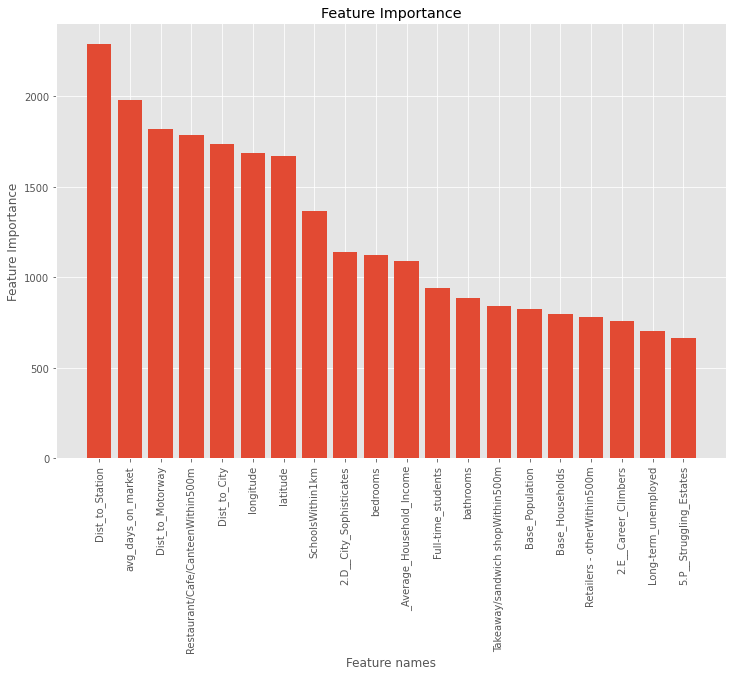

In [22]:
# Feature Importance
%matplotlib inline
mpl.style.use('ggplot')
pylab.rcParams['figure.figsize'] = 12,8
number_of_feature = 20

feature_importance = model.feature_importances_
feature_names = df1.columns
sorted_index = np.argsort(feature_importance)[::-1]
x = list(range(len(feature_importance)))

feature_importance_df = pd.DataFrame(sorted(zip(feature_names, feature_importance), reverse=True), 
                                     columns=['Names', 'importance'])

labels = np.array(feature_names[sorted_index])[:number_of_feature]
plt.bar(x[:number_of_feature], feature_importance[sorted_index][:number_of_feature], tick_label=labels)

plt.xlabel("Feature names")
plt.ylabel("Feature Importance")
plt.title('Feature Importance')
plt.xticks(rotation=90)
plt.show()

In [82]:
import pickle
model_name = 'LXGB_RM_rental_house_model.sav'
xgb_r = pickle.load(open(os.path.join(report_dir, model_name), 'rb'))         
pred_table_df = pd.read_excel(os.path.join(data_dir,'RS2PredTable.xlsx'))
df_prediction = pd.read_csv(os.path.join(report_dir, 'RM Rental Processed Data - House .csv'))


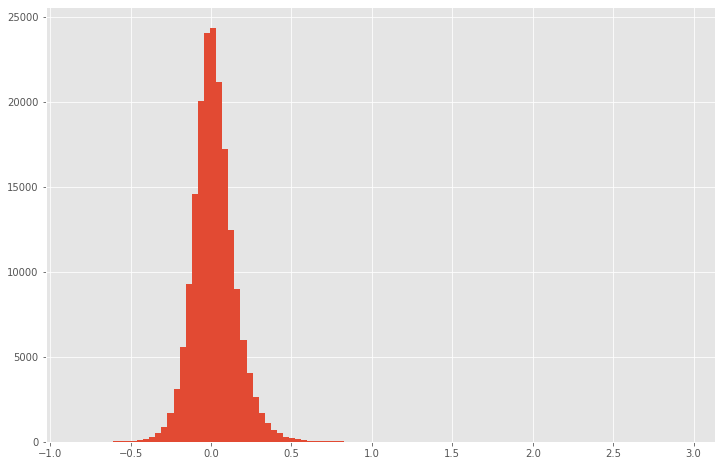

In [34]:
plt.hist(test_temp_df['Difference%'], bins=100)

plt.grid(True)
plt.show()

In [36]:
(abs(pred_table_df['pred_difference%_flat'])<0.1).sum()/pred_table_df.shape[0]

0.8311677631578948

In [23]:
# import shap

# # explain the model's predictions using SHAP
# explainer = shap.TreeExplainer(model)
# shap_values = explainer.shap_values(X_test)

In [ ]:
target_lsoa = 'E01009040'
index_of_interest = data_df.loc[data_df['Area_Name']==target_lsoa].index[0]
# visualize the prediction's explanation (use matplotlib=True to avoid Javascript)

explain_df = pd.DataFrame(X_test.iloc[index_of_interest,:])
explain_df['Shap_values'] = shap_values[index_of_interest,:]
explain_df.columns = ['Actual_values', 'Shap_Values']
explain_df.sort_values(by='Shap_Values', ascending=False)

shap.force_plot(explainer.expected_value, shap_values[index_of_interest,:], X.iloc[index_of_interest,:])


In [32]:
# cross validation score
from sklearn.model_selection import cross_val_score
r2_cross_val = cross_val_score(xgb_r, X_Scaled, y_Scaled, scoring="r2", cv = 5).mean()

In [ ]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

In [ ]:
with pd.ExcelWriter(os.path.join(report_dir, 'Weighted Rightmove Rental Index asof Sep 2022_v2.xlsx')) as writer:  
    weighted_rent_df.to_excel(writer, sheet_name='Weighted Rent by City', index=False)
    uk_weighted_rent_df.to_excel(writer, sheet_name='Weighted Rent UK', index=False)



In [ ]:
from matplotlib import rcParams

for city_name in weighted_rent_df['City'].unique():
    sns.set_style("darkgrid")
    sns.set(rc={'figure.figsize':(11.7,8.27)})
    temp_df = weighted_rent_df[weighted_rent_df['City']==city_name]
    sns.lineplot(data=temp_df, x="change_date", y="avg_price_flat")
    sns.lineplot(data=temp_df, x="change_date", y="avg_price_house")
    sns.lineplot(data=temp_df, x="change_date", y="weighted_avg_rent")
    plt.title(label= str(city_name) +' Rightmove Rental')
    plt.legend(labels=["avg_price_flat", "avg_price_house", 'weighted_avg_rent'])
    plt.savefig(os.path.join(report_dir, 'searborn_plots', str(city_name)+' RM Monthly Avg Rent.png'))

    plt.show()

In [ ]:
result_df.to_csv(os.path.join(report_dir, 'RM_Rent_TW184JW_WindsorHouse.csv'), index=False) 

In [ ]:
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(x=man1[man1['prop_type']=='Flat / Apartment'].change_date, 
                         y=man1[man1['prop_type']=='Flat / Apartment']['median_price'],
                        mode='lines+markers', name='median', opacity=0.65))

fig.add_trace(go.Scatter(x=man1[man1['prop_type']=='Flat / Apartment'].change_date, 
                         y=man1[man1['prop_type']=='Flat / Apartment']['q1_price'],
                        mode='lines+markers', name='Q1', opacity=0.65))

fig.add_trace(go.Scatter(x=man1[man1['prop_type']=='Flat / Apartment'].change_date, 
                         y=man1[man1['prop_type']=='Flat / Apartment']['q3_price'],
                        mode='lines+markers', name='Q3', opacity=0.65))

# fig.add_trace(go.Scatter(x=expectation_df['Store Name'], y=expectation_df['Potential ARR'],
#                         mode='lines', name='Potential ARR', opacity=0.65))
# fig.add_trace(go.Scatter(x=safestore_conn_df['Postcode'], y=safestore_conn_df['PredPrice_Diff'],
#                         mode='lines', name='Predicted', opacity=0.65))
fig.update_layout(
    height=600,
    title_text='',
    xaxis_title="",
    yaxis_title="",
)

fig.show()